In [ ]:
pip install tensorflow_addons --upgrade

     |████████████████████████████████| 1.1 MB 7.5 MB/s 


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google_drive_downloader import GoogleDriveDownloader as gdd

gdd.download_file_from_google_drive(file_id='xxxxxxxxxxxx', 
                                    dest_path='./27-jan.zip',
                                    unzip=False)

In [ ]:
!unzip 27-jan.zip

Archive:  27-jan.zip
  inflating: battery_received.txt    
  inflating: data_received.txt       


In [ ]:
!ls

27-jan.zip  battery_received.txt  data_received.txt  drive  sample_data


In [ ]:
folder_name = 'APIN'

## Data Wrangling

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
sns.set_theme()
sns.set_context("paper", font_scale=1.7)

### Sensor data (Temp, Humidity, RSSI)

In [ ]:
df_sensor = pd.read_csv('data_received.txt')
df_sensor

,ADDR,TIME,TID,TEMP,HUM,RSSI
0,6e6d651fbae3,1.573128e+09,203,1991,1119,-63
1,d8896dfe78e4,1.573128e+09,230,1871,1203,-47
2,352299f096d2,1.573128e+09,229,1943,1168,-43
3,e03dbb9965ed,1.573128e+09,226,3370,641,-81
4,c9dc1485bfd2,1.573128e+09,148,1867,1189,-62
...,...,...,...,...,...,...
1277635,b2bac19576cb,1.580143e+09,18,1579,1265,-60
1277636,61cc6cb2b2f8,1.580143e+09,37,2032,1006,-48
1277637,cb578dd18bce,1.580143e+09,70,2007,1414,-63
1277638,8af3d1337ee3,1.580143e+09,80,3945,484,-46


In [ ]:
# List of ADDR's
df_sensor.ADDR.unique()

array(['6e6d651fbae3', 'd8896dfe78e4', '352299f096d2', 'e03dbb9965ed',
       'c9dc1485bfd2', 'a666402cc7e9', '2b3951d7d4e5', '621216cbcaef',
       '75284b4ab4f9', 'a11bc51cf0cc', '149f971bf5c6', 'ccd28aa193cf',
       '786d1ebbc2c4', '88f48d709fdc', 'b42beaa51dec', 'fe44df630cc9',
       'f0c1637bc7f7', 'b2bac19576cb', '80dfee69bfcb', '8dda80cf20c0',
       '291fb77414f6', '2ffd9d37a7e8', 'cbc218f165e9', '3a86ad3ac0cd',
       'bc3d9b569fc9', '61cc6cb2b2f8', '4ab8aaf5d0f9', '24f402b45cde',
       '69b774f031db', 'c5d81f77f0ed', 'acc8d5c002c3', '8af3d1337ee3',
       'cb578dd18bce', '7dc6e2194aec', '2bfcca8c64e4', '6fd7226a95dd',
       'c1476ee349ca'], dtype=object)

In [ ]:
groups = df_sensor.groupby('ADDR')  
groups_sensor = [groups.get_group(x) for x in groups.groups]
groups_sensor

[                 ADDR          TIME  TID  TEMP   HUM  RSSI
 10       149f971bf5c6  1.573128e+09  231  1971  1108   -74
 40       149f971bf5c6  1.573128e+09  232  2382  1284   -53
 71       149f971bf5c6  1.573128e+09  233  3426   686   -54
 102      149f971bf5c6  1.573128e+09  234  3623   606   -60
 135      149f971bf5c6  1.573128e+09  235  3784   560   -60
 ...               ...           ...  ...   ...   ...   ...
 1277532  149f971bf5c6  1.580143e+09   60  3601   492   -55
 1277554  149f971bf5c6  1.580143e+09   61  3571   495   -54
 1277576  149f971bf5c6  1.580143e+09   62  3562   496   -55
 1277598  149f971bf5c6  1.580143e+09   63  3555   497   -55
 1277620  149f971bf5c6  1.580143e+09   64  3579   498   -55
 
 [43212 rows x 6 columns],
                  ADDR          TIME  TID  TEMP   HUM  RSSI
 27       24f402b45cde  1.573128e+09  175  1792  1210   -52
 56       24f402b45cde  1.573128e+09  176  1792  1207   -53
 88       24f402b45cde  1.573128e+09  177  1789  1210   -53
 119      2

In [ ]:
groups_sensor[0]

,ADDR,TIME,TID,TEMP,HUM,RSSI
10,149f971bf5c6,1.573128e+09,231,1971,1108,-74
40,149f971bf5c6,1.573128e+09,232,2382,1284,-53
71,149f971bf5c6,1.573128e+09,233,3426,686,-54
102,149f971bf5c6,1.573128e+09,234,3623,606,-60
135,149f971bf5c6,1.573128e+09,235,3784,560,-60
...,...,...,...,...,...,...
1277532,149f971bf5c6,1.580143e+09,60,3601,492,-55
1277554,149f971bf5c6,1.580143e+09,61,3571,495,-54
1277576,149f971bf5c6,1.580143e+09,62,3562,496,-55
1277598,149f971bf5c6,1.580143e+09,63,3555,497,-55


### Battery Data

In [ ]:
df_batt = pd.read_csv('battery_received.txt')
df_batt

,ADDR,TIME,TID,BATTERY
0,6e6d651fbae3,1.573128e+09,203,2800
1,d8896dfe78e4,1.573128e+09,230,2855
2,352299f096d2,1.573128e+09,229,2819
3,e03dbb9965ed,1.573128e+09,226,2653
4,c9dc1485bfd2,1.573128e+09,148,2855
...,...,...,...,...
1277630,80dfee69bfcb,1.580143e+09,36,1860
1277631,d8896dfe78e4,1.580143e+09,64,2148
1277632,2ffd9d37a7e8,1.580143e+09,39,2029
1277633,a11bc51cf0cc,1.580143e+09,78,1823


In [ ]:
# List of ADDR's
df_batt.ADDR.unique()

array(['6e6d651fbae3', 'd8896dfe78e4', '352299f096d2', 'e03dbb9965ed',
       'c9dc1485bfd2', 'a666402cc7e9', '2b3951d7d4e5', '621216cbcaef',
       '75284b4ab4f9', 'a11bc51cf0cc', '149f971bf5c6', 'ccd28aa193cf',
       '786d1ebbc2c4', '88f48d709fdc', 'b42beaa51dec', 'fe44df630cc9',
       'f0c1637bc7f7', 'b2bac19576cb', '80dfee69bfcb', '8dda80cf20c0',
       '291fb77414f6', '2ffd9d37a7e8', 'cbc218f165e9', '3a86ad3ac0cd',
       'bc3d9b569fc9', '61cc6cb2b2f8', '4ab8aaf5d0f9', '24f402b45cde',
       '69b774f031db', 'c5d81f77f0ed', 'acc8d5c002c3', '8af3d1337ee3',
       'cb578dd18bce', '7dc6e2194aec', '2bfcca8c64e4', '6fd7226a95dd',
       'c1476ee349ca'], dtype=object)

In [ ]:
# Are equal the ADDRs from both datasets??
df_batt.ADDR.unique() == df_sensor.ADDR.unique()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

In [ ]:
groups = df_batt.groupby('ADDR')  
groups_batt = [groups.get_group(x) for x in groups.groups]
groups_batt

[                 ADDR          TIME  TID  BATTERY
 10       149f971bf5c6  1.573128e+09  231     2858
 40       149f971bf5c6  1.573128e+09  232     2858
 71       149f971bf5c6  1.573128e+09  233     2858
 102      149f971bf5c6  1.573128e+09  234     2858
 135      149f971bf5c6  1.573128e+09  235     2858
 ...               ...           ...  ...      ...
 1277532  149f971bf5c6  1.580143e+09   60     1949
 1277554  149f971bf5c6  1.580143e+09   61     1949
 1277576  149f971bf5c6  1.580143e+09   62     1949
 1277598  149f971bf5c6  1.580143e+09   63     1949
 1277620  149f971bf5c6  1.580143e+09   64     1943
 
 [43212 rows x 4 columns],                  ADDR          TIME  TID  BATTERY
 27       24f402b45cde  1.573128e+09  175     2887
 56       24f402b45cde  1.573128e+09  176     2887
 88       24f402b45cde  1.573128e+09  177     2887
 119      24f402b45cde  1.573128e+09  178     2887
 151      24f402b45cde  1.573128e+09  179     2887
 ...               ...           ...  ...      ...
 12

In [ ]:
groups_batt[0]

,ADDR,TIME,TID,BATTERY
10,149f971bf5c6,1.573128e+09,231,2858
40,149f971bf5c6,1.573128e+09,232,2858
71,149f971bf5c6,1.573128e+09,233,2858
102,149f971bf5c6,1.573128e+09,234,2858
135,149f971bf5c6,1.573128e+09,235,2858
...,...,...,...,...
1277532,149f971bf5c6,1.580143e+09,60,1949
1277554,149f971bf5c6,1.580143e+09,61,1949
1277576,149f971bf5c6,1.580143e+09,62,1949
1277598,149f971bf5c6,1.580143e+09,63,1949


### Merge Data

In [ ]:
merged_groups = {} 
for i in range(len(df_batt.ADDR.unique())):
    #VERSION TO USE ONLY TEMP AND HUMIDITY
    #Group Sensor
    groups_sensor_merge = groups_sensor[i].copy()
    #Group Batt
    groups_batt_merge = groups_batt[i].copy()
    
    #Drop first and last values
    n_delete = 60
    groups_sensor_merge.drop(groups_sensor_merge.head(n_delete).index, inplace=True)
    groups_sensor_merge.drop(groups_sensor_merge.tail(n_delete).index, inplace=True)
    groups_batt_merge.drop(groups_batt_merge.head(n_delete).index, inplace=True)
    groups_batt_merge.drop(groups_batt_merge.tail(n_delete).index, inplace=True)
    
    #Fix different lengths
    # REPLACE WITH A TID-BASED FIX IN THE FUTURE IF NEEDED
    if len(groups_sensor_merge) > len(groups_batt_merge):
        groups_sensor_merge.drop(groups_sensor_merge.head(1).index, inplace=True)
    elif len(groups_sensor_merge) < len(groups_batt_merge):
        groups_batt_merge.drop(groups_batt_merge.head(1).index, inplace=True)
    
    #Subsample 1:10
    groups_sensor_merge = groups_sensor_merge.iloc[::10]
    groups_sensor_merge = groups_sensor_merge.reset_index(drop=True)
    groups_batt_merge = groups_batt_merge.iloc[::10]
    groups_batt_merge = groups_batt_merge.reset_index(drop=True)

    print(f'Groups {i}:')
    groups_sensor_merge = groups_sensor_merge.drop(columns=['TIME', 'TID', 'RSSI'])
    addr_sensor = groups_sensor_merge['ADDR'].iloc[0]
    print(f'ADDR sensor: {addr_sensor} | len: {groups_sensor_merge.shape}')
    
    #groups_batt_merge = groups_batt_merge.drop(columns=['TIME', 'TID'])
    addr_batt = groups_batt_merge['ADDR'].iloc[0]
    print(f'ADDR batt:   {addr_batt} | len: {groups_batt_merge.shape}')
       
    #Merge
    groups_merge = groups_sensor_merge.copy()
    groups_sensor_merge['TEMP'] = groups_sensor_merge['TEMP']/100
    groups_sensor_merge['HUM'] = groups_sensor_merge['HUM']/100
    print(f'Group merged shape:              {groups_sensor_merge.shape} \n')
    
    #Add to list
    merged_groups[i] = groups_sensor_merge
    
    
print(f'Len of dict of merged groups: {len(merged_groups)}')
print(f'Shape of first item of dict: {merged_groups[0].shape}')

Groups 0:
ADDR sensor: 149f971bf5c6 | len: (4310, 3)
ADDR batt:   149f971bf5c6 | len: (4310, 4)
Group merged shape:              (4310, 3) 

Groups 1:
ADDR sensor: 24f402b45cde | len: (4217, 3)
ADDR batt:   24f402b45cde | len: (4217, 4)
Group merged shape:              (4217, 3) 

Groups 2:
ADDR sensor: 291fb77414f6 | len: (3191, 3)
ADDR batt:   291fb77414f6 | len: (3191, 4)
Group merged shape:              (3191, 3) 

Groups 3:
ADDR sensor: 2b3951d7d4e5 | len: (4255, 3)
ADDR batt:   2b3951d7d4e5 | len: (4255, 4)
Group merged shape:              (4255, 3) 

Groups 4:
ADDR sensor: 2bfcca8c64e4 | len: (2524, 3)
ADDR batt:   2bfcca8c64e4 | len: (2524, 4)
Group merged shape:              (2524, 3) 

Groups 5:
ADDR sensor: 2ffd9d37a7e8 | len: (4310, 3)
ADDR batt:   2ffd9d37a7e8 | len: (4310, 4)
Group merged shape:              (4310, 3) 

Groups 6:
ADDR sensor: 352299f096d2 | len: (4309, 3)
ADDR batt:   352299f096d2 | len: (4309, 4)
Group merged shape:              (4309, 3) 

Groups 7:
ADD

In [ ]:
# Delete unwanted sensor
del merged_groups[32]
del merged_groups[25]
print(f'Len of dict of merged groups: {len(merged_groups)}')
print(merged_groups.keys())

Len of dict of merged groups: 35
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33, 34, 35, 36])


### Exploratory Data Analysis

In [ ]:
concat_df = pd.concat(merged_groups.values(), ignore_index=True)

#### Plot data

In [ ]:
for j, sensor_df in enumerate(merged_groups.values()):
    headers = list(sensor_df)
    addr = str(sensor_df['ADDR'].iloc[0])
    print(f'Sensor nº {j} - {addr} - Shape: {sensor_df.shape}')
    for i in range(1, len(headers)):
        column = str(headers[i])
        fig, ax = plt.subplots(figsize=(8,2))
        fig.set_dpi(200.0)
        if i == 1:
          ax.set(ylabel='Temperature')
        else:
          ax.set(ylabel='Humidity')
        ax.set(xlabel='Samples (Time)')
        sns.lineplot(data=sensor_df[column], ax=ax).set(title=column + ' (' + addr + ')')
        plt.show()
    print('\n\n\n*******************************************')
    print('*******************************************')
    print('*******************************************\n\n\n')

Output hidden; open in https://colab.research.google.com to view.

#### Histograms

[Text(0.5, 1.0, 'Temperature Histogram')]

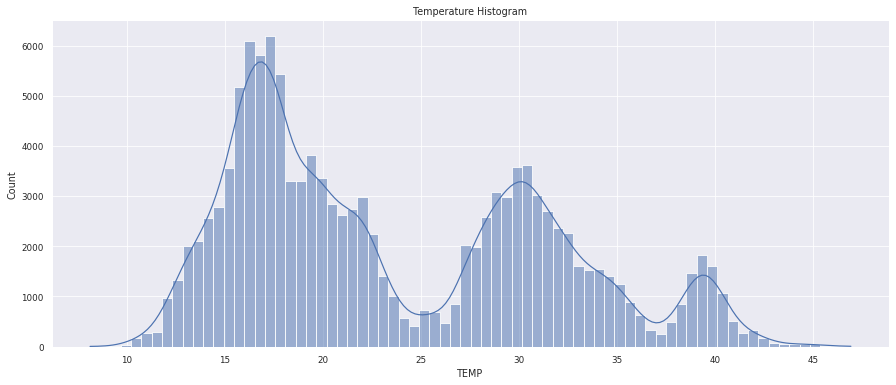

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='TEMP', bins='auto', kde=True, legend=False).set(title='Temperature Histogram')

[Text(0.5, 1.0, 'Temperature Histograms')]

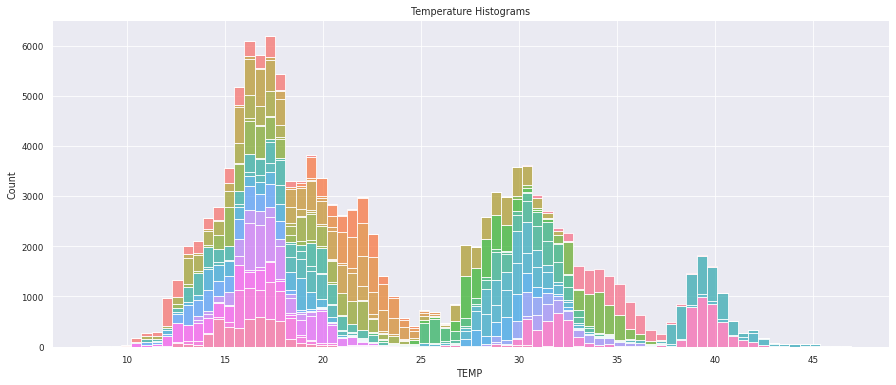

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='TEMP', hue="ADDR", bins='auto', multiple='stack', legend=False).set(title='Temperature Histograms')

Max: 11.909999999999997
Min: -9.790000000000003


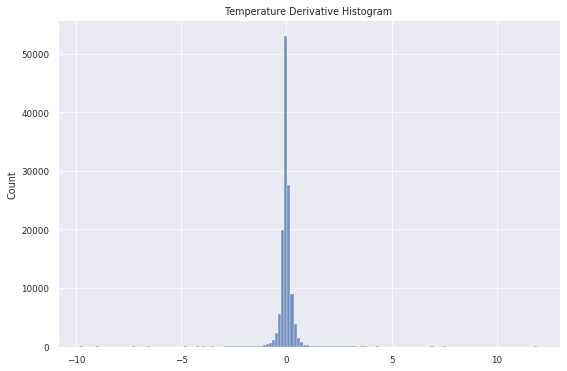

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['TEMP'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix_temp = series_diff[not_nan_array]

plt.figure(figsize=(9,6))
sns.histplot(series_diff_fix_temp, bins=150, legend=False).set(title='Temperature Derivative Histogram')
print(f'Max: {np.amax(series_diff_fix_temp.to_numpy())}')
print(f'Min: {np.amin(series_diff_fix_temp.to_numpy())}')

-1.2064234987068077 1.2049997581088683


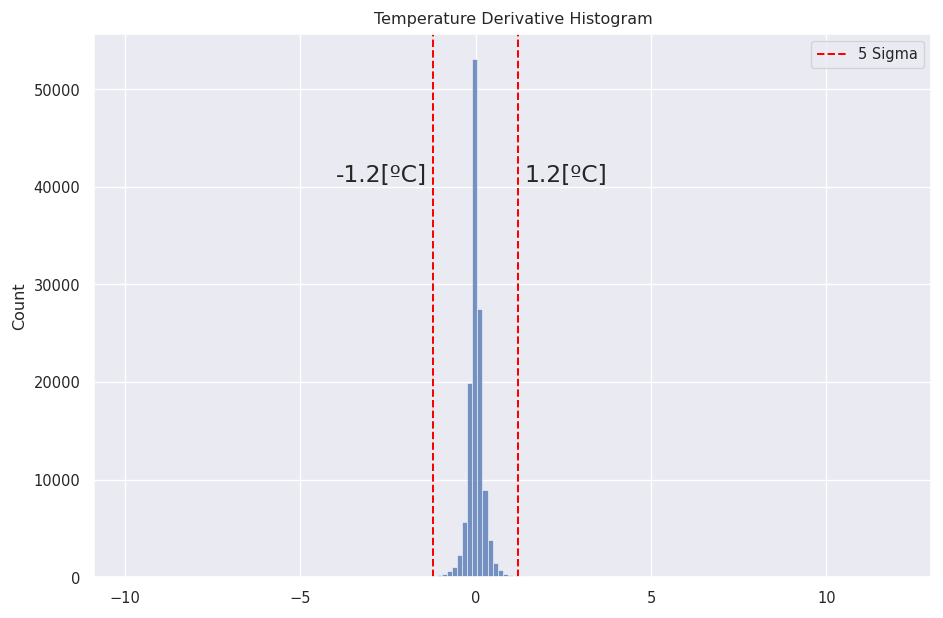

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['TEMP'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix_temp = series_diff[not_nan_array]

temp_diff_mean = np.mean(series_diff_fix_temp.to_numpy())
temp_diff_5std = np.std(series_diff_fix_temp.to_numpy())*5
top_sigma = temp_diff_mean + temp_diff_5std
bottom_sigma = temp_diff_mean - temp_diff_5std

plt.figure(figsize=(9,6), dpi=120)
sns.histplot(series_diff_fix_temp, bins=150, legend=False).set(title='Temperature Derivative Histogram')
plt.axvline(top_sigma, color='red', linestyle='--')
plt.axvline(bottom_sigma, color='red', linestyle='--')
plt.text(1.4,40500,"1.2[ºC]", fontsize=14)
plt.text(-4,40500,"-1.2[ºC]", fontsize=14)
plt.legend(['5 Sigma'])
print(bottom_sigma, top_sigma)

[Text(0.5, 1.0, 'Humidity Histogram')]

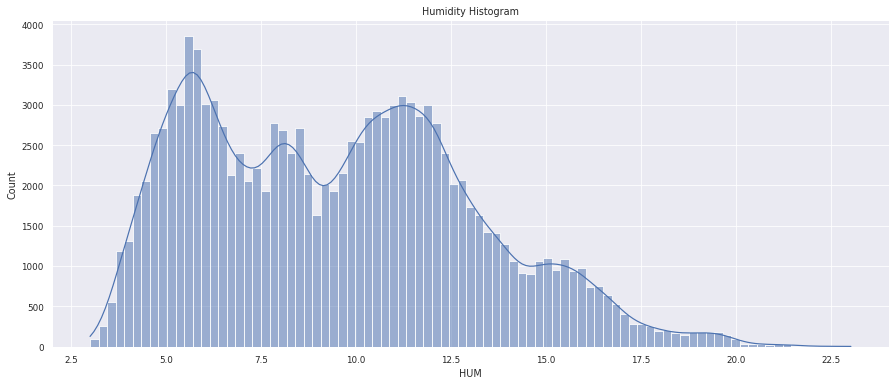

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='HUM', bins='auto', kde=True, legend=False).set(title='Humidity Histogram')

[Text(0.5, 1.0, 'Humidity Histograms')]

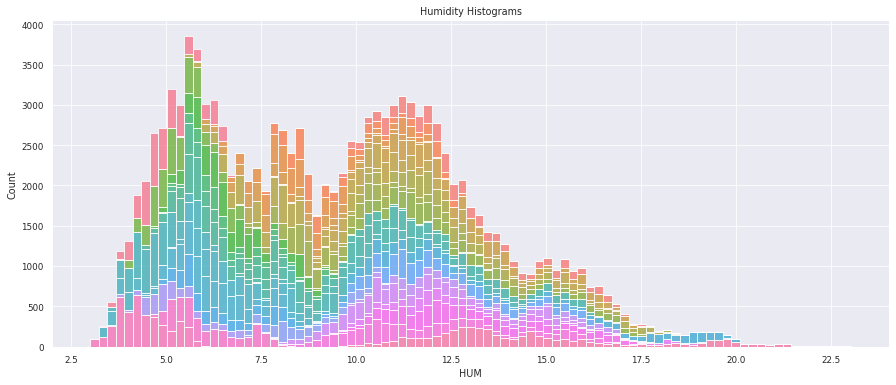

In [ ]:
plt.figure(figsize=(15,6))
sns.histplot(concat_df, x='HUM', bins='auto', hue='ADDR', multiple='stack', legend=False).set(title='Humidity Histograms')

Max: 2.639999999999999
Min: -3.59


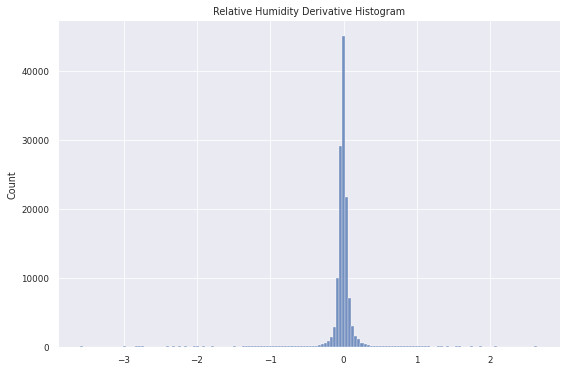

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['HUM'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix = series_diff[not_nan_array]

plt.figure(figsize=(9,6))
sns.histplot(series_diff_fix, bins=150, legend=False).set(title='Relative Humidity Derivative Histogram')
print(f'Max: {np.amax(series_diff_fix.to_numpy())}')
print(f'Min: {np.amin(series_diff_fix.to_numpy())}')

-0.44817735516190466 0.4482261826696475


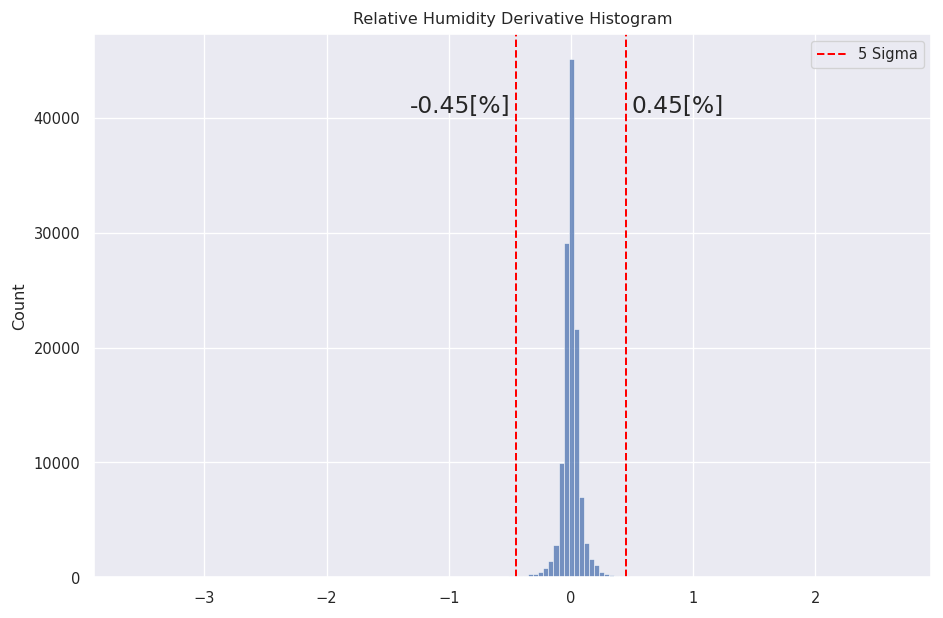

In [ ]:
series_diff = pd.Series(dtype='object')
for sensor_df in merged_groups.values():
  series_diff = series_diff.append(sensor_df['HUM'].diff(), ignore_index=True)

nan_array = np.isnan(series_diff)
not_nan_array = ~ nan_array
series_diff_fix = series_diff[not_nan_array]

humid_diff_mean = np.mean(series_diff_fix.to_numpy())
humid_diff_5std = np.std(series_diff_fix.to_numpy())*5
top_sigma = humid_diff_mean + humid_diff_5std
bottom_sigma = humid_diff_mean - humid_diff_5std

plt.figure(figsize=(9,6), dpi=120)
sns.histplot(series_diff_fix, bins=150, legend=False).set(title='Relative Humidity Derivative Histogram')
plt.axvline(top_sigma, color='red', linestyle='--')
plt.axvline(bottom_sigma, color='red', linestyle='--')
plt.text(0.5,40500,"0.45[%]", fontsize=14)
plt.text(-1.32,40500,"-0.45[%]", fontsize=14)
plt.legend(['5 Sigma'])
print(bottom_sigma, top_sigma)

#### Correlations

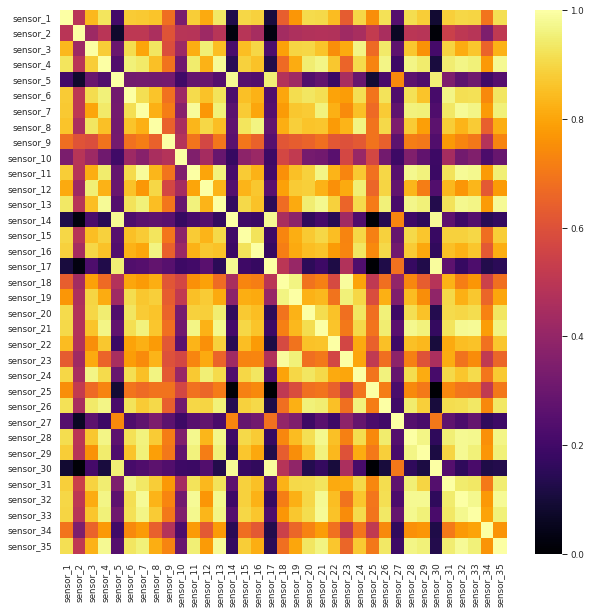

In [ ]:
corr_df_temp = pd.DataFrame()
for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  data_temp = data[:1773,0]
  name = 'sensor_'+str(i+1)
  corr_df_temp[name]=data_temp
plt.figure(figsize=(10,10))
sns.heatmap(corr_df_temp.corr(), vmin=0, vmax=1, cmap='inferno' ,annot=False, linewidths=0)


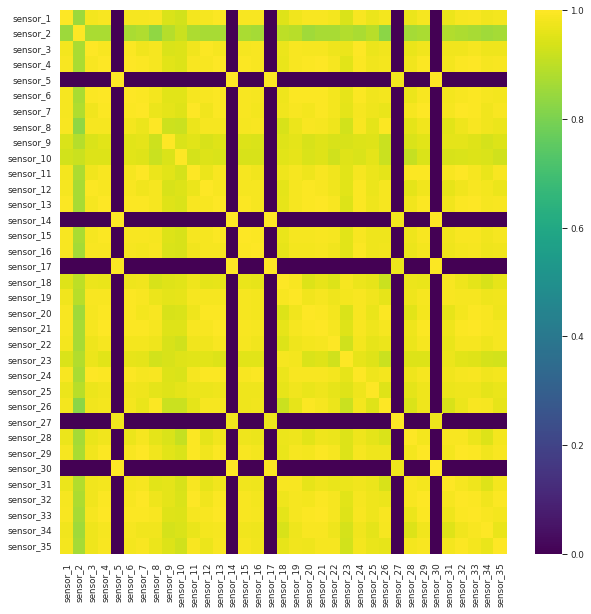

In [ ]:
corr_df_humid = pd.DataFrame()
for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  data_temp = data[:1773,1]
  name = 'sensor_'+str(i+1)
  corr_df_humid[name]=data_temp
plt.figure(figsize=(10,10))
sns.heatmap(corr_df_humid.corr(), vmin=0, vmax=1, cmap='viridis' ,annot=False, linewidths=0)

In [ ]:
corr_pearson = concat_df['TEMP'].corr(concat_df['HUM'])
print(f'Pearson correlation: {corr_pearson}')

Pearson correlation: -0.7849203254734163


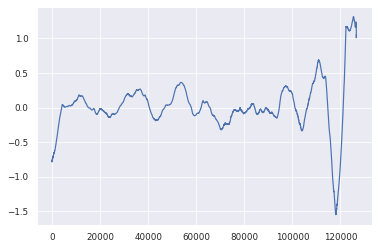

In [ ]:
from statsmodels import tsa
cross_correlation = tsa.stattools.ccf(x=concat_df['TEMP'], y=concat_df['HUM'])
plt.plot(cross_correlation)

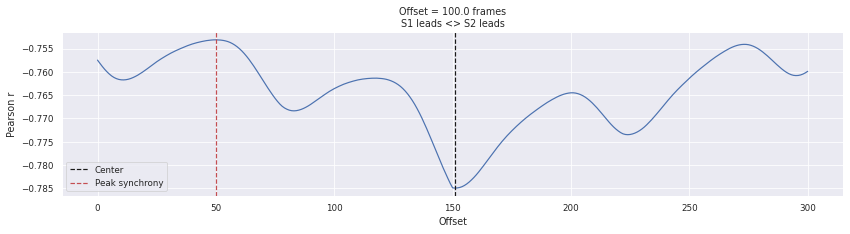

In [ ]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

d1 = concat_df['TEMP']
d2 = concat_df['HUM']
seconds = 5
fps = 30
rs = [crosscorr(d1,d2, lag) for lag in range(-int(seconds*fps),int(seconds*fps+1))]
offset = np.floor(len(rs)/2)-np.argmax(rs)
f,ax=plt.subplots(figsize=(14,3))
ax.plot(rs)
ax.axvline(np.ceil(len(rs)/2),color='k',linestyle='--',label='Center')
ax.axvline(np.argmax(rs),color='r',linestyle='--',label='Peak synchrony')
ax.set(title=f'Offset = {offset} frames\nS1 leads <> S2 leads', xlabel='Offset',ylabel='Pearson r')
plt.legend()

#### Scatter Plot


[Text(0.5, 1.0, 'Humidity vs. Temperature')]

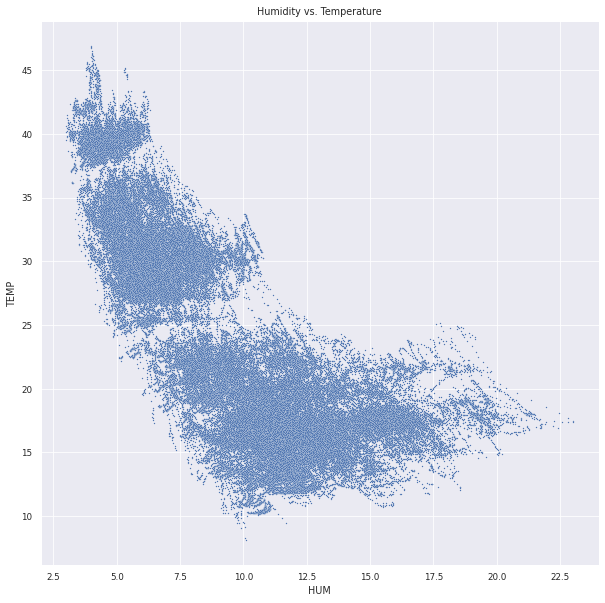

In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='HUM', y='TEMP', data=concat_df, s=2).set(title='Humidity vs. Temperature')

[Text(0.5, 1.0, 'Humidity vs. Temperature')]

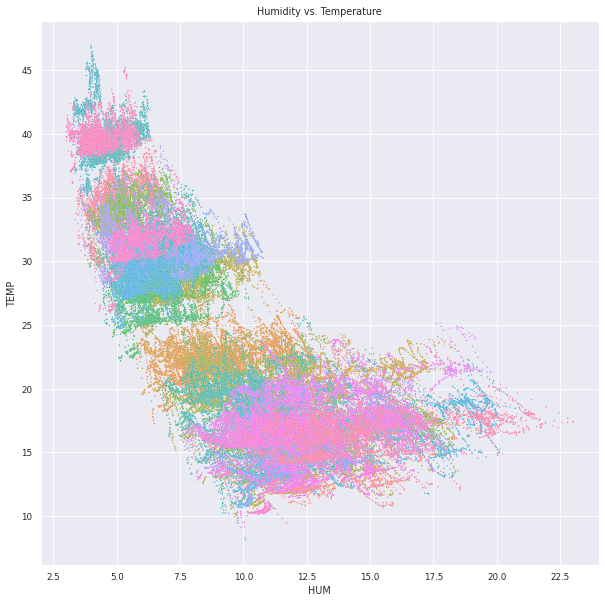

In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='HUM', y='TEMP', data=concat_df, hue='ADDR',legend=False, s=2).set(title='Humidity vs. Temperature')

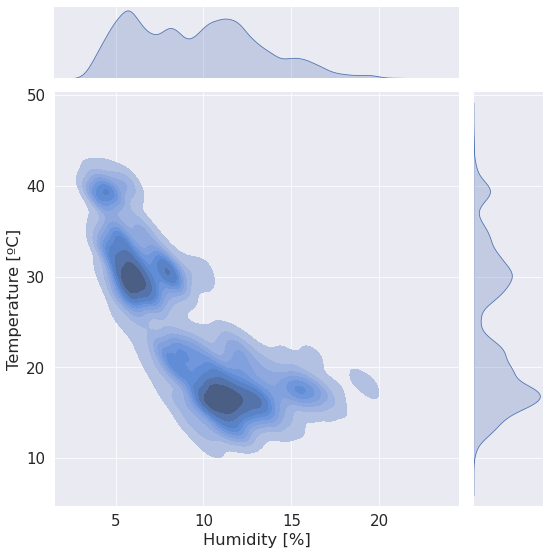

In [ ]:
fig_kde = sns.jointplot(data=concat_df, x='HUM', y='TEMP',  kind='kde', height=8, fill=True)
fig_kde.set_axis_labels(xlabel="Humidity [%]", ylabel = "Temperature [ºC]")

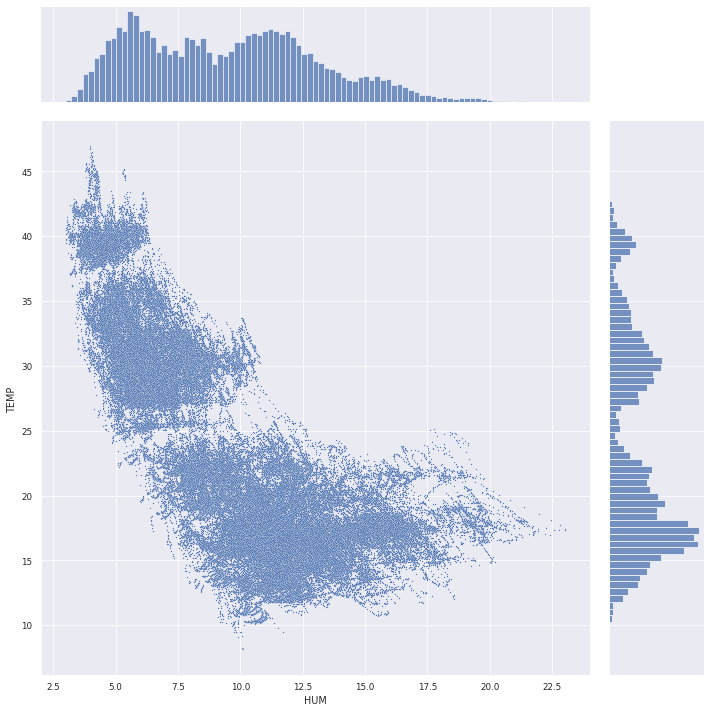

In [ ]:
sns.jointplot(data=concat_df, x='HUM', y='TEMP', s=1.8, height=10)

<Figure size 720x720 with 0 Axes>

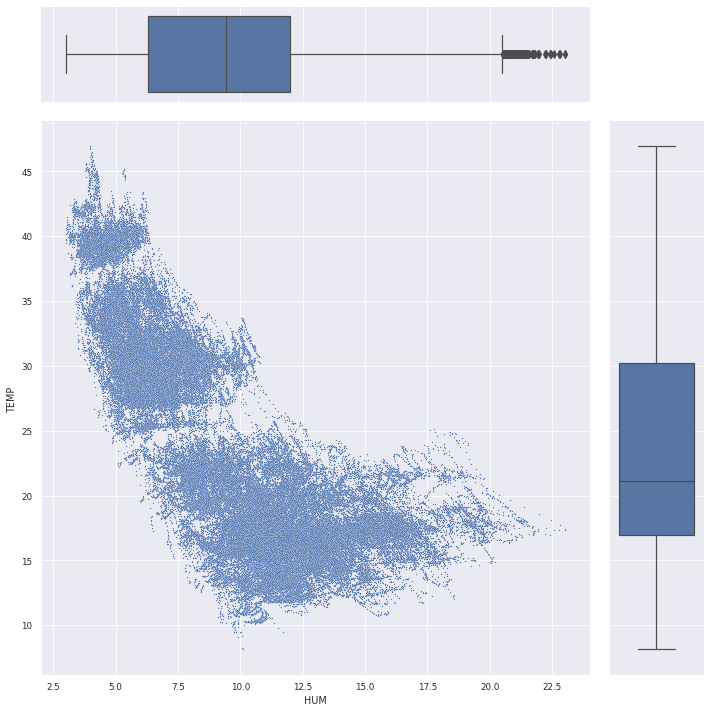

In [ ]:
plt.figure(figsize=(10,10))
g = sns.JointGrid(data=concat_df, x='HUM', y='TEMP', height=10)
g.plot_joint(sns.scatterplot, s=1.8)
g.plot_marginals(sns.boxplot)

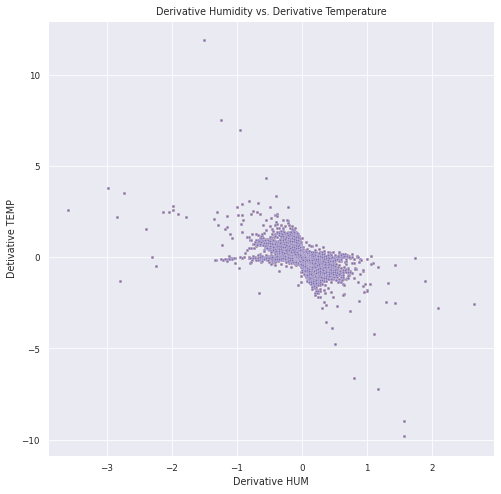

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix, y=series_diff_fix_temp, s=7).set(title='Derivative Humidity vs. Derivative Temperature', 
                                                                                  xlabel='Derivative HUM',
                                                                                  ylabel='Detivative TEMP')

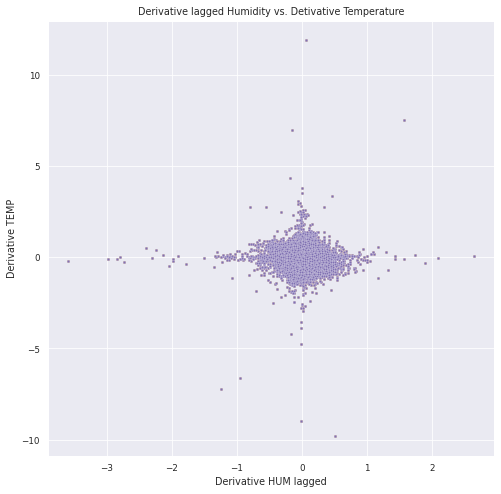

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix.shift(1), y=series_diff_fix_temp, s=7).set(title='Derivative lagged Humidity vs. Detivative Temperature', 
                                                                                  xlabel='Derivative HUM lagged',
                                                                                  ylabel='Derivative TEMP')

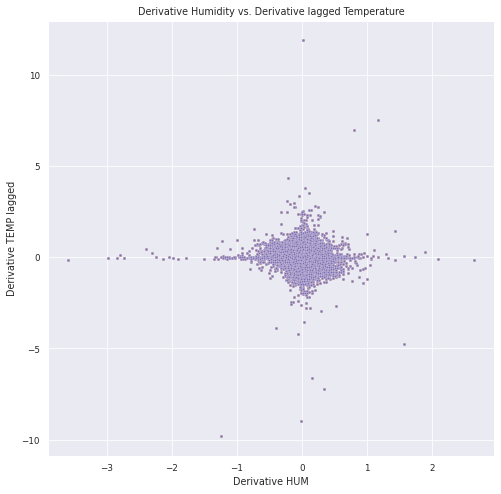

In [ ]:
plt.figure(figsize=(8,8))
for sensor_df in merged_groups.values():
  sns.scatterplot(x=series_diff_fix, y=series_diff_fix_temp.shift(1), s=7).set(title='Derivative Humidity vs. Derivative lagged Temperature', 
                                                                                  xlabel='Derivative HUM',
                                                                                  ylabel='Derivative TEMP lagged')

#### Autocorrelation & Partial Aucorrelation

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

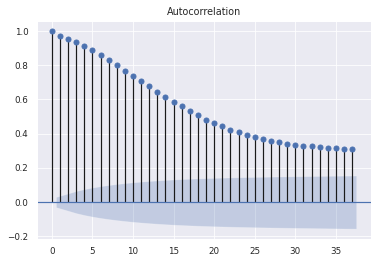

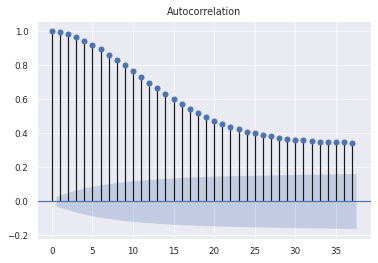

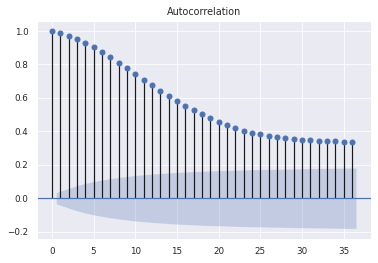

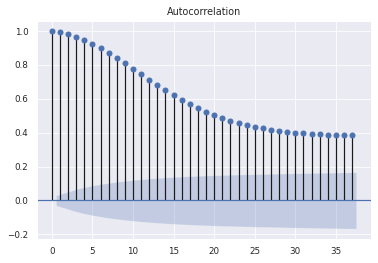

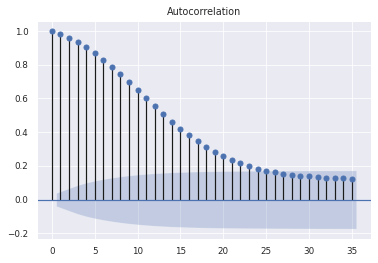

...

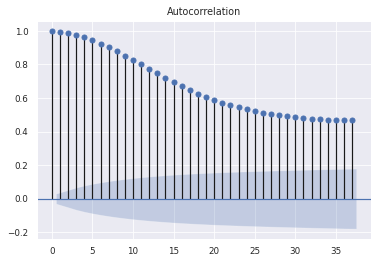

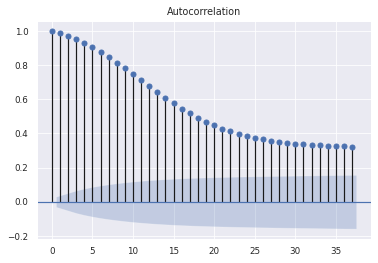

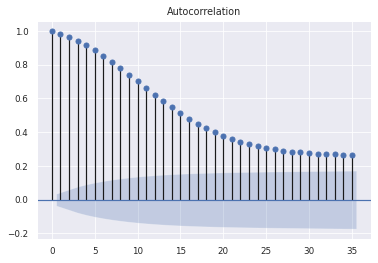

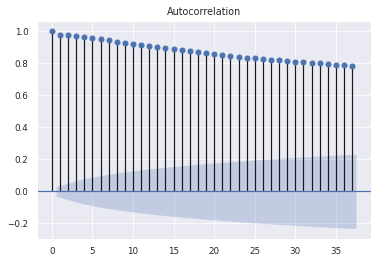

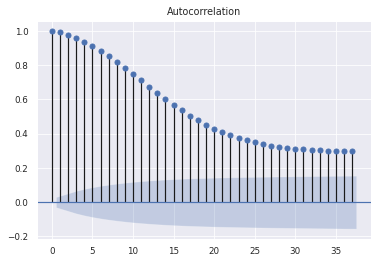

In [ ]:
for sensor_df in merged_groups.values():
  plot_acf(sensor_df['TEMP'])

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

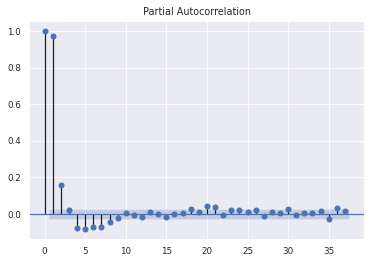

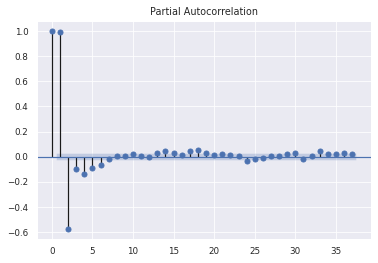

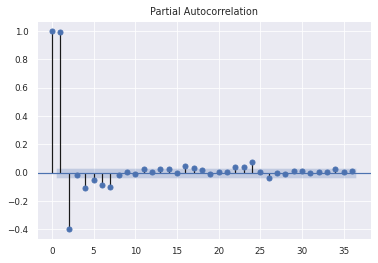

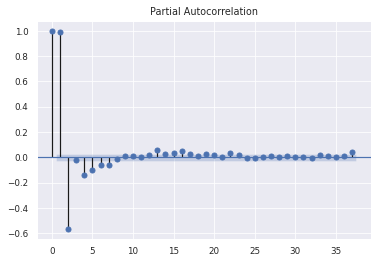

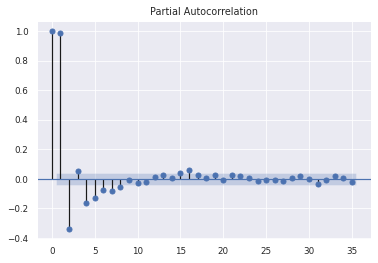

...

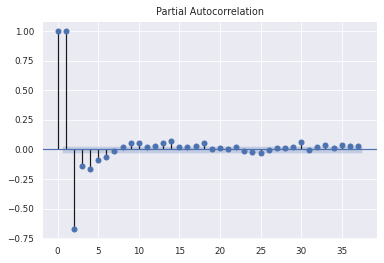

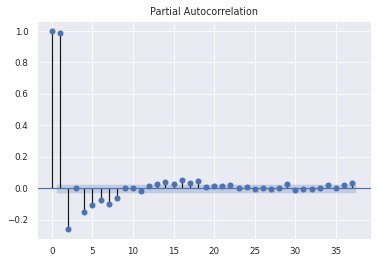

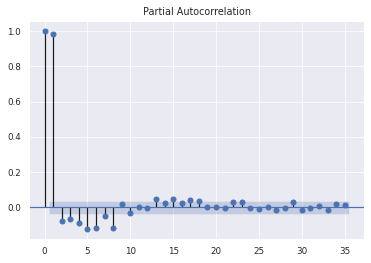

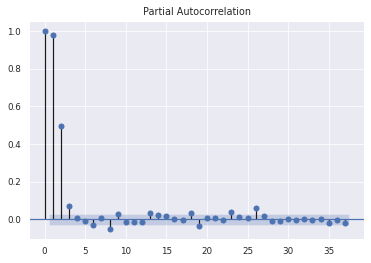

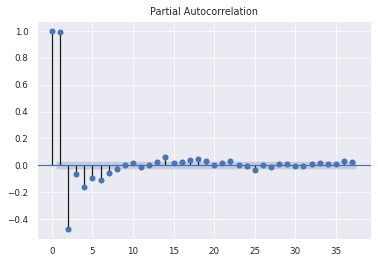

In [ ]:
for sensor_df in merged_groups.values():
  plot_pacf(sensor_df['TEMP'])

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

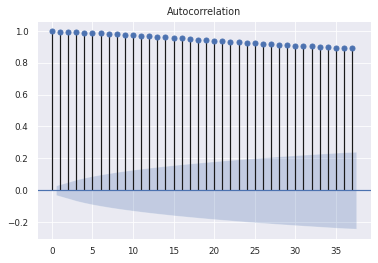

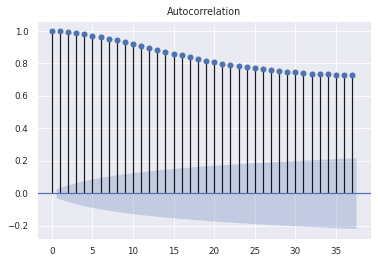

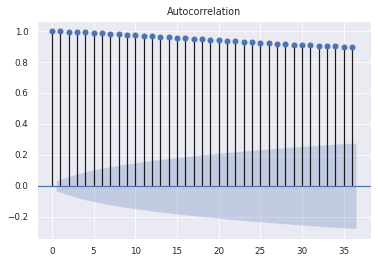

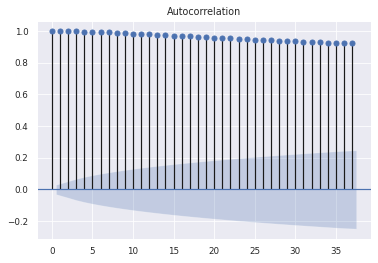

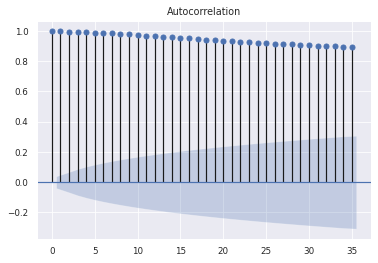

...

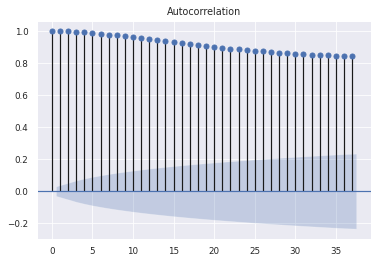

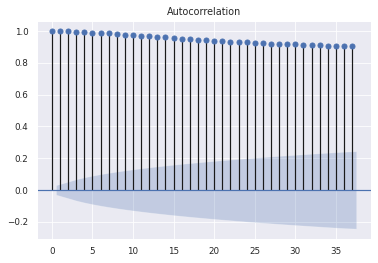

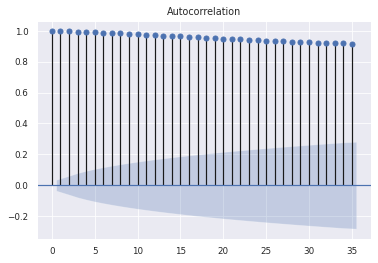

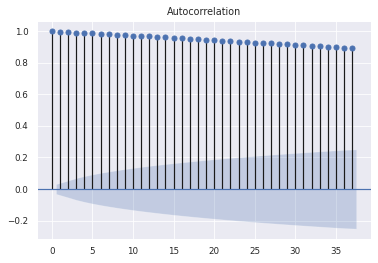

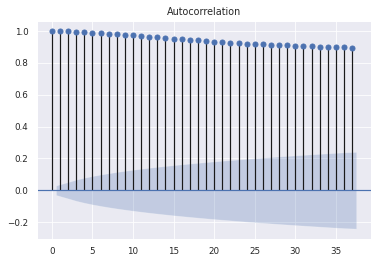

In [ ]:
for sensor_df in merged_groups.values():
  plot_acf(sensor_df['HUM'])

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/utils.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

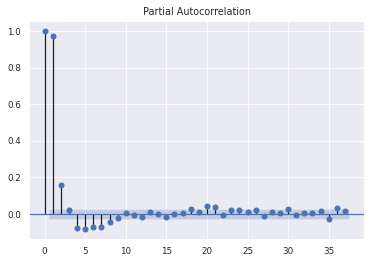

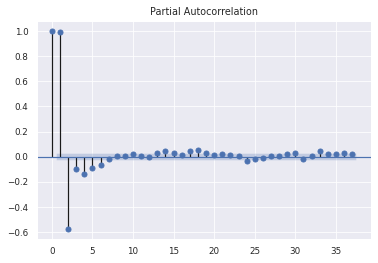

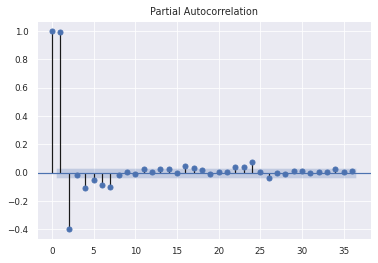

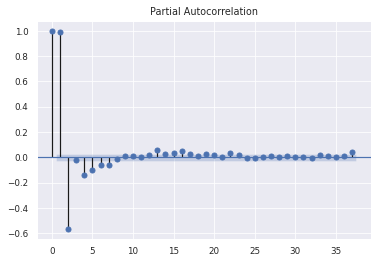

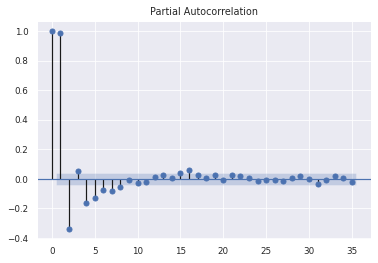

...

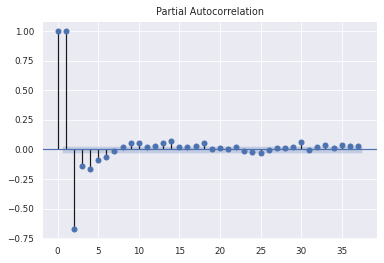

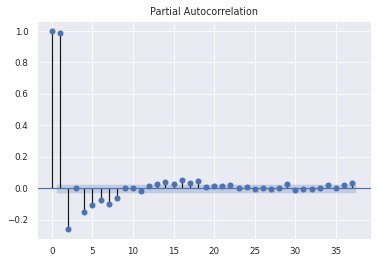

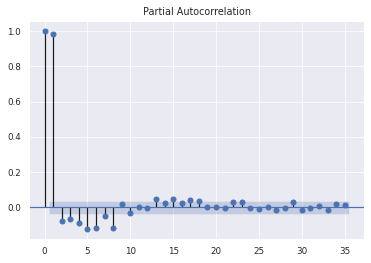

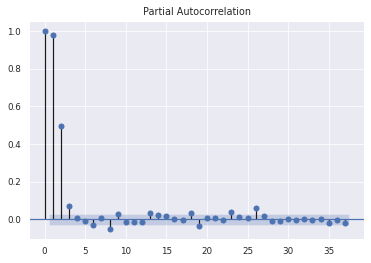

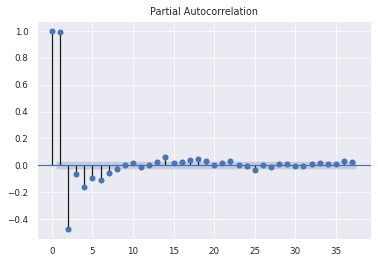

In [ ]:
for sensor_df in merged_groups.values():
  plot_pacf(sensor_df['TEMP'])

### Scale [-1, 1]

In [ ]:
# scale range
a = -1
b = 1

# Which are the MAX and MIN of each column??
Max_temp = -9999
Max_humid = -9999

min_temp = 9999
min_humid = 9999

for sensor_df in merged_groups.values():
    sensor_np = sensor_df.drop(columns='ADDR').to_numpy()
    for j in range(len(sensor_np)):
      if sensor_np[j,0] > Max_temp:
          Max_temp = sensor_np[j,0]
      if sensor_np[j,0] < min_temp:
          min_temp = sensor_np[j,0]
          
      if sensor_np[j,1] > Max_humid:
          Max_humid = sensor_np[j,1]
      if sensor_np[j,1] < min_humid:
          min_humid = sensor_np[j,1]

print(f'Max Temp: {Max_temp}')
print(f'min Temp: {min_temp}')
print(' ')

print(f'Max Humid: {Max_humid}')
print(f'min Humid: {min_humid}')
print(' ')

# Scaling between -1 and 1
diff_temp = Max_temp - min_temp
diff_humid = Max_humid - min_humid

scaled_groups = {} 

for i,sensor_df in enumerate(merged_groups.values()):
  sensor_np = sensor_df.drop(columns='ADDR').to_numpy()
  sensor_sc = np.empty(sensor_np.shape)
  for j in range(len(sensor_np)):
    sensor_sc[j,0] = ((b-a)*(sensor_np[j,0] - min_temp) /(diff_temp) ) + a
    sensor_sc[j,1] = ((b-a)*(sensor_np[j,1] - min_humid)/(diff_humid)) + a
  scaled_groups[i] = sensor_sc

print(f'Len of dict of scaled groups: {len(scaled_groups)}')

Max Temp: 46.94
min Temp: 8.14
 
Max Humid: 23.03
min Humid: 3.0
 
Len of dict of scaled groups: 35


### Prepare data to supervised problem

In [ ]:
# split a multivariate sequence into samples
def split_sequences(sequences, n_steps_in, n_steps_out):
	X, y = list(), list()
	for i in range(len(sequences)):
		# find the end of this pattern
		end_ix = i + n_steps_in
		out_end_ix = end_ix + n_steps_out
		# check if we are beyond the dataset
		if out_end_ix > len(sequences):
			break
		# gather input and output parts of the pattern
		seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, :]
		X.append(seq_x)
		y.append(seq_y)
	return X, y

In [ ]:
n_steps_in = 24
n_steps_out = 1

X = []
y = []
label_sensor = []
for i, sensor_np in enumerate(scaled_groups.values()):
    sensor_X, sensor_y = split_sequences(sensor_np, n_steps_in, n_steps_out)
    for j in range(len(sensor_X)):
      label_sensor.append(i)
    X.extend(sensor_X)
    y.extend(sensor_y)
    
X_sc = np.array(X)
y_sc = np.array(y)
label_sc = np.array(label_sensor)
print(X_sc.shape)
print(y_sc.shape)
print(label_sc.shape)

(125763, 24, 2)
(125763, 1, 2)
(125763,)


In [ ]:
# Number of classes
n_classes = len(np.unique(label_sc))
n_classes

35

In [ ]:
print(f'Sensor #{label_sc[0]}\n')
print(X_sc[0])
print('\n')
print(y_sc[0]) 

Sensor #0

[[ 0.51804124 -0.77234149]
 [ 0.49278351 -0.76734898]
 [ 0.48814433 -0.76635047]
 [ 0.51649485 -0.7763355 ]
 [ 0.49793814 -0.7783325 ]
 [ 0.48298969 -0.77034448]
 [ 0.48453608 -0.77234149]
 [ 0.49536082 -0.77533699]
 [ 0.46804124 -0.77034448]
 [ 0.45721649 -0.76834748]
 [ 0.43917526 -0.76635047]
 [ 0.42628866 -0.76435347]
 [ 0.4128866  -0.75736395]
 [ 0.43298969 -0.76535197]
 [ 0.38814433 -0.75336995]
 [ 0.38556701 -0.75636545]
 [ 0.42989691 -0.77034448]
 [ 0.41804124 -0.76934598]
 [ 0.41546392 -0.77034448]
 [ 0.4        -0.76635047]
 [ 0.38453608 -0.76235647]
 [ 0.41804124 -0.77333999]
 [ 0.39020619 -0.76635047]
 [ 0.39536082 -0.77034448]]


[[ 0.41907216 -0.777334  ]]


Sensor #18


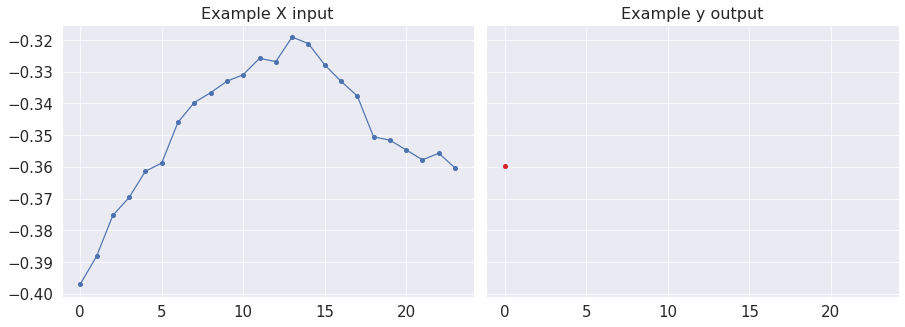

In [ ]:
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_sc[66666,:,0], marker='.', ms=8)
axs[0].set_title('Example X input', fontsize=16)
axs[1].plot(y_sc[66666,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y output', fontsize=16)
print(f'Sensor #{label_sc[66666]}')

### Split Train - Test

In [ ]:
list_ix_ = list(range(0,X_sc.shape[0]))
print(len(list_ix_))

125763


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
random_seed = 73

list_ix = shuffle(list_ix_, random_state=random_seed)

max_val_ix = 9999999
max_test_ix = 9999999
security_margin = len(list_ix) - (n_steps_in) 

while (max_val_ix > security_margin or max_test_ix > security_margin):
  train_ix, val_test_ix = train_test_split(list_ix, test_size=0.25, train_size=0.75, random_state=random_seed)
  val_ix, test_ix = train_test_split(val_test_ix, test_size=0.60, train_size=0.40, random_state=random_seed)
  max_val_ix = np.amax(val_ix)
  max_test_ix = np.amax(test_ix)
  random_seed += 73

print(f'len(train_ix): {len(train_ix)}')
print(f'len(val_ix): {len(val_ix)}')
print(f'len(test_ix): {len(test_ix)}')

len(train_ix): 94322
len(val_ix): 12576
len(test_ix): 18865


In [ ]:
X_train = X_sc[train_ix]
X_val = X_sc[val_ix]
X_test = X_sc[test_ix]

y_train = y_sc[train_ix]
y_val = y_sc[val_ix]
y_test = y_sc[test_ix]

label_train = label_sc[train_ix].astype('float32')
label_val = label_sc[val_ix].astype('float32')
label_test = label_sc[test_ix].astype('float32')

In [ ]:
print(f'X_train shape: {X_train.shape}')
print(f'X_val shape: {X_val.shape}')
print(f'X_test shape: {X_test.shape}')
print('')
print(f'y_train shape: {y_train.shape}')
print(f'y_val shape: {y_val.shape}')
print(f'y_test shape: {y_test.shape}')
print('')
print(f'label_train shape: {label_train.shape}')
print(f'label_val shape: {label_val.shape}')
print(f'label_test shape: {label_test.shape}')

X_train shape: (94322, 24, 2)
X_val shape: (12576, 24, 2)
X_test shape: (18865, 24, 2)

y_train shape: (94322, 1, 2)
y_val shape: (12576, 1, 2)
y_test shape: (18865, 1, 2)

label_train shape: (94322,)
label_val shape: (12576,)
label_test shape: (18865,)


Sensor #22.0


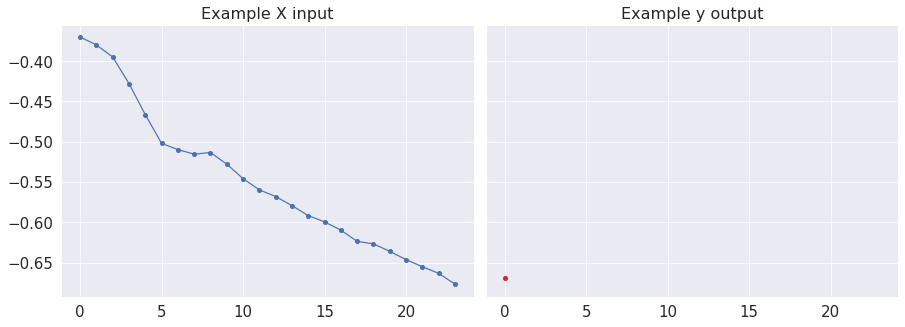

In [ ]:
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_val[600,:,0], marker='.', ms=8)
axs[0].set_title('Example X input', fontsize=16)
axs[1].plot(y_val[600,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y output', fontsize=16)
print(f'Sensor #{label_val[600]}')

In [ ]:
# constants/lists for later use
X_train_list = list(X_train)
X_train_len = len(X_train)
X_val_len = len(X_val)
X_test_len = len(X_test)
X_len = len(X_sc)

In [ ]:
X_val_range = np.arange(X_val_len)
print(X_val_range.shape)
print(X_val_range)

(12576,)
[    0     1     2 ... 12573 12574 12575]


In [ ]:
# get real values for comparison - validation set
n_prediction = 24
y_val_real_long = np.empty([X_val_len, n_prediction, 2])
for k, index in enumerate(val_ix):
    index_plus = index + n_prediction
    y_val_real_ = y_sc[index:index_plus, :, :]
    y_val_real = y_val_real_.reshape(1, n_prediction, 2)
    y_val_real_long[k,:,:] = y_val_real
print(f'y_val_real_long shape {y_val_real_long.shape}')

y_val_real_long shape (12576, 24, 2)


Sensor #10.0


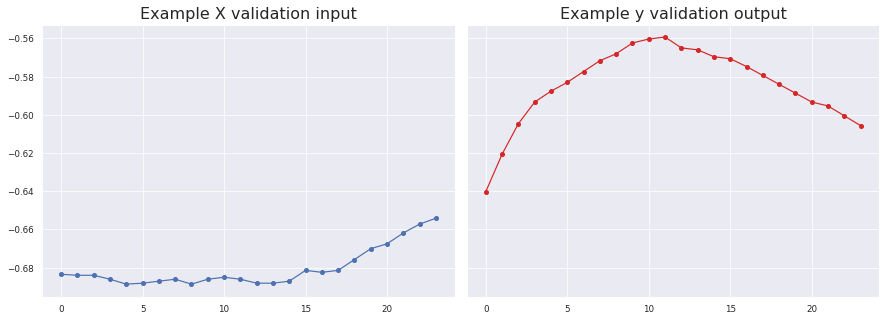

In [ ]:
sns.set_theme()
sns.set_context("paper")
fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),
                       gridspec_kw={'wspace': 0.03})
axs[0].plot(X_val[669,:,0], marker='.', ms=8)
axs[0].set_title('Example X validation input', fontsize=16)
axs[1].plot(y_val_real_long[669,:,0], 'tab:red', marker='.', ms=8)
axs[1].set_title('Example y validation output', fontsize=16)
print(f'Sensor #{label_val[666]}')

In [ ]:
# get real values for comparison - validation set
n_prediction = 24
y_test_real_long = np.empty([X_test_len, n_prediction, 2])
for k, index in enumerate(test_ix):
    index_plus = index + n_prediction
    y_test_real_ = y_sc[index:index_plus, :, :]
    y_test_real = y_test_real_.reshape(1, n_prediction, 2)
    y_test_real_long[k,:,:] = y_test_real
print(f'y_test_real_long shape {y_test_real_long.shape}')

y_test_real_long shape (18865, 24, 2)


In [ ]:
# dimensions for X to feed the models
dim_out_step = y_train.shape[1]
dim_in_step = X_train.shape[1]
dim_in_plus_out = X_train.shape[1] + y_train.shape[1]
dim_n_vars = X_train.shape[2]
print(f'dim_out_step {dim_out_step}')
print(f'dim_in_step {dim_in_step}')
print(f'dim_in_plus_out {dim_in_plus_out}')
print(f'dim_n_vars {dim_n_vars}')

dim_out_step 1
dim_in_step 24
dim_in_plus_out 25
dim_n_vars 2


In [ ]:
dict_variables = {
    0: 'Temp',
    1: 'Humid'
}

## Wasserstein GAN Gradient Penalty model

In [ ]:
from tensorflow.keras import backend
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras.layers import Dense, Conv1D, BatchNormalization, LSTM, LeakyReLU
from tensorflow.keras.layers import Flatten, Input, Dropout, concatenate, Embedding, Reshape
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.constraints import Constraint
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from tensorflow import concat
from tensorflow.keras.utils import plot_model
import tensorflow_addons as tfa
import tensorflow as tf

from astropy import stats

from math import log2, log, isclose

from scipy.special import kl_div, rel_entr
from scipy.spatial.distance import jensenshannon

from sklearn.metrics import r2_score, max_error, mean_absolute_error, mean_squared_error

In [ ]:
# define the standalone critic model
def define_critic(in_shape=(25, 2), n_classes=35):
	# weight initialization
	init = RandomNormal(stddev=0.02)
 	# define model
	# input time series
	input_layer = Input(shape=in_shape, name='Time-Series_Input')
	#real_next_ = input_layer[:,-1,:] 
	#real_next_layer = Dense(2)(real_next_)
	# block 1
	x = tfa.layers.SpectralNormalization(Conv1D(64, kernel_size=4, strides=1, padding='same', 
      				kernel_initializer=init))(input_layer)
	x = LeakyReLU(alpha=0.2)(x)
	# block 2
	x = tfa.layers.SpectralNormalization(Conv1D(128, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.2)(x)
  # block 3
	x = tfa.layers.SpectralNormalization(Conv1D(192, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.2)(x)
  # block 4
	x = tfa.layers.SpectralNormalization(Conv1D(384, kernel_size=4, strides=1, padding='same', 
                  kernel_initializer=init))(x)
	x = LeakyReLU(alpha=0.2)(x)
	# Dense block
	x = Flatten()(x)
	x = Dense(32)(x)
	x = LeakyReLU(alpha=0.2)(x)
	x = Dropout(0.15)(x)
  # label input
	in_label = Input(shape=(1,), name='Categorical_Input')
	emb_layer = Embedding(n_classes, 8)(in_label) 
	emb_layer = Dense(8)(emb_layer)
	emb_layer = Reshape((8,))(emb_layer)
  # output
	merge_out = concatenate([x, emb_layer])
	out_layer = Dense(16)(merge_out)
	out_layer = LeakyReLU(alpha=0.2)(out_layer)
	out_layer_ = Dense(1, activation='linear')(out_layer)
	model = Model([input_layer, in_label], out_layer_)
	print(model.summary())
	return model

# define the standalone generator model
def define_generator(latent_dim=8, in_shape=(24, 2), n_classes=35):
	# weight initialization
	init = RandomNormal(stddev=0.02)
 	# define model
	# inputs
	in_condition = Input(shape=in_shape, name='Time-Series_Input')
	x = LSTM(160, kernel_initializer=init, return_sequences=True)(in_condition)
	x = BatchNormalization()(x)
	x = LSTM(64, kernel_initializer=init, return_sequences=False)(x)
	x = BatchNormalization()(x)  
  # label input
	in_label = Input(shape=(1,), name='Categorical_Input')
	emb_layer = Embedding(n_classes, 8)(in_label)
	emb_layer = Dense(8)(emb_layer)
	emb_layer = BatchNormalization()(emb_layer)
	emb_layer = Reshape((8,))(emb_layer)
	# noise block
	in_noise = Input(shape=(latent_dim,), name='Noise_Input')
	# merge and dense block
	merge = concatenate([x, emb_layer, in_noise])
	out_layer = Dense(32)(merge)
	out_layer = BatchNormalization()(out_layer)
	out_layer = LeakyReLU(alpha=0.2)(out_layer)
	out_layer_ = Dense(2, activation='linear')(out_layer)
	model = Model([in_condition, in_label, in_noise], out_layer_)
	print(model.summary())
	return model

class WGAN(tf.keras.Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_extra_steps=5,
        gp_weight=10.0,
    ):
        super(WGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_extra_steps
        self.gp_weight = gp_weight

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super(WGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn

    def gradient_penalty(self, batch_size, labels, real_images, fake_images):
        # both have shape [None, 1, 2]
        # get the interplated image
        alpha = tf.random.normal([batch_size, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
            pred = self.discriminator([interpolated, labels], training=True)
        # 2. Calculate the gradients w.r.t to this interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        # For each batch:
        # 1. Train the generator and get the generator loss
        # 2. Train the discriminator and get the discriminator loss
        # 3. Calculate the gradient penalty
        # 4. Multiply this gradient penalty with a constant weight factor
        # 5. Add gradient penalty to the discriminator loss
        # 6. Return generator and discriminator losses as a loss dictionary.
        input_data, labels = real_images
        real_next_ = input_data[:,-1,:] 
        real_next =  backend.expand_dims(real_next_,axis=1) #[None, 1, 2]
        X_cond = input_data[:,:-1,:] #[None, 24, 2]
        # Get the batch size
        batch_size = tf.shape(input_data)[0]
        # Train discriminator first. The original paper recommends training
        # the discriminator for `x` more steps (typically 5) as compared to
        # one step of the generator
        for i in range(self.d_steps):
            # Get the latent vector
            random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
            with tf.GradientTape() as tape:
                # Generate fake images from the latent vector
                fake_images_ = self.generator([X_cond, labels, random_latent_vectors], training=True)
                fake_images_ = backend.expand_dims(fake_images_,axis=1)
                fake_images = concat([X_cond,fake_images_],axis=1)
                # Get the logits for the fake images
                fake_logits = self.discriminator([fake_images, labels], training=True)
                # Get the logits for real images
                real_logits =self.discriminator([input_data, labels], training=True)

                # Calculate discriminator loss using fake and real logits
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Calculate the gradient penalty
                gp = self.gradient_penalty(batch_size, labels, input_data, fake_images)
                # Add the gradient penalty to the original discriminator loss
                d_loss = d_cost + gp * self.gp_weight
            # Get the gradients w.r.t the discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
            # Update the weights of the discriminator using the discriminator optimizer
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )
        # Train the generator now.
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Generate fake images using the generator
            gen_images_ = self.generator([X_cond, labels, random_latent_vectors], training=True)
            gen_images_ = backend.expand_dims(gen_images_,axis=1)
            generated_images = concat([X_cond,gen_images_],axis=1)
            # Get the discriminator logits for fake images
            gen_img_logits = self.discriminator([generated_images, labels], training=True)
            # Calculate the generator loss
            g_loss = self.g_loss_fn(gen_img_logits)
        # Get the gradients w.r.t the generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update the weights of the generator using the generator optimizer
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}

class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, num_test=2500, latent_dim=8, previous_KL=9999, previous_MSE=9999, previous_Pinball=9999):
        self.num_test = num_test
        self.latent_dim = latent_dim
        self.previous_KL = previous_KL
        self.previous_MSE = previous_MSE
        self.previous_Pinball = previous_Pinball
        self.d_hist = list()
        self.g_hist = list()

    def on_train_batch_end(self, batch, logs=None):
      # append losses for visualization later
      self.d_hist.append(logs.get('d_loss'))
      self.g_hist.append(logs.get('g_loss'))

    def on_epoch_end(self, epoch, logs=None):
      previous_KL = self.previous_KL
      previous_MSE = self.previous_MSE
      previous_Pinball = self.previous_Pinball
      step = epoch
      c_model = self.model.discriminator
      g_model = self.model.generator
      latent_dim = self.latent_dim
      n_prediction = 24
      n_plots = 4
      n_samples = X_val_len

      # Get predictions
      X_aux_2 = np.copy(X_val)
      for p in range(n_prediction):
      	noise_input = tf.random.normal(shape=(n_samples, latent_dim))
      	y_gen_ = g_model.predict([X_aux_2, label_val, noise_input]) #Step 1: Predict [val_len,2]
      	y_gen = y_gen_[:,np.newaxis,:] #[val_len,1,2]
      	if p == 0: #Step 2: Save prediction
      	  y_gen_final = y_gen.copy() 
      	else:
      	  y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
      	X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      	X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
      
      # invert scale
      y_real_inv = np.empty(y_val_real_long.shape)
      y_gen_inv = np.empty(y_gen_final.shape)
      X_cond_inv = np.empty(X_val.shape)
      for s in range(n_samples):
      	for r in range(n_prediction):
      		y_real_inv[s,r,0] = (y_val_real_long[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		y_real_inv[s,r,1] = (y_val_real_long[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
      		y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
      	for t in range(n_prediction):
      		X_cond_inv[s,t,0] = (X_val[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
      		X_cond_inv[s,t,1] = (X_val[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
        
      temp_real = y_real_inv[:,:,0]
      flat_temp_real = temp_real.flatten()
      temp_gen = y_gen_inv[:,:,0]
      flat_temp_gen = temp_gen.flatten()
      humid_real = y_real_inv[:,:,1]
      flat_humid_real = humid_real.flatten()
      humid_gen = y_gen_inv[:,:,1]
      flat_humid_gen = humid_gen.flatten()

      ### METRICS ###

			# KL divergence with 2D histogram
      H_compute_bins_temp = np.histogram(flat_temp_real, bins='auto')
      H_compute_bins_humid = np.histogram(flat_humid_real, bins='auto')
      n_bins_temp = H_compute_bins_humid[0].shape[0]
      n_bins_humid = H_compute_bins_humid[0].shape[0]
      # If we add more than 2 variables we will need to use np.histogramdd
      H_real, xedges_real, yedges_real = np.histogram2d(flat_temp_real, flat_humid_real, bins=[n_bins_temp,n_bins_humid])
      H_real = (np.where(H_real==0, 1e-6, H_real).flatten())/len(flat_temp_real)
      H_gen, xedges_gen, yedges_gen = np.histogram2d(flat_temp_gen, flat_humid_gen, bins=[n_bins_temp,n_bins_humid])
      H_gen = (np.where(H_gen==0, 1e-6, H_gen).flatten())/len(flat_temp_gen)
      assert isclose(sum(H_real),1.,rel_tol=1e-5)
      assert isclose(sum(H_gen), 1.,rel_tol=1e-5)
      KL_diverg = kl_divergence(H_gen,H_real)

      # Pinball Loss Function
      pinball_temp = list()
      pinball_humid = list()
      tau = [0.1, 0.3, 0.5, 0.7, 0.9]
      for t in tau:
        pinball_temp.append(pinball_func(flat_temp_real, flat_temp_gen, tau=t))
        pinball_humid.append(pinball_func(flat_humid_real, flat_humid_gen, tau=t))

      pinball_mean_temp = sum(pinball_temp)/(len(pinball_temp))
      pinball_mean_humid = sum(pinball_humid)/(len(pinball_humid))
      Pinball_mean = (pinball_mean_temp + pinball_mean_humid)/2

			#MSE
      MSE_temp = mean_absolute_error(flat_temp_real, flat_temp_gen)
      MSE_humid = mean_absolute_error(flat_humid_real, flat_humid_gen)
      MSE_mean = (MSE_temp + MSE_humid)/2

      # random samples fron validation set to plot
      ix_plot = np.random.choice(X_val_range, n_plots, replace=False)

      # save models
      tail_name_kl = ''
      tail_name_pinball = ''
      tail_name_mse = ''
      save_models = False
      print('')
      if (KL_diverg < previous_KL):
      	self.previous_KL = KL_diverg
      	save_models = True
      	tail_name_kl = '_KL'
      	print('Better KL')
      if (Pinball_mean < previous_Pinball):
      	self.previous_Pinball = Pinball_mean
      	save_models = True
      	tail_name_pinball = '_Pinball'
      	print('Better Pinball')
      if (MSE_mean < previous_MSE):
      	self.previous_MSE = MSE_mean
      	save_models = True
      	tail_name_mse = '_MSE'
      	print('Better MSE')
      # EAAI
      if step%50==0:
      	save_models = True
      	tail_name_mse = '_50s'
      	print('Save each 50 steps')
      # EAAI
      if save_models == True:
        filename_critic = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'c_model_'+str(step+1)+tail_name_kl+tail_name_pinball+tail_name_mse
        c_model.save_weights(filename_critic)
        filename_generator = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'gen_model_'+str(step+1)+tail_name_kl+tail_name_pinball+tail_name_mse
        g_model.save_weights(filename_generator)
        print(f'>{step+1} MODELS HAVE BEEN SAVED')
        # save data
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_temp_real.npy'
        np.save(filename, temp_real)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_temp_gen.npy'
        np.save(filename, temp_gen)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_humid_real.npy'
        np.save(filename, humid_real)
        filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_humid_gen.npy'
        np.save(filename, humid_gen)
        # plot images and metrics
        for num, i in enumerate(ix_plot):
          for j in range(dim_n_vars):
            fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
            axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
            name = dict_variables[j] + ' - Input'
            axs[0].set_title(name, fontsize=16)
            axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
            axs[1].plot(y_gen_inv[i,:,j], 'tab:red', marker='.', ms=8)
            axs[1].set_title('Output (red: predicted)', fontsize=16)
            filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_'+str(i)+'_'+str(dict_variables[j])+'.png'
            plt.savefig(filename_img)
            plt.show()
            plt.close()
            print(f'Sensor #{label_val[i]}')
            print(dict_variables[j])
						# mean absolute error ± standard deviation
            error_np = np.subtract(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            mae = mean_absolute_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            std = np.std(error_np)
            print(f'MAE: {mae} ± {std}') 
            # mean squared error
            mse = mean_squared_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            print(f'MSE: {mse}') 
						# root mean square error
            rmse = np.sqrt(mse)
            print(f'RMSE: {rmse}') 
						# max error
            max_err = max_error(y_real_inv[i,:,j], y_gen_inv[i,:,j])
            print(f'Max Error: {max_err}') 
      #Print global metrics
      print(f'\nKL Divergence: {KL_diverg} bits')
      print(f'Pinball Loss Temp mean: {pinball_mean_temp}')
      print(f'Pinball Loss Humid mean: {pinball_mean_humid}')
      print(f'MSE Temp: {MSE_temp}')
      print(f'MSE Humid: {MSE_humid}')
      # plot histograms
      fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(12,4),gridspec_kw={'wspace': 0.03})
      #axs[0].hist(flat_temp_real, bins='auto')
      axs[0].set_title('Temp Real Distribution', fontsize=14)
      sns.histplot(flat_temp_real, bins=n_bins_temp, ax=axs[0])
      #axs[1].hist(flat_temp_gen, bins='auto')
      axs[1].set_title('Temp Generated Distribution', fontsize=14)
      sns.histplot(flat_temp_gen, bins=n_bins_temp, ax=axs[1])
      filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_histogram_temp.png'
      plt.savefig(filename_img)
      plt.show()
      plt.close()
      fig,axs = plt.subplots(1,dim_n_vars,sharey=True,sharex=True,figsize=(12,4),gridspec_kw={'wspace': 0.03})
      #axs[0].hist(flat_humid_real, bins='auto')
      axs[0].set_title('Humid Real Distribution', fontsize=14)
      sns.histplot(flat_humid_real, bins=n_bins_humid, ax=axs[0])
      #axs[1].hist(flat_humid_gen, bins='auto')
      axs[1].set_title('Humid Generated Distribution', fontsize=14)
      sns.histplot(flat_humid_gen, bins=n_bins_humid, ax=axs[1])
      filename_img = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_histogram_humid.png'
      plt.savefig(filename_img)
      plt.show()
      plt.close()
      # plot and save history
      plot_history(self.d_hist, self.g_hist, step)

# pinball loss function [https://www.tensorflow.org/addons/api_docs/python/tfa/losses/pinball_loss]
def pinball_func(y_true, y_pred, tau):
	values = list()
	for l in range(len(y_true)):
		values.append(max(tau*(y_true[l] - y_pred[l]), (tau - 1)*(y_true[l] - y_pred[l])))
	return (sum(values)/len(values))

# calculate the kl divergence in bits
def kl_divergence(p,q):
	return sum((p[i] * log2(p[i]/q[i]) for i in range(len(p))))

# calculate the kl divergence in nats
def kl_divergence_nats(p,q):
	return sum((p[i] * log(p[i]/q[i]) for i in range(len(p))))

# create a line plot of loss for the gan and save to file
def plot_history(d_hist, g_hist, step):
	# plot history
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'final_d_hist.npy'
	np.save(filename, d_hist)
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+'final_g_hist.npy'
	np.save(filename, g_hist)
	plt.plot(d_hist, label='crit')
	plt.plot(g_hist, label='gen')
	plt.legend()
	#pyplot.savefig('plot_line_plot_loss.png')
	#pyplot.close()
	filename = '/content/drive/My Drive/TFM/Experiments/'+folder_name+'/'+str(step+1)+'_final_train_loss.png'
	plt.savefig(filename)
	plt.show()
	plt.close()
 
# Define the loss functions to be used for discrimiator
# This should be (fake_loss - real_loss)
# We will add the gradient penalty later to this loss function
def discriminator_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss

# Define the loss functions to be used for generator
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

In [ ]:
# Adam optimizer
d_opt_Adam = Adam(learning_rate=0.0003, beta_1=0.5, beta_2=0.9)
g_opt_Adam = Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.9)

### Alternative Optimizers [AdaBelief, OMD]

In [ ]:
# AdaBelief optimizer
!pip install adabelief-tf==0.1.0

In [ ]:
from adabelief_tf import AdaBeliefOptimizer
d_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=1e-2, epsilon=1e-10, rectify=False, weight_decay=1.2e-6)
g_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=3.3e-3, epsilon=1e-10, rectify=False, weight_decay=1.2e-6)
#g_opt_AdaBelief = AdaBeliefOptimizer(learning_rate=2e-4, epsilon=1e-10, rectify=False)

Please check your arguments if you have upgraded adabelief-tf from version 0.0.1.
Modifications to default arguments:
                           eps  weight_decouple    rectify
-----------------------  -----  -----------------  -------------
adabelief-tf=0.0.1       1e-08  Not supported      Not supported
Current version (0.1.0)  1e-14  supported          default: True
For a complete table of recommended hyperparameters, see
https://github.com/juntang-zhuang/Adabelief-Optimizer

Please check your arguments if you have upgraded adabelief-tf from version 0.0.1.
Modifications to default arguments:
                           eps  weight_decouple    rectify
-----------------------  -----  -----------------  -------------
adabelief-tf=0.0.1       1e-08  Not supported      Not supported
Current version (0.1.0)  1e-14  supported          default: True
For a complete table of recommended hyperparameters, see
https://github.com/juntang-zhuang/Adabelief-Optimizer



In [ ]:
# Optimistic Mirror Descent for the Adam optimizer
from tensorflow.keras.optimizers import Optimizer
class optimAdam(Optimizer):
    def __init__(self, lr=0.001, beta_1=0.9, beta_2=0.999,
                 epsilon=1e-8, decay=0., **kwargs):
        super(optimAdam, self).__init__(**kwargs)
        with backend.name_scope(self.__class__.__name__):
            self.iterations = backend.variable(0, dtype='int64', name='iterations')
            self.lr = backend.variable(lr, name='lr')
            self.beta_1 = backend.variable(beta_1, name='beta_1')
            self.beta_2 = backend.variable(beta_2, name='beta_2')
            self.decay = backend.variable(decay, name='decay')
        self.epsilon = epsilon
        self.initial_decay = decay

    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [backend.update_add(self.iterations, 1)]

        lr = self.lr
        if self.initial_decay > 0:
            lr *= (1. / (1. + self.decay * backend.cast(self.iterations,
                                                  backend.dtype(self.decay))))

        t = backend.cast(self.iterations, backend.floatx()) + 1
        lr_t = lr * (backend.sqrt(1. - backend.pow(self.beta_2, t)) /
                     (1. - backend.pow(self.beta_1, t)))

        ms = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        vs = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        self.weights = [self.iterations] + ms + vs
        ms_old = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]
        vs_old = [backend.zeros(backend.int_shape(p), dtype=backend.dtype(p)) for p in params]

        for p, g, m, v, m_old, v_old in zip(params, grads, ms, vs, ms_old, vs_old):
            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * backend.square(g)
            p_t = p - 2 * lr_t * m_t / (backend.sqrt(v_t) + self.epsilon) + lr_t * m_old / (backend.sqrt(v_old) + self.epsilon)

            self.updates.append(backend.update(m_old, m))
            self.updates.append(backend.update(v_old, v))
            self.updates.append(backend.update(m, m_t))
            self.updates.append(backend.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(backend.update(p, new_p))
        return self.updates

    def get_config(self):
        config = {'lr': float(backend.get_value(self.lr)),
                  'beta_1': float(backend.get_value(self.beta_1)),
                  'beta_2': float(backend.get_value(self.beta_2)),
                  'decay': float(backend.get_value(self.decay)),
                  'epsilon': self.epsilon}
        base_config = super(optimAdam, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

In [ ]:
# Get the Optimistic Mirror Adam optimizer
d_opt_OptimisticAdam = optimAdam(lr=0.003, beta_1=0.9, beta_2=0.999, epsilon=1e-8, decay=0., name='d_opt_OptimisticAdam')
g_opt_OptimisticAdam = optimAdam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-8, decay=0., name='g_opt_OptimisticAdam')

### Plot models

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Time-Series_Input (InputLayer)  [(None, 25, 2)]     0           []                               
                                                                                                  
 spectral_normalization (Spectr  (None, 25, 64)      640         ['Time-Series_Input[0][0]']      
 alNormalization)                                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 25, 64)       0           ['spectral_normalization[0][0]'] 
                                                                                                  
 spectral_normalization_1 (Spec  (None, 25, 128)     33024       ['leaky_re_lu[0][0]']        

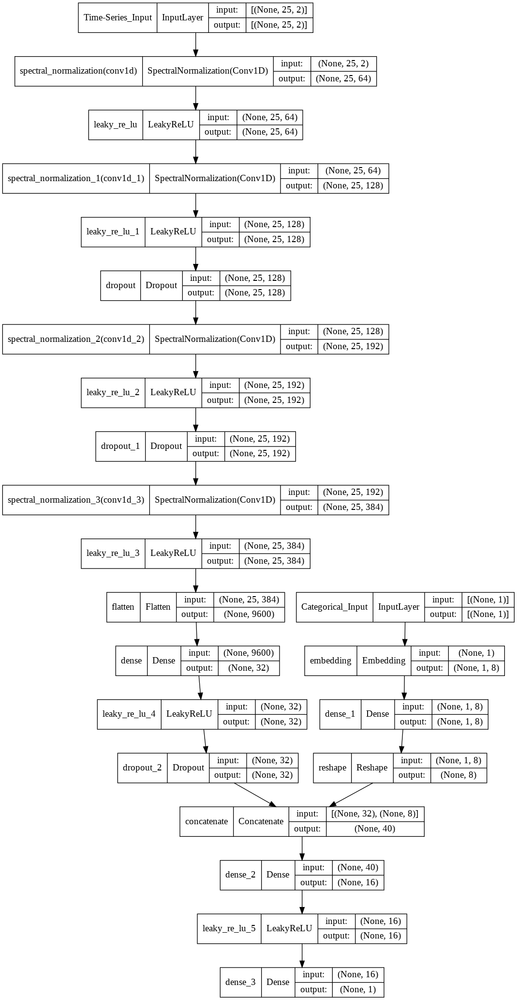

In [ ]:
d_model = define_critic(in_shape=(25, 2), n_classes=35)
plot_model(d_model, show_shapes=True)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Time-Series_Input (InputLayer)  [(None, 24, 2)]     0           []                               
                                                                                                  
 Categorical_Input (InputLayer)  [(None, 1)]         0           []                               
                                                                                                  
 lstm (LSTM)                    (None, 24, 160)      104320      ['Time-Series_Input[0][0]']      
                                                                                                  
 embedding_1 (Embedding)        (None, 1, 8)         280         ['Categorical_Input[0][0]']      
                                                                                            

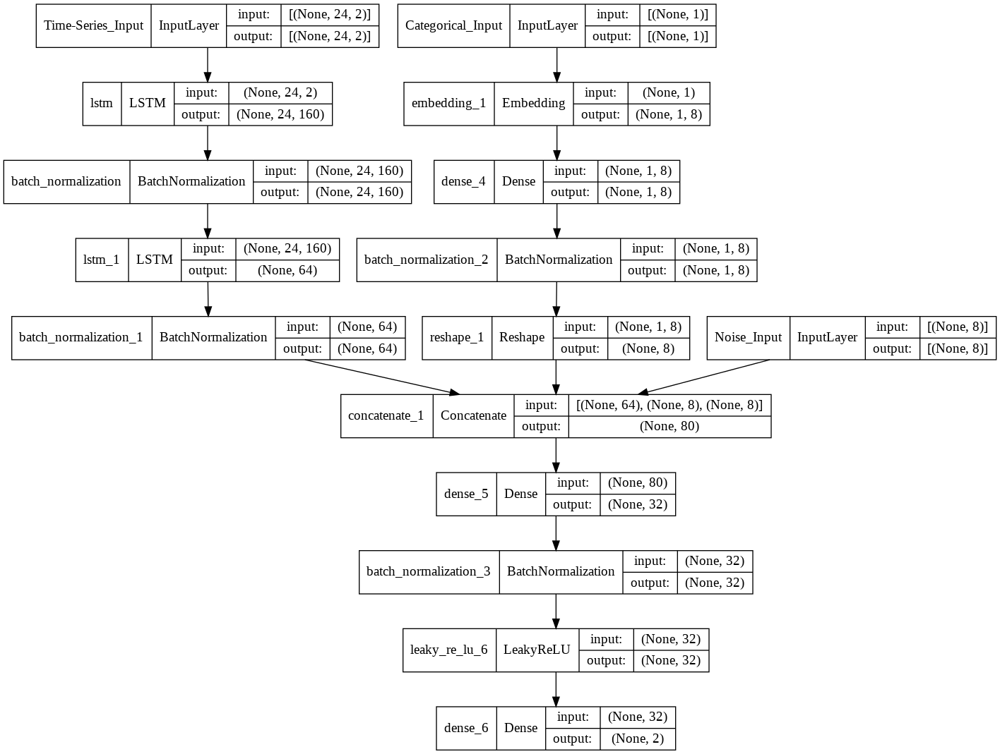

In [ ]:
g_model = define_generator(latent_dim=8, in_shape=(24, 2), n_classes=35)
plot_model(g_model, show_shapes=True)

## Training


In [ ]:
# prueba_EAAI
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 300
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_train,y_train),axis=1)
history = wgan.fit(x=X_to_fit, y=label_train, batch_size=64, epochs=epochs, callbacks=[cbk])

Output hidden; open in https://colab.research.google.com to view.

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization_4 (Spect (None, 25, 64)       640         input_6[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_7 (LeakyReLU)       (None, 25, 64)       0           spectral_normalization_4[0][0]   
__________________________________________________________________________________________________
spectral_normalization_5 (Spect (None, 25, 128)      33024       leaky_re_lu_7[0][0]              
_______________________________________________________________________________________

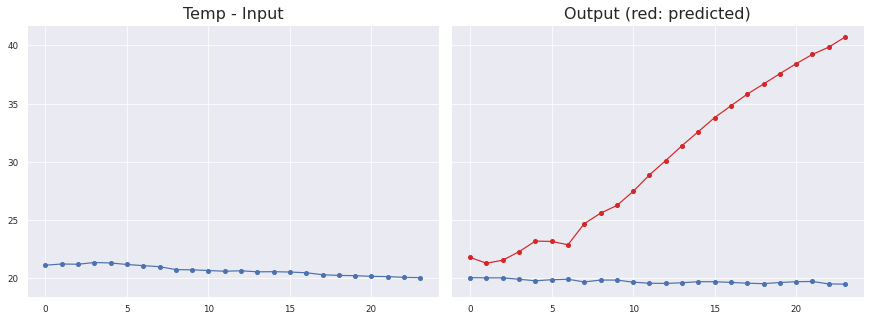

Sensor #18.0
Temp
MAE: 10.271335111067941 ± 6.711852748751287
MSE: 150.54929228477727
RMSE: 12.269852985459005
Max Error: 21.233415544033047


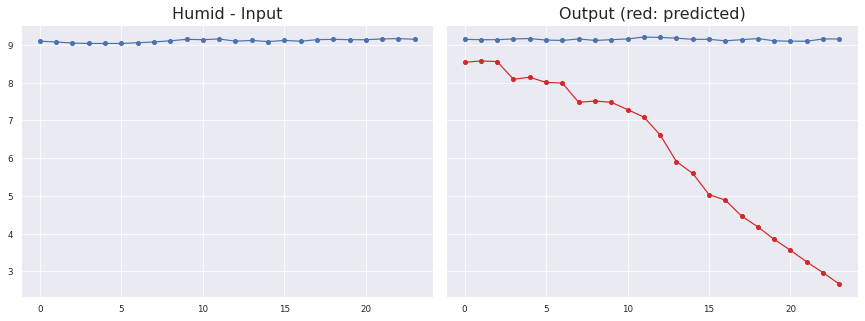

Sensor #18.0
Humid
MAE: 2.9923427870124577 ± 1.957553098708113
MSE: 12.786129489247216
RMSE: 3.575769775761188
Max Error: 6.500976005196572


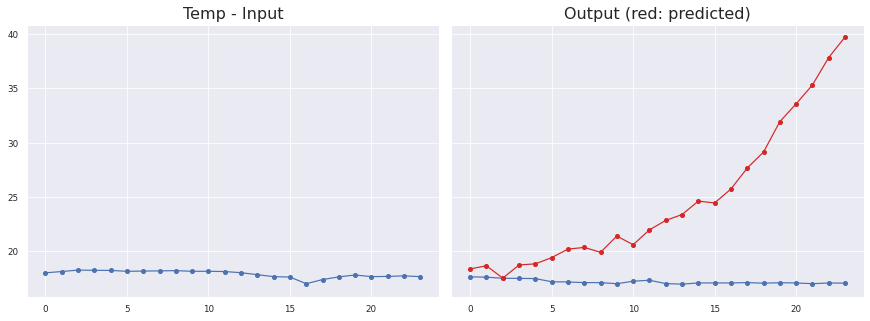

Sensor #6.0
Temp
MAE: 7.461089916558314 ± 6.554778749803345
MSE: 98.63298720184166
RMSE: 9.931414159214269
Max Error: 22.60867932796478


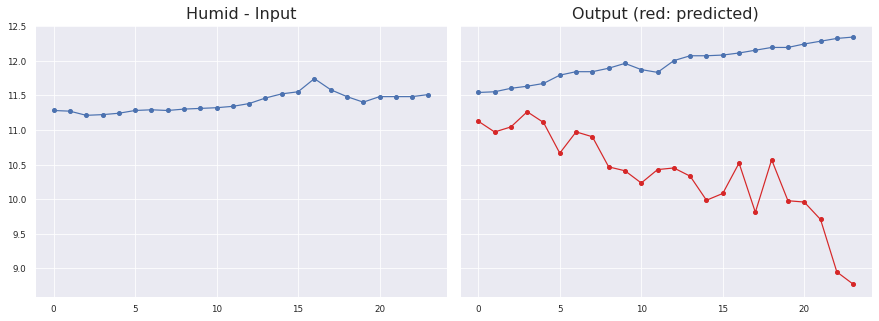

Sensor #6.0
Humid
MAE: 1.598348438246175 ± 0.8453101185755236
MSE: 3.2692669266101526
RMSE: 1.8081114253856572
Max Error: 3.56704138368368


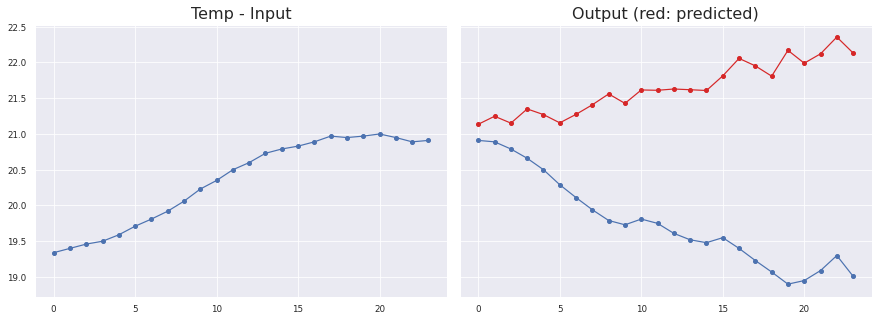

Sensor #5.0
Temp
MAE: 1.8827276865144575 ± 0.9490278257495455
MSE: 4.44531735561499
RMSE: 2.108392125676576
Max Error: 3.2695768678188344


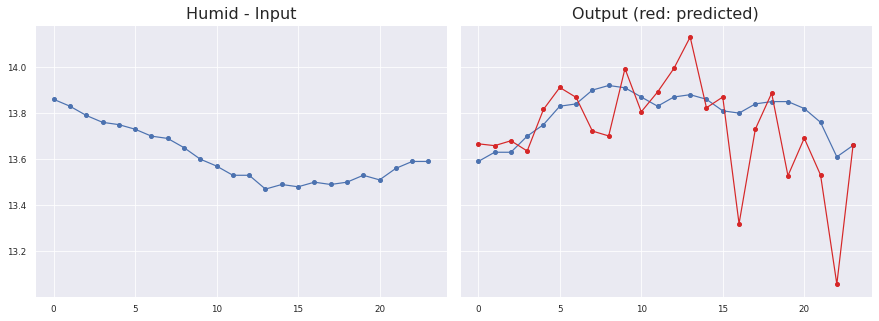

Sensor #5.0
Humid
MAE: 0.13895723532885285 ± 0.1869799138453361
MSE: 0.038536701912245064
RMSE: 0.19630767155729056
Max Error: 0.5528289879113419


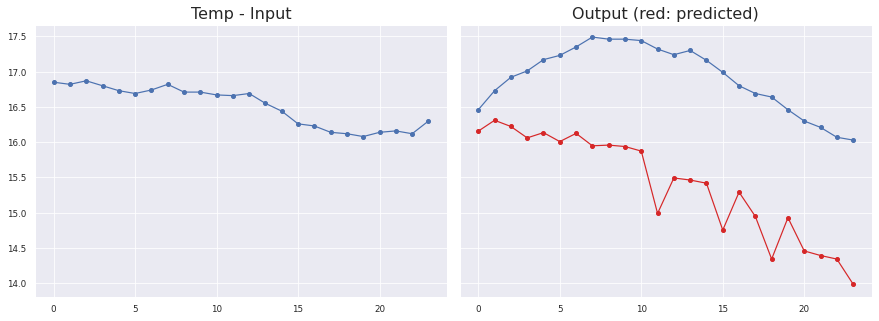

Sensor #30.0
Temp
MAE: 1.5153333637118347 ± 0.5257461658773451
MSE: 2.572644234112952
RMSE: 1.6039464561240666
Max Error: 2.3295905399322514


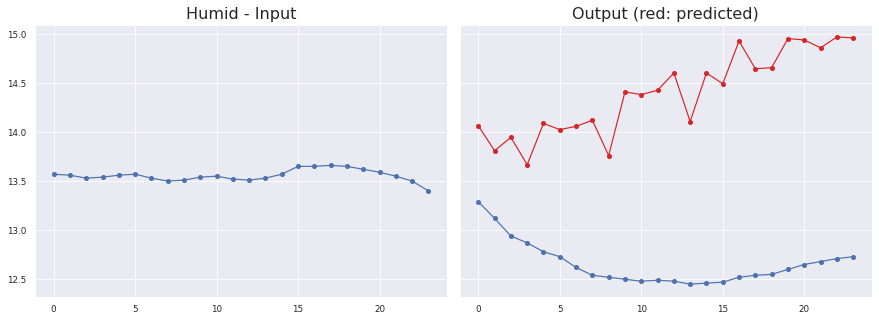

Sensor #30.0
Humid
MAE: 1.738659967544179 ± 0.5319245411637972
MSE: 3.3058822002330417
RMSE: 1.8182085139590127
Max Error: 2.4070045066624886

KL Divergence: 14.189862370786871 bits
Pinball Loss Temp mean: 3.532413368868169
Pinball Loss Humid mean: 0.8955054433518036
MSE Temp: 7.064826737736339
MSE Humid: 1.7910108867036245


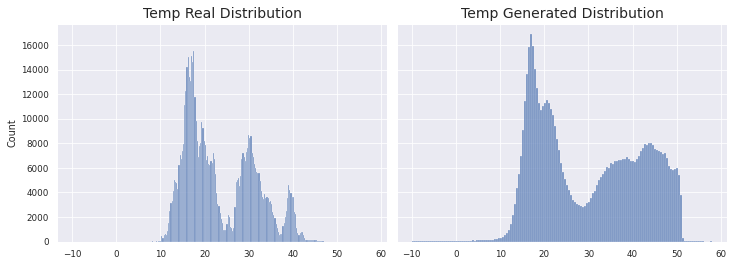

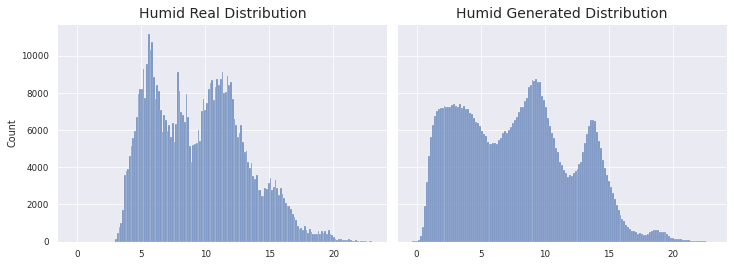

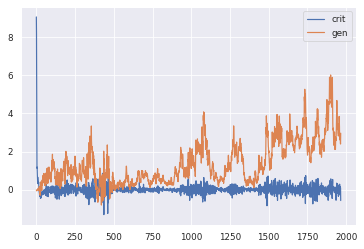

1966/1966 [==============================] - 236s 120ms/step - d_loss: 0.0133 - g_loss: 1.3735
Epoch 2/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0101 - g_loss: -0.1604
Better KL
Better Pinball
Better MSE
>2 MODELS HAVE BEEN SAVED


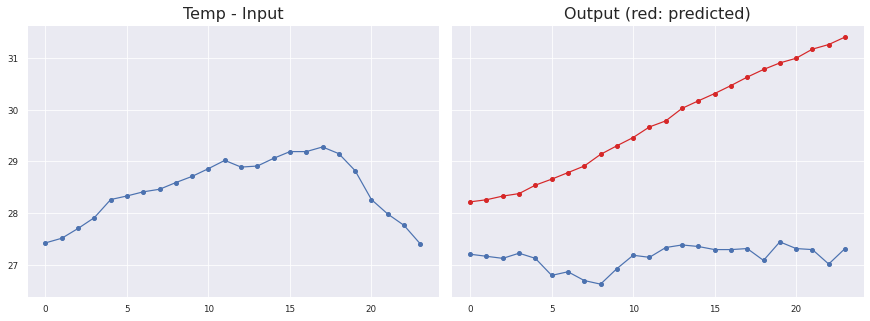

Sensor #7.0
Temp
MAE: 2.590766196946302 ± 0.9664502850371408
MSE: 7.646095640687977
RMSE: 2.765157435063685
Max Error: 4.256009842753407


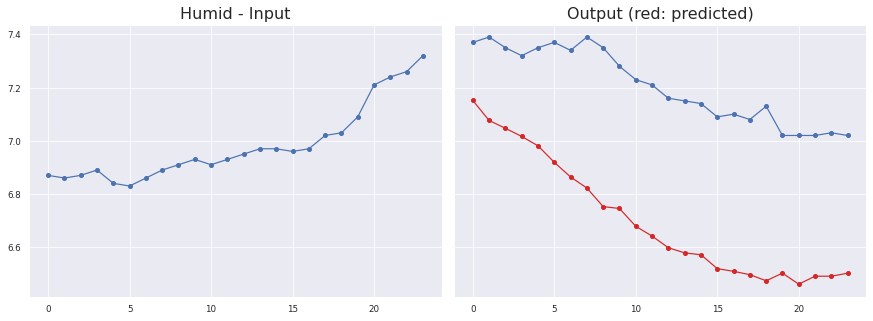

Sensor #7.0
Humid
MAE: 0.5007945585747555 ± 0.11161616224061019
MSE: 0.26325335757140644
RMSE: 0.5130822132674319
Max Error: 0.6562789654731747


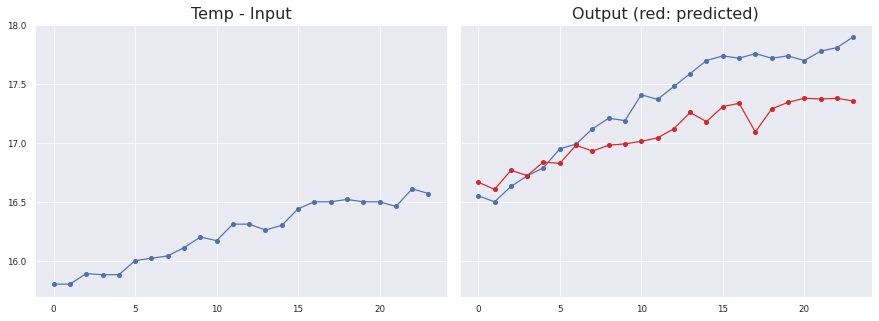

Sensor #22.0
Temp
MAE: 0.2957012476523723 ± 0.22218083172729564
MSE: 0.11778029953119591
RMSE: 0.34319134536173246
Max Error: 0.6668343019485476


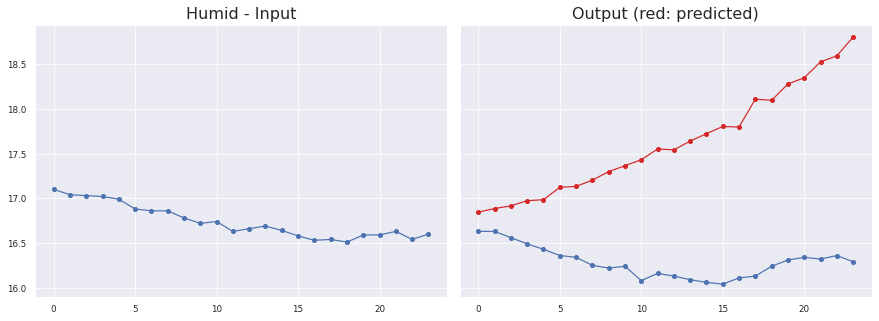

Sensor #22.0
Humid
MAE: 1.3395044794244086 ± 0.6630018357865862
MSE: 2.23384368465444
RMSE: 1.49460485903614
Max Error: 2.5126039549708388


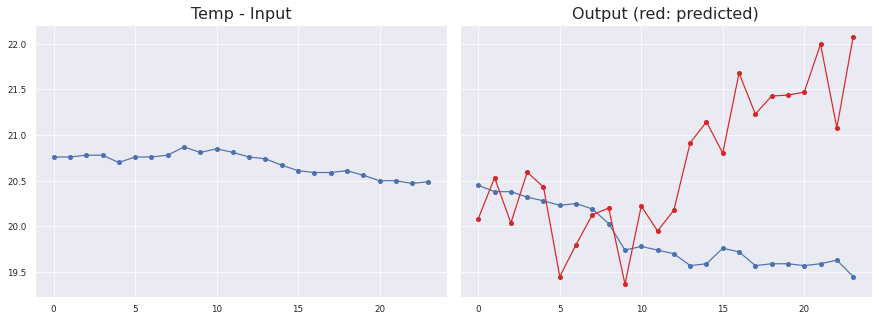

Sensor #9.0
Temp
MAE: 0.9950650286177787 ± 0.9930559134380594
MSE: 1.6216451155677072
RMSE: 1.2734383045784774
Max Error: 2.6243600213527714


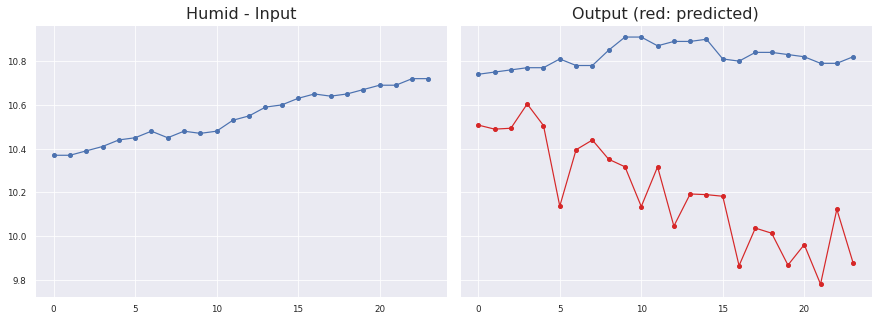

Sensor #9.0
Humid
MAE: 0.6201190327728784 ± 0.2571172466924499
MSE: 0.4506568933538763
RMSE: 0.6713098340959086
Max Error: 1.0087279643118379


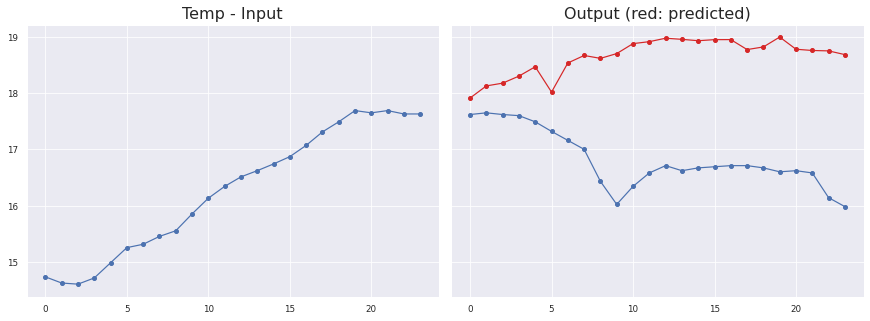

Sensor #27.0
Temp
MAE: 1.8407039090494308 ± 0.7642575061322926
MSE: 3.9722804164694065
RMSE: 1.9930580564723663
Max Error: 2.706693813800811


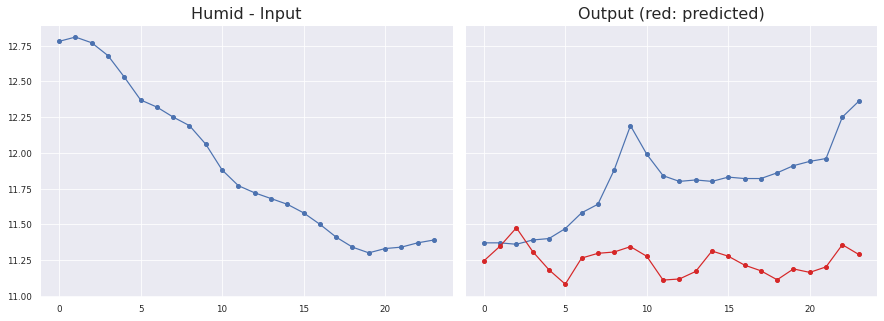

Sensor #27.0
Humid
MAE: 0.5442824528366322 ± 0.29506570755726047
MSE: 0.3729457862658196
RMSE: 0.6106928739274919
Max Error: 1.0706998188793655

KL Divergence: 10.17799265792912 bits
Pinball Loss Temp mean: 1.1625558686704478
Pinball Loss Humid mean: 0.46761071995758685
MSE Temp: 2.325111737340877
MSE Humid: 0.9352214399151881


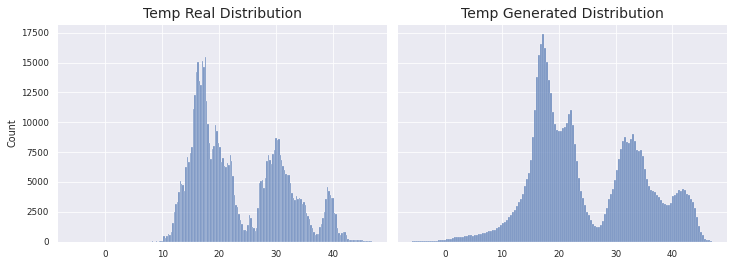

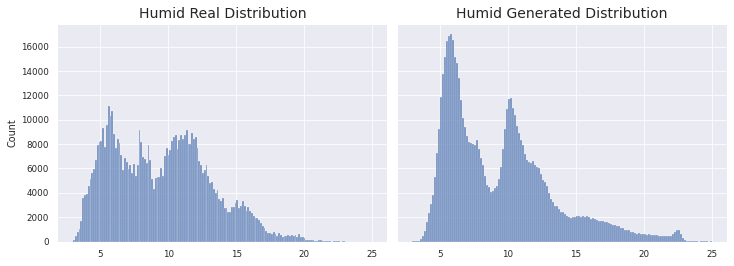

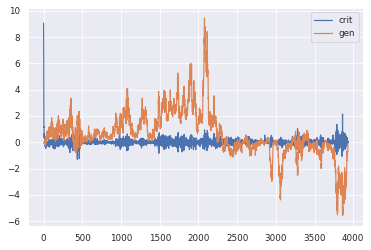

1966/1966 [==============================] - 234s 119ms/step - d_loss: 0.0101 - g_loss: -0.1604
Epoch 3/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0175 - g_loss: -1.7211
Better KL
>3 MODELS HAVE BEEN SAVED


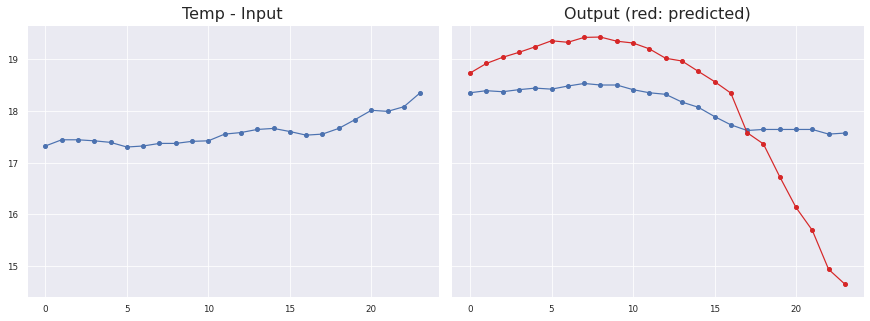

Sensor #30.0
Temp
MAE: 0.9588929263750714 ± 1.1563220542124932
MSE: 1.3483078716670038
RMSE: 1.1611665994451459
Max Error: 2.923419516086579


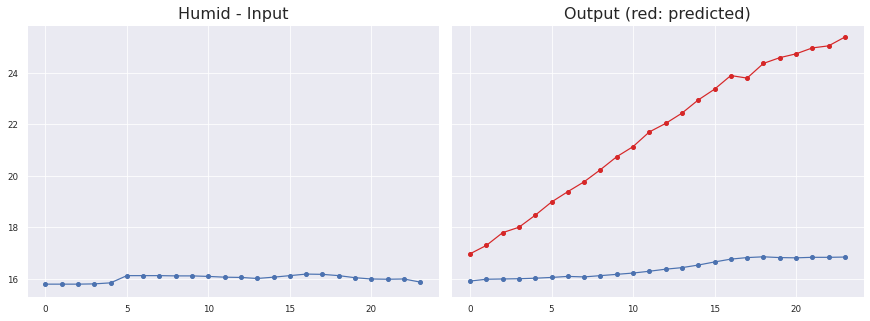

Sensor #30.0
Humid
MAE: 5.178597488018375 ± 2.3590342191691906
MSE: 32.38291439012142
RMSE: 5.690598772547703
Max Error: 8.529579366445542


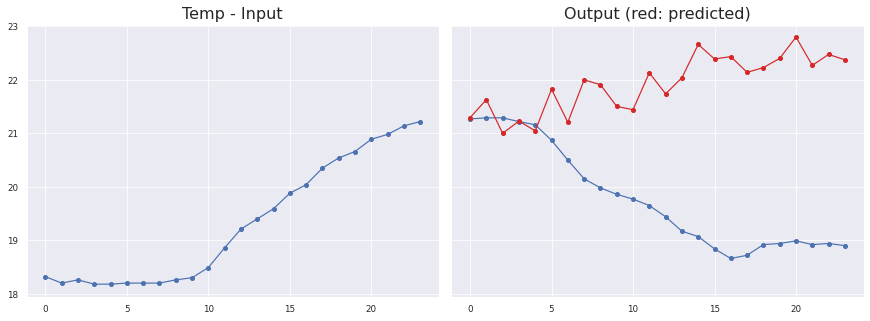

Sensor #5.0
Temp
MAE: 2.186057600950201 ± 1.4065458922788816
MSE: 6.6115375169804524
RMSE: 2.571291021448263
Max Error: 3.8106263905763633


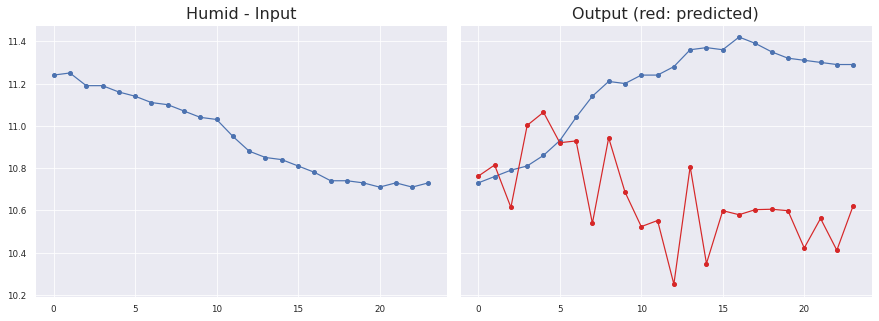

Sensor #5.0
Humid
MAE: 0.5500262043997642 ± 0.3827965152179614
MSE: 0.4064308244636263
RMSE: 0.6375192737977623
Max Error: 1.0292796148359766


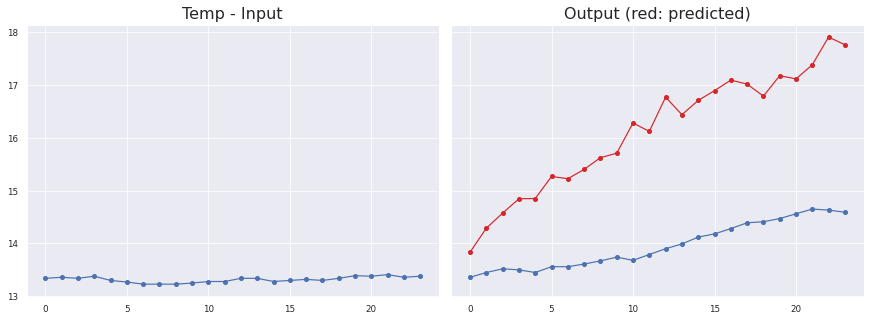

Sensor #17.0
Temp
MAE: 2.164053089916706 ± 0.7274113503421409
MSE: 5.21225304858462
RMSE: 2.2830359280100305
Max Error: 3.271919164657591


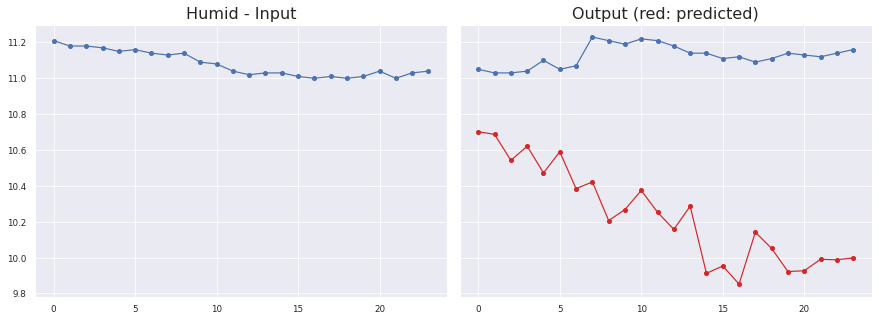

Sensor #17.0
Humid
MAE: 0.8879342458335059 ± 0.29478236037115013
MSE: 0.8753238649099032
RMSE: 0.9355874437538713
Max Error: 1.2683245012164104


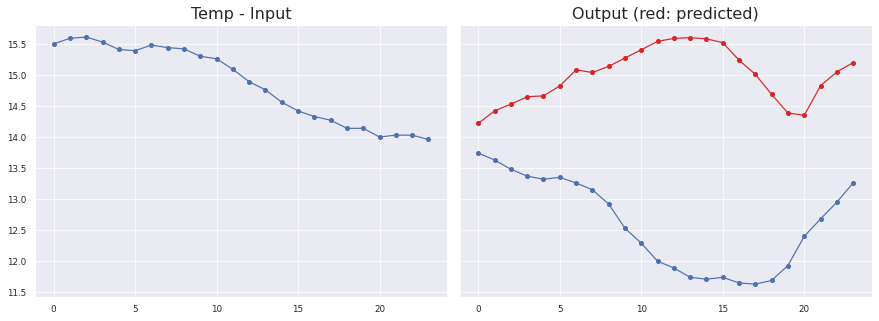

Sensor #8.0
Temp
MAE: 2.395890871683757 ± 1.0222120370604582
MSE: 6.785210517728845
RMSE: 2.604843664738605
Max Error: 3.870688228607177


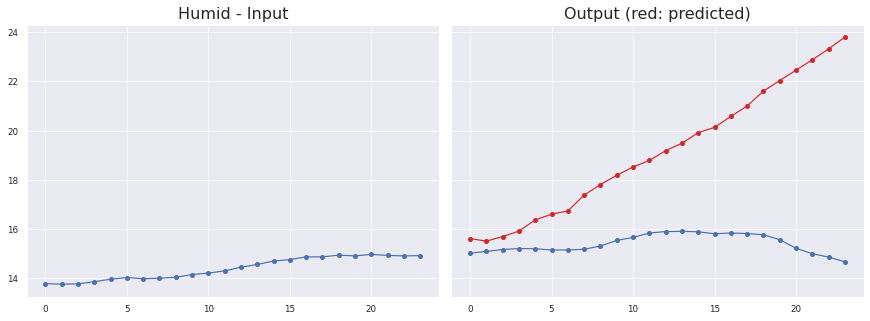

Sensor #8.0
Humid
MAE: 3.7457439697099235 ± 2.58331081277608
MSE: 20.70409264202407
RMSE: 4.550175012241185
Max Error: 9.146204142570499

KL Divergence: 4.4084549028606235 bits
Pinball Loss Temp mean: 1.9274684630417653
Pinball Loss Humid mean: 0.5908911595494921
MSE Temp: 3.8549369260835293
MSE Humid: 1.1817823190989813


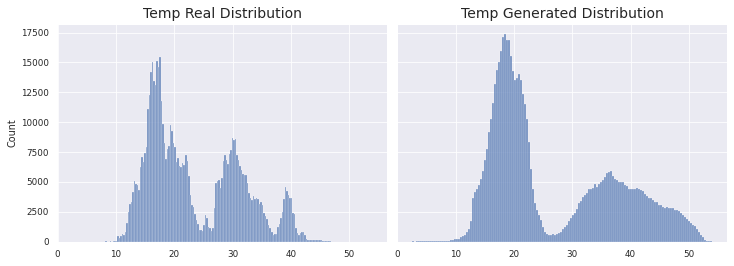

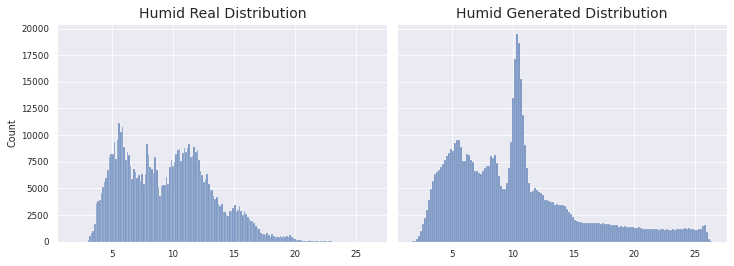

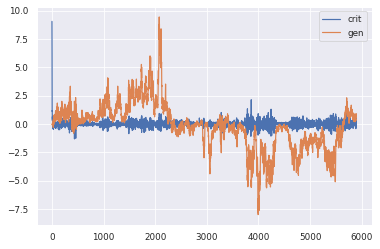

1966/1966 [==============================] - 234s 119ms/step - d_loss: 0.0178 - g_loss: -1.7199
Epoch 4/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0066 - g_loss: 3.9956

KL Divergence: 12.719578045449204 bits
Pinball Loss Temp mean: 1.7247424706498051
Pinball Loss Humid mean: 0.9026144533100757
MSE Temp: 3.4494849412995543
MSE Humid: 1.805228906620152


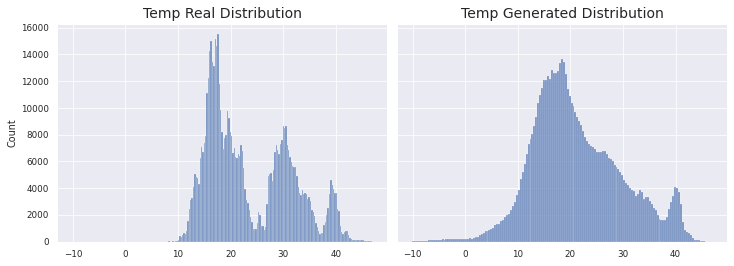

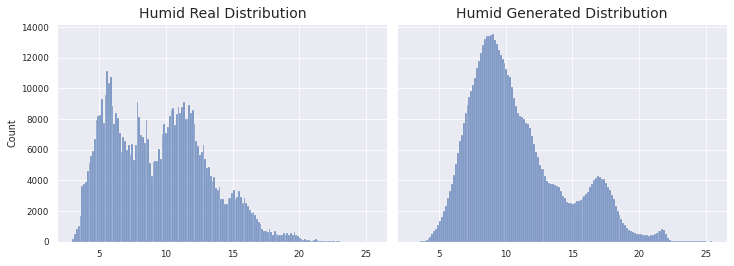

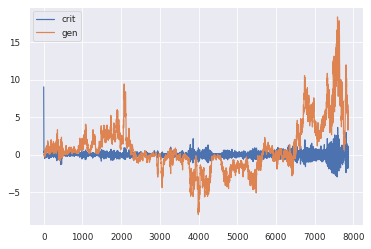

1966/1966 [==============================] - 225s 115ms/step - d_loss: -0.0075 - g_loss: 3.9969
Epoch 5/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0310 - g_loss: 5.9130
Better KL
Better Pinball
Better MSE
>5 MODELS HAVE BEEN SAVED


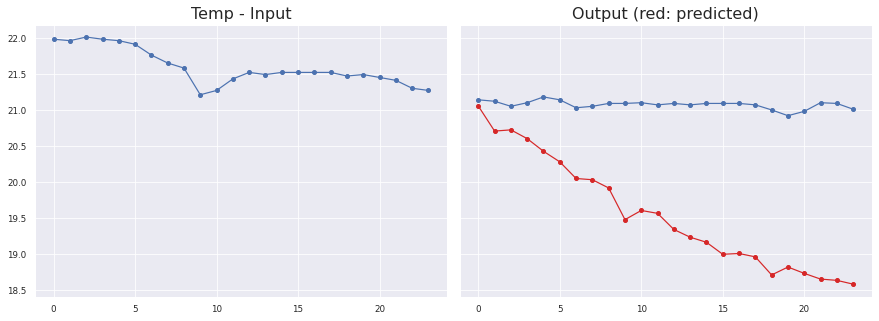

Sensor #9.0
Temp
MAE: 1.5189386807382101 ± 0.7285826201934642
MSE: 2.838007350290708
RMSE: 1.6846386408635854
Max Error: 2.452606320381161


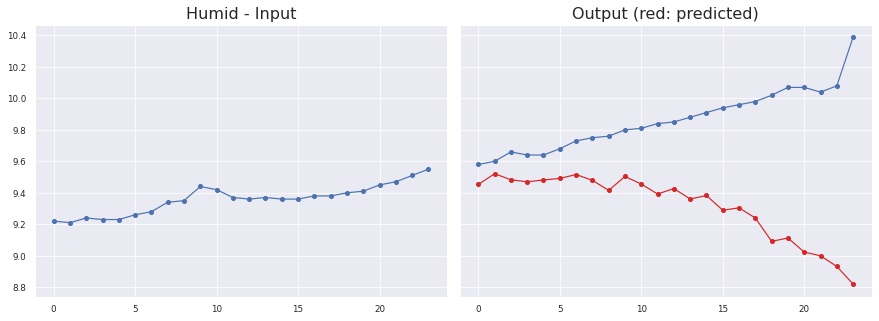

Sensor #9.0
Humid
MAE: 0.5432370625808831 ± 0.38649830566173327
MSE: 0.44448744644089694
RMSE: 0.6666989173839245
Max Error: 1.5707480496168138


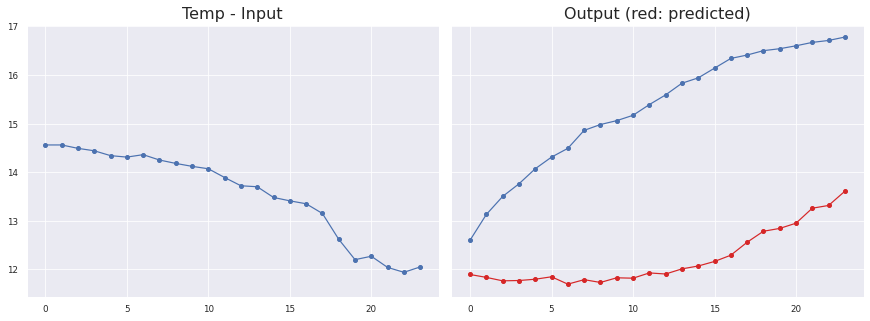

Sensor #8.0
Temp
MAE: 3.079982577661673 ± 0.8759443843783198
MSE: 10.253571243223357
RMSE: 3.202119804633074
Max Error: 4.0485609889030485


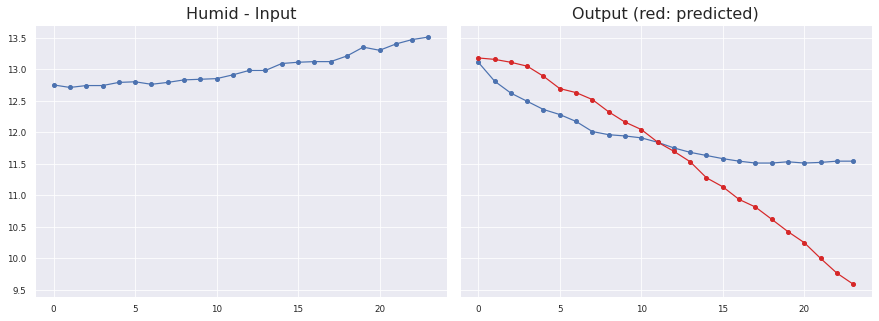

Sensor #8.0
Humid
MAE: 0.6211184652677427 ± 0.7639534360802894
MSE: 0.6624302670510162
RMSE: 0.8138981920676664
Max Error: 1.9523229373991473


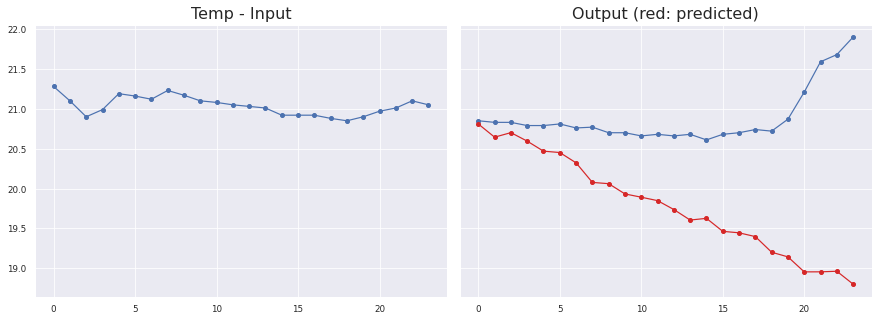

Sensor #3.0
Temp
MAE: 1.0882744679848357 ± 0.8415753241824779
MSE: 1.8925903439405198
RMSE: 1.3757144848915852
Max Error: 3.099247518777844


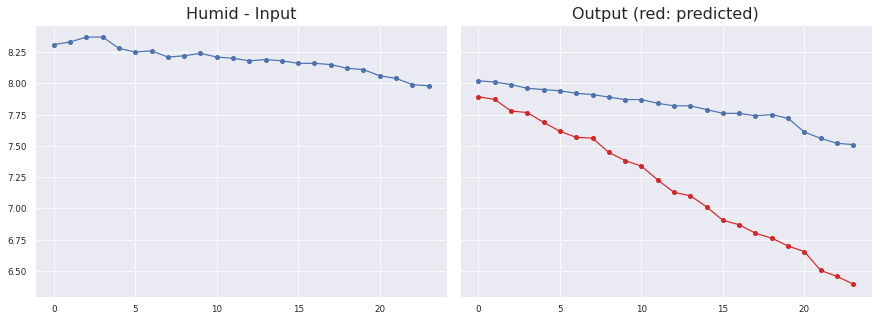

Sensor #3.0
Humid
MAE: 0.6296629346658783 ± 0.3261016443417076
MSE: 0.5028176937344117
RMSE: 0.7090963924139028
Max Error: 1.1162093007564549


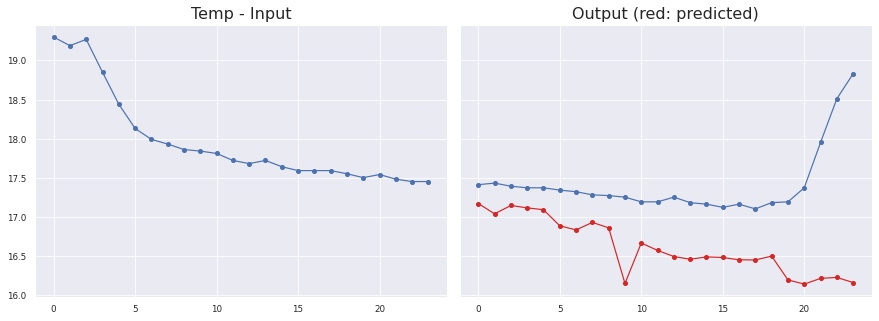

Sensor #16.0
Temp
MAE: 0.7987754354874305 ± 0.6135864022533873
MSE: 1.0145304693683899
RMSE: 1.0072390328856353
Max Error: 2.673422374725341


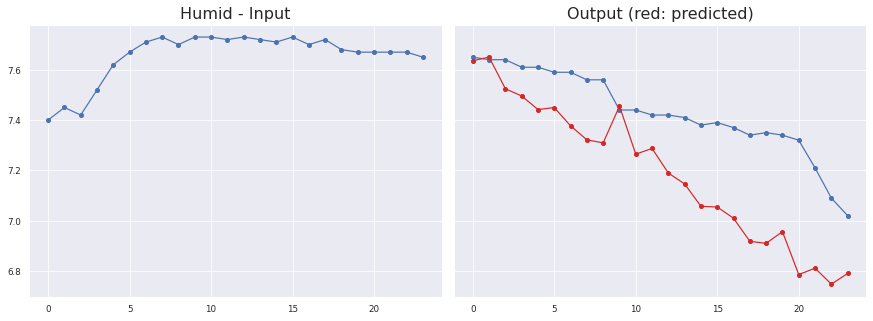

Sensor #16.0
Humid
MAE: 0.24382633024205733 ± 0.14270535783910882
MSE: 0.07879254305498047
RMSE: 0.2807000945047587
Max Error: 0.5341942843794829

KL Divergence: 3.178771523816328 bits
Pinball Loss Temp mean: 0.9130036742369312
Pinball Loss Humid mean: 0.4027476603905381
MSE Temp: 1.8260073484738746
MSE Humid: 0.8054953207810841


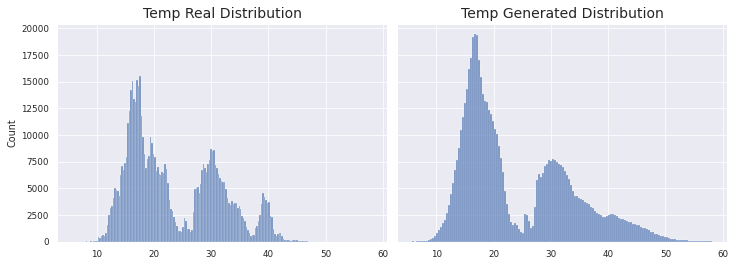

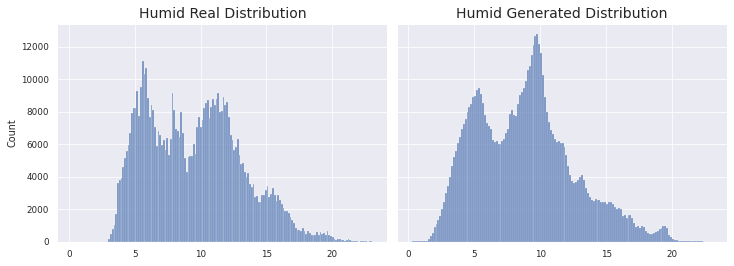

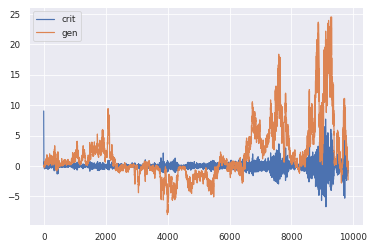

1966/1966 [==============================] - 234s 119ms/step - d_loss: 0.0311 - g_loss: 5.9088
Epoch 6/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0133 - g_loss: 1.4647

KL Divergence: 10.448171647453888 bits
Pinball Loss Temp mean: 3.7254080490986956
Pinball Loss Humid mean: 1.0641789674298645
MSE Temp: 7.450816098197366
MSE Humid: 2.1283579348597073


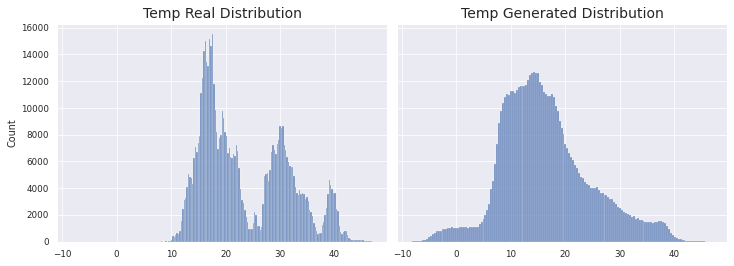

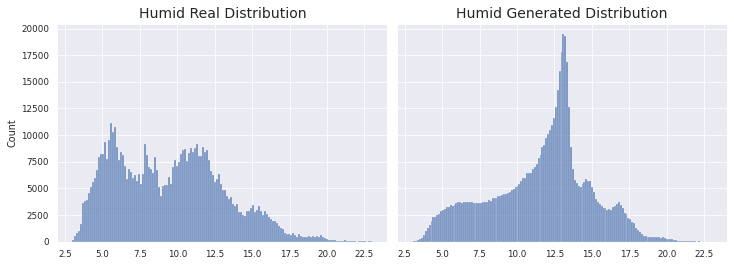

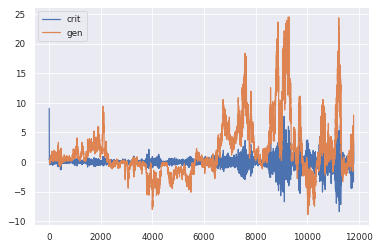

1966/1966 [==============================] - 225s 115ms/step - d_loss: -0.0116 - g_loss: 1.4680
Epoch 7/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0177 - g_loss: 5.0361
Better KL
>7 MODELS HAVE BEEN SAVED


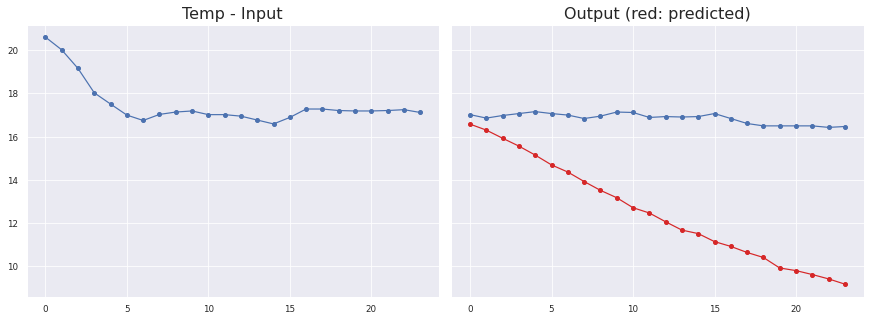

Sensor #34.0
Temp
MAE: 4.316371138592561 ± 2.134268065562258
MSE: 23.1861599817537
RMSE: 4.815200928492361
Max Error: 7.2937408971786475


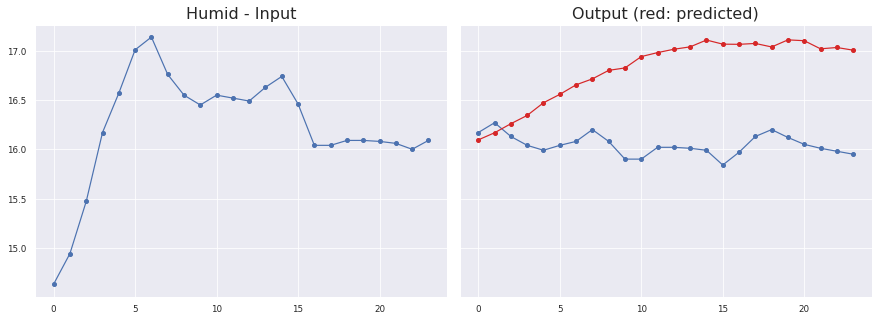

Sensor #34.0
Humid
MAE: 0.7821968055826926 ± 0.37803508432943994
MSE: 0.7319359105145292
RMSE: 0.8555325303660459
Max Error: 1.2279171966016307


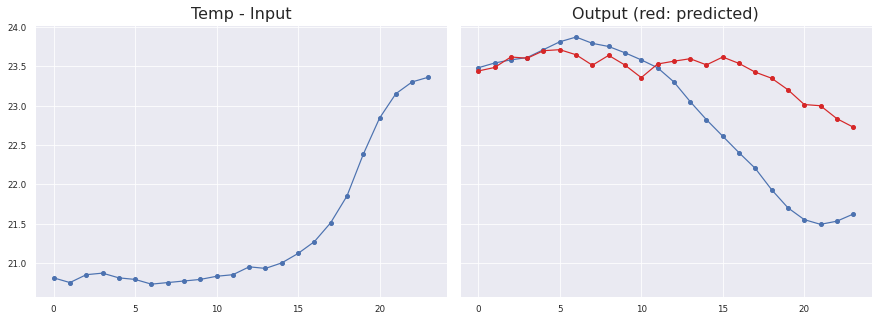

Sensor #5.0
Temp
MAE: 0.6027418781320261 ± 0.6595581253901616
MSE: 0.6862531819840049
RMSE: 0.8284039968421234
Max Error: 1.507013159990315


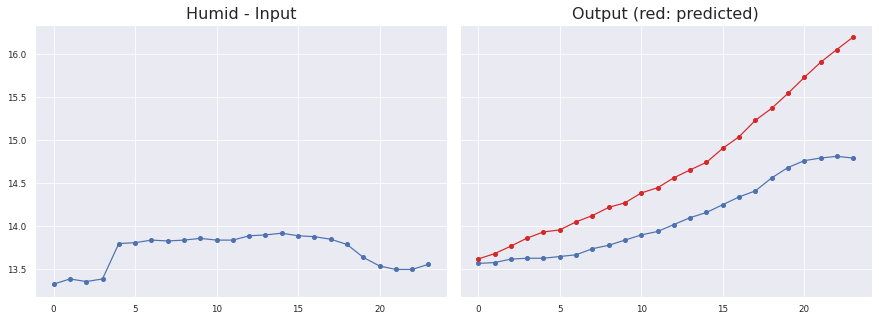

Sensor #5.0
Humid
MAE: 0.5831539015914323 ± 0.34351471250246174
MSE: 0.4580708306469588
RMSE: 0.6768093015369683
Max Error: 1.4011960311234013


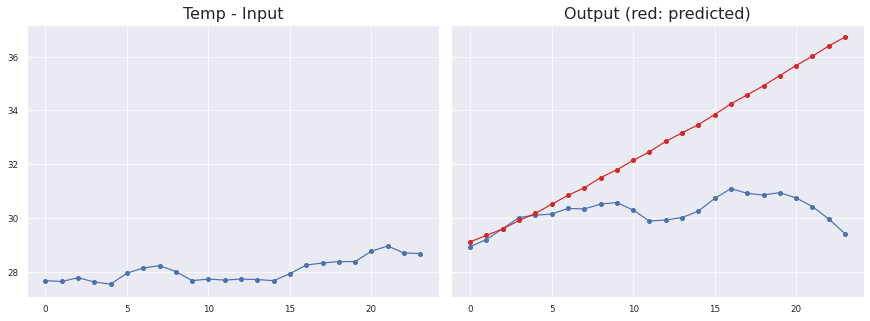

Sensor #7.0
Temp
MAE: 2.5322680147985612 ± 2.1347684439117343
MSE: 10.918624769006689
RMSE: 3.3043342399047178
Max Error: 7.322829567193988


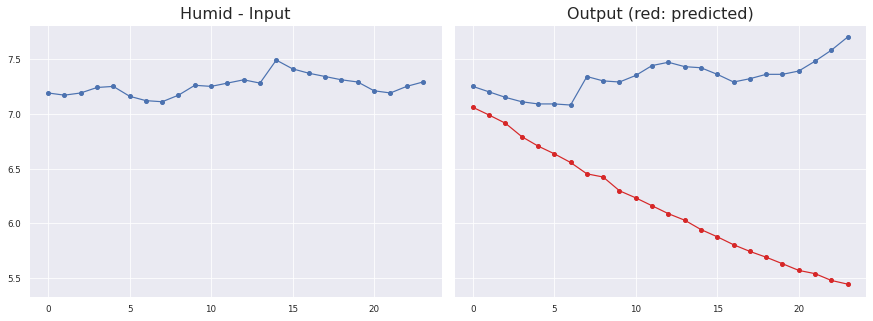

Sensor #7.0
Humid
MAE: 1.1572574285790322 ± 0.6255370184632016
MSE: 1.7305413174691857
RMSE: 1.3155004057274882
Max Error: 2.253740147352219


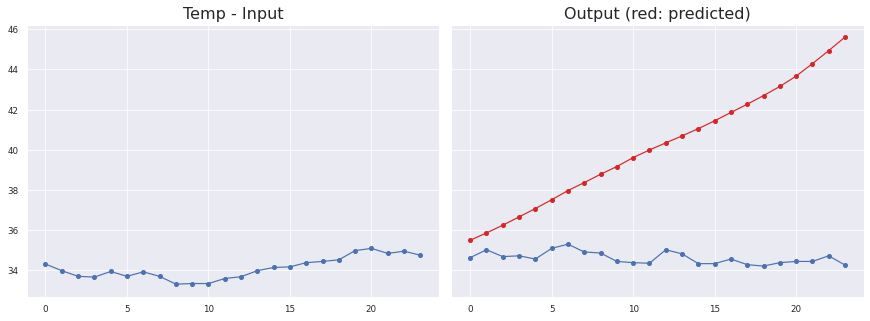

Sensor #0.0
Temp
MAE: 5.580471238444247 ± 3.0780118364326947
MSE: 40.61581610832324
RMSE: 6.373053907533126
Max Error: 11.34671553850174


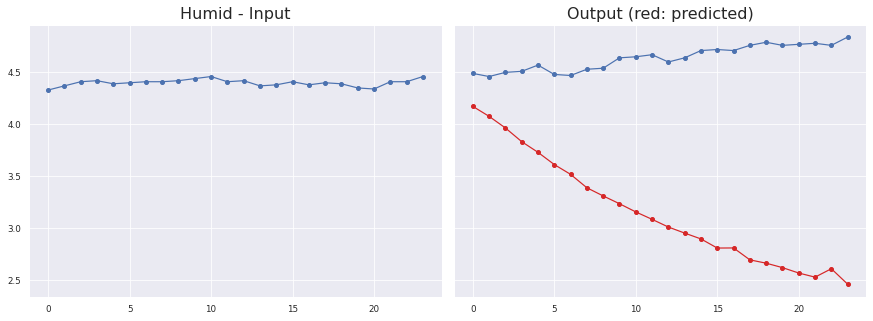

Sensor #0.0
Humid
MAE: 1.484947981586059 ± 0.6274383347601113
MSE: 2.5987493719430517
RMSE: 1.6120636997163145
Max Error: 2.378738816976547

KL Divergence: 2.840082088880125 bits
Pinball Loss Temp mean: 1.5984507924533908
Pinball Loss Humid mean: 0.49369968189567565
MSE Temp: 3.196901584906835
MSE Humid: 0.9873993637913601


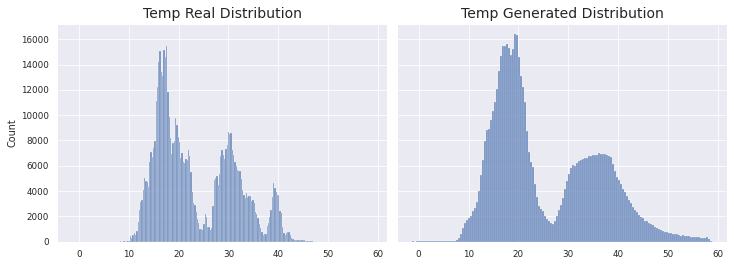

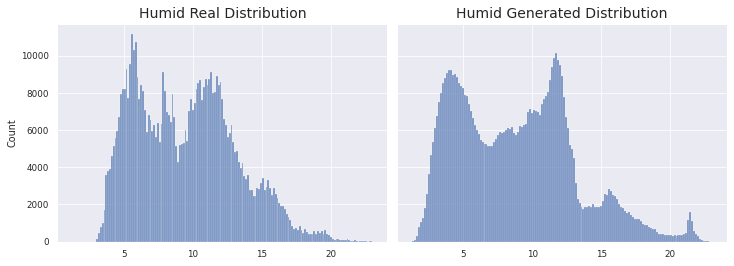

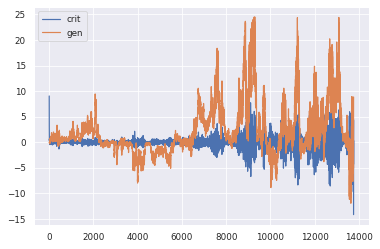

1966/1966 [==============================] - 232s 118ms/step - d_loss: 0.0105 - g_loss: 5.0381
Epoch 8/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0428 - g_loss: 15.3790

KL Divergence: 14.017661656630708 bits
Pinball Loss Temp mean: 2.193800816788408
Pinball Loss Humid mean: 0.6573536257782993
MSE Temp: 4.387601633576864
MSE Humid: 1.3147072515566092


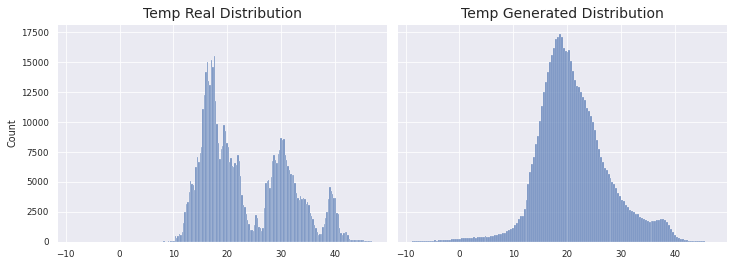

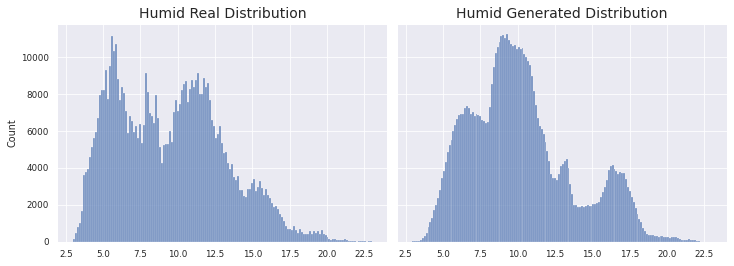

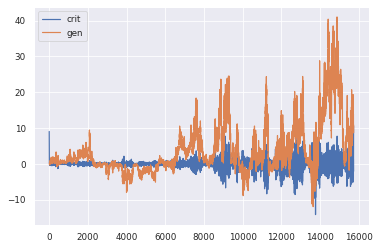

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.0482 - g_loss: 15.3767
Epoch 9/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1194 - g_loss: 23.7043

KL Divergence: 7.308516790431366 bits
Pinball Loss Temp mean: 2.0017064949972427
Pinball Loss Humid mean: 0.4225941331732165
MSE Temp: 4.0034129899944535
MSE Humid: 0.8451882663464334


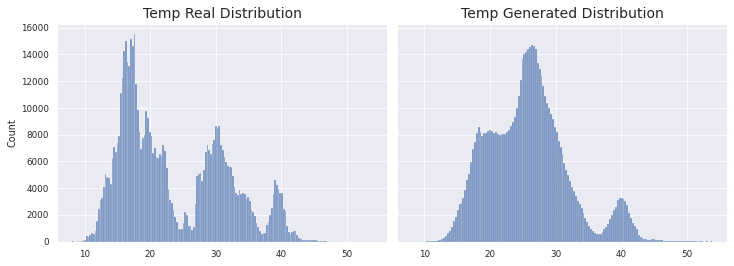

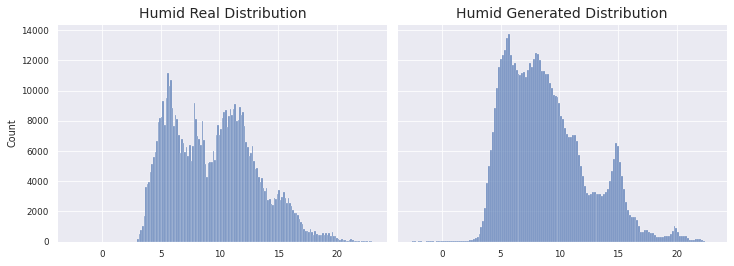

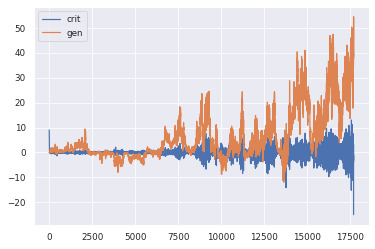

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.1066 - g_loss: 23.7199
Epoch 10/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0504 - g_loss: 54.6040

KL Divergence: 3.7566774049789102 bits
Pinball Loss Temp mean: 2.4059082022387037
Pinball Loss Humid mean: 0.6231833518556181
MSE Temp: 4.811816404477375
MSE Humid: 1.2463667037112316


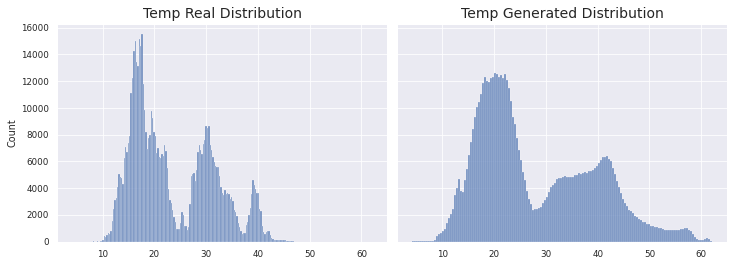

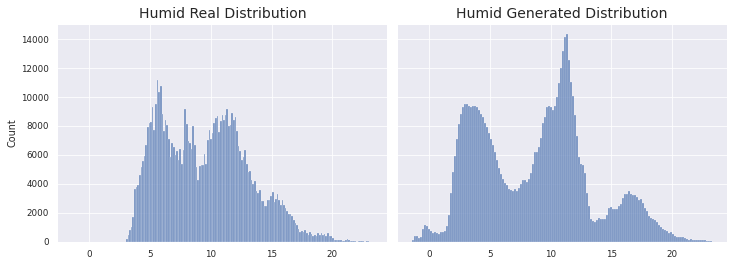

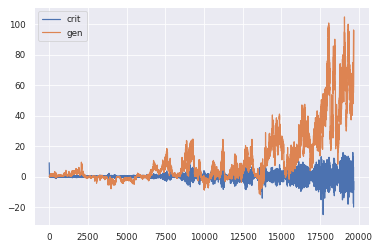

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.0402 - g_loss: 54.6251
Epoch 11/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0285 - g_loss: 73.6367

KL Divergence: 14.37297942931608 bits
Pinball Loss Temp mean: 1.288762392726206
Pinball Loss Humid mean: 0.5390175790051008
MSE Temp: 2.5775247854523817
MSE Humid: 1.0780351580101966


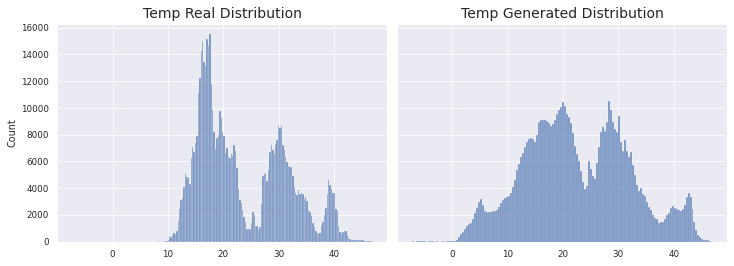

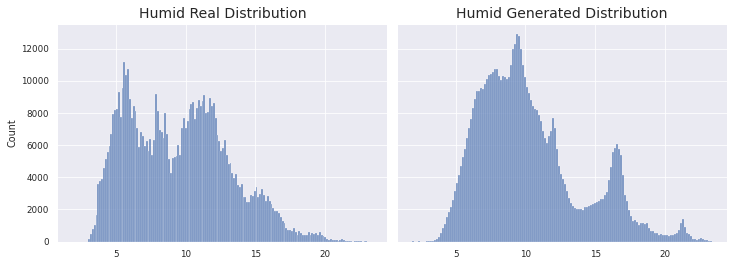

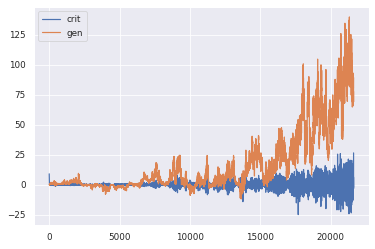

1966/1966 [==============================] - 225s 115ms/step - d_loss: -0.0150 - g_loss: 73.6388
Epoch 12/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0088 - g_loss: 56.7889

KL Divergence: 7.867280306737954 bits
Pinball Loss Temp mean: 2.378767381195929
Pinball Loss Humid mean: 1.689912526827726
MSE Temp: 4.757534762391804
MSE Humid: 3.37982505365543


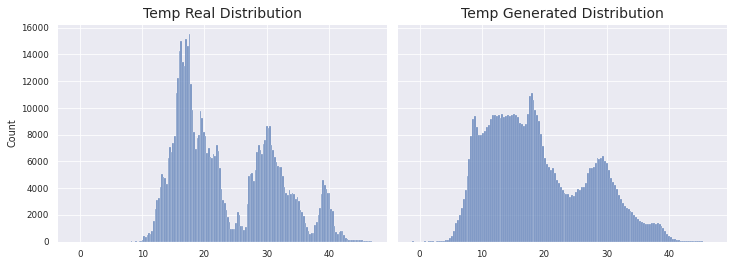

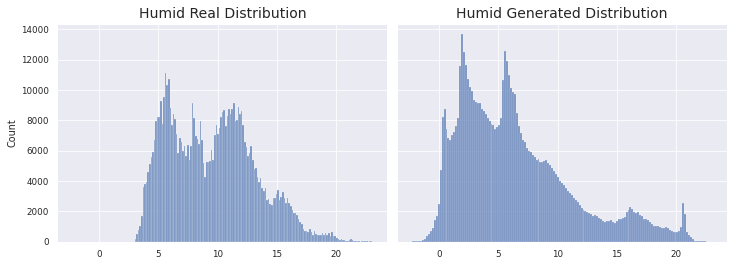

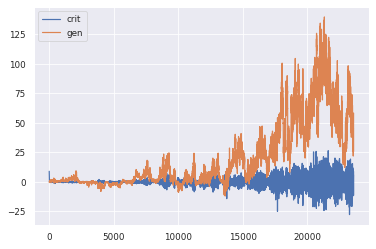

1966/1966 [==============================] - 226s 115ms/step - d_loss: 0.0133 - g_loss: 56.7897
Epoch 13/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1863 - g_loss: 17.8710

KL Divergence: 7.187500446505293 bits
Pinball Loss Temp mean: 1.2080921067486923
Pinball Loss Humid mean: 0.27141222373199
MSE Temp: 2.4161842134973948
MSE Humid: 0.5428244474639763


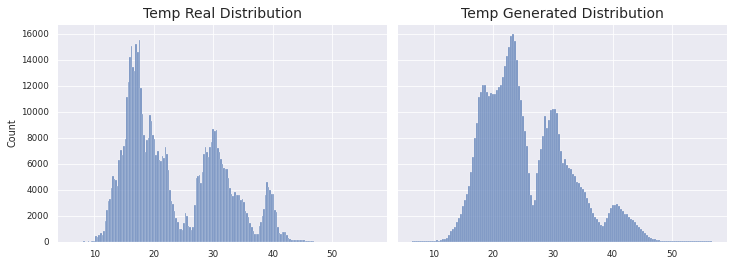

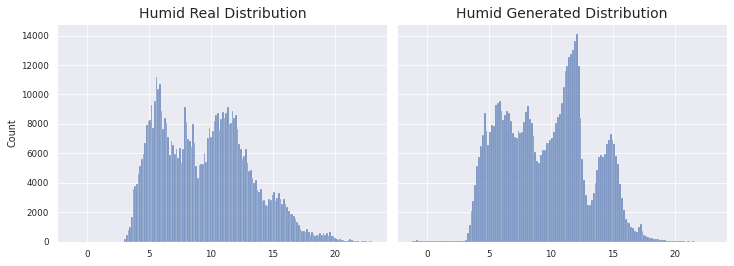

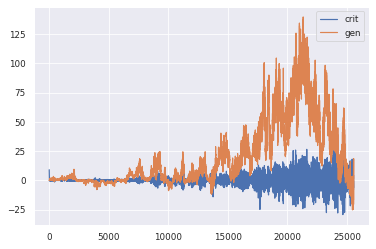

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.1869 - g_loss: 17.8713
Epoch 14/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1029 - g_loss: -40.2729

KL Divergence: 8.593602621285068 bits
Pinball Loss Temp mean: 2.0374730035123085
Pinball Loss Humid mean: 0.6425688077998798
MSE Temp: 4.074946007024587
MSE Humid: 1.2851376155997531


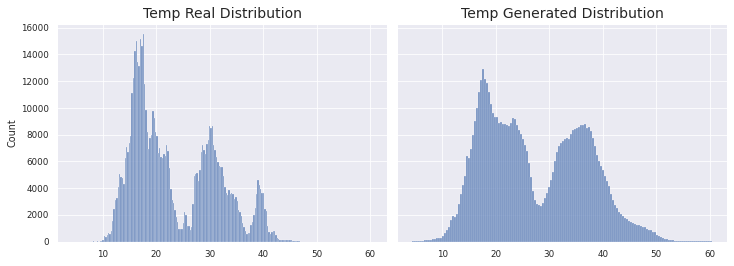

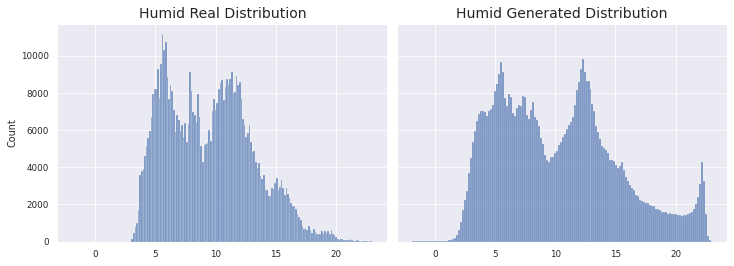

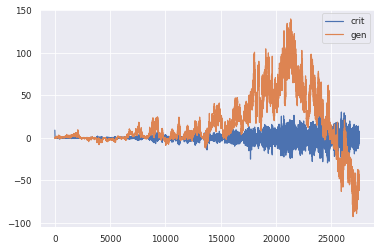

1966/1966 [==============================] - 226s 115ms/step - d_loss: 0.1029 - g_loss: -40.2742
Epoch 15/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0901 - g_loss: -65.8725

KL Divergence: 4.682039808258857 bits
Pinball Loss Temp mean: 1.1161949689581079
Pinball Loss Humid mean: 0.6189595584920966
MSE Temp: 2.2323899379162184
MSE Humid: 1.2379191169841843


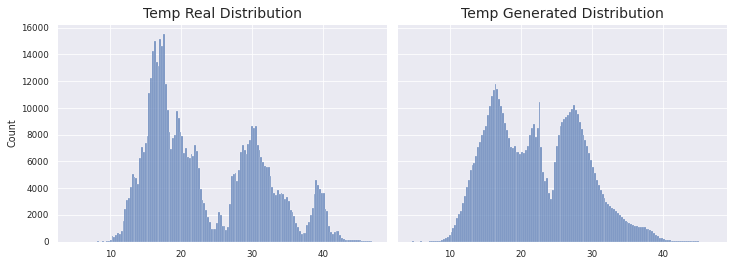

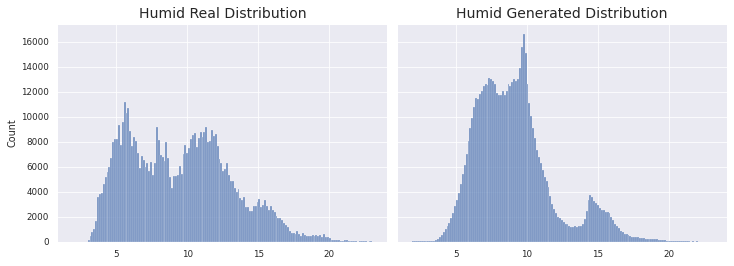

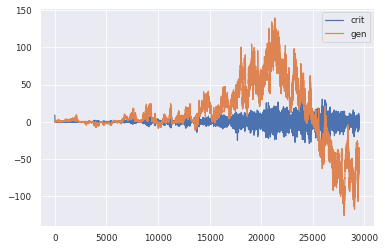

1966/1966 [==============================] - 227s 116ms/step - d_loss: -0.0956 - g_loss: -65.8740
Epoch 16/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0930 - g_loss: -52.3266

KL Divergence: 7.302374165992611 bits
Pinball Loss Temp mean: 1.4910745474471625
Pinball Loss Humid mean: 0.5552498397512153
MSE Temp: 2.98214909489436
MSE Humid: 1.1104996795023845


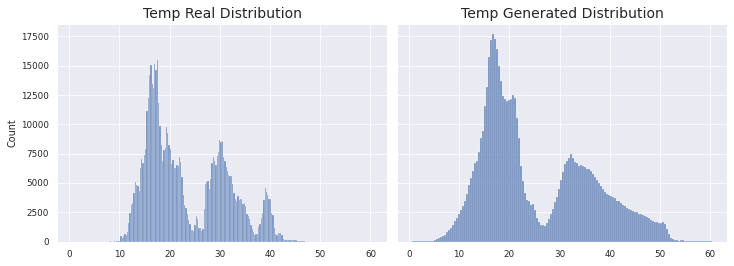

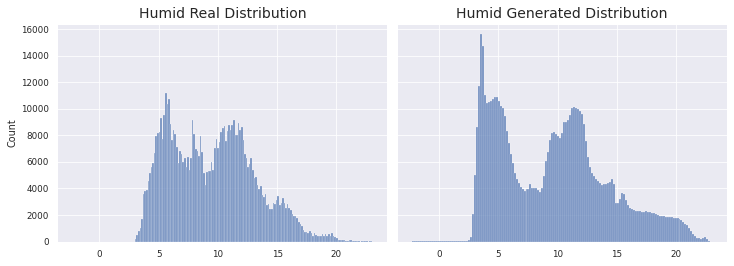

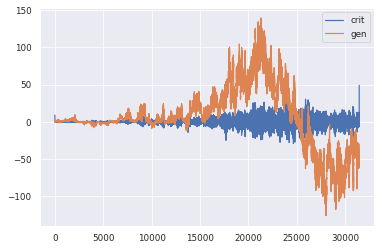

1966/1966 [==============================] - 226s 115ms/step - d_loss: 0.1179 - g_loss: -52.3153
Epoch 17/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0756 - g_loss: -41.1021

KL Divergence: 20.128518150470864 bits
Pinball Loss Temp mean: 1.5565890308685955
Pinball Loss Humid mean: 0.4855023718679953
MSE Temp: 3.1131780617371803
MSE Humid: 0.9710047437359939


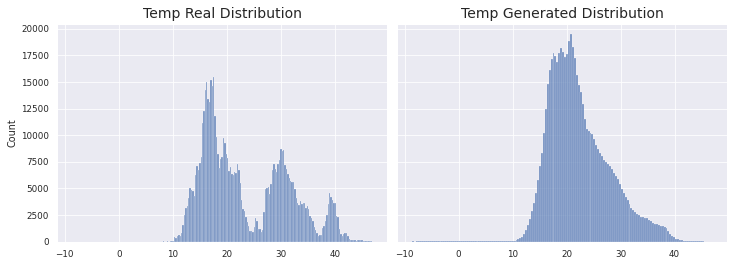

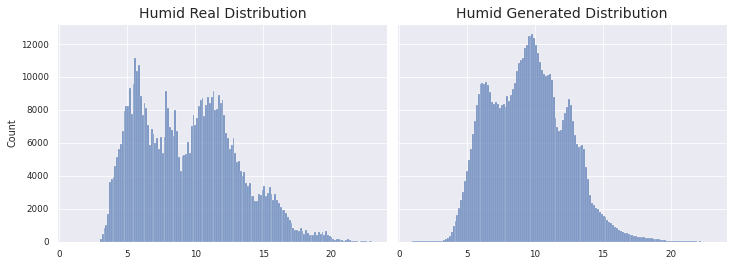

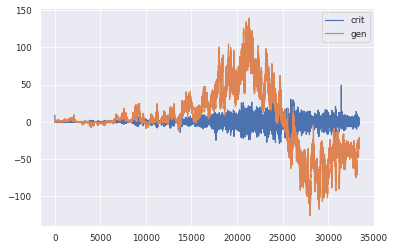

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.0755 - g_loss: -41.0983
Epoch 18/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0811 - g_loss: -30.9168

KL Divergence: 3.1893969091264034 bits
Pinball Loss Temp mean: 0.8565515732492625
Pinball Loss Humid mean: 0.6095103258583734
MSE Temp: 1.7131031464984874
MSE Humid: 1.2190206517167281


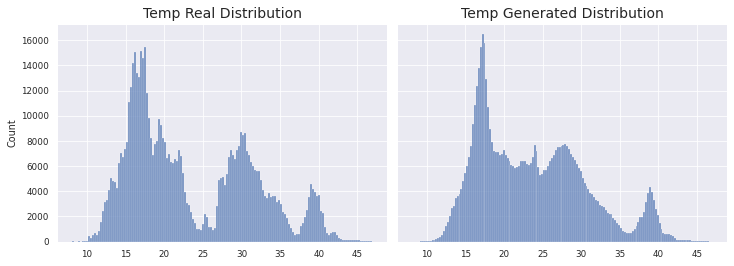

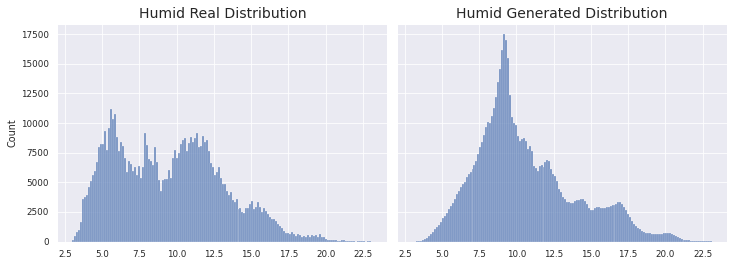

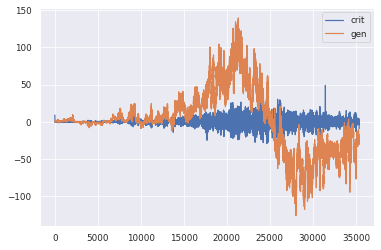

1966/1966 [==============================] - 222s 113ms/step - d_loss: 0.0764 - g_loss: -30.9165
Epoch 19/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1052 - g_loss: -23.0798

KL Divergence: 14.36876164203211 bits
Pinball Loss Temp mean: 1.9433685385947836
Pinball Loss Humid mean: 0.8728240792903239
MSE Temp: 3.886737077189539
MSE Humid: 1.745648158580655


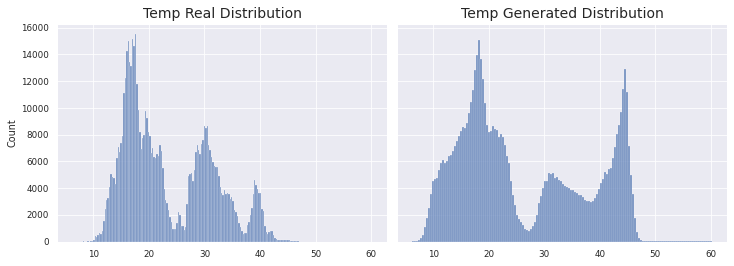

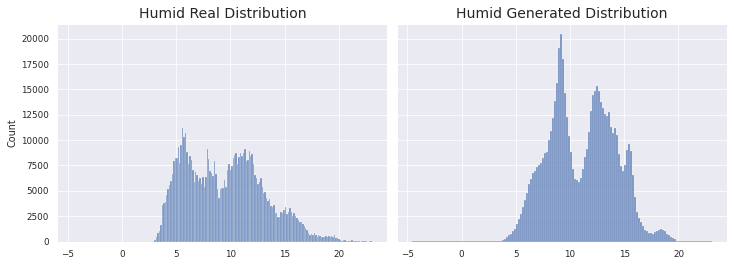

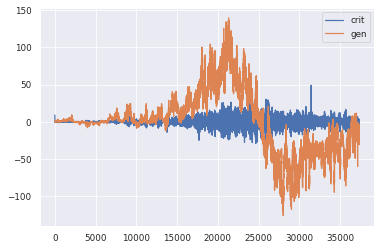

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.1066 - g_loss: -23.0700
Epoch 20/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0205 - g_loss: -41.3458

KL Divergence: 8.588793125839427 bits
Pinball Loss Temp mean: 1.5711384030672204
Pinball Loss Humid mean: 0.5956139938197325
MSE Temp: 3.1422768061343795
MSE Humid: 1.191227987639451


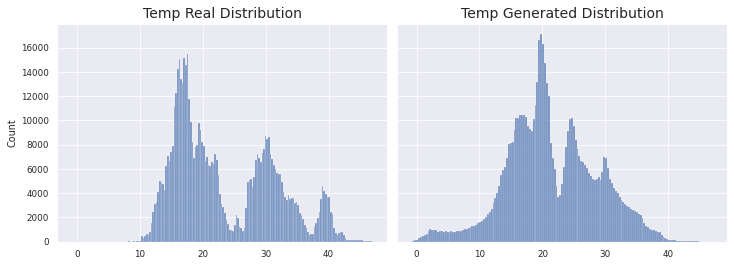

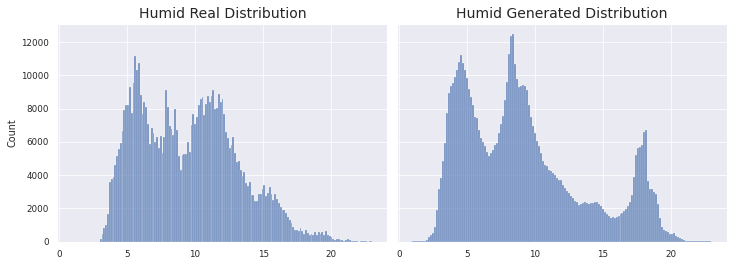

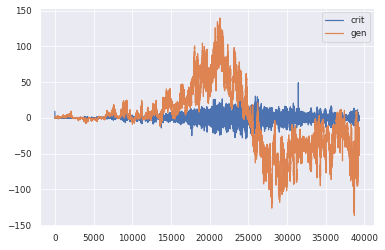

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0193 - g_loss: -41.3409
Epoch 21/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0239 - g_loss: -30.2695
Better Pinball
Better MSE
>21 MODELS HAVE BEEN SAVED


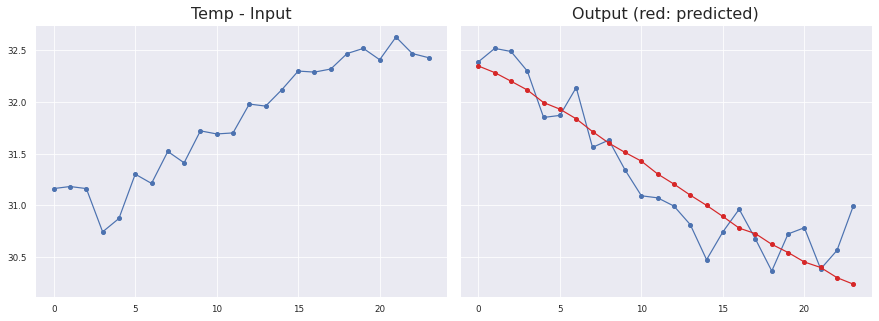

Sensor #32.0
Temp
MAE: 0.2247341939806938 ± 0.2757447995645848
MSE: 0.07610416595372847
RMSE: 0.27586983516457264
Max Error: 0.7571667730808258


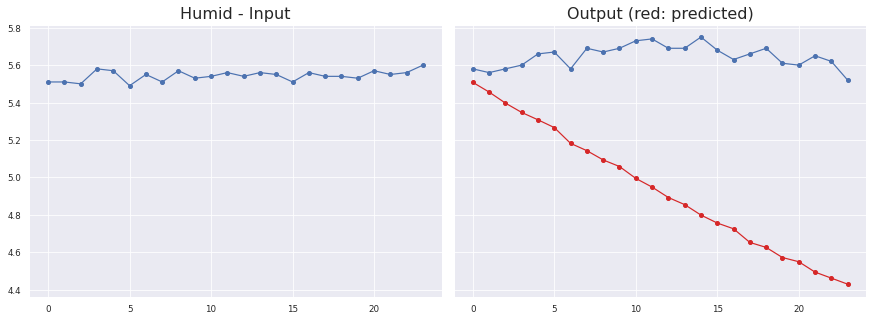

Sensor #32.0
Humid
MAE: 0.709523879922926 ± 0.3407305864232333
MSE: 0.6195214687052032
RMSE: 0.787096861069337
Max Error: 1.1584669545292847


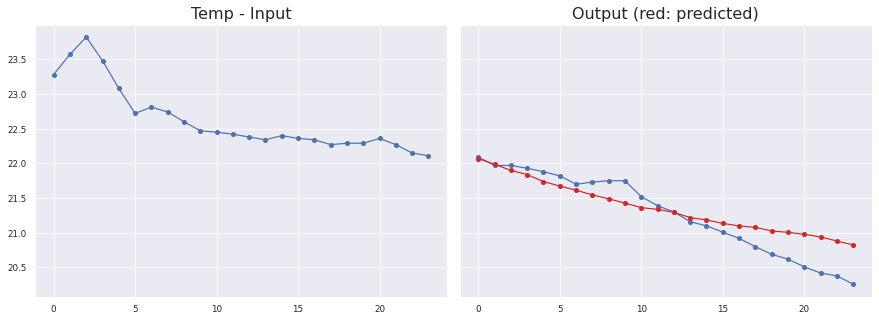

Sensor #16.0
Temp
MAE: 0.2109554872910183 ± 0.2575830894065058
MSE: 0.07314855745933549
RMSE: 0.2704598999100153
Max Error: 0.5648447382450108


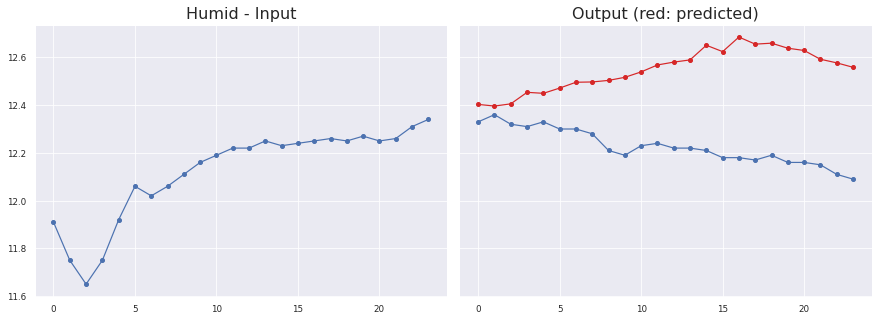

Sensor #16.0
Humid
MAE: 0.3208637608370439 ± 0.15014498022359335
MSE: 0.12549706810483494
RMSE: 0.3542556535961493
Max Error: 0.5052421487122789


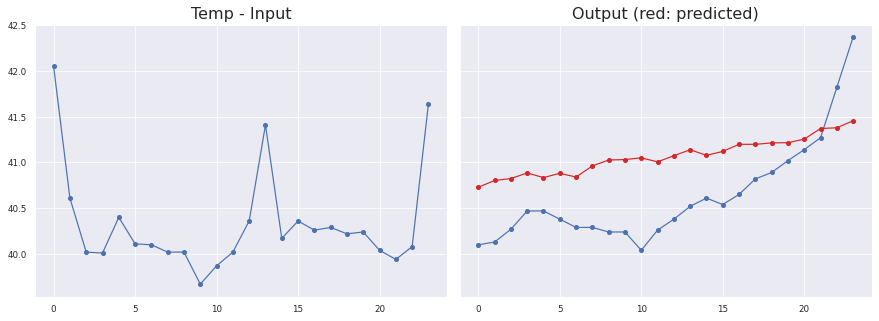

Sensor #33.0
Temp
MAE: 0.54450568437576 ± 0.40192324082850356
MSE: 0.3477643512948772
RMSE: 0.5897154833433469
Max Error: 1.010262656211843


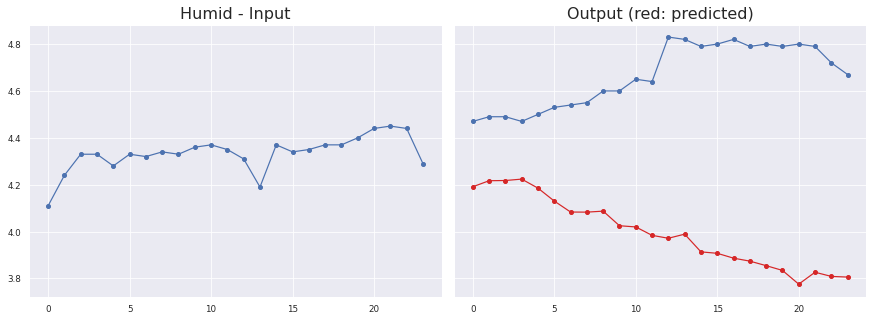

Sensor #33.0
Humid
MAE: 0.6690229511757689 ± 0.26763276422641136
MSE: 0.5192190056874053
RMSE: 0.7205685294872413
Max Error: 1.0243844407796847


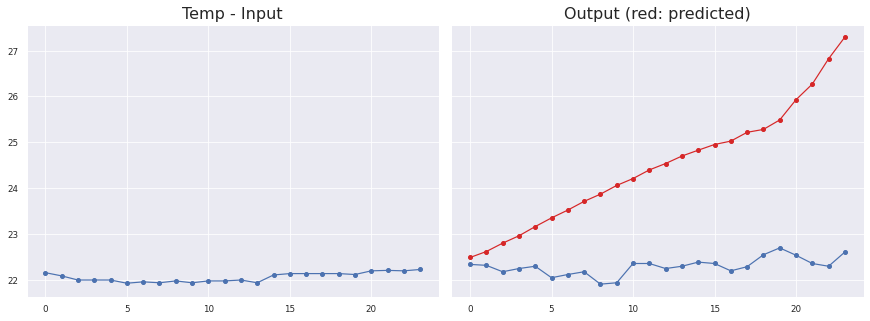

Sensor #4.0
Temp
MAE: 2.182144540051618 ± 1.191625334692564
MSE: 6.181725731958253
RMSE: 2.486307650303609
Max Error: 4.684703068733214


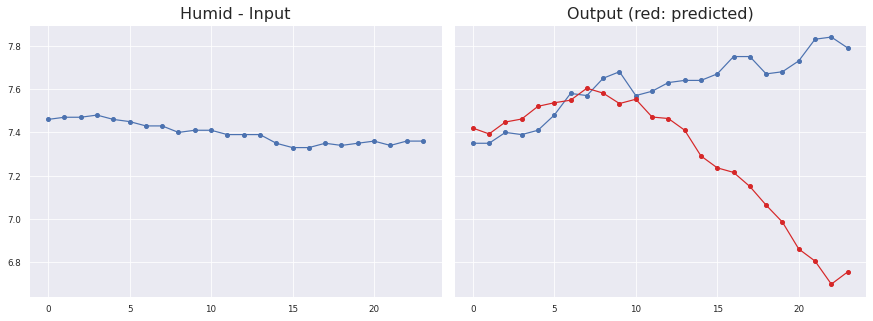

Sensor #4.0
Humid
MAE: 0.3538625896846253 ± 0.3927408751964261
MSE: 0.25516444956144985
RMSE: 0.5051380500036102
Max Error: 1.1400176164507858

KL Divergence: 20.449053822150088 bits
Pinball Loss Temp mean: 0.8521726318884489
Pinball Loss Humid mean: 0.39773506400484615
MSE Temp: 1.7043452637769068
MSE Humid: 0.795470128009694


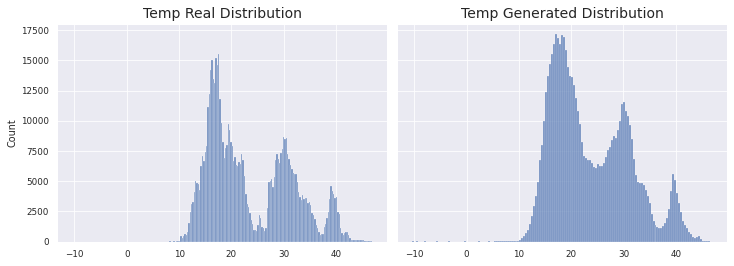

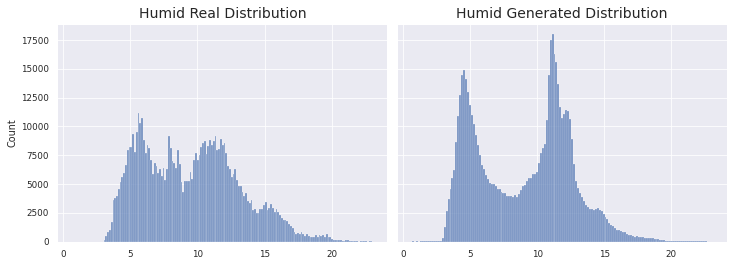

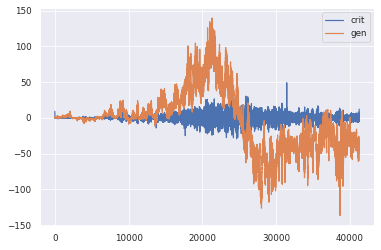

1966/1966 [==============================] - 231s 117ms/step - d_loss: 0.0300 - g_loss: -30.2844
Epoch 22/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0656 - g_loss: -35.1241

KL Divergence: 20.82728094897051 bits
Pinball Loss Temp mean: 1.8980653878117397
Pinball Loss Humid mean: 0.8376841611690444
MSE Temp: 3.7961307756235008
MSE Humid: 1.6753683223380798


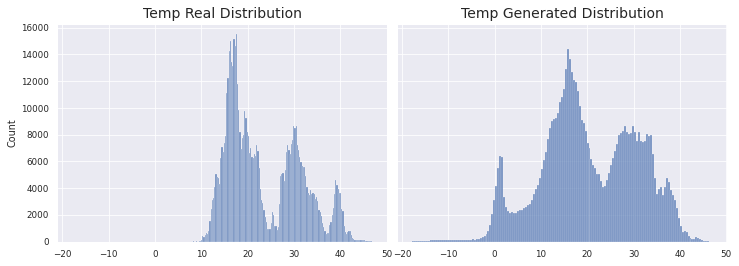

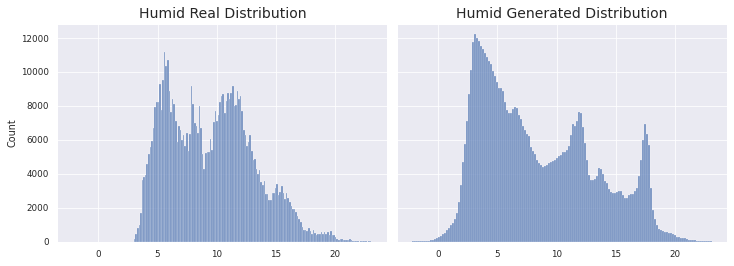

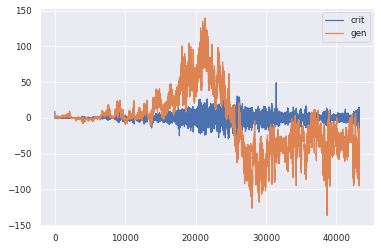

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0671 - g_loss: -35.1303
Epoch 23/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0414 - g_loss: -23.5692

KL Divergence: 14.431760148096002 bits
Pinball Loss Temp mean: 3.4612634967836513
Pinball Loss Humid mean: 0.5293880493666274
MSE Temp: 6.922526993567316
MSE Humid: 1.0587760987332564


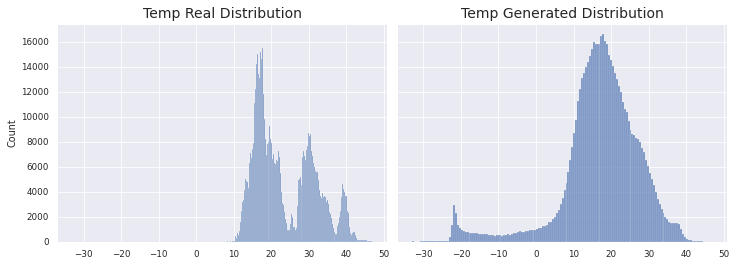

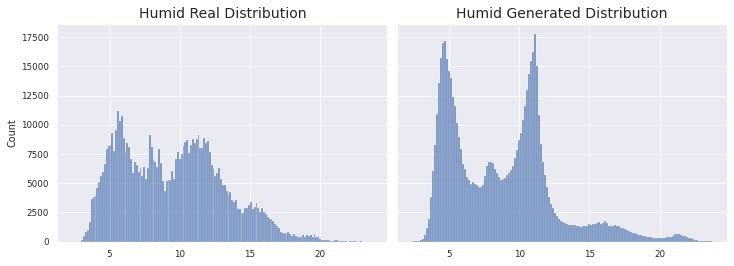

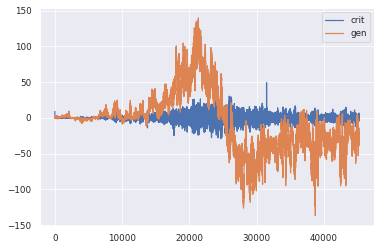

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0435 - g_loss: -23.5645
Epoch 24/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0637 - g_loss: -23.1324

KL Divergence: 15.526064792882298 bits
Pinball Loss Temp mean: 4.201946354426661
Pinball Loss Humid mean: 0.7747236337012529
MSE Temp: 8.403892708853467
MSE Humid: 1.5494472674024977


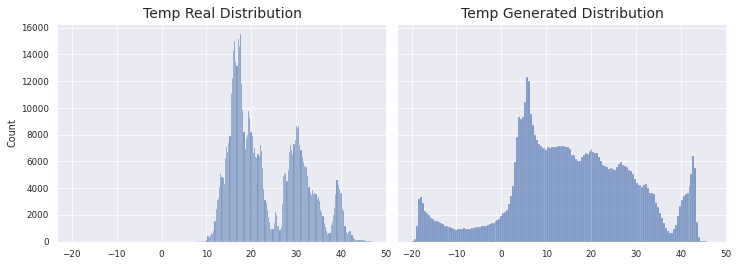

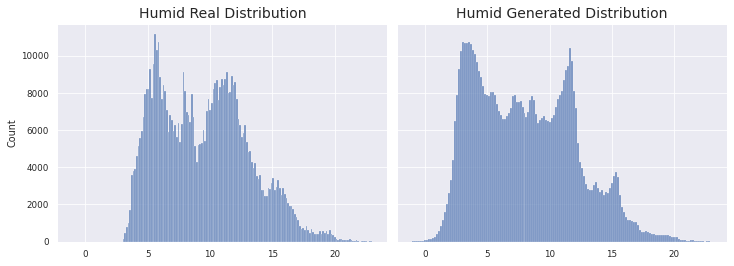

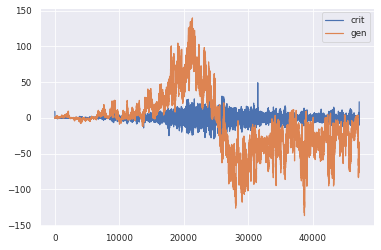

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0751 - g_loss: -23.1475
Epoch 25/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0394 - g_loss: -19.8018
Better KL
>25 MODELS HAVE BEEN SAVED


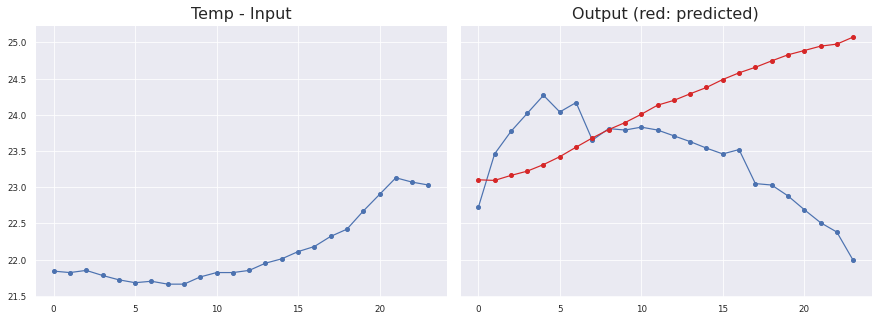

Sensor #5.0
Temp
MAE: 1.0286792185654245 ± 1.1439501886314345
MSE: 1.7946248003785297
RMSE: 1.3396360701244685
Max Error: 3.0852060556411764


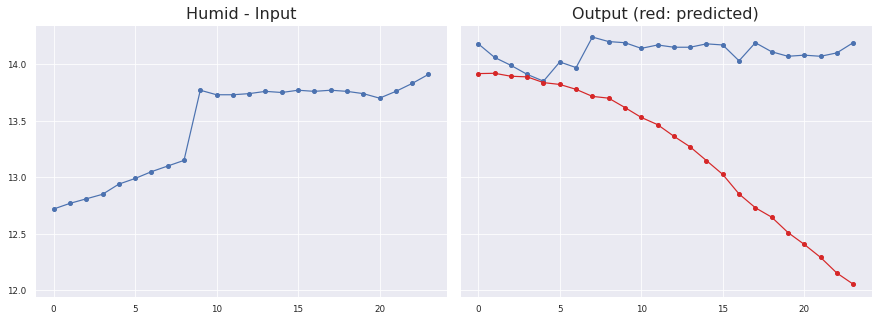

Sensor #5.0
Humid
MAE: 0.8693894368736066 ± 0.6421480539686832
MSE: 1.1681921161631736
RMSE: 1.0808293649615437
Max Error: 2.133976061753925


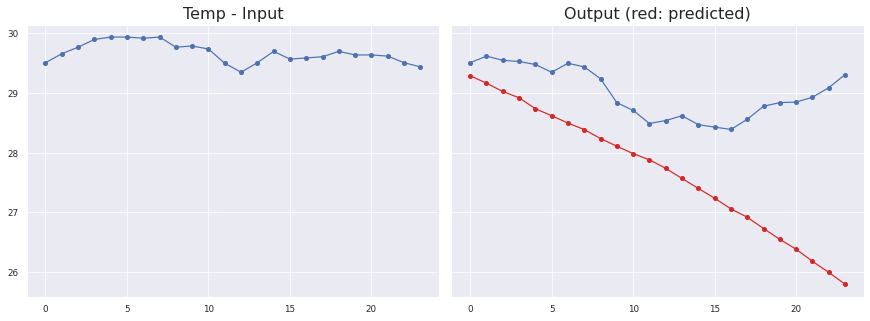

Sensor #23.0
Temp
MAE: 1.3191382918755221 ± 0.8806179070659712
MSE: 2.5156137313375218
RMSE: 1.5860686401721464
Max Error: 3.5142265480756762


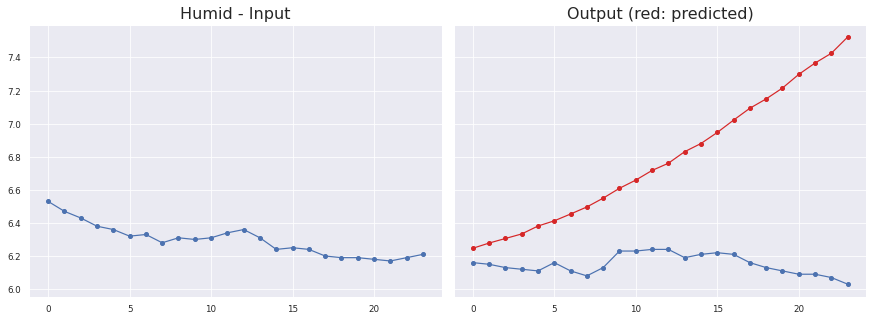

Sensor #23.0
Humid
MAE: 0.6395488808800777 ± 0.4102549934292935
MSE: 0.5773319306686294
RMSE: 0.7598236181303062
Max Error: 1.4929633820056907


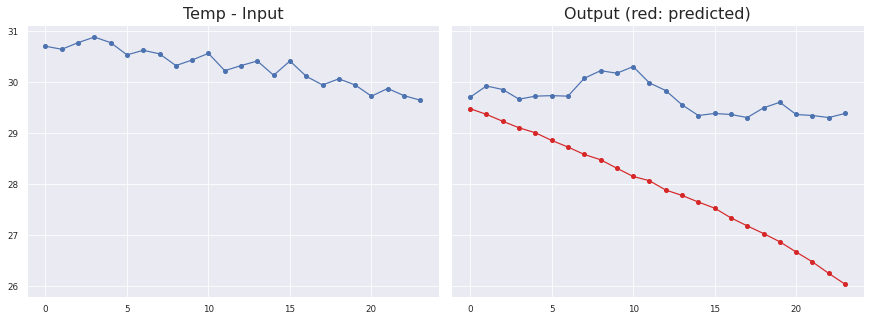

Sensor #21.0
Temp
MAE: 1.7657917386790125 ± 0.8483972592127802
MSE: 3.8377983738268076
RMSE: 1.9590299573581837
Max Error: 3.3502286964654964


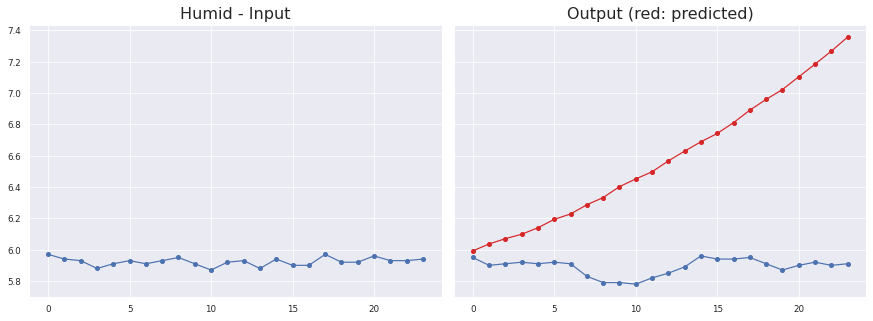

Sensor #21.0
Humid
MAE: 0.690450962409377 ± 0.4057170045591607
MSE: 0.6413288192804929
RMSE: 0.800830081403348
Max Error: 1.4462426710128788


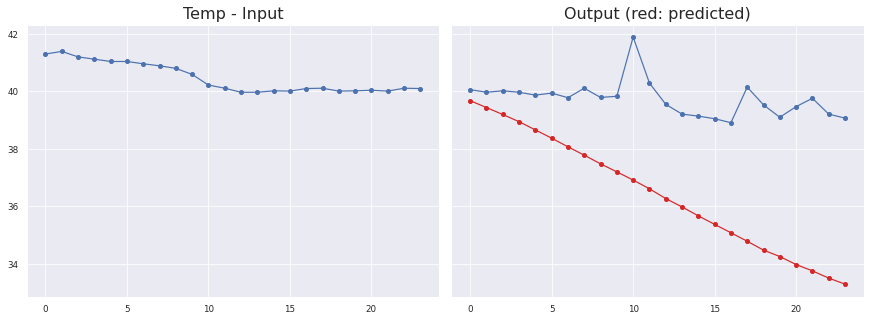

Sensor #33.0
Temp
MAE: 3.2867394734422377 ± 1.7899833812149262
MSE: 14.00669687130898
RMSE: 3.7425521868517717
Max Error: 6.002571423053745


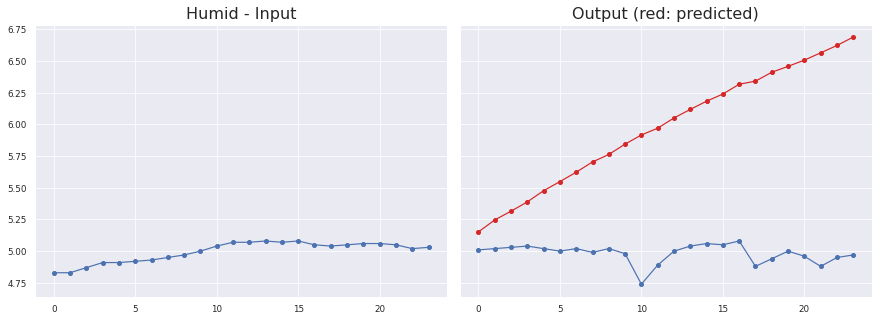

Sensor #33.0
Humid
MAE: 0.9939080013334755 ± 0.48373631329697897
MSE: 1.2218539359168568
RMSE: 1.1053750204871
Max Error: 1.7170974224805837

KL Divergence: 2.5620641150098304 bits
Pinball Loss Temp mean: 0.9399337142010156
Pinball Loss Humid mean: 0.32920862037957316
MSE Temp: 1.8798674284020245
MSE Humid: 0.6584172407591439


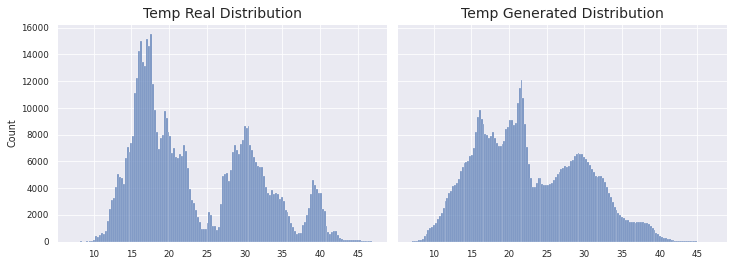

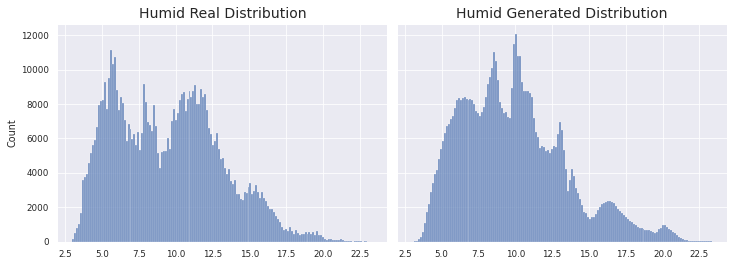

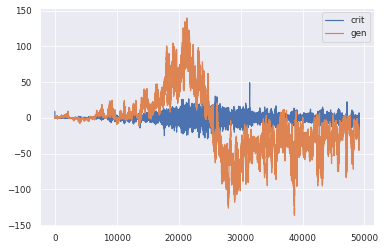

1966/1966 [==============================] - 229s 116ms/step - d_loss: 0.0297 - g_loss: -19.8057
Epoch 26/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0180 - g_loss: -20.4271

KL Divergence: 7.2790028383351855 bits
Pinball Loss Temp mean: 3.5978889924238757
Pinball Loss Humid mean: 0.8380798551614405
MSE Temp: 7.19577798484768
MSE Humid: 1.6761597103228767


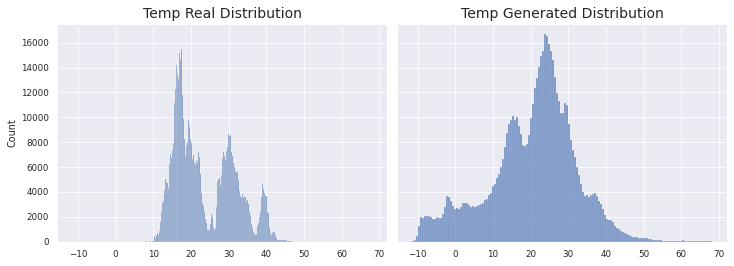

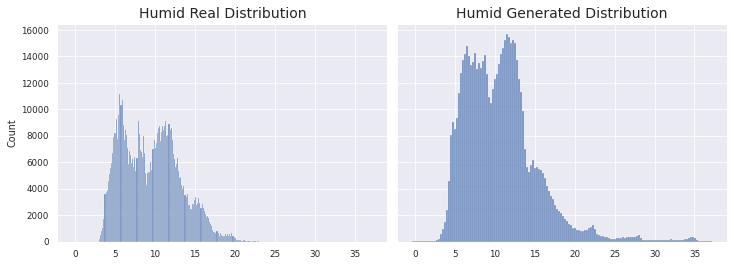

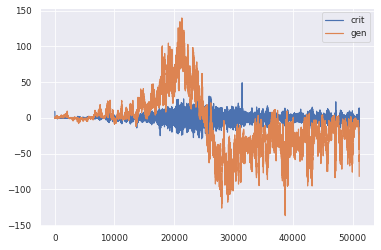

1966/1966 [==============================] - 222s 113ms/step - d_loss: 3.5874e-04 - g_loss: -20.4584
Epoch 27/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0291 - g_loss: -15.8969

KL Divergence: 14.016638377785773 bits
Pinball Loss Temp mean: 2.7218905080476388
Pinball Loss Humid mean: 0.43932937507930675
MSE Temp: 5.443781016095295
MSE Humid: 0.8786587501586012


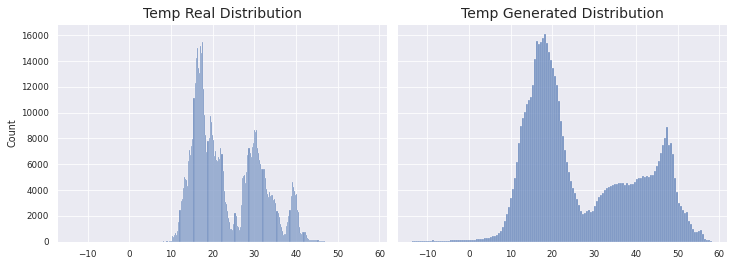

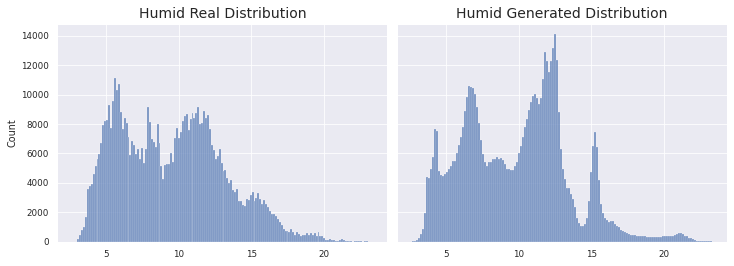

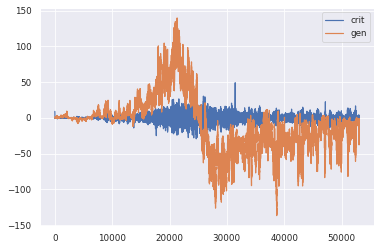

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0248 - g_loss: -15.8904
Epoch 28/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0917 - g_loss: -9.2655

KL Divergence: 22.575047780038535 bits
Pinball Loss Temp mean: 7.0260487134799074
Pinball Loss Humid mean: 1.3693679407040933
MSE Temp: 14.05209742695998
MSE Humid: 2.7387358814081546


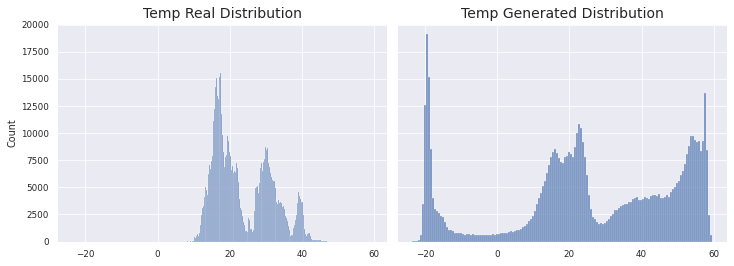

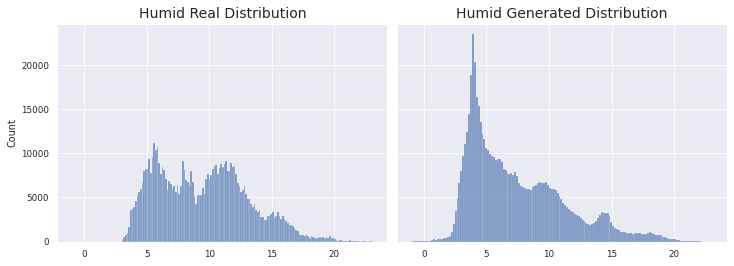

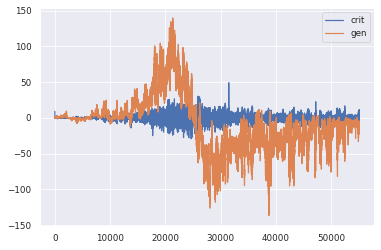

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0973 - g_loss: -9.2719
Epoch 29/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0124 - g_loss: -11.8231

KL Divergence: 7.574467028168647 bits
Pinball Loss Temp mean: 2.8079235115375742
Pinball Loss Humid mean: 0.5130433073141781
MSE Temp: 5.6158470230751725
MSE Humid: 1.0260866146283498


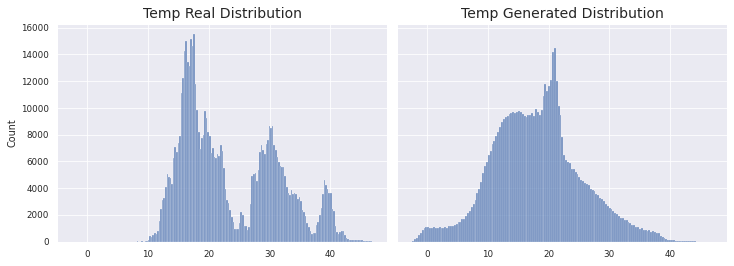

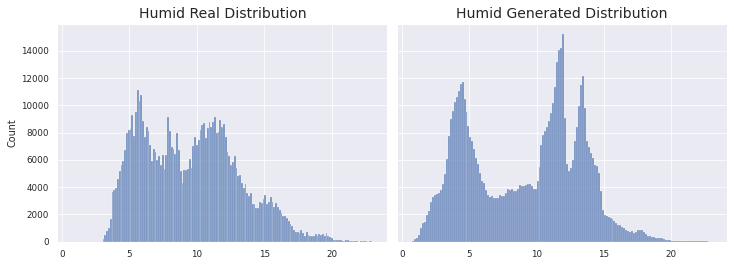

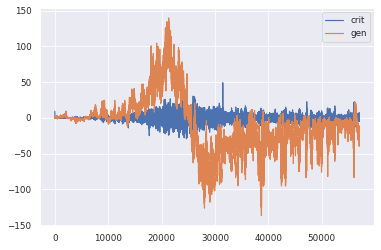

1966/1966 [==============================] - 222s 113ms/step - d_loss: -0.0103 - g_loss: -11.8272
Epoch 30/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1280 - g_loss: -23.5276

KL Divergence: 2.9629458096333003 bits
Pinball Loss Temp mean: 1.025652514105732
Pinball Loss Humid mean: 0.6431701489966627
MSE Temp: 2.05130502821142
MSE Humid: 1.2863402979933425


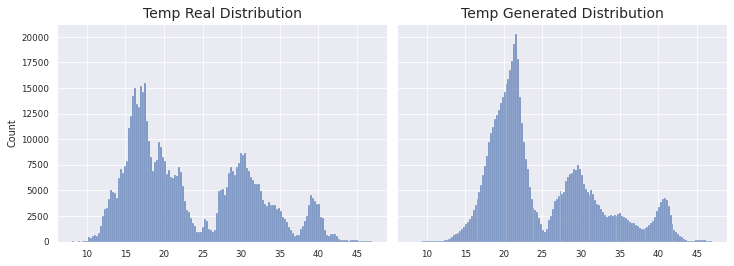

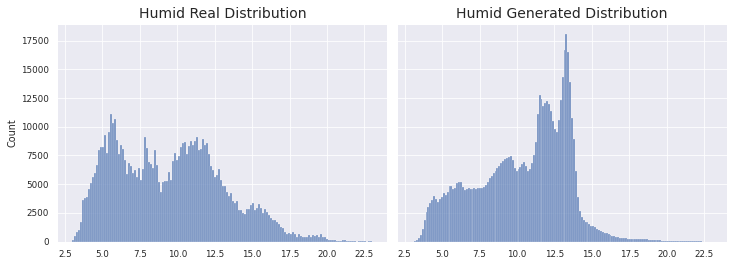

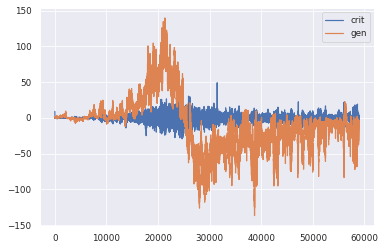

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.1266 - g_loss: -23.5178
Epoch 31/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0785 - g_loss: -13.1335
Better KL
>31 MODELS HAVE BEEN SAVED


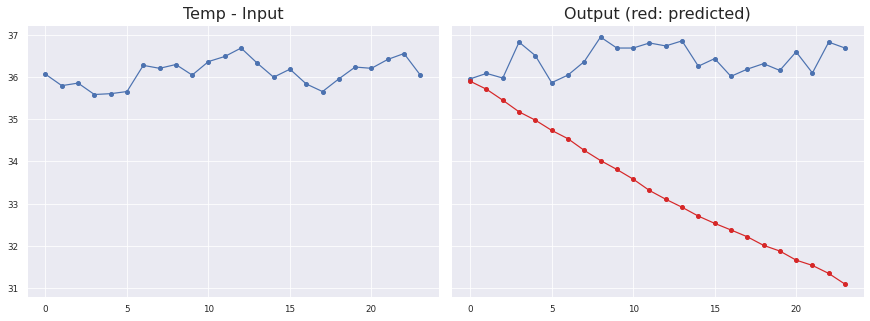

Sensor #0.0
Temp
MAE: 3.0418988646566887 ± 1.5606829160525997
MSE: 11.688879867258096
RMSE: 3.4189003886129963
Max Error: 5.588760491609573


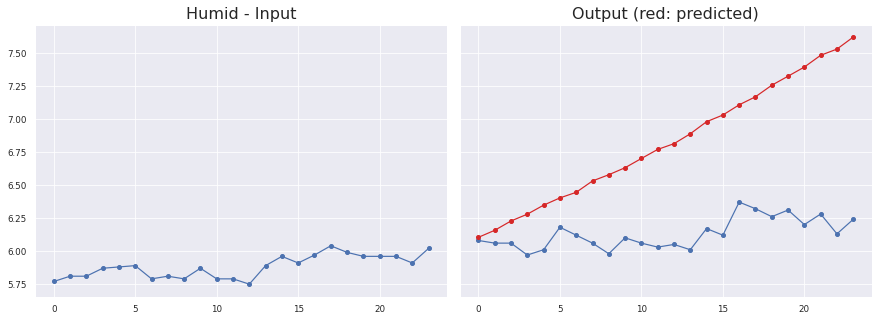

Sensor #0.0
Humid
MAE: 0.6899204821760457 ± 0.3864189029374157
MSE: 0.6253098402733834
RMSE: 0.790765350956517
Max Error: 1.3963707184791563


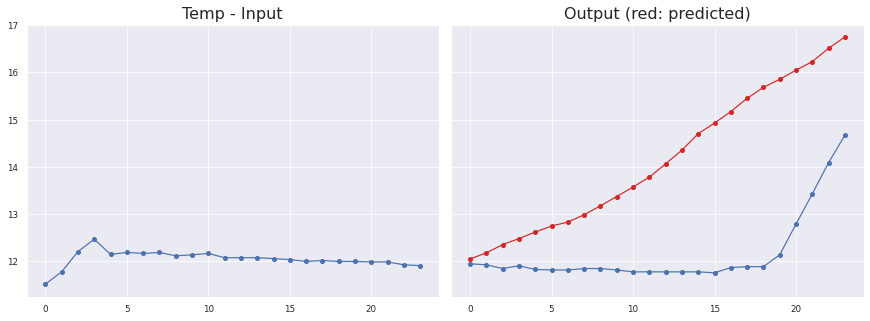

Sensor #1.0
Temp
MAE: 1.9943296924233438 ± 1.1410520341562498
MSE: 5.279350666733504
RMSE: 2.297683761254691
Max Error: 3.7934871315956116


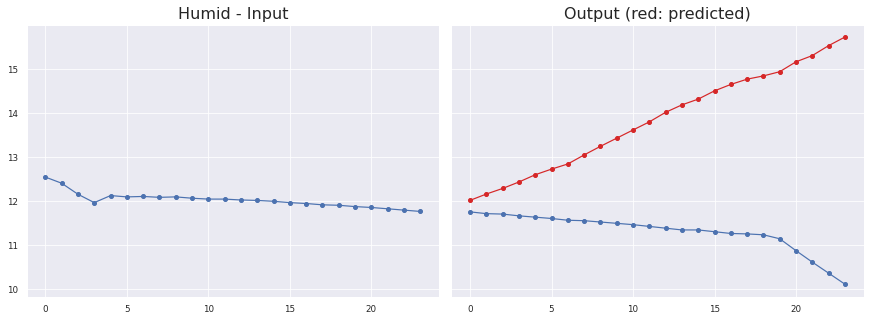

Sensor #1.0
Humid
MAE: 2.531002904300889 ± 1.499677778439737
MSE: 8.65500914072548
RMSE: 2.9419396901917416
Max Error: 5.607150344252588


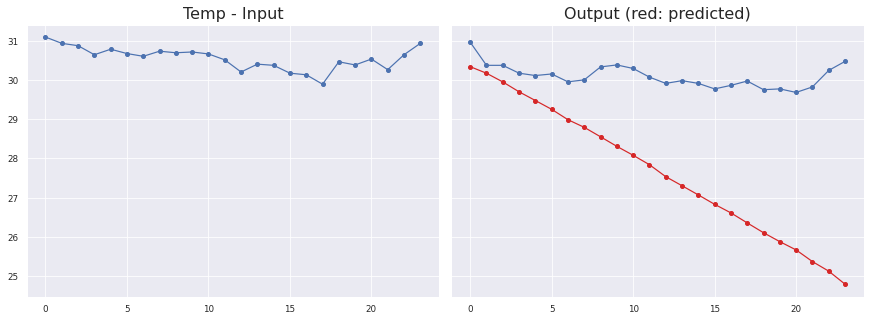

Sensor #14.0
Temp
MAE: 2.4241764310623215 ± 1.5320551733760555
MSE: 8.223824423186391
RMSE: 2.867721120190454
Max Error: 5.671455751657486


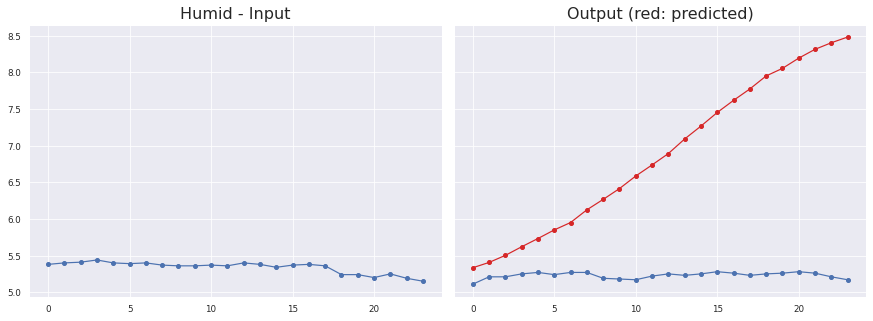

Sensor #14.0
Humid
MAE: 1.6469334984384478 ± 1.0242353882269455
MSE: 3.7614480787751057
RMSE: 1.9394453018260416
Max Error: 3.3139128544926653


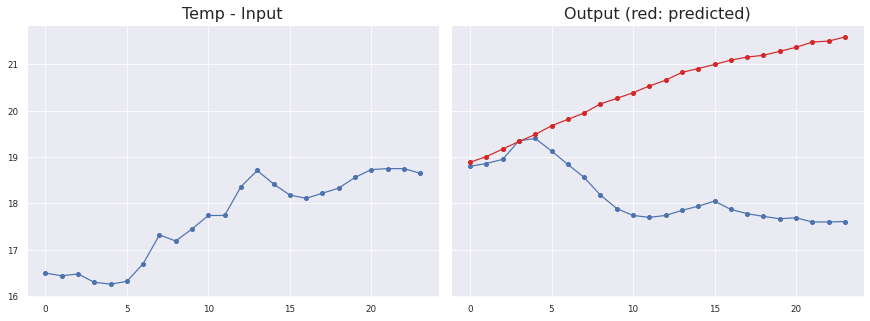

Sensor #28.0
Temp
MAE: 2.257440182467301 ± 1.3960204193047427
MSE: 7.039116097247779
RMSE: 2.6531332603636364
Max Error: 3.975613974332809


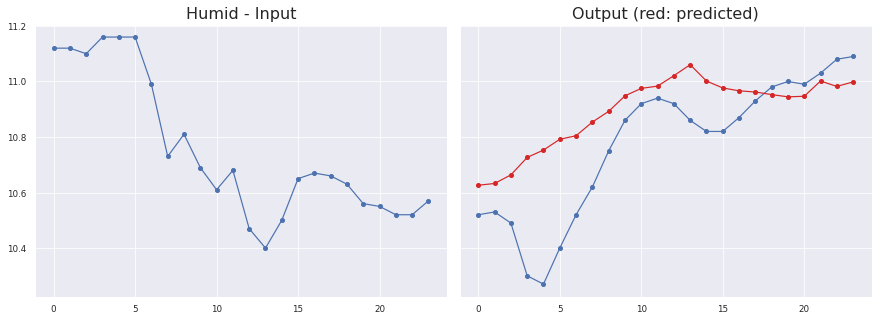

Sensor #28.0
Humid
MAE: 0.15178577392051631 ± 0.15382503202216224
MSE: 0.038827107809336625
RMSE: 0.19704595354722873
Max Error: 0.48301628202199964

KL Divergence: 1.8011794887297032 bits
Pinball Loss Temp mean: 1.179475607845972
Pinball Loss Humid mean: 0.5461421737845977
MSE Temp: 2.3589512156919454
MSE Humid: 1.0922843475692015


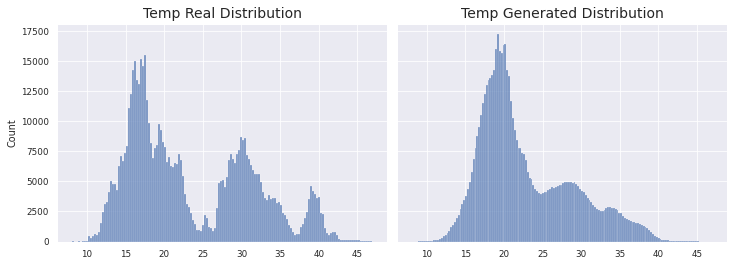

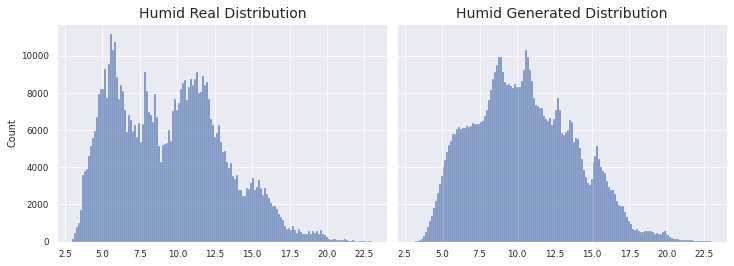

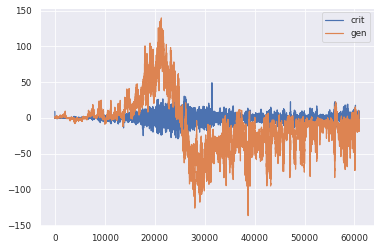

1966/1966 [==============================] - 231s 117ms/step - d_loss: -0.0777 - g_loss: -13.1333
Epoch 32/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0084 - g_loss: -13.3546

KL Divergence: 8.817320048908673 bits
Pinball Loss Temp mean: 2.0536295381286664
Pinball Loss Humid mean: 0.5836046873480424
MSE Temp: 4.10725907625734
MSE Humid: 1.167209374696067


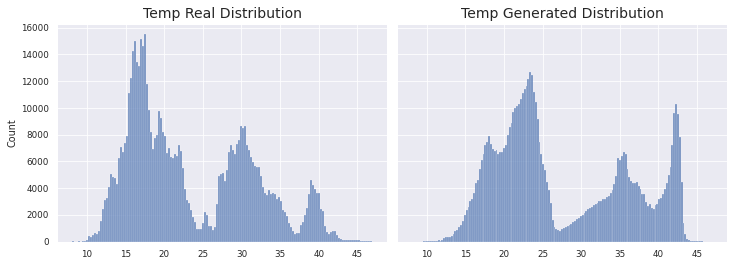

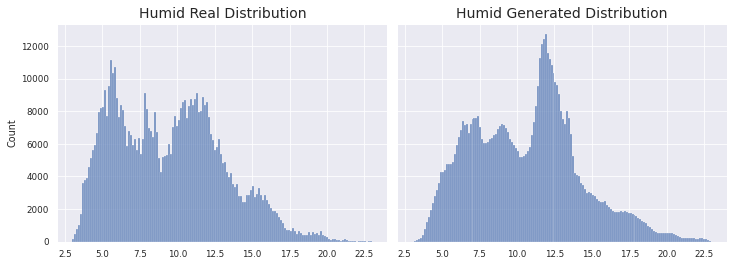

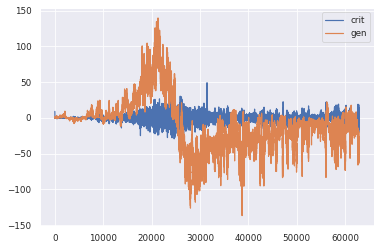

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.0075 - g_loss: -13.3800
Epoch 33/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2439 - g_loss: -32.6886

KL Divergence: 19.69419047886685 bits
Pinball Loss Temp mean: 3.396924741203082
Pinball Loss Humid mean: 1.7839911759001623
MSE Temp: 6.793849482406115
MSE Humid: 3.5679823518004246


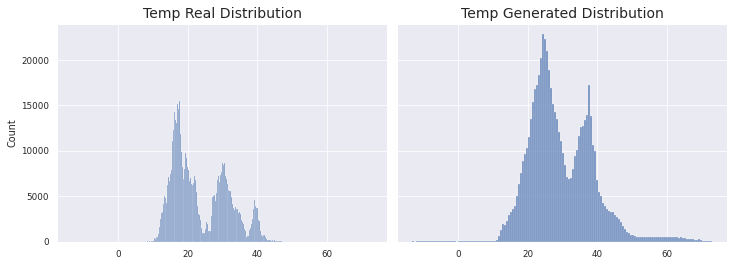

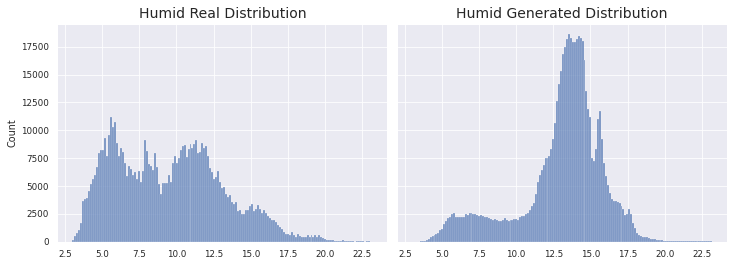

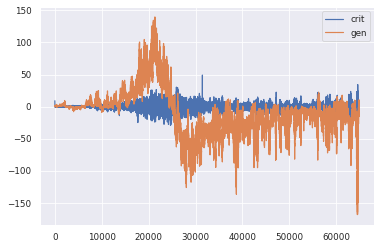

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.2436 - g_loss: -32.6798
Epoch 34/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0377 - g_loss: -27.4021

KL Divergence: 15.756926474231282 bits
Pinball Loss Temp mean: 1.0765293955770776
Pinball Loss Humid mean: 0.7663684927779233
MSE Temp: 2.1530587911541432
MSE Humid: 1.5327369855558368


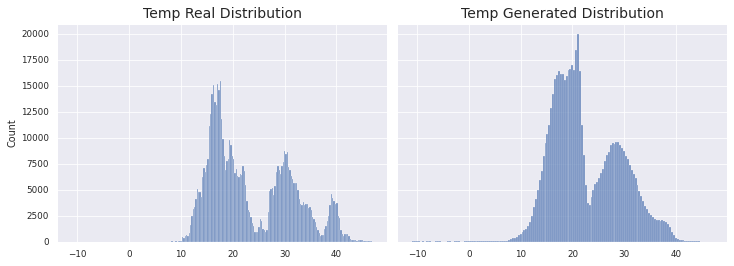

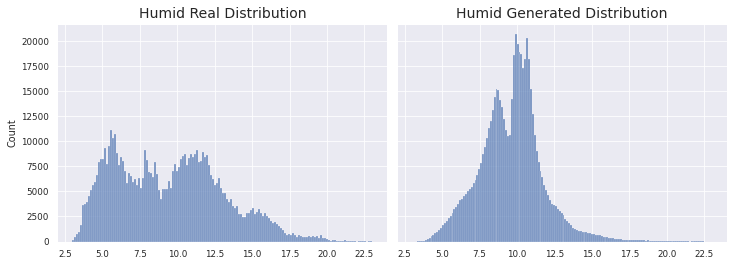

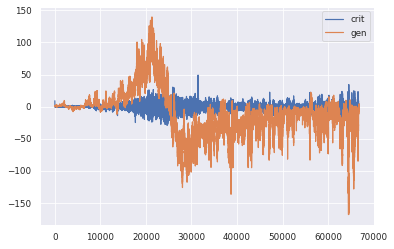

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0380 - g_loss: -27.3875
Epoch 35/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0933 - g_loss: -13.5269

KL Divergence: 16.480267987370212 bits
Pinball Loss Temp mean: 2.6370753634743016
Pinball Loss Humid mean: 0.5919697732734315
MSE Temp: 5.27415072694859
MSE Humid: 1.1839395465468696


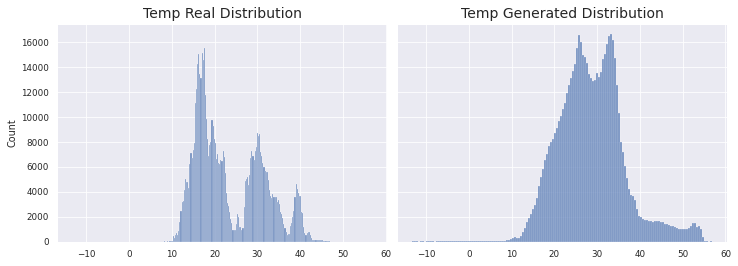

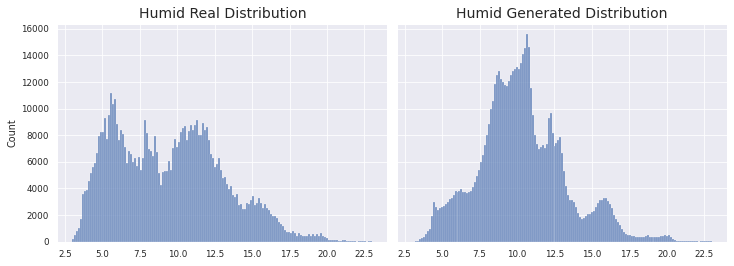

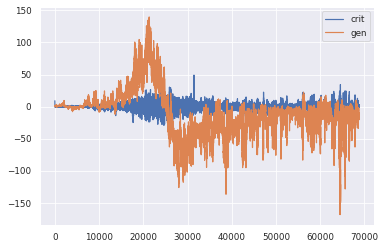

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0925 - g_loss: -13.5279
Epoch 36/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0356 - g_loss: -15.1418

KL Divergence: 18.147601868813833 bits
Pinball Loss Temp mean: 1.4986401905511466
Pinball Loss Humid mean: 0.8636303482859946
MSE Temp: 2.997280381102228
MSE Humid: 1.7272606965719992


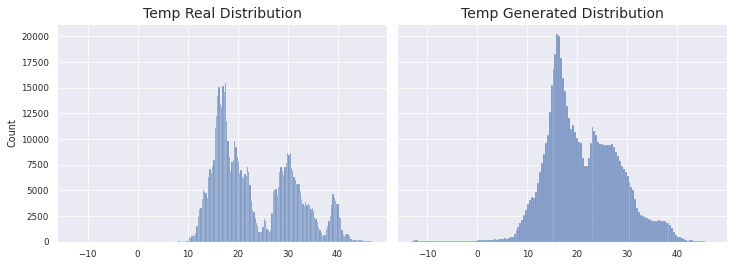

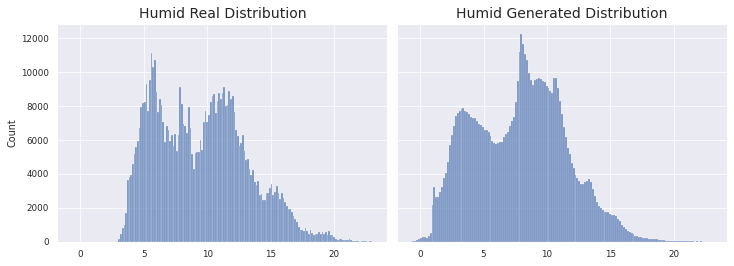

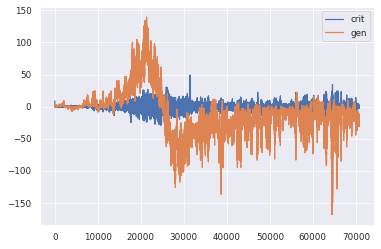

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0345 - g_loss: -15.1400
Epoch 37/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0762 - g_loss: -32.4690

KL Divergence: 14.232352015330738 bits
Pinball Loss Temp mean: 1.06470371826516
Pinball Loss Humid mean: 0.860354069067254
MSE Temp: 2.1294074365303364
MSE Humid: 1.720708138134508


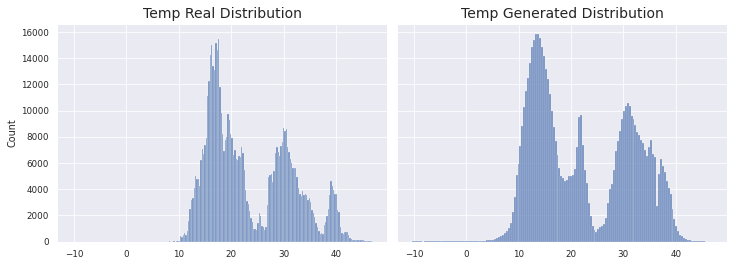

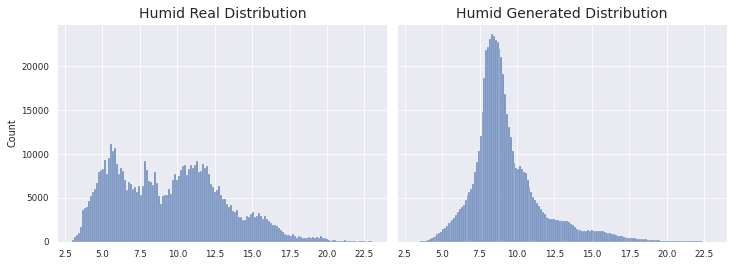

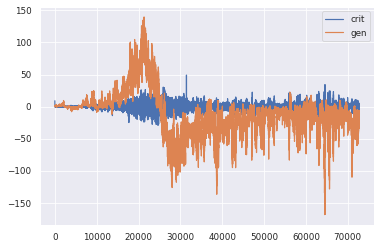

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0731 - g_loss: -32.4577
Epoch 38/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0502 - g_loss: -19.9225

KL Divergence: 4.039191376433393 bits
Pinball Loss Temp mean: 0.8829062416690613
Pinball Loss Humid mean: 0.4535348582060176
MSE Temp: 1.7658124833381126
MSE Humid: 0.9070697164120233


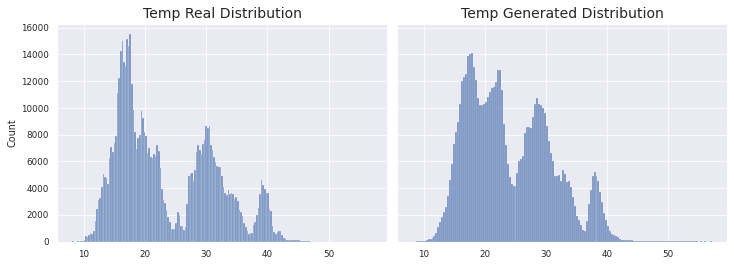

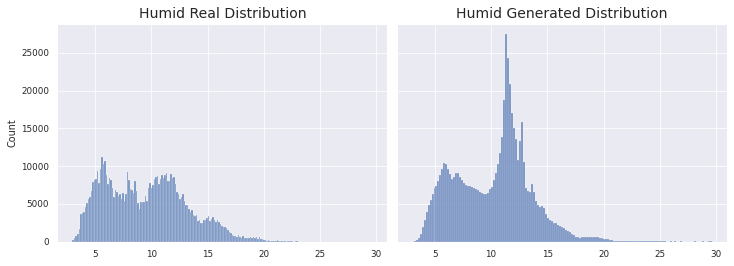

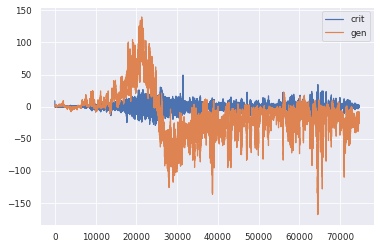

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0512 - g_loss: -19.9243
Epoch 39/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0381 - g_loss: -19.8002
Better Pinball
Better MSE
>39 MODELS HAVE BEEN SAVED


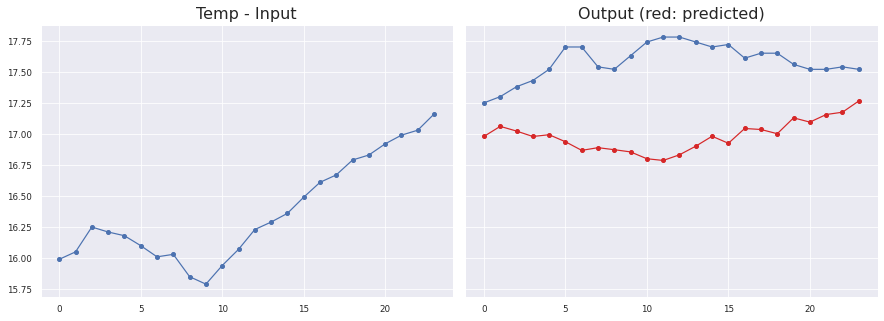

Sensor #17.0
Temp
MAE: 0.6007275368769974 ± 0.22692682504368525
MSE: 0.41236935748671155
RMSE: 0.6421599158205934
Max Error: 0.9938422584533697


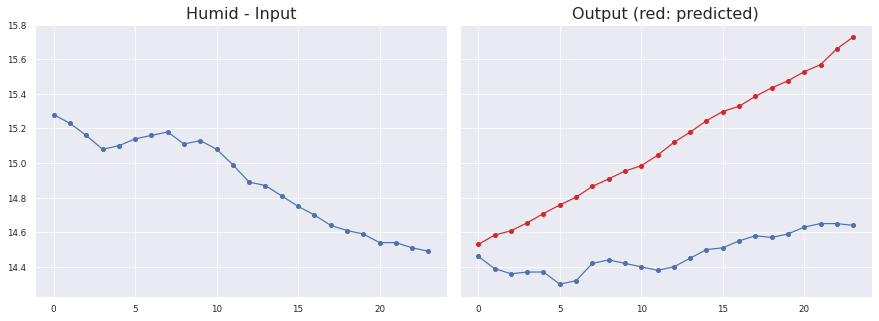

Sensor #17.0
Humid
MAE: 0.625290989770244 ± 0.26752465199741027
MSE: 0.4625582613141869
RMSE: 0.6801163586579777
Max Error: 1.0885772781074046


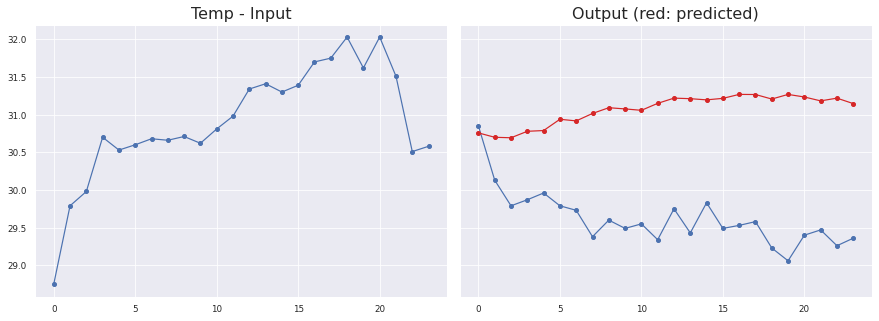

Sensor #21.0
Temp
MAE: 1.4549267166852948 ± 0.5105139612364556
MSE: 2.355143113381482
RMSE: 1.5346475534732664
Max Error: 2.208508961200714


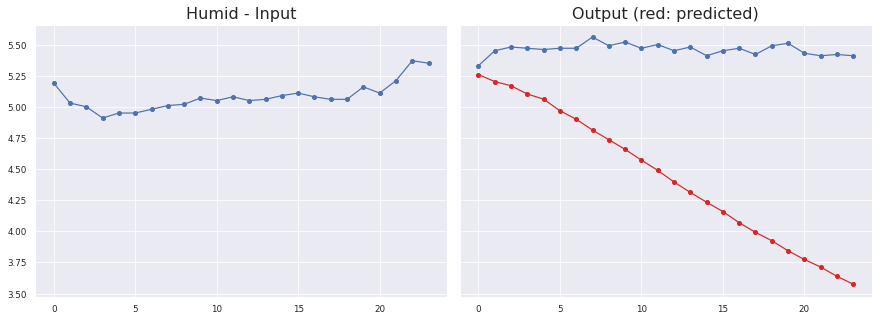

Sensor #21.0
Humid
MAE: 1.019039261465271 ± 0.5291669672559126
MSE: 1.3184586956425048
RMSE: 1.1482415667630679
Max Error: 1.8342807179689409


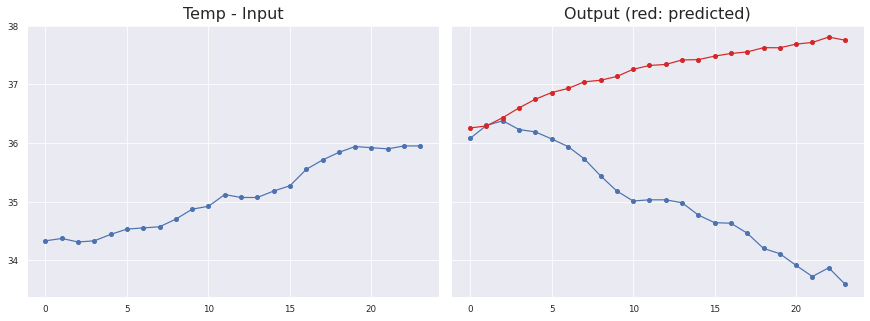

Sensor #11.0
Temp
MAE: 2.1443576878309245 ± 1.3229700487701224
MSE: 6.345641977589092
RMSE: 2.5190557710358643
Max Error: 4.16593599319458


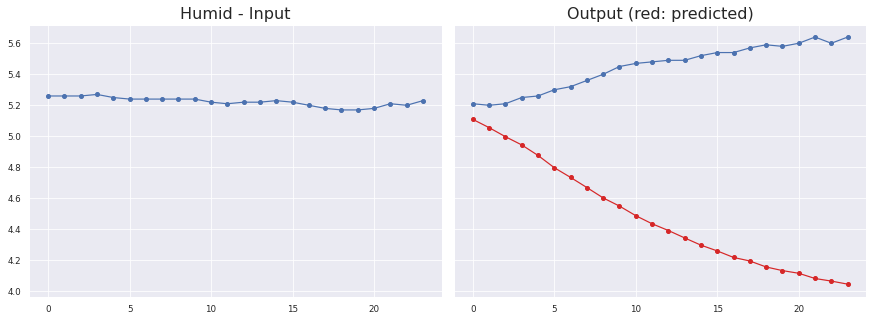

Sensor #11.0
Humid
MAE: 0.963859355400006 ± 0.480004264455229
MSE: 1.1594289508873201
RMSE: 1.076767825897171
Max Error: 1.593409262299537


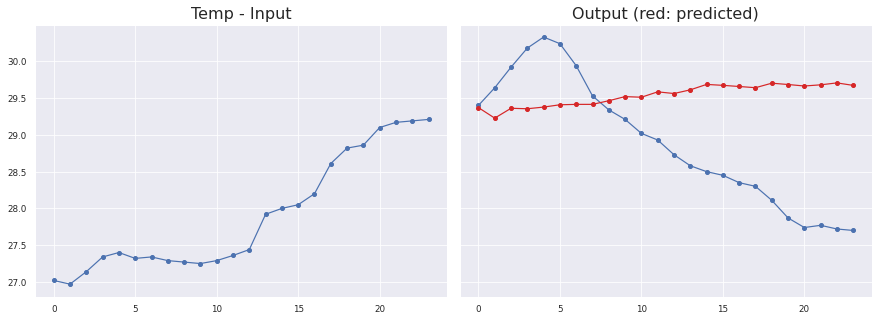

Sensor #12.0
Temp
MAE: 0.9980945062637323 ± 0.980413738677341
MSE: 1.375960484285925
RMSE: 1.1730134203349614
Max Error: 1.9865832027792933


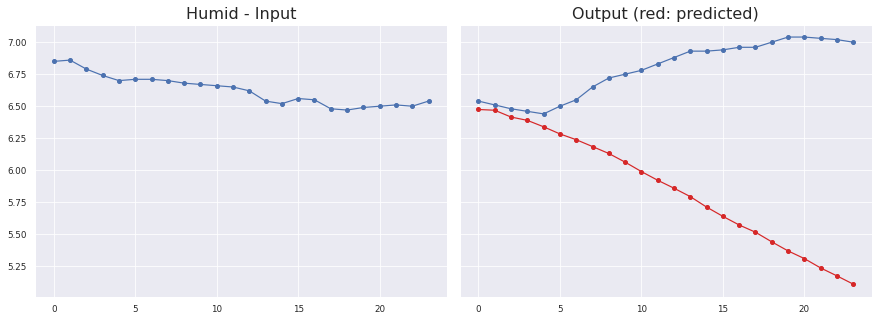

Sensor #12.0
Humid
MAE: 0.9292629513641195 ± 0.6404742342533863
MSE: 1.2737368775204156
RMSE: 1.1285995204324764
Max Error: 1.8894785964488978

KL Divergence: 14.416563681352985 bits
Pinball Loss Temp mean: 0.6400305361032845
Pinball Loss Humid mean: 0.4016400105062813
MSE Temp: 1.2800610722065602
MSE Humid: 0.8032800210125632


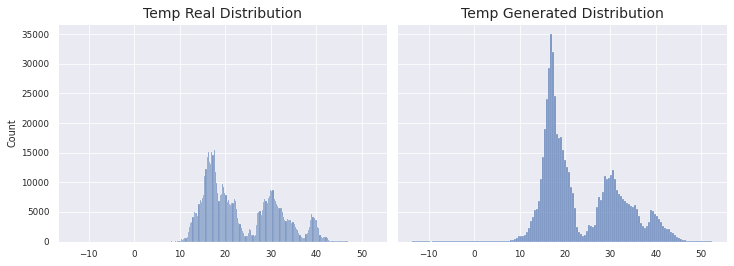

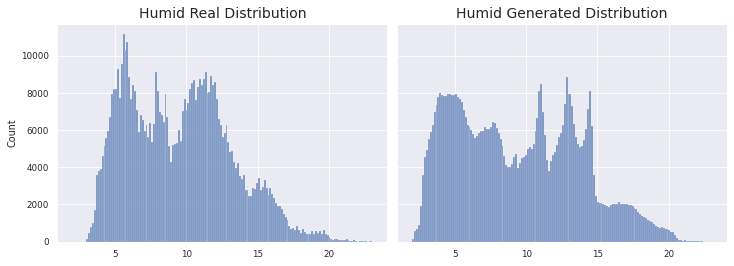

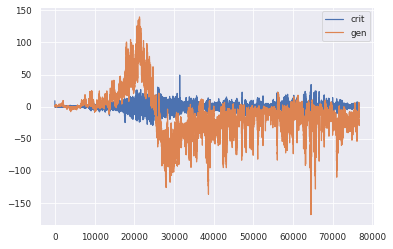

1966/1966 [==============================] - 230s 117ms/step - d_loss: 0.0350 - g_loss: -19.8023
Epoch 40/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0946 - g_loss: -18.1859

KL Divergence: 17.04123646807803 bits
Pinball Loss Temp mean: 5.7259843997890325
Pinball Loss Humid mean: 1.232813461832852
MSE Temp: 11.451968799577973
MSE Humid: 2.465626923665672


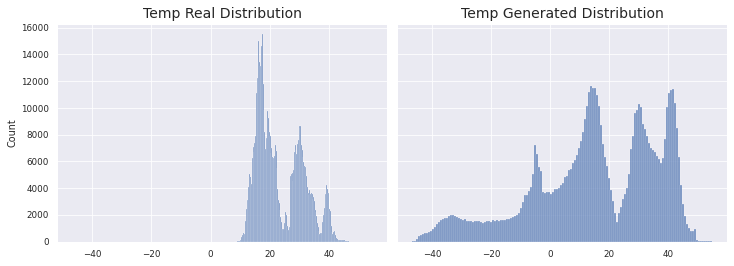

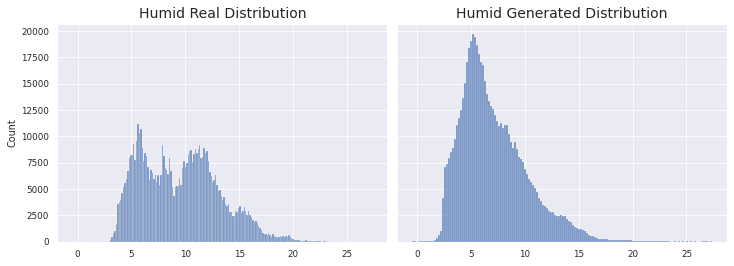

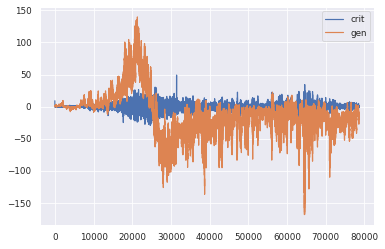

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0951 - g_loss: -18.1842
Epoch 41/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0100 - g_loss: -21.4247

KL Divergence: 21.627870415144628 bits
Pinball Loss Temp mean: 1.0325252437717836
Pinball Loss Humid mean: 0.5886966686006777
MSE Temp: 2.0650504875435685
MSE Humid: 1.1773933372013385


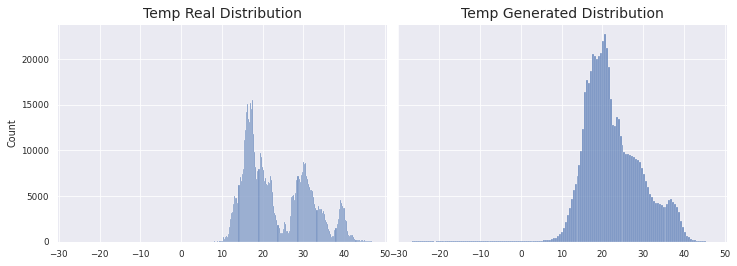

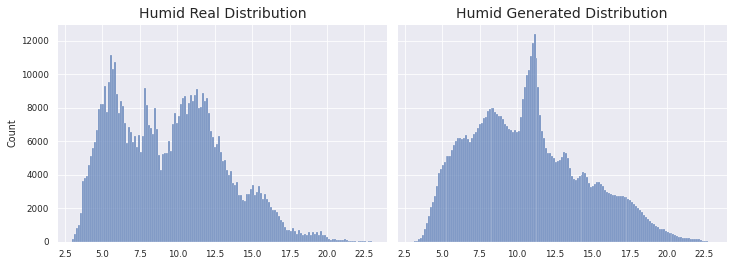

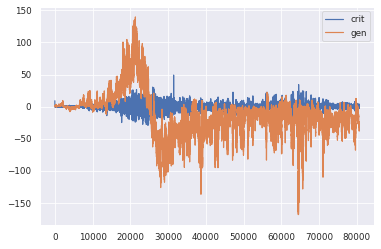

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0103 - g_loss: -21.4304
Epoch 42/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0409 - g_loss: -22.2602

KL Divergence: 19.84209594448818 bits
Pinball Loss Temp mean: 1.2950479060290192
Pinball Loss Humid mean: 0.6065149178041078
MSE Temp: 2.5900958120580464
MSE Humid: 1.213029835608223


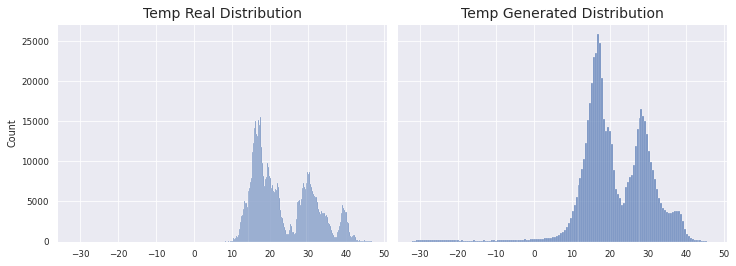

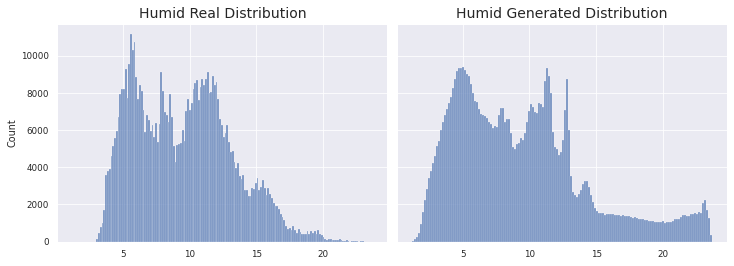

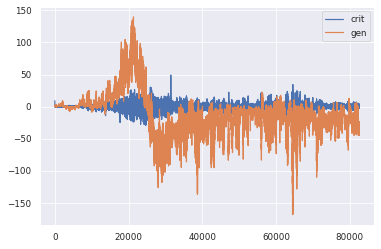

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0414 - g_loss: -22.2716
Epoch 43/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0217 - g_loss: -34.2478

KL Divergence: 22.073740455915452 bits
Pinball Loss Temp mean: 1.1940360002792314
Pinball Loss Humid mean: 0.6362077875752564
MSE Temp: 2.3880720005584757
MSE Humid: 1.2724155751505228


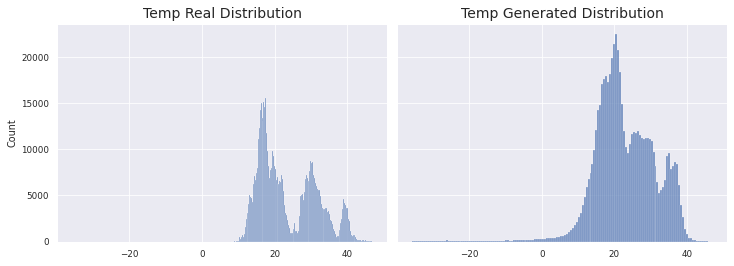

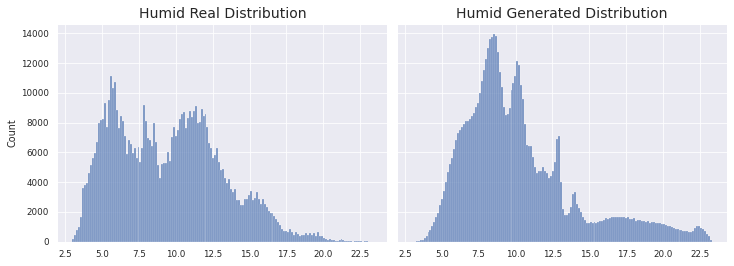

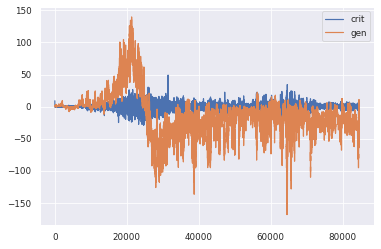

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0266 - g_loss: -34.2306
Epoch 44/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0034 - g_loss: -51.6349

KL Divergence: 22.843116640488127 bits
Pinball Loss Temp mean: 0.7697838468800565
Pinball Loss Humid mean: 0.5905765539675077
MSE Temp: 1.5395676937601273
MSE Humid: 1.1811531079350082


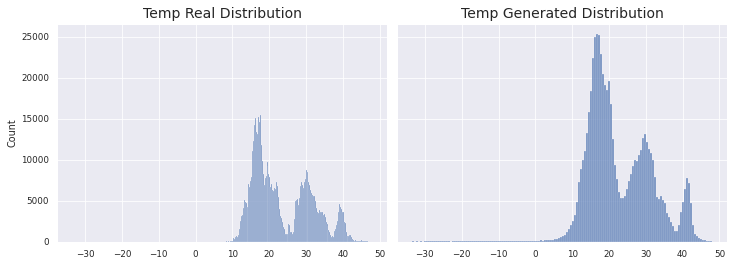

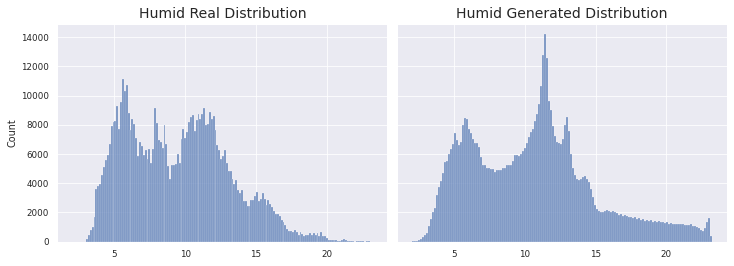

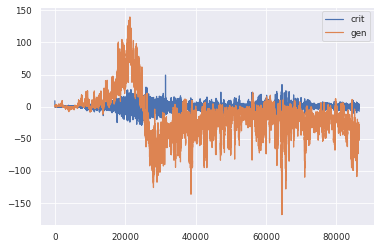

1966/1966 [==============================] - 223s 113ms/step - d_loss: -3.7933e-04 - g_loss: -51.6354
Epoch 45/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0101 - g_loss: -46.7758

KL Divergence: 16.15601806979157 bits
Pinball Loss Temp mean: 2.617304075072272
Pinball Loss Humid mean: 0.6313869295574979
MSE Temp: 5.234608150144596
MSE Humid: 1.2627738591149928


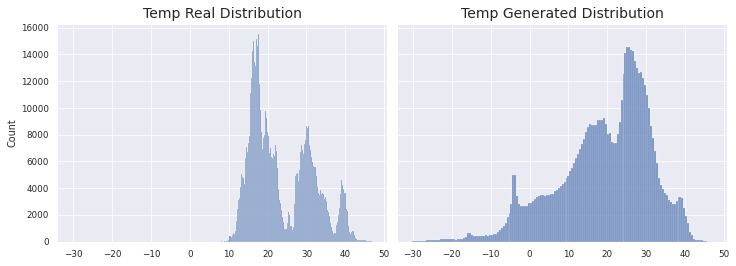

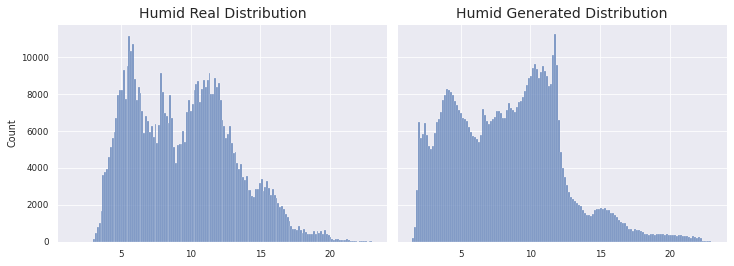

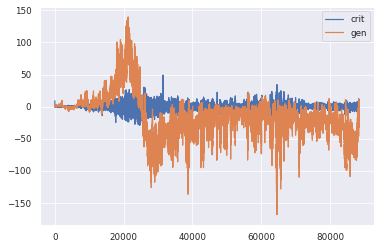

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.0140 - g_loss: -46.7637
Epoch 46/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0845 - g_loss: -27.9850

KL Divergence: 20.399854458628578 bits
Pinball Loss Temp mean: 2.0984085251859286
Pinball Loss Humid mean: 0.3877047442188345
MSE Temp: 4.196817050371783
MSE Humid: 0.7754094884376747


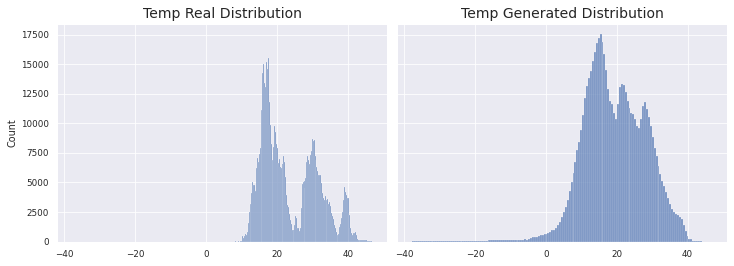

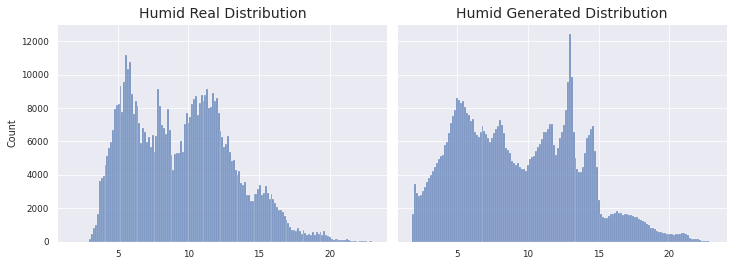

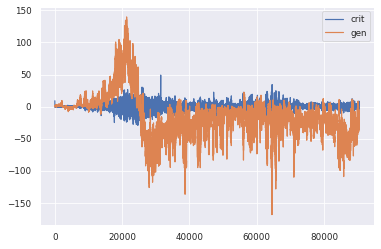

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0846 - g_loss: -27.9743
Epoch 47/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0919 - g_loss: -53.4123

KL Divergence: 4.16374803070782 bits
Pinball Loss Temp mean: 2.850449986415309
Pinball Loss Humid mean: 0.617876694473894
MSE Temp: 5.700899972830542
MSE Humid: 1.235753388947806


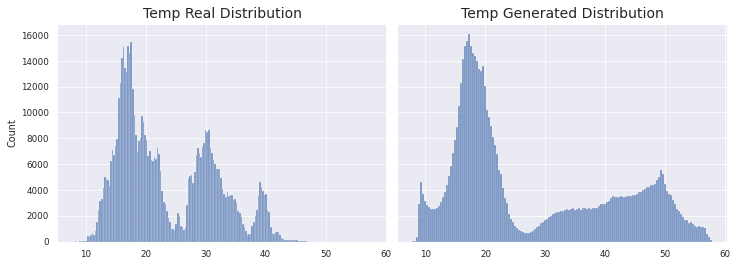

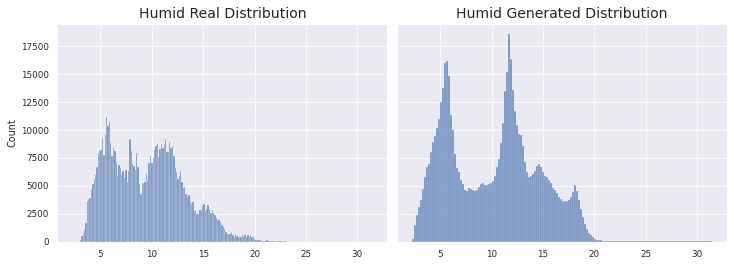

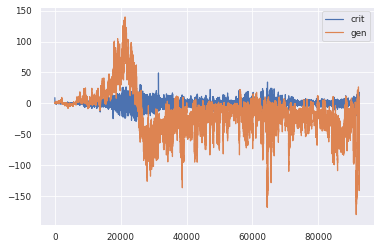

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.1008 - g_loss: -53.4339
Epoch 48/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0099 - g_loss: -53.7273

KL Divergence: 12.776125087435032 bits
Pinball Loss Temp mean: 2.861741729870576
Pinball Loss Humid mean: 0.32497661231774005
MSE Temp: 5.723483459741168
MSE Humid: 0.6499532246354784


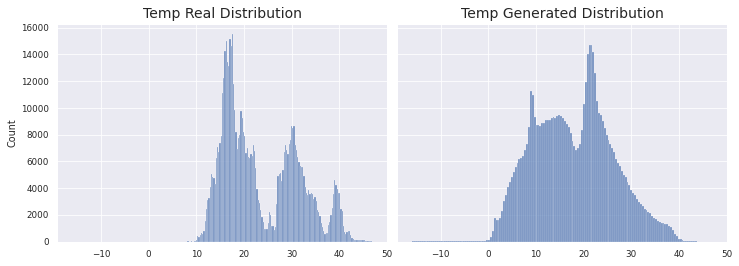

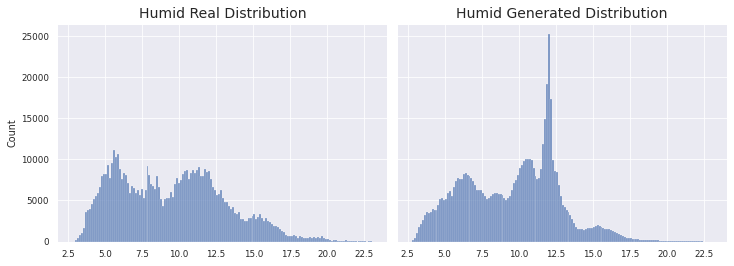

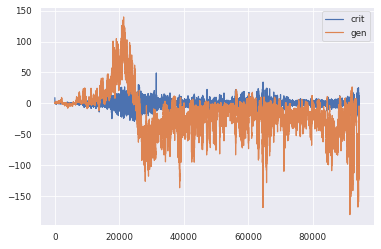

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.0063 - g_loss: -53.7147
Epoch 49/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0163 - g_loss: -45.0692

KL Divergence: 3.7338138458413734 bits
Pinball Loss Temp mean: 1.5674252394054111
Pinball Loss Humid mean: 0.4487921166403842
MSE Temp: 3.134850478810777
MSE Humid: 0.8975842332807925


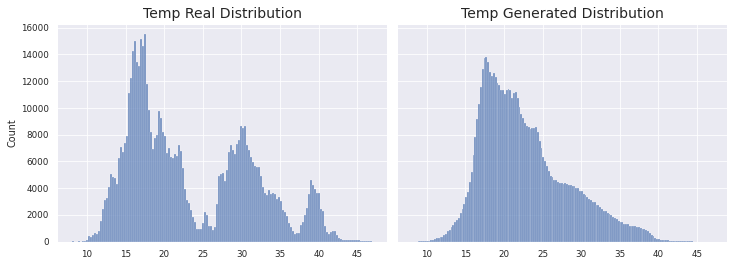

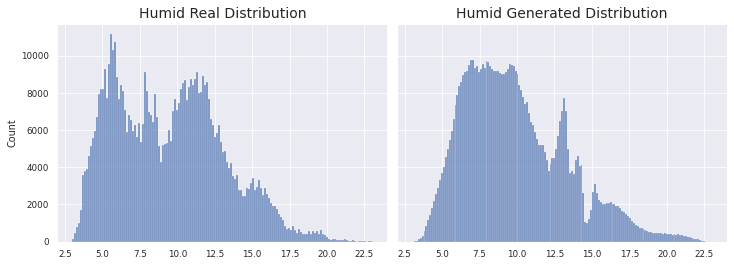

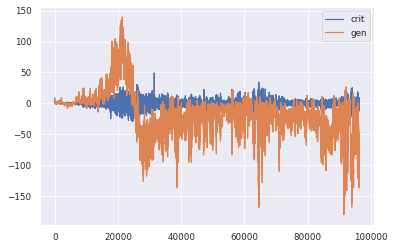

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0209 - g_loss: -45.1158
Epoch 50/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0556 - g_loss: -71.1978

KL Divergence: 6.222233350744475 bits
Pinball Loss Temp mean: 2.7911436323313046
Pinball Loss Humid mean: 0.5035182017410232
MSE Temp: 5.582287264662614
MSE Humid: 1.0070364034820471


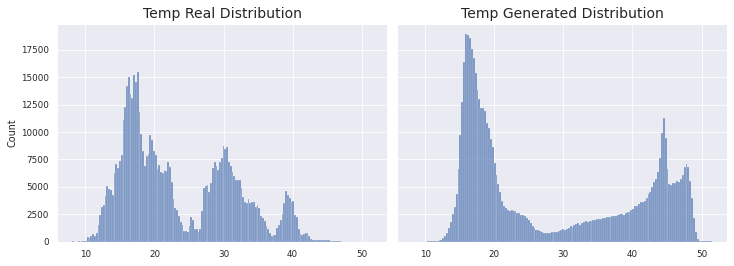

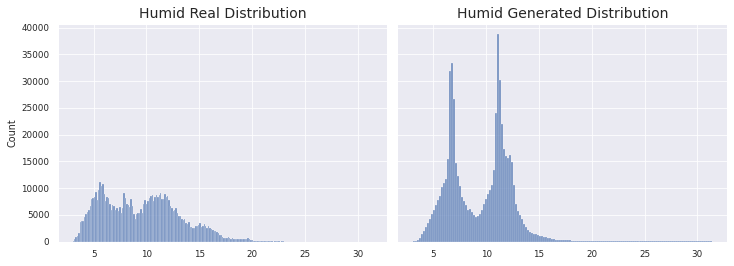

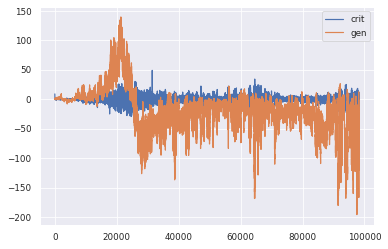

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.0574 - g_loss: -71.1727
Epoch 51/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1239 - g_loss: -71.8510

KL Divergence: 9.362176449940392 bits
Pinball Loss Temp mean: 1.4524863237320638
Pinball Loss Humid mean: 0.45657541657980527
MSE Temp: 2.9049726474640947
MSE Humid: 0.9131508331596059


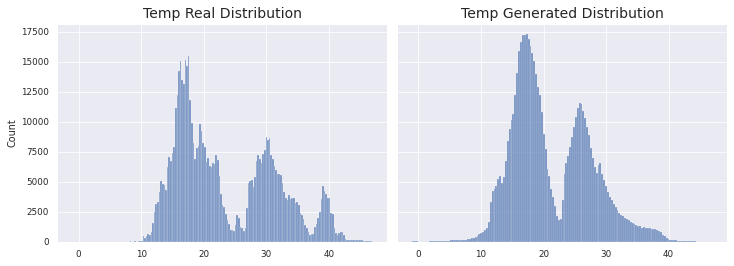

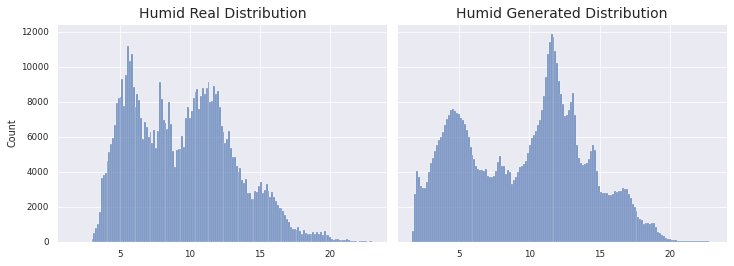

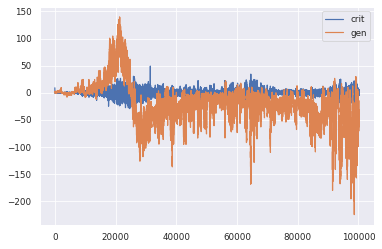

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.1225 - g_loss: -71.8221
Epoch 52/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0184 - g_loss: -79.7436

KL Divergence: 6.0590849227146615 bits
Pinball Loss Temp mean: 2.3303755307608367
Pinball Loss Humid mean: 0.3592731446503596
MSE Temp: 4.66075106152162
MSE Humid: 0.7185462893007077


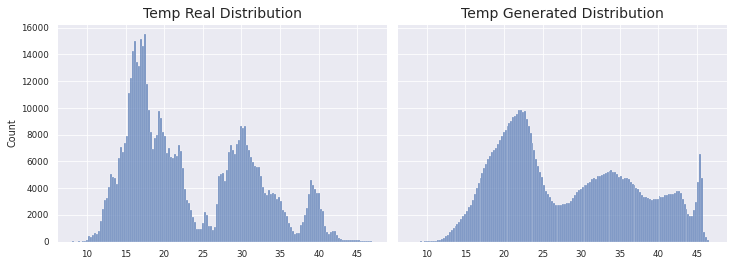

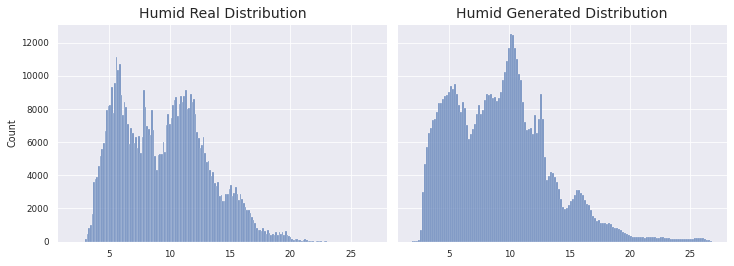

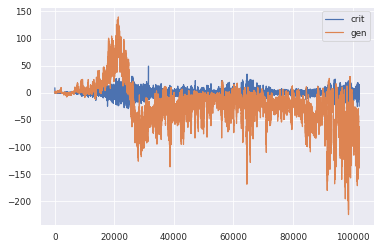

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.0311 - g_loss: -79.7368
Epoch 53/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0362 - g_loss: -60.6470

KL Divergence: 2.2175473814240445 bits
Pinball Loss Temp mean: 0.7225139215080023
Pinball Loss Humid mean: 0.40911461217236145
MSE Temp: 1.4450278430159973
MSE Humid: 0.8182292243447247


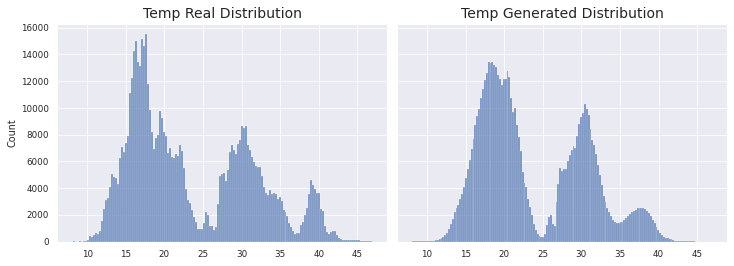

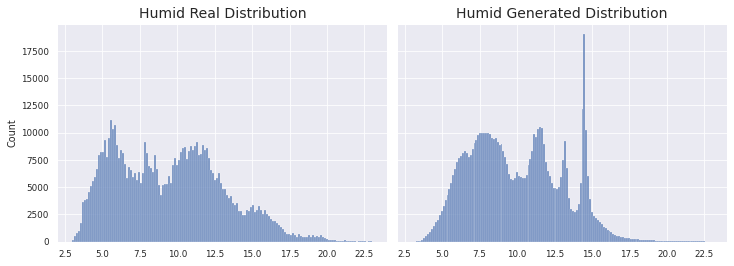

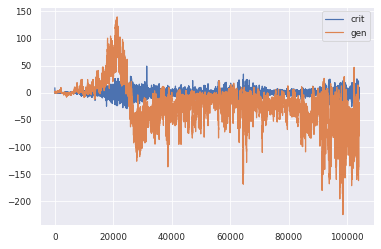

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.0401 - g_loss: -60.6410
Epoch 54/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0095 - g_loss: -51.3874

KL Divergence: 5.290457178055835 bits
Pinball Loss Temp mean: 3.805125616041073
Pinball Loss Humid mean: 1.5229795555036956
MSE Temp: 7.610251232082096
MSE Humid: 3.045959111007329


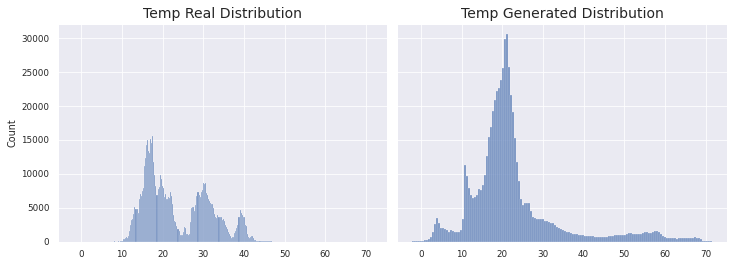

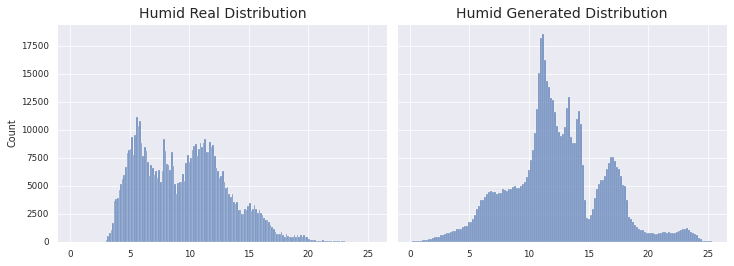

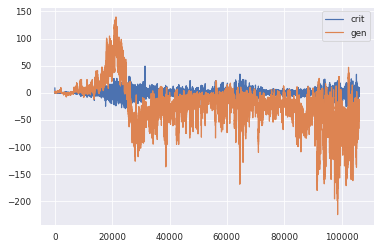

1966/1966 [==============================] - 222s 113ms/step - d_loss: -0.0047 - g_loss: -51.3947
Epoch 55/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1260 - g_loss: -87.9064

KL Divergence: 4.27851043753976 bits
Pinball Loss Temp mean: 2.4506844484860624
Pinball Loss Humid mean: 0.5708382663003188
MSE Temp: 4.901368896972167
MSE Humid: 1.1416765326006397


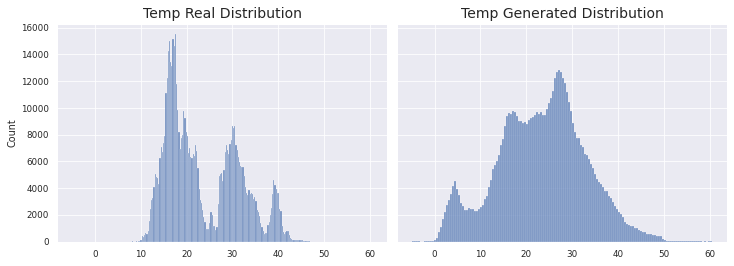

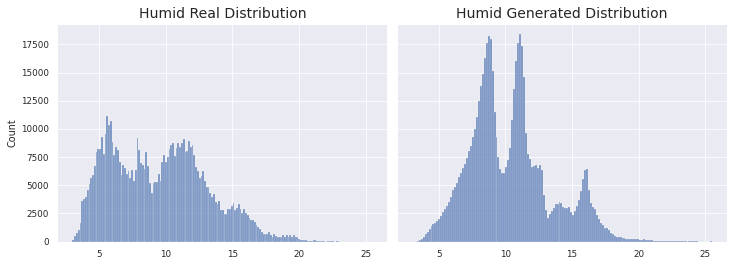

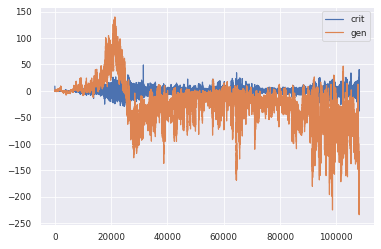

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.1069 - g_loss: -87.9436
Epoch 56/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1324 - g_loss: -121.1874

KL Divergence: 9.661598229685625 bits
Pinball Loss Temp mean: 1.184406495746122
Pinball Loss Humid mean: 0.6312006595533348
MSE Temp: 2.3688129914922054
MSE Humid: 1.2624013191066583


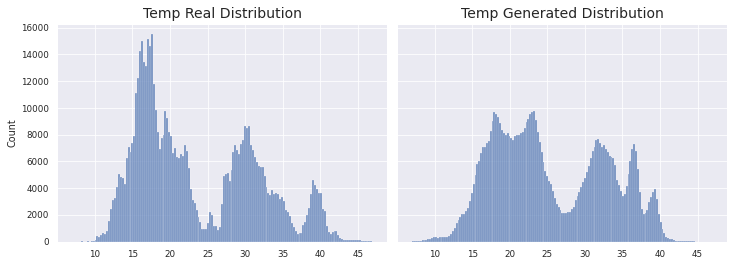

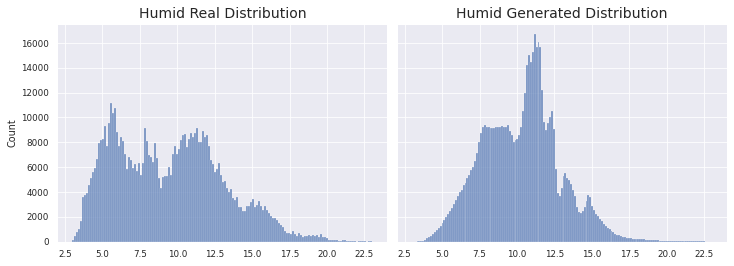

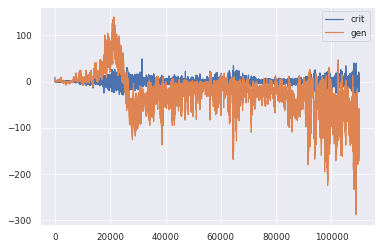

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.1220 - g_loss: -121.1664
Epoch 57/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1247 - g_loss: -112.6774

KL Divergence: 6.083363260535821 bits
Pinball Loss Temp mean: 1.2417497508807442
Pinball Loss Humid mean: 0.4723555398074346
MSE Temp: 2.483499501761526
MSE Humid: 0.9447110796148671


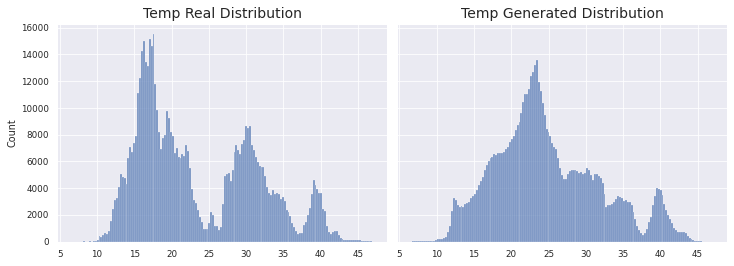

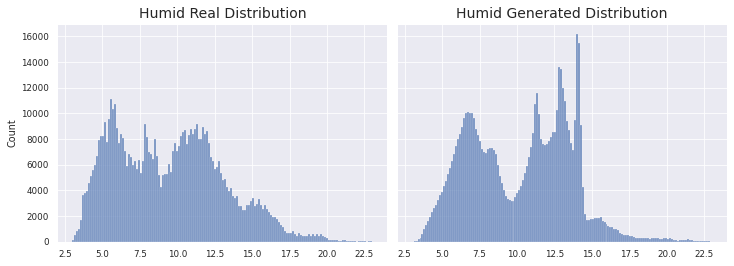

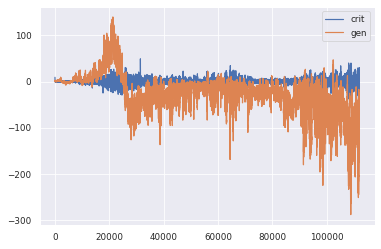

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.1326 - g_loss: -112.6536
Epoch 58/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0834 - g_loss: -111.0657

KL Divergence: 3.9426600064954807 bits
Pinball Loss Temp mean: 1.6199201527834048
Pinball Loss Humid mean: 0.2812195303869018
MSE Temp: 3.239840305566818
MSE Humid: 0.5624390607738035


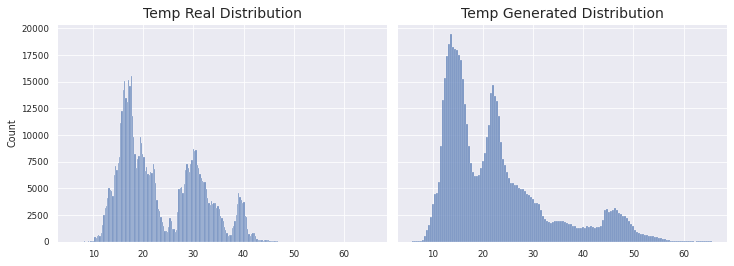

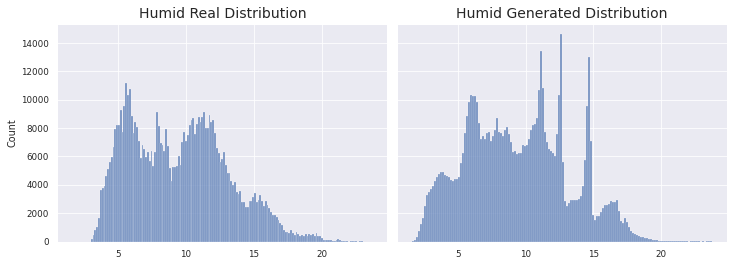

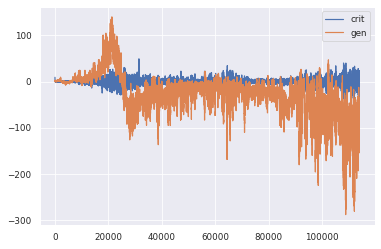

1966/1966 [==============================] - 221s 113ms/step - d_loss: -0.0907 - g_loss: -111.0351
Epoch 59/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0015 - g_loss: -69.5671    

KL Divergence: 6.831963433049725 bits
Pinball Loss Temp mean: 2.861641315895696
Pinball Loss Humid mean: 0.5398192261639405
MSE Temp: 5.723282631791346
MSE Humid: 1.0796384523278806


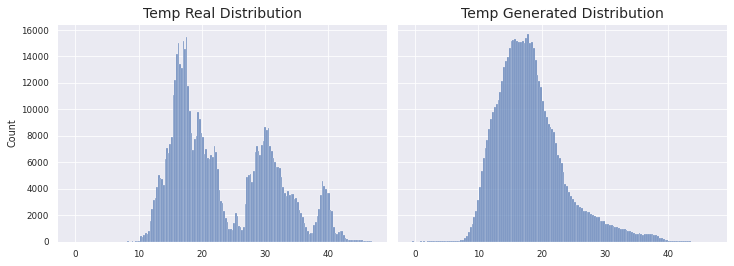

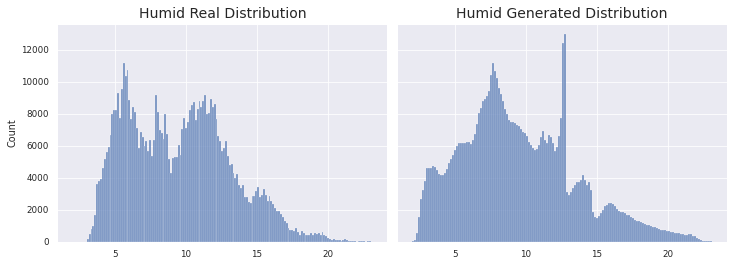

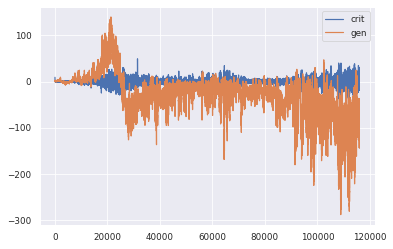

1966/1966 [==============================] - 221s 112ms/step - d_loss: -0.0021 - g_loss: -69.6049
Epoch 60/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0838 - g_loss: -54.3463

KL Divergence: 6.401895159980672 bits
Pinball Loss Temp mean: 1.938837775617823
Pinball Loss Humid mean: 0.43792666892947973
MSE Temp: 3.8776755512356003
MSE Humid: 0.8758533378589691


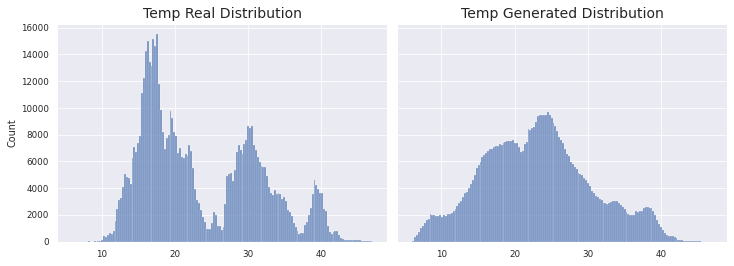

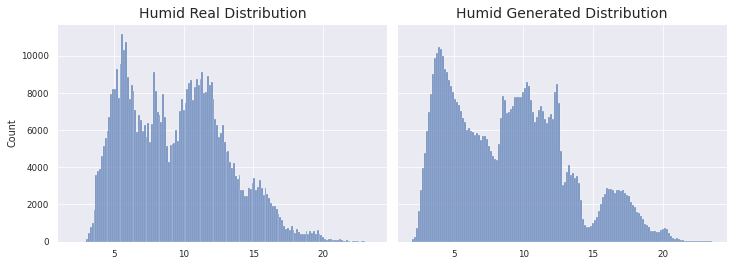

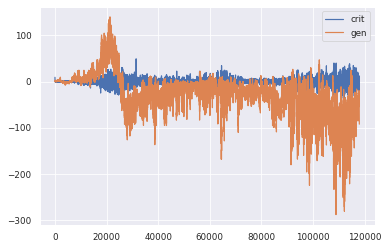

1966/1966 [==============================] - 222s 113ms/step - d_loss: 0.0630 - g_loss: -54.3656
Epoch 61/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0341 - g_loss: -58.8280

KL Divergence: 4.227059015336743 bits
Pinball Loss Temp mean: 1.8704484229901035
Pinball Loss Humid mean: 0.3755667995002127
MSE Temp: 3.7408968459801994
MSE Humid: 0.7511335990004162


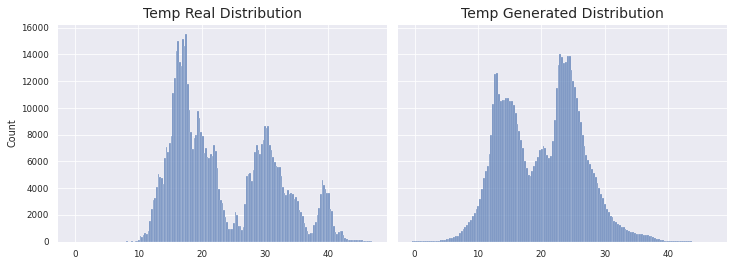

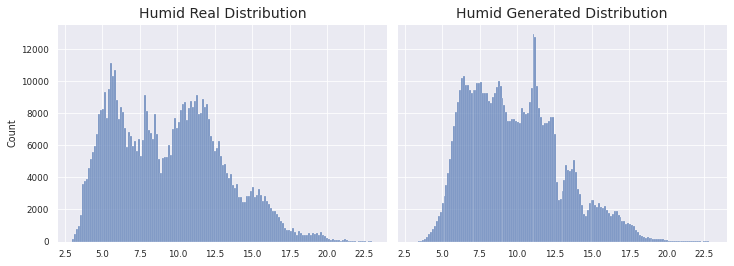

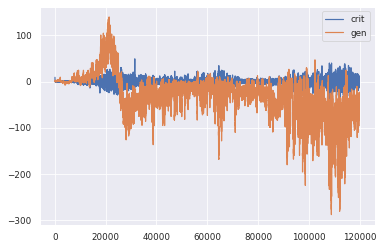

1966/1966 [==============================] - 221s 112ms/step - d_loss: 0.0304 - g_loss: -58.8225
Epoch 62/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0361 - g_loss: -59.3137

KL Divergence: 2.078287712268859 bits
Pinball Loss Temp mean: 0.8822049528938022
Pinball Loss Humid mean: 0.3467144276149702
MSE Temp: 1.7644099057876281
MSE Humid: 0.6934288552299326


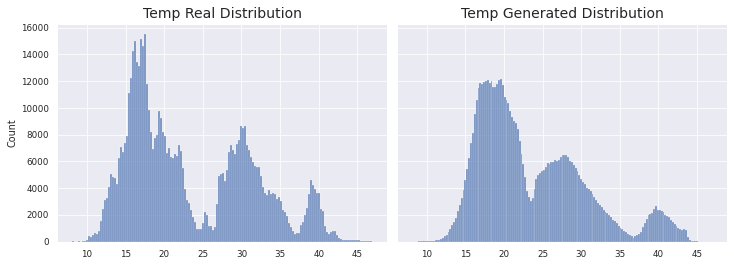

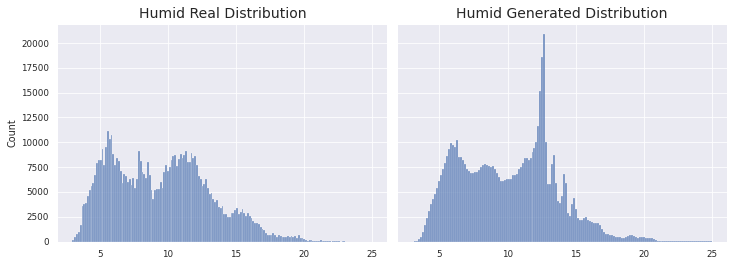

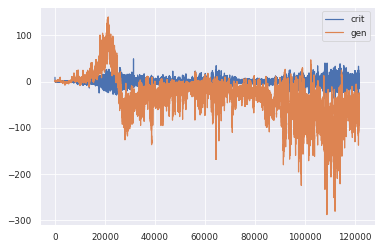

1966/1966 [==============================] - 221s 113ms/step - d_loss: -0.0325 - g_loss: -59.3317
Epoch 63/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1248 - g_loss: -52.9792

KL Divergence: 2.6839505700585735 bits
Pinball Loss Temp mean: 1.283156125970281
Pinball Loss Humid mean: 0.4835677452495962
MSE Temp: 2.5663122519405657
MSE Humid: 0.9671354904992071


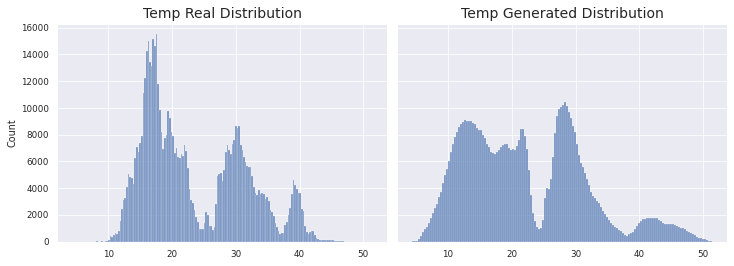

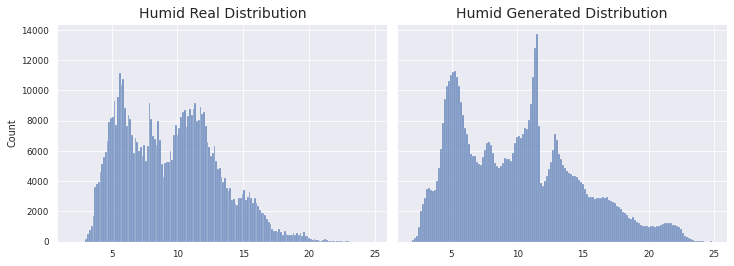

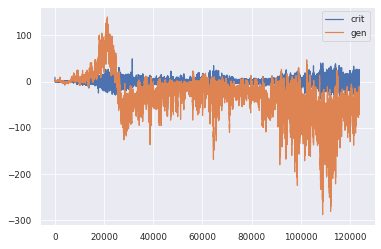

1966/1966 [==============================] - 221s 113ms/step - d_loss: -0.1393 - g_loss: -52.9576
Epoch 64/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0193 - g_loss: -58.2294

KL Divergence: 8.222431661680963 bits
Pinball Loss Temp mean: 1.6257510873565537
Pinball Loss Humid mean: 0.5246751232559594
MSE Temp: 3.2515021747131456
MSE Humid: 1.0493502465119113


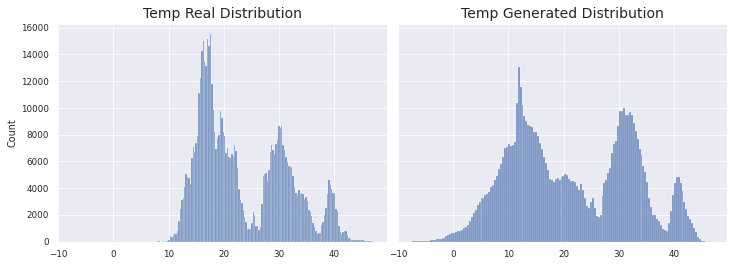

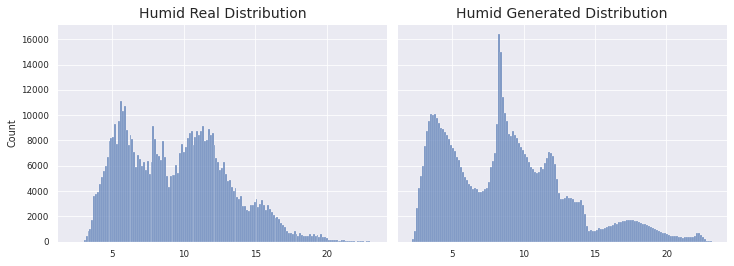

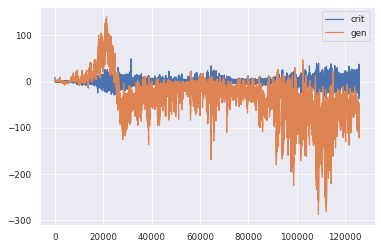

1966/1966 [==============================] - 221s 112ms/step - d_loss: 0.0162 - g_loss: -58.2244
Epoch 65/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3015 - g_loss: -69.7746

KL Divergence: 7.342282203346142 bits
Pinball Loss Temp mean: 1.0790322945295991
Pinball Loss Humid mean: 0.4794375462343833
MSE Temp: 2.158064589059186
MSE Humid: 0.9588750924687615


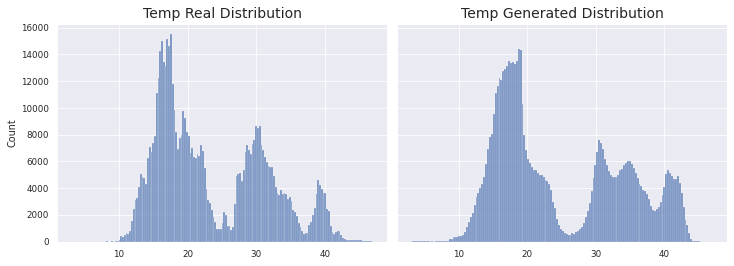

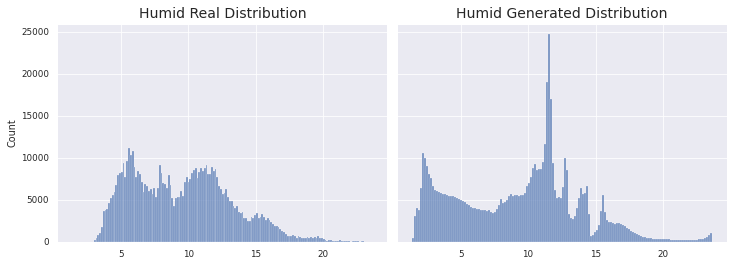

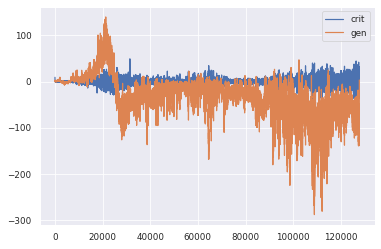

1966/1966 [==============================] - 222s 113ms/step - d_loss: -0.3142 - g_loss: -69.7375
Epoch 66/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4626 - g_loss: -52.5743

KL Divergence: 4.983324671343726 bits
Pinball Loss Temp mean: 1.1788093667225312
Pinball Loss Humid mean: 0.3502643673287049
MSE Temp: 2.357618733445052
MSE Humid: 0.7005287346574154


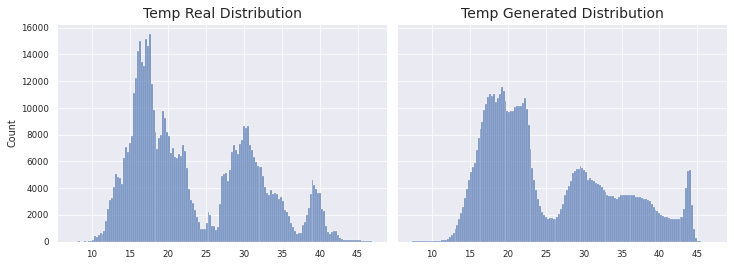

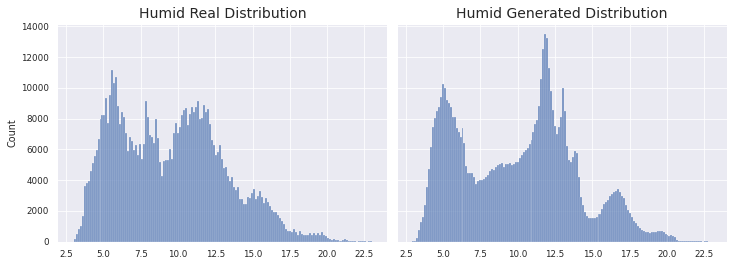

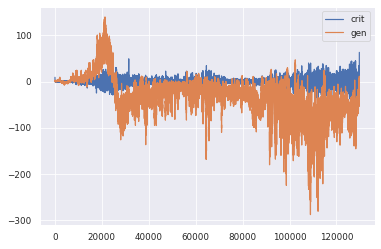

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.4944 - g_loss: -52.5750
Epoch 67/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0388 - g_loss: -15.5541

KL Divergence: 1.9658507138626928 bits
Pinball Loss Temp mean: 0.7980693801738866
Pinball Loss Humid mean: 0.28137968692083115
MSE Temp: 1.5961387603477728
MSE Humid: 0.5627593738416684


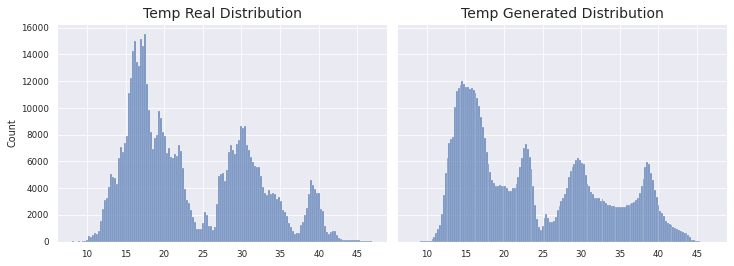

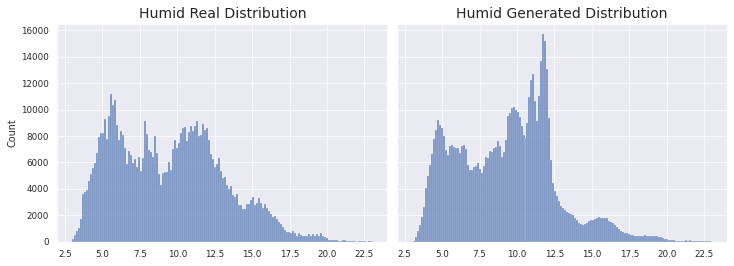

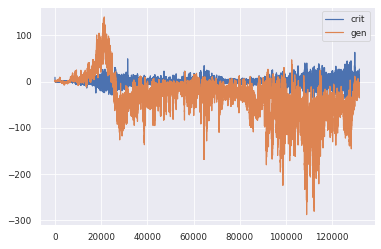

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0525 - g_loss: -15.5641
Epoch 68/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0317 - g_loss: -8.5797

KL Divergence: 3.0839350387279154 bits
Pinball Loss Temp mean: 1.3374143007462718
Pinball Loss Humid mean: 0.5544770676470832
MSE Temp: 2.674828601492482
MSE Humid: 1.1089541352941708


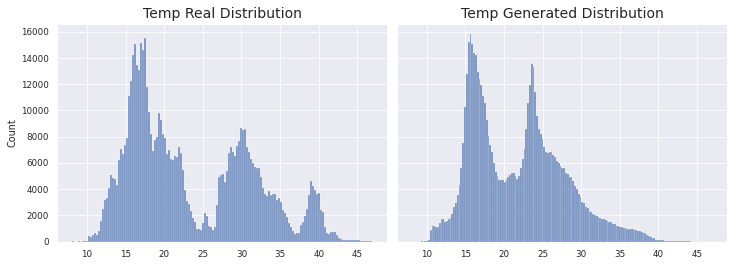

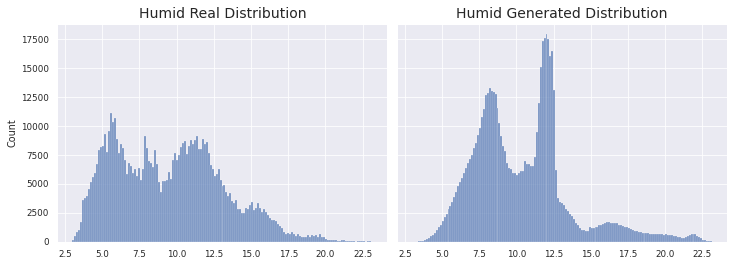

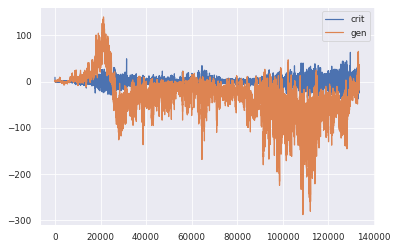

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0193 - g_loss: -8.5728
Epoch 69/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3727 - g_loss: 21.2991

KL Divergence: 4.738840887168628 bits
Pinball Loss Temp mean: 1.4841044149996476
Pinball Loss Humid mean: 0.3882815248524755
MSE Temp: 2.9682088299992704
MSE Humid: 0.776563049704956


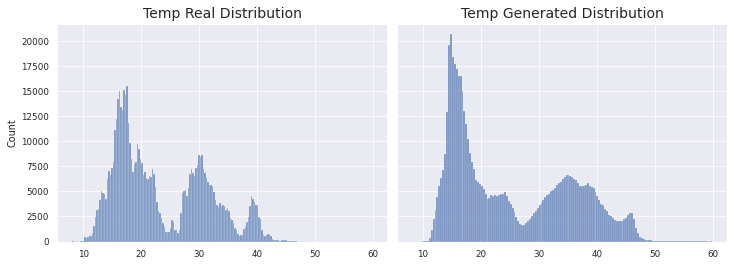

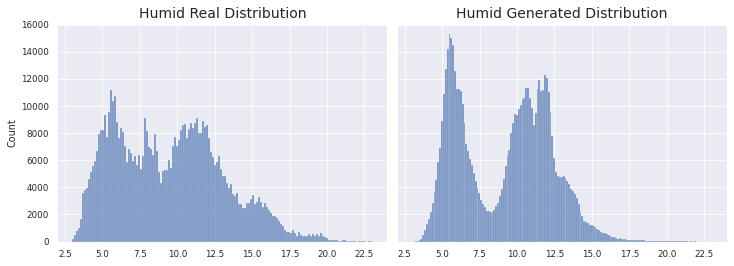

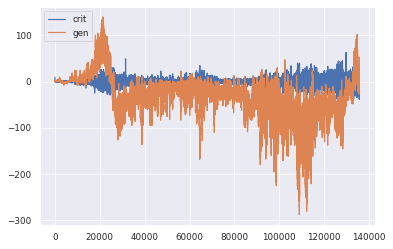

1966/1966 [==============================] - 223s 114ms/step - d_loss: -0.3918 - g_loss: 21.3152
Epoch 70/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0411 - g_loss: 10.6475

KL Divergence: 2.9991230469447454 bits
Pinball Loss Temp mean: 1.4763609243102738
Pinball Loss Humid mean: 0.3581801062973464
MSE Temp: 2.9527218486205498
MSE Humid: 0.7163602125946971


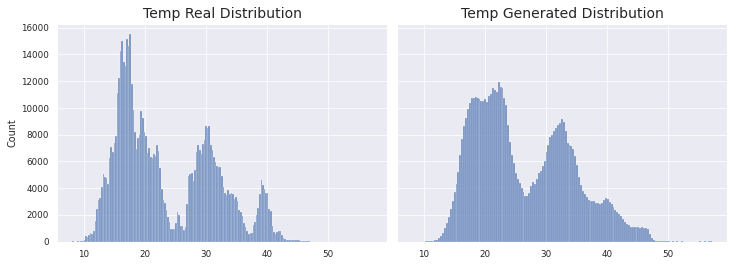

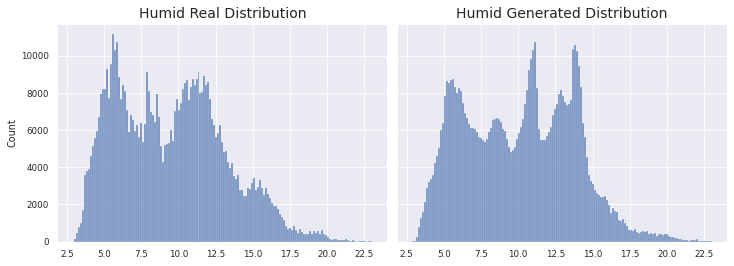

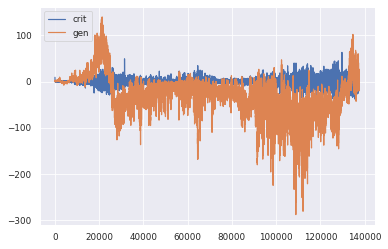

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0386 - g_loss: 10.6486
Epoch 71/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.5250 - g_loss: -31.5229

KL Divergence: 8.530571469505146 bits
Pinball Loss Temp mean: 1.9478605486726273
Pinball Loss Humid mean: 0.8499726509135949
MSE Temp: 3.895721097345236
MSE Humid: 1.6999453018271806


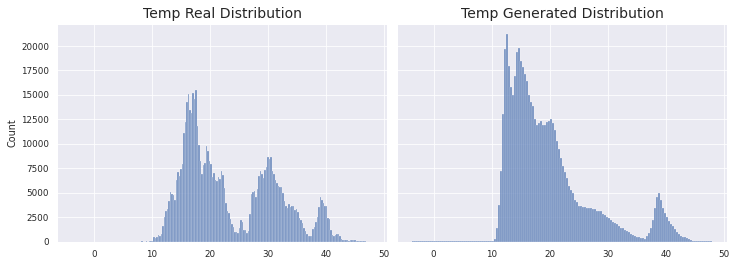

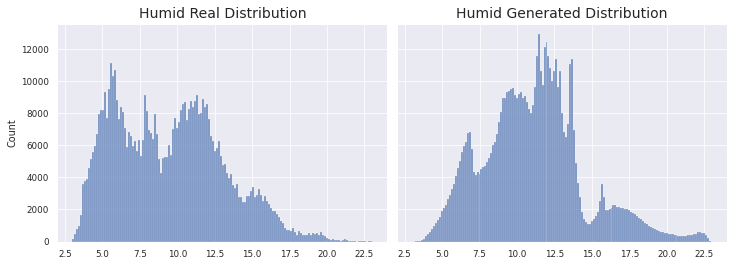

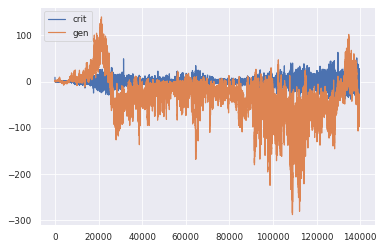

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.5387 - g_loss: -31.5395
Epoch 72/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2573 - g_loss: -105.0133

KL Divergence: 8.936625710152223 bits
Pinball Loss Temp mean: 2.2310942690991467
Pinball Loss Humid mean: 0.769133825228791
MSE Temp: 4.462188538198319
MSE Humid: 1.5382676504575699


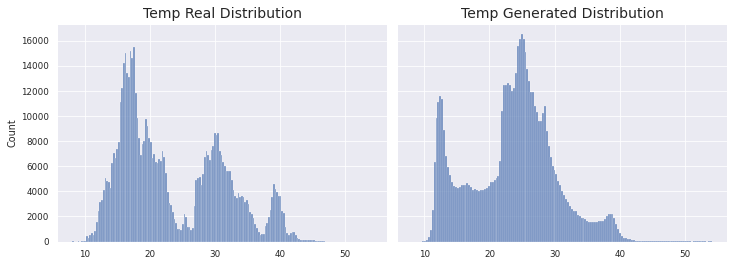

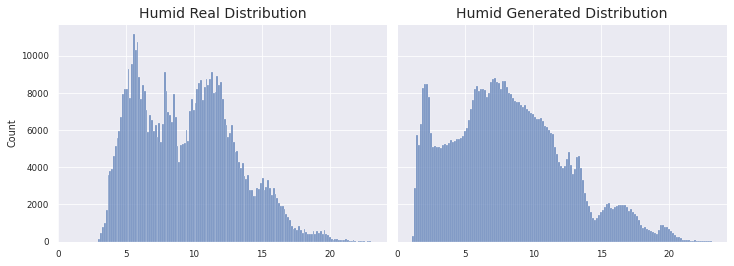

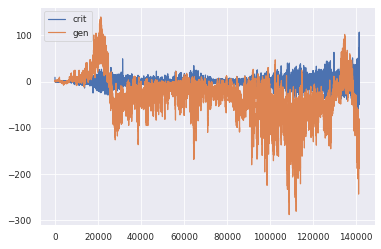

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.3113 - g_loss: -105.0124
Epoch 73/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1288 - g_loss: -90.2259

KL Divergence: 9.116246452484473 bits
Pinball Loss Temp mean: 0.9449812951977219
Pinball Loss Humid mean: 0.48543011364914046
MSE Temp: 1.889962590395453
MSE Humid: 0.9708602272982918


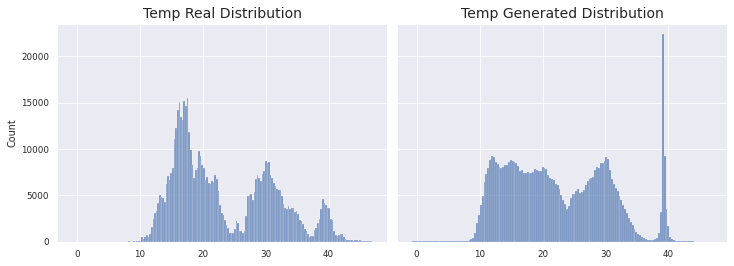

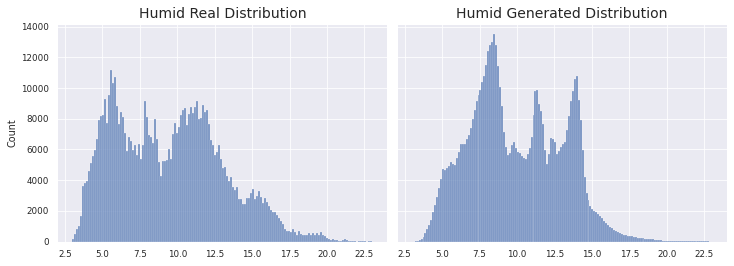

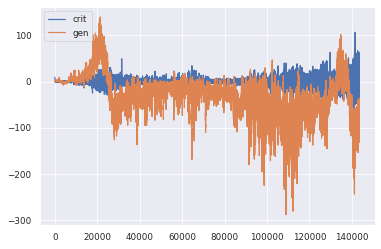

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.1117 - g_loss: -90.2386
Epoch 74/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3526 - g_loss: -154.5123

KL Divergence: 4.43020453292701 bits
Pinball Loss Temp mean: 1.2363573155855117
Pinball Loss Humid mean: 0.6294654339151504
MSE Temp: 2.472714631171008
MSE Humid: 1.2589308678302933


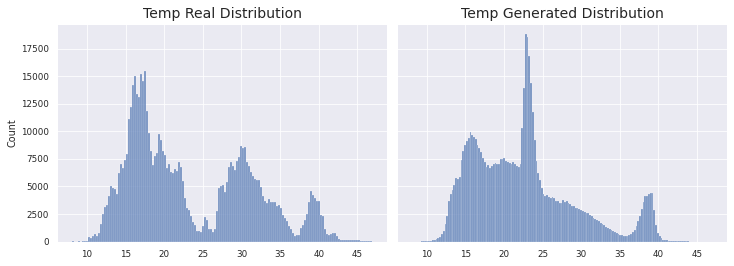

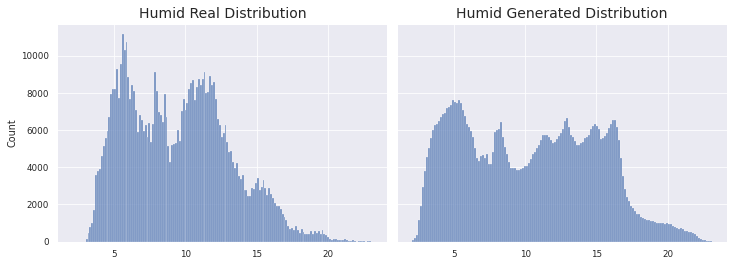

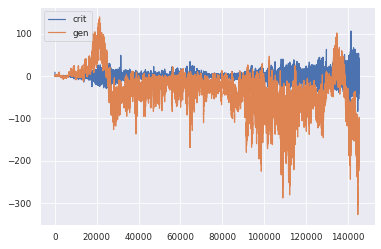

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.3312 - g_loss: -154.5197
Epoch 75/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2064 - g_loss: -192.6789

KL Divergence: 2.8984425752514213 bits
Pinball Loss Temp mean: 1.2988143479739302
Pinball Loss Humid mean: 0.4178787220801935
MSE Temp: 2.5976286959478654
MSE Humid: 0.8357574441603786


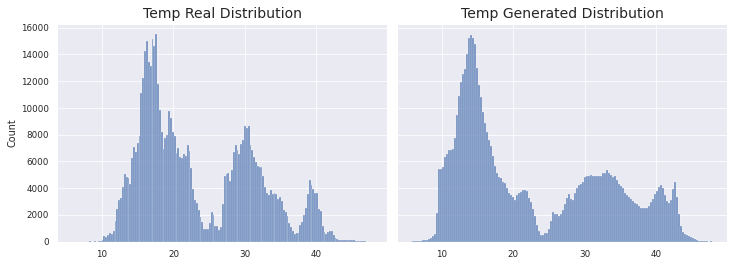

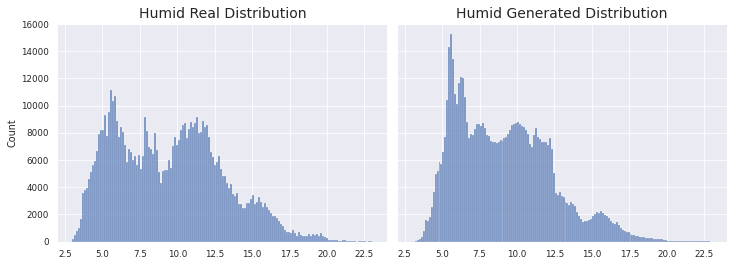

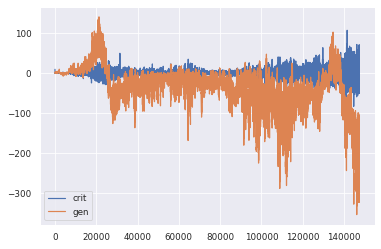

1966/1966 [==============================] - 222s 113ms/step - d_loss: 0.2191 - g_loss: -192.6410
Epoch 76/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4177 - g_loss: -136.5575

KL Divergence: 4.267701378570664 bits
Pinball Loss Temp mean: 1.127026064183582
Pinball Loss Humid mean: 0.3531645512091533
MSE Temp: 2.254052128367187
MSE Humid: 0.7063291024183018


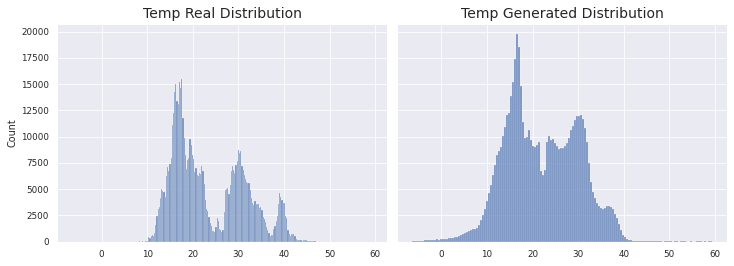

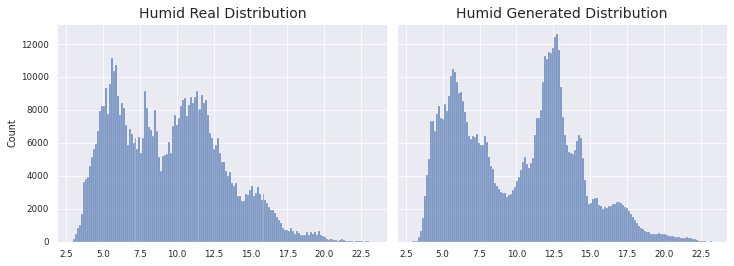

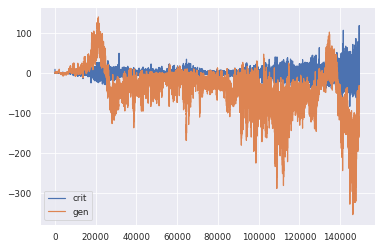

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.4776 - g_loss: -136.5292
Epoch 77/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1253 - g_loss: -49.2653

KL Divergence: 14.861244526859402 bits
Pinball Loss Temp mean: 1.1499513311078204
Pinball Loss Humid mean: 0.4662813781505558
MSE Temp: 2.2999026622156693
MSE Humid: 0.9325627563011086


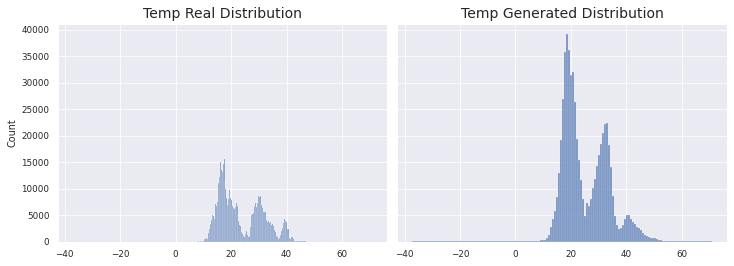

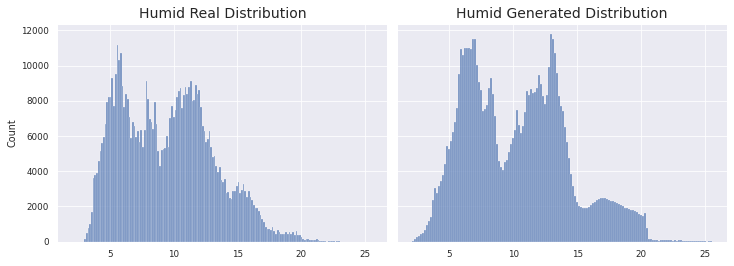

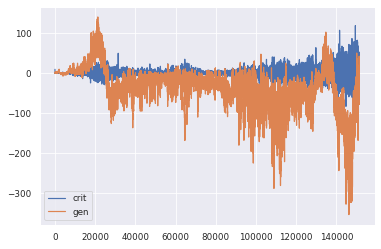

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.1118 - g_loss: -49.2801
Epoch 78/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1429 - g_loss: 16.2170

KL Divergence: 9.085071523893834 bits
Pinball Loss Temp mean: 1.0220135144902052
Pinball Loss Humid mean: 0.8794443320043628
MSE Temp: 2.044027028980405
MSE Humid: 1.7588886640087673


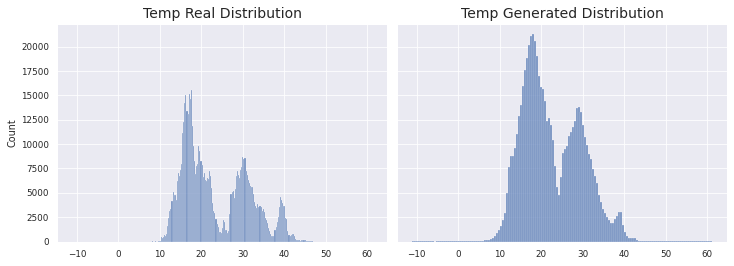

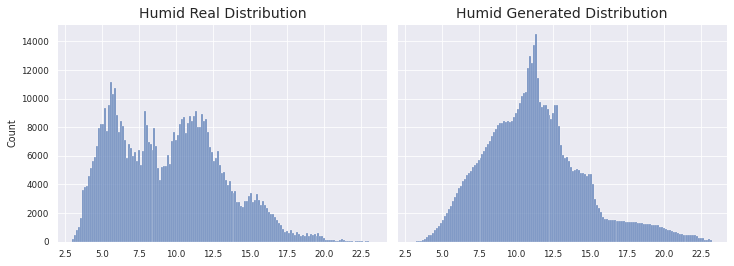

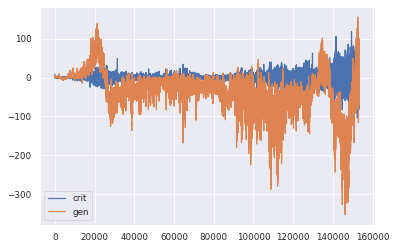

1966/1966 [==============================] - 223s 114ms/step - d_loss: -0.1553 - g_loss: 16.1739
Epoch 79/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.5757 - g_loss: 2.6044

KL Divergence: 16.477219524515935 bits
Pinball Loss Temp mean: 1.4858754855922551
Pinball Loss Humid mean: 0.5474052031940448
MSE Temp: 2.971750971184514
MSE Humid: 1.0948104063881072


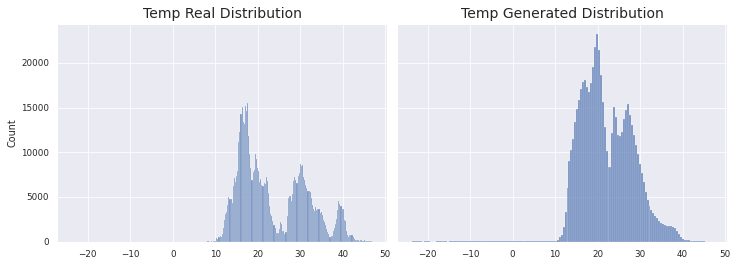

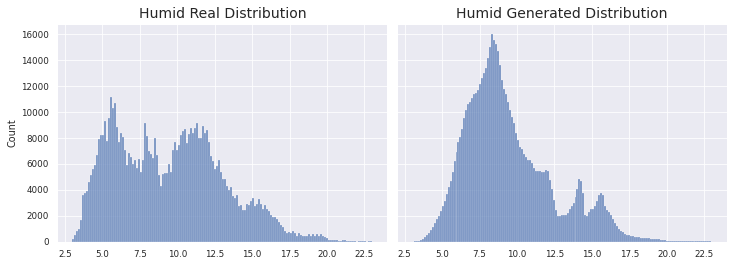

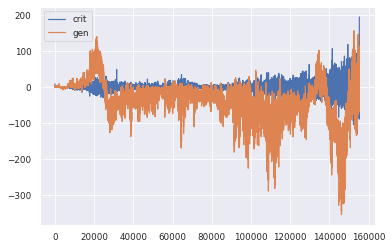

1966/1966 [==============================] - 222s 113ms/step - d_loss: -0.4765 - g_loss: 2.6304
Epoch 80/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4358 - g_loss: 34.1943

KL Divergence: 10.420422580247589 bits
Pinball Loss Temp mean: 1.6870026325874474
Pinball Loss Humid mean: 0.44209754061133877
MSE Temp: 3.37400526517483
MSE Humid: 0.8841950812226796


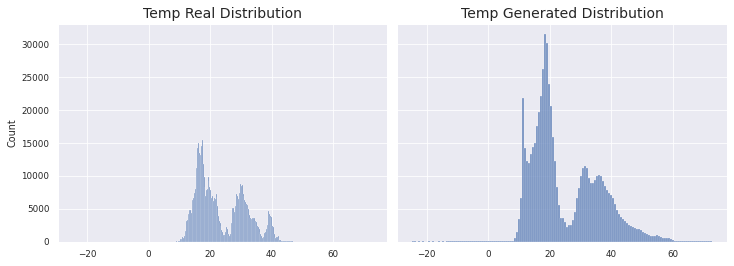

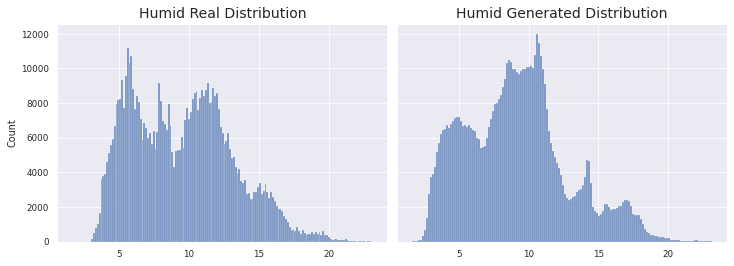

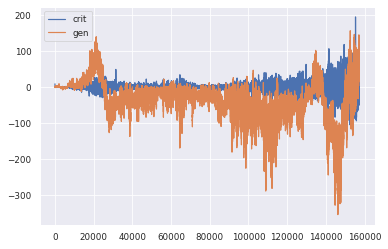

1966/1966 [==============================] - 222s 113ms/step - d_loss: 0.4494 - g_loss: 34.1911
Epoch 81/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.6137 - g_loss: 84.2338

KL Divergence: 14.510125056750613 bits
Pinball Loss Temp mean: 0.7937798179571521
Pinball Loss Humid mean: 0.3694550594559218
MSE Temp: 1.5875596359143165
MSE Humid: 0.7389101189118424


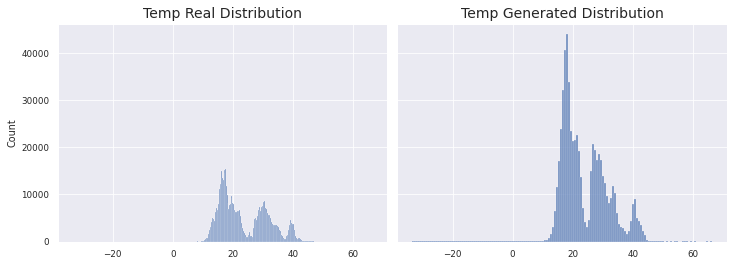

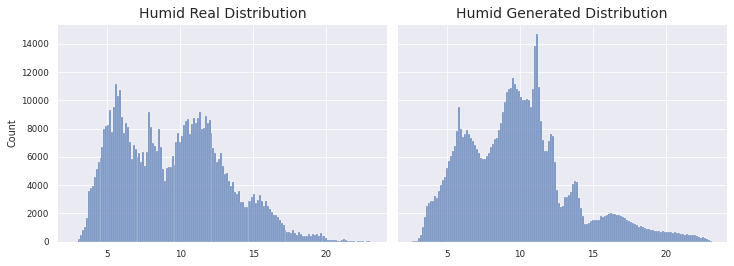

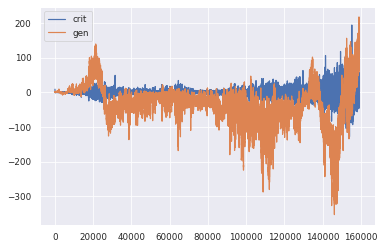

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.6364 - g_loss: 84.2235
Epoch 82/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2440 - g_loss: 106.8311

KL Divergence: 12.286712424784714 bits
Pinball Loss Temp mean: 3.140268808821729
Pinball Loss Humid mean: 0.5160441490658295
MSE Temp: 6.280537617643439
MSE Humid: 1.0320882981316866


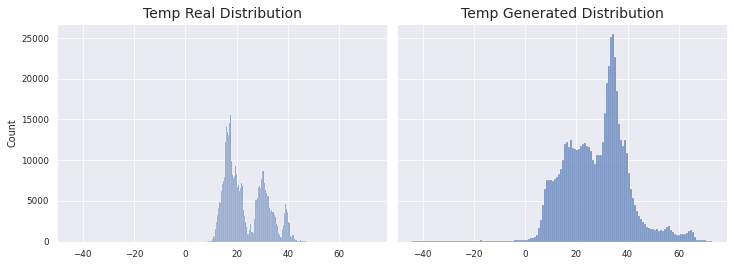

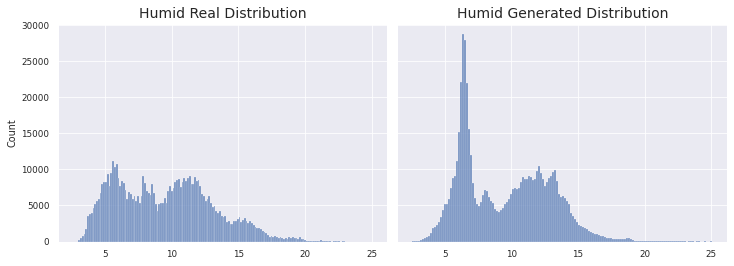

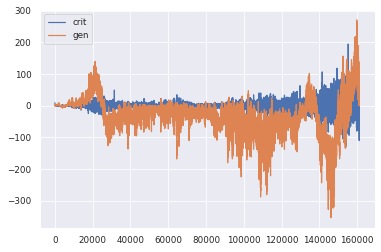

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.1879 - g_loss: 106.8250
Epoch 83/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.8434 - g_loss: 101.4921

KL Divergence: 9.993550283038653 bits
Pinball Loss Temp mean: 1.5242715350139406
Pinball Loss Humid mean: 0.6925359885096973
MSE Temp: 3.048543070027864
MSE Humid: 1.3850719770193898


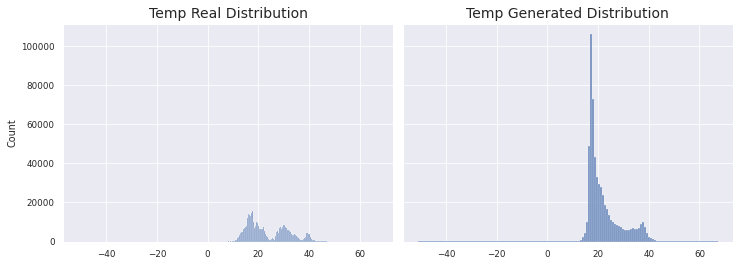

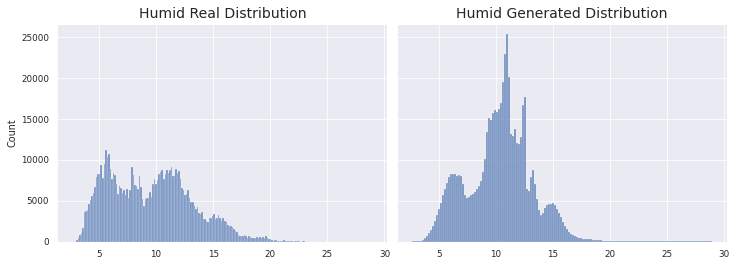

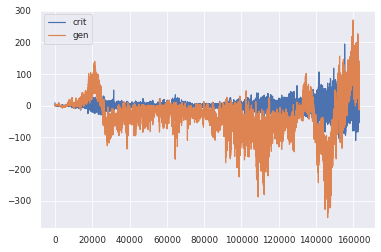

1966/1966 [==============================] - 223s 113ms/step - d_loss: 0.8156 - g_loss: 101.5123
Epoch 84/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3270 - g_loss: 61.6044

KL Divergence: 12.280069808410701 bits
Pinball Loss Temp mean: 1.1048821204566575
Pinball Loss Humid mean: 0.5168742931039504
MSE Temp: 2.209764240913326
MSE Humid: 1.033748586207902


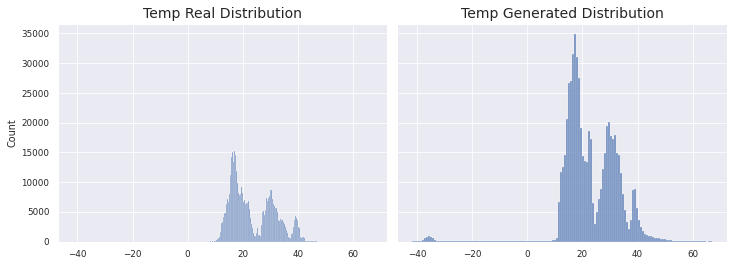

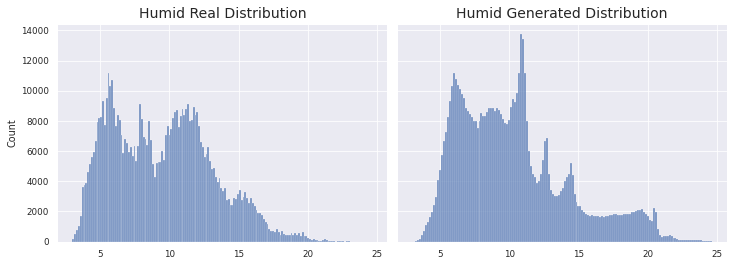

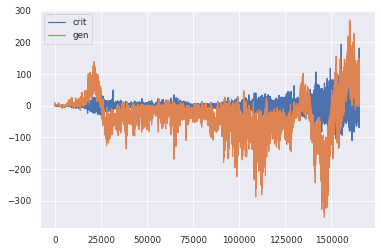

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.4190 - g_loss: 61.6485
Epoch 85/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1069 - g_loss: 84.3254

KL Divergence: 15.382709983905958 bits
Pinball Loss Temp mean: 1.4231386764527532
Pinball Loss Humid mean: 0.37150552384532387
MSE Temp: 2.8462773529055583
MSE Humid: 0.7430110476906446


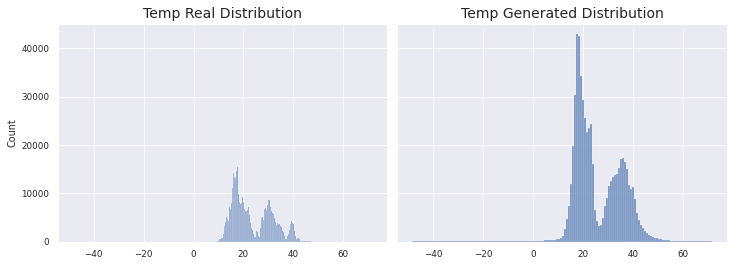

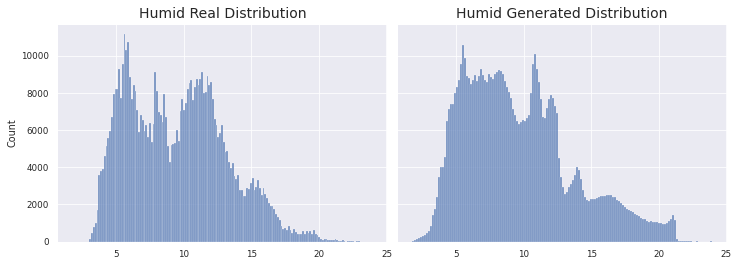

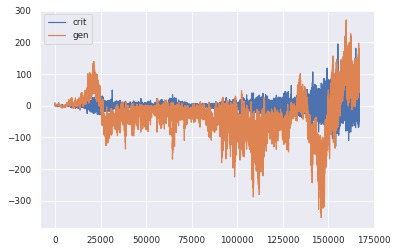

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.1227 - g_loss: 84.3594
Epoch 86/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0293 - g_loss: 92.9475

KL Divergence: 14.77163989333337 bits
Pinball Loss Temp mean: 1.3603121967152056
Pinball Loss Humid mean: 0.37170698958174087
MSE Temp: 2.7206243934303984
MSE Humid: 0.7434139791634714


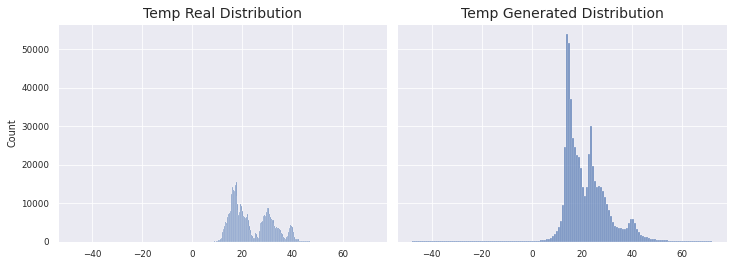

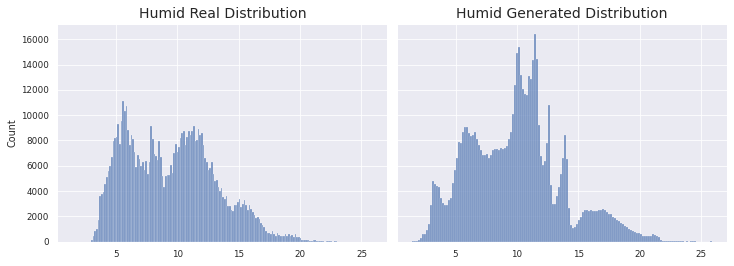

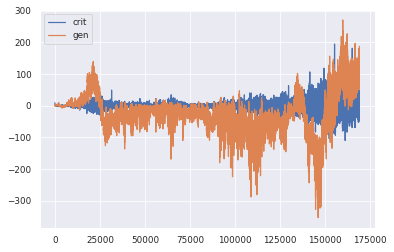

1966/1966 [==============================] - 223s 114ms/step - d_loss: 0.0156 - g_loss: 92.9957
Epoch 87/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4957 - g_loss: 154.6753

KL Divergence: 6.425024647486421 bits
Pinball Loss Temp mean: 3.381872954335143
Pinball Loss Humid mean: 0.4756554242398178
MSE Temp: 6.76374590867046
MSE Humid: 0.9513108484796232


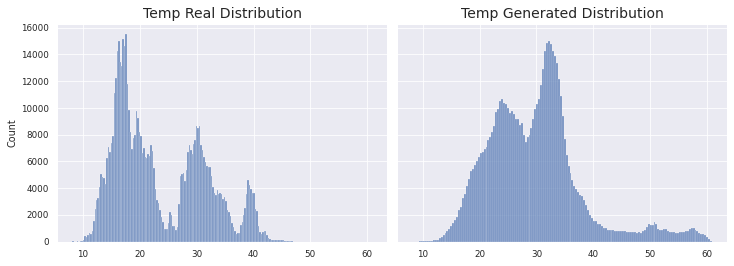

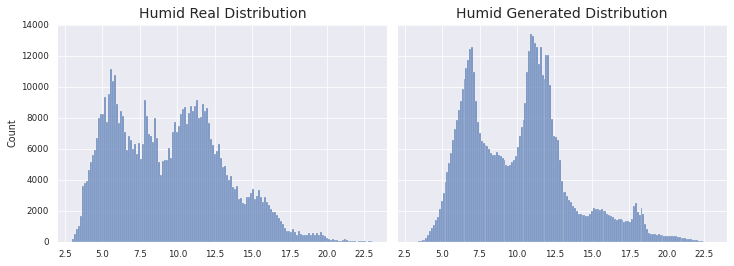

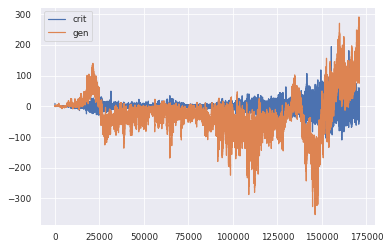

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.4834 - g_loss: 154.6758
Epoch 88/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3012 - g_loss: 112.7755

KL Divergence: 12.599451888590586 bits
Pinball Loss Temp mean: 1.6572697787976831
Pinball Loss Humid mean: 0.6184721215068905
MSE Temp: 3.3145395575953587
MSE Humid: 1.2369442430138105


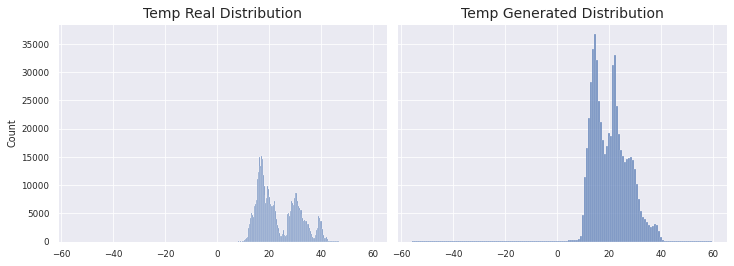

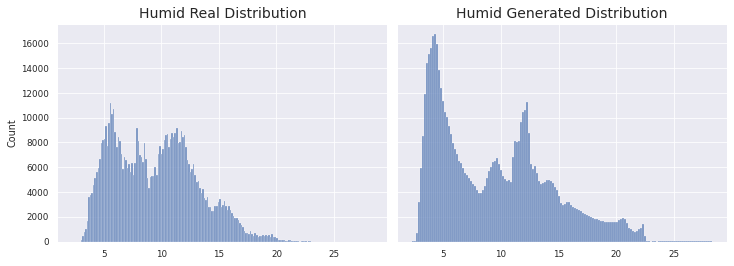

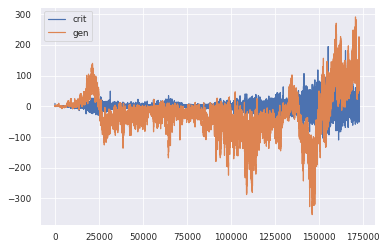

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.2971 - g_loss: 112.7554
Epoch 89/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0796 - g_loss: 118.1441

KL Divergence: 14.814941699724855 bits
Pinball Loss Temp mean: 1.5215602350102593
Pinball Loss Humid mean: 0.6548212786981542
MSE Temp: 3.0431204700204817
MSE Humid: 1.309642557396312


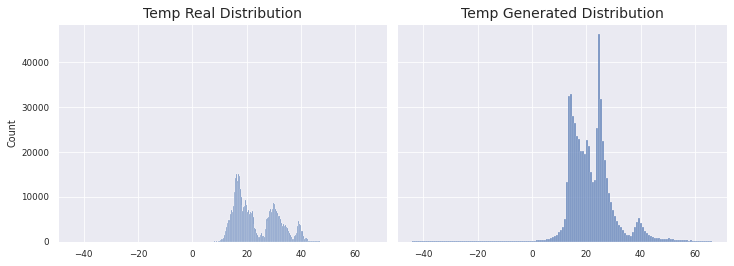

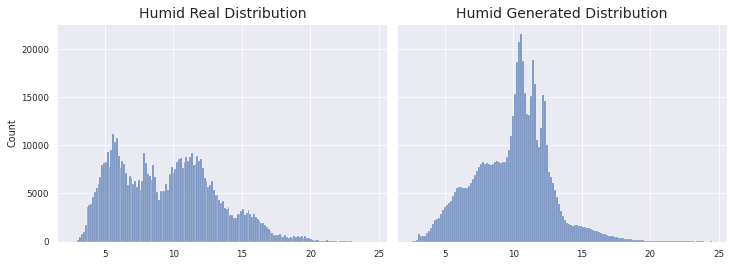

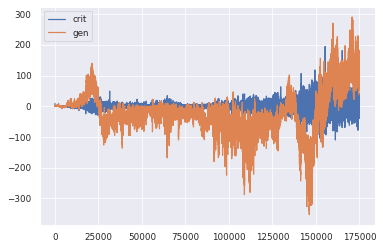

1966/1966 [==============================] - 225s 114ms/step - d_loss: -0.0614 - g_loss: 118.1526
Epoch 90/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0245 - g_loss: 179.5896

KL Divergence: 15.656974167311052 bits
Pinball Loss Temp mean: 2.1822714750722363
Pinball Loss Humid mean: 0.46229231147199706
MSE Temp: 4.36454295014453
MSE Humid: 0.9245846229439945


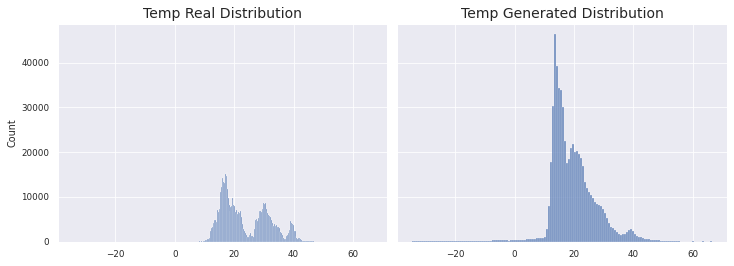

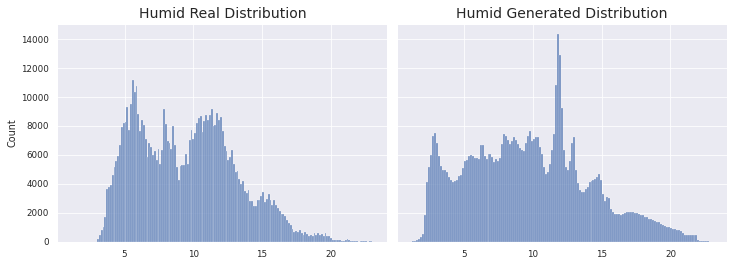

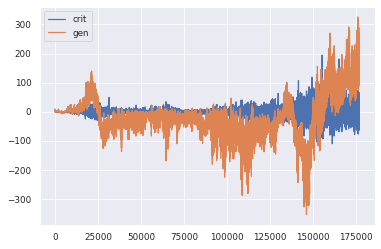

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.0145 - g_loss: 179.5836
Epoch 91/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3729 - g_loss: 159.9137

KL Divergence: 2.078605448450367 bits
Pinball Loss Temp mean: 1.8830032642711594
Pinball Loss Humid mean: 0.3982491978531923
MSE Temp: 3.7660065285422903
MSE Humid: 0.7964983957063827


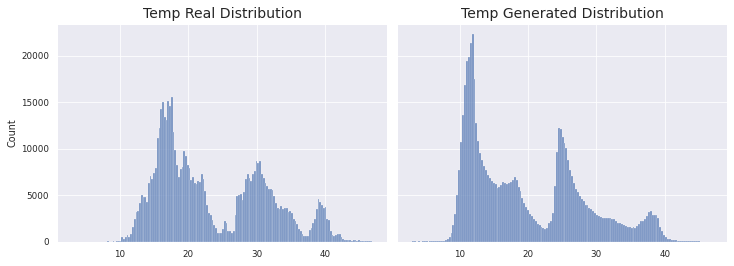

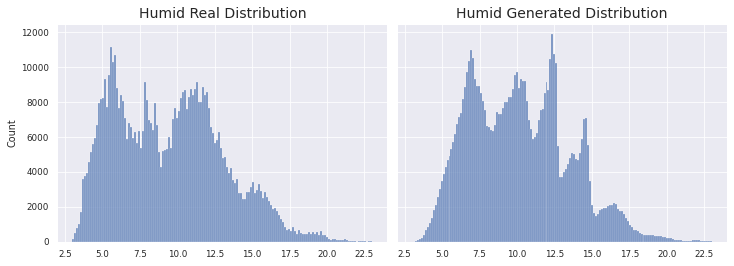

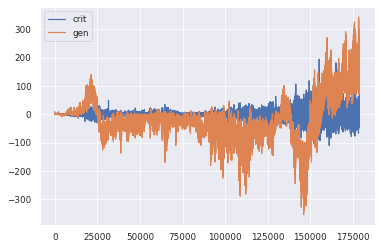

1966/1966 [==============================] - 224s 114ms/step - d_loss: -0.3313 - g_loss: 159.8839
Epoch 92/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4766 - g_loss: 112.3829

KL Divergence: 22.999540608435353 bits
Pinball Loss Temp mean: 1.2941414702332366
Pinball Loss Humid mean: 0.5248893152213878
MSE Temp: 2.5882829404664642
MSE Humid: 1.0497786304427765


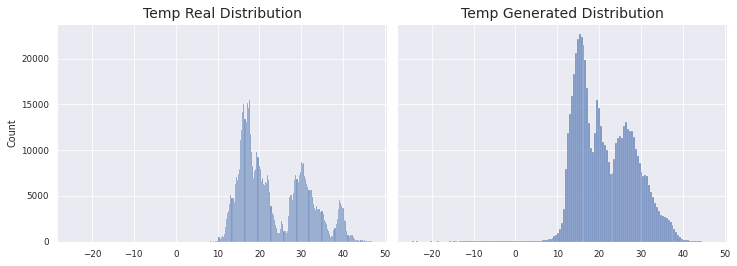

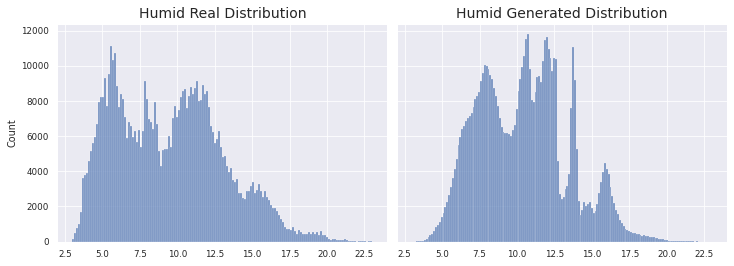

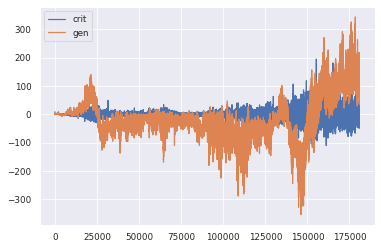

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.4990 - g_loss: 112.3440
Epoch 93/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1944 - g_loss: 114.7491

KL Divergence: 3.2247906527231693 bits
Pinball Loss Temp mean: 0.8063681692689567
Pinball Loss Humid mean: 0.4140152555294895
MSE Temp: 1.61273633853788
MSE Humid: 0.8280305110589922


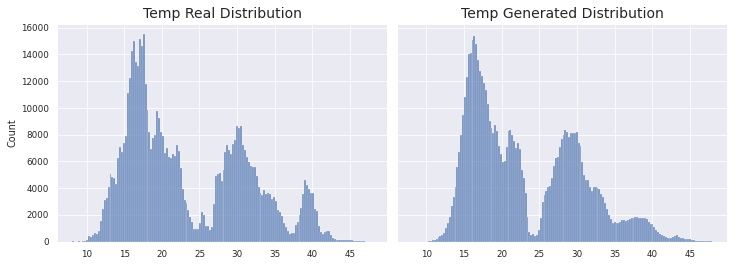

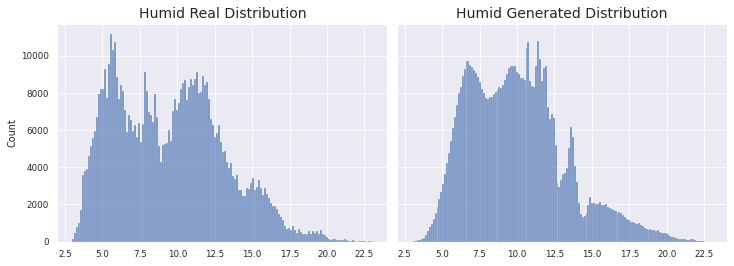

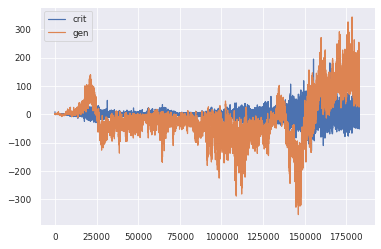

1966/1966 [==============================] - 223s 113ms/step - d_loss: -0.2013 - g_loss: 114.7259
Epoch 94/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1141 - g_loss: 106.5051

KL Divergence: 13.523681640086249 bits
Pinball Loss Temp mean: 2.0436586827909142
Pinball Loss Humid mean: 0.692753772857081
MSE Temp: 4.087317365581903
MSE Humid: 1.3855075457141481


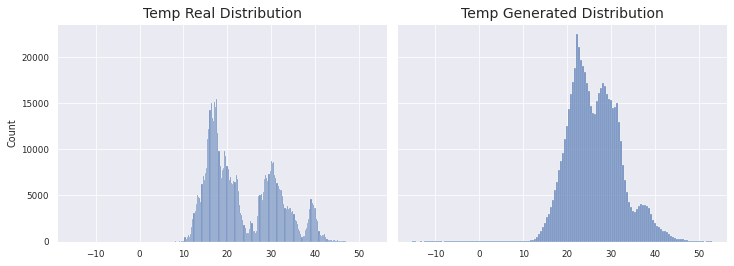

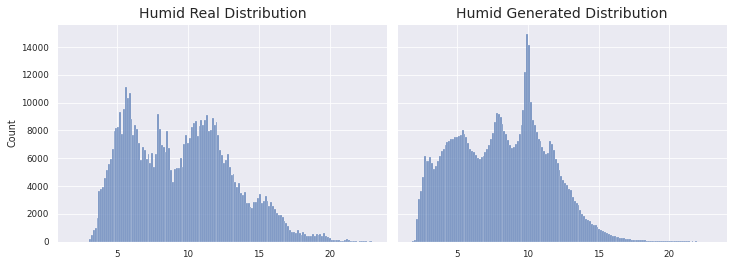

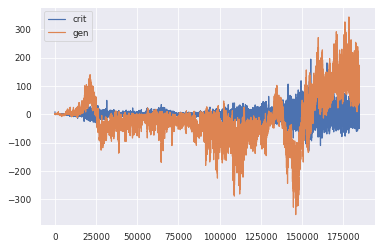

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.1148 - g_loss: 106.5298
Epoch 95/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3786 - g_loss: 189.8222

KL Divergence: 22.872860957817853 bits
Pinball Loss Temp mean: 1.6412322518538018
Pinball Loss Humid mean: 1.1882114730019293
MSE Temp: 3.2824645037076454
MSE Humid: 2.3764229460038817


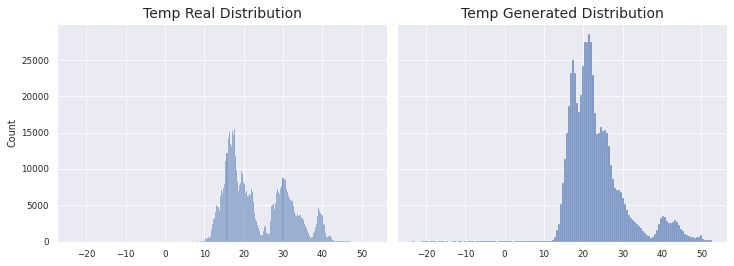

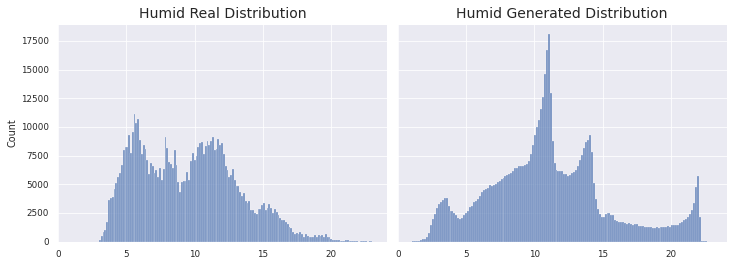

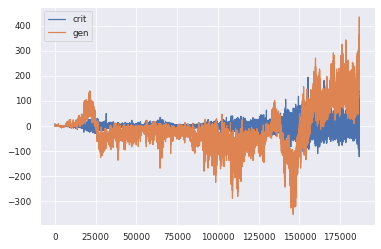

1966/1966 [==============================] - 225s 114ms/step - d_loss: -0.2816 - g_loss: 189.8525
Epoch 96/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.4011 - g_loss: 323.8550

KL Divergence: 8.10403164750333 bits
Pinball Loss Temp mean: 1.326016619793915
Pinball Loss Humid mean: 0.5863122397715788
MSE Temp: 2.6520332395878183
MSE Humid: 1.172624479543162


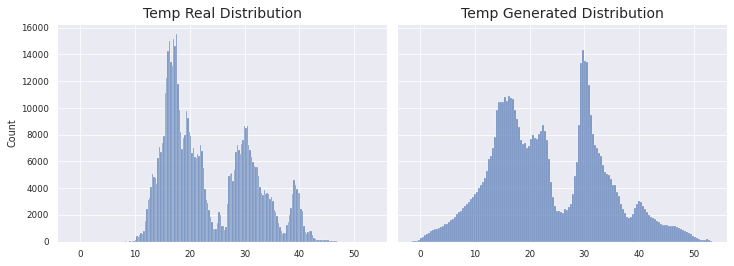

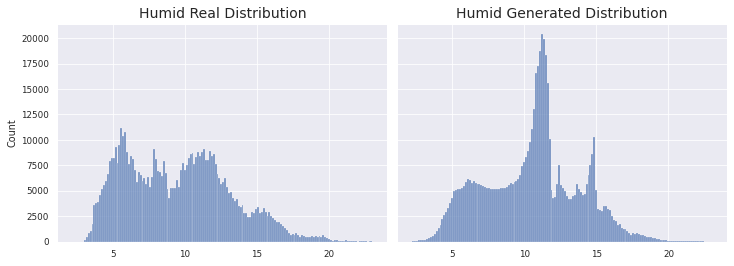

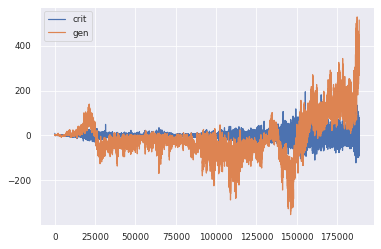

1966/1966 [==============================] - 226s 115ms/step - d_loss: -0.3966 - g_loss: 323.9520
Epoch 97/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3260 - g_loss: 368.4848

KL Divergence: 6.20489275370029 bits
Pinball Loss Temp mean: 1.0005589905418197
Pinball Loss Humid mean: 0.5958537476951105
MSE Temp: 2.001117981083579
MSE Humid: 1.1917074953902291


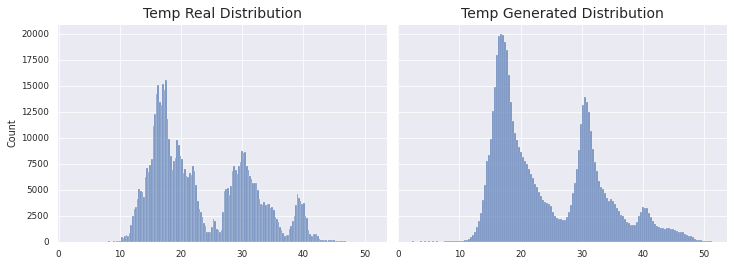

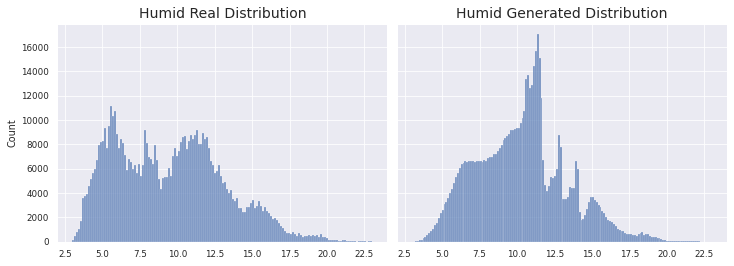

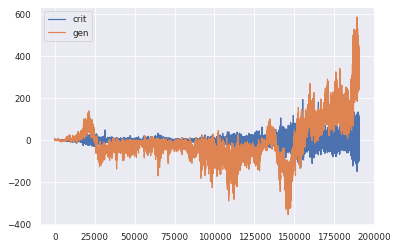

1966/1966 [==============================] - 225s 115ms/step - d_loss: 0.3516 - g_loss: 368.4695
Epoch 98/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3622 - g_loss: 258.8415

KL Divergence: 5.204561502586934 bits
Pinball Loss Temp mean: 1.2877659774965555
Pinball Loss Humid mean: 0.3431332312671518
MSE Temp: 2.575531954993114
MSE Humid: 0.6862664625343018


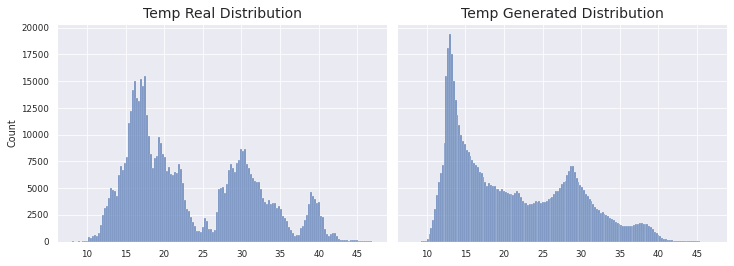

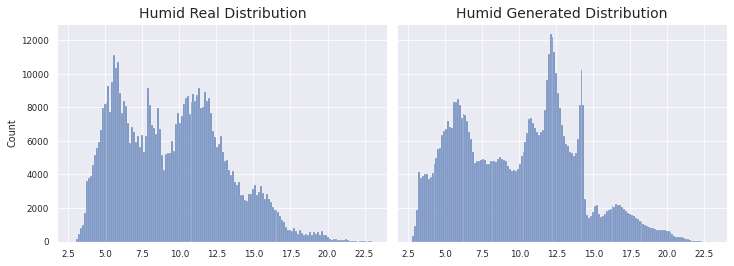

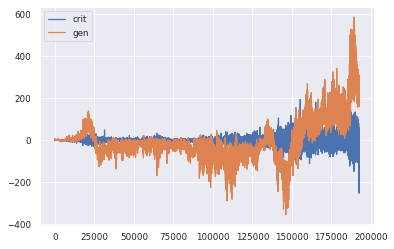

1966/1966 [==============================] - 226s 115ms/step - d_loss: 0.2347 - g_loss: 258.8490
Epoch 99/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3972 - g_loss: 184.0321

KL Divergence: 14.783944693244427 bits
Pinball Loss Temp mean: 1.5957874694777359
Pinball Loss Humid mean: 0.2979427396133292
MSE Temp: 3.191574938955505
MSE Humid: 0.595885479226657


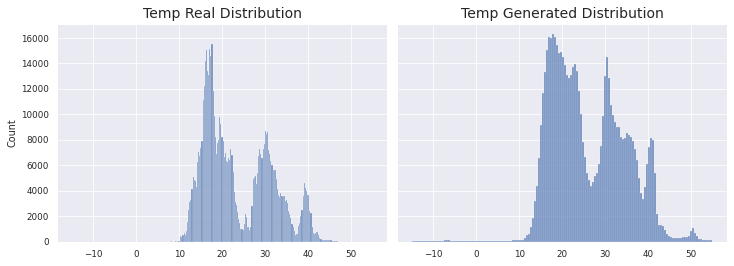

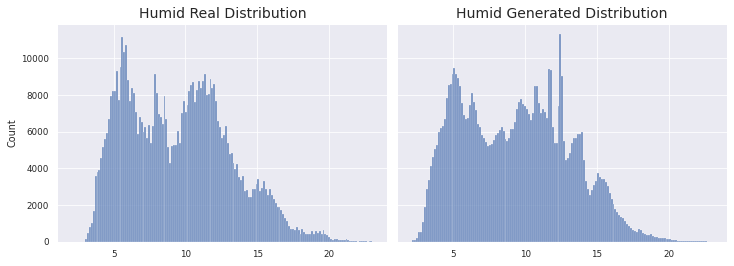

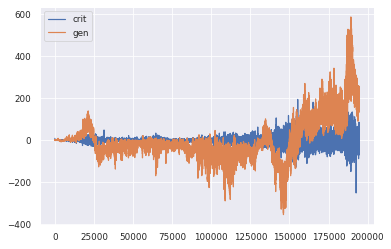

1966/1966 [==============================] - 224s 114ms/step - d_loss: 0.3881 - g_loss: 184.0360
Epoch 100/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0452 - g_loss: 150.0646

KL Divergence: 16.190498286055465 bits
Pinball Loss Temp mean: 2.0737973731612724
Pinball Loss Humid mean: 0.627389674744965
MSE Temp: 4.147594746322528
MSE Humid: 1.2547793494899173


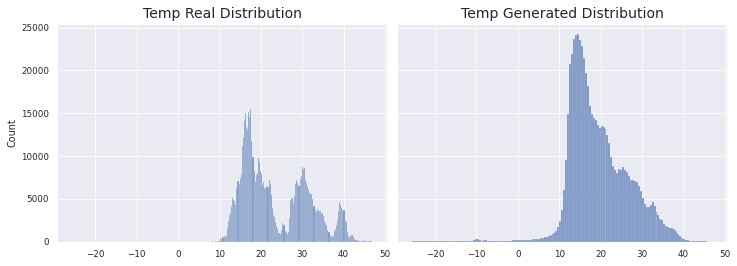

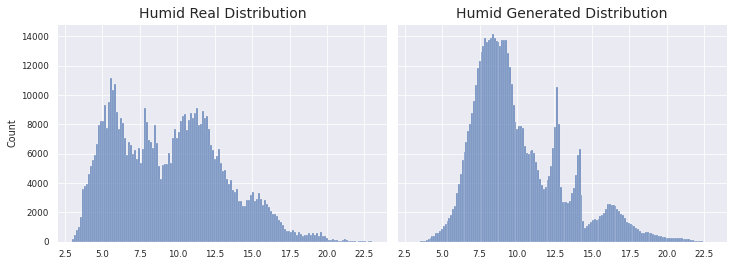

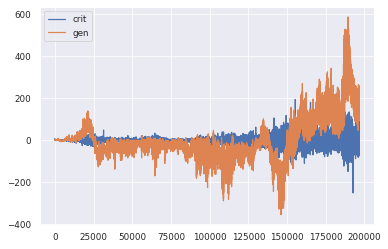

1966/1966 [==============================] - 225s 114ms/step - d_loss: -0.0716 - g_loss: 150.0360
Epoch 101/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0102 - g_loss: 135.5932
Better Pinball
Better MSE
>101 MODELS HAVE BEEN SAVED


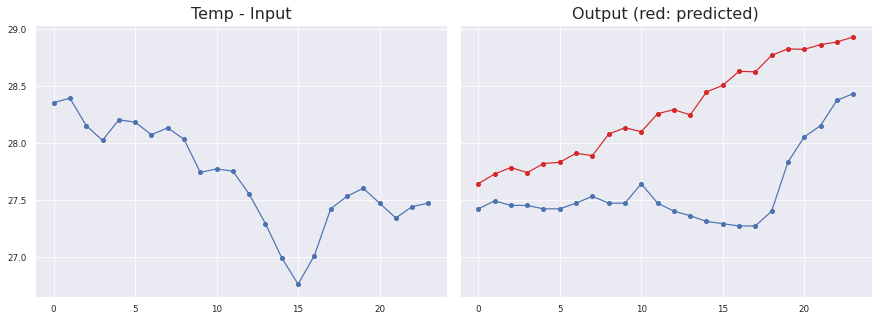

Sensor #12.0
Temp
MAE: 0.7018878804643944 ± 0.36372289000420255
MSE: 0.6249409374558091
RMSE: 0.7905320597267445
Max Error: 1.3653210991621023


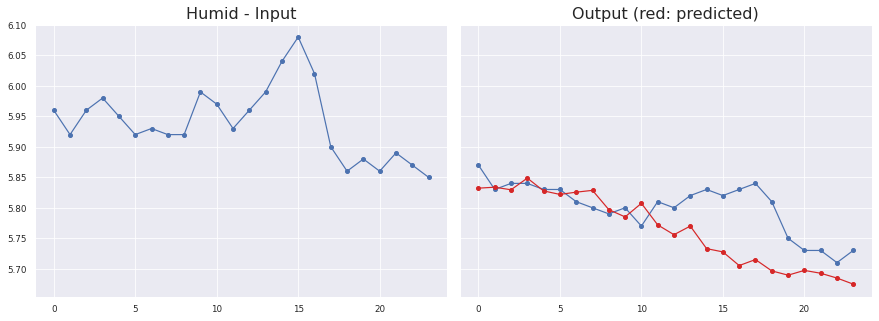

Sensor #12.0
Humid
MAE: 0.04461201901237181 ± 0.04596079837079391
MSE: 0.003423759406210538
RMSE: 0.05851289948558812
Max Error: 0.12494738340377776


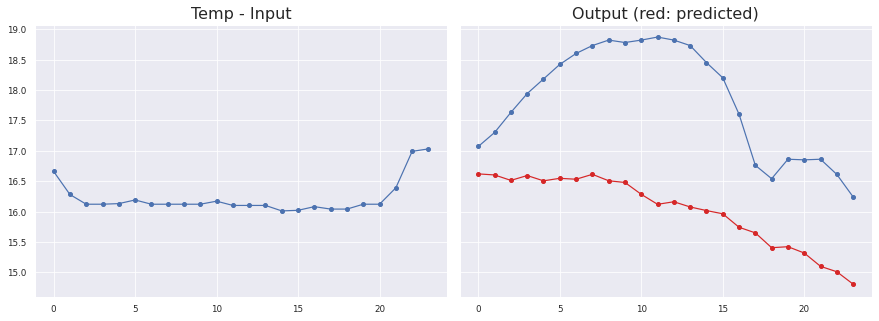

Sensor #28.0
Temp
MAE: 1.7966002377867702 ± 0.6198645821729173
MSE: 3.6120045146478836
RMSE: 1.9005274306486302
Max Error: 2.75141591310501


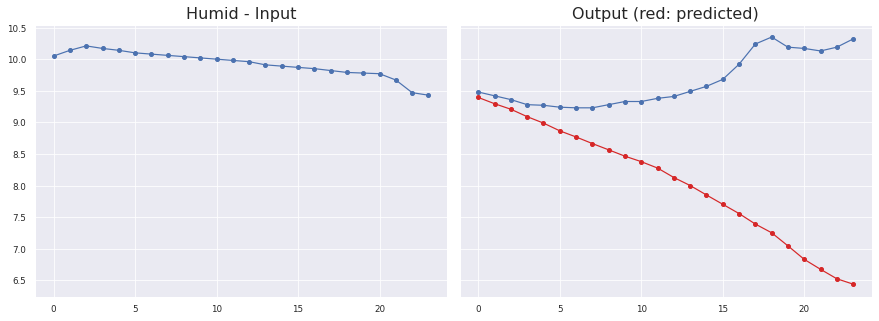

Sensor #28.0
Humid
MAE: 1.5890231218871964 ± 1.276646277175588
MSE: 4.15482019891842
RMSE: 2.0383376067075885
Max Error: 3.8805457389354707


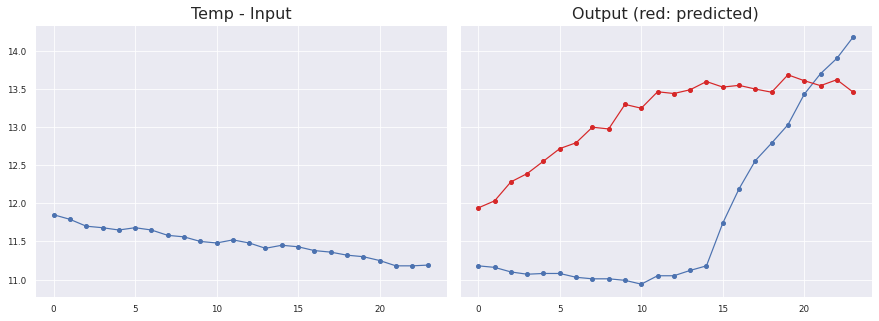

Sensor #17.0
Temp
MAE: 1.412451749940714 ± 0.9072065948039749
MSE: 2.5545857443627322
RMSE: 1.5983071495687968
Max Error: 2.4166512465476995


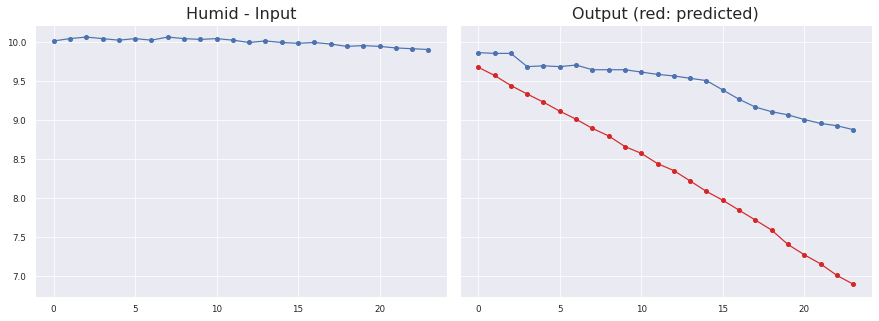

Sensor #17.0
Humid
MAE: 1.1108578890065344 ± 0.5373631614814157
MSE: 1.522764416885356
RMSE: 1.2340034104026438
Max Error: 1.9866023224592215


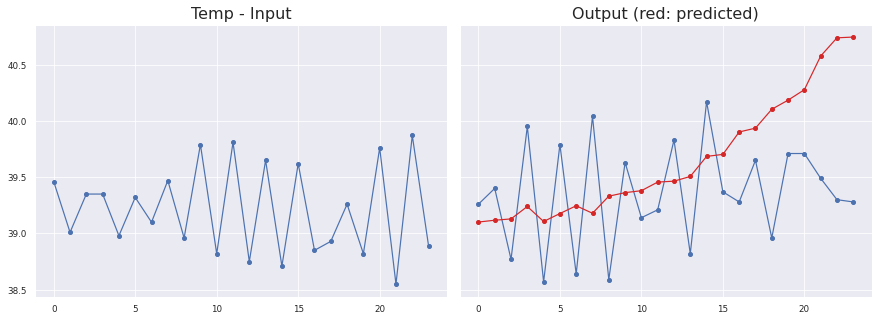

Sensor #33.0
Temp
MAE: 0.6070172270139048 ± 0.6396046735707713
MSE: 0.49614084577424683
RMSE: 0.7043726611490873
Max Error: 1.4641739821434


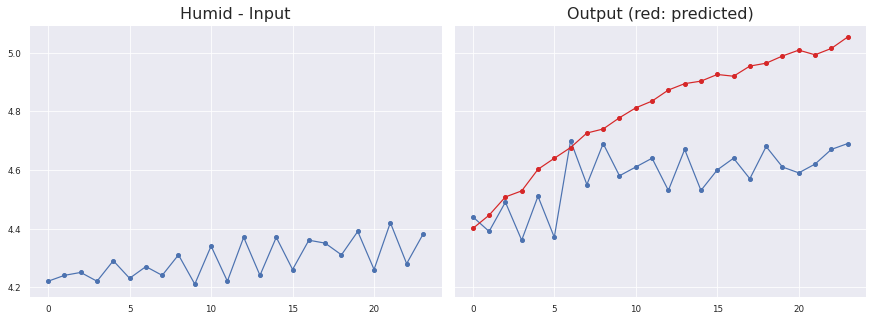

Sensor #33.0
Humid
MAE: 0.23263766005635253 ± 0.13792471878396834
MSE: 0.07070961349673652
RMSE: 0.2659127930294752
Max Error: 0.4190618115663529

KL Divergence: 5.189607111119477 bits
Pinball Loss Temp mean: 0.5950818294433589
Pinball Loss Humid mean: 0.3434843441429597
MSE Temp: 1.1901636588866864
MSE Humid: 0.6869686882859212


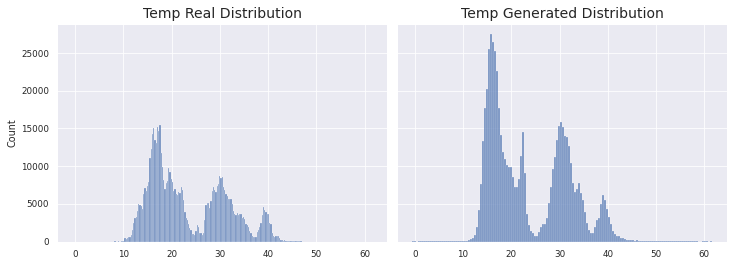

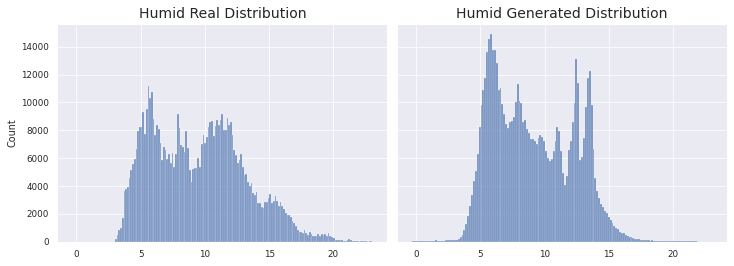

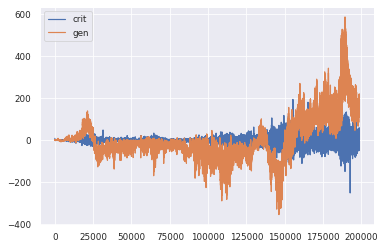

1966/1966 [==============================] - 231s 117ms/step - d_loss: -0.0144 - g_loss: 135.6361
Epoch 102/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.2762 - g_loss: 146.2246

KL Divergence: 11.865824436301404 bits
Pinball Loss Temp mean: 1.040874134652621
Pinball Loss Humid mean: 0.335679720797375
MSE Temp: 2.081748269305232
MSE Humid: 0.6713594415947572


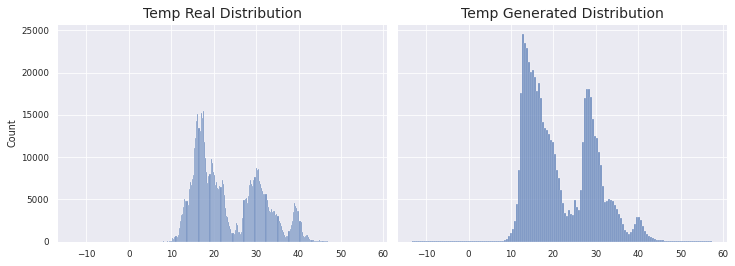

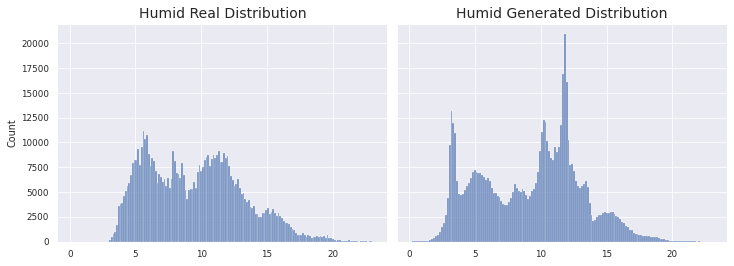

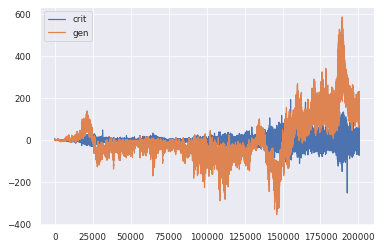

1966/1966 [==============================] - 226s 115ms/step - d_loss: -0.2186 - g_loss: 146.2464
Epoch 103/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1272 - g_loss: 141.7043

KL Divergence: 8.248594199470194 bits
Pinball Loss Temp mean: 2.1726322318313023
Pinball Loss Humid mean: 0.6326689300445032
MSE Temp: 4.345264463662575
MSE Humid: 1.2653378600890124


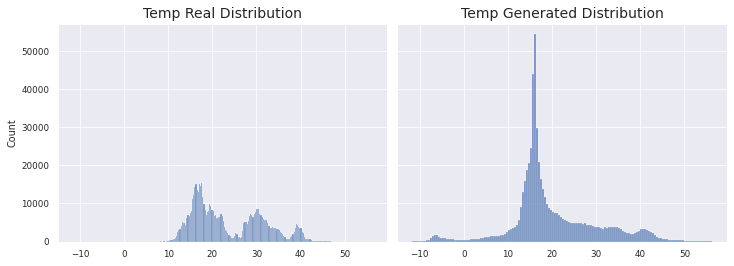

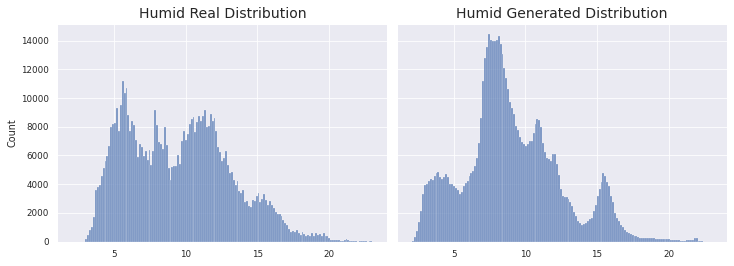

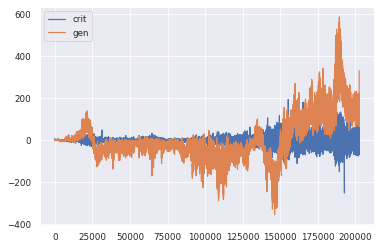

1966/1966 [==============================] - 225s 114ms/step - d_loss: 0.1280 - g_loss: 141.8001
Epoch 104/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.2471 - g_loss: 249.1945

KL Divergence: 9.90046889981406 bits
Pinball Loss Temp mean: 1.2131824395431199
Pinball Loss Humid mean: 0.49513824057436223
MSE Temp: 2.426364879086213
MSE Humid: 0.9902764811487408


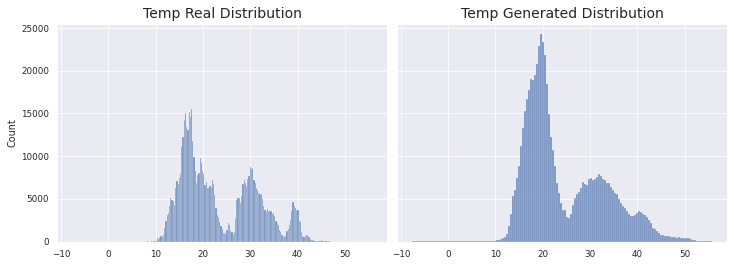

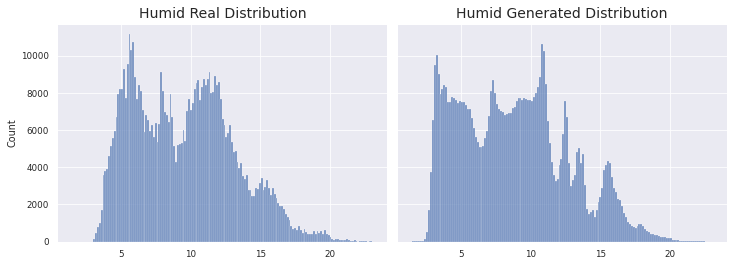

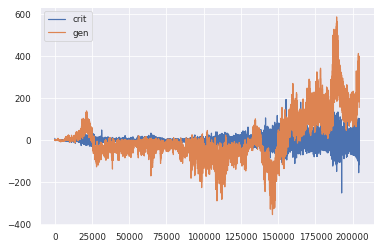

1966/1966 [==============================] - 225s 114ms/step - d_loss: -0.2604 - g_loss: 249.1472
Epoch 105/200
1729/1966 [=========================>....] - ETA: 16s - d_loss: -1.2376 - g_loss: 300.4934

In [ ]:
# prueba_17
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=3,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_16
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_15
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization_4 (Spect (None, 25, 64)       640         input_6[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_7 (LeakyReLU)       (None, 25, 64)       0           spectral_normalization_4[0][0]   
__________________________________________________________________________________________________
spectral_normalization_5 (Spect (None, 25, 128)      33024       leaky_re_lu_7[0][0]              
_______________________________________________________________________________________

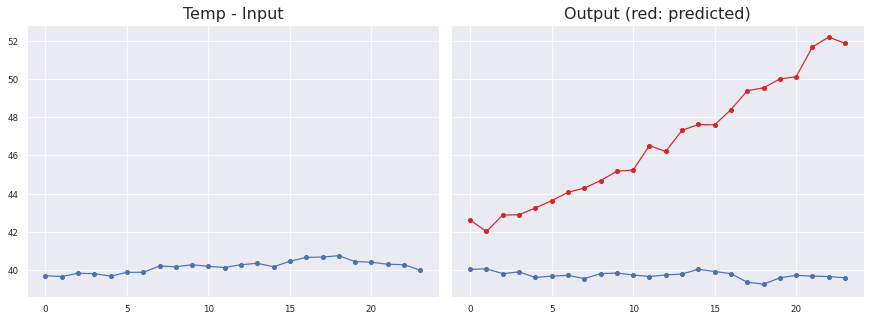

Sensor #19.0
Temp
MAE: 6.897772068381307 ± 3.220706674839993
MSE: 57.95221099270022
RMSE: 7.61263495727335
Max Error: 12.53358464717865


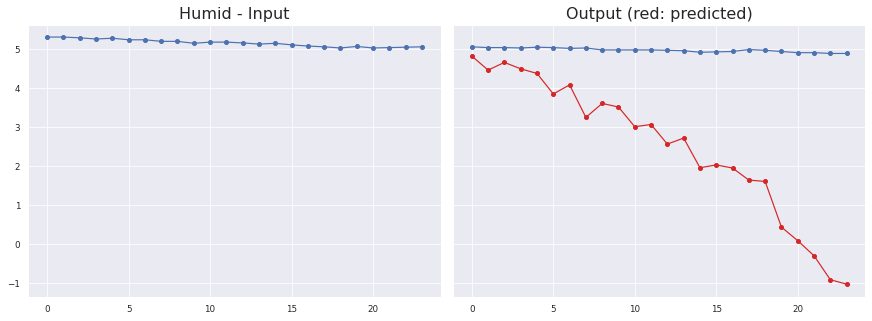

Sensor #19.0
Humid
MAE: 2.4755155051127073 ± 1.701374164154886
MSE: 9.022851062507163
RMSE: 3.0038060960233706
Max Error: 5.909638605713845


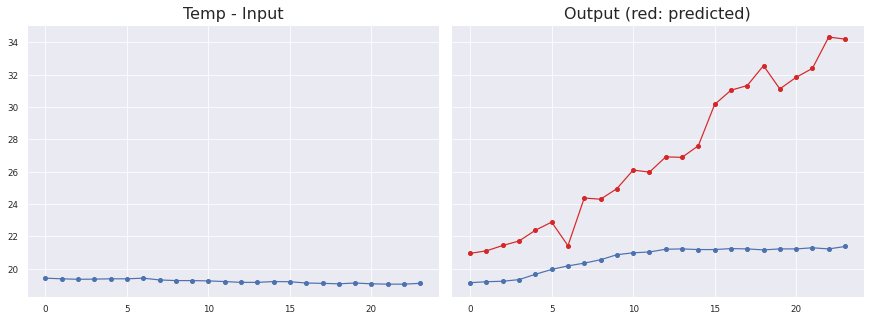

Sensor #2.0
Temp
MAE: 6.367443805529426 ± 3.792486342839274
MSE: 54.927293277197464
RMSE: 7.411294979772257
Max Error: 13.110715652704243


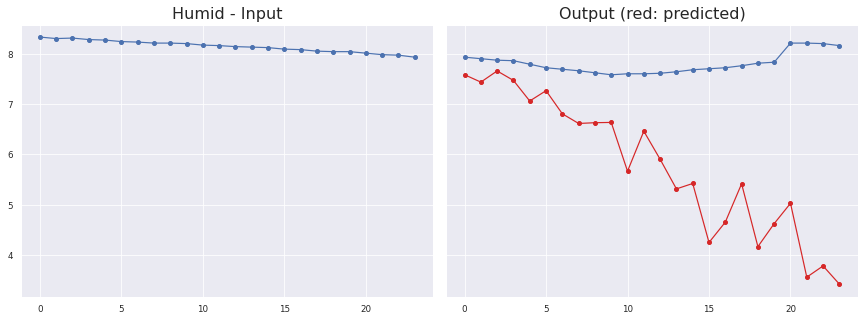

Sensor #2.0
Humid
MAE: 2.024117511001726 ± 1.4357180859020877
MSE: 6.1583381205301775
RMSE: 2.481599911454338
Max Error: 4.741764968335628


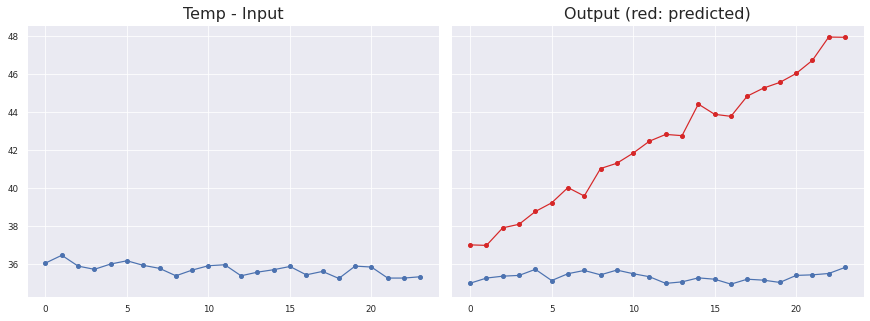

Sensor #0.0
Temp
MAE: 7.009418245355286 ± 3.3142780698697027
MSE: 60.116383262738815
RMSE: 7.753475560207746
Max Error: 12.44698319435119


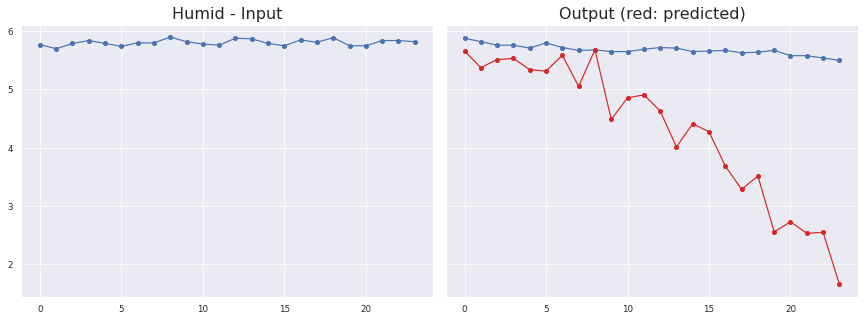

Sensor #0.0
Humid
MAE: 1.3857218297446765 ± 1.122365539731123
MSE: 3.1793434479579035
RMSE: 1.7830713524584212
Max Error: 3.848773966431618


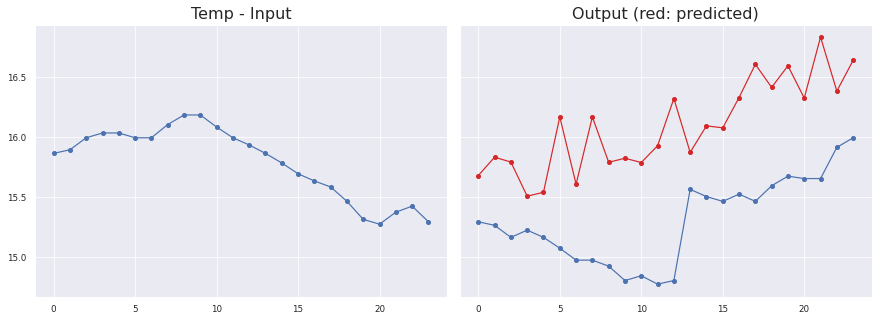

Sensor #1.0
Temp
MAE: 0.7842558282613753 ± 0.31784860071856486
MSE: 0.7160849371406853
RMSE: 0.8462180198628988
Max Error: 1.5165848040580716


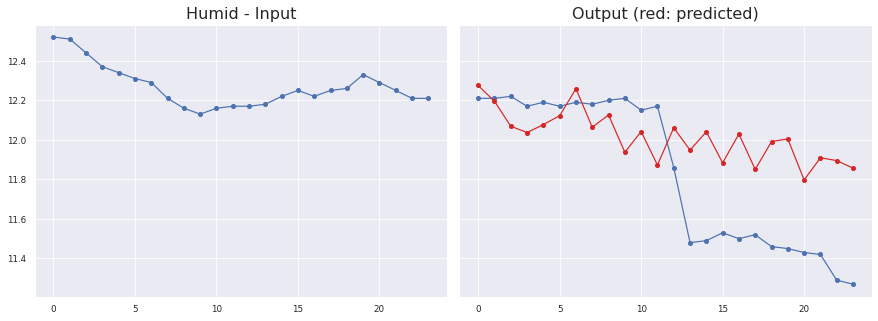

Sensor #1.0
Humid
MAE: 0.29291648140953247 ± 0.30372511449911305
MSE: 0.12544800895421876
RMSE: 0.3541864042481286
Max Error: 0.605159512199462

KL Divergence: 11.801463623810747 bits
Pinball Loss Temp mean: 1.8877938800653713
Pinball Loss Humid mean: 0.4955935030411798
MSE Temp: 3.775587760130832
MSE Humid: 0.9911870060823413


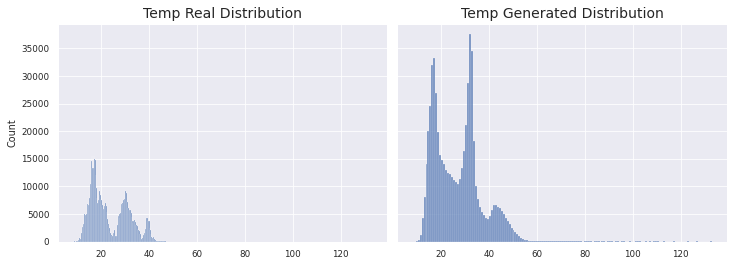

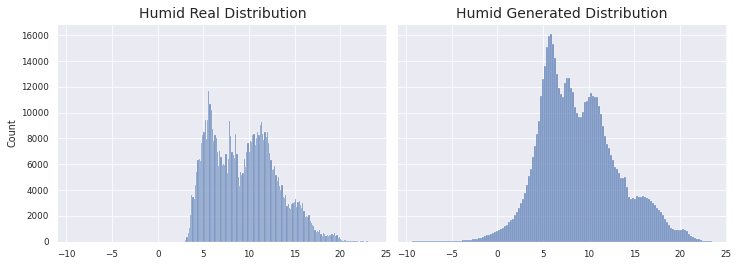

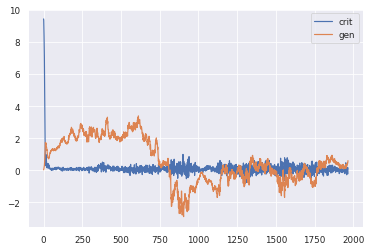

1966/1966 [==============================] - 161s 82ms/step - d_loss: 0.1158 - g_loss: 0.5622
Epoch 2/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0486 - g_loss: -0.0867
Better KL
Better Pinball
Better MSE
>2 MODELS HAVE BEEN SAVED


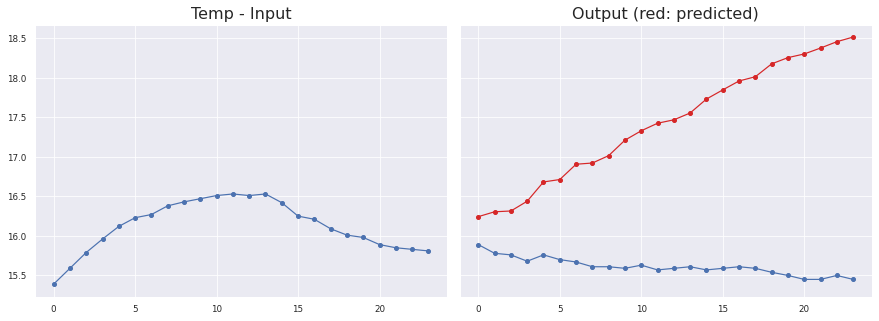

Sensor #24.0
Temp
MAE: 1.8100876682996756 ± 0.8281143802532013
MSE: 3.9621907937127006
RMSE: 1.990525255733446
Max Error: 3.063770427703858


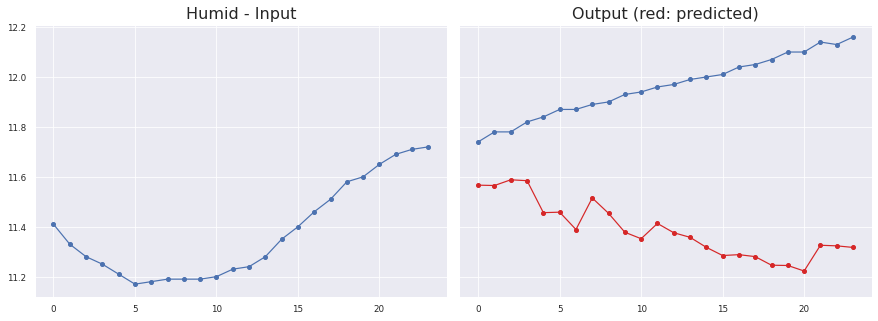

Sensor #24.0
Humid
MAE: 0.5739888601439688 ± 0.22406986345200597
MSE: 0.3796705152767732
RMSE: 0.6161740949413349
Max Error: 0.8773762838542449


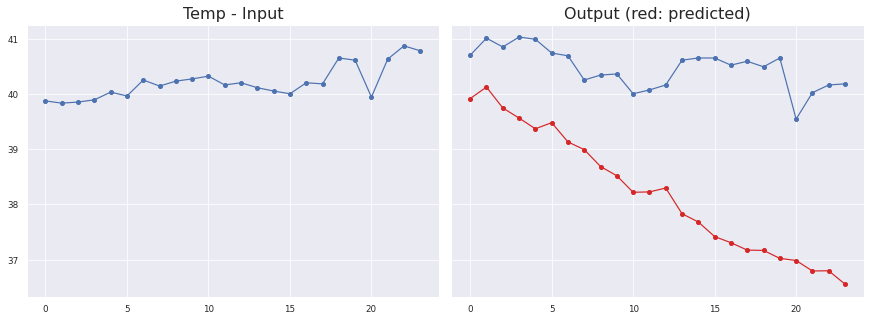

Sensor #19.0
Temp
MAE: 2.2683108932773277 ± 0.9405588277658616
MSE: 6.029885217048881
RMSE: 2.455582459834913
Max Error: 3.6384157252311695


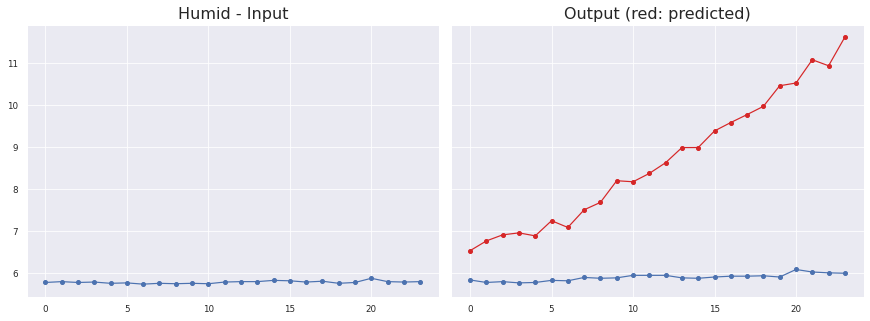

Sensor #19.0
Humid
MAE: 2.7854032695821176 ± 1.4569643045965346
MSE: 9.881216359067215
RMSE: 3.143440210830678
Max Error: 5.636958838626743


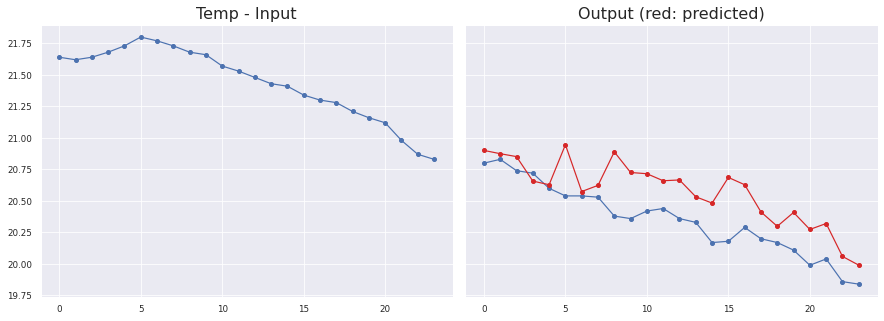

Sensor #16.0
Temp
MAE: 0.2290165843566266 ± 0.14552992144502674
MSE: 0.07127194055096599
RMSE: 0.2669680515547993
Max Error: 0.5092193698883065


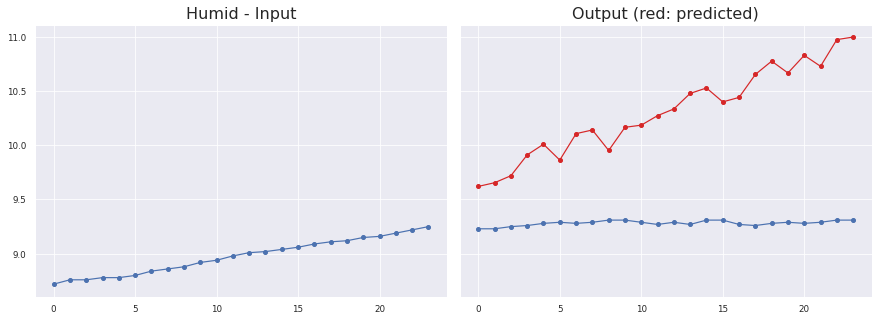

Sensor #16.0
Humid
MAE: 1.026352173325917 ± 0.38883148183704275
MSE: 1.204588704958424
RMSE: 1.0975375642584742
Max Error: 1.6864635485410684


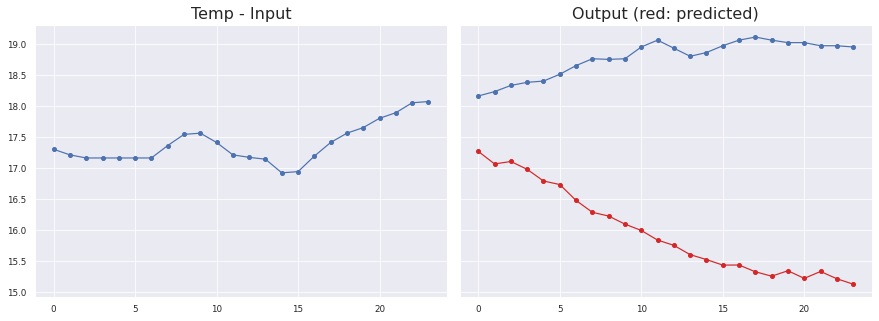

Sensor #22.0
Temp
MAE: 2.803644116719564 ± 0.9624133641041193
MSE: 8.786659816622432
RMSE: 2.9642300546048097
Max Error: 3.824927804470061


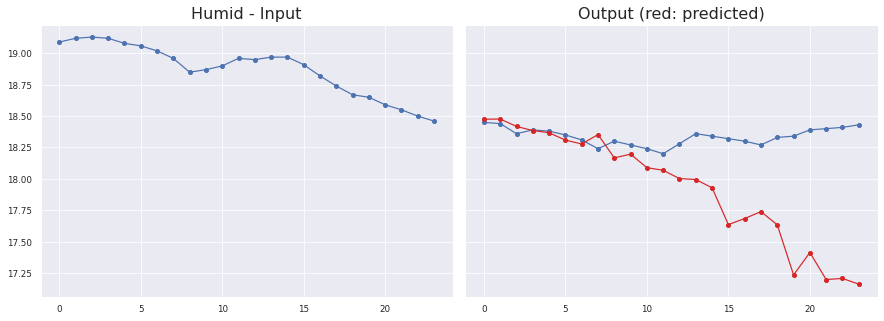

Sensor #22.0
Humid
MAE: 0.42323563534145486 ± 0.449680651019542
MSE: 0.36534584917326507
RMSE: 0.6044384577219297
Max Error: 1.2694707652926454

KL Divergence: 2.4092931751558897 bits
Pinball Loss Temp mean: 1.1895049749067301
Pinball Loss Humid mean: 0.5539902978500144
MSE Temp: 2.379009949813458
MSE Humid: 1.1079805957000428


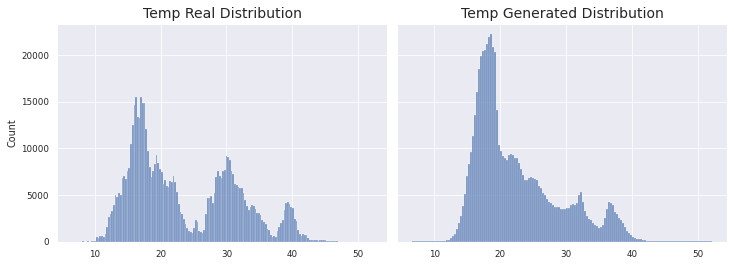

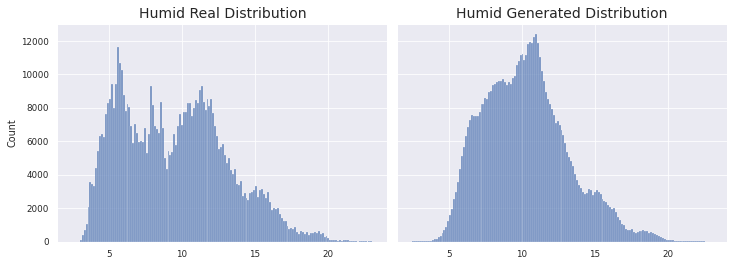

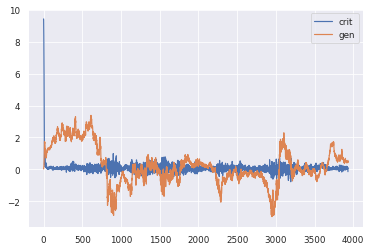

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0484 - g_loss: -0.0860
Epoch 3/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0309 - g_loss: 1.7265

KL Divergence: 5.605185939084082 bits
Pinball Loss Temp mean: 2.007670210841172
Pinball Loss Humid mean: 0.49848690249156624
MSE Temp: 4.015340421682344
MSE Humid: 0.9969738049831205


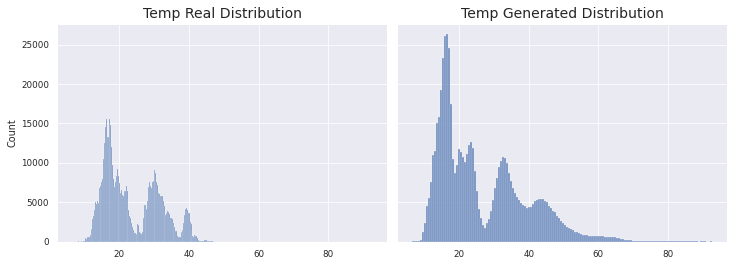

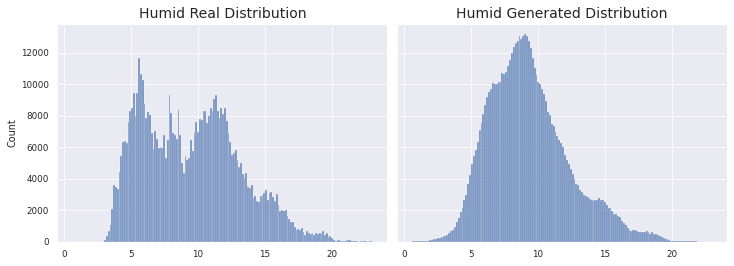

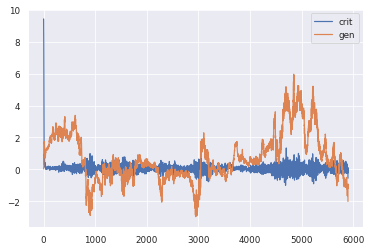

1966/1966 [==============================] - 147s 75ms/step - d_loss: 0.0303 - g_loss: 1.7227
Epoch 4/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0368 - g_loss: -0.2200
Better KL
Better Pinball
Better MSE
>4 MODELS HAVE BEEN SAVED


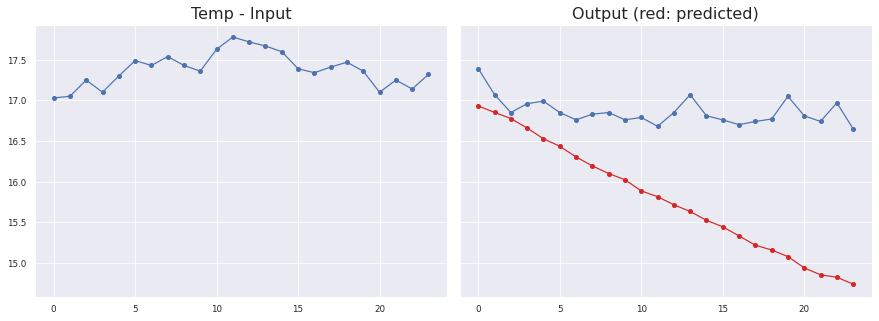

Sensor #28.0
Temp
MAE: 1.074201517403126 ± 0.6183018910832381
MSE: 1.5362061285082866
RMSE: 1.2394378276090683
Max Error: 2.149240355491637


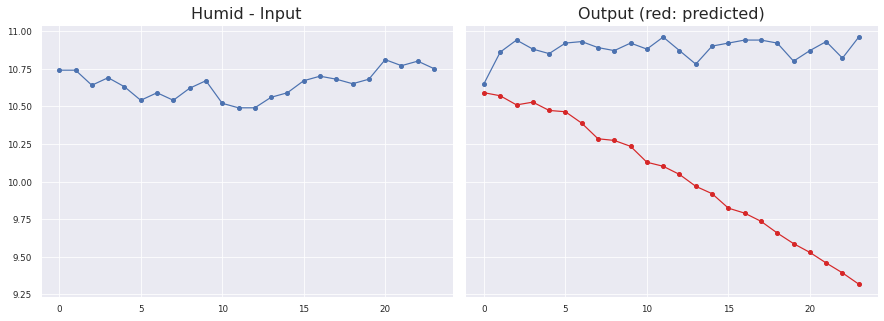

Sensor #28.0
Humid
MAE: 0.8509842048119755 ± 0.41711610529827503
MSE: 0.8981599621386719
RMSE: 0.9477130167612302
Max Error: 1.6413195565342917


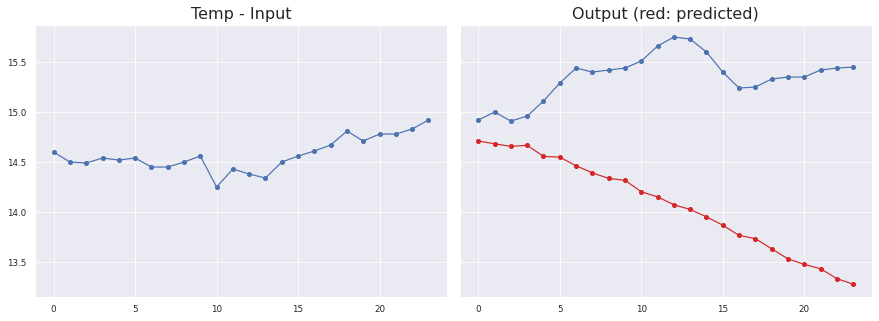

Sensor #22.0
Temp
MAE: 1.2743019480506579 ± 0.5994623831597282
MSE: 1.983200603629242
RMSE: 1.4082615536998948
Max Error: 2.1714644169807436


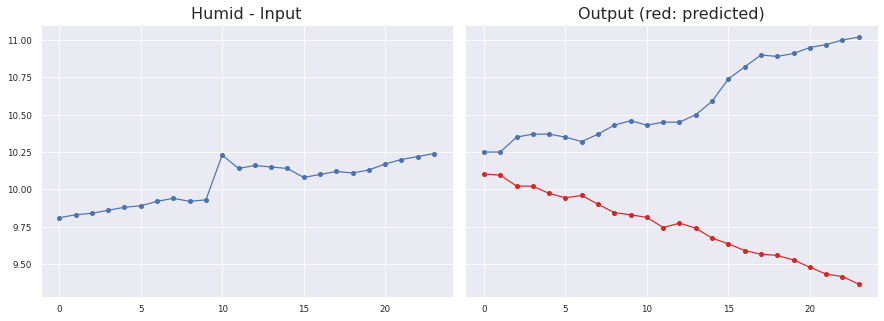

Sensor #22.0
Humid
MAE: 0.8387869494408365 ± 0.47983040504547364
MSE: 0.9338007641583678
RMSE: 0.9663336712328552
Max Error: 1.6545295679569243


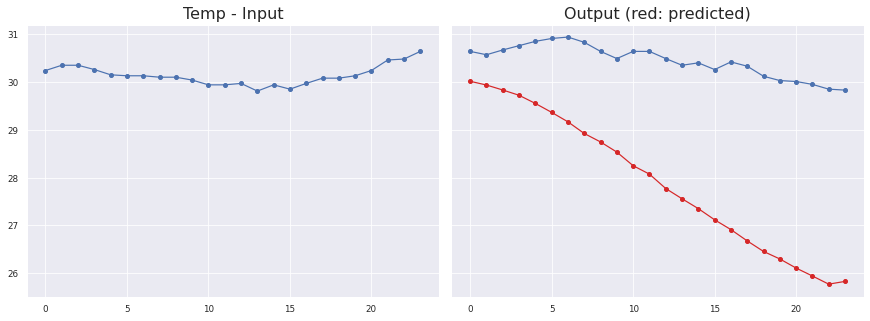

Sensor #25.0
Temp
MAE: 2.53055620028327 ± 1.1339535269147958
MSE: 7.689565283994607
RMSE: 2.7730065423641914
Max Error: 4.079717411696908


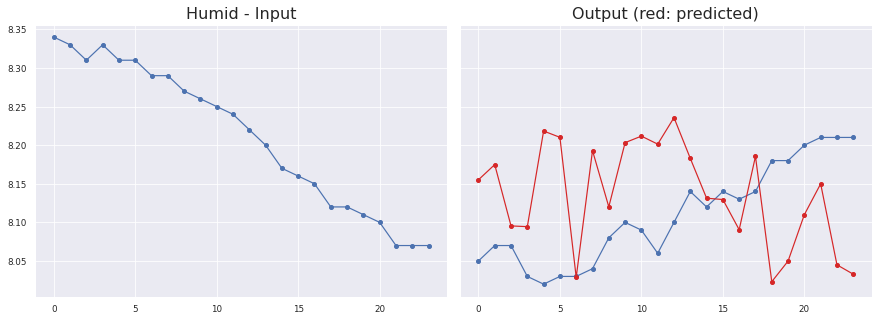

Sensor #25.0
Humid
MAE: 0.09596120946109317 ± 0.10949708277892028
MSE: 0.012707013060354704
RMSE: 0.11272538782525747
Max Error: 0.19830357432365453


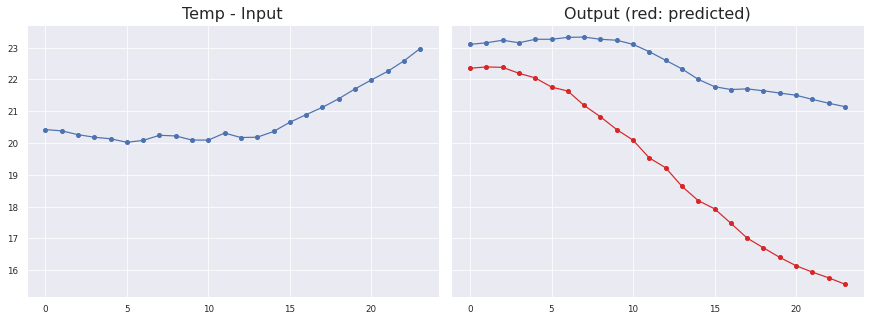

Sensor #16.0
Temp
MAE: 3.2114409471551575 ± 1.6486451332859158
MSE: 13.031383732572152
RMSE: 3.6099007926218905
Max Error: 5.580891203880309


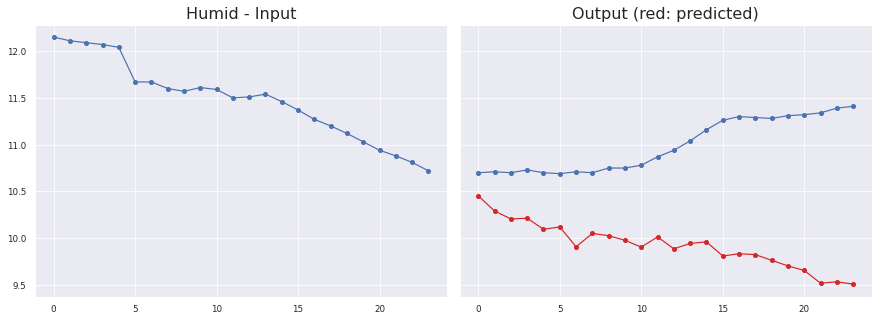

Sensor #16.0
Humid
MAE: 1.0676861697621638 ± 0.49723453942652024
MSE: 1.3871959443001038
RMSE: 1.1777928274107055
Max Error: 1.9010399910807614

KL Divergence: 1.9115482571588305 bits
Pinball Loss Temp mean: 1.121301074624933
Pinball Loss Humid mean: 0.36207012845899056
MSE Temp: 2.242602149249856
MSE Humid: 0.7241402569179792


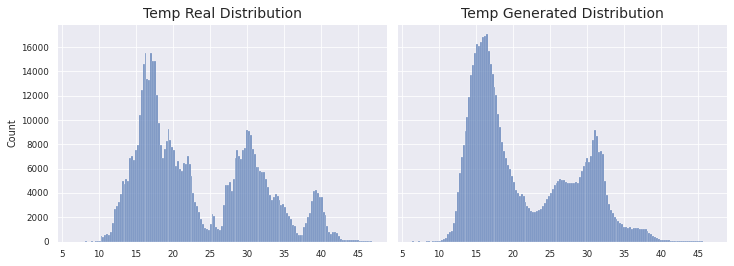

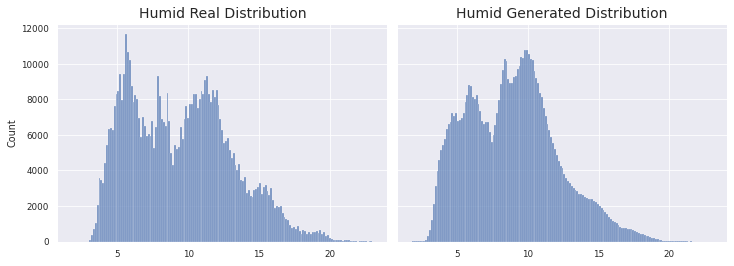

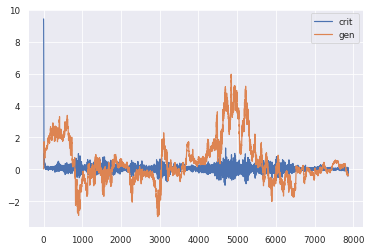

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.0363 - g_loss: -0.2200
Epoch 5/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0279 - g_loss: 1.7750

KL Divergence: 4.517533638871534 bits
Pinball Loss Temp mean: 3.1949156195956596
Pinball Loss Humid mean: 0.6277805001098964
MSE Temp: 6.389831239191291
MSE Humid: 1.2555610002197999


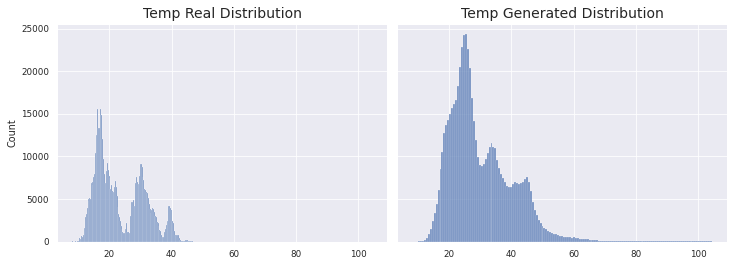

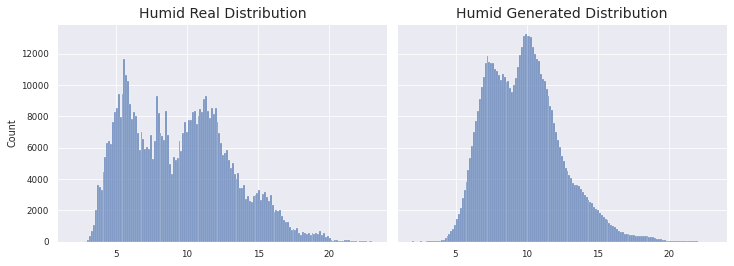

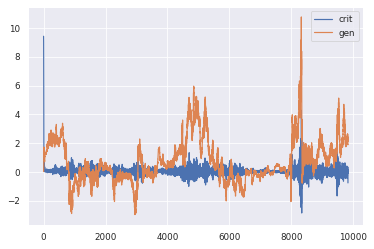

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0272 - g_loss: 1.7751
Epoch 6/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0269 - g_loss: 2.1308
Better Pinball
Better MSE
>6 MODELS HAVE BEEN SAVED


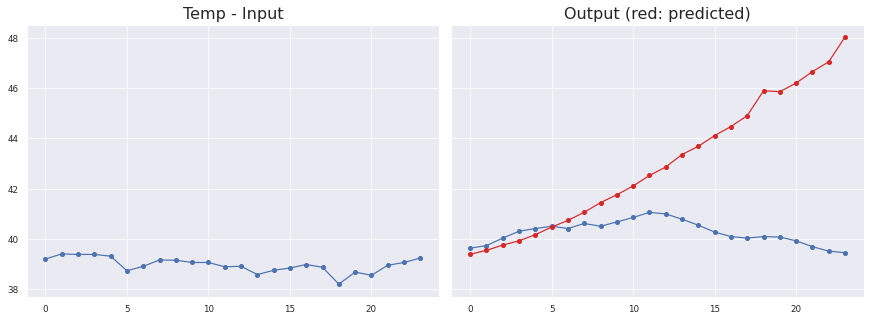

Sensor #19.0
Temp
MAE: 2.848772974411645 ± 2.8035708614730015
MSE: 15.339164066517815
RMSE: 3.916524488180537
Max Error: 8.56436937332154


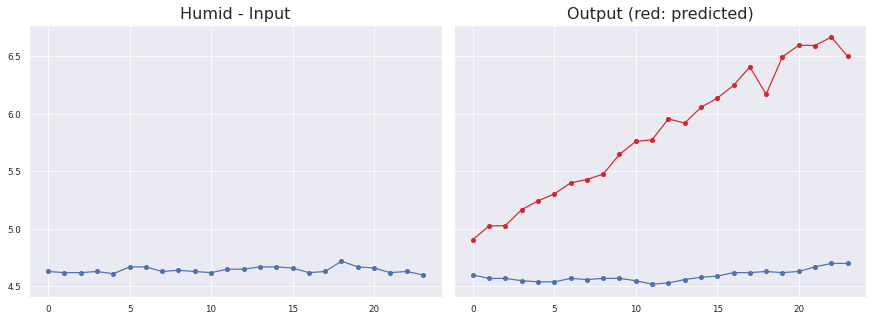

Sensor #19.0
Humid
MAE: 1.2393112848326566 ± 0.5171672902006466
MSE: 1.8033544667670498
RMSE: 1.3428903405591426
Max Error: 1.9670235067605981


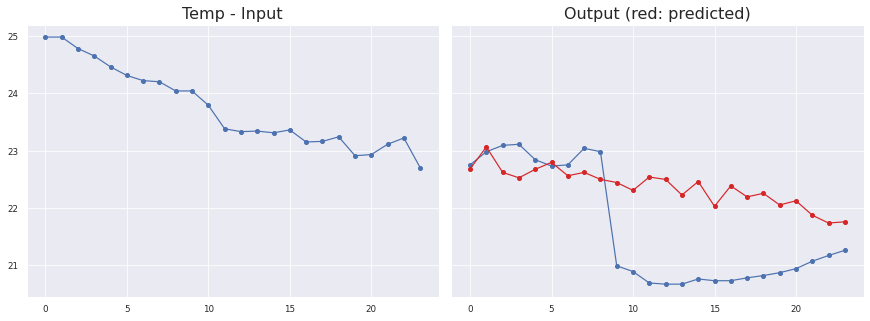

Sensor #4.0
Temp
MAE: 0.9316724205017084 ± 0.8370713014499228
MSE: 1.2379181255333807
RMSE: 1.1126176906437273
Max Error: 1.8488046348094969


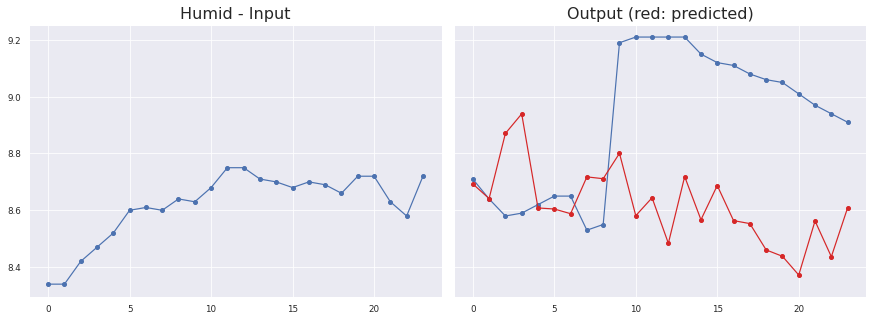

Sensor #4.0
Humid
MAE: 0.37826382398605324 ± 0.32693236463315234
MSE: 0.1943423635563526
RMSE: 0.44084278780122127
Max Error: 0.7261605691909807


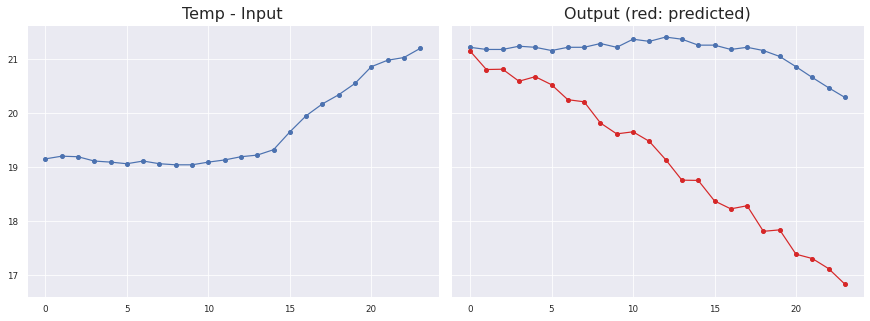

Sensor #2.0
Temp
MAE: 1.9867922918995227 ± 1.1554821471236385
MSE: 5.282482603472812
RMSE: 2.2983652023716363
Max Error: 3.4784432601928685


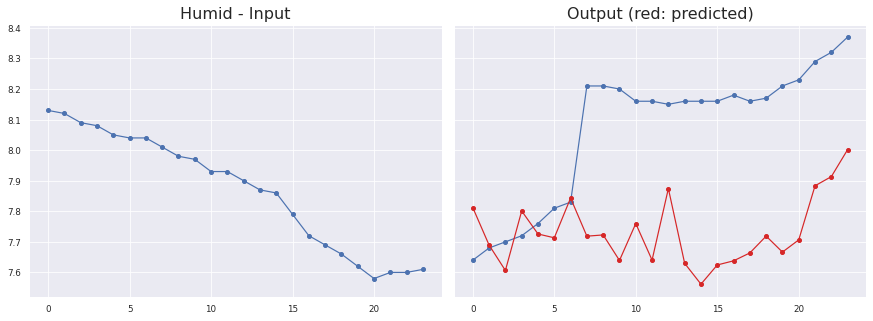

Sensor #2.0
Humid
MAE: 0.3598867627729972 ± 0.23597478487233847
MSE: 0.16918823407065695
RMSE: 0.41132497379888927
Max Error: 0.5983423367142677


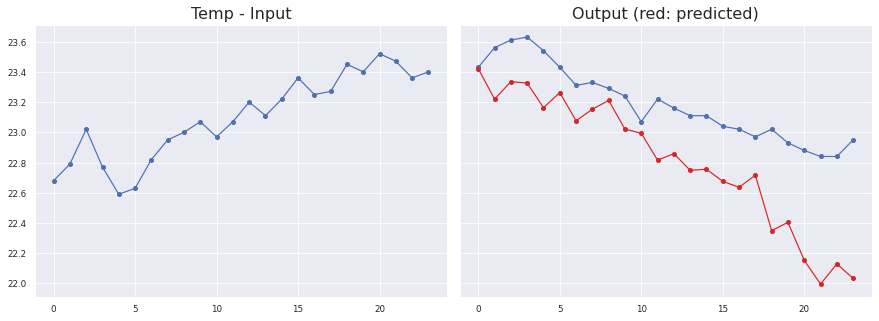

Sensor #4.0
Temp
MAE: 0.37815361077586723 ± 0.23573502959465015
MSE: 0.19857115752081667
RMSE: 0.4456132375960309
Max Error: 0.9158883607387516


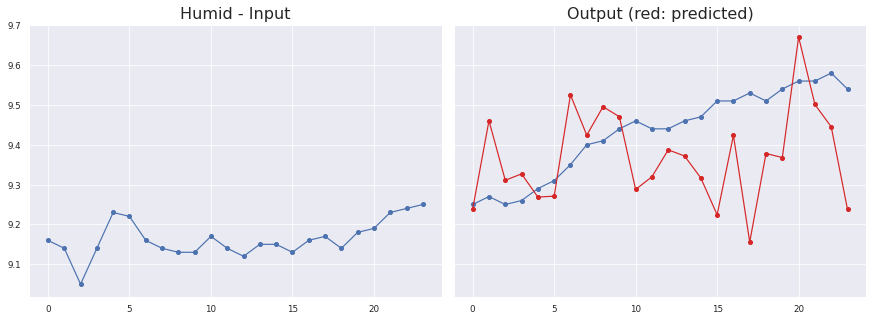

Sensor #4.0
Humid
MAE: 0.12286866358170927 ± 0.14094160350754553
MSE: 0.023569998771552483
RMSE: 0.15352523822340247
Max Error: 0.374229399263859

KL Divergence: 7.244879283629304 bits
Pinball Loss Temp mean: 0.8071496195561672
Pinball Loss Humid mean: 0.3129710474836572
MSE Temp: 1.6142992391123374
MSE Humid: 0.6259420949673155


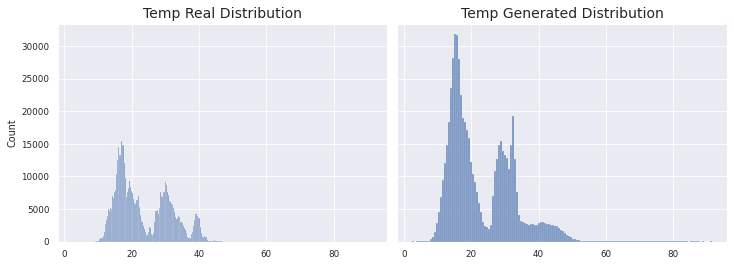

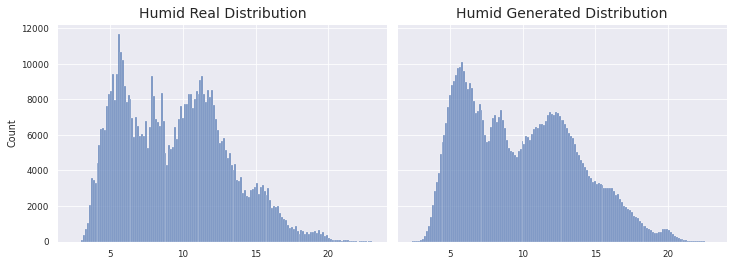

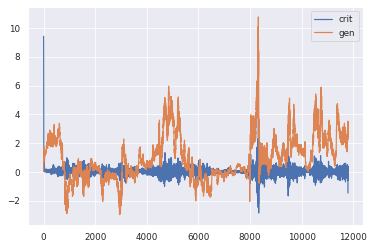

1966/1966 [==============================] - 151s 77ms/step - d_loss: 0.0254 - g_loss: 2.1322
Epoch 7/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0233 - g_loss: 5.5016

KL Divergence: 2.373676916254318 bits
Pinball Loss Temp mean: 0.8520674663024165
Pinball Loss Humid mean: 0.37934184310158076
MSE Temp: 1.7041349326048374
MSE Humid: 0.7586836862031654


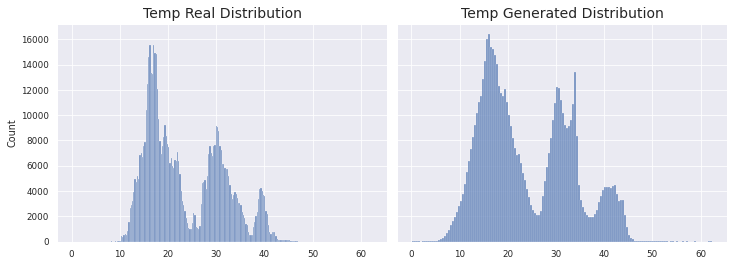

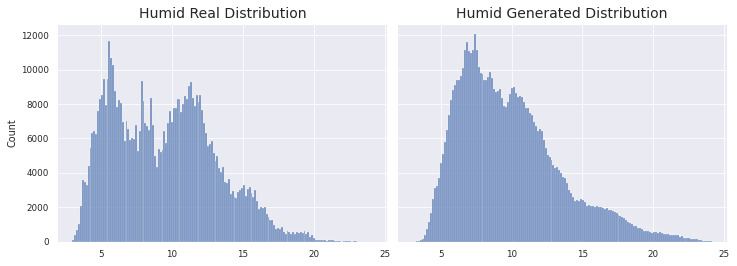

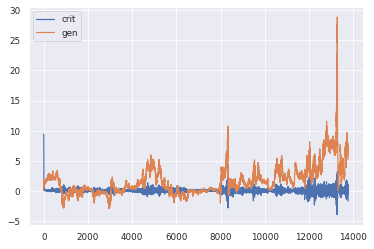

1966/1966 [==============================] - 148s 75ms/step - d_loss: 0.0216 - g_loss: 5.5013
Epoch 8/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0019 - g_loss: 9.7184

KL Divergence: 3.4320464585045363 bits
Pinball Loss Temp mean: 1.1767736817585377
Pinball Loss Humid mean: 0.35467959673171007
MSE Temp: 2.353547363517053
MSE Humid: 0.709359193463416


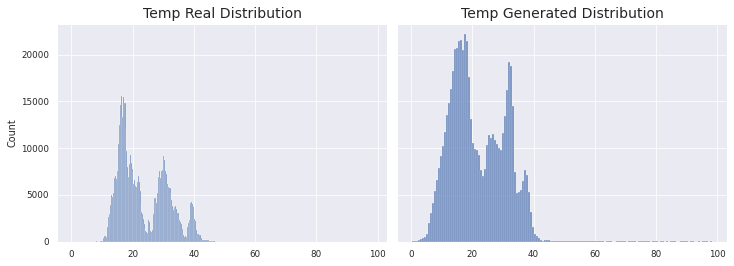

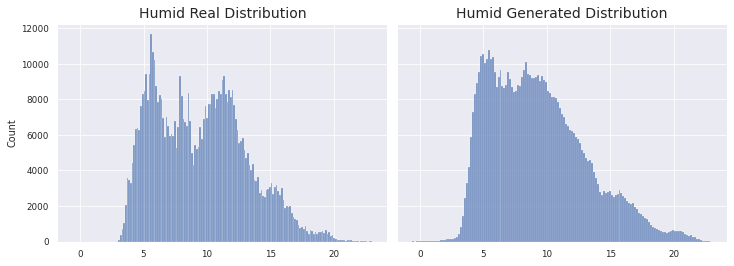

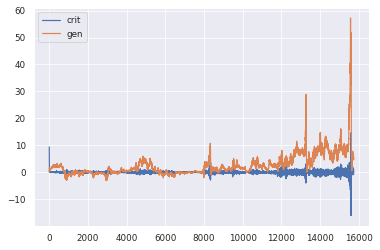

1966/1966 [==============================] - 146s 74ms/step - d_loss: 0.0032 - g_loss: 9.7150
Epoch 9/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0315 - g_loss: 9.7626
Better KL
Better Pinball
Better MSE
>9 MODELS HAVE BEEN SAVED


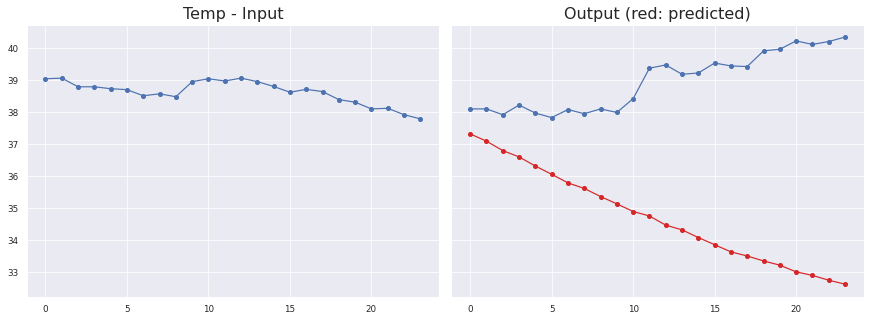

Sensor #19.0
Temp
MAE: 4.225618702173233 ± 2.2770670723944475
MSE: 23.040887868339226
RMSE: 4.800092485394342
Max Error: 7.702413477897643


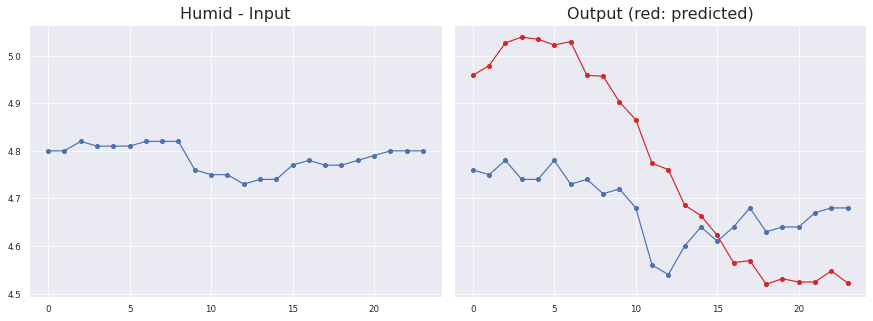

Sensor #19.0
Humid
MAE: 0.1732204124083121 ± 0.1665763992280225
MSE: 0.03649723677164254
RMSE: 0.1910424999094247
Max Error: 0.29960074394941305


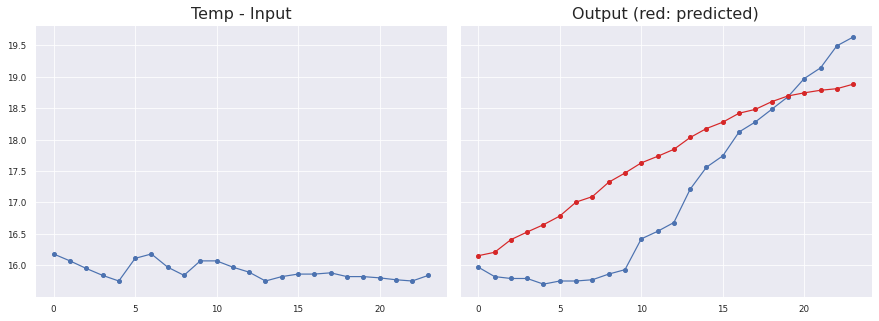

Sensor #31.0
Temp
MAE: 0.7361915679772695 ± 0.6479026015253886
MSE: 0.7427262928796408
RMSE: 0.8618156954242832
Max Error: 1.537615451812746


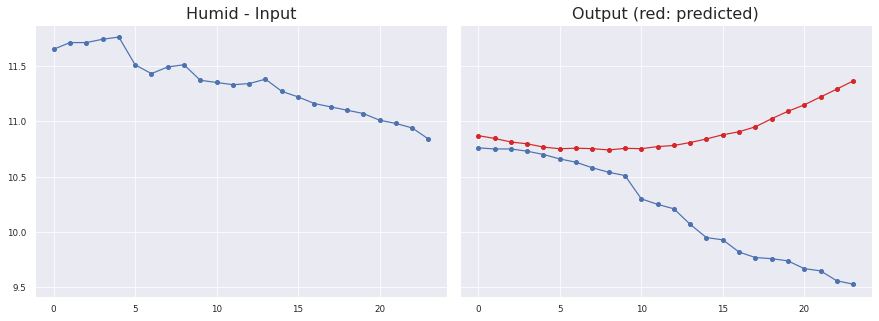

Sensor #31.0
Humid
MAE: 0.7021362658869483 ± 0.5912038734854141
MSE: 0.842517355897825
RMSE: 0.917887441845581
Max Error: 1.8339047623425735


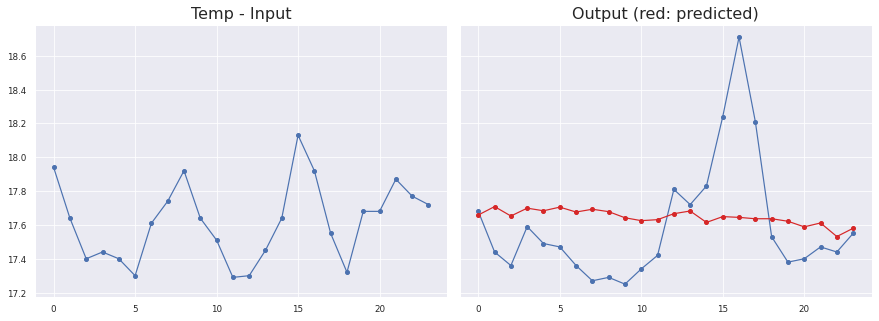

Sensor #1.0
Temp
MAE: 0.27341099282105724 ± 0.348883800388197
MSE: 0.12449997946147402
RMSE: 0.35284554618341724
Max Error: 1.065423257350922


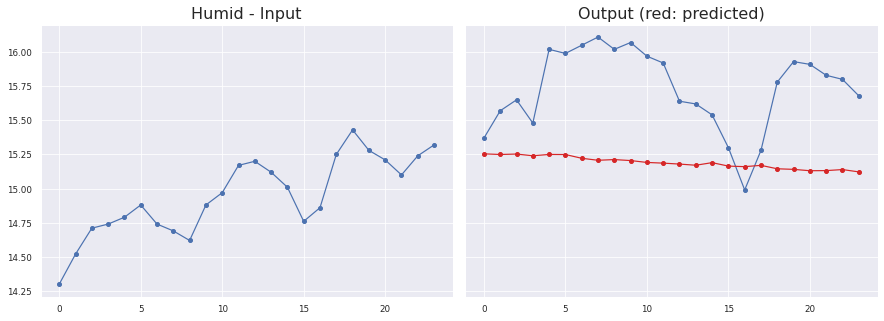

Sensor #1.0
Humid
MAE: 0.5538693772690985 ± 0.28801876683349875
MSE: 0.37417259511920964
RMSE: 0.6116964893795039
Max Error: 0.9026883437484496


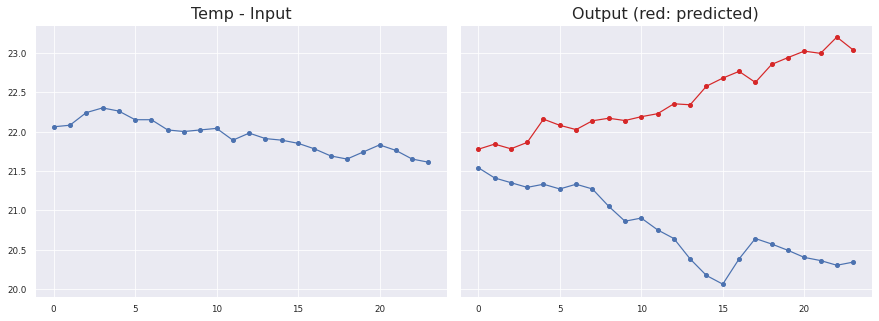

Sensor #2.0
Temp
MAE: 1.6116481605420514 ± 0.8532251404380281
MSE: 3.3254029336540705
RMSE: 1.8235687356538197
Max Error: 2.9007171863317467


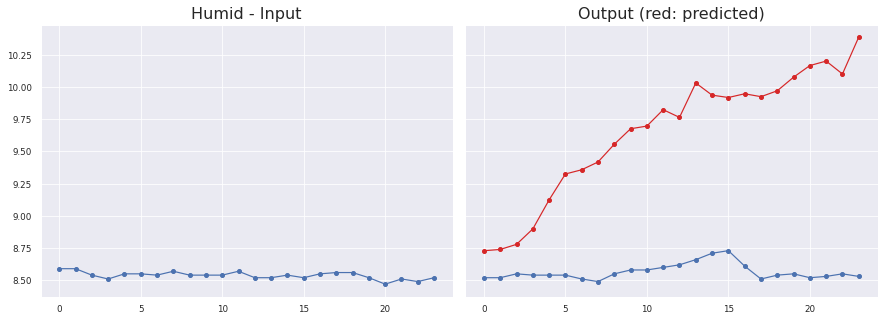

Sensor #2.0
Humid
MAE: 1.0824170495197178 ± 0.47015416489186485
MSE: 1.3926716078561385
RMSE: 1.180115082462782
Max Error: 1.8582593604922302

KL Divergence: 1.798158533345309 bits
Pinball Loss Temp mean: 0.7472513919989598
Pinball Loss Humid mean: 0.2719609298597899
MSE Temp: 1.4945027839979557
MSE Humid: 0.5439218597195814


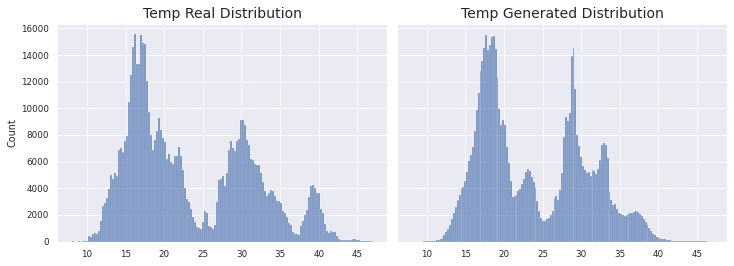

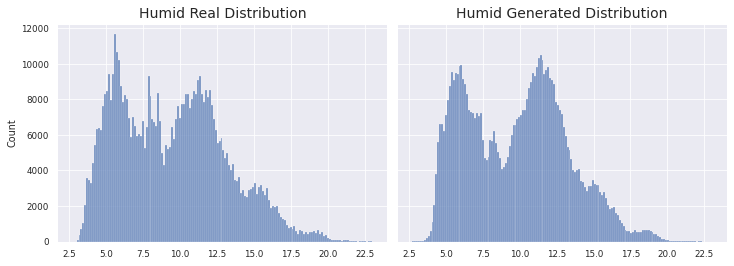

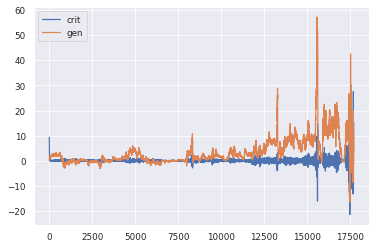

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.0350 - g_loss: 9.7566
Epoch 10/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1207 - g_loss: 0.1157

KL Divergence: 8.388120063617947 bits
Pinball Loss Temp mean: 0.7372494333329411
Pinball Loss Humid mean: 0.4978785035429742
MSE Temp: 1.4744988666659085
MSE Humid: 0.995757007085928


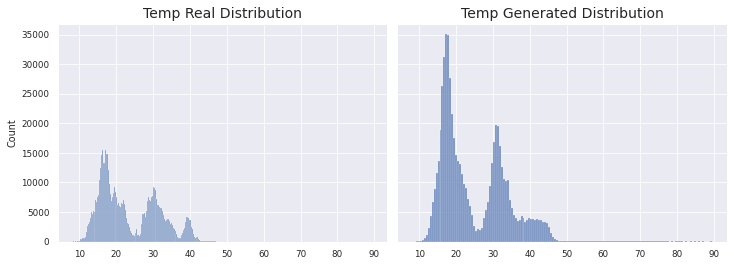

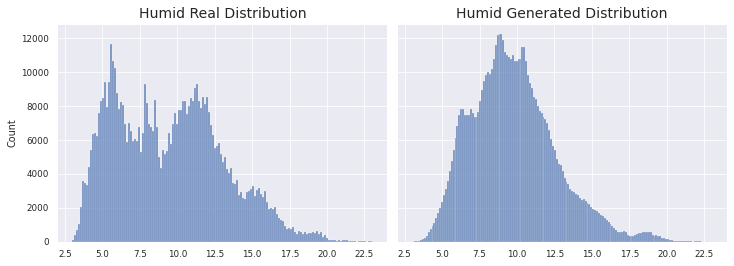

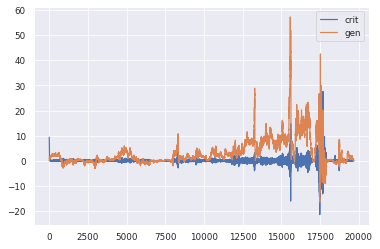

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.1211 - g_loss: 0.1161
Epoch 11/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0823 - g_loss: -3.7466
Better Pinball
Better MSE
>11 MODELS HAVE BEEN SAVED


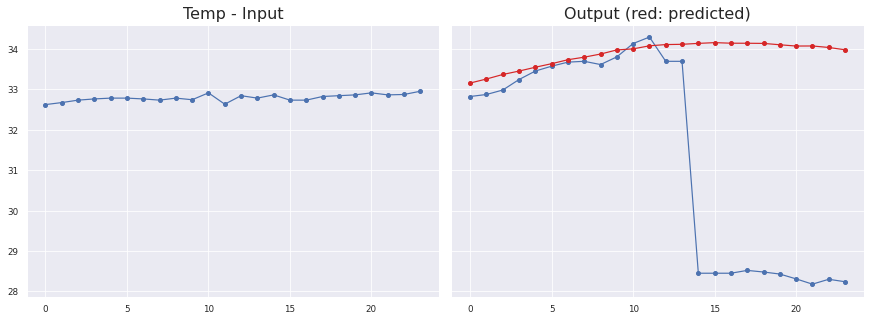

Sensor #11.0
Temp
MAE: 2.515433688660462 ± 2.7311962803744074
MSE: 13.64146892227018
RMSE: 3.6934359236719105
Max Error: 5.88954693436623


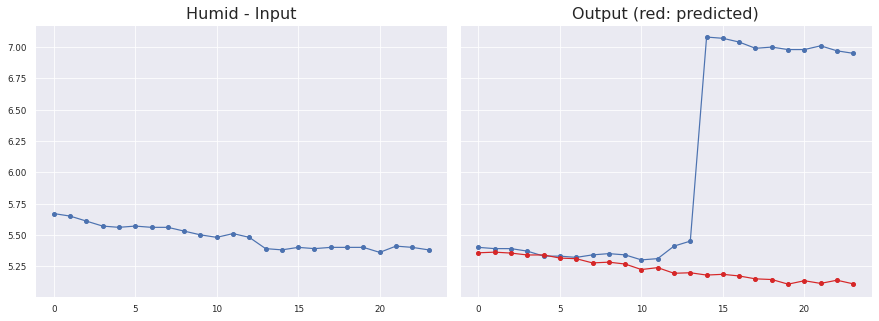

Sensor #11.0
Humid
MAE: 0.818470574853321 ± 0.8866170368371746
MSE: 1.4546678190559963
RMSE: 1.2060961068903242
Max Error: 1.901247101426124


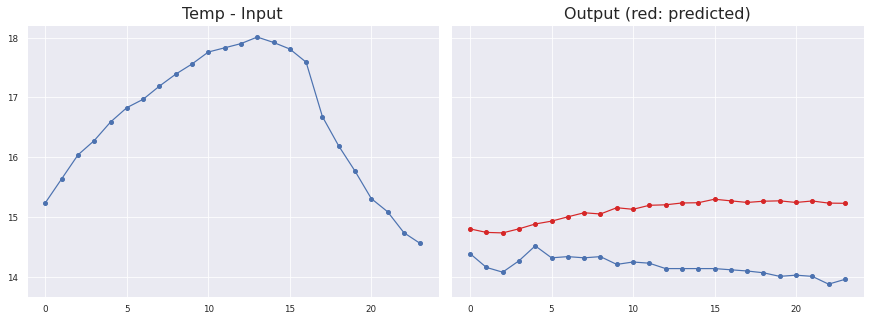

Sensor #22.0
Temp
MAE: 0.9322892428437863 ± 0.2944587714512892
MSE: 0.955869200406843
RMSE: 0.9776856347552842
Max Error: 1.3544540858268714


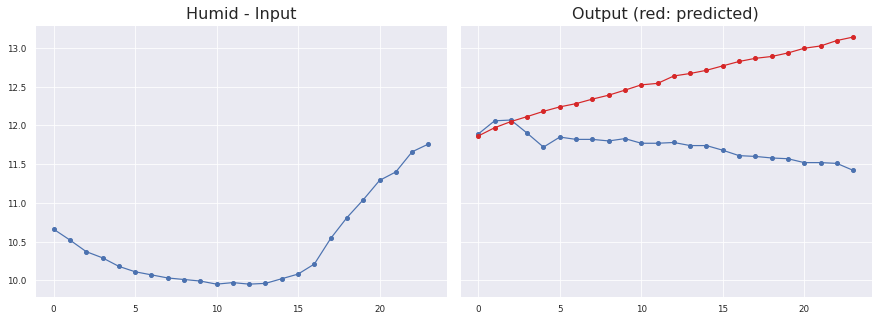

Sensor #22.0
Humid
MAE: 0.8431828307174153 ± 0.522429161239886
MSE: 0.9650312423969698
RMSE: 0.982360037052083
Max Error: 1.7219480566680438


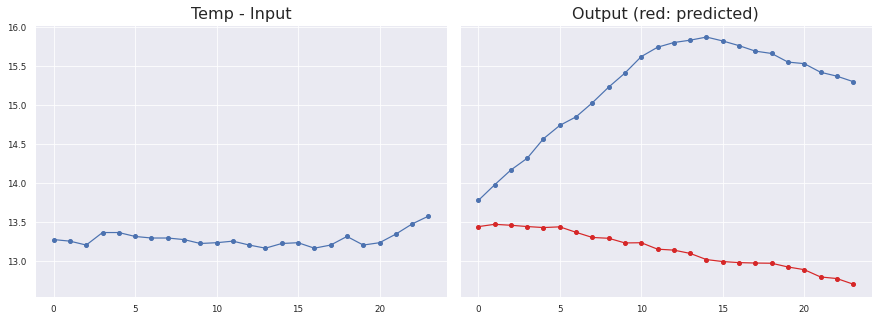

Sensor #30.0
Temp
MAE: 2.0578850723306332 ± 0.8103260743584643
MSE: 4.891519317706455
RMSE: 2.211677941678321
Max Error: 2.845692842006681


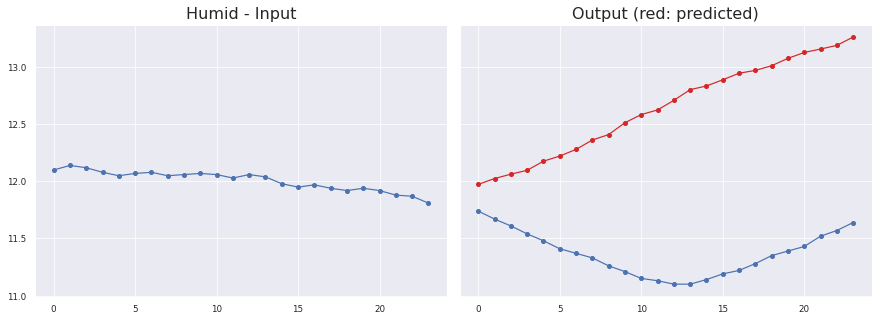

Sensor #30.0
Humid
MAE: 1.2714174109014376 ± 0.49417122844722156
MSE: 1.8607074357683515
RMSE: 1.3640775035782797
Max Error: 1.7281080394983288


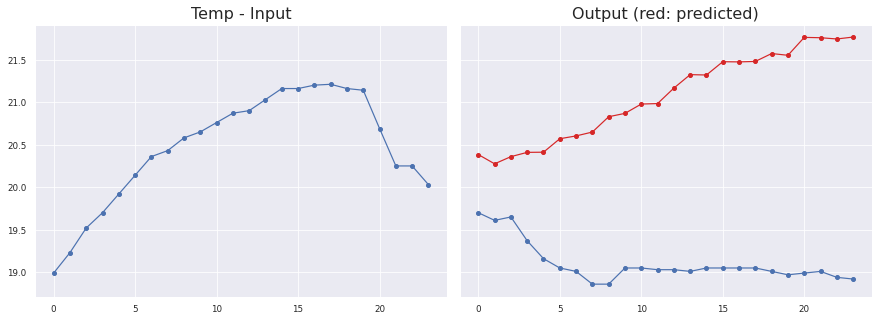

Sensor #9.0
Temp
MAE: 1.9676512044668202 ± 0.6776279720860913
MSE: 4.330830930993236
RMSE: 2.0810648550665682
Max Error: 2.8454342913627606


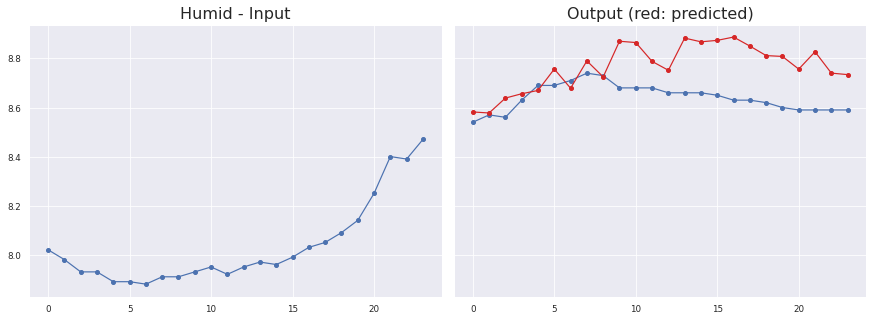

Sensor #9.0
Humid
MAE: 0.13053376803795547 ± 0.08964082431448027
MSE: 0.02385737636015883
RMSE: 0.15445833211633106
Max Error: 0.2571960185468196

KL Divergence: 15.287497785228819 bits
Pinball Loss Temp mean: 0.5946691163380846
Pinball Loss Humid mean: 0.2757136389657161
MSE Temp: 1.1893382326761772
MSE Humid: 0.5514272779314268


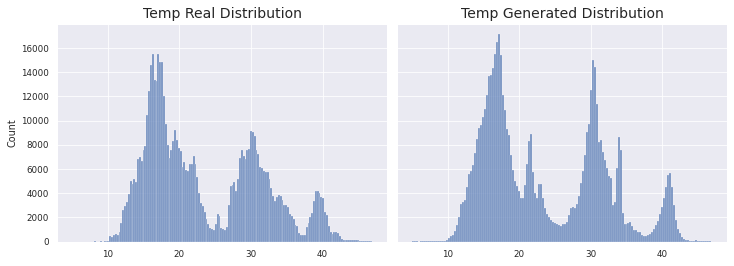

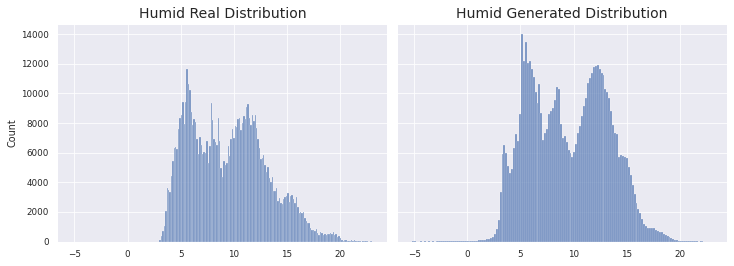

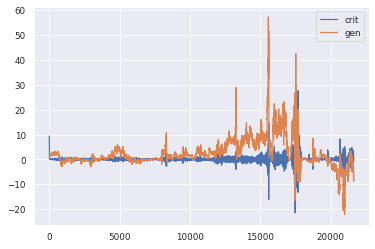

1966/1966 [==============================] - 147s 75ms/step - d_loss: 0.0857 - g_loss: -3.7516
Epoch 12/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0613 - g_loss: -2.1909

KL Divergence: 4.081971009424724 bits
Pinball Loss Temp mean: 1.0848048857534267
Pinball Loss Humid mean: 0.24851721339934446
MSE Temp: 2.1696097715068565
MSE Humid: 0.49703442679870496


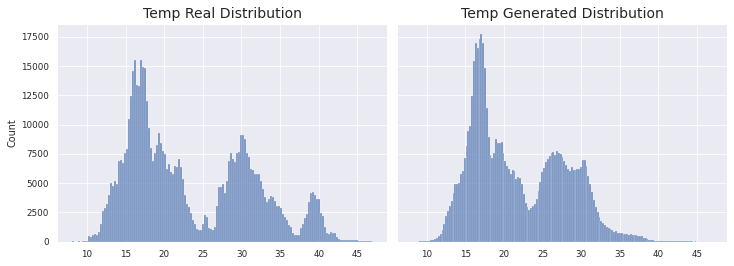

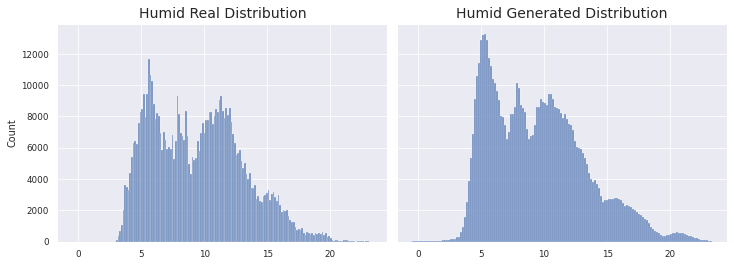

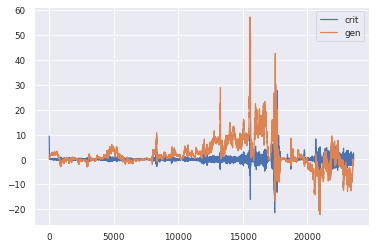

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0626 - g_loss: -2.1911
Epoch 13/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0316 - g_loss: -3.2146

KL Divergence: 5.022473021645038 bits
Pinball Loss Temp mean: 2.0034134219429576
Pinball Loss Humid mean: 0.9342870174879587
MSE Temp: 4.00682684388605
MSE Humid: 1.8685740349759192


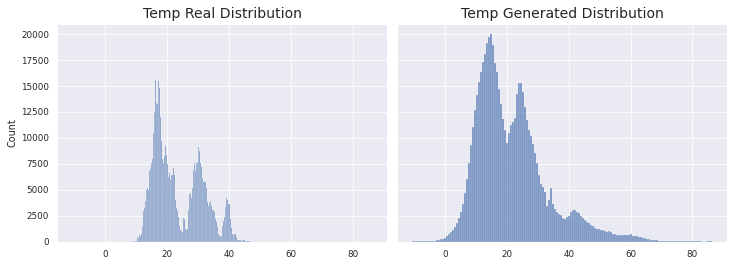

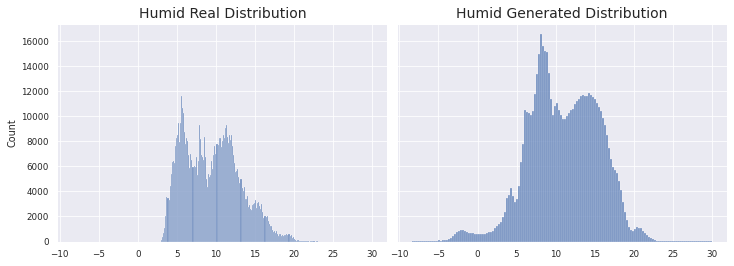

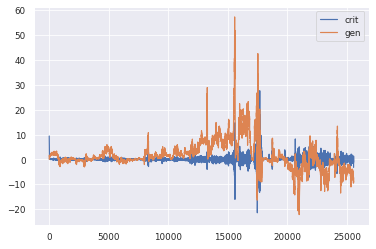

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0283 - g_loss: -3.2209
Epoch 14/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0539 - g_loss: -1.7228

KL Divergence: 5.283982876922361 bits
Pinball Loss Temp mean: 2.2967471507448387
Pinball Loss Humid mean: 0.6103954259316183
MSE Temp: 4.593494301489719
MSE Humid: 1.2207908518632498


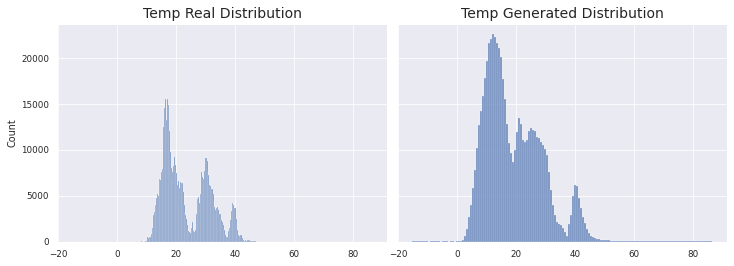

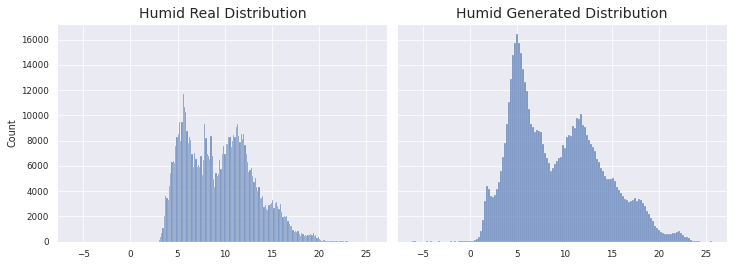

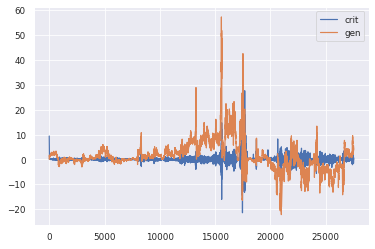

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.0537 - g_loss: -1.7155
Epoch 15/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0317 - g_loss: -2.3377

KL Divergence: 14.588453438636357 bits
Pinball Loss Temp mean: 1.5317807946221695
Pinball Loss Humid mean: 0.5684067399927683
MSE Temp: 3.0635615892443093
MSE Humid: 1.1368134799855432


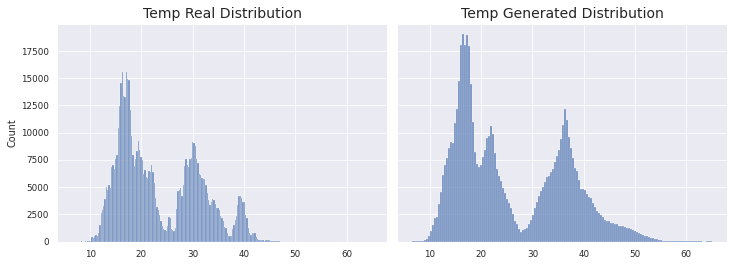

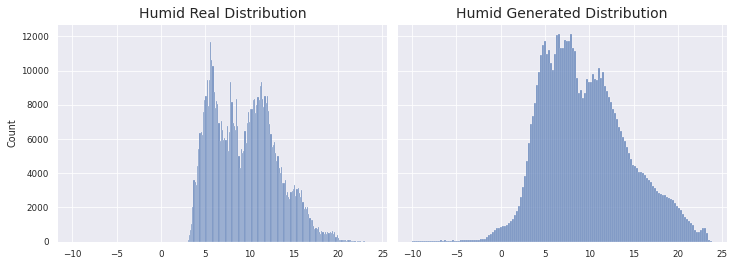

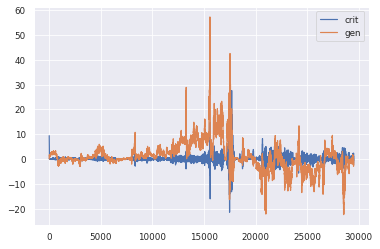

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.0294 - g_loss: -2.3379
Epoch 16/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0275 - g_loss: -4.1235

KL Divergence: 9.814072524714277 bits
Pinball Loss Temp mean: 3.0269367530750015
Pinball Loss Humid mean: 0.5995758719079857
MSE Temp: 6.053873506149975
MSE Humid: 1.1991517438159756


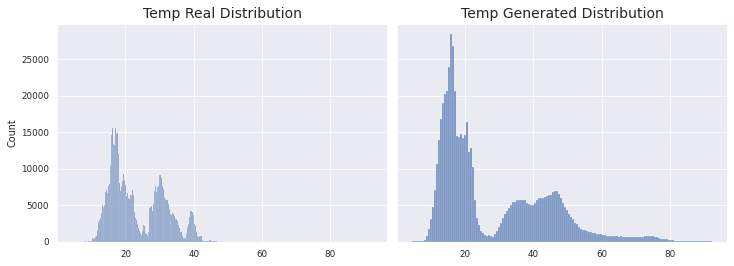

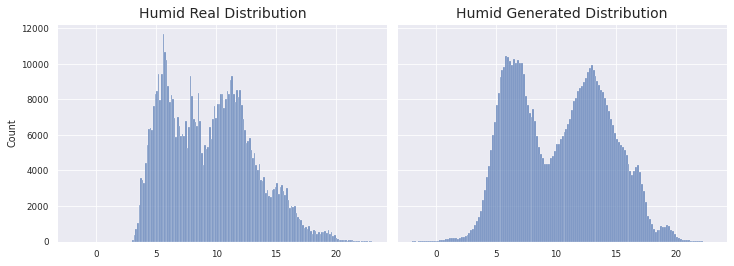

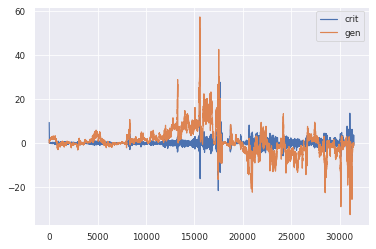

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0313 - g_loss: -4.1199
Epoch 17/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0484 - g_loss: -3.4275

KL Divergence: 20.310024553705105 bits
Pinball Loss Temp mean: 2.67479468097064
Pinball Loss Humid mean: 0.7368856250975064
MSE Temp: 5.349589361941274
MSE Humid: 1.4737712501950349


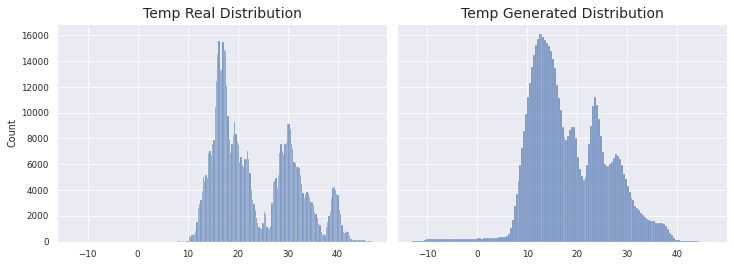

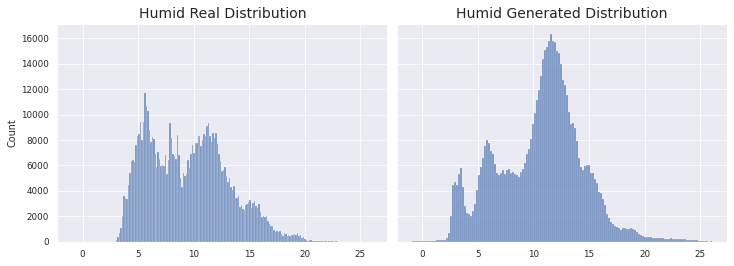

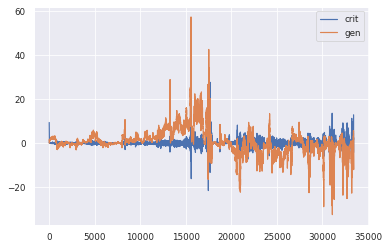

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0615 - g_loss: -3.4361
Epoch 18/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0032 - g_loss: 9.7927

KL Divergence: 8.740002545258031 bits
Pinball Loss Temp mean: 0.8242140775200635
Pinball Loss Humid mean: 0.3074538563472501
MSE Temp: 1.6484281550401034
MSE Humid: 0.6149077126944975


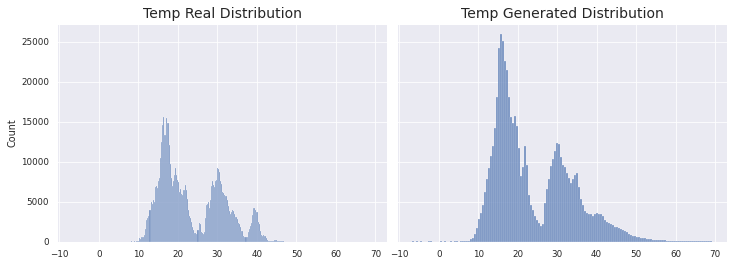

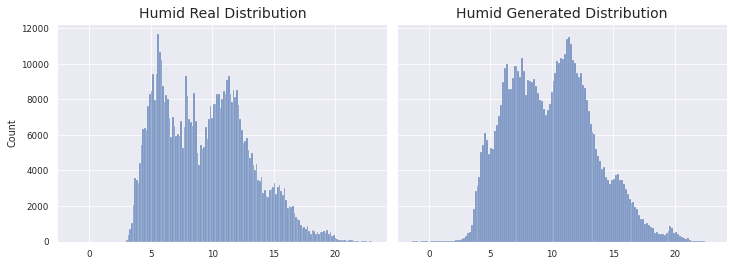

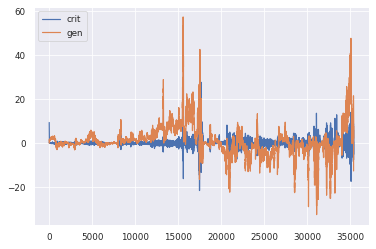

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0029 - g_loss: 9.7700
Epoch 19/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0760 - g_loss: 0.0665

KL Divergence: 4.7943975028076915 bits
Pinball Loss Temp mean: 2.591779562143312
Pinball Loss Humid mean: 0.6365051879339457
MSE Temp: 5.183559124286655
MSE Humid: 1.2730103758678946


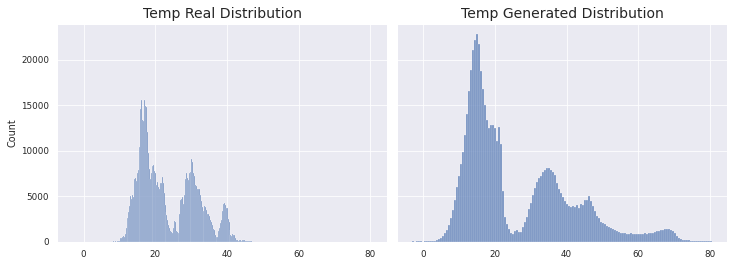

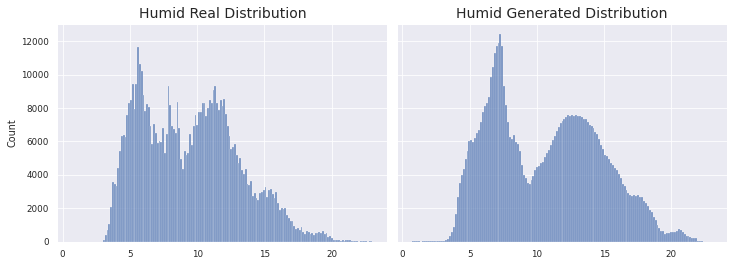

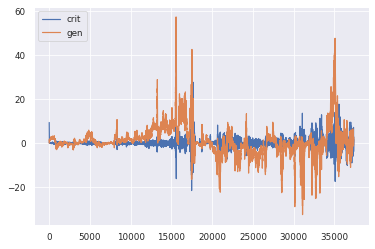

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0832 - g_loss: 0.0688
Epoch 20/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0699 - g_loss: -0.5005

KL Divergence: 21.248538198289193 bits
Pinball Loss Temp mean: 1.25186230610785
Pinball Loss Humid mean: 0.37965235764674676
MSE Temp: 2.5037246122156644
MSE Humid: 0.7593047152934909


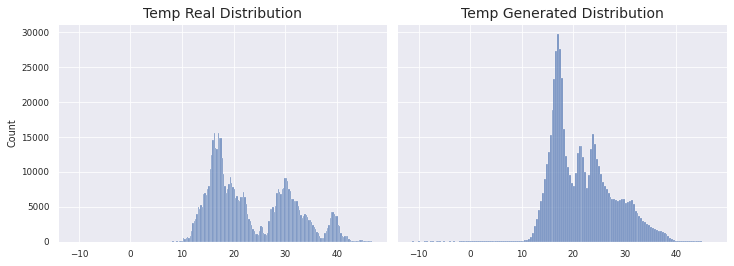

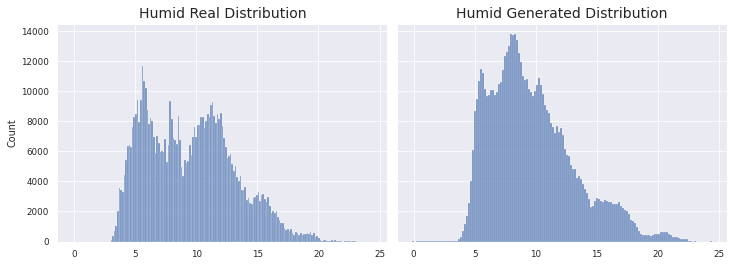

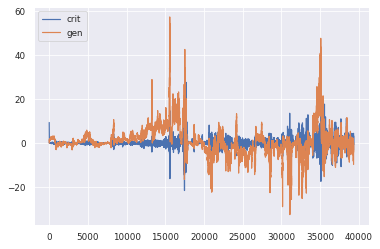

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0744 - g_loss: -0.5098
Epoch 21/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0143 - g_loss: 4.7285

KL Divergence: 14.39369508482135 bits
Pinball Loss Temp mean: 1.680860468231342
Pinball Loss Humid mean: 0.5281658578965064
MSE Temp: 3.3617209364626524
MSE Humid: 1.0563317157929981


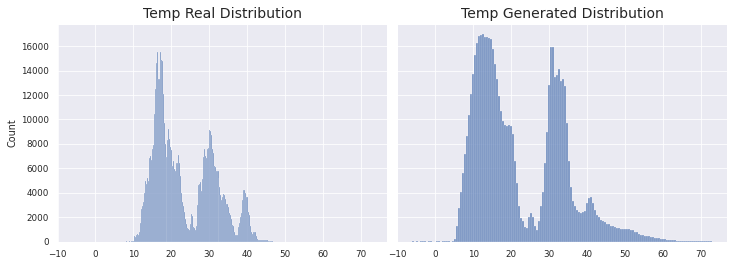

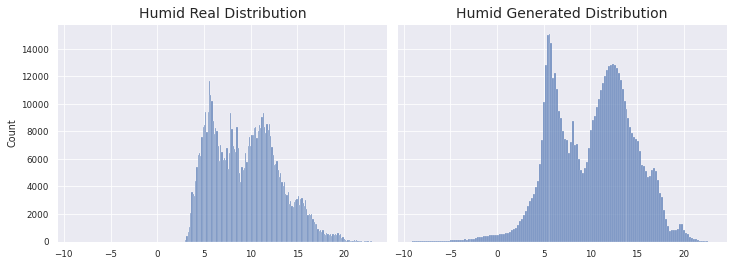

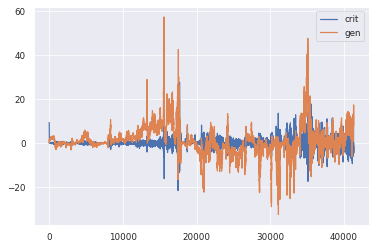

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0098 - g_loss: 4.7413
Epoch 22/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0254 - g_loss: 0.5970

KL Divergence: 17.65322164727199 bits
Pinball Loss Temp mean: 1.093488444061225
Pinball Loss Humid mean: 0.5683229849563896
MSE Temp: 2.1869768881224454
MSE Humid: 1.1366459699127622


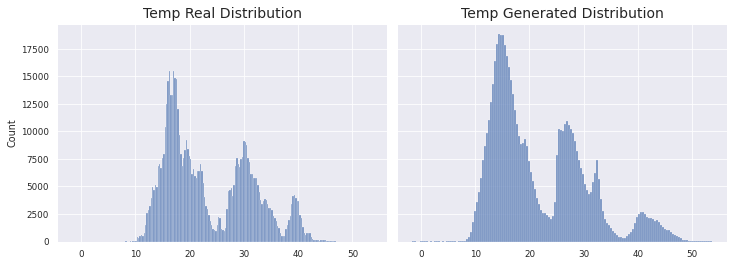

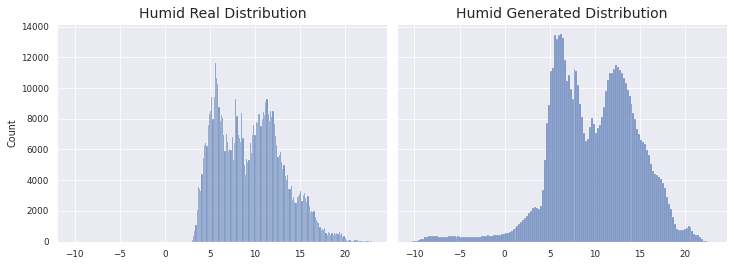

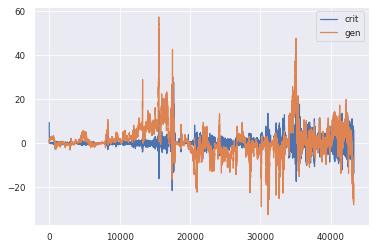

1966/1966 [==============================] - 140s 71ms/step - d_loss: -0.0392 - g_loss: 0.5779
Epoch 23/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0508 - g_loss: -25.9423

KL Divergence: 4.023597337622561 bits
Pinball Loss Temp mean: 0.830129853176342
Pinball Loss Humid mean: 0.7728557859536374
MSE Temp: 1.6602597063526938
MSE Humid: 1.5457115719072687


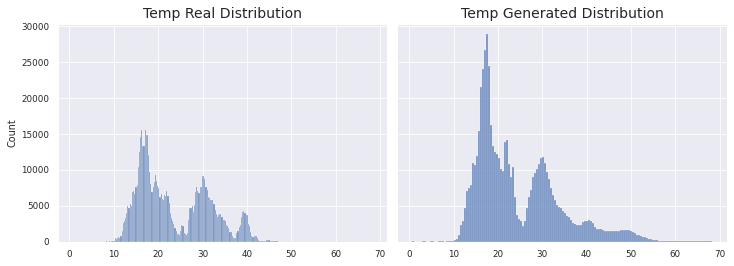

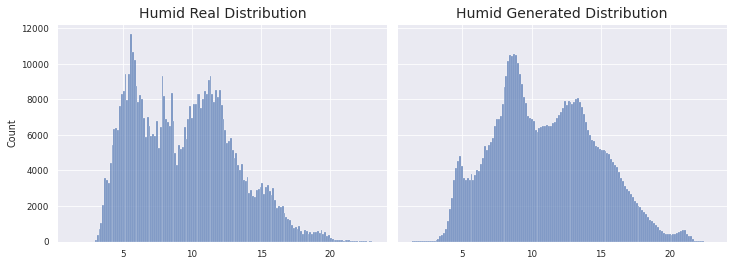

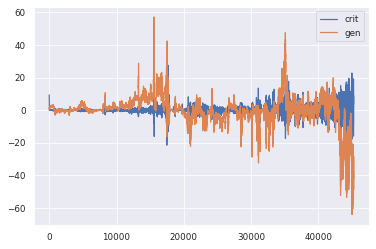

1966/1966 [==============================] - 143s 73ms/step - d_loss: -0.0589 - g_loss: -25.9533
Epoch 24/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0613 - g_loss: -45.5393

KL Divergence: 15.2029141649029 bits
Pinball Loss Temp mean: 0.8454661431410496
Pinball Loss Humid mean: 0.6300027664242247
MSE Temp: 1.6909322862820912
MSE Humid: 1.260005532848459


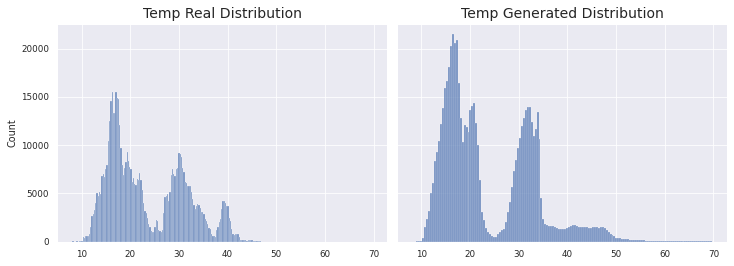

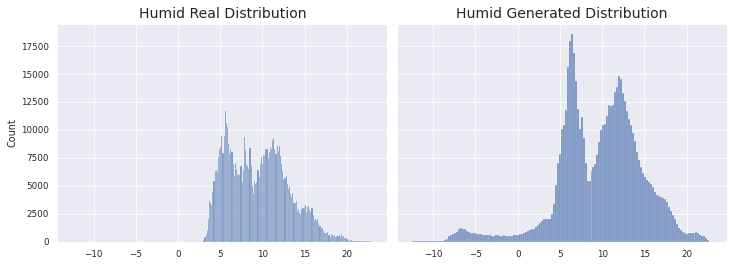

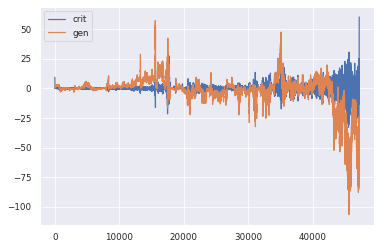

1966/1966 [==============================] - 141s 72ms/step - d_loss: 0.1226 - g_loss: -45.5165
Epoch 25/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0643 - g_loss: -27.9984

KL Divergence: 22.05447602875593 bits
Pinball Loss Temp mean: 1.0751924411408462
Pinball Loss Humid mean: 0.2587900091932527
MSE Temp: 2.1503848822816964
MSE Humid: 0.5175800183865036


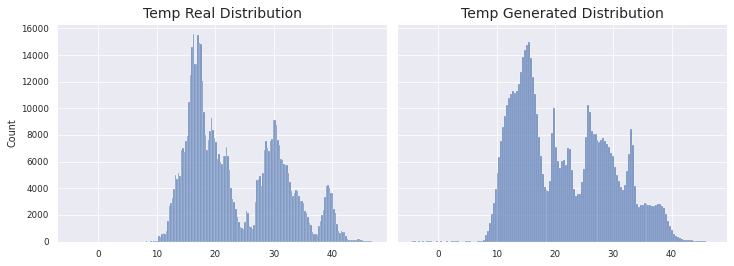

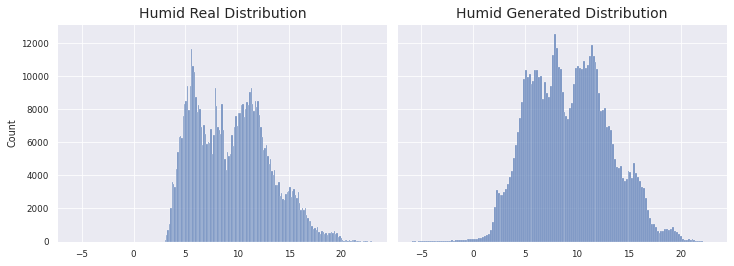

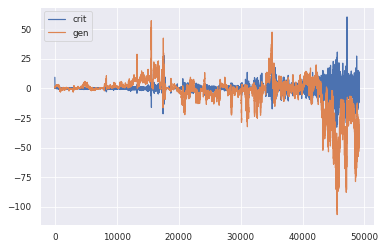

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0672 - g_loss: -28.0076
Epoch 26/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1744 - g_loss: -29.8600

KL Divergence: 3.4482433692862706 bits
Pinball Loss Temp mean: 0.6797657269624634
Pinball Loss Humid mean: 0.6165536938861103
MSE Temp: 1.359531453924942
MSE Humid: 1.2331073877722107


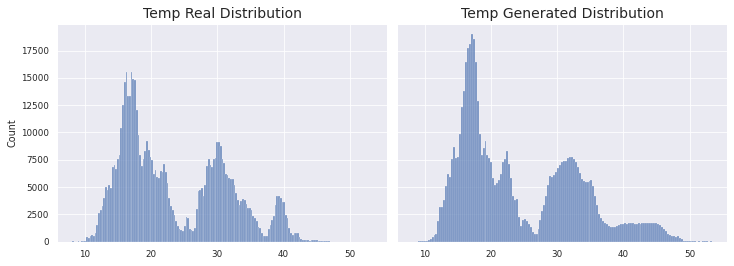

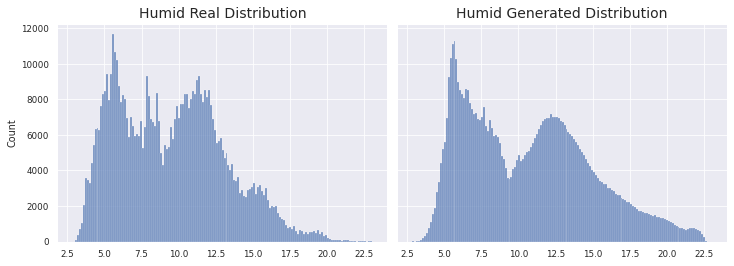

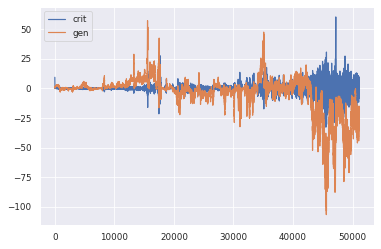

1966/1966 [==============================] - 140s 71ms/step - d_loss: 0.1763 - g_loss: -29.8615
Epoch 27/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0516 - g_loss: -40.6672

KL Divergence: 26.694561573777925 bits
Pinball Loss Temp mean: 1.3360779858902396
Pinball Loss Humid mean: 0.6733290723654187
MSE Temp: 2.672155971780448
MSE Humid: 1.3466581447308297


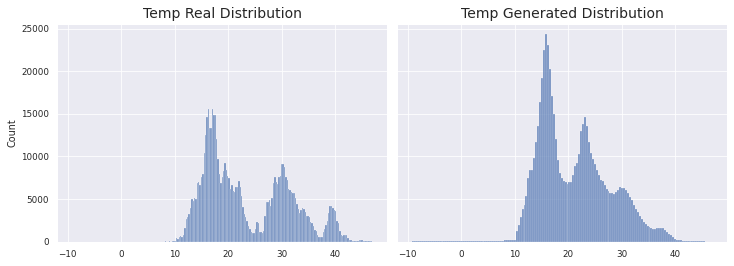

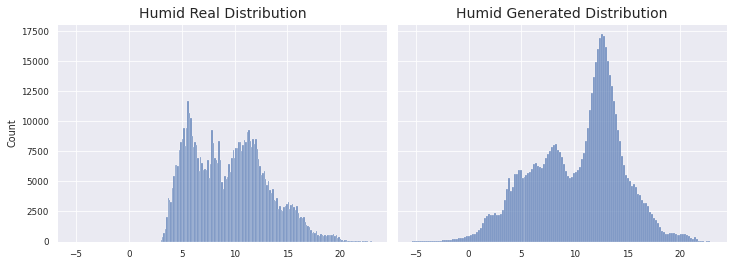

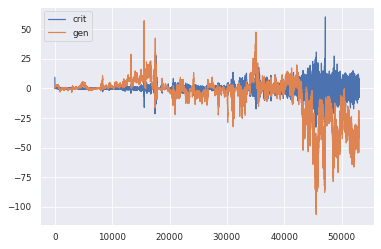

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0544 - g_loss: -40.6807
Epoch 28/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0064 - g_loss: -30.6510

KL Divergence: 24.30232990050615 bits
Pinball Loss Temp mean: 1.5318285345914942
Pinball Loss Humid mean: 0.4345012242232391
MSE Temp: 3.0636570691829887
MSE Humid: 0.8690024484464736


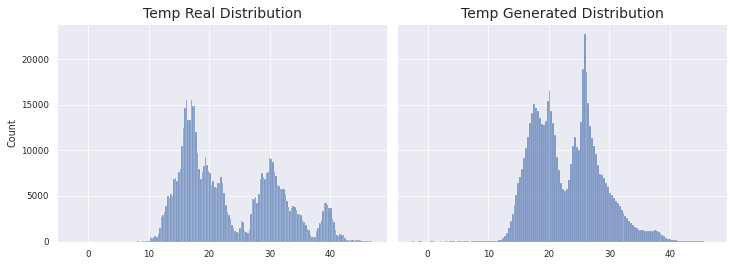

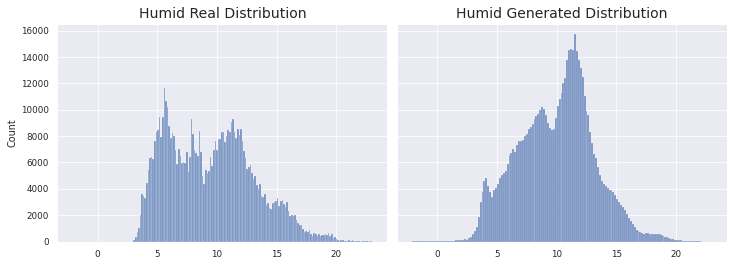

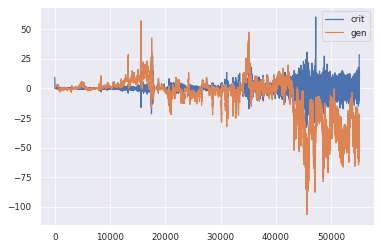

1966/1966 [==============================] - 141s 72ms/step - d_loss: 0.0355 - g_loss: -30.6824
Epoch 29/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1224 - g_loss: -21.4428

KL Divergence: 16.479221293664942 bits
Pinball Loss Temp mean: 0.9043094832196479
Pinball Loss Humid mean: 0.44577934830681026
MSE Temp: 1.8086189664392922
MSE Humid: 0.8915586966136043


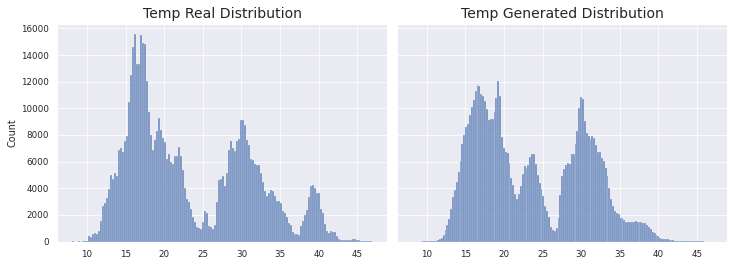

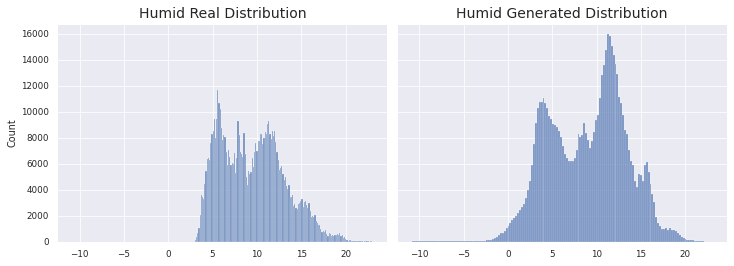

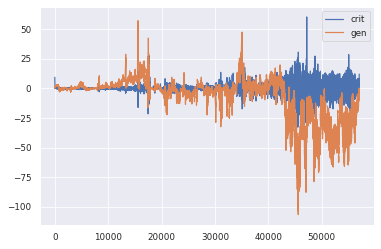

1966/1966 [==============================] - 141s 72ms/step - d_loss: 0.1346 - g_loss: -21.4227
Epoch 30/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0736 - g_loss: -17.5479

KL Divergence: 4.206671308408813 bits
Pinball Loss Temp mean: 1.580231711787853
Pinball Loss Humid mean: 0.5159827147189289
MSE Temp: 3.160463423575701
MSE Humid: 1.0319654294378697


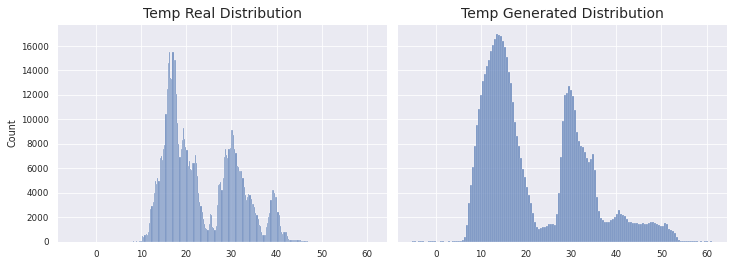

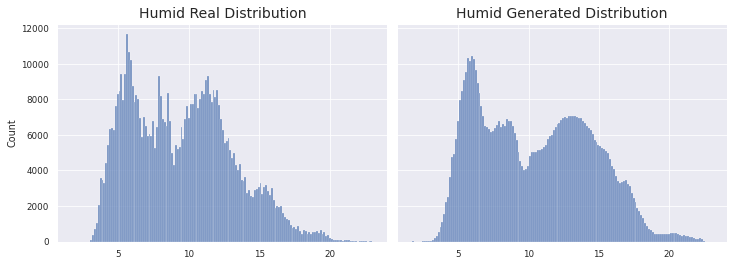

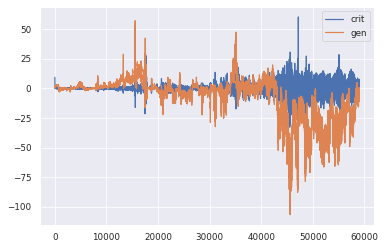

1966/1966 [==============================] - 141s 72ms/step - d_loss: 0.0813 - g_loss: -17.5295
Epoch 31/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0158 - g_loss: -7.0551

KL Divergence: 11.809889864859706 bits
Pinball Loss Temp mean: 1.4501501441772597
Pinball Loss Humid mean: 0.45822373470188377
MSE Temp: 2.900300288354506
MSE Humid: 0.9164474694037589


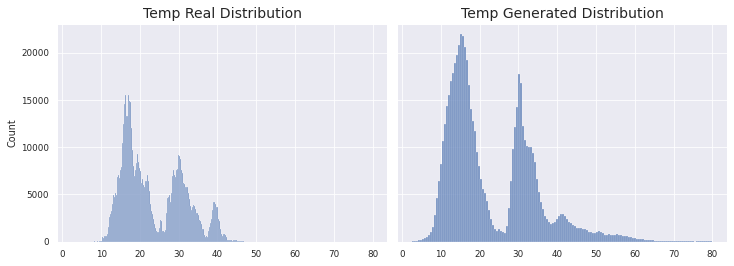

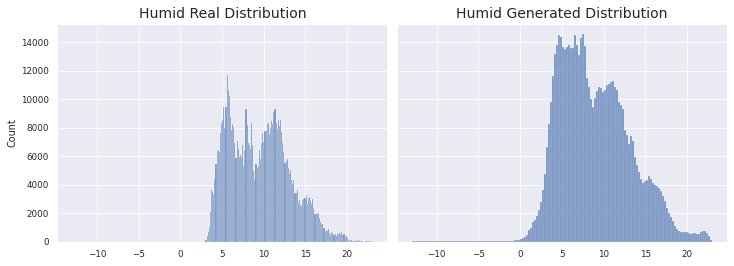

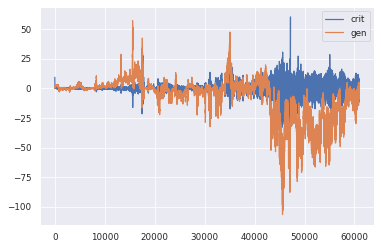

1966/1966 [==============================] - 139s 71ms/step - d_loss: 0.0044 - g_loss: -7.0424
Epoch 32/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0012 - g_loss: 11.5685

KL Divergence: 2.780111288377866 bits
Pinball Loss Temp mean: 0.7810591741376228
Pinball Loss Humid mean: 0.49798063413905735
MSE Temp: 1.562118348275274
MSE Humid: 0.9959612682781231


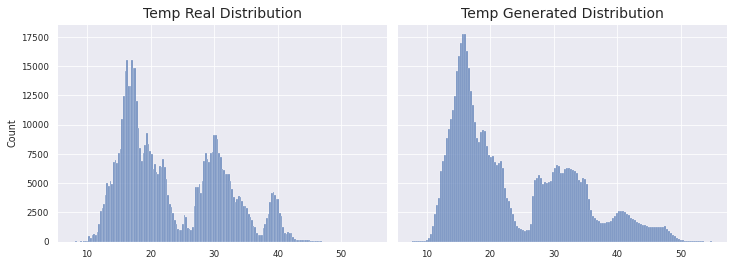

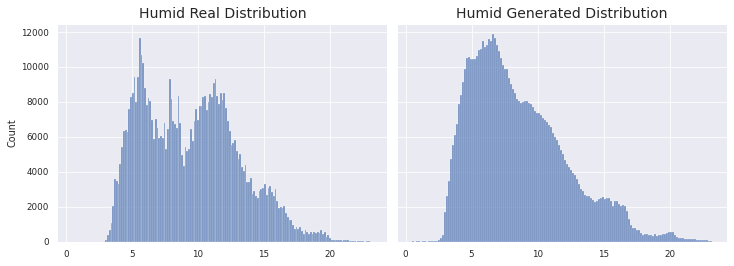

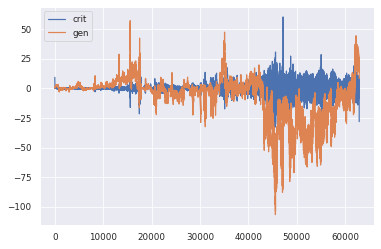

1966/1966 [==============================] - 140s 71ms/step - d_loss: -0.0297 - g_loss: 11.5652
Epoch 33/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0409 - g_loss: 30.1775

KL Divergence: 18.304170228550973 bits
Pinball Loss Temp mean: 1.0142023850779593
Pinball Loss Humid mean: 0.6164869169320195
MSE Temp: 2.028404770155941
MSE Humid: 1.232973833864021


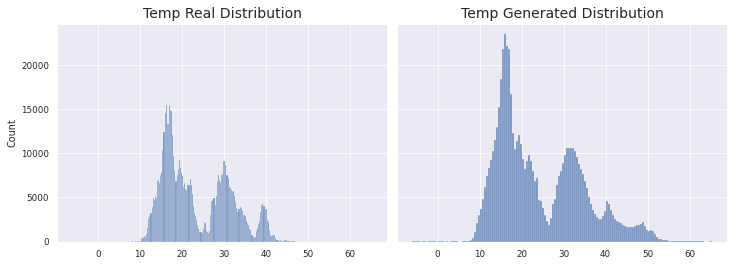

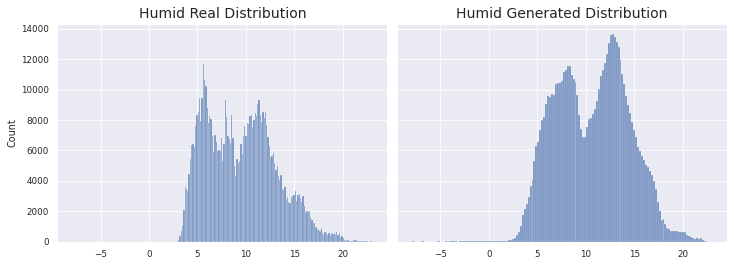

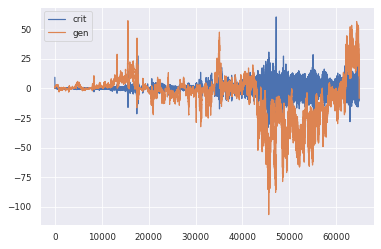

1966/1966 [==============================] - 139s 71ms/step - d_loss: 0.0440 - g_loss: 30.1383
Epoch 34/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0232 - g_loss: 27.7658

KL Divergence: 13.467107225606965 bits
Pinball Loss Temp mean: 0.812886211943766
Pinball Loss Humid mean: 0.40495449350109214
MSE Temp: 1.6257724238875428
MSE Humid: 0.8099089870021813


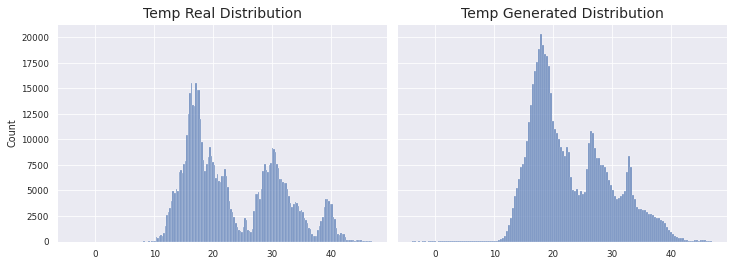

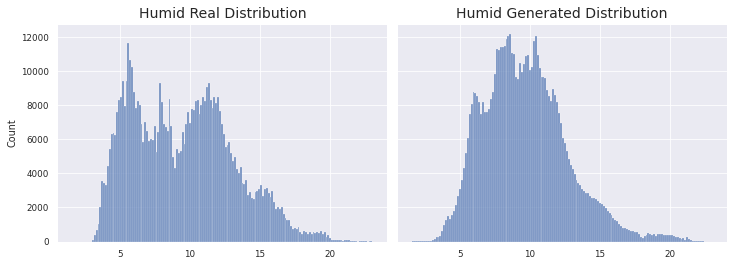

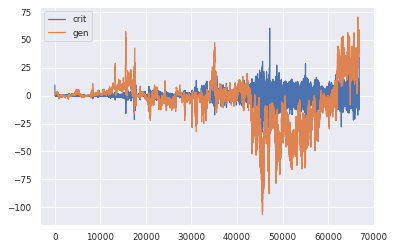

1966/1966 [==============================] - 140s 71ms/step - d_loss: 0.0582 - g_loss: 27.7794
Epoch 35/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0490 - g_loss: 39.3700

KL Divergence: 15.6558244595575 bits
Pinball Loss Temp mean: 0.6171520531365713
Pinball Loss Humid mean: 0.3228155655654626
MSE Temp: 1.2343041062731508
MSE Humid: 0.6456311311309213


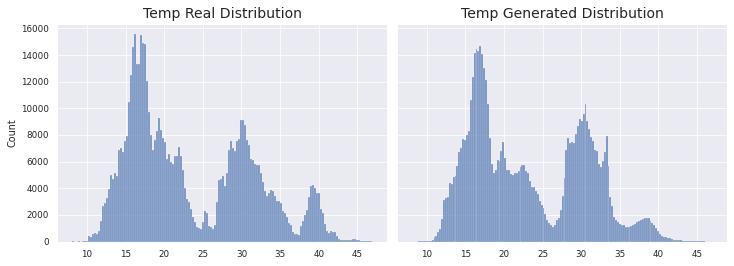

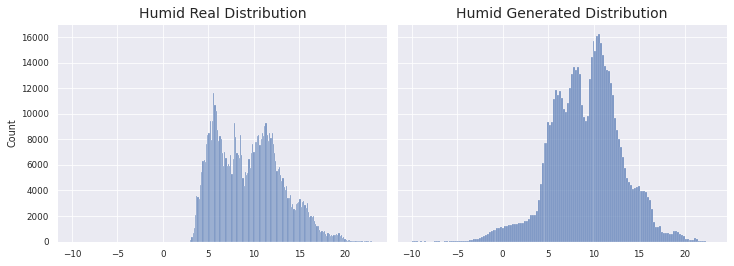

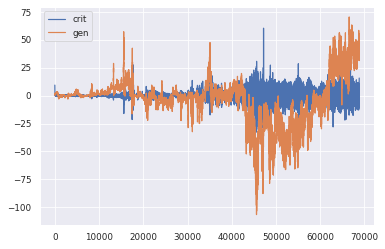

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.0649 - g_loss: 39.3619
Epoch 36/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0847 - g_loss: 41.4654

KL Divergence: 17.39920209856199 bits
Pinball Loss Temp mean: 0.7680503646270402
Pinball Loss Humid mean: 0.6039561350598459
MSE Temp: 1.5361007292540778
MSE Humid: 1.2079122701197083


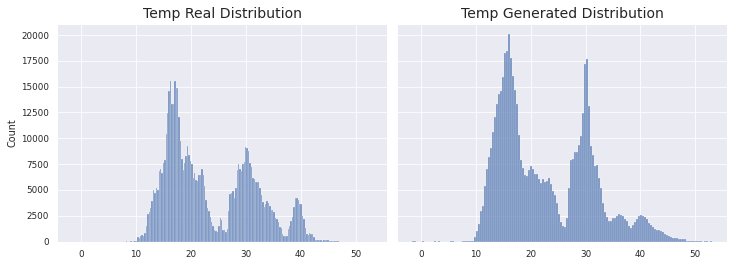

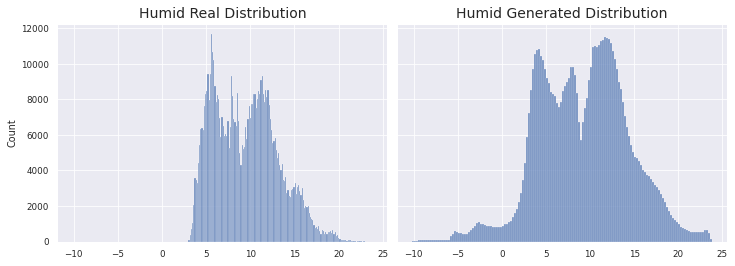

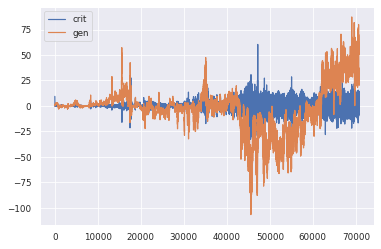

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0990 - g_loss: 41.4465
Epoch 37/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0885 - g_loss: 43.1450

KL Divergence: 20.545053484564466 bits
Pinball Loss Temp mean: 1.24338340316833
Pinball Loss Humid mean: 0.4220744181509494
MSE Temp: 2.486766806336656
MSE Humid: 0.8441488363019015


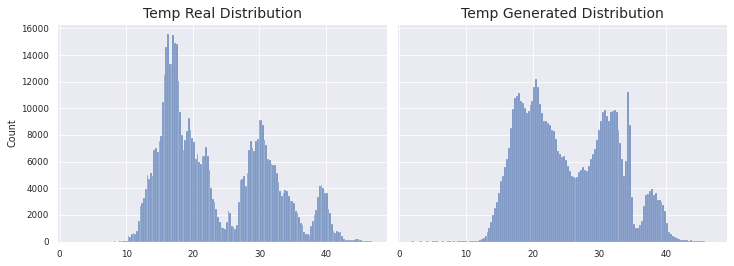

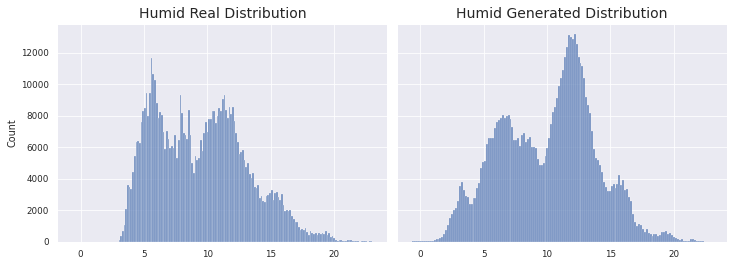

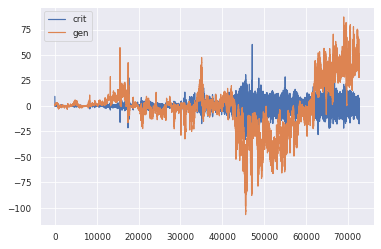

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0708 - g_loss: 43.1678
Epoch 38/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0995 - g_loss: 50.4619

KL Divergence: 11.125621236699448 bits
Pinball Loss Temp mean: 0.9928471847847422
Pinball Loss Humid mean: 0.6651602959998458
MSE Temp: 1.985694369569519
MSE Humid: 1.3303205919997105


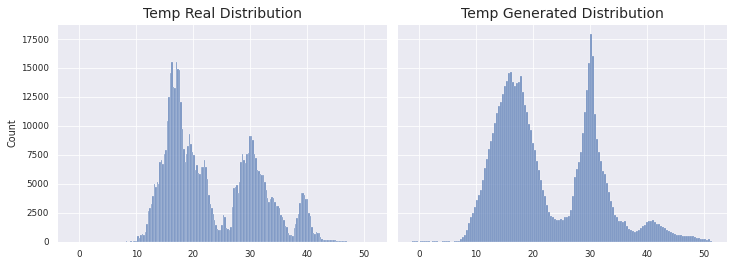

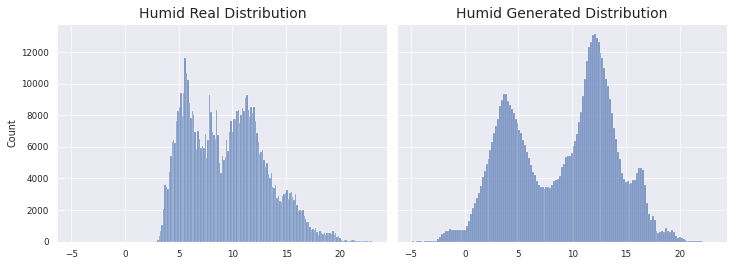

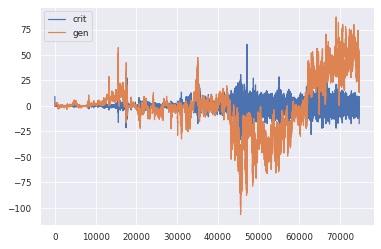

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0817 - g_loss: 50.4242
Epoch 39/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0598 - g_loss: 39.1693

KL Divergence: 13.150561715098245 bits
Pinball Loss Temp mean: 0.6318665239324484
Pinball Loss Humid mean: 0.4513323644219739
MSE Temp: 1.2637330478649187
MSE Humid: 0.9026647288439478


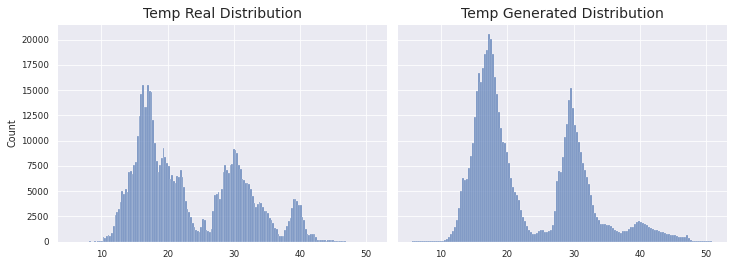

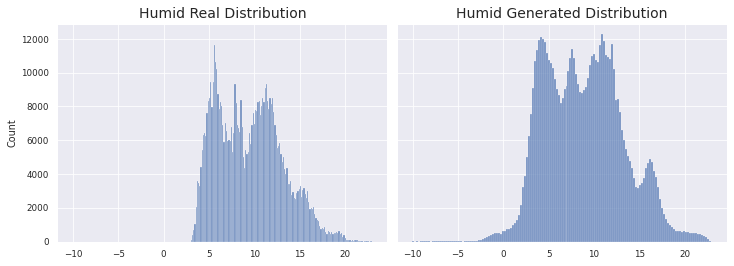

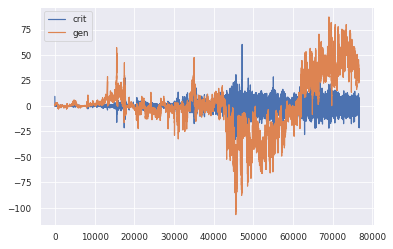

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0381 - g_loss: 39.1581
Epoch 40/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0080 - g_loss: 26.9601

KL Divergence: 2.569216956709311 bits
Pinball Loss Temp mean: 0.6224098484755182
Pinball Loss Humid mean: 0.4542015923428247
MSE Temp: 1.2448196969510334
MSE Humid: 0.908403184685651


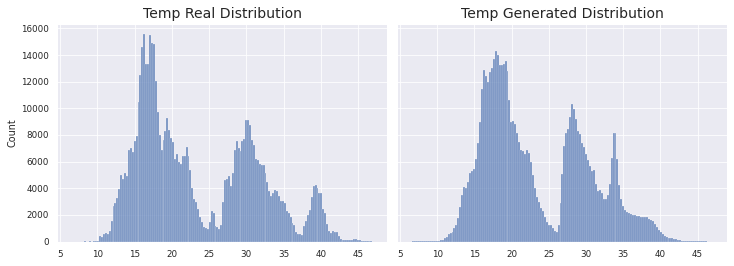

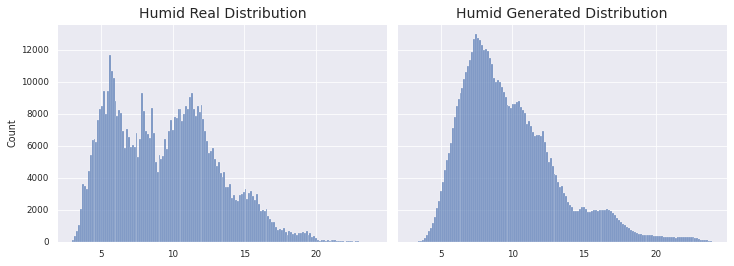

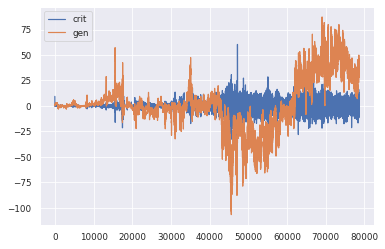

1966/1966 [==============================] - 147s 75ms/step - d_loss: -0.0135 - g_loss: 26.9799
Epoch 41/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1006 - g_loss: 26.3336

KL Divergence: 3.298299383086049 bits
Pinball Loss Temp mean: 1.1472238454180474
Pinball Loss Humid mean: 0.31381238214750845
MSE Temp: 2.2944476908361144
MSE Humid: 0.6276247642950065


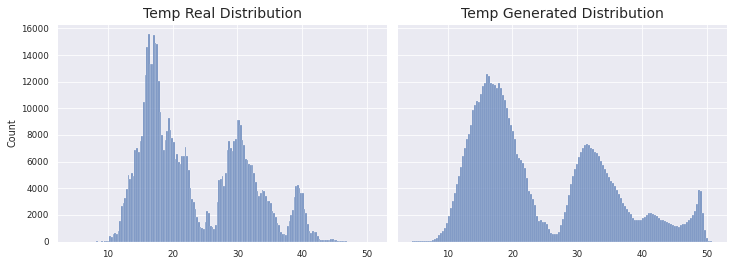

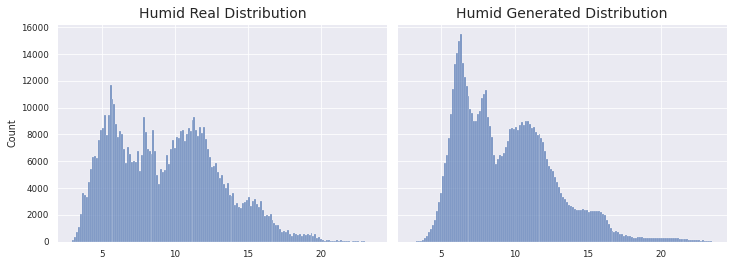

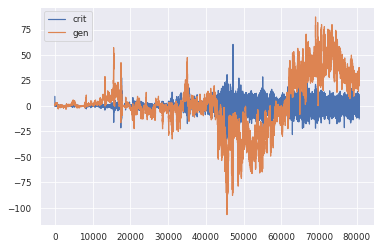

1966/1966 [==============================] - 146s 74ms/step - d_loss: 0.0875 - g_loss: 26.3271
Epoch 42/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0475 - g_loss: 28.0402

KL Divergence: 2.908379679873627 bits
Pinball Loss Temp mean: 0.7827313284352783
Pinball Loss Humid mean: 0.2308193716876922
MSE Temp: 1.5654626568705443
MSE Humid: 0.46163874337538063


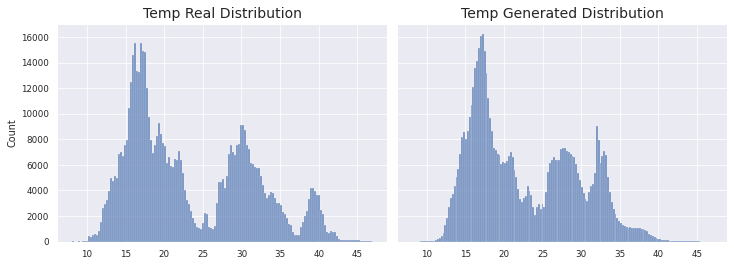

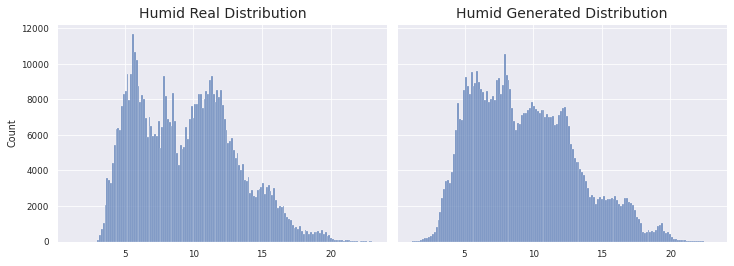

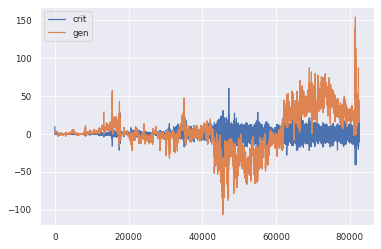

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0651 - g_loss: 28.0402
Epoch 43/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1692 - g_loss: 8.8069
Better KL
>43 MODELS HAVE BEEN SAVED


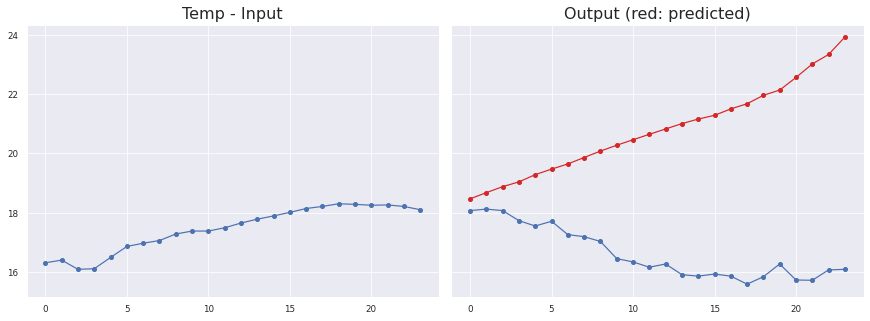

Sensor #31.0
Temp
MAE: 4.1783439188947264 ± 2.2491203055492663
MSE: 22.517100053398575
RMSE: 4.7452186518008395
Max Error: 7.830308350920678


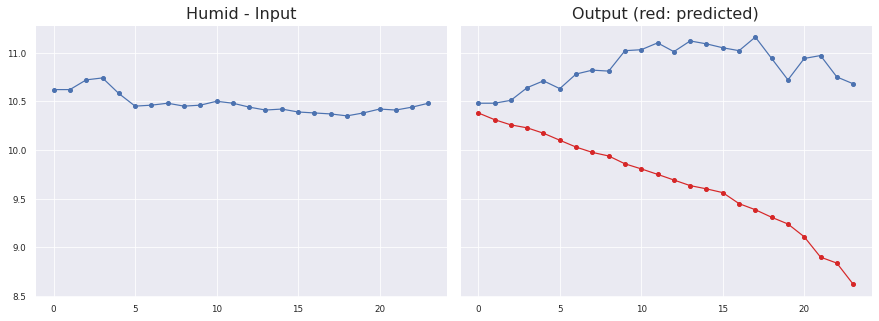

Sensor #31.0
Humid
MAE: 1.1804963341852022 ± 0.5962455520366384
MSE: 1.7490803533481767
RMSE: 1.3225280160919755
Max Error: 2.071676114797592


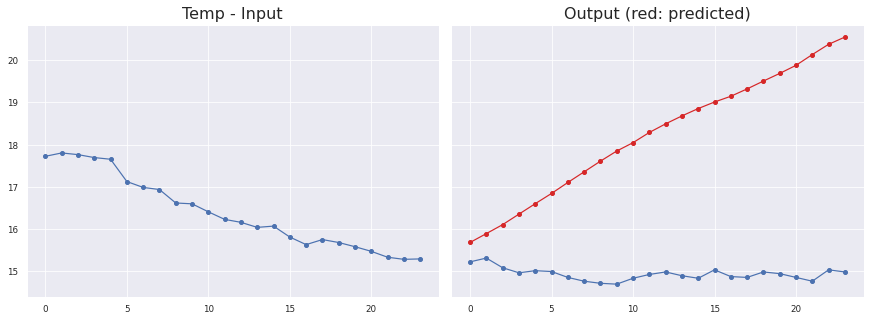

Sensor #34.0
Temp
MAE: 3.3018818728129062 ± 1.5173137822444884
MSE: 13.204665015799542
RMSE: 3.633822369874392
Max Error: 5.585796208381648


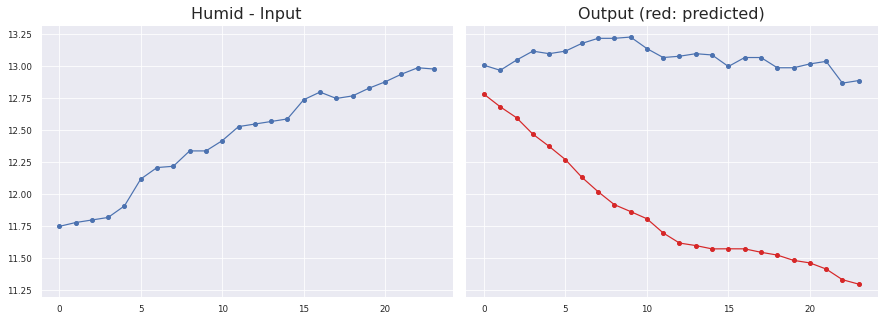

Sensor #34.0
Humid
MAE: 1.2077535655349487 ± 0.42532370828021376
MSE: 1.6395689318876139
RMSE: 1.2804565326037483
Max Error: 1.6233449472486967


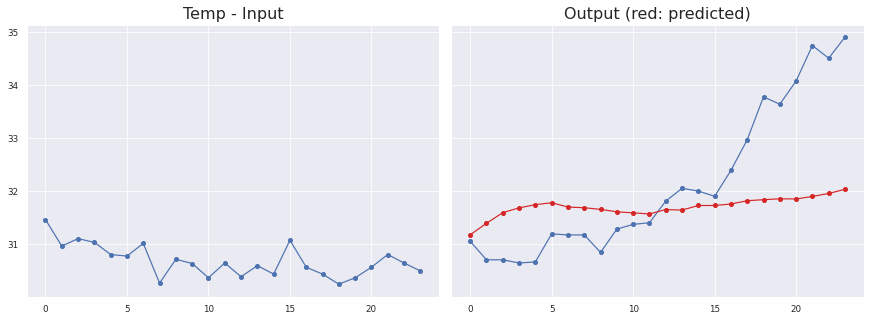

Sensor #0.0
Temp
MAE: 1.0013692617913077 ± 1.257845452647383
MSE: 1.7582335235533455
RMSE: 1.325983983143592
Max Error: 2.877506337761872


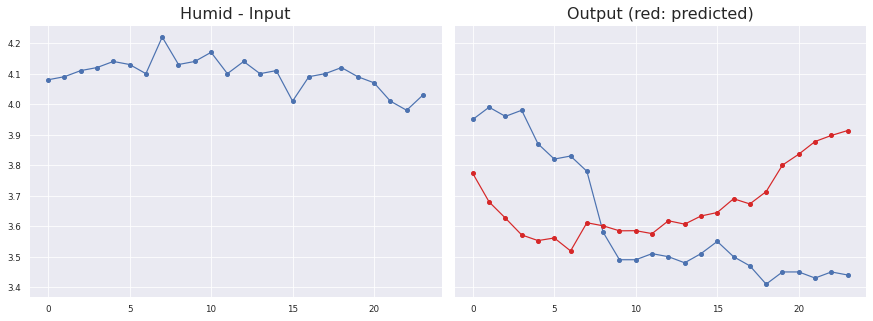

Sensor #0.0
Humid
MAE: 0.2427382838229338 ± 0.2720001410879039
MSE: 0.07671887010348229
RMSE: 0.27698171438469055
Max Error: 0.473532099425793


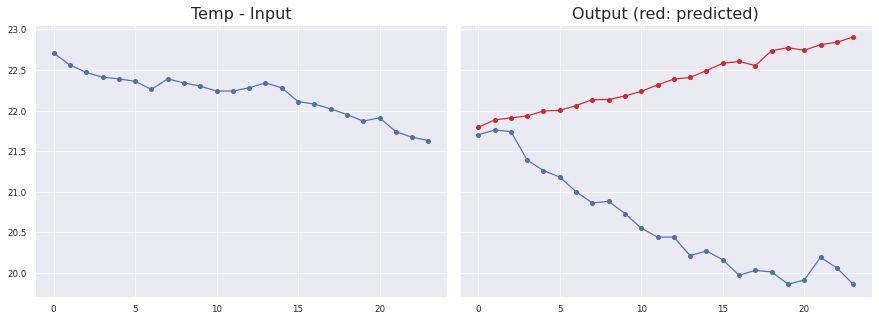

Sensor #2.0
Temp
MAE: 1.7482054760058716 ± 0.9481334671427565
MSE: 3.955179457853061
RMSE: 1.9887632985986696
Max Error: 3.045352317690849


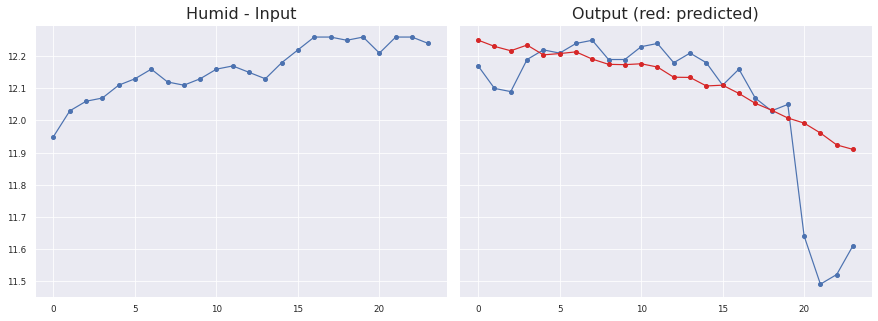

Sensor #2.0
Humid
MAE: 0.10416327420622122 ± 0.15828058063147427
MSE: 0.02810243438803509
RMSE: 0.1676378071558892
Max Error: 0.47097317427396845

KL Divergence: 1.7056947561979765 bits
Pinball Loss Temp mean: 1.0217926460388234
Pinball Loss Humid mean: 0.5242850921807176
MSE Temp: 2.0435852920776494
MSE Humid: 1.0485701843614261


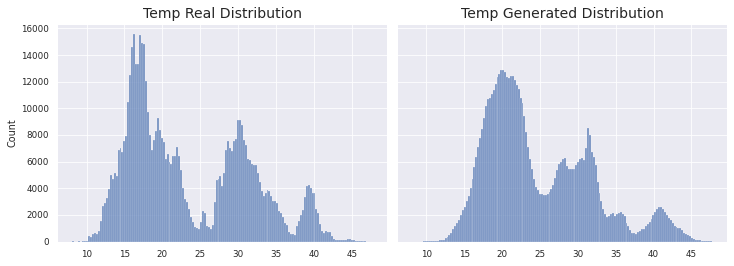

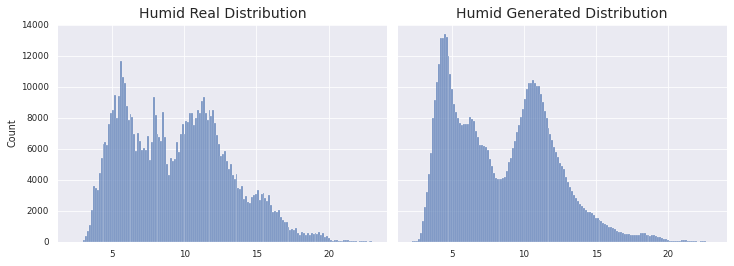

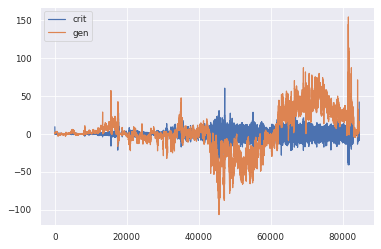

1966/1966 [==============================] - 148s 75ms/step - d_loss: 0.2118 - g_loss: 8.8094
Epoch 44/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0119 - g_loss: 12.4085

KL Divergence: 11.12178791193808 bits
Pinball Loss Temp mean: 0.8451256414501624
Pinball Loss Humid mean: 0.5514782555734843
MSE Temp: 1.6902512829003389
MSE Humid: 1.102956511146952


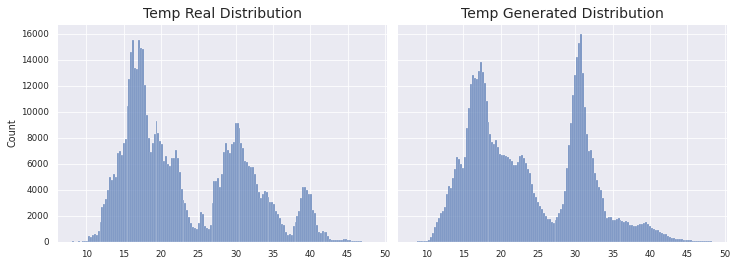

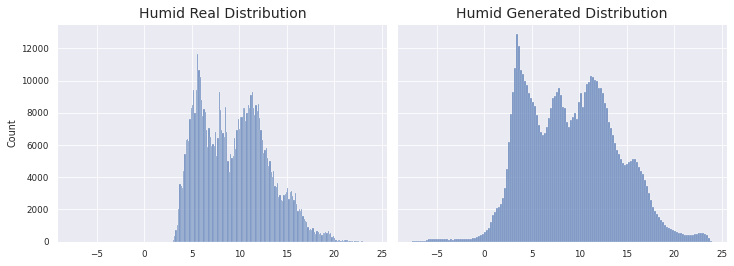

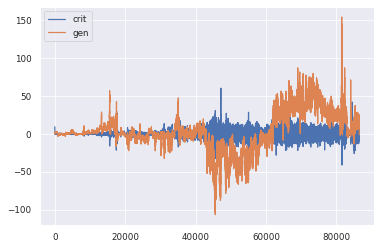

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.0072 - g_loss: 12.4016
Epoch 45/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0565 - g_loss: 16.7877

KL Divergence: 12.184772568490121 bits
Pinball Loss Temp mean: 1.1935335611954256
Pinball Loss Humid mean: 0.7852409699145629
MSE Temp: 2.3870671223908495
MSE Humid: 1.5704819398291412


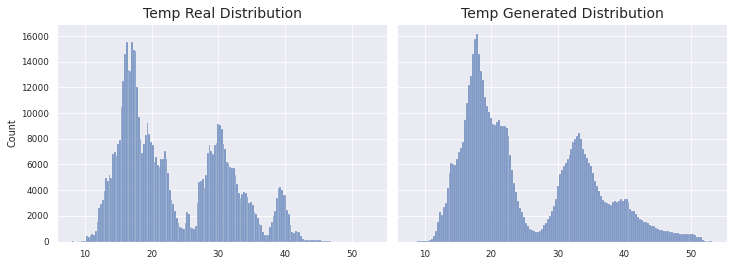

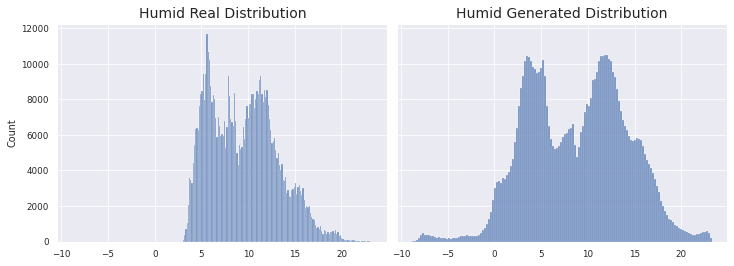

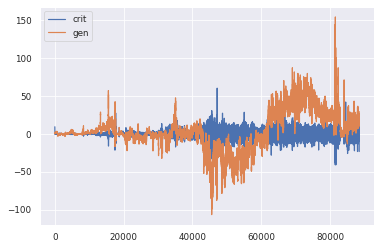

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.0328 - g_loss: 16.8006
Epoch 46/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 4.3843e-04 - g_loss: 7.2514

KL Divergence: 14.53621949290218 bits
Pinball Loss Temp mean: 0.7777434801220486
Pinball Loss Humid mean: 0.3108396348511394
MSE Temp: 1.555486960244112
MSE Humid: 0.6216792697022875


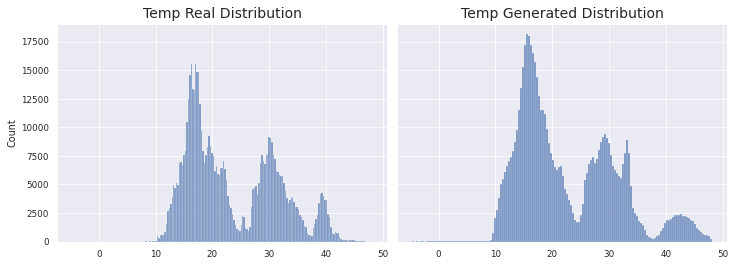

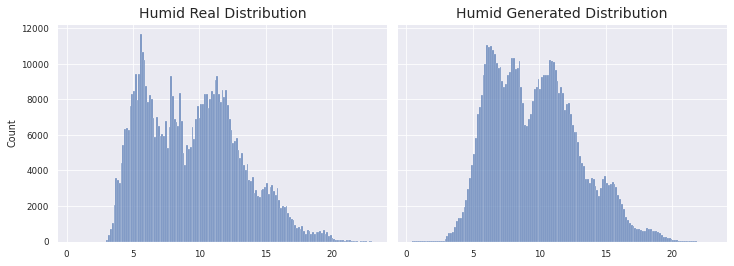

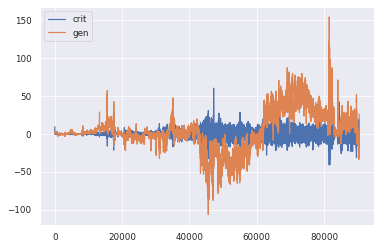

1966/1966 [==============================] - 146s 74ms/step - d_loss: -0.0055 - g_loss: 7.2709
Epoch 47/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0627 - g_loss: -28.5708

KL Divergence: 12.276179161749095 bits
Pinball Loss Temp mean: 1.3955638005888713
Pinball Loss Humid mean: 1.008221257377949
MSE Temp: 2.7911276011777653
MSE Humid: 2.0164425147558904


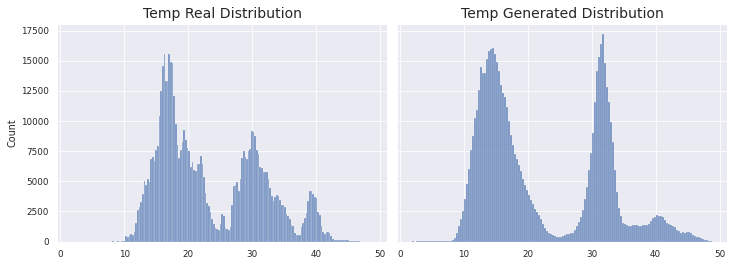

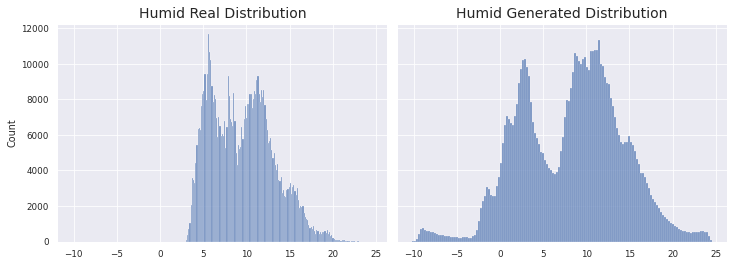

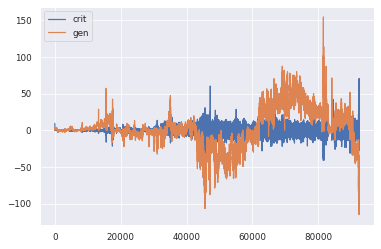

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.0089 - g_loss: -28.6335
Epoch 48/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1602 - g_loss: -25.1011

KL Divergence: 4.2186005997750815 bits
Pinball Loss Temp mean: 1.712008329111446
Pinball Loss Humid mean: 2.7037646141003617
MSE Temp: 3.424016658222964
MSE Humid: 5.407529228200568


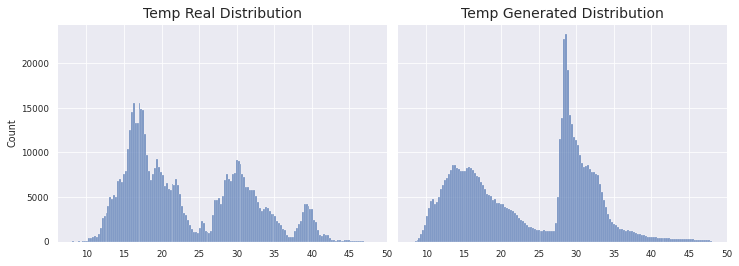

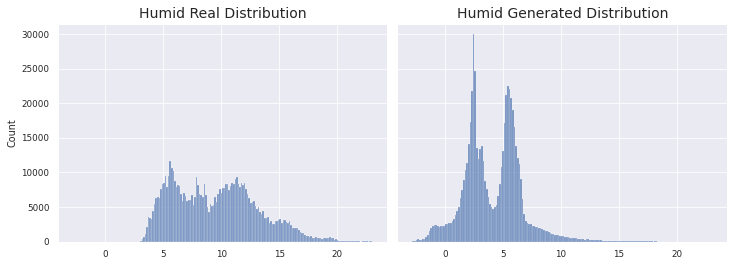

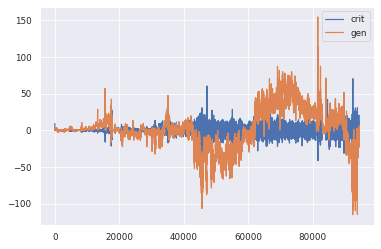

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.1407 - g_loss: -25.0682
Epoch 49/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0572 - g_loss: -5.9180

KL Divergence: 9.502631486085239 bits
Pinball Loss Temp mean: 0.7786218126158089
Pinball Loss Humid mean: 0.40379133665991274
MSE Temp: 1.5572436252315958
MSE Humid: 0.8075826733198449


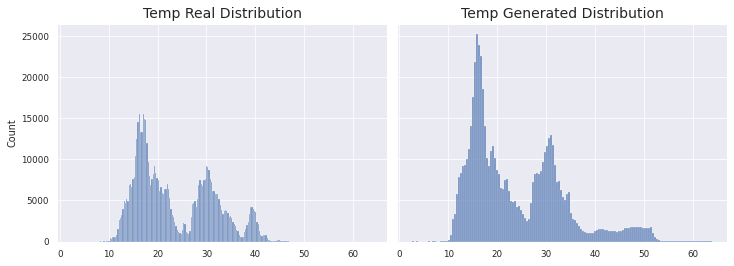

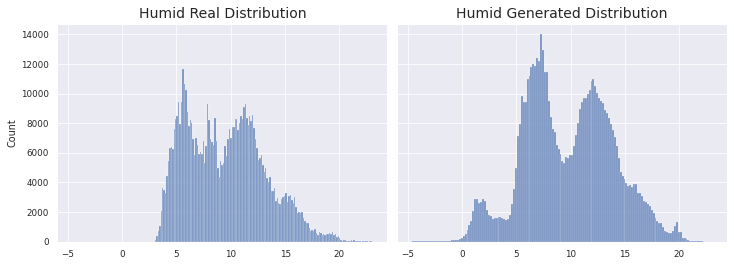

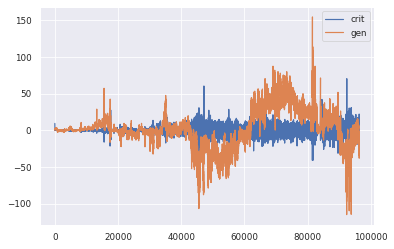

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.0563 - g_loss: -5.9289
Epoch 50/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2940 - g_loss: -13.9398

KL Divergence: 6.754404808365844 bits
Pinball Loss Temp mean: 3.588356489211557
Pinball Loss Humid mean: 2.363872503079777
MSE Temp: 7.176712978423224
MSE Humid: 4.72774500615958


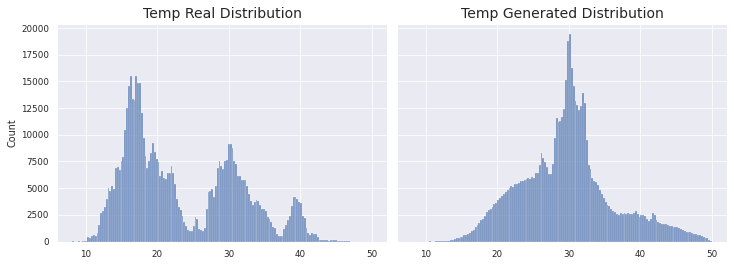

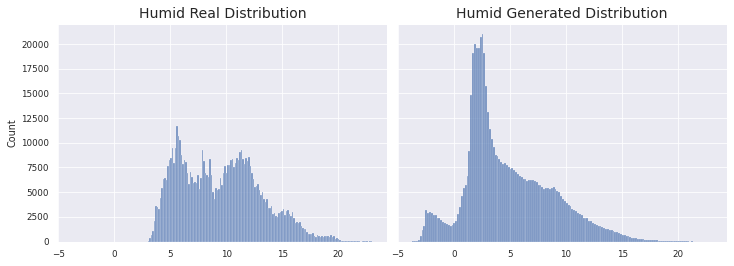

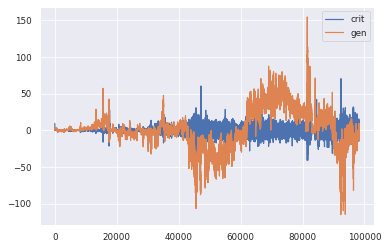

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.2927 - g_loss: -13.9262
Epoch 51/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1209 - g_loss: 24.2808

KL Divergence: 9.697853480424468 bits
Pinball Loss Temp mean: 1.3026217768257493
Pinball Loss Humid mean: 0.33983359808703206
MSE Temp: 2.6052435536515017
MSE Humid: 0.6796671961740637


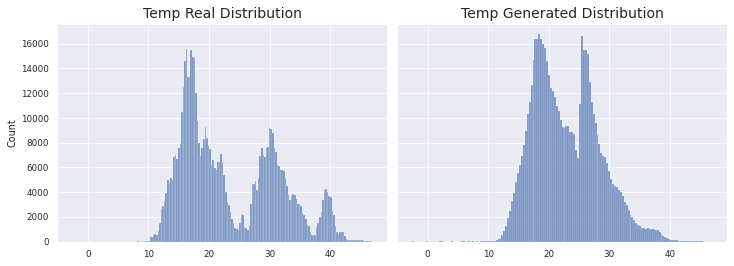

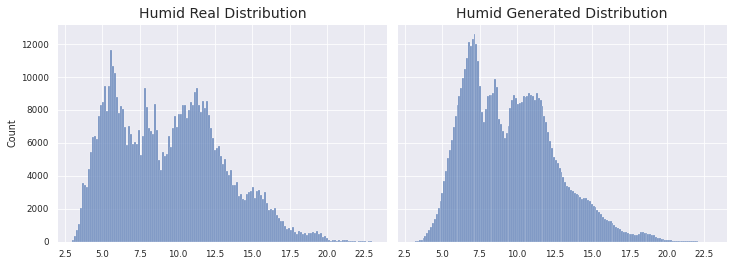

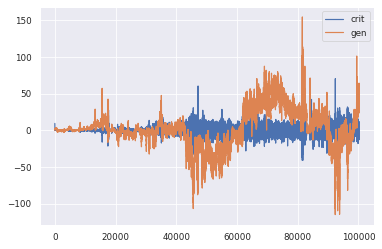

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.1260 - g_loss: 24.2943
Epoch 52/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0144 - g_loss: 40.5740

KL Divergence: 6.568029373452854 bits
Pinball Loss Temp mean: 1.3585771220850793
Pinball Loss Humid mean: 0.8392714405031618
MSE Temp: 2.717154244170181
MSE Humid: 1.6785428810063272


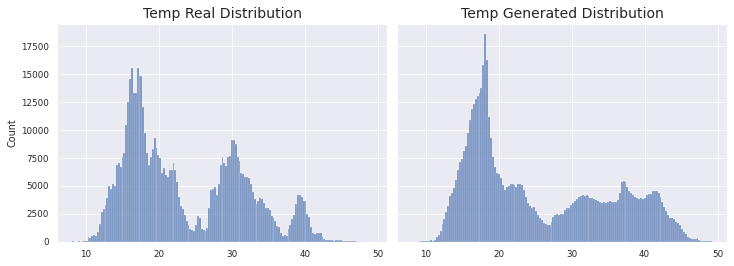

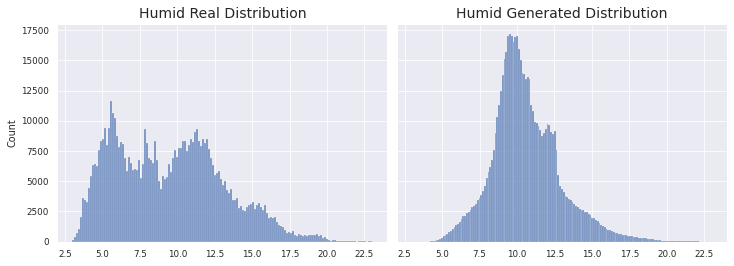

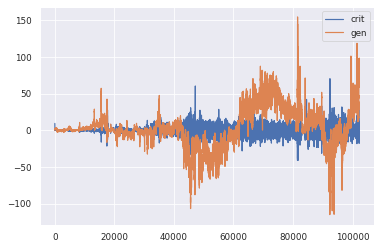

1966/1966 [==============================] - 140s 71ms/step - d_loss: 0.0174 - g_loss: 40.6325
Epoch 53/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0452 - g_loss: 49.5403

KL Divergence: 4.0490150562889315 bits
Pinball Loss Temp mean: 1.1696692694475797
Pinball Loss Humid mean: 0.2534985370216732
MSE Temp: 2.3393385388951335
MSE Humid: 0.5069970740433477


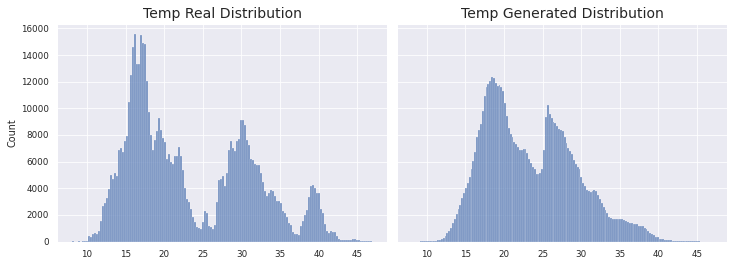

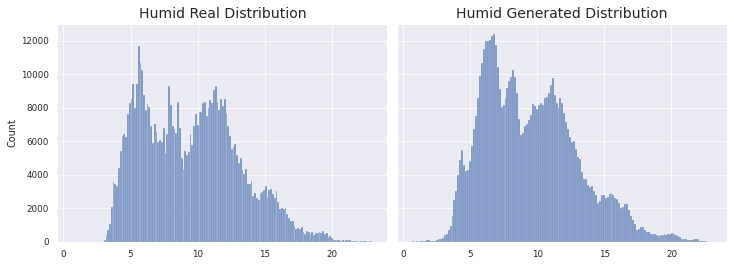

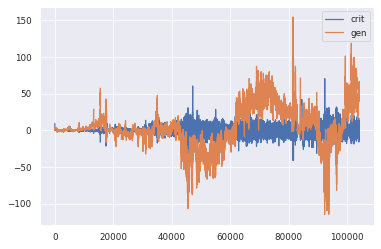

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.0412 - g_loss: 49.5525
Epoch 54/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0635 - g_loss: 37.6050

KL Divergence: 10.362250031443942 bits
Pinball Loss Temp mean: 1.2866280074104401
Pinball Loss Humid mean: 1.1046639885176364
MSE Temp: 2.573256014820866
MSE Humid: 2.209327977035285


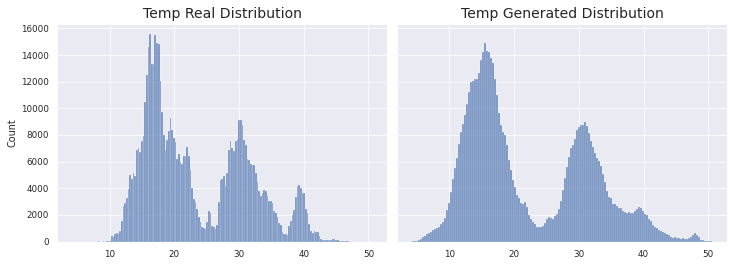

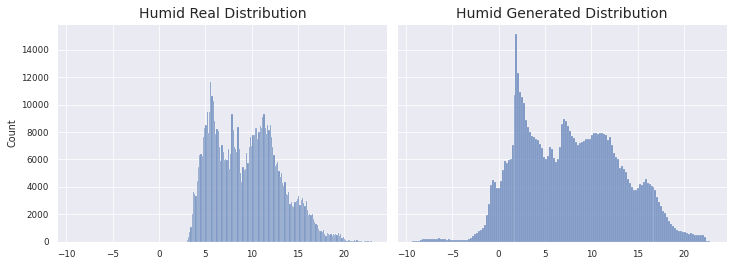

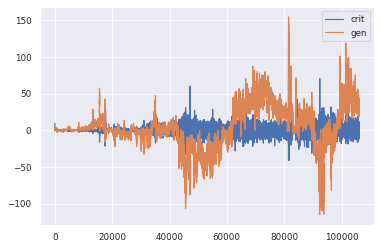

1966/1966 [==============================] - 141s 72ms/step - d_loss: 0.0548 - g_loss: 37.6078
Epoch 55/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0630 - g_loss: 28.8724

KL Divergence: 12.615219960124435 bits
Pinball Loss Temp mean: 1.2236897213105973
Pinball Loss Humid mean: 0.34754839094177487
MSE Temp: 2.4473794426212403
MSE Humid: 0.6950967818835532


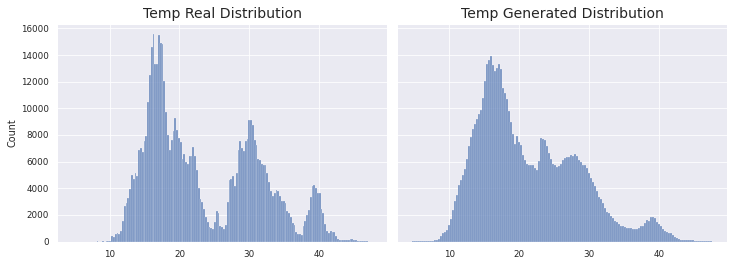

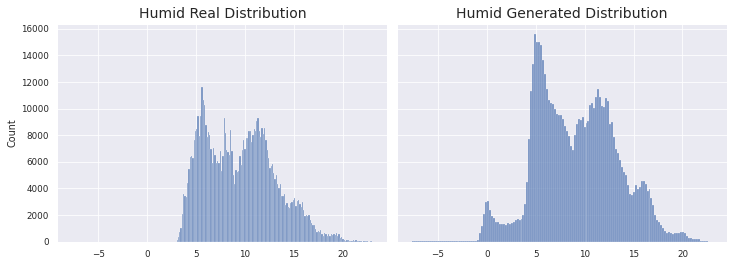

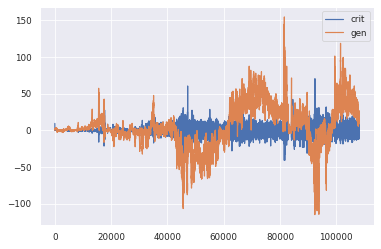

1966/1966 [==============================] - 146s 74ms/step - d_loss: 0.0756 - g_loss: 28.8639
Epoch 56/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0574 - g_loss: 40.8455

KL Divergence: 3.0109188052223046 bits
Pinball Loss Temp mean: 1.0135484228364449
Pinball Loss Humid mean: 0.4070248146387473
MSE Temp: 2.027096845672875
MSE Humid: 0.8140496292774891


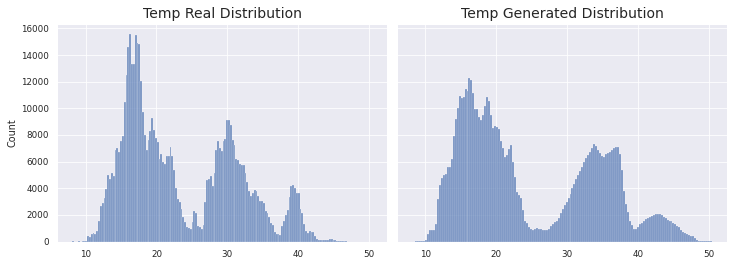

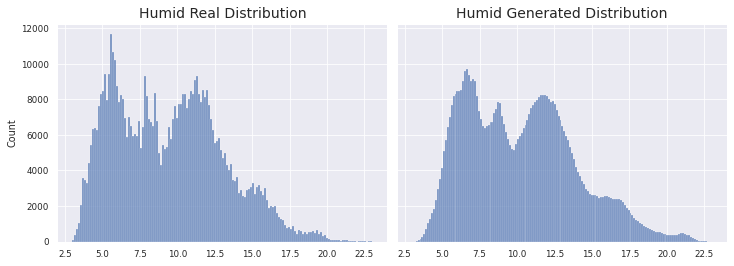

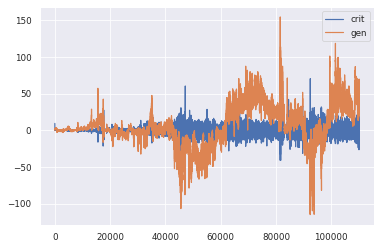

1966/1966 [==============================] - 143s 73ms/step - d_loss: -0.0697 - g_loss: 40.8665
Epoch 57/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1488 - g_loss: 46.2060

KL Divergence: 10.210517153162714 bits
Pinball Loss Temp mean: 0.8682188693622468
Pinball Loss Humid mean: 0.39049318293306845
MSE Temp: 1.7364377387244754
MSE Humid: 0.7809863658661469


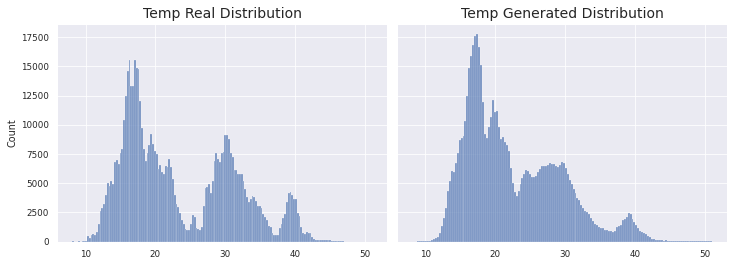

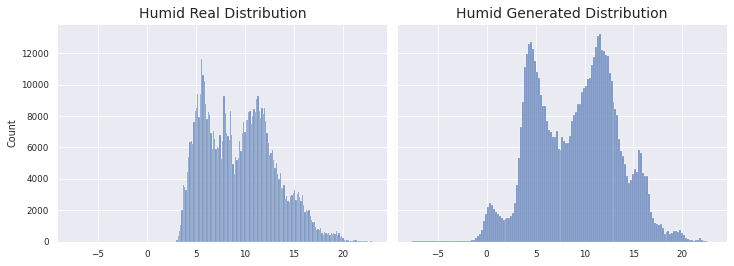

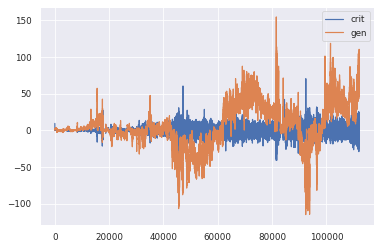

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.1273 - g_loss: 46.2475
Epoch 58/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0904 - g_loss: 93.0684

KL Divergence: 4.378799730366155 bits
Pinball Loss Temp mean: 1.06595465489666
Pinball Loss Humid mean: 0.6150910707885225
MSE Temp: 2.1319093097933233
MSE Humid: 1.2301821415770395


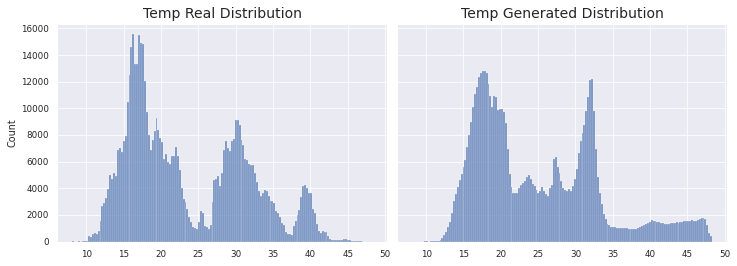

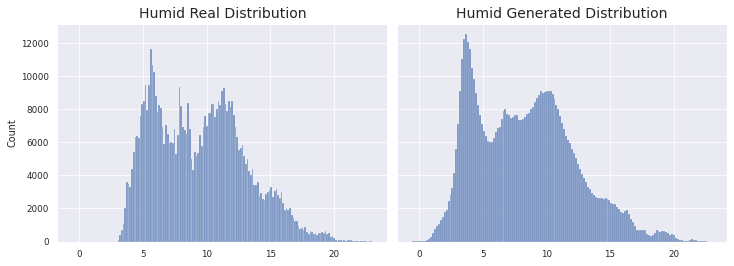

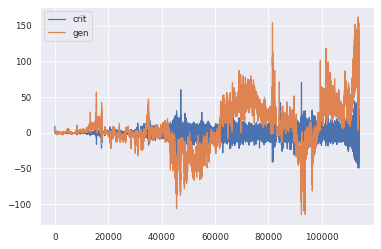

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.1403 - g_loss: 93.1300
Epoch 59/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3637 - g_loss: 57.8052

KL Divergence: 14.396674200380792 bits
Pinball Loss Temp mean: 1.7237117244005606
Pinball Loss Humid mean: 0.9250119082964072
MSE Temp: 3.4474234488011697
MSE Humid: 1.8500238165928093


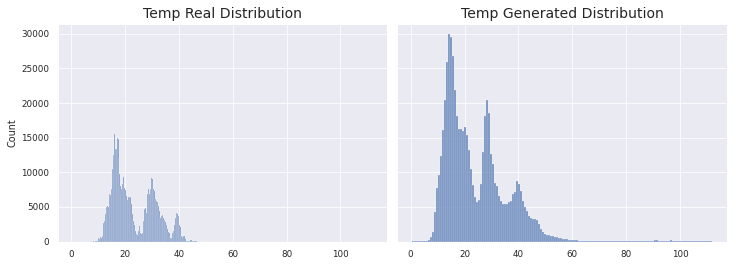

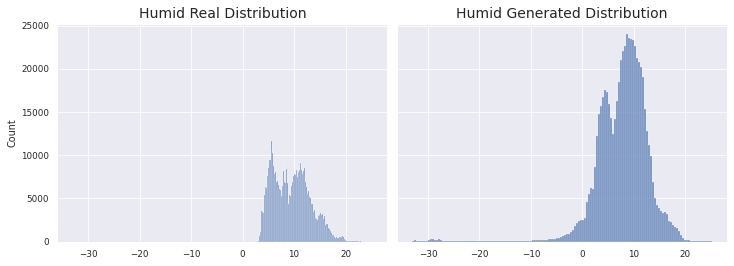

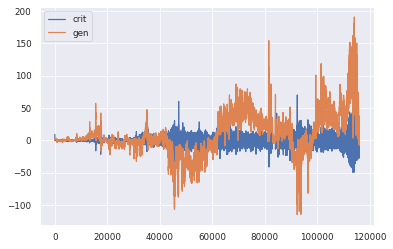

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.3459 - g_loss: 57.7535
Epoch 60/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0586 - g_loss: -16.6091

KL Divergence: 7.775972876727743 bits
Pinball Loss Temp mean: 1.466207647902462
Pinball Loss Humid mean: 0.2676422639492816
MSE Temp: 2.9324152958049745
MSE Humid: 0.5352845278985656


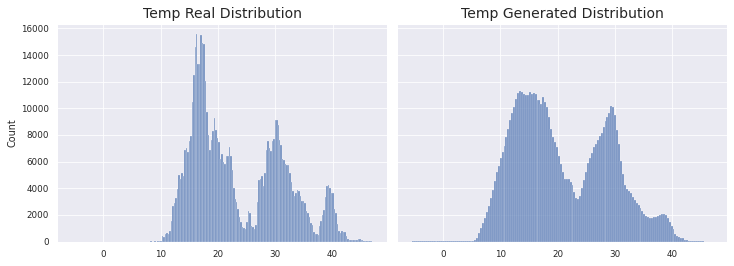

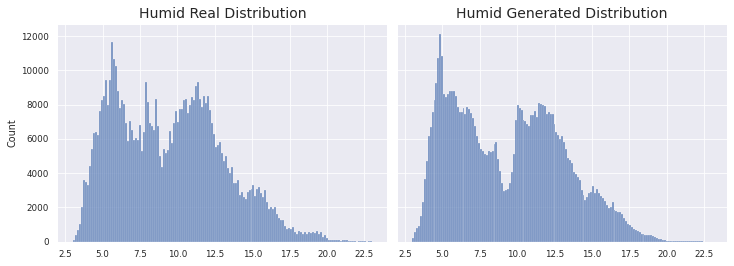

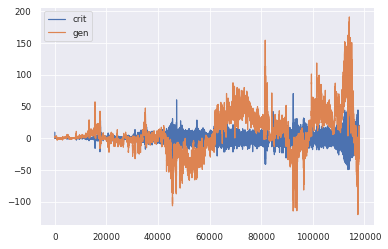

1966/1966 [==============================] - 143s 73ms/step - d_loss: -0.0524 - g_loss: -16.6012
Epoch 61/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0298 - g_loss: -18.8287

KL Divergence: 5.333037168833578 bits
Pinball Loss Temp mean: 1.8384650582352944
Pinball Loss Humid mean: 0.49444100074566616
MSE Temp: 3.6769301164706185
MSE Humid: 0.9888820014913278


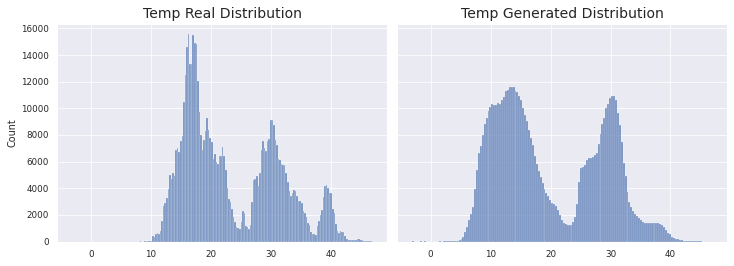

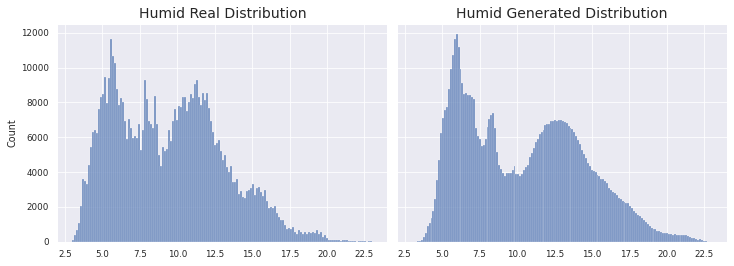

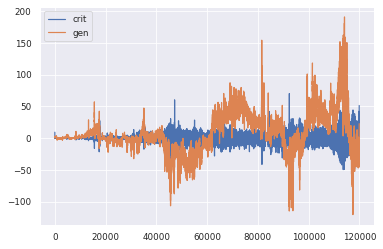

1966/1966 [==============================] - 146s 74ms/step - d_loss: 0.0227 - g_loss: -18.7863
Epoch 62/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4325 - g_loss: -4.1644

KL Divergence: 9.018953547103072 bits
Pinball Loss Temp mean: 2.101590139974681
Pinball Loss Humid mean: 1.4200343712181125
MSE Temp: 4.203180279949388
MSE Humid: 2.840068742436204


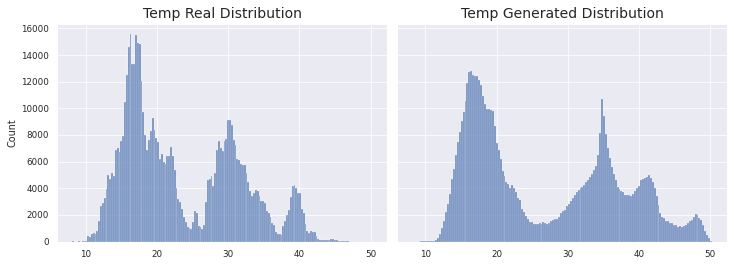

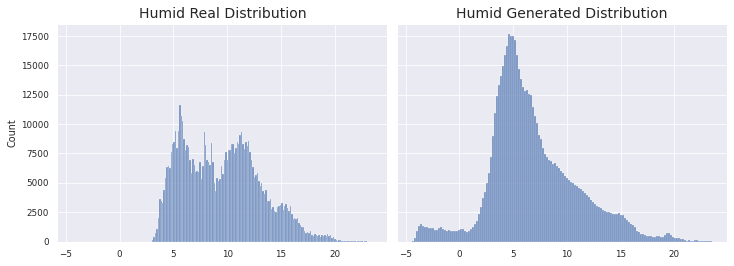

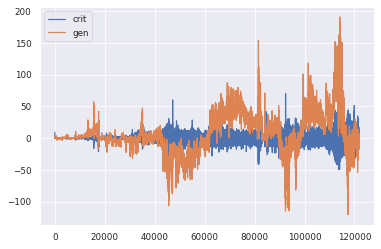

1966/1966 [==============================] - 144s 73ms/step - d_loss: 0.4182 - g_loss: -4.1537
Epoch 63/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0373 - g_loss: -17.1504

KL Divergence: 16.48731531442604 bits
Pinball Loss Temp mean: 1.1470327767121768
Pinball Loss Humid mean: 1.3262025091485712
MSE Temp: 2.2940655534243257
MSE Humid: 2.652405018297128


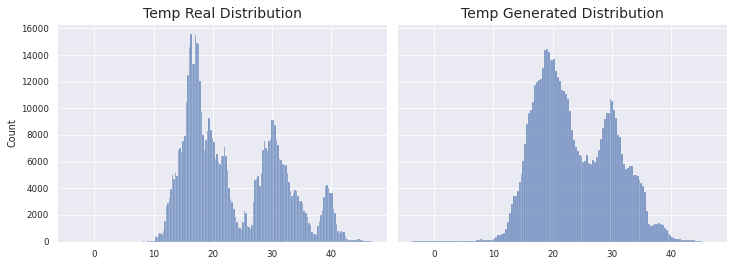

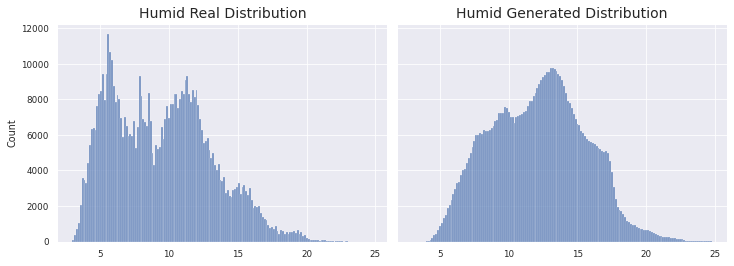

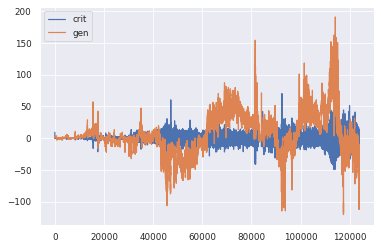

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.0437 - g_loss: -17.2470
Epoch 64/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2622 - g_loss: -12.4293

KL Divergence: 23.98665276955885 bits
Pinball Loss Temp mean: 5.477493664770169
Pinball Loss Humid mean: 3.418714665958583
MSE Temp: 10.954987329540284
MSE Humid: 6.837429331917079


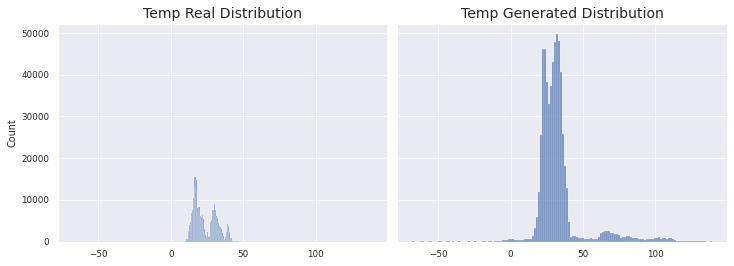

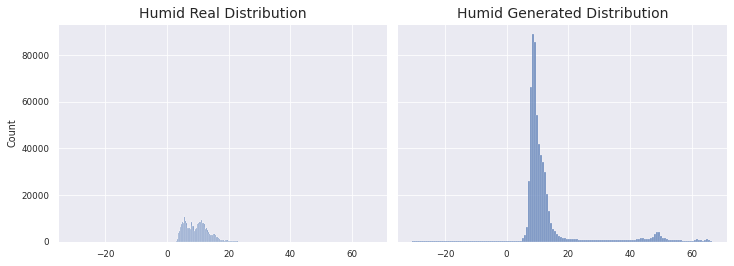

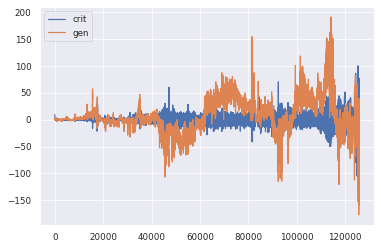

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.2534 - g_loss: -12.4028
Epoch 65/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2011 - g_loss: 8.5770

KL Divergence: 7.950056426575062 bits
Pinball Loss Temp mean: 1.134830381196679
Pinball Loss Humid mean: 0.6886316742146452
MSE Temp: 2.2696607623933778
MSE Humid: 1.3772633484292947


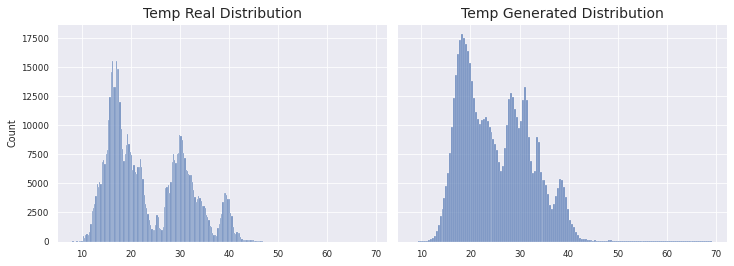

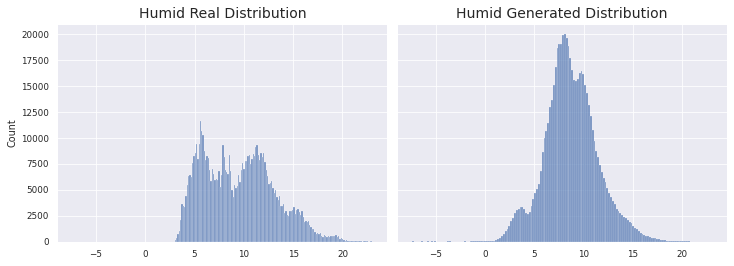

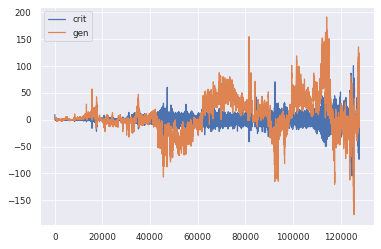

1966/1966 [==============================] - 142s 72ms/step - d_loss: 0.1887 - g_loss: 8.6774
Epoch 66/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0298 - g_loss: 62.1019

KL Divergence: 12.197594437013715 bits
Pinball Loss Temp mean: 0.6762106059012327
Pinball Loss Humid mean: 0.3731248138832715
MSE Temp: 1.352421211802481
MSE Humid: 0.7462496277665431


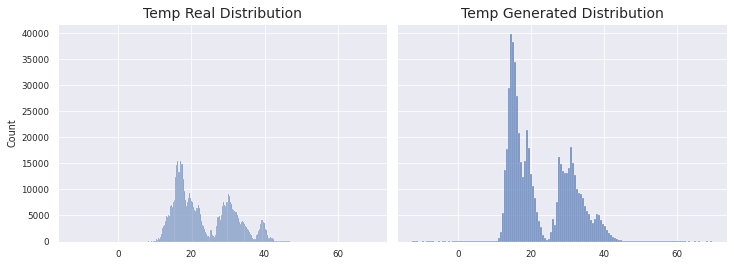

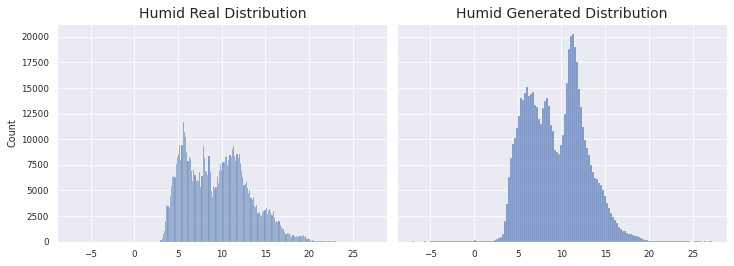

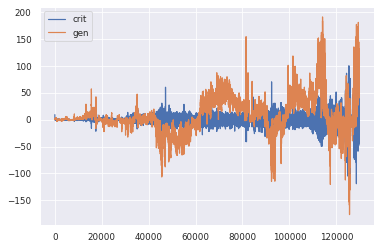

1966/1966 [==============================] - 144s 73ms/step - d_loss: -0.0221 - g_loss: 62.1055
Epoch 67/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1778 - g_loss: 50.7693

KL Divergence: 17.775671824708027 bits
Pinball Loss Temp mean: 1.2231967743255183
Pinball Loss Humid mean: 0.4928549975203165
MSE Temp: 2.4463935486510247
MSE Humid: 0.9857099950406328


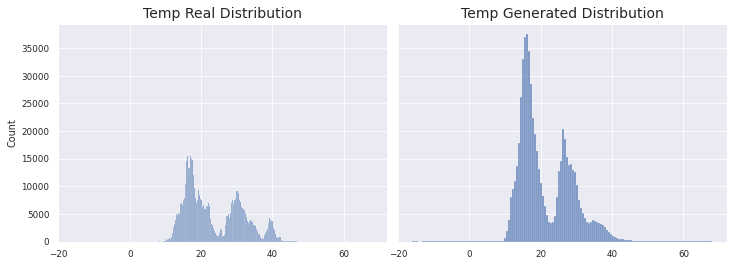

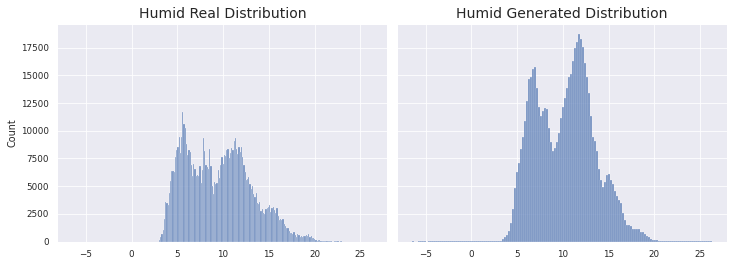

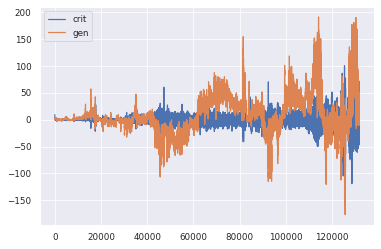

1966/1966 [==============================] - 145s 74ms/step - d_loss: 0.1758 - g_loss: 50.7689
Epoch 68/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5147 - g_loss: -6.8201

KL Divergence: 31.906424396547337 bits
Pinball Loss Temp mean: 5.068979795009968
Pinball Loss Humid mean: 3.1594819622541976
MSE Temp: 10.137959590019744
MSE Humid: 6.318963924508465


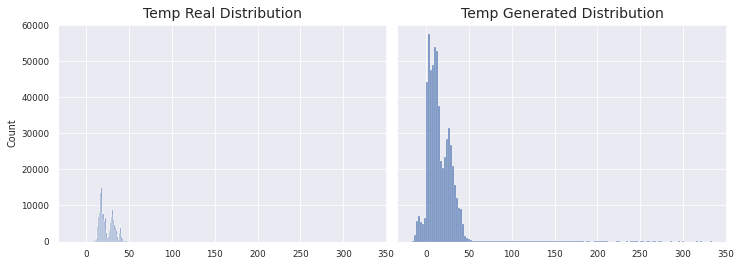

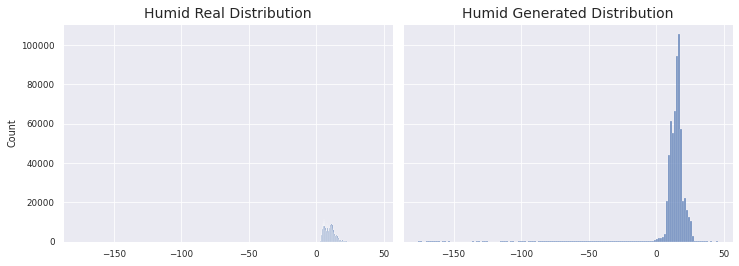

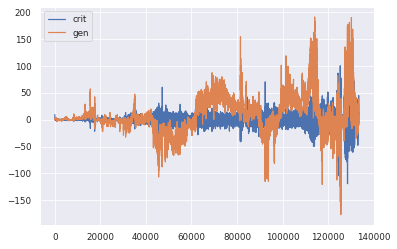

1966/1966 [==============================] - 143s 73ms/step - d_loss: 0.5275 - g_loss: -6.8084
Epoch 69/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1909 - g_loss: 10.1352

KL Divergence: 7.71032459616475 bits
Pinball Loss Temp mean: 3.573132472429181
Pinball Loss Humid mean: 1.5156245399647585
MSE Temp: 7.146264944858468
MSE Humid: 3.0312490799295175


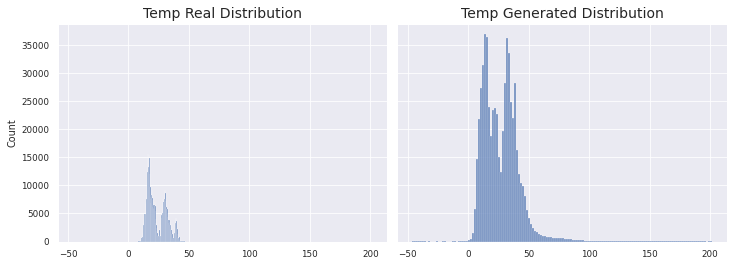

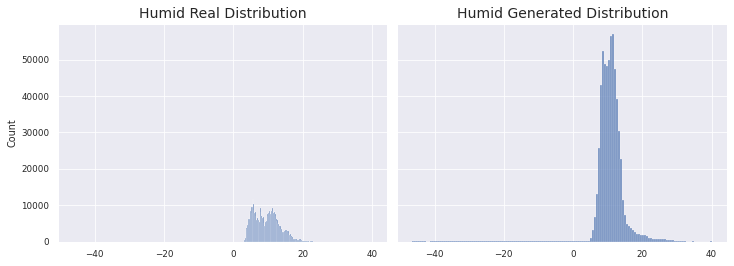

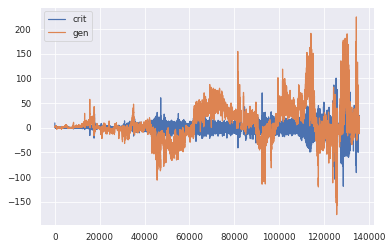

1966/1966 [==============================] - 146s 74ms/step - d_loss: 0.1914 - g_loss: 10.1255
Epoch 70/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2578 - g_loss: 12.3126

KL Divergence: 30.432661552336228 bits
Pinball Loss Temp mean: 12.149633837156527
Pinball Loss Humid mean: 2.4573496836543782
MSE Temp: 24.29926767431311
MSE Humid: 4.914699367308818


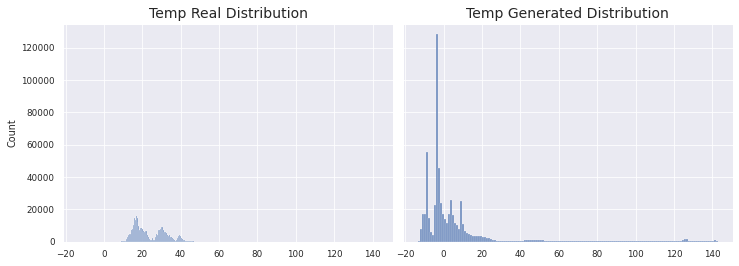

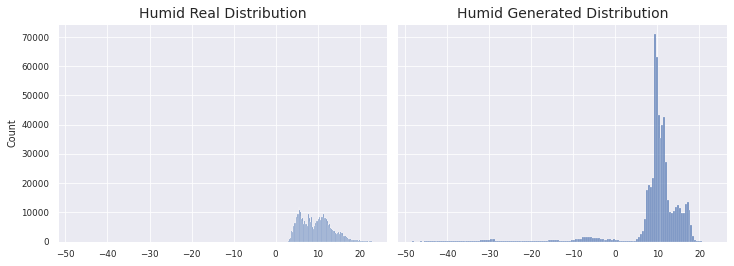

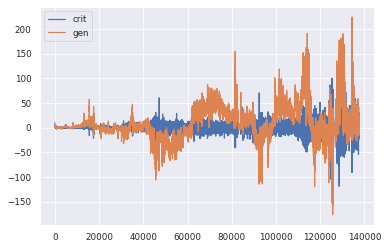

1966/1966 [==============================] - 148s 75ms/step - d_loss: 0.2564 - g_loss: 12.2852
Epoch 71/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1978 - g_loss: -4.7655

KL Divergence: 5.6367341112006475 bits
Pinball Loss Temp mean: 7.8497128466181625
Pinball Loss Humid mean: 4.316757291510813
MSE Temp: 15.699425693236492
MSE Humid: 8.633514583021649


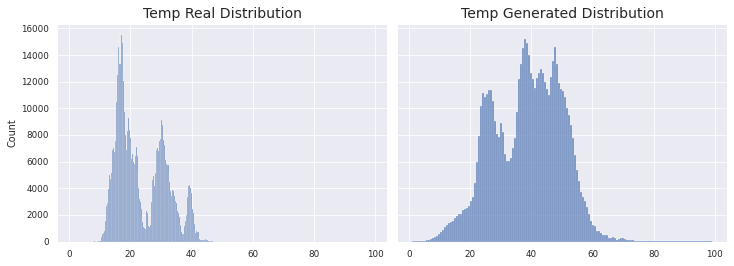

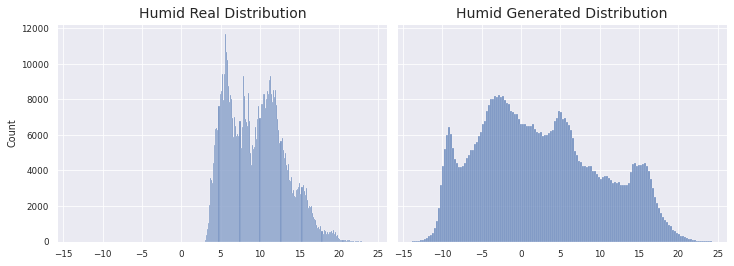

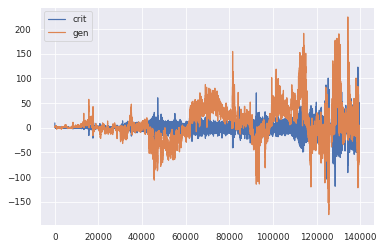

1966/1966 [==============================] - 150s 76ms/step - d_loss: -0.2060 - g_loss: -4.7646
Epoch 72/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3212 - g_loss: -41.8975

KL Divergence: 29.814552384071618 bits
Pinball Loss Temp mean: 2.641102339982651
Pinball Loss Humid mean: 0.9597883391024444
MSE Temp: 5.282204679965318
MSE Humid: 1.9195766782049064


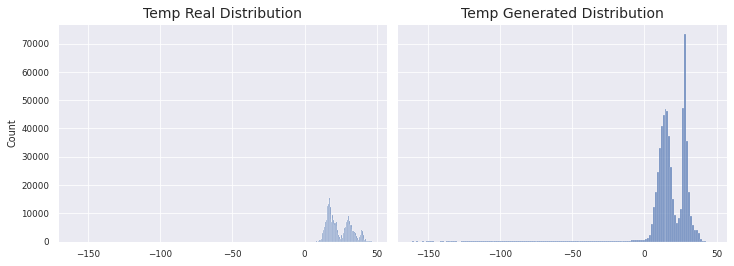

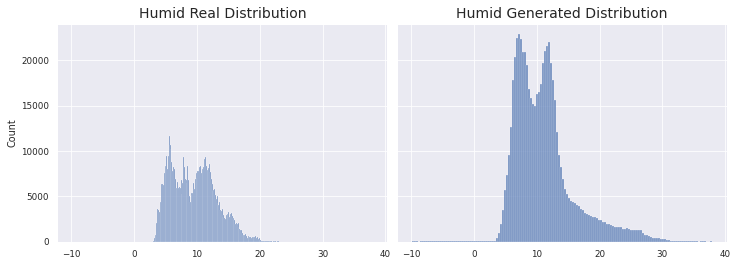

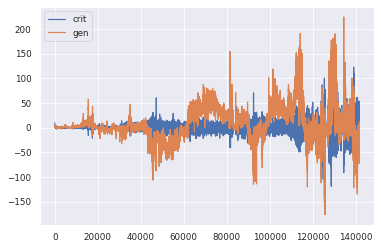

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.2993 - g_loss: -41.8422
Epoch 73/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0900 - g_loss: -20.2680

KL Divergence: 10.90131735072329 bits
Pinball Loss Temp mean: 1.12413052418785
Pinball Loss Humid mean: 0.6974745969259248
MSE Temp: 2.248261048375679
MSE Humid: 1.3949491938518659


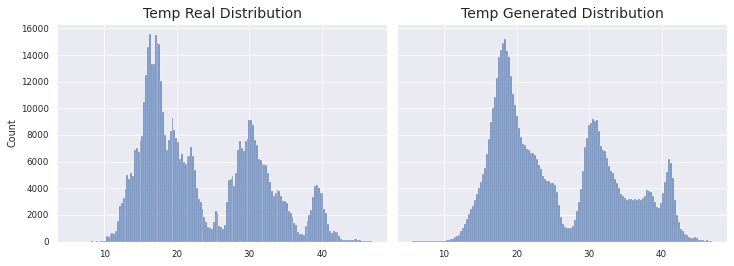

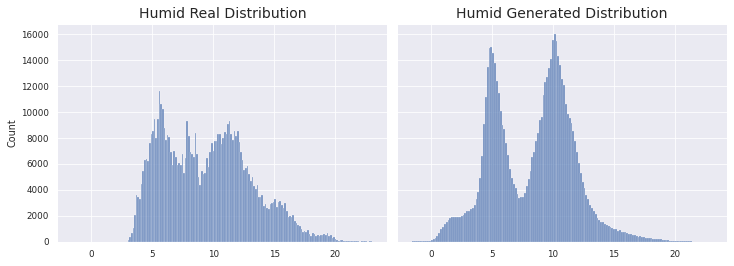

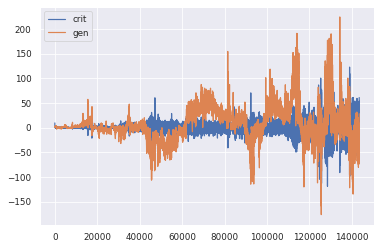

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.1518 - g_loss: -20.2188
Epoch 74/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4971 - g_loss: -18.0180

KL Divergence: 30.36187118569755 bits
Pinball Loss Temp mean: 5.495109790275832
Pinball Loss Humid mean: 3.035906666103851
MSE Temp: 10.99021958055187
MSE Humid: 6.071813332207744


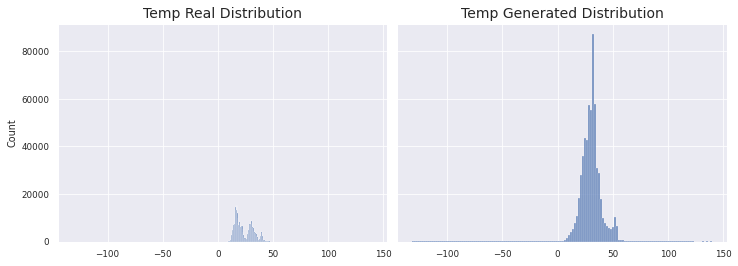

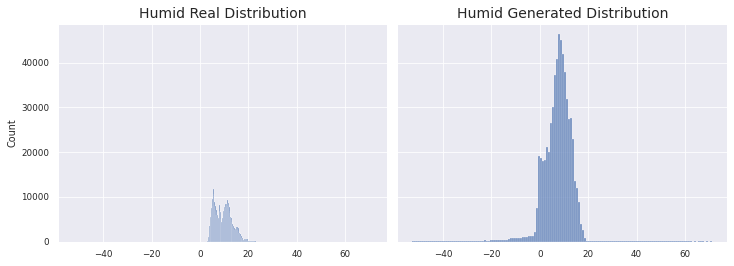

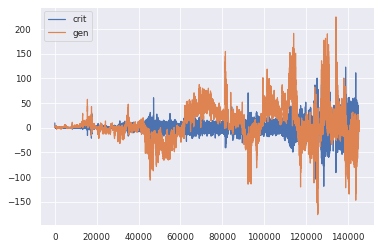

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.4951 - g_loss: -18.0093
Epoch 75/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0731 - g_loss: -16.4032

KL Divergence: 17.30659797571247 bits
Pinball Loss Temp mean: 5.67458911672041
Pinball Loss Humid mean: 1.099875803617395
MSE Temp: 11.349178233441007
MSE Humid: 2.1997516072347847


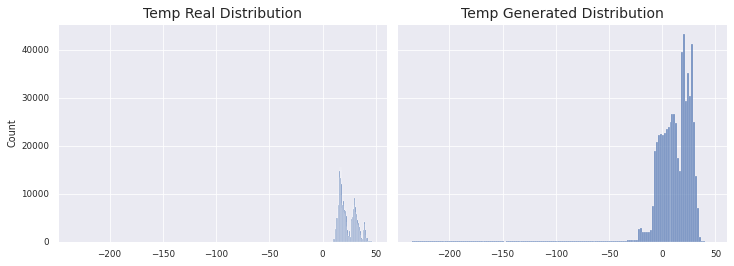

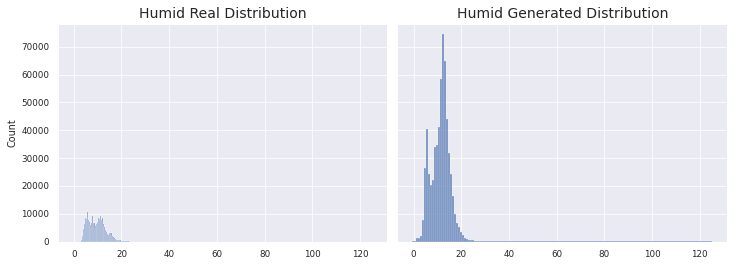

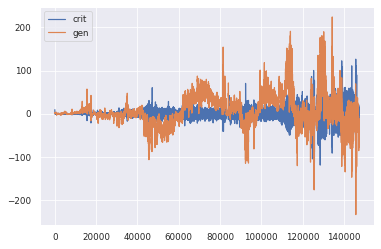

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.0655 - g_loss: -16.4057
Epoch 76/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2903 - g_loss: -23.3481

KL Divergence: 14.129459566087434 bits
Pinball Loss Temp mean: 5.002617359265672
Pinball Loss Humid mean: 2.356533581944338
MSE Temp: 10.00523471853146
MSE Humid: 4.713067163888708


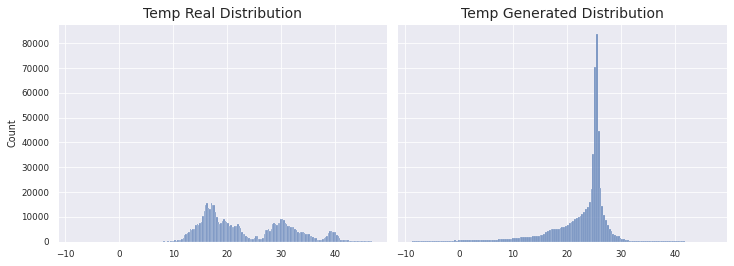

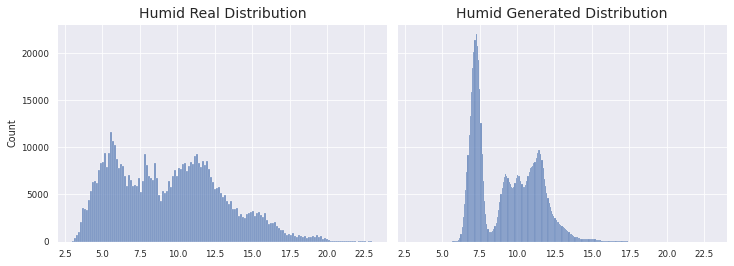

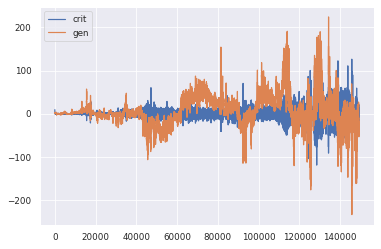

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.2898 - g_loss: -23.3548
Epoch 77/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4016 - g_loss: -17.2742

KL Divergence: 4.202946794793758 bits
Pinball Loss Temp mean: 2.063241216024462
Pinball Loss Humid mean: 1.039511295645291
MSE Temp: 4.126482432048904
MSE Humid: 2.079022591290589


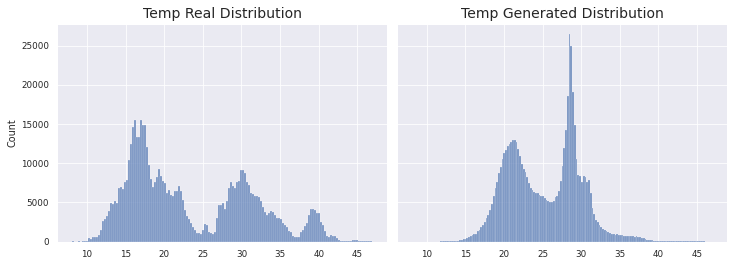

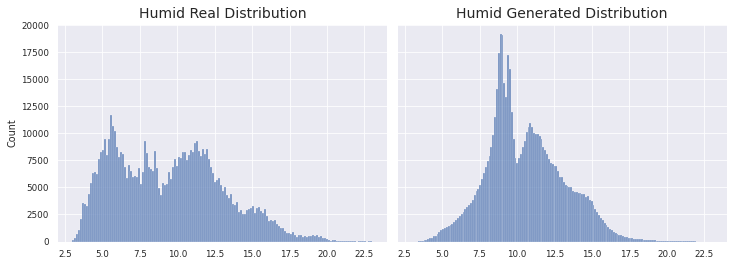

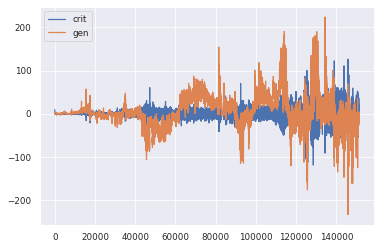

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.4195 - g_loss: -17.2703
Epoch 78/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3066 - g_loss: -1.1180

KL Divergence: 13.637692449940056 bits
Pinball Loss Temp mean: 5.334465004839234
Pinball Loss Humid mean: 2.1173792556447917
MSE Temp: 10.668930009678284
MSE Humid: 4.234758511289582


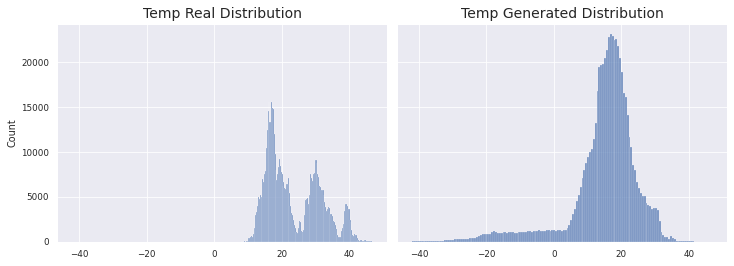

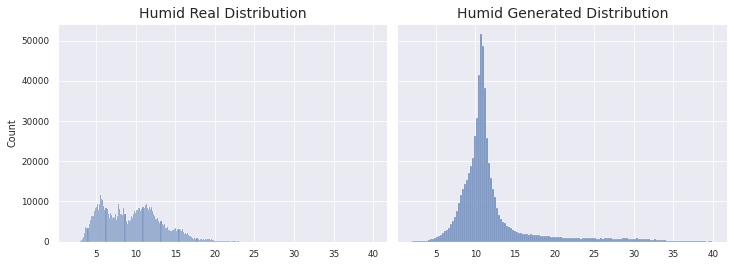

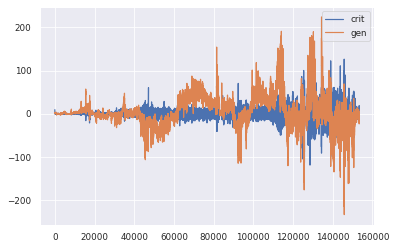

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.3061 - g_loss: -1.1278
Epoch 79/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2400 - g_loss: -14.0762

KL Divergence: 9.76589977754424 bits
Pinball Loss Temp mean: 2.5084270505433213
Pinball Loss Humid mean: 0.620749830764748
MSE Temp: 5.016854101086646
MSE Humid: 1.2414996615294804


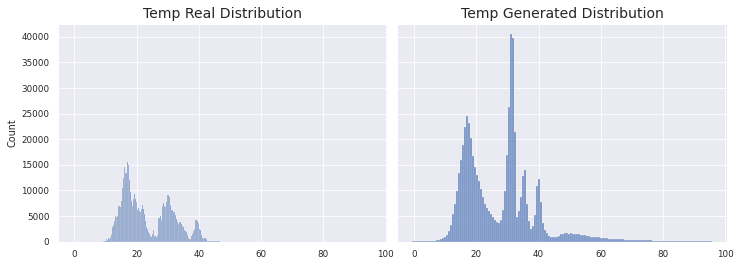

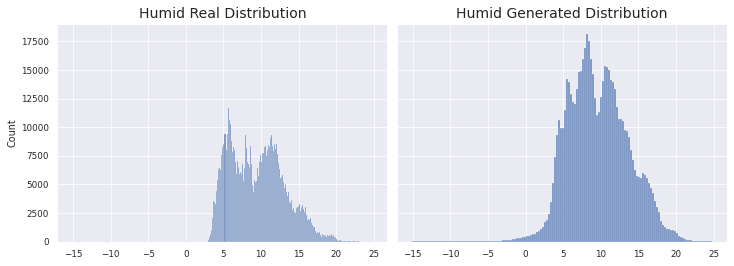

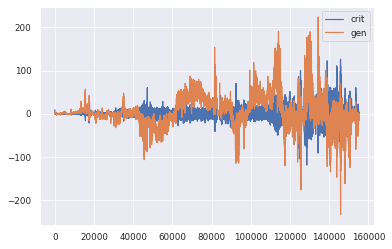

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.2411 - g_loss: -14.0703
Epoch 80/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0167 - g_loss: -29.1063

KL Divergence: 29.43450742427599 bits
Pinball Loss Temp mean: 16.304821847253365
Pinball Loss Humid mean: 4.74509466472899
MSE Temp: 32.6096436945061
MSE Humid: 9.490189329458016


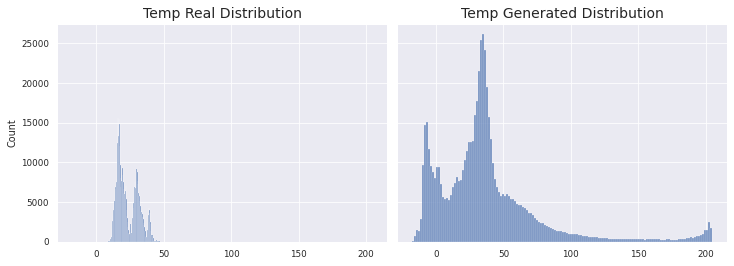

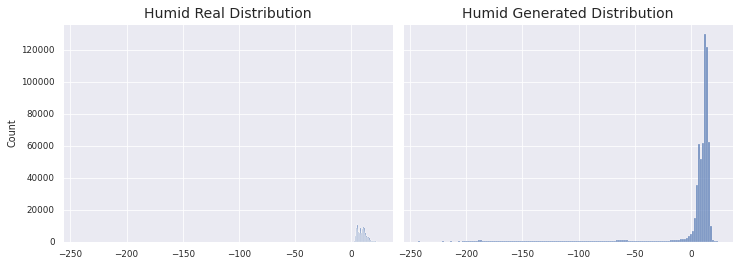

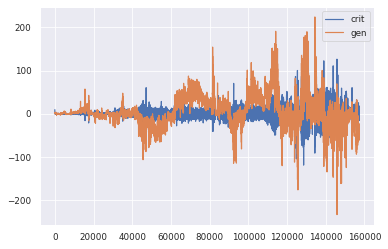

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.0226 - g_loss: -29.1382
Epoch 81/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2619 - g_loss: 7.1675

KL Divergence: 28.202376896044814 bits
Pinball Loss Temp mean: 6.643649513083116
Pinball Loss Humid mean: 4.678689383059748
MSE Temp: 13.287299026166416
MSE Humid: 9.357378766119439


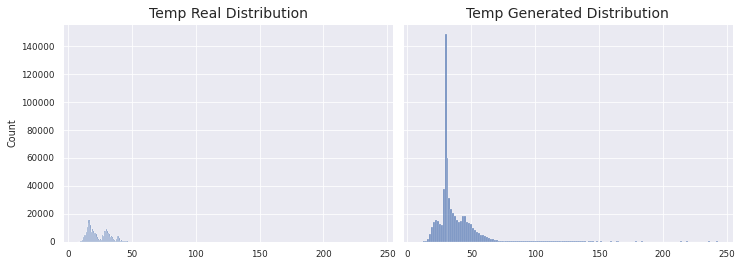

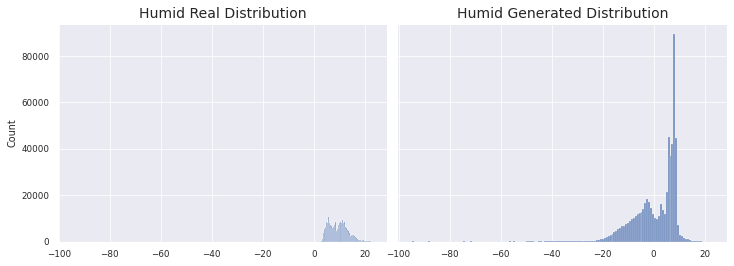

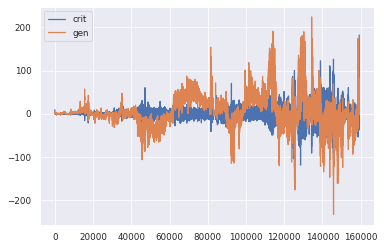

1966/1966 [==============================] - 152s 77ms/step - d_loss: -0.0760 - g_loss: 7.1768
Epoch 82/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3064 - g_loss: 14.1175

KL Divergence: 27.313895933316566 bits
Pinball Loss Temp mean: 48.86091624319063
Pinball Loss Humid mean: 34.26850389308055
MSE Temp: 97.7218324863834
MSE Humid: 68.53700778616101


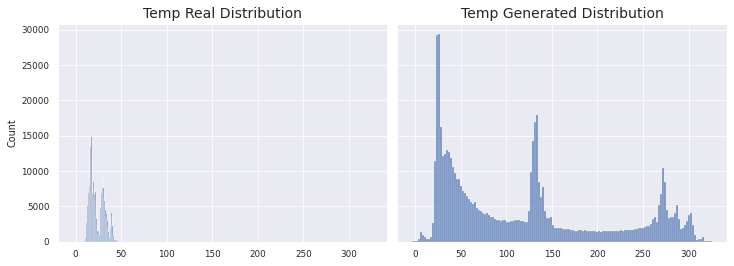

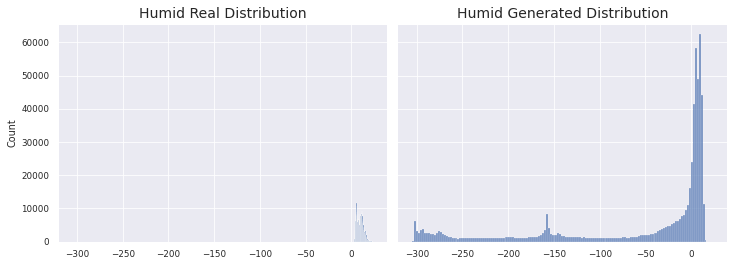

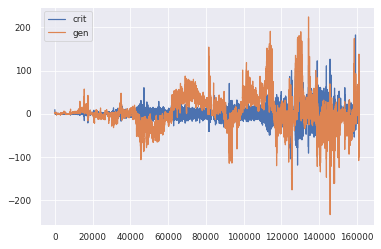

1966/1966 [==============================] - 151s 77ms/step - d_loss: 0.2893 - g_loss: 14.1050
Epoch 83/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0916 - g_loss: 35.8405

KL Divergence: 29.566002825867194 bits
Pinball Loss Temp mean: 11.439285339415445
Pinball Loss Humid mean: 2.673064144123389
MSE Temp: 22.878570678830894
MSE Humid: 5.346128288246715


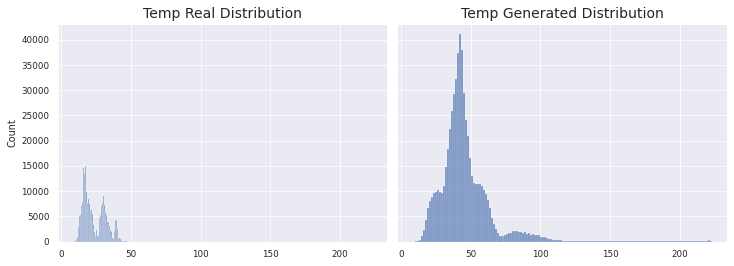

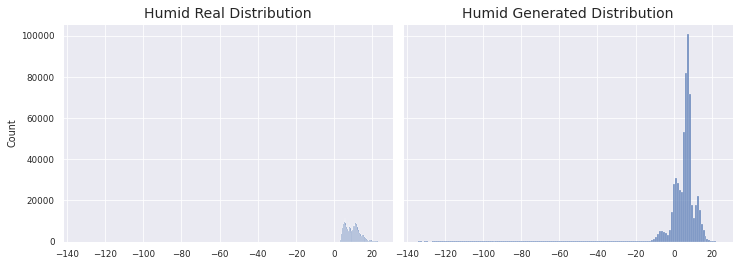

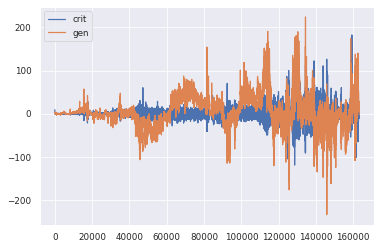

1966/1966 [==============================] - 151s 77ms/step - d_loss: 0.0930 - g_loss: 35.8014
Epoch 84/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2256 - g_loss: 11.1486

KL Divergence: 31.142188508311737 bits
Pinball Loss Temp mean: 9.812409095945481
Pinball Loss Humid mean: 6.9955627759750785
MSE Temp: 19.62481819189139
MSE Humid: 13.991125551950171


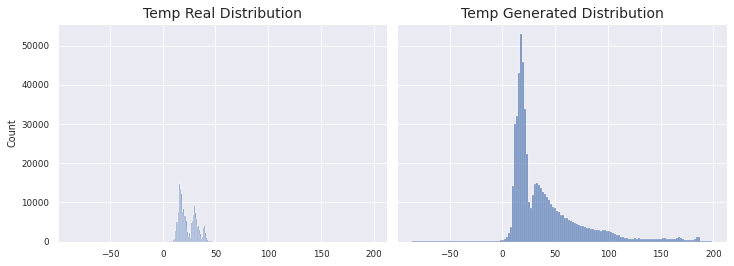

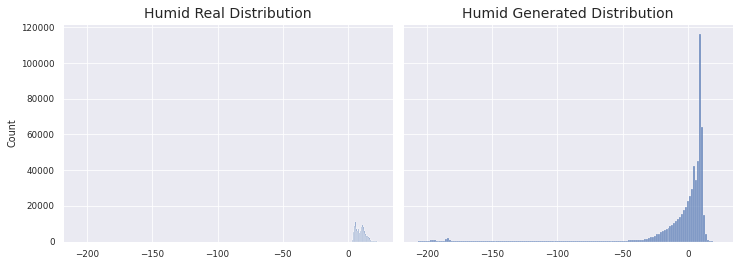

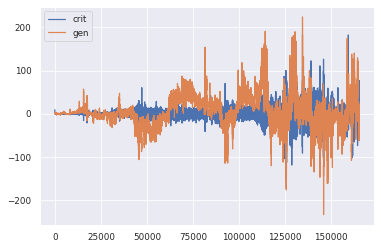

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.3033 - g_loss: 11.1282
Epoch 85/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2402 - g_loss: -2.4719

KL Divergence: 5.926095817589841 bits
Pinball Loss Temp mean: 7.13435165094684
Pinball Loss Humid mean: 4.703110045786007
MSE Temp: 14.268703301893783
MSE Humid: 9.406220091572052


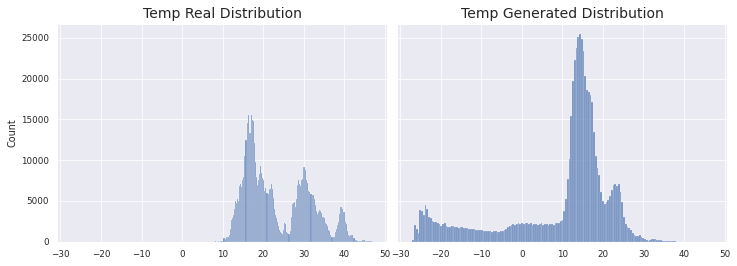

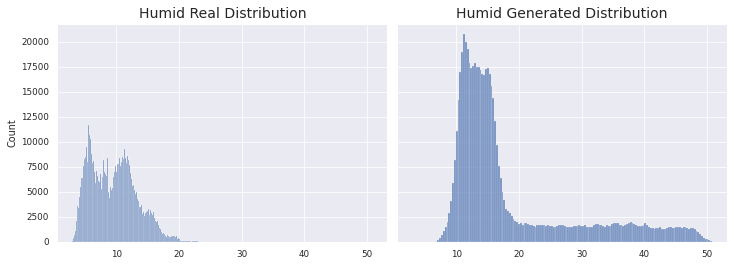

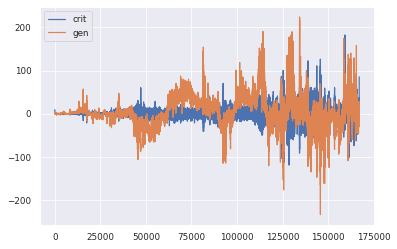

1966/1966 [==============================] - 152s 78ms/step - d_loss: 0.3269 - g_loss: -2.4798
Epoch 86/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0239 - g_loss: -32.9658

KL Divergence: 23.479488545283314 bits
Pinball Loss Temp mean: 5.423167853977307
Pinball Loss Humid mean: 3.3273414522065368
MSE Temp: 10.846335707954799
MSE Humid: 6.654682904413103


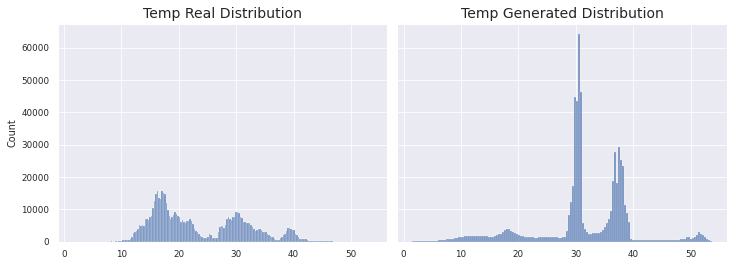

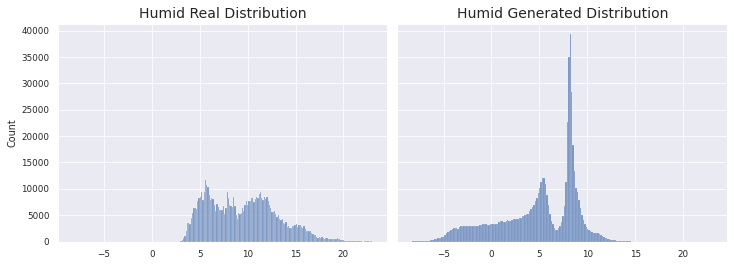

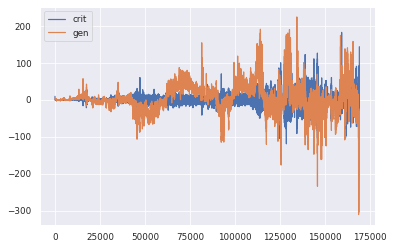

1966/1966 [==============================] - 151s 77ms/step - d_loss: 0.1224 - g_loss: -33.0264
Epoch 87/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3442 - g_loss: -54.9134

KL Divergence: 23.35418868393645 bits
Pinball Loss Temp mean: 12.160415165561338
Pinball Loss Humid mean: 2.8149019760688825
MSE Temp: 24.320830331122597
MSE Humid: 5.629803952137673


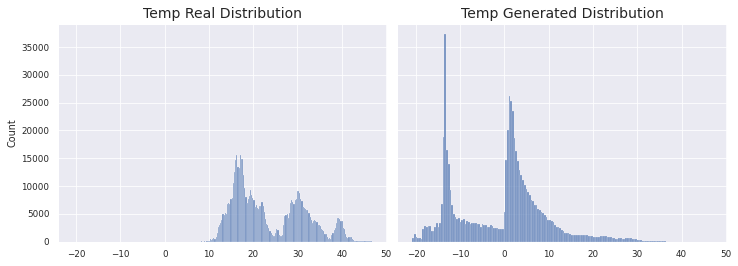

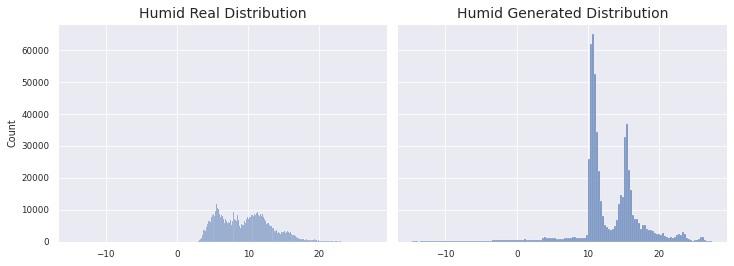

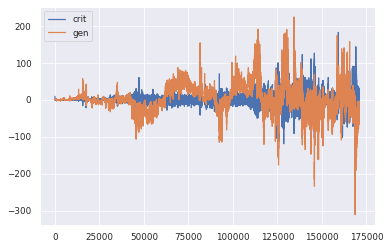

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.3730 - g_loss: -54.8719
Epoch 88/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3326 - g_loss: -30.3818

KL Divergence: 24.843245824618 bits
Pinball Loss Temp mean: 61.6131668981756
Pinball Loss Humid mean: 30.638248763963624
MSE Temp: 123.22633379635077
MSE Humid: 61.27649752792771


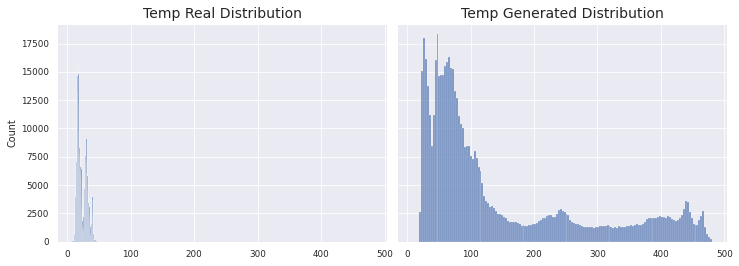

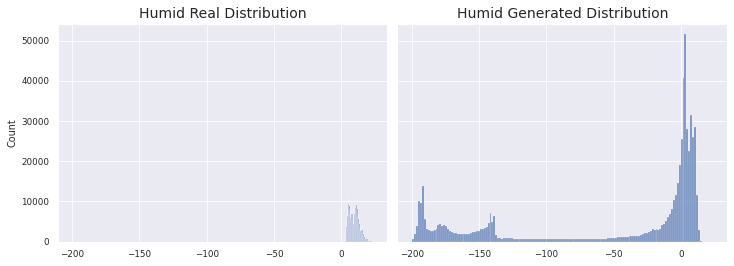

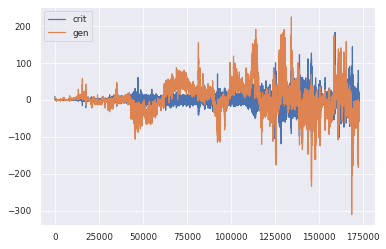

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.3450 - g_loss: -30.3846
Epoch 89/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.4177 - g_loss: -27.5835

KL Divergence: 31.41916963675816 bits
Pinball Loss Temp mean: 23.803067167260565
Pinball Loss Humid mean: 14.343302011590424
MSE Temp: 47.606134334521506
MSE Humid: 28.686604023181456


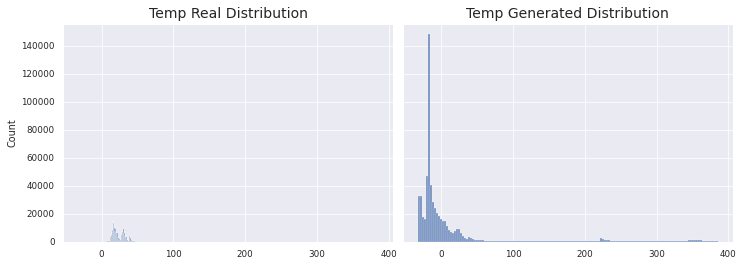

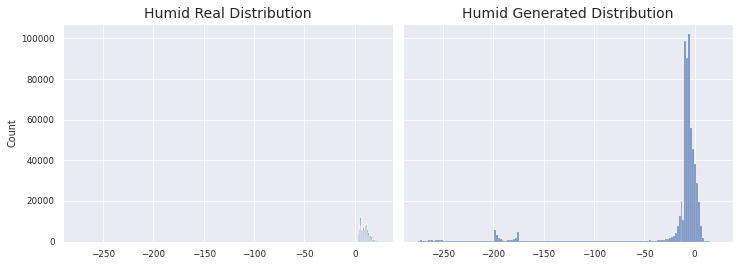

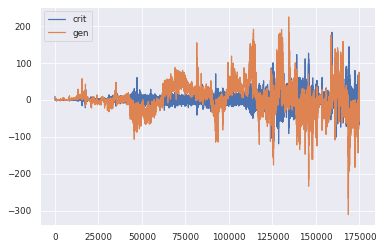

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.4136 - g_loss: -27.5754
Epoch 90/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4429 - g_loss: -20.7141

KL Divergence: 22.356301163177573 bits
Pinball Loss Temp mean: 4.726183185945144
Pinball Loss Humid mean: 4.481819687007747
MSE Temp: 9.452366371890513
MSE Humid: 8.96363937401543


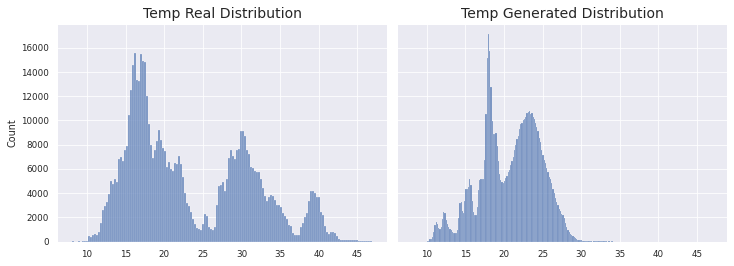

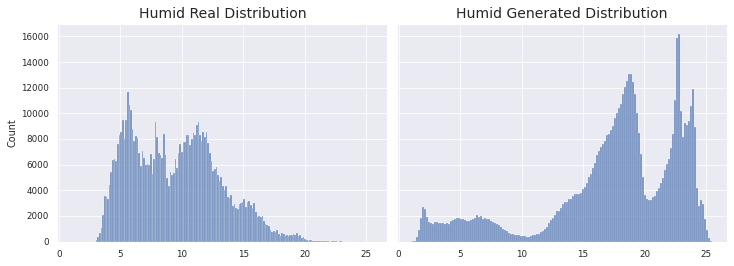

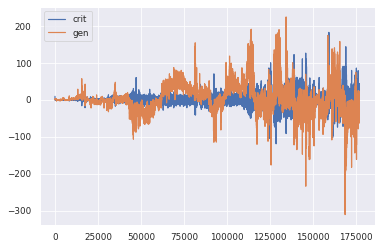

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.4330 - g_loss: -20.7111
Epoch 91/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1152 - g_loss: -18.4002

KL Divergence: 29.65391474579034 bits
Pinball Loss Temp mean: 19.85879088587395
Pinball Loss Humid mean: 7.367686656361094
MSE Temp: 39.71758177174733
MSE Humid: 14.735373312722096


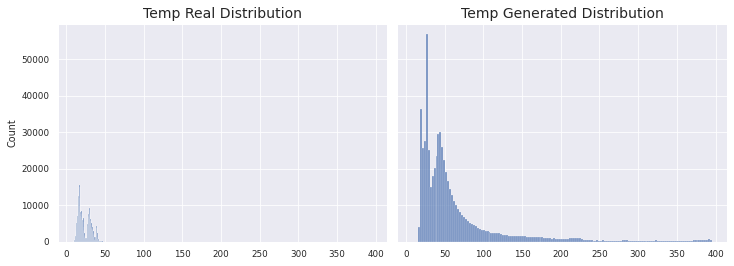

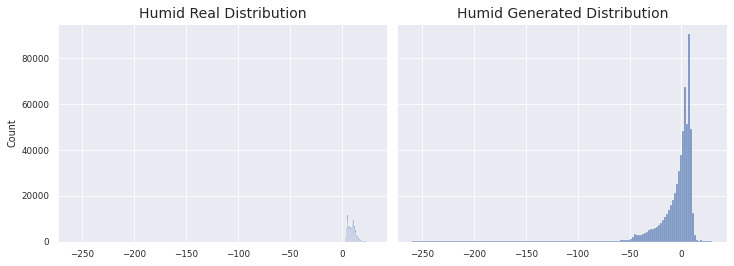

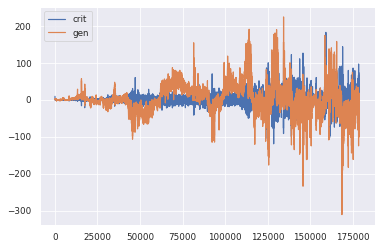

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.1178 - g_loss: -18.3919
Epoch 92/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4029 - g_loss: -12.2538

KL Divergence: 13.801857741037399 bits
Pinball Loss Temp mean: 55.56046469947521
Pinball Loss Humid mean: 92.62591250094219
MSE Temp: 111.1209293989505
MSE Humid: 185.25182500188674


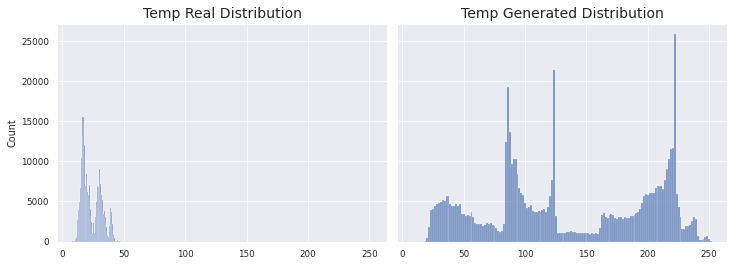

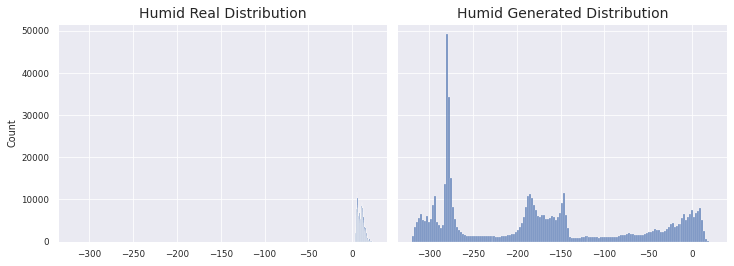

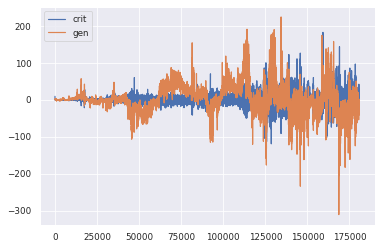

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.4018 - g_loss: -12.2510
Epoch 93/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1940 - g_loss: -3.4276

KL Divergence: 29.63841194319916 bits
Pinball Loss Temp mean: 3.6457776058892306
Pinball Loss Humid mean: 3.733933930592978
MSE Temp: 7.291555211778481
MSE Humid: 7.467867861185946


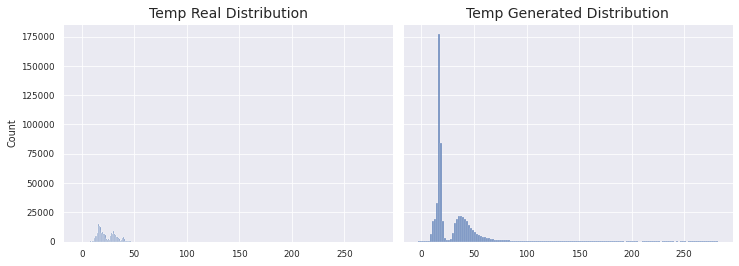

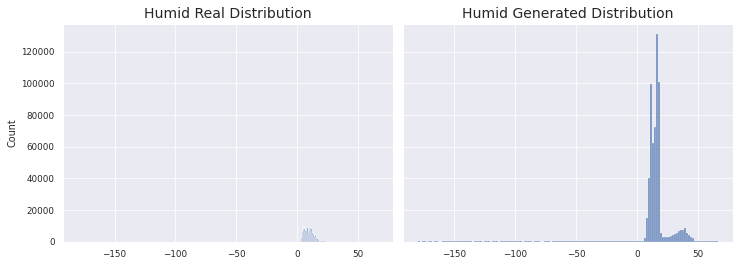

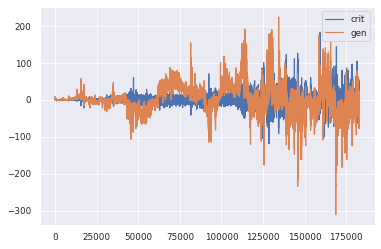

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.2107 - g_loss: -3.4668
Epoch 94/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5127 - g_loss: 7.7616

KL Divergence: 11.943534488599274 bits
Pinball Loss Temp mean: 2.0110421552148714
Pinball Loss Humid mean: 1.4997340842512996
MSE Temp: 4.022084310429767
MSE Humid: 2.9994681685025943


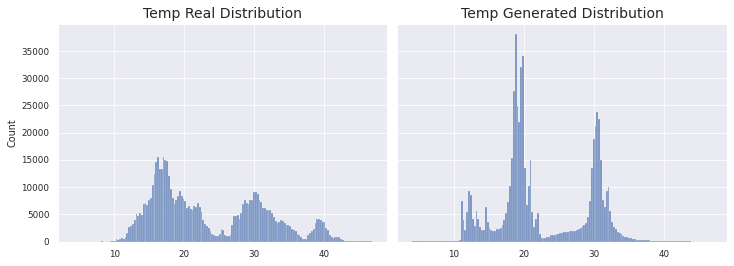

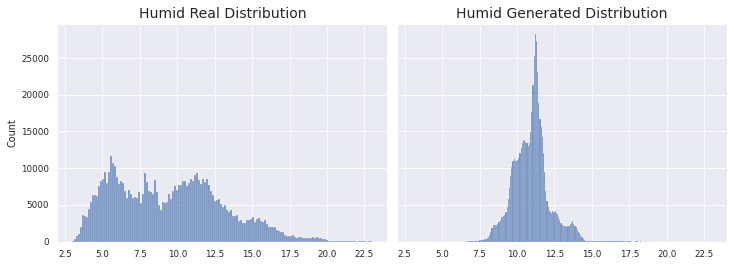

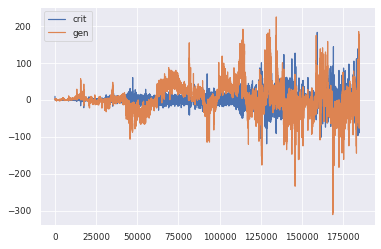

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.5259 - g_loss: 7.7018
Epoch 95/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0677 - g_loss: -20.8728

KL Divergence: 24.751116245124273 bits
Pinball Loss Temp mean: 48.566494950466755
Pinball Loss Humid mean: 26.485350082456627
MSE Temp: 97.13298990093267
MSE Humid: 52.97070016491263


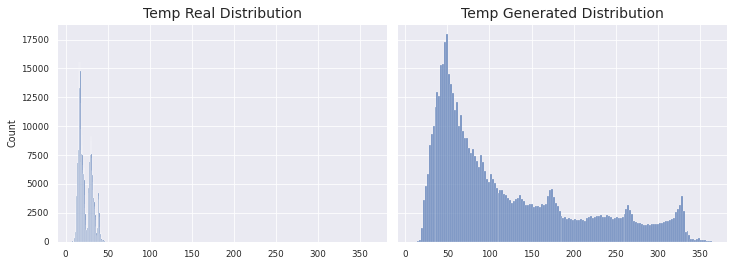

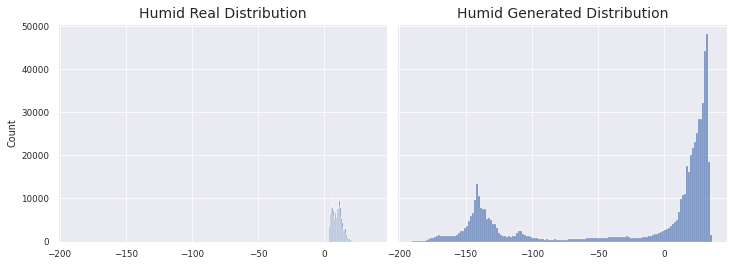

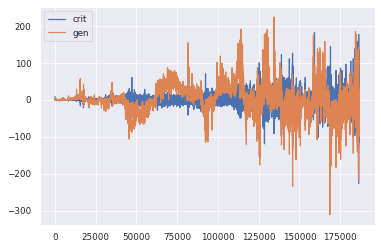

1966/1966 [==============================] - 158s 81ms/step - d_loss: -0.0659 - g_loss: -20.8803
Epoch 96/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2805 - g_loss: 70.6519

KL Divergence: 15.551865789971249 bits
Pinball Loss Temp mean: 1.32370678110293
Pinball Loss Humid mean: 1.704327454846514
MSE Temp: 2.647413562205846
MSE Humid: 3.408654909692981


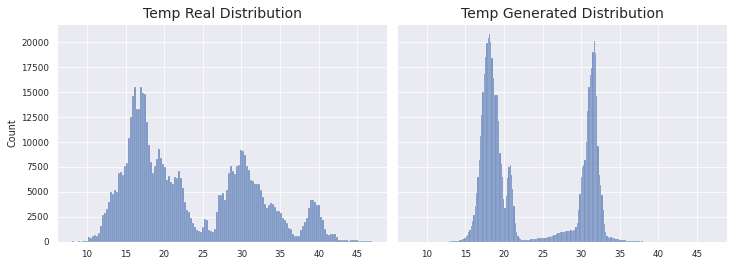

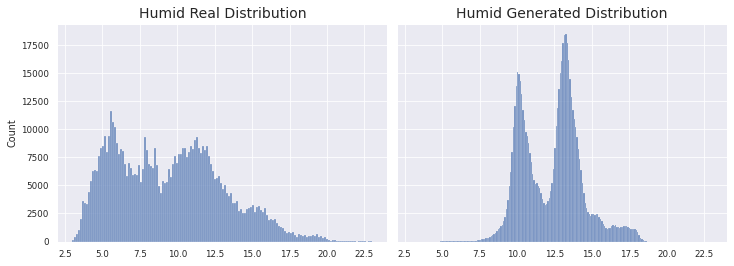

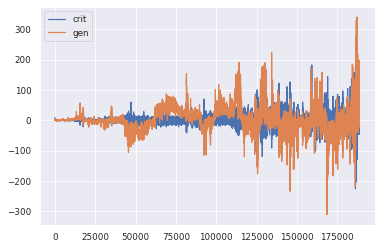

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.2799 - g_loss: 70.6118
Epoch 97/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.5801 - g_loss: -4.3419

KL Divergence: 32.25661312927489 bits
Pinball Loss Temp mean: 6.508059253902194
Pinball Loss Humid mean: 6.585259930847218
MSE Temp: 13.016118507804304
MSE Humid: 13.170519861694427


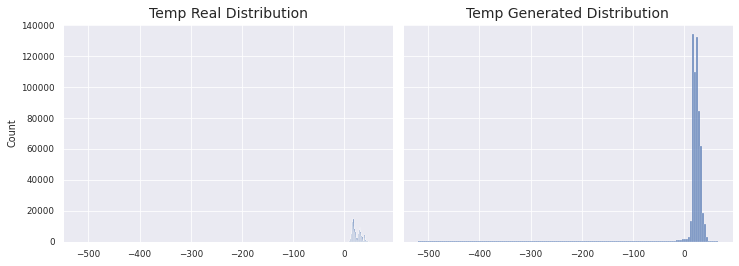

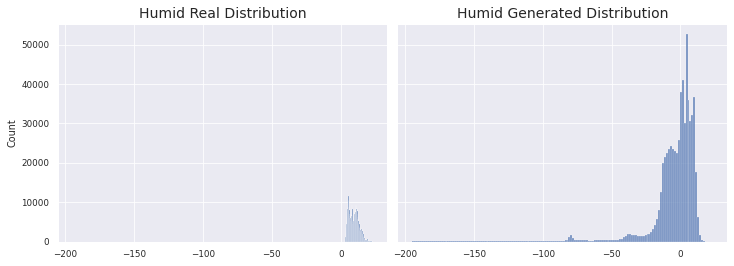

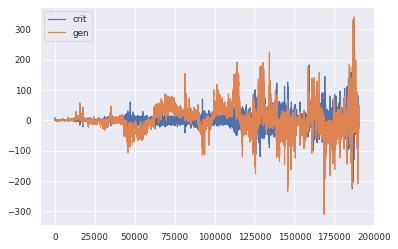

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.5728 - g_loss: -4.3273
Epoch 98/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5506 - g_loss: 50.9397

KL Divergence: 26.670009129890758 bits
Pinball Loss Temp mean: 36.71295678541644
Pinball Loss Humid mean: 31.149154713029844
MSE Temp: 73.42591357083361
MSE Humid: 62.298309426059184


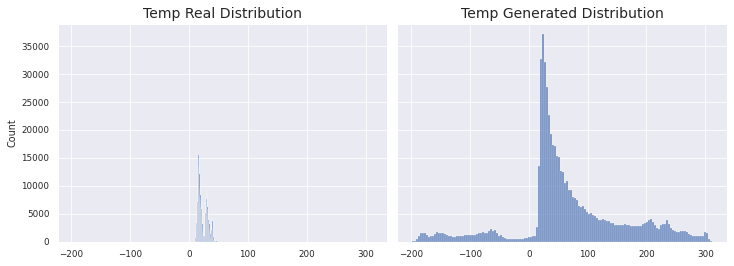

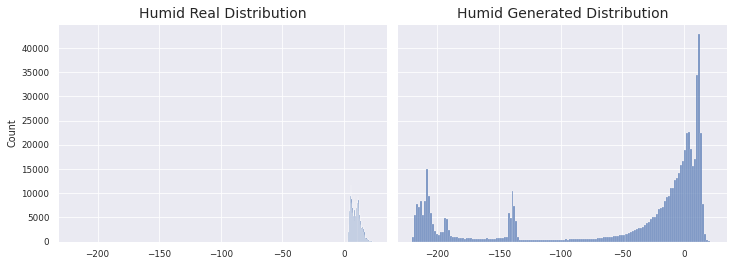

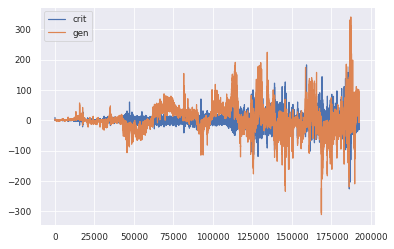

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.5298 - g_loss: 50.9143
Epoch 99/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5131 - g_loss: 22.1487

KL Divergence: 26.548195490186217 bits
Pinball Loss Temp mean: 15.802264452337244
Pinball Loss Humid mean: 16.536697200735453
MSE Temp: 31.60452890467463
MSE Humid: 33.07339440147026


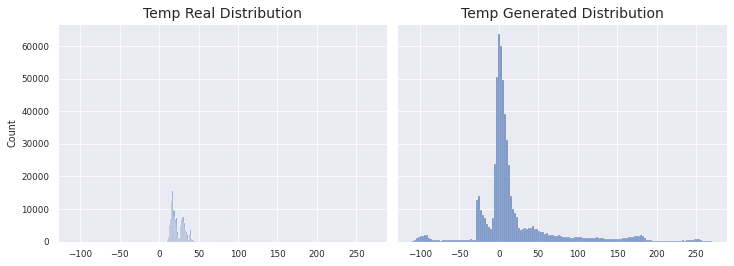

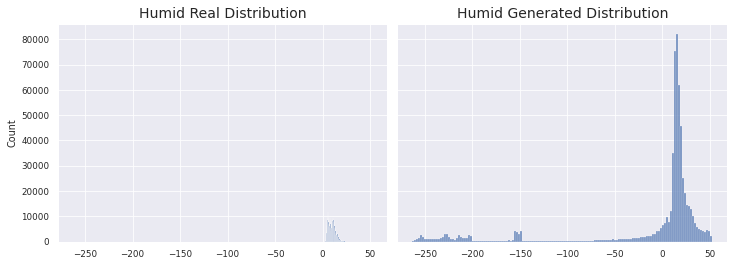

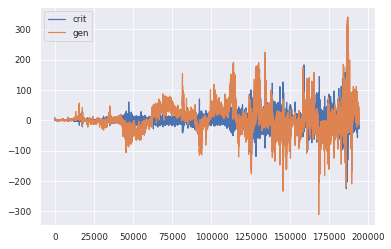

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.5144 - g_loss: 22.1325
Epoch 100/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2362 - g_loss: 51.7752

KL Divergence: 5.341134081810778 bits
Pinball Loss Temp mean: 3.463855600767508
Pinball Loss Humid mean: 2.888936688172828
MSE Temp: 6.927711201535041
MSE Humid: 5.7778733763456


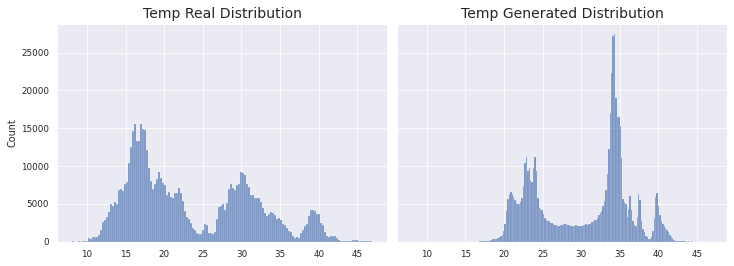

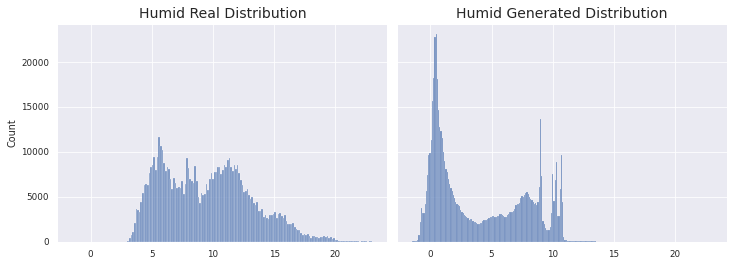

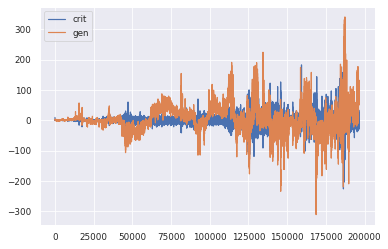

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.2474 - g_loss: 51.7940
Epoch 101/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1625 - g_loss: 53.1208

KL Divergence: 11.917467849360998 bits
Pinball Loss Temp mean: 4.593251377447517
Pinball Loss Humid mean: 5.494284706019475
MSE Temp: 9.186502754895077
MSE Humid: 10.988569412039038


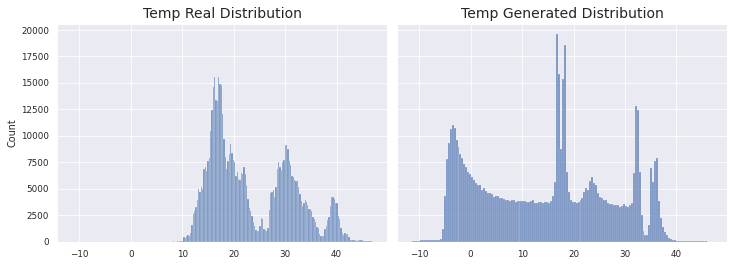

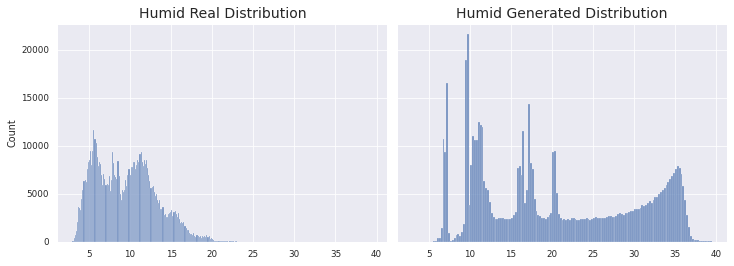

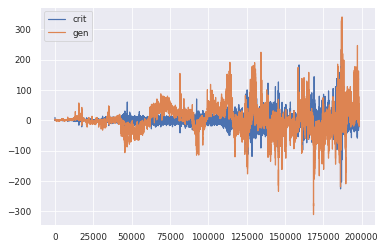

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.1416 - g_loss: 53.0595
Epoch 102/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3150 - g_loss: 55.2561

KL Divergence: 14.663712006969972 bits
Pinball Loss Temp mean: 1.043301465767725
Pinball Loss Humid mean: 1.4072815316887612
MSE Temp: 2.0866029315354058
MSE Humid: 2.8145630633775345


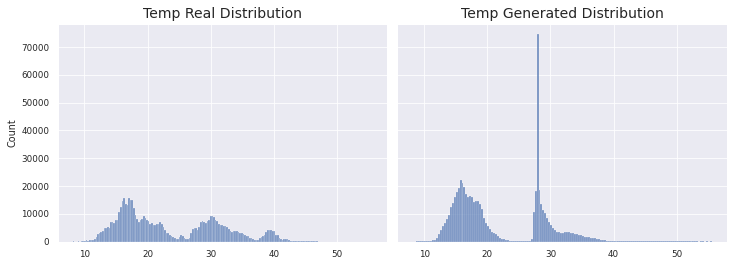

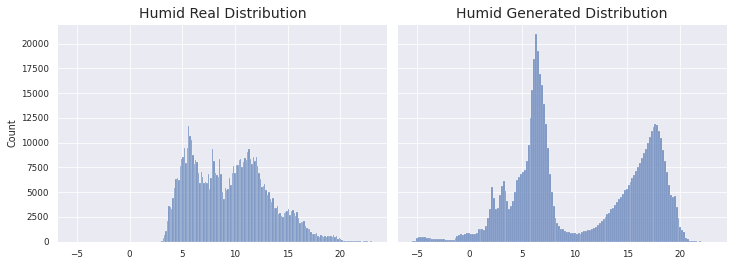

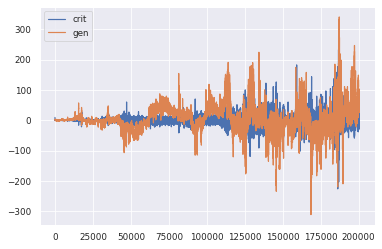

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.3007 - g_loss: 55.2453
Epoch 103/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3045 - g_loss: 22.0032

KL Divergence: 21.4576638136608 bits
Pinball Loss Temp mean: 11.471648561485082
Pinball Loss Humid mean: 15.164015726996553
MSE Temp: 22.94329712296983
MSE Humid: 30.32803145399341


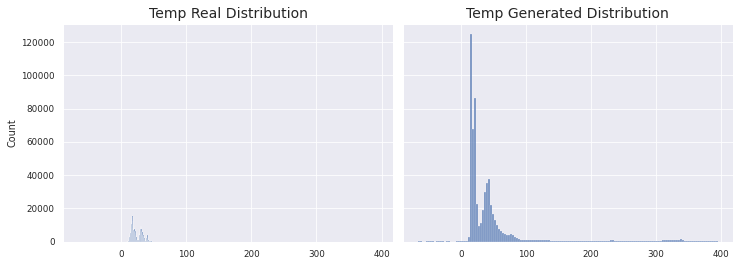

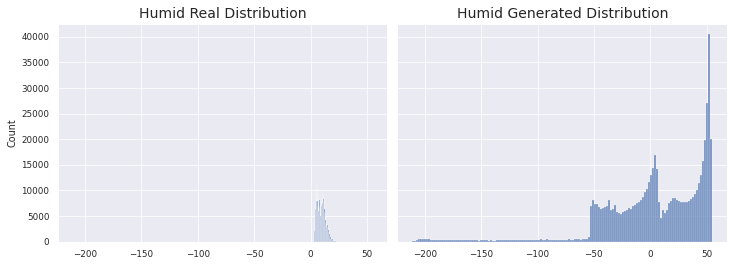

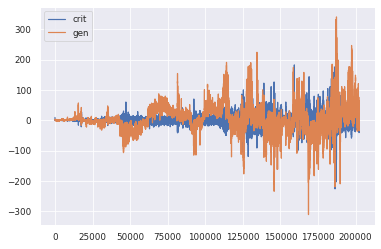

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.3071 - g_loss: 22.0407
Epoch 104/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.6763 - g_loss: 69.5736

KL Divergence: 28.000713370014605 bits
Pinball Loss Temp mean: 19.4488917190919
Pinball Loss Humid mean: 10.66104177678314
MSE Temp: 38.897783438184824
MSE Humid: 21.32208355356621


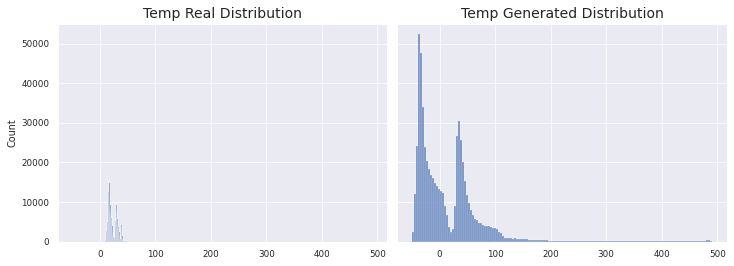

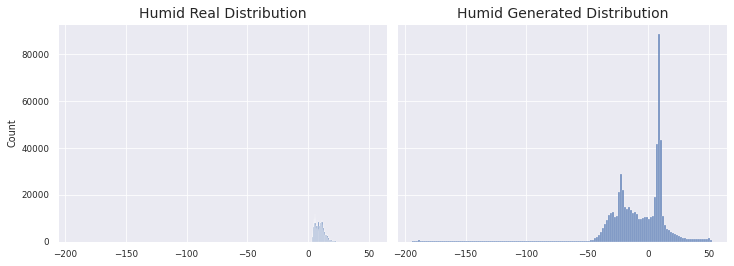

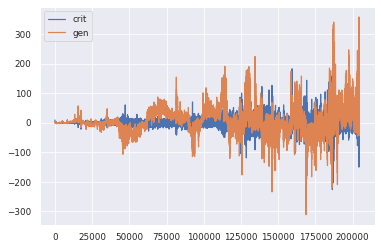

1966/1966 [==============================] - 153s 78ms/step - d_loss: -0.6570 - g_loss: 69.5129
Epoch 105/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2829 - g_loss: 22.7674

KL Divergence: 28.055988429480024 bits
Pinball Loss Temp mean: 13.320268357892678
Pinball Loss Humid mean: 8.003247879534804
MSE Temp: 26.64053671578537
MSE Humid: 16.006495759069992


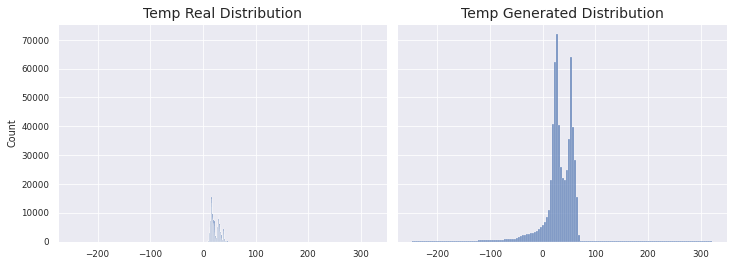

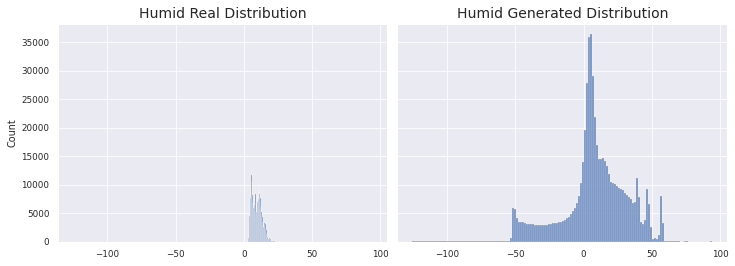

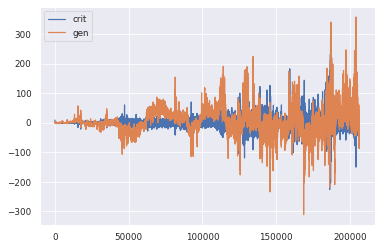

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.2452 - g_loss: 22.7167
Epoch 106/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0732 - g_loss: -10.0554

KL Divergence: 15.087645454533723 bits
Pinball Loss Temp mean: 4.375573665742573
Pinball Loss Humid mean: 2.237550666513835
MSE Temp: 8.751147331485061
MSE Humid: 4.475101333027639


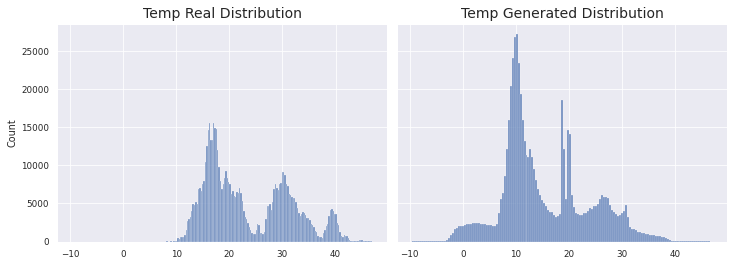

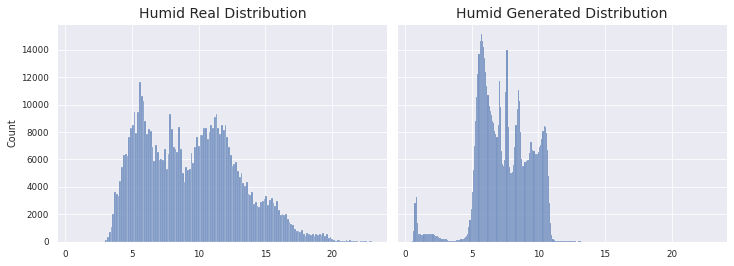

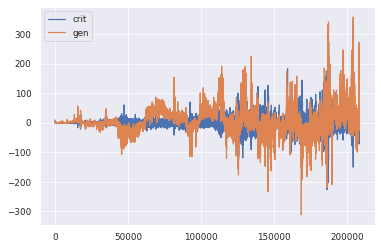

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.0850 - g_loss: -9.9595
Epoch 107/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1041 - g_loss: -2.3607

KL Divergence: 21.87818688511681 bits
Pinball Loss Temp mean: 6.006305539538552
Pinball Loss Humid mean: 2.7579350683756507
MSE Temp: 12.012611079077177
MSE Humid: 5.515870136751305


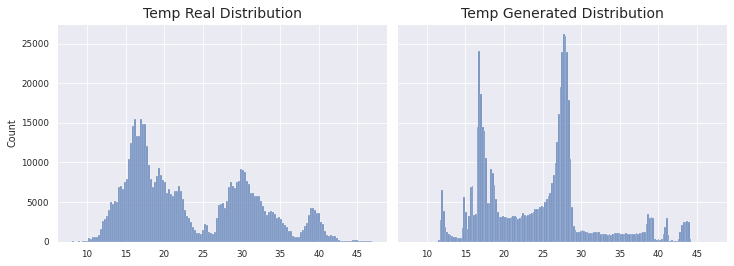

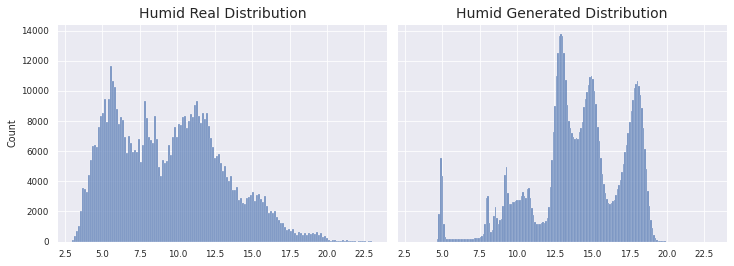

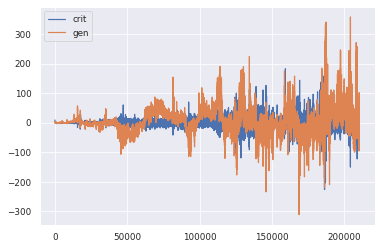

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.0594 - g_loss: -2.3454
Epoch 108/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2649 - g_loss: 60.2688

KL Divergence: 29.125404211701166 bits
Pinball Loss Temp mean: 9.753660954792792
Pinball Loss Humid mean: 5.122731045618495
MSE Temp: 19.50732190958546
MSE Humid: 10.245462091237059


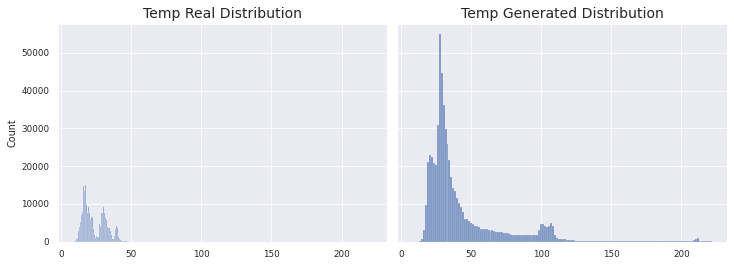

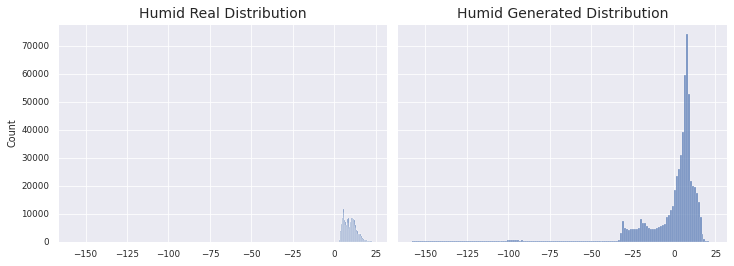

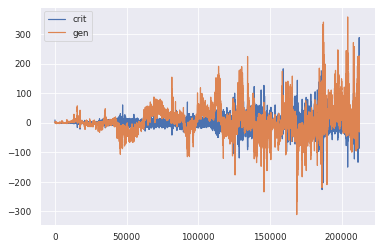

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.0284 - g_loss: 60.1767
Epoch 109/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.0838 - g_loss: 180.2886

KL Divergence: 29.555253263582117 bits
Pinball Loss Temp mean: 6.585615257148595
Pinball Loss Humid mean: 1.5123966718960162
MSE Temp: 13.171230514297156
MSE Humid: 3.0247933437920027


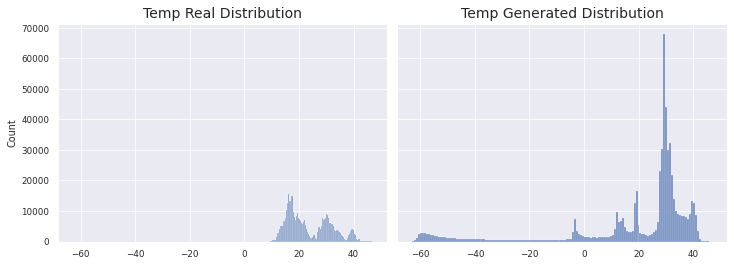

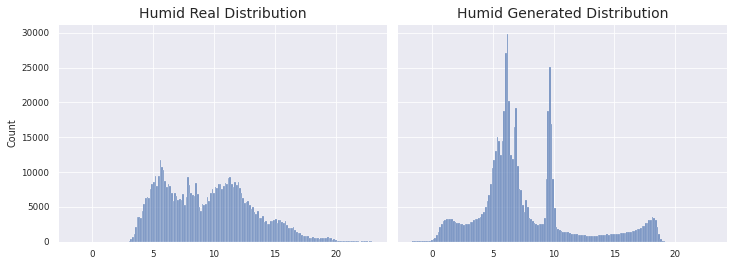

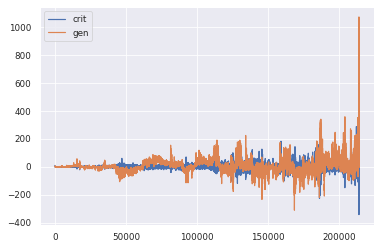

1966/1966 [==============================] - 152s 77ms/step - d_loss: -1.0820 - g_loss: 180.1099
Epoch 110/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3065 - g_loss: 166.8029

KL Divergence: 24.375214247063703 bits
Pinball Loss Temp mean: 6.215799099563233
Pinball Loss Humid mean: 8.220959587059104
MSE Temp: 12.43159819912653
MSE Humid: 16.441919174118194


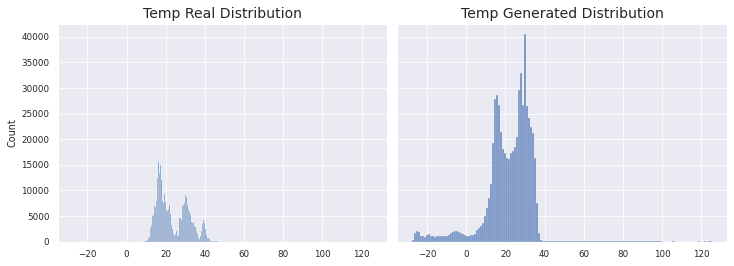

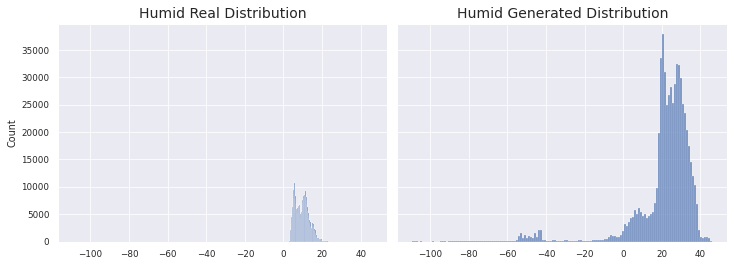

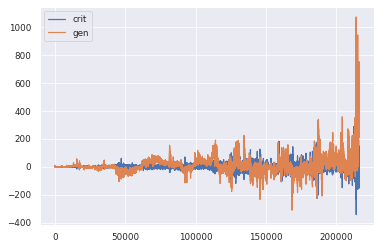

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.3015 - g_loss: 166.8648
Epoch 111/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.6538 - g_loss: 203.0768

KL Divergence: 34.397755122768366 bits
Pinball Loss Temp mean: 11.007143545114703
Pinball Loss Humid mean: 5.578211238561019
MSE Temp: 22.014287090229505
MSE Humid: 11.156422477122028


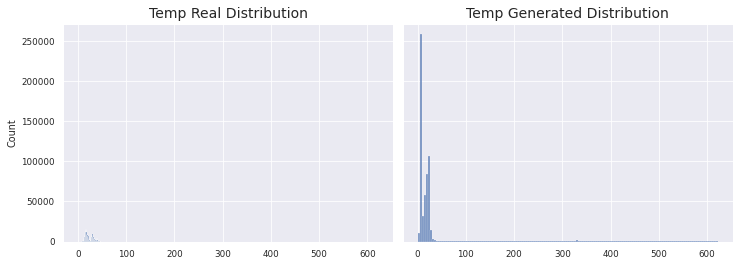

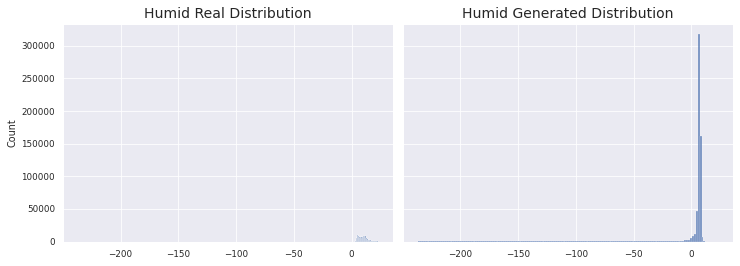

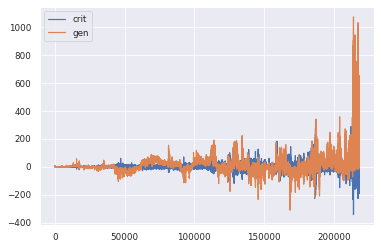

1966/1966 [==============================] - 152s 77ms/step - d_loss: -0.3795 - g_loss: 203.0963
Epoch 112/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5006 - g_loss: 132.5575

KL Divergence: 20.518646514815725 bits
Pinball Loss Temp mean: 6.352939106774204
Pinball Loss Humid mean: 1.8553654243357034
MSE Temp: 12.705878213548267
MSE Humid: 3.71073084867139


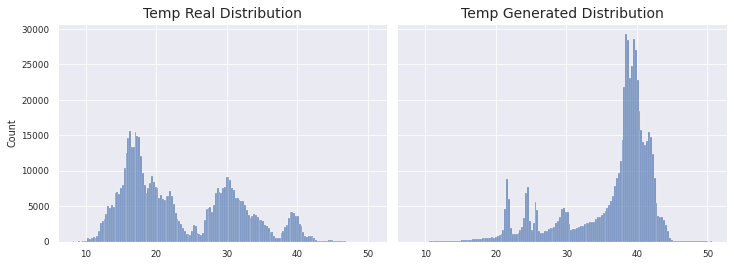

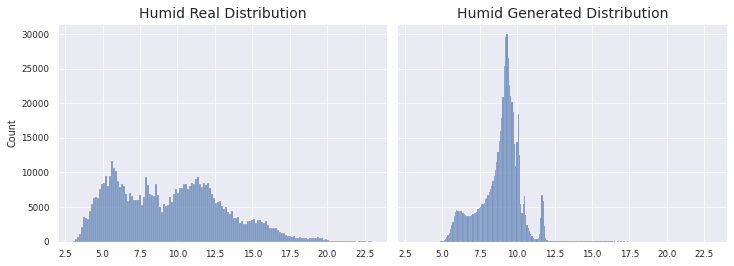

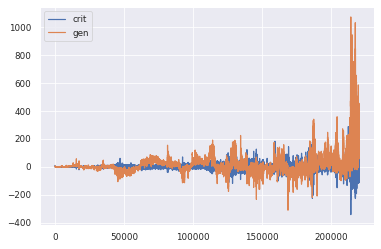

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.6811 - g_loss: 132.5715
Epoch 113/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4459 - g_loss: 130.4412

KL Divergence: 27.610750781686694 bits
Pinball Loss Temp mean: 6.622067014584241
Pinball Loss Humid mean: 1.6952939782192658
MSE Temp: 13.24413402916825
MSE Humid: 3.3905879564384978


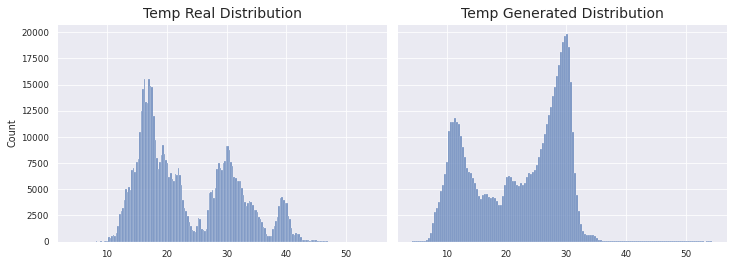

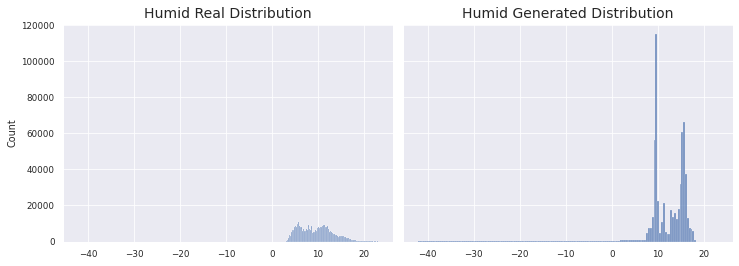

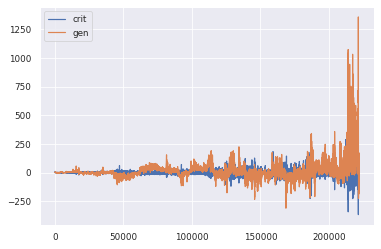

1966/1966 [==============================] - 153s 78ms/step - d_loss: -0.4452 - g_loss: 130.1902
Epoch 114/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.9459 - g_loss: 157.2917

KL Divergence: 14.472326184336207 bits
Pinball Loss Temp mean: 40.58562477769963
Pinball Loss Humid mean: 11.9699192431198
MSE Temp: 81.17124955539867
MSE Humid: 23.939838486239246


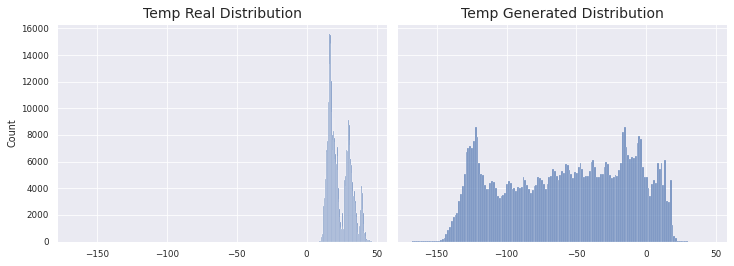

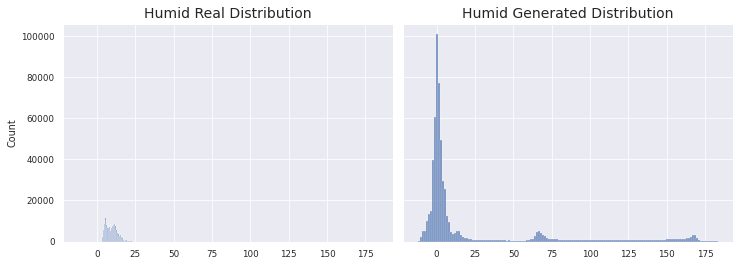

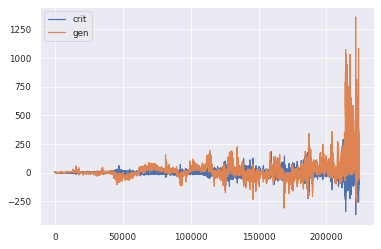

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.8466 - g_loss: 157.1402
Epoch 115/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4850 - g_loss: 109.6348

KL Divergence: 5.402066855053096 bits
Pinball Loss Temp mean: 3.3700376401325904
Pinball Loss Humid mean: 1.8693614227297146
MSE Temp: 6.740075280265213
MSE Humid: 3.7387228454594883


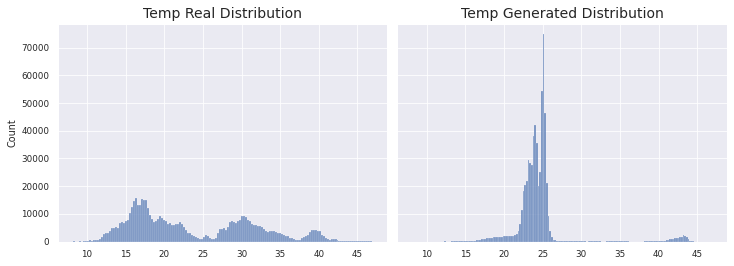

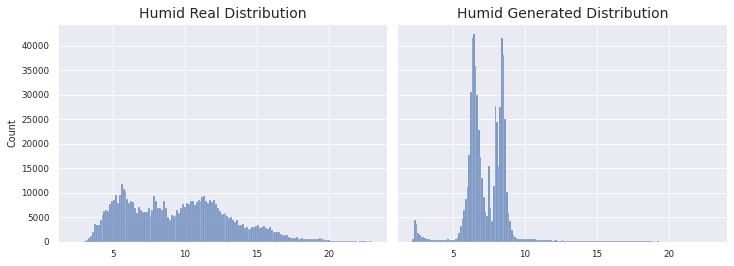

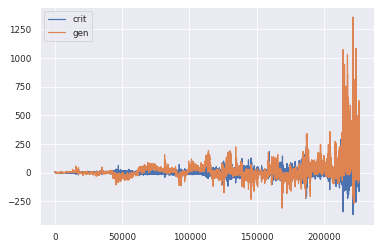

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.4790 - g_loss: 109.5040
Epoch 116/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4299 - g_loss: 82.6380

KL Divergence: 26.72664405050789 bits
Pinball Loss Temp mean: 6.284431056549999
Pinball Loss Humid mean: 2.2795399310754116
MSE Temp: 12.568862113100144
MSE Humid: 4.559079862150787


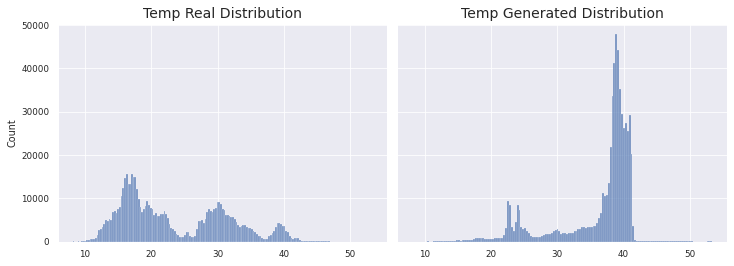

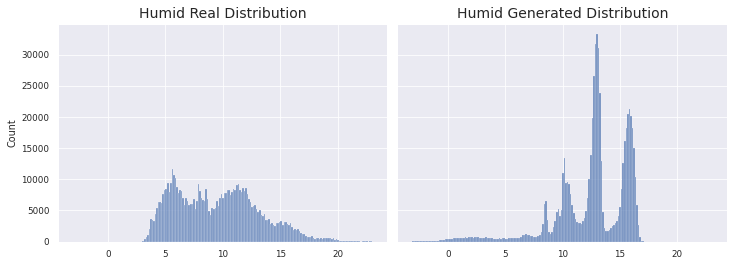

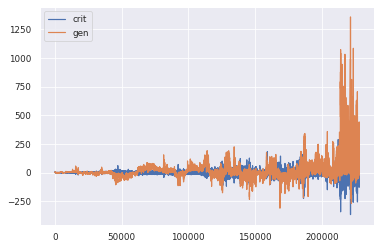

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.3889 - g_loss: 82.8915
Epoch 117/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1024 - g_loss: 79.6189

KL Divergence: 30.93924159305167 bits
Pinball Loss Temp mean: 5.65660667314126
Pinball Loss Humid mean: 1.41175952526299
MSE Temp: 11.313213346282549
MSE Humid: 2.8235190505260173


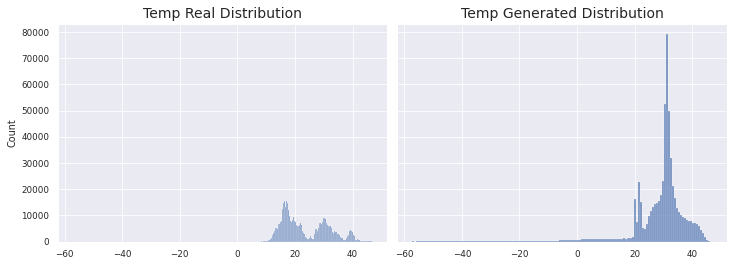

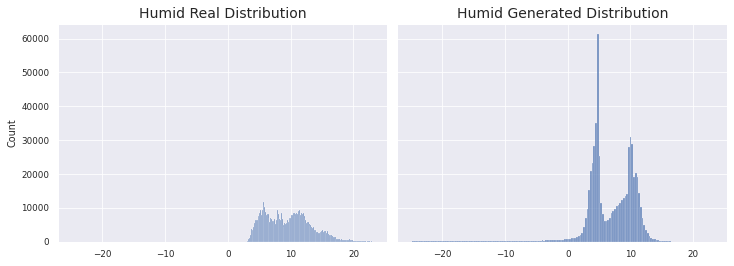

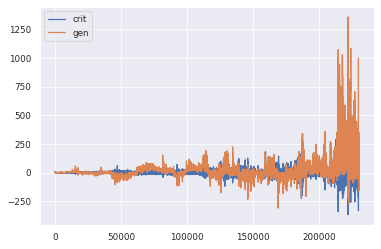

1966/1966 [==============================] - 154s 79ms/step - d_loss: -0.1304 - g_loss: 79.5020
Epoch 118/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3896 - g_loss: 9.0787

KL Divergence: 35.28177193663166 bits
Pinball Loss Temp mean: 9.373037848973537
Pinball Loss Humid mean: 7.676222707994955
MSE Temp: 18.746075697947163
MSE Humid: 15.352445415989994


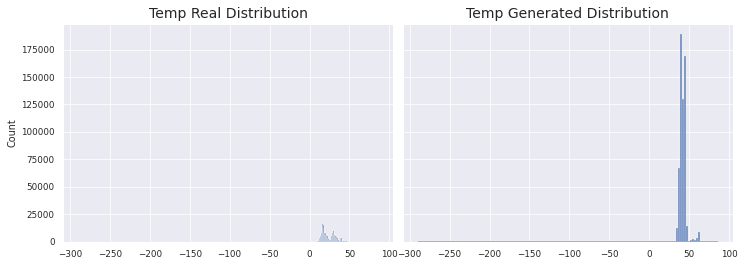

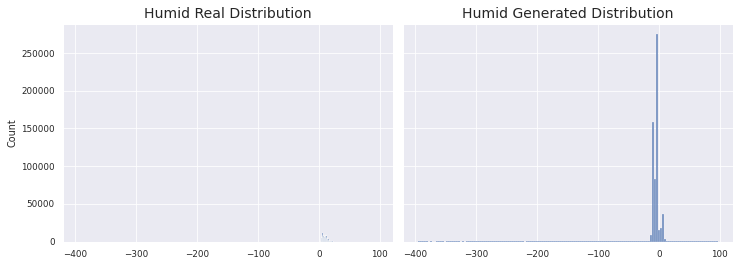

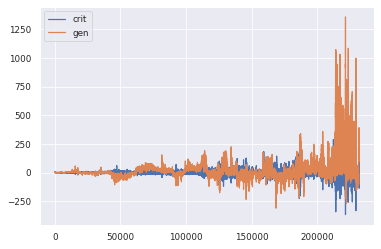

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.3411 - g_loss: 9.1910
Epoch 119/200
1966/1966 [==============================] - ETA: 0s - d_loss: 1.0185 - g_loss: 116.4219

KL Divergence: 22.195118076809333 bits
Pinball Loss Temp mean: 4.407398290200318
Pinball Loss Humid mean: 2.6526294536216954
MSE Temp: 8.814796580400465
MSE Humid: 5.30525890724341


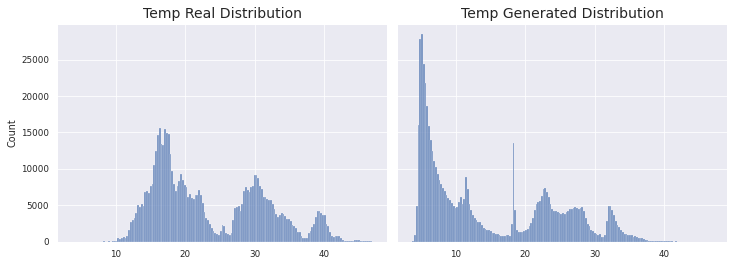

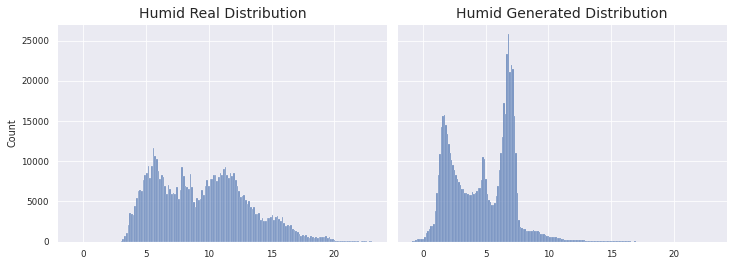

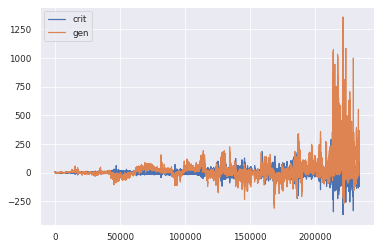

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.9566 - g_loss: 116.4585
Epoch 120/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0197 - g_loss: 86.9499

KL Divergence: 22.69142318227676 bits
Pinball Loss Temp mean: 5.627682962799586
Pinball Loss Humid mean: 7.605464120180524
MSE Temp: 11.25536592559919
MSE Humid: 15.21092824036078


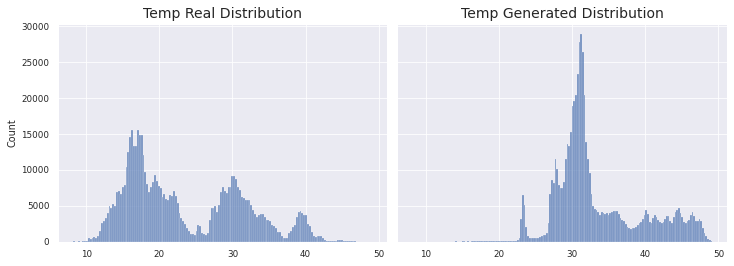

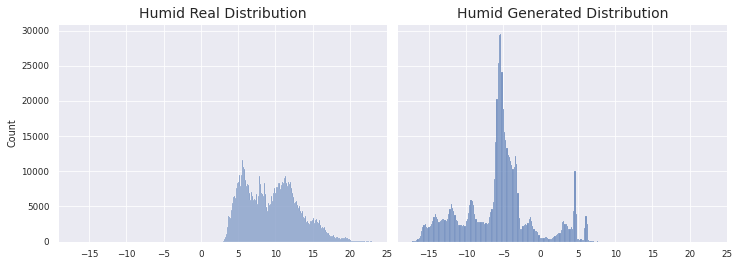

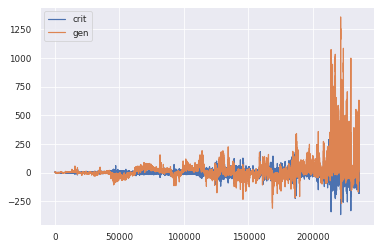

1966/1966 [==============================] - 150s 76ms/step - d_loss: 0.0402 - g_loss: 87.4429
Epoch 121/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1640 - g_loss: 106.2548

KL Divergence: 20.588744138484824 bits
Pinball Loss Temp mean: 62.64251294021394
Pinball Loss Humid mean: 19.616027731022843
MSE Temp: 125.28502588042763
MSE Humid: 39.23205546204644


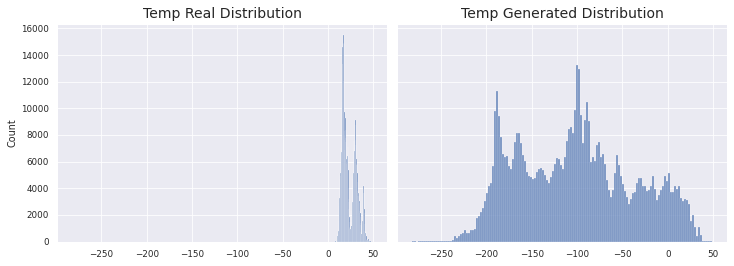

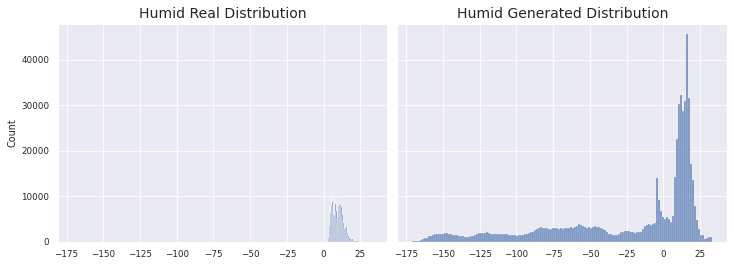

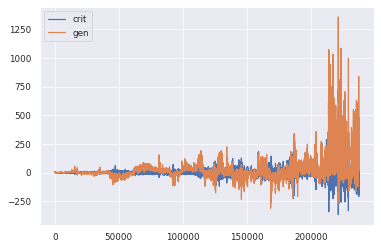

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.2138 - g_loss: 106.1710
Epoch 122/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0250 - g_loss: 74.9641

KL Divergence: 17.881277353633344 bits
Pinball Loss Temp mean: 53.85198050082134
Pinball Loss Humid mean: 20.557123371554418
MSE Temp: 107.70396100164298
MSE Humid: 41.114246743109035


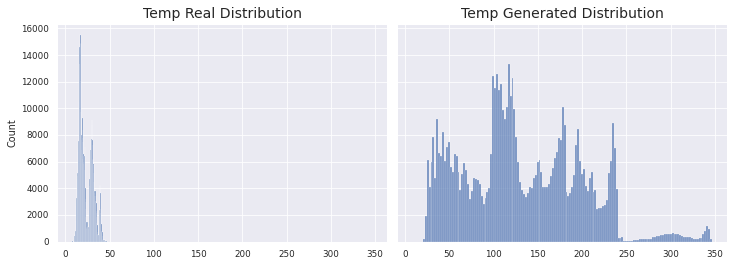

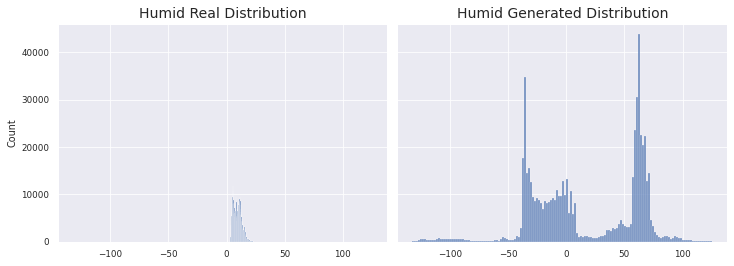

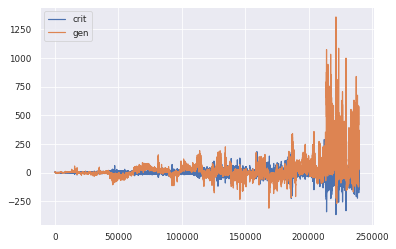

1966/1966 [==============================] - 152s 77ms/step - d_loss: -0.1015 - g_loss: 75.0164
Epoch 123/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.8836 - g_loss: 39.6959

KL Divergence: 5.5373675985840825 bits
Pinball Loss Temp mean: 2.8856368925682476
Pinball Loss Humid mean: 1.0643616239137628
MSE Temp: 5.77127378513645
MSE Humid: 2.1287232478275344


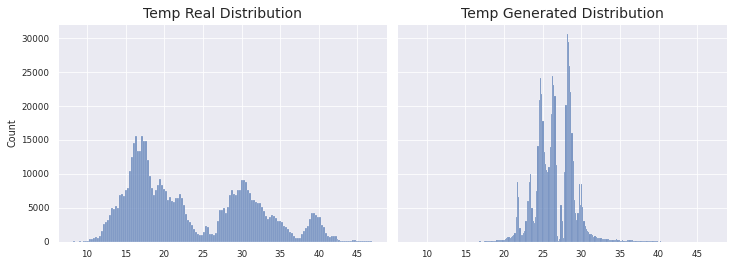

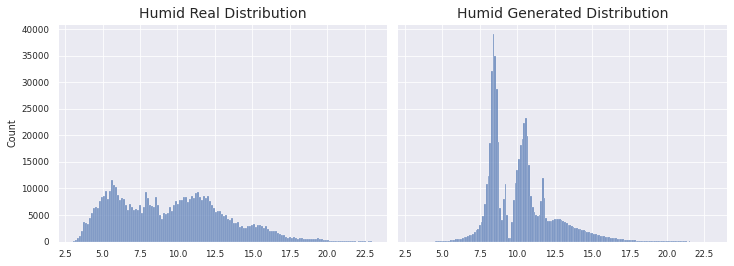

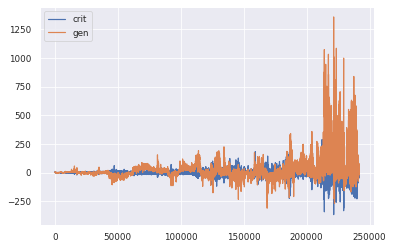

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.8387 - g_loss: 39.7080
Epoch 124/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4754 - g_loss: -41.6420

KL Divergence: 36.1782323140228 bits
Pinball Loss Temp mean: 5.275380632462793
Pinball Loss Humid mean: 2.8554213961050876
MSE Temp: 10.550761264925393
MSE Humid: 5.710842792210198


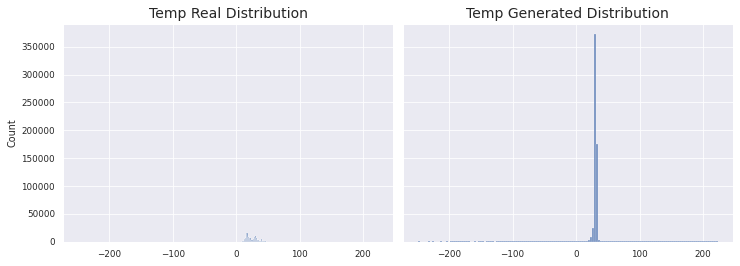

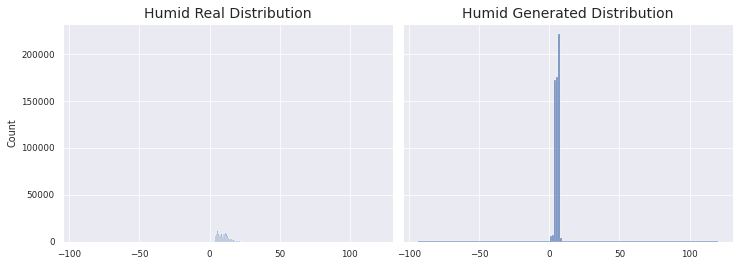

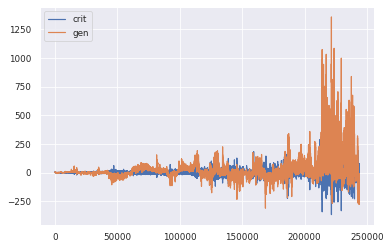

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.4320 - g_loss: -41.7022
Epoch 125/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5377 - g_loss: -132.1957

KL Divergence: 25.56172789283819 bits
Pinball Loss Temp mean: 14.909250543778882
Pinball Loss Humid mean: 7.853110851471685
MSE Temp: 29.81850108755704
MSE Humid: 15.706221702943502


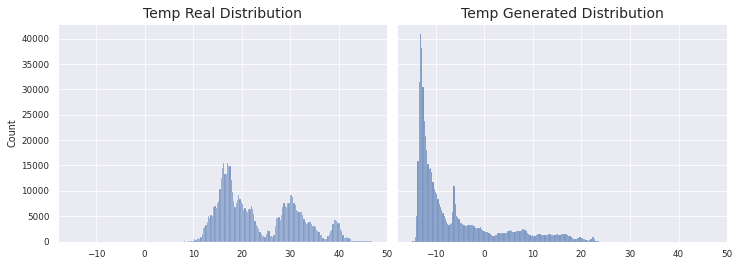

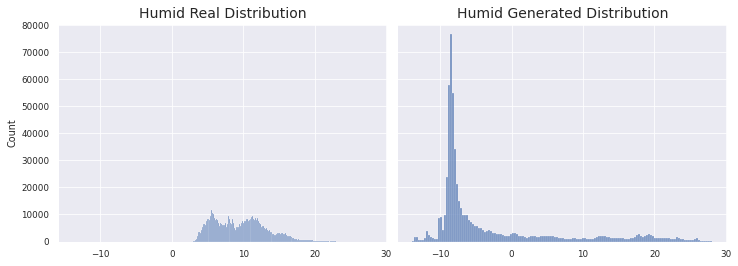

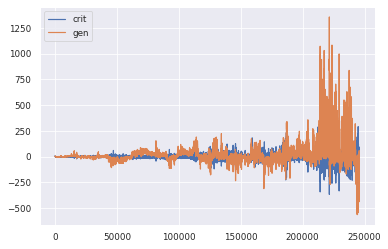

1966/1966 [==============================] - 153s 78ms/step - d_loss: -0.8261 - g_loss: -132.2649
Epoch 126/200
1966/1966 [==============================] - ETA: 0s - d_loss: 1.1016 - g_loss: -65.6872

KL Divergence: 34.422041708546864 bits
Pinball Loss Temp mean: 4.5252637716453386
Pinball Loss Humid mean: 2.2027461834902726
MSE Temp: 9.050527543290643
MSE Humid: 4.405492366980549


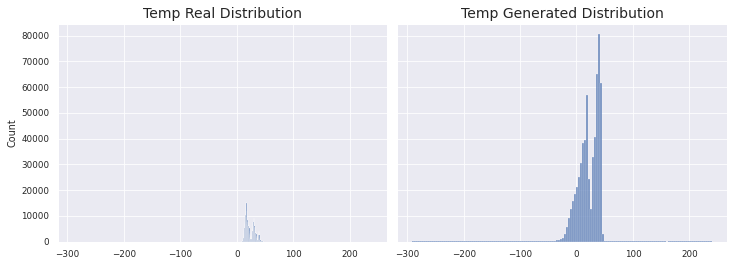

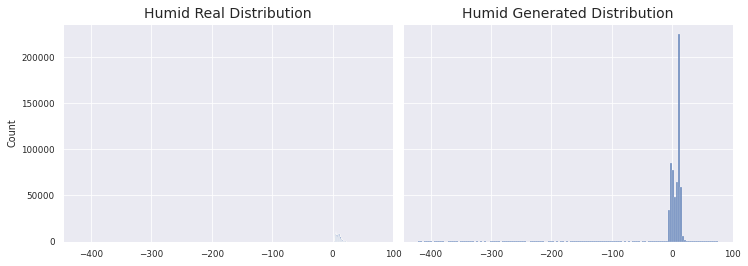

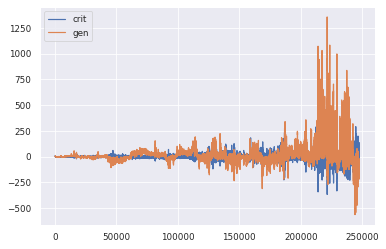

1966/1966 [==============================] - 153s 78ms/step - d_loss: 1.1685 - g_loss: -65.6865
Epoch 127/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7552 - g_loss: -51.4847

KL Divergence: 17.05578702071265 bits
Pinball Loss Temp mean: 2.6091162173294
Pinball Loss Humid mean: 2.2892398795377726
MSE Temp: 5.218232434658858
MSE Humid: 4.5784797590755515


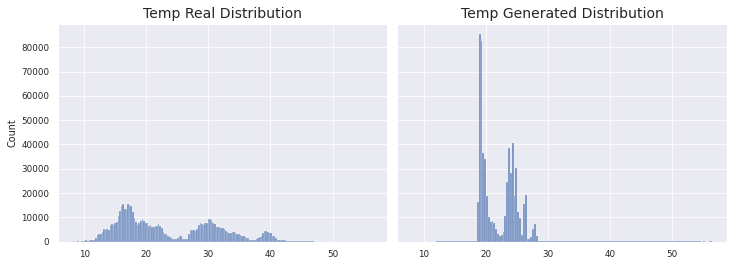

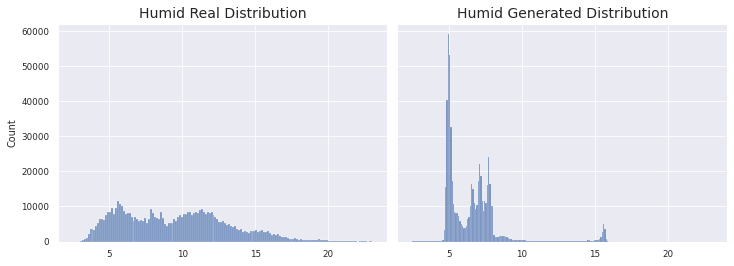

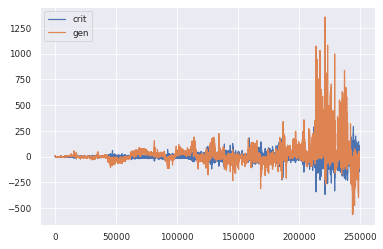

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.6127 - g_loss: -51.4406
Epoch 128/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6506 - g_loss: 40.8764

KL Divergence: 30.859201392903287 bits
Pinball Loss Temp mean: 9.982187028535233
Pinball Loss Humid mean: 7.9824769876747155
MSE Temp: 19.964374057070284
MSE Humid: 15.96495397534962


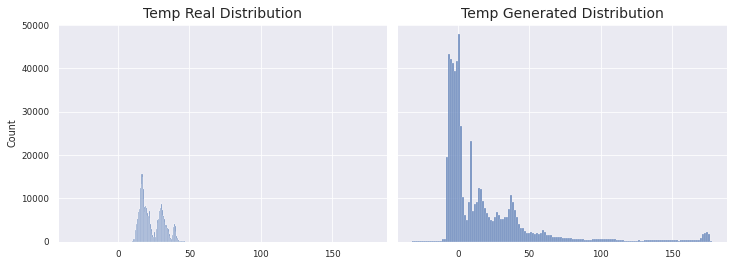

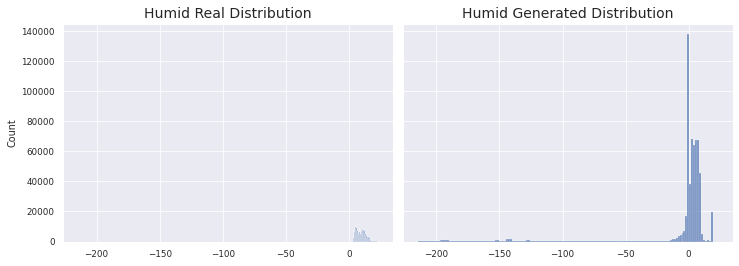

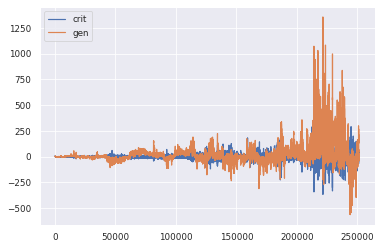

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.6720 - g_loss: 40.8300
Epoch 129/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0842 - g_loss: 48.5151

KL Divergence: 29.897243284942352 bits
Pinball Loss Temp mean: 1.2323167299826754
Pinball Loss Humid mean: 2.782492110555739
MSE Temp: 2.464633459965379
MSE Humid: 5.564984221111385


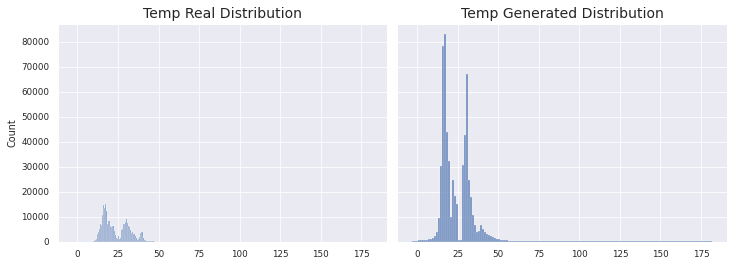

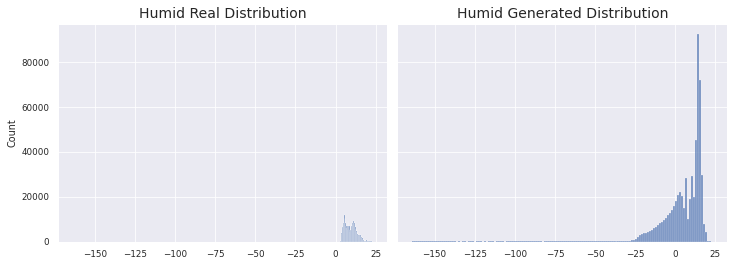

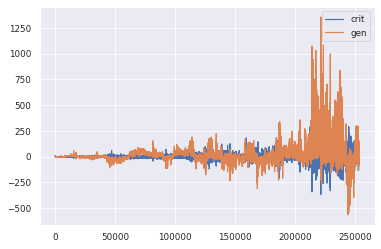

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.0769 - g_loss: 48.6139
Epoch 130/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5710 - g_loss: -18.9402

KL Divergence: 10.511123442730337 bits
Pinball Loss Temp mean: 3.489595043141005
Pinball Loss Humid mean: 1.550007435242741
MSE Temp: 6.97919008628196
MSE Humid: 3.1000148704854817


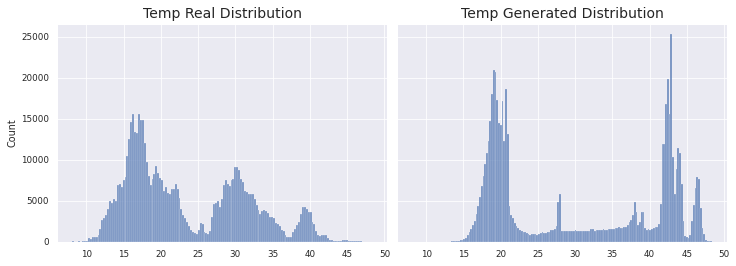

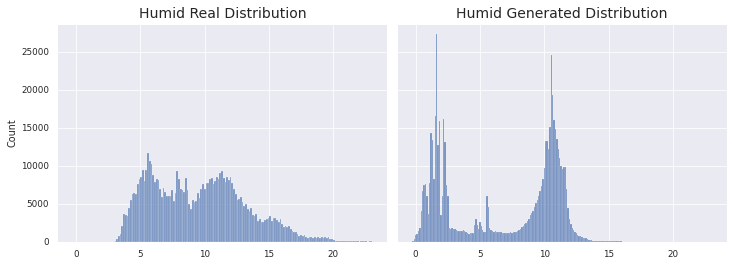

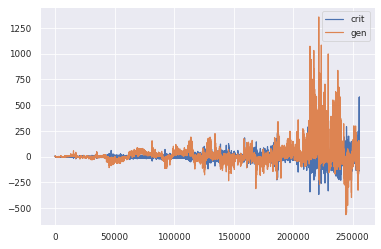

1966/1966 [==============================] - 151s 77ms/step - d_loss: 0.0180 - g_loss: -19.0466
Epoch 131/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4898 - g_loss: -2.7542

KL Divergence: 18.82401494793519 bits
Pinball Loss Temp mean: 1.413593270519324
Pinball Loss Humid mean: 1.1689946148960186
MSE Temp: 2.8271865410386257
MSE Humid: 2.337989229791993


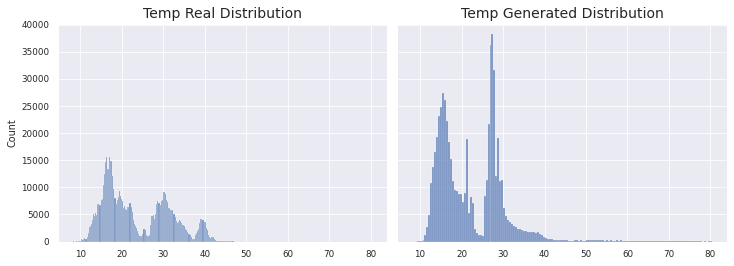

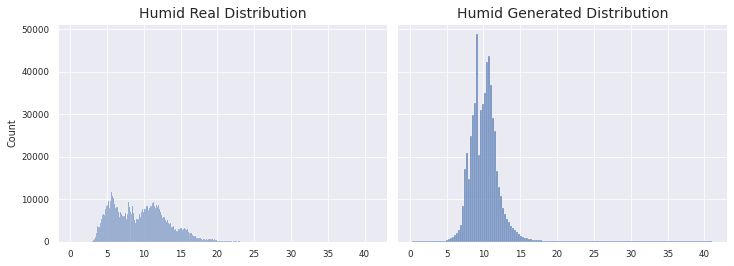

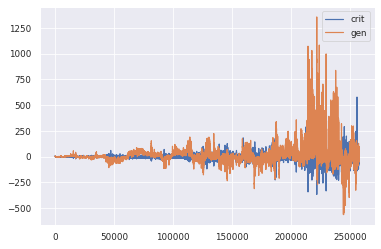

1966/1966 [==============================] - 152s 77ms/step - d_loss: 0.5034 - g_loss: -2.6506
Epoch 132/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2917 - g_loss: -40.2000

KL Divergence: 9.812360705420687 bits
Pinball Loss Temp mean: 4.24705438889635
Pinball Loss Humid mean: 1.7622216929800119
MSE Temp: 8.494108777792794
MSE Humid: 3.5244433859600472


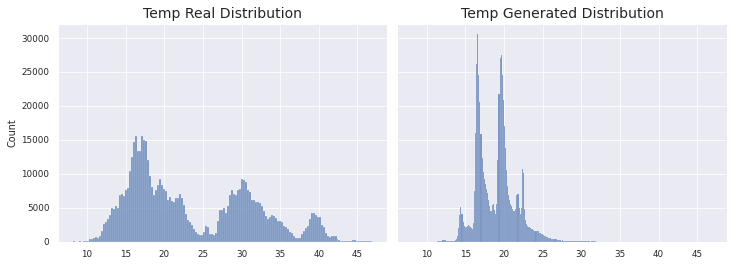

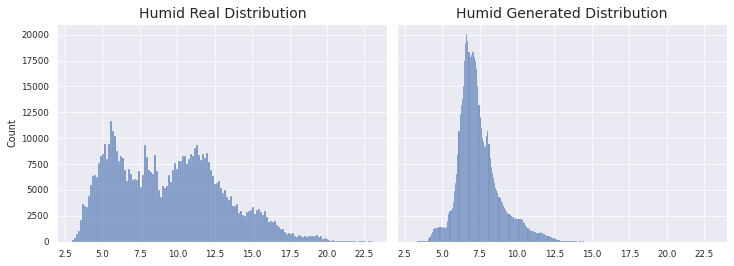

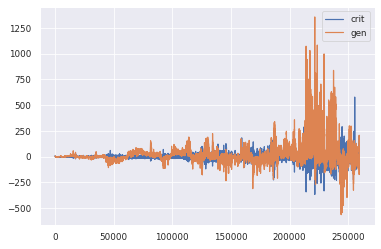

1966/1966 [==============================] - 149s 76ms/step - d_loss: 0.2943 - g_loss: -40.1697
Epoch 133/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.6644 - g_loss: 100.7214

KL Divergence: 30.694811684951123 bits
Pinball Loss Temp mean: 17.030937555199824
Pinball Loss Humid mean: 9.228293372943488
MSE Temp: 34.06187511040031
MSE Humid: 18.456586745886934


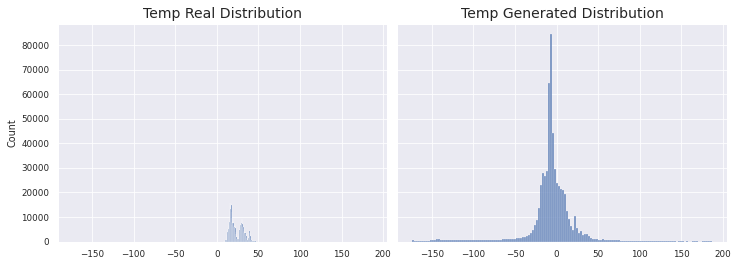

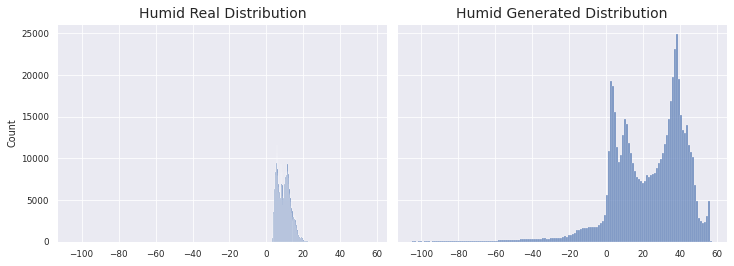

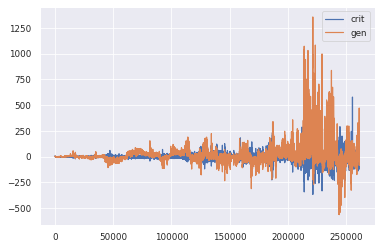

1966/1966 [==============================] - 152s 78ms/step - d_loss: -0.7002 - g_loss: 100.6272
Epoch 134/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.8830 - g_loss: 144.1077

KL Divergence: 32.31994204107732 bits
Pinball Loss Temp mean: 10.088567451785023
Pinball Loss Humid mean: 2.8709346664658435
MSE Temp: 20.17713490356997
MSE Humid: 5.741869332931667


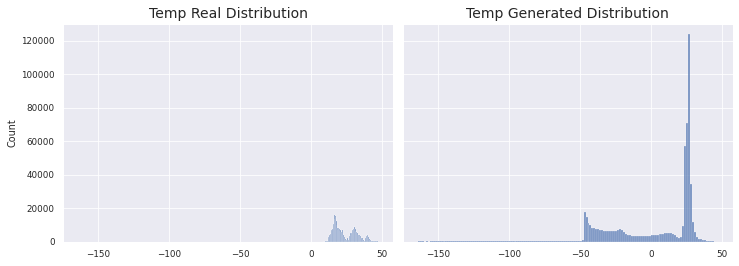

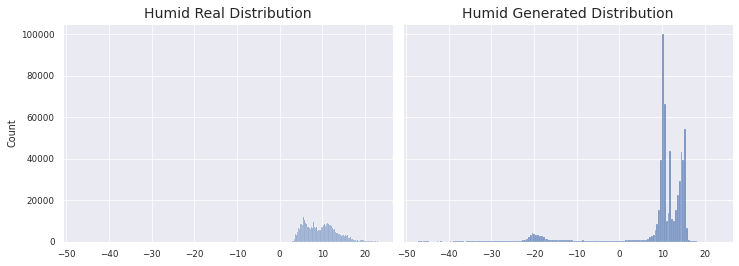

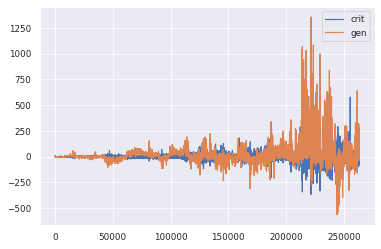

1966/1966 [==============================] - 152s 78ms/step - d_loss: 0.8969 - g_loss: 143.9474
Epoch 135/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6962 - g_loss: 145.1393

KL Divergence: 13.509515905992613 bits
Pinball Loss Temp mean: 2.1970672933721356
Pinball Loss Humid mean: 1.081705980621861
MSE Temp: 4.394134586744378
MSE Humid: 2.16341196124369


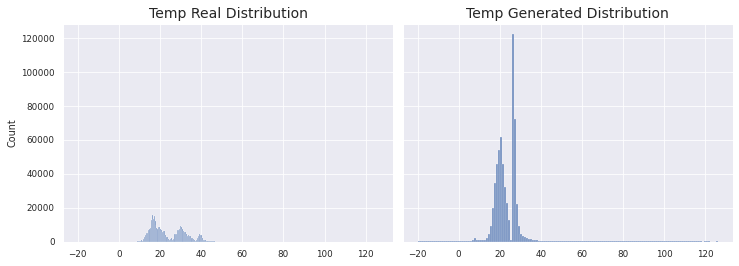

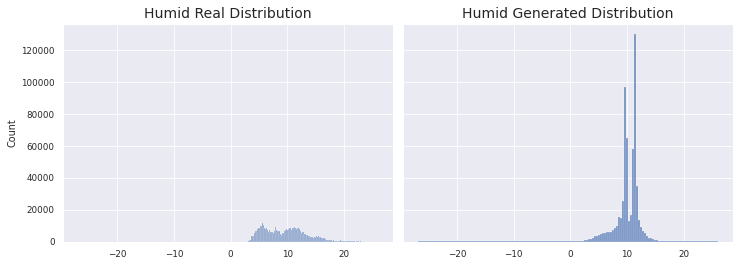

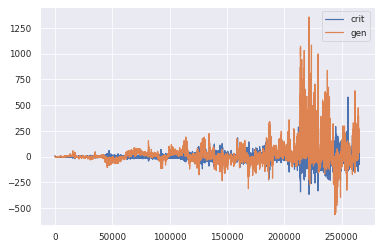

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.7146 - g_loss: 145.1168
Epoch 136/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0864 - g_loss: 180.4453

KL Divergence: 6.608538034142964 bits
Pinball Loss Temp mean: 2.7391781020664867
Pinball Loss Humid mean: 1.5072146757329903
MSE Temp: 5.478356204132968
MSE Humid: 3.0144293514659304


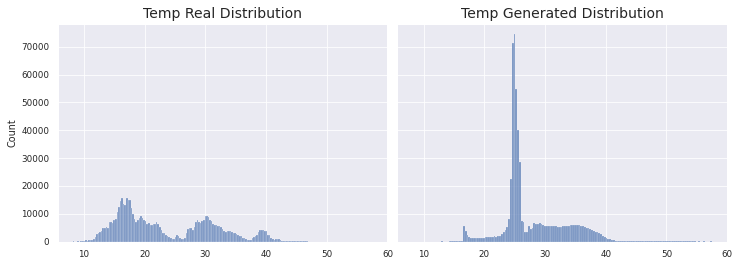

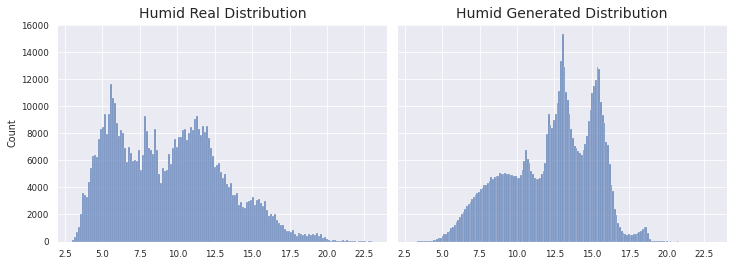

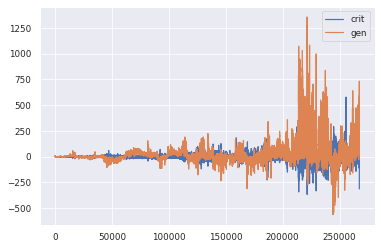

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.2327 - g_loss: 180.8633
Epoch 137/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.8447 - g_loss: 186.7987

KL Divergence: 10.422286152571722 bits
Pinball Loss Temp mean: 4.111296637413686
Pinball Loss Humid mean: 2.2328188470580423
MSE Temp: 8.222593274827311
MSE Humid: 4.465637694115993


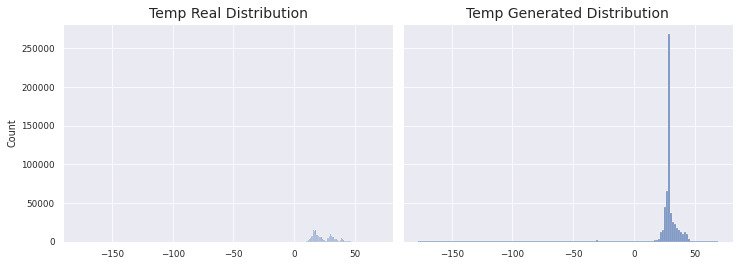

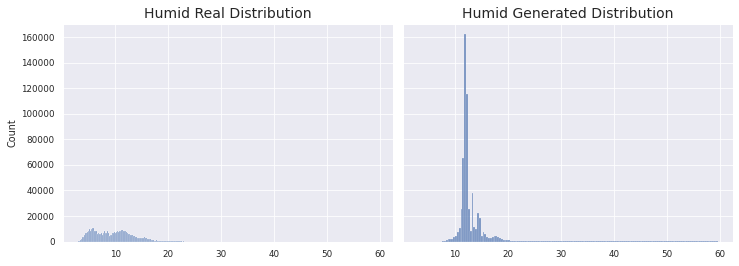

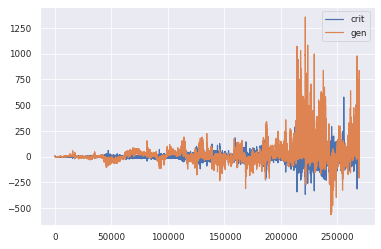

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.8562 - g_loss: 186.7290
Epoch 138/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7551 - g_loss: 43.7143

KL Divergence: 22.292686372497645 bits
Pinball Loss Temp mean: 7.374882428915958
Pinball Loss Humid mean: 4.601056772773968
MSE Temp: 14.749764857831924
MSE Humid: 9.202113545547936


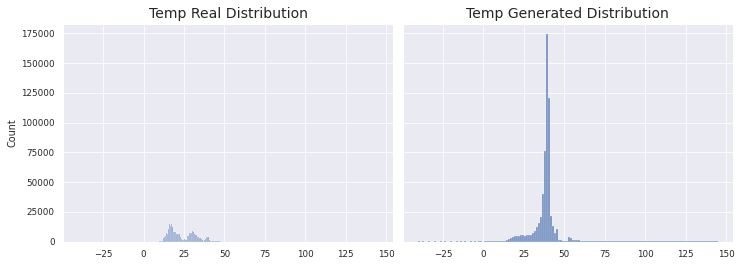

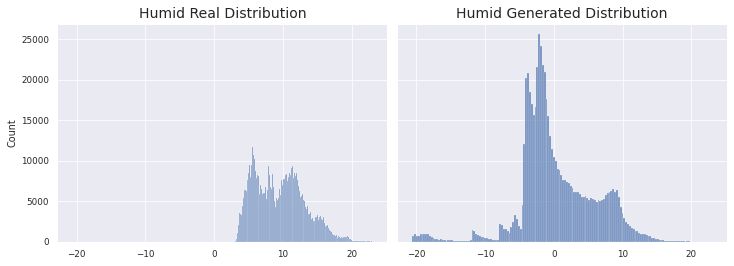

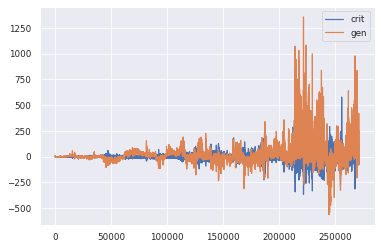

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.7579 - g_loss: 43.6451
Epoch 139/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1146 - g_loss: 155.8020

KL Divergence: 29.78736748957718 bits
Pinball Loss Temp mean: 6.910367331514884
Pinball Loss Humid mean: 1.0901034775343654
MSE Temp: 13.820734663029791
MSE Humid: 2.180206955068712


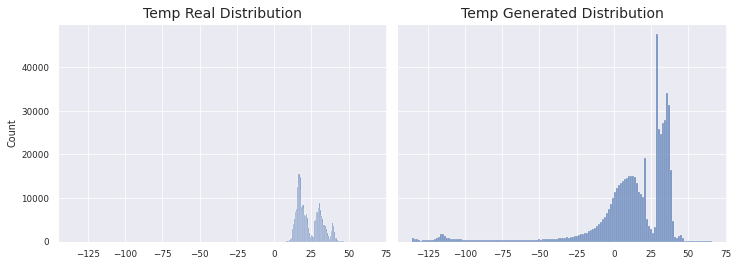

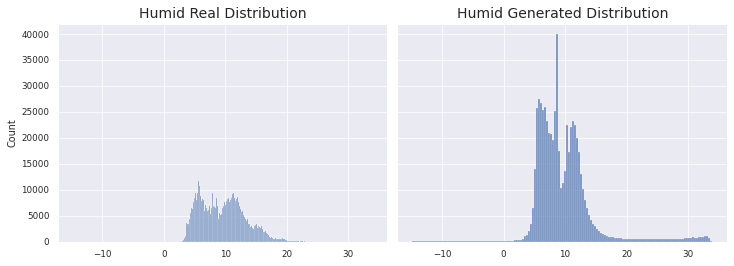

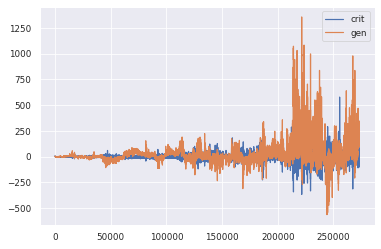

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.1659 - g_loss: 155.7820
Epoch 140/200
1966/1966 [==============================] - ETA: 0s - d_loss: -1.4015 - g_loss: 176.9777

KL Divergence: 19.794015043427972 bits
Pinball Loss Temp mean: 4.368282921672206
Pinball Loss Humid mean: 1.4679003152849177
MSE Temp: 8.736565843344437
MSE Humid: 2.9358006305698354


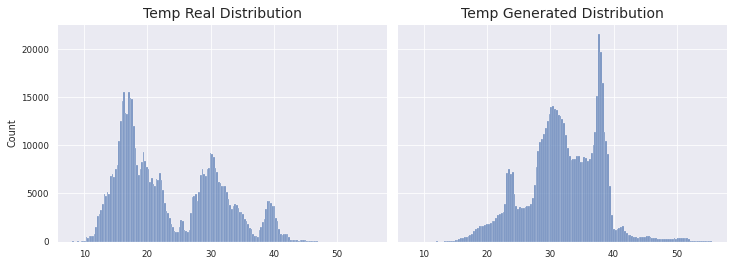

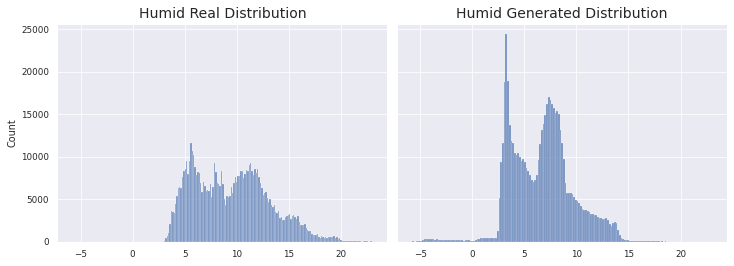

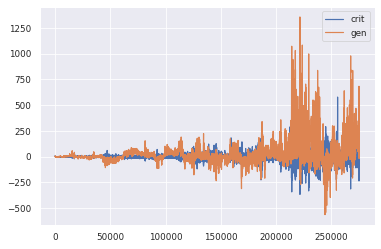

1966/1966 [==============================] - 157s 80ms/step - d_loss: -1.4070 - g_loss: 176.9646
Epoch 141/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3400 - g_loss: 184.8818

KL Divergence: 23.54382333228067 bits
Pinball Loss Temp mean: 2.1522798477635954
Pinball Loss Humid mean: 0.7087706839273232
MSE Temp: 4.304559695527201
MSE Humid: 1.417541367854667


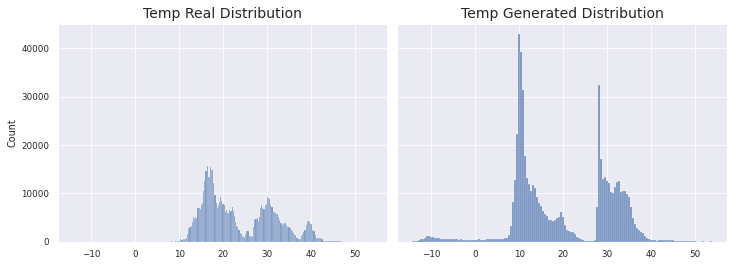

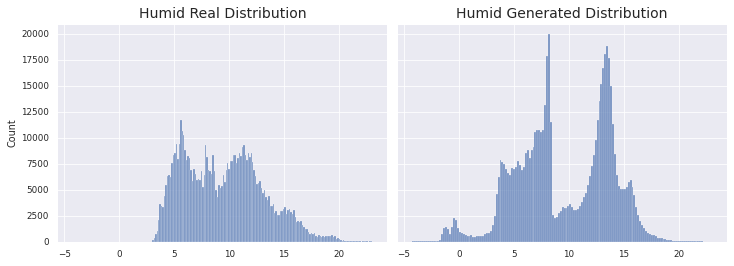

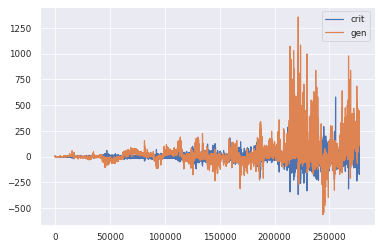

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1672 - g_loss: 185.0206
Epoch 142/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4585 - g_loss: 152.7526

KL Divergence: 12.254067350132406 bits
Pinball Loss Temp mean: 6.254621854169797
Pinball Loss Humid mean: 8.492519083245735
MSE Temp: 12.509243708339806
MSE Humid: 16.985038166490902


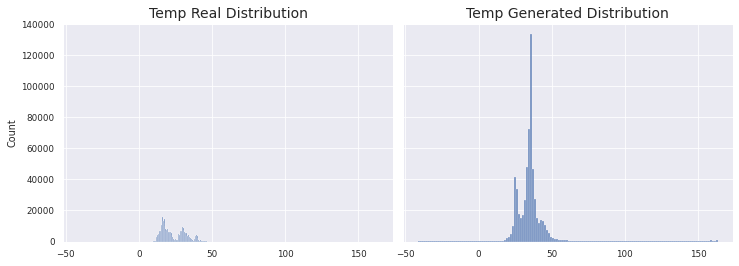

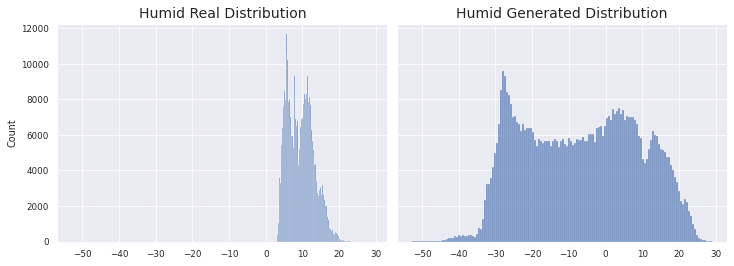

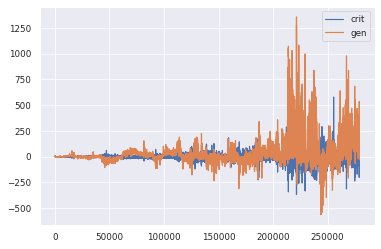

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.4586 - g_loss: 152.5666
Epoch 143/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.4858 - g_loss: 110.0120

KL Divergence: 21.244705966181716 bits
Pinball Loss Temp mean: 5.129522096727565
Pinball Loss Humid mean: 2.528104964303404
MSE Temp: 10.259044193455102
MSE Humid: 5.0562099286068065


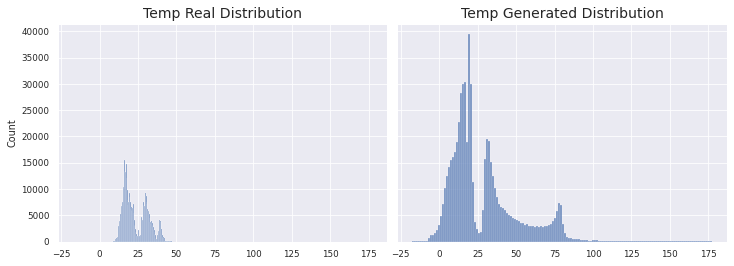

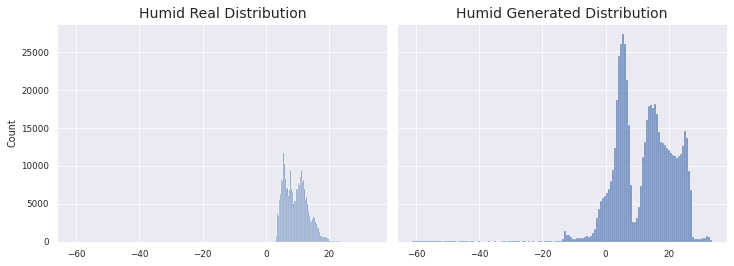

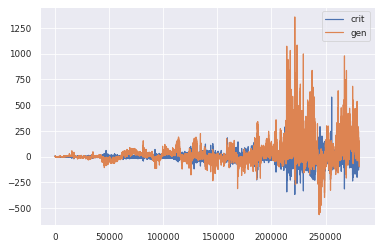

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.4362 - g_loss: 109.9628
Epoch 144/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2821 - g_loss: 114.6097

KL Divergence: 16.3068346173603 bits
Pinball Loss Temp mean: 31.00166799678292
Pinball Loss Humid mean: 4.680267211086598
MSE Temp: 62.00333599356581
MSE Humid: 9.360534422173112


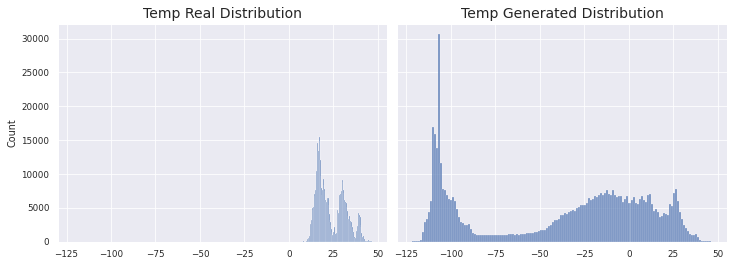

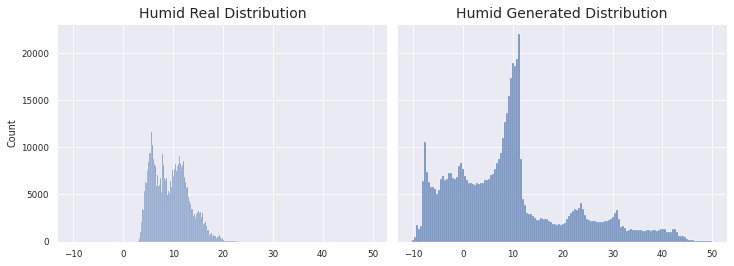

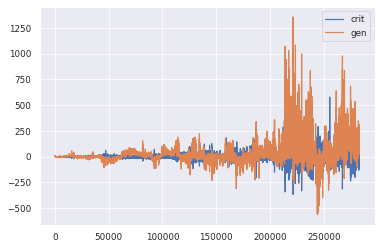

1966/1966 [==============================] - 154s 79ms/step - d_loss: 0.2791 - g_loss: 114.7682
Epoch 145/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1851 - g_loss: 221.7153

KL Divergence: 27.457958568240013 bits
Pinball Loss Temp mean: 23.124103692333414
Pinball Loss Humid mean: 6.1546831104438935
MSE Temp: 46.24820738466641
MSE Humid: 12.309366220887796


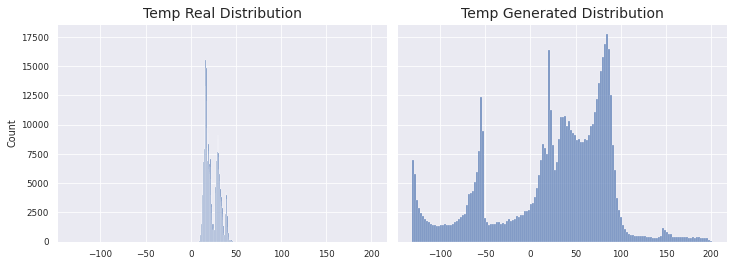

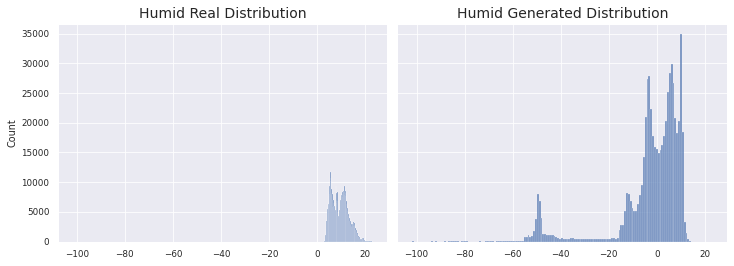

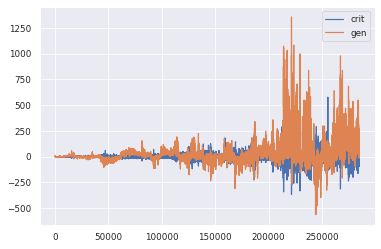

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.2643 - g_loss: 221.6585
Epoch 146/200
1966/1966 [==============================] - ETA: 0s - d_loss: 1.3537 - g_loss: 78.8422

KL Divergence: 24.971038838026256 bits
Pinball Loss Temp mean: 5.559303485364564
Pinball Loss Humid mean: 3.8157104999468663
MSE Temp: 11.11860697072919
MSE Humid: 7.631420999893705


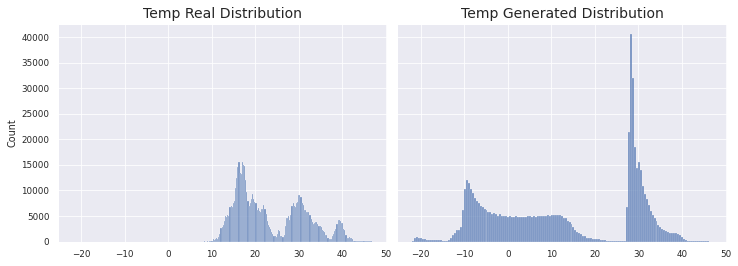

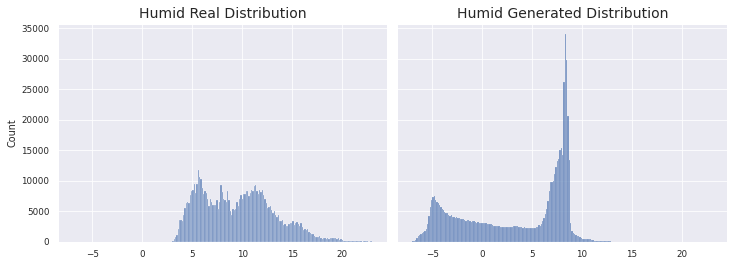

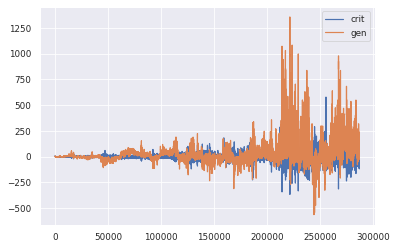

1966/1966 [==============================] - 149s 76ms/step - d_loss: 1.2929 - g_loss: 78.8529
Epoch 147/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1442 - g_loss: 12.8975

KL Divergence: 17.649980098303118 bits
Pinball Loss Temp mean: 1.6451941808554458
Pinball Loss Humid mean: 0.9127596478021536
MSE Temp: 3.2903883617109155
MSE Humid: 1.8255192956043347


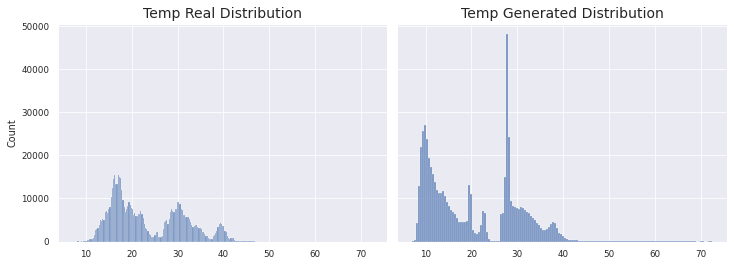

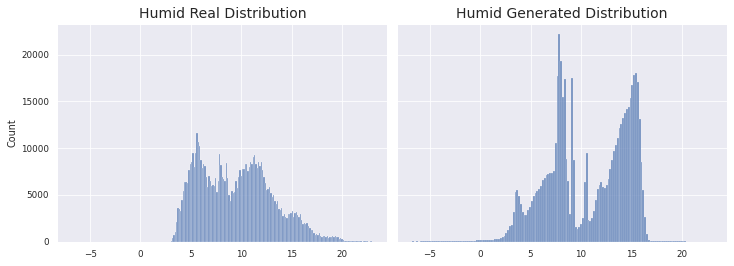

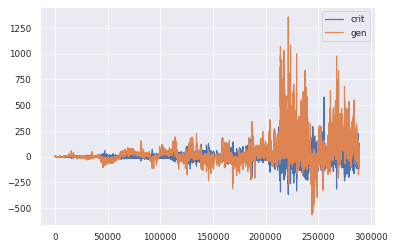

1966/1966 [==============================] - 153s 78ms/step - d_loss: -0.1546 - g_loss: 12.8319
Epoch 148/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.2535 - g_loss: 17.4080

KL Divergence: 30.12057778501701 bits
Pinball Loss Temp mean: 18.655004074301562
Pinball Loss Humid mean: 7.7809214634876955
MSE Temp: 37.31000814860291
MSE Humid: 15.561842926975407


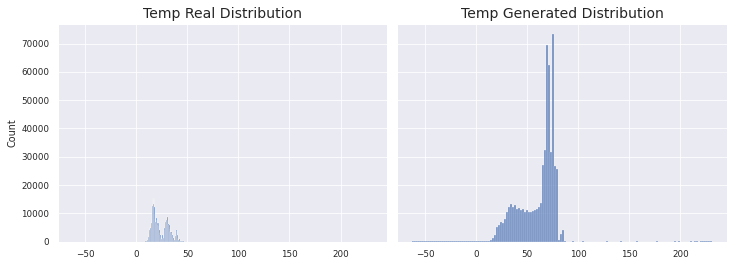

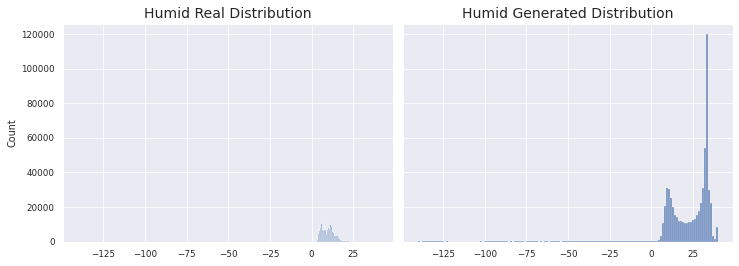

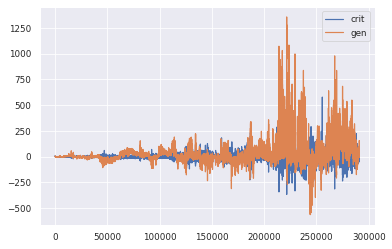

1966/1966 [==============================] - 155s 79ms/step - d_loss: 1.2492 - g_loss: 17.4116
Epoch 149/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4912 - g_loss: 115.7149

KL Divergence: 19.59662521332466 bits
Pinball Loss Temp mean: 35.13292410737055
Pinball Loss Humid mean: 11.604130129866553
MSE Temp: 70.26584821474063
MSE Humid: 23.208260259733777


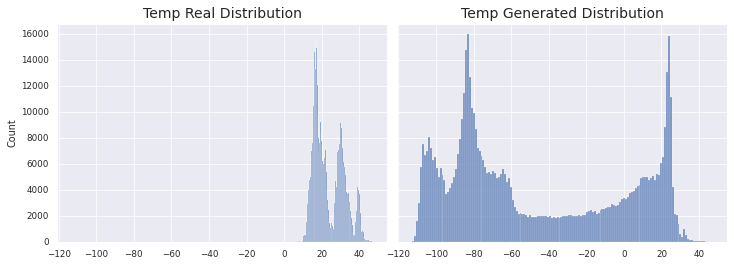

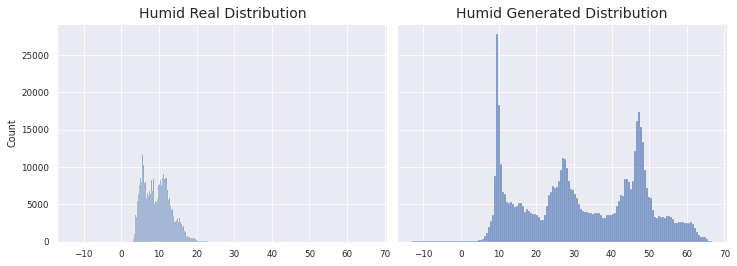

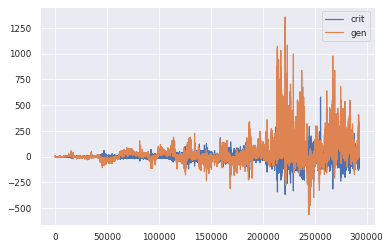

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.4828 - g_loss: 115.6065
Epoch 150/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1826 - g_loss: 186.4044

KL Divergence: 24.114535286396784 bits
Pinball Loss Temp mean: 3.0401946788231906
Pinball Loss Humid mean: 1.3997642010883542
MSE Temp: 6.08038935764627
MSE Humid: 2.799528402176675


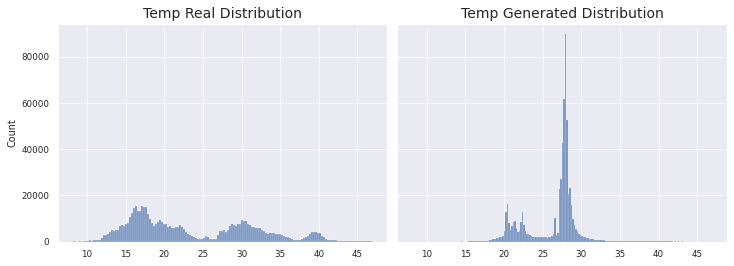

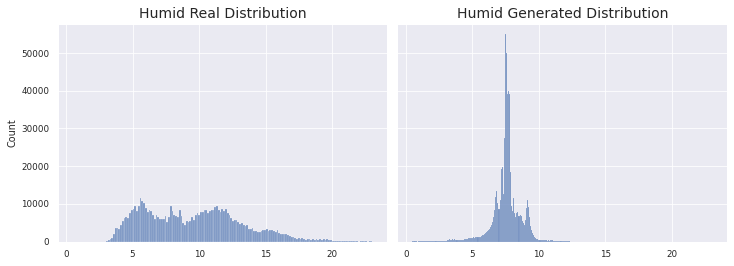

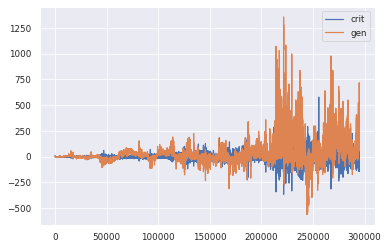

1966/1966 [==============================] - 152s 77ms/step - d_loss: -0.2473 - g_loss: 186.3222
Epoch 151/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6069 - g_loss: 270.1812

KL Divergence: 30.153030841186144 bits
Pinball Loss Temp mean: 6.329289607003183
Pinball Loss Humid mean: 2.369220937976503
MSE Temp: 12.658579214006497
MSE Humid: 4.738441875952952


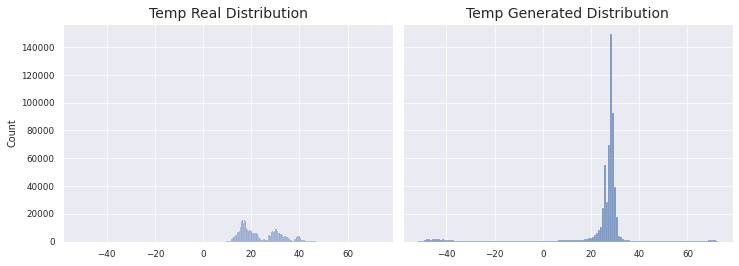

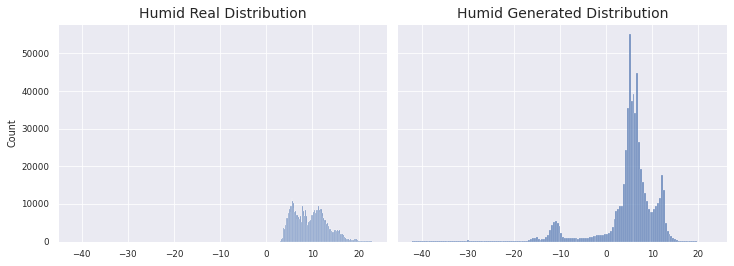

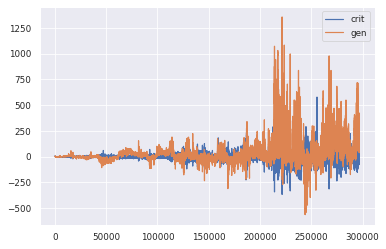

1966/1966 [==============================] - 153s 78ms/step - d_loss: 0.5596 - g_loss: 270.1712
Epoch 152/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3904 - g_loss: 286.1319

KL Divergence: 28.646307252989565 bits
Pinball Loss Temp mean: 27.841637961035985
Pinball Loss Humid mean: 11.871105573190054
MSE Temp: 55.6832759220709
MSE Humid: 23.742211146380065


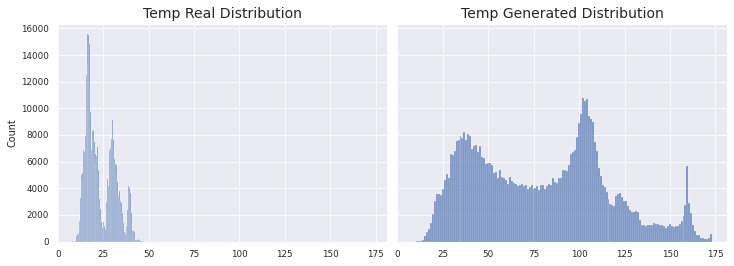

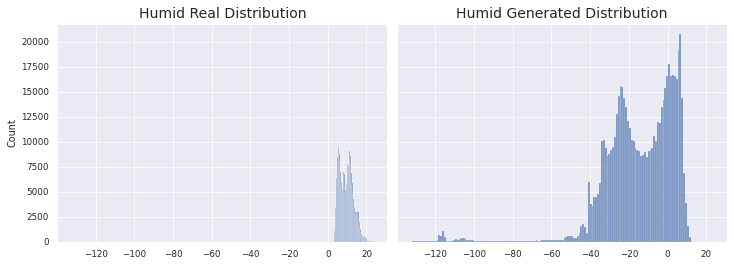

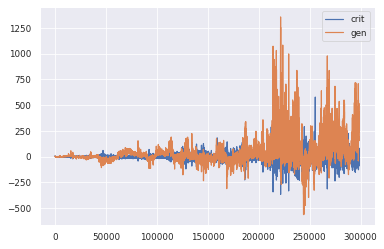

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.3195 - g_loss: 286.0391
Epoch 153/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1282 - g_loss: 212.4380

KL Divergence: 22.824134146995025 bits
Pinball Loss Temp mean: 3.394507621550102
Pinball Loss Humid mean: 3.380785644596481
MSE Temp: 6.789015243100173
MSE Humid: 6.76157128919286


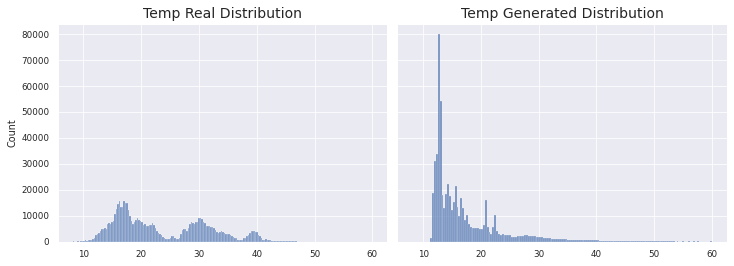

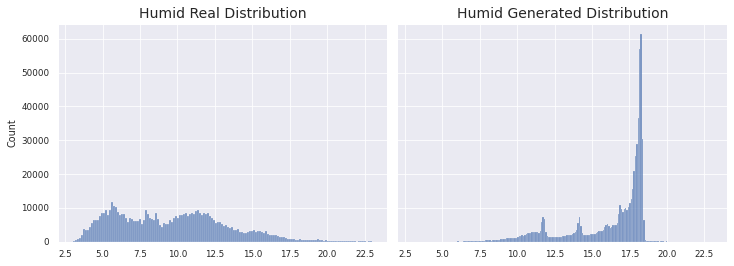

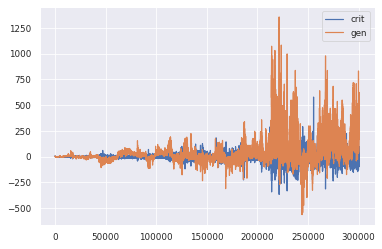

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0611 - g_loss: 212.8561
Epoch 154/200
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7831 - g_loss: 259.0349

KL Divergence: 9.245525105792389 bits
Pinball Loss Temp mean: 2.201501469404252
Pinball Loss Humid mean: 1.9093510359528607
MSE Temp: 4.403002938808523
MSE Humid: 3.8187020719056686


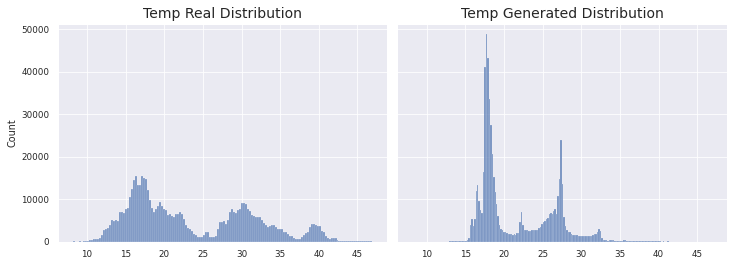

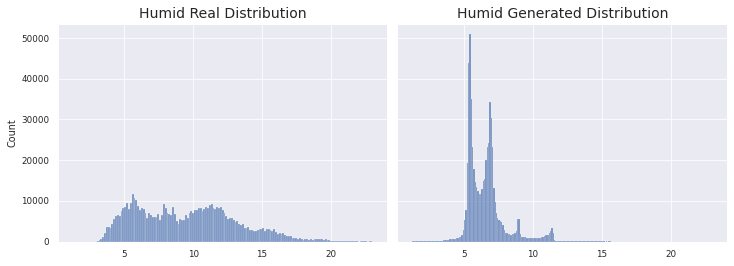

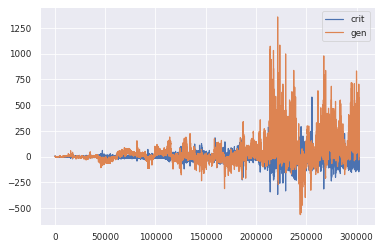

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.8481 - g_loss: 258.9141
Epoch 155/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2331 - g_loss: 230.1826

KL Divergence: 10.226115152304368 bits
Pinball Loss Temp mean: 2.2211796305769083
Pinball Loss Humid mean: 0.9792197082701177
MSE Temp: 4.442359261153799
MSE Humid: 1.9584394165402303


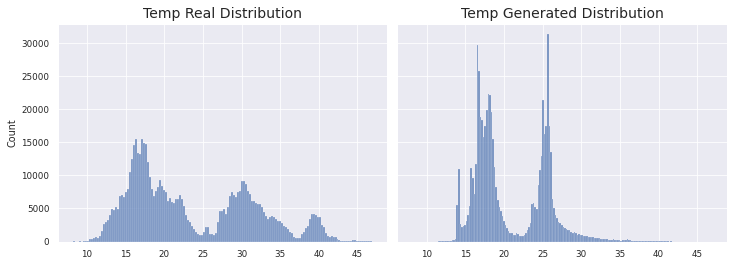

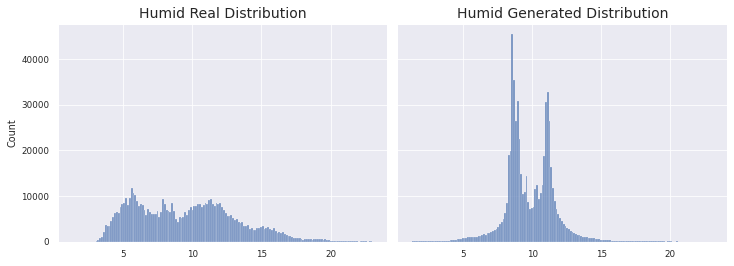

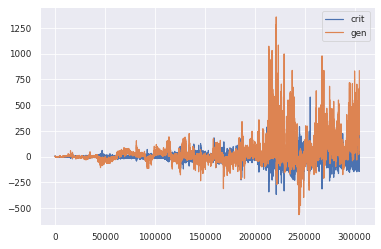

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.3232 - g_loss: 230.7986
Epoch 156/200
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.9797 - g_loss: 358.0456

KL Divergence: 11.000005470199312 bits
Pinball Loss Temp mean: 4.262008966160005
Pinball Loss Humid mean: 3.2470572319101207
MSE Temp: 8.52401793232004
MSE Humid: 6.494114463820301


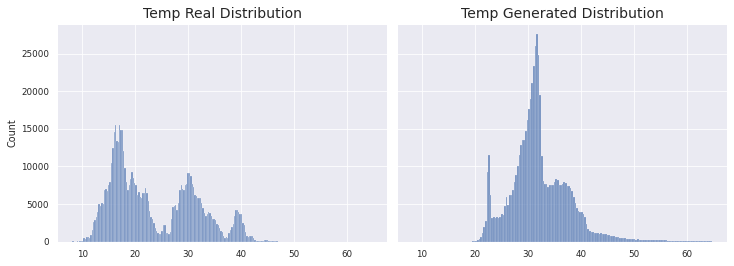

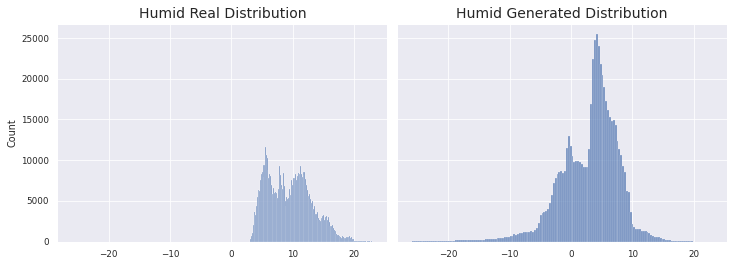

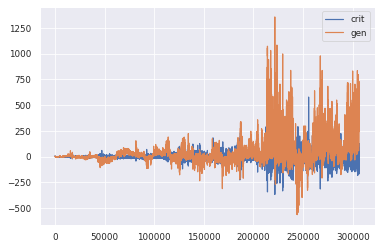

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.8624 - g_loss: 358.2120
Epoch 157/200
1203/1966 [=================>............] - ETA: 29s - d_loss: 0.9682 - g_loss: 361.2538

KeyboardInterrupt: ignored

In [ ]:
# prueba_14
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_13
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=5,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization_4 (Spect (None, 25, 64)       640         input_6[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_7 (LeakyReLU)       (None, 25, 64)       0           spectral_normalization_4[0][0]   
__________________________________________________________________________________________________
spectral_normalization_5 (Spect (None, 25, 128)      33024       leaky_re_lu_7[0][0]              
_______________________________________________________________________________________

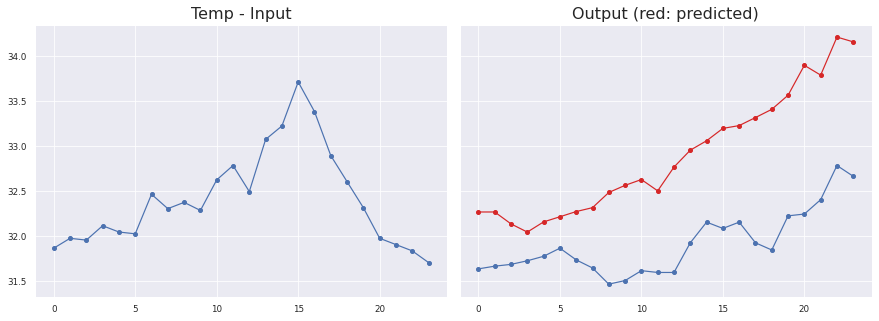

Sensor #15.0
Temp
MAE: 0.9795756420989822 ± 0.40014742867779207
MSE: 1.119686403271082
RMSE: 1.0581523535252766
Max Error: 1.6548595666885362


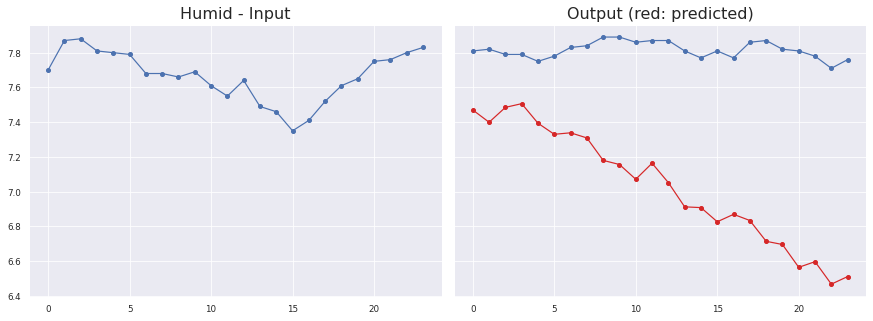

Sensor #15.0
Humid
MAE: 0.783911749112109 ± 0.3198768957429446
MSE: 0.7168388588261486
RMSE: 0.8466633680667592
Max Error: 1.2495527970790867


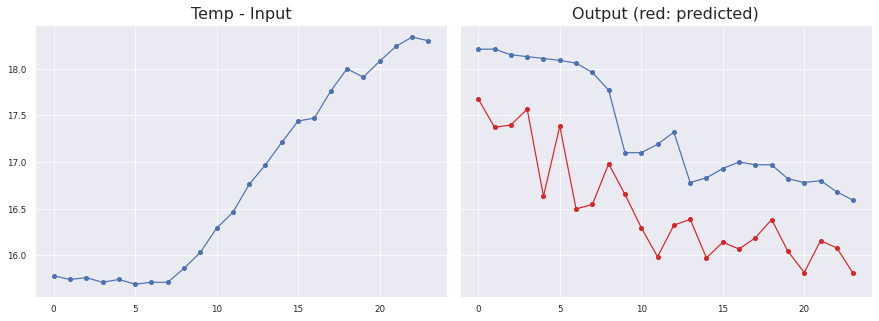

Sensor #1.0
Temp
MAE: 0.8422956422964729 ± 0.3007687982495254
MSE: 0.7999238190320916
RMSE: 0.8943846035303222
Max Error: 1.5632763099670406


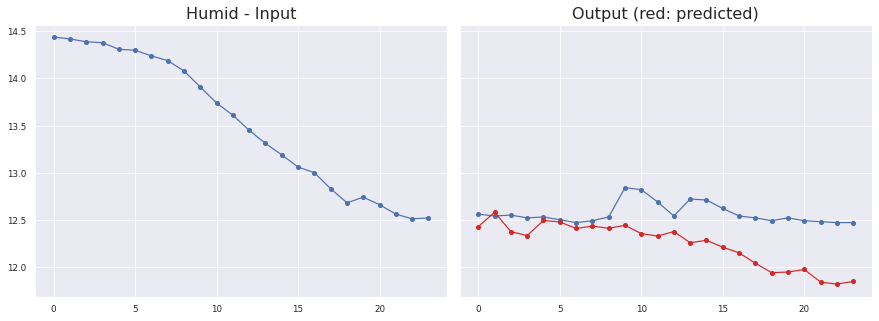

Sensor #1.0
Humid
MAE: 0.3320013841753822 ± 0.21747010766721953
MSE: 0.15532312082522556
RMSE: 0.3941105439153152
Max Error: 0.6534437496960166


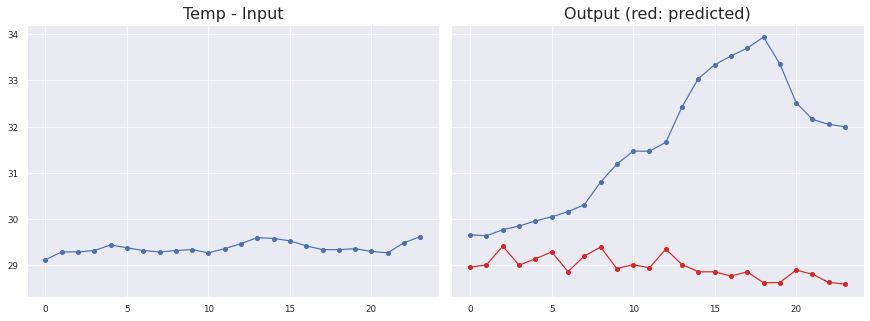

Sensor #12.0
Temp
MAE: 2.625454003736377 ± 1.5676071674287309
MSE: 9.3504009571093
RMSE: 3.057842533079377
Max Error: 5.316703484207391


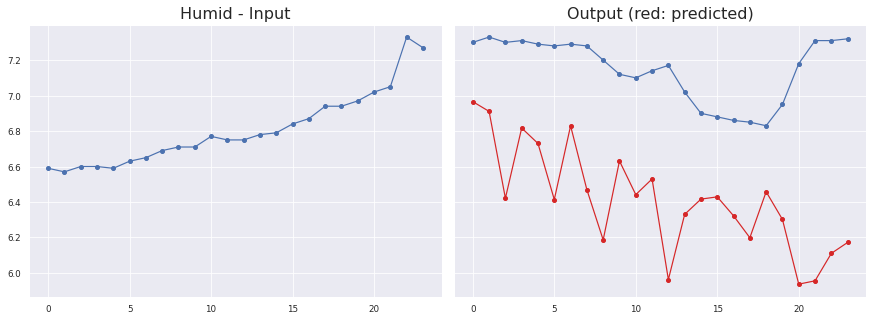

Sensor #12.0
Humid
MAE: 0.7325378309066092 ± 0.30349669740767016
MSE: 0.6287219190467229
RMSE: 0.7929198692470273
Max Error: 1.3544495999813062


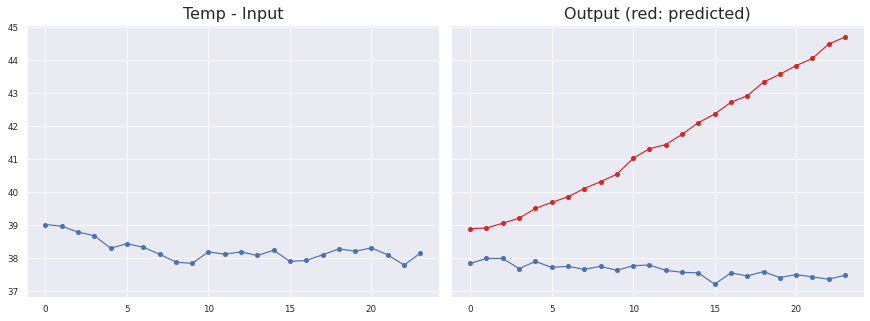

Sensor #19.0
Temp
MAE: 3.861073218882082 ± 2.020161113773289
MSE: 18.988937327170177
RMSE: 4.357629783169995
Max Error: 7.2328030419349645


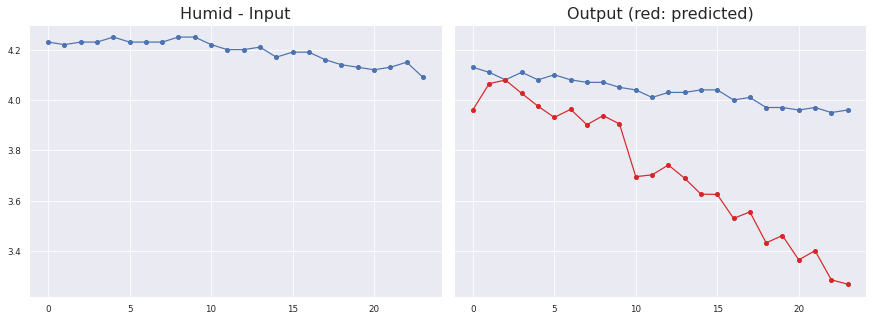

Sensor #19.0
Humid
MAE: 0.322548039543132 ± 0.2034967514874311
MSE: 0.14544816567905514
RMSE: 0.38137667165029265
Max Error: 0.6919116258621214

KL Divergence: 3.048405177671764 bits
Pinball Loss Temp mean: 0.8786542261887572
Pinball Loss Humid mean: 0.3542873916769248
MSE Temp: 1.757308452377552
MSE Humid: 0.7085747833538476


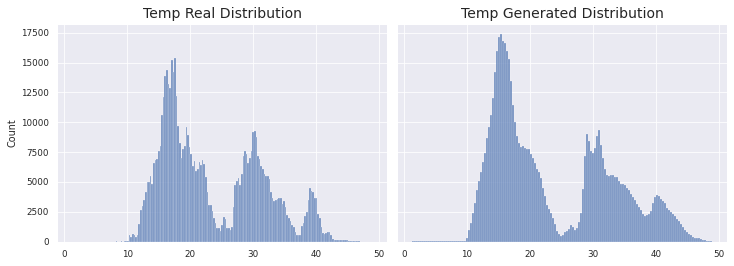

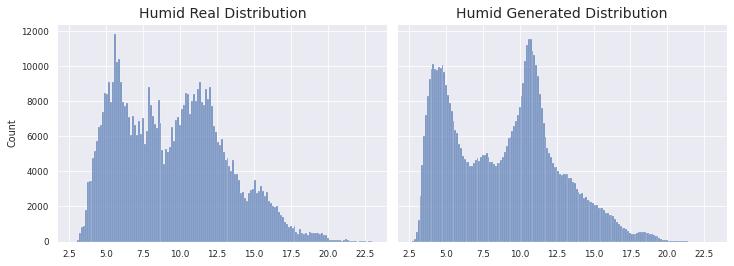

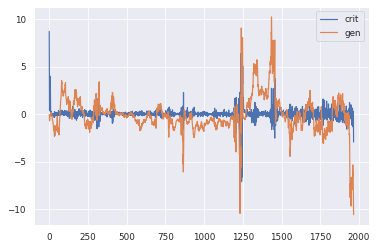

1966/1966 [==============================] - 284s 145ms/step - d_loss: 0.0363 - g_loss: -0.0919
Epoch 2/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0167 - g_loss: -7.8035

KL Divergence: 5.364351464769817 bits
Pinball Loss Temp mean: 0.9958736971584979
Pinball Loss Humid mean: 0.8527011607451908
MSE Temp: 1.9917473943170168
MSE Humid: 1.7054023214903908


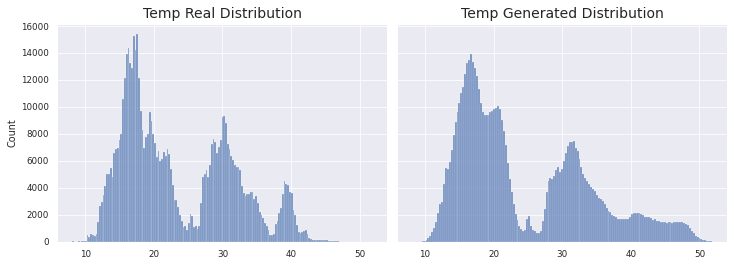

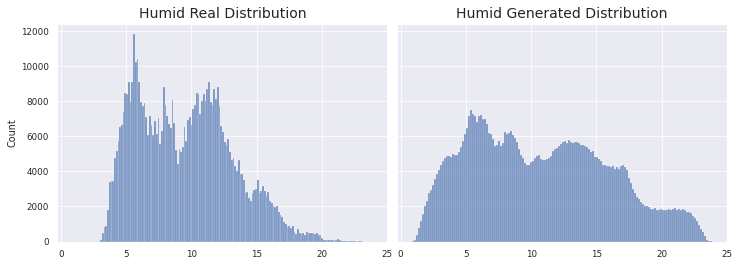

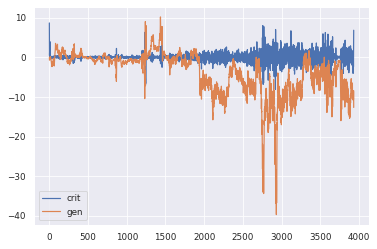

1966/1966 [==============================] - 274s 139ms/step - d_loss: 0.0202 - g_loss: -7.8060
Epoch 3/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0153 - g_loss: -11.9543

KL Divergence: 13.145665777259275 bits
Pinball Loss Temp mean: 0.9073325591583956
Pinball Loss Humid mean: 0.3953079941074778
MSE Temp: 1.8146651183168043
MSE Humid: 0.790615988214953


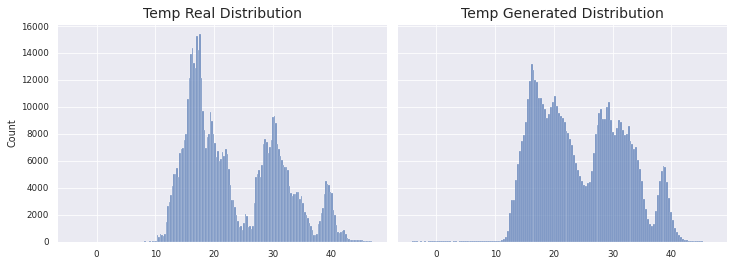

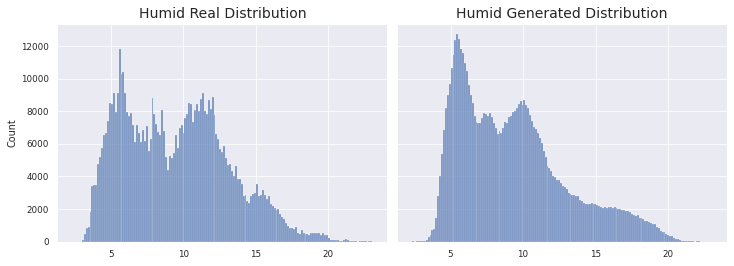

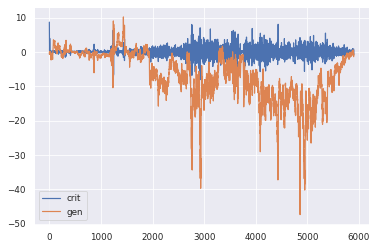

1966/1966 [==============================] - 273s 139ms/step - d_loss: 0.0157 - g_loss: -11.9489
Epoch 4/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0223 - g_loss: -21.4696

KL Divergence: 4.233591471848457 bits
Pinball Loss Temp mean: 1.0760755821544203
Pinball Loss Humid mean: 0.4556712691390519
MSE Temp: 2.152151164308819
MSE Humid: 0.9113425382780983


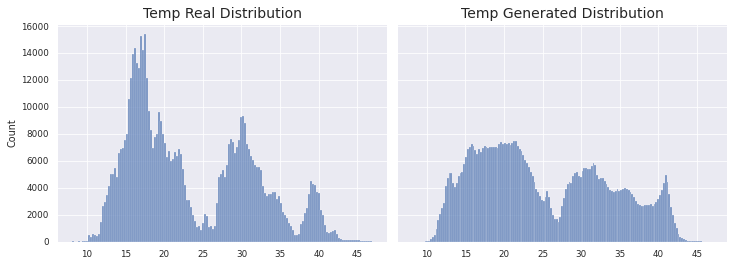

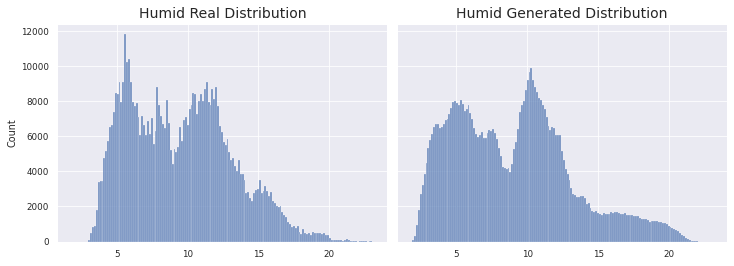

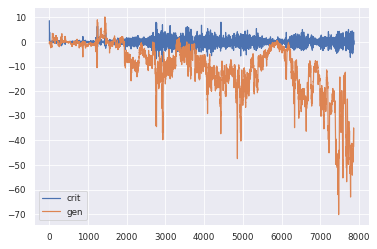

1966/1966 [==============================] - 273s 139ms/step - d_loss: -0.0203 - g_loss: -21.4802
Epoch 5/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1039 - g_loss: -27.3422
Better Pinball
Better MSE
>5 MODELS HAVE BEEN SAVED


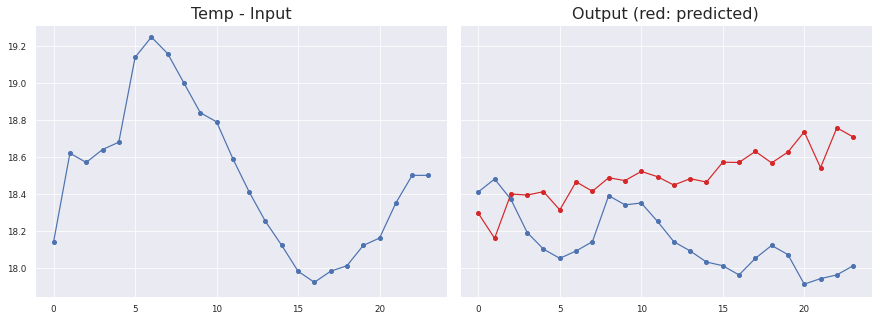

Sensor #31.0
Temp
MAE: 0.38943207730849566 ± 0.2740158162056635
MSE: 0.1997107575265329
RMSE: 0.44689009557891624
Max Error: 0.8259818065166478


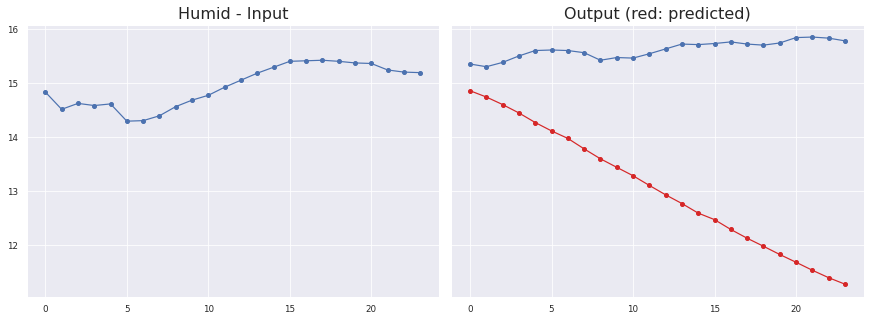

Sensor #31.0
Humid
MAE: 2.5774066806957117 ± 1.2568281156125582
MSE: 8.222642109889103
RMSE: 2.8675149711708747
Max Error: 4.512223106175663


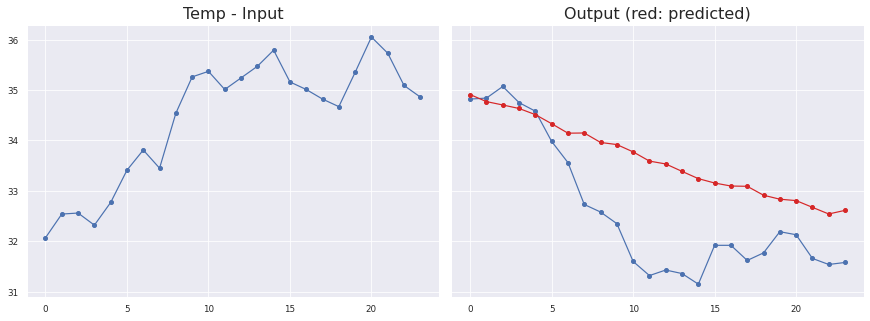

Sensor #21.0
Temp
MAE: 1.086279058009386 ± 0.775935229748451
MSE: 1.6722133021436918
RMSE: 1.2931408670920936
Max Error: 2.2699734759330816


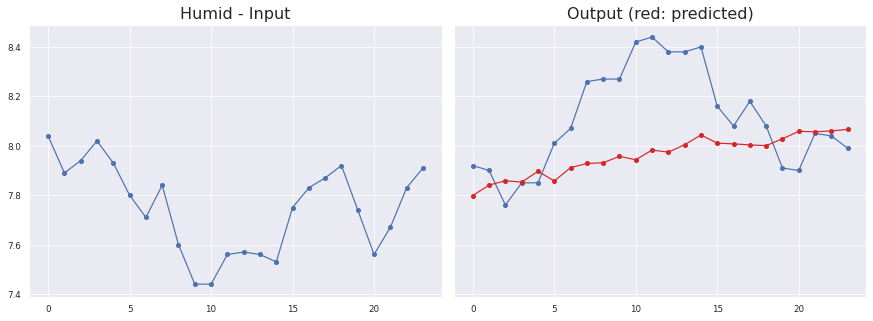

Sensor #21.0
Humid
MAE: 0.18964318900058633 ± 0.19050838536344253
MSE: 0.05752068041589318
RMSE: 0.2398346939370807
Max Error: 0.4765994727611522


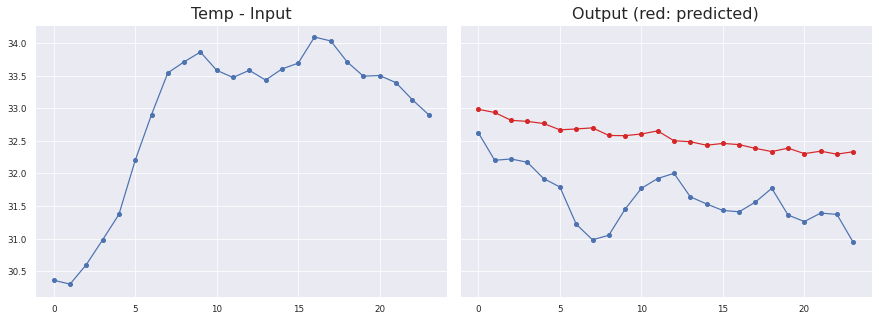

Sensor #21.0
Temp
MAE: 0.9356264157593235 ± 0.32410454712380793
MSE: 0.9804405473329671
RMSE: 0.990171978664801
Max Error: 1.7173149621486665


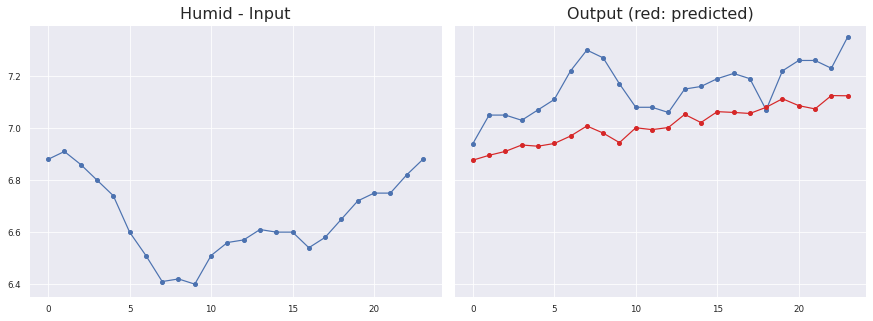

Sensor #21.0
Humid
MAE: 0.1456595476095873 ± 0.07195754298088466
MSE: 0.026154766003981533
RMSE: 0.16172435192011603
Max Error: 0.2919019928574569


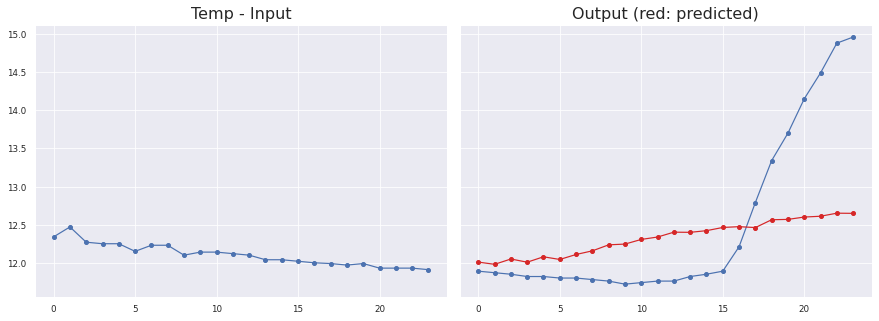

Sensor #1.0
Temp
MAE: 0.6993360169728597 ± 0.9305776356496405
MSE: 0.8888145724864098
RMSE: 0.942769628534145
Max Error: 2.311583383083345


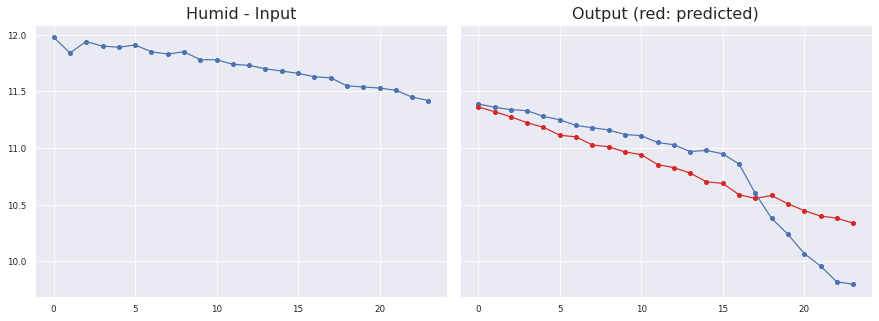

Sensor #1.0
Humid
MAE: 0.2092019297555082 ± 0.25345418128682906
MSE: 0.06433827058306339
RMSE: 0.25364989766026597
Max Error: 0.562709306031465

KL Divergence: 5.245452624283479 bits
Pinball Loss Temp mean: 0.6026345778275293
Pinball Loss Humid mean: 0.34528494843887514
MSE Temp: 1.2052691556550892
MSE Humid: 0.690569896877746


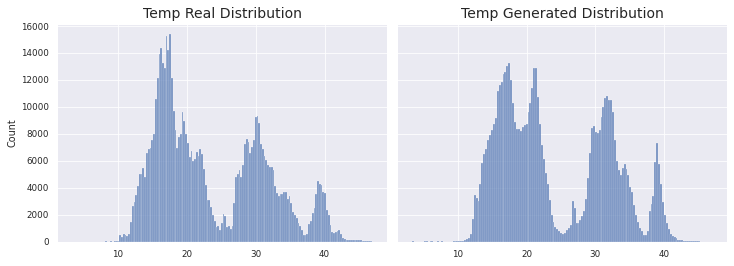

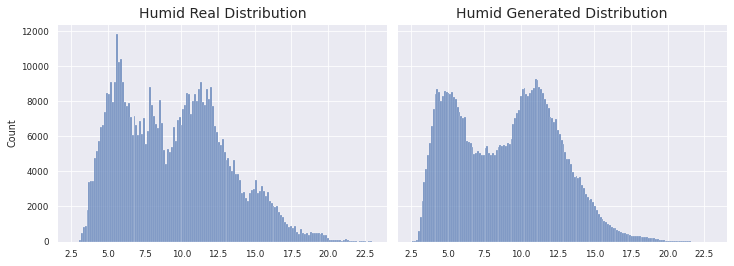

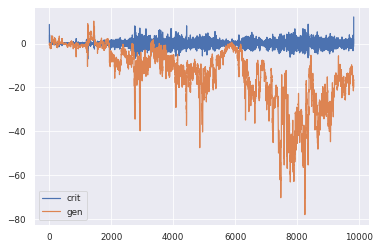

1966/1966 [==============================] - 277s 141ms/step - d_loss: 0.1100 - g_loss: -27.3369
Epoch 6/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0014 - g_loss: -10.1957

KL Divergence: 11.876227618828658 bits
Pinball Loss Temp mean: 2.329681144730228
Pinball Loss Humid mean: 0.6244289269144391
MSE Temp: 4.659362289460501
MSE Humid: 1.2488578538288664


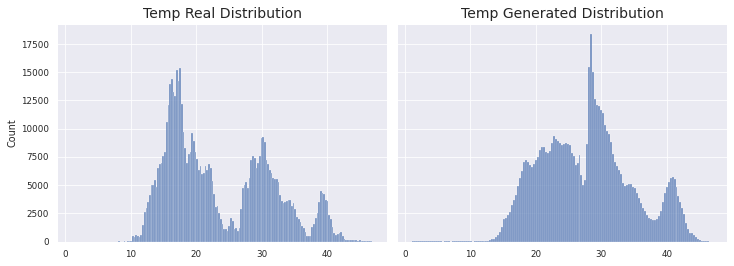

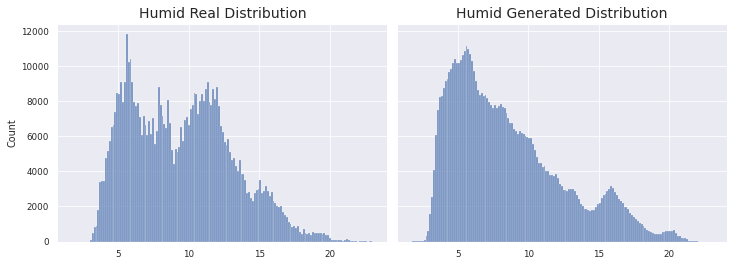

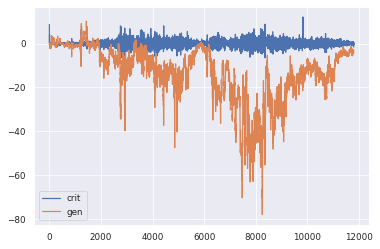

1966/1966 [==============================] - 272s 138ms/step - d_loss: 6.2557e-04 - g_loss: -10.1928
Epoch 7/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0397 - g_loss: -10.8165

KL Divergence: 4.650411055083329 bits
Pinball Loss Temp mean: 3.0016985678220456
Pinball Loss Humid mean: 0.8223834474316455
MSE Temp: 6.003397135644048
MSE Humid: 1.6447668948632914


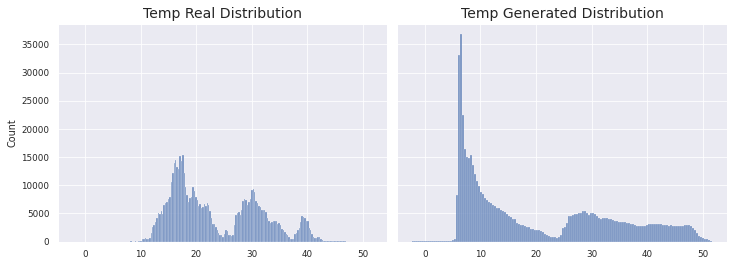

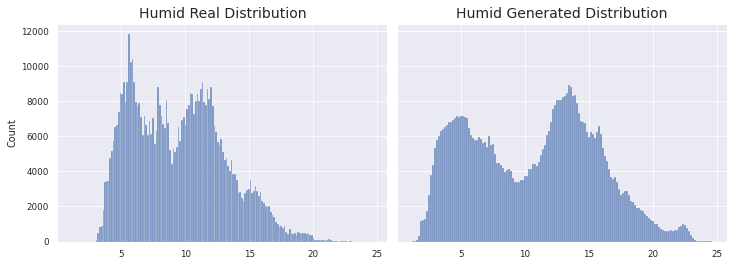

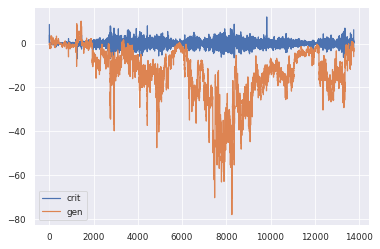

1966/1966 [==============================] - 272s 138ms/step - d_loss: 0.0429 - g_loss: -10.8140
Epoch 8/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0271 - g_loss: -23.2710

KL Divergence: 11.594299696830845 bits
Pinball Loss Temp mean: 0.8842303478323144
Pinball Loss Humid mean: 1.0932321899007384
MSE Temp: 1.7684606956646325
MSE Humid: 2.186464379801523


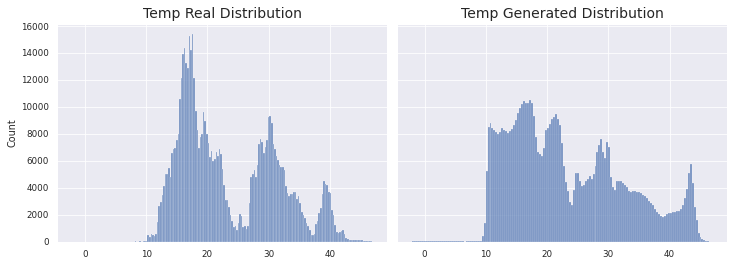

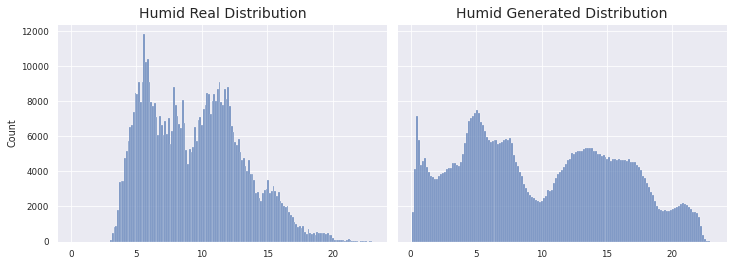

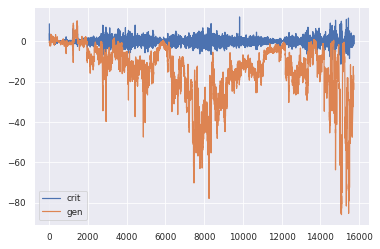

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.0286 - g_loss: -23.2696
Epoch 9/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0190 - g_loss: -38.3835

KL Divergence: 7.2315992569860486 bits
Pinball Loss Temp mean: 2.258736282272351
Pinball Loss Humid mean: 0.8993552122644004
MSE Temp: 4.517472564544759
MSE Humid: 1.7987104245288148


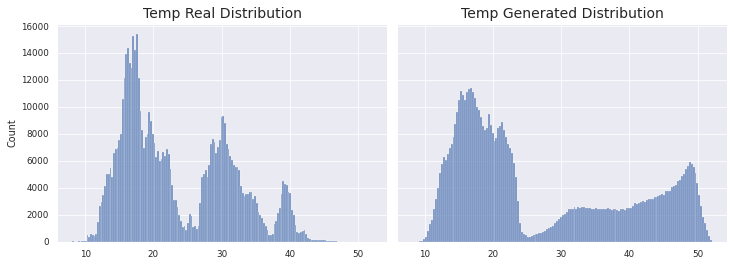

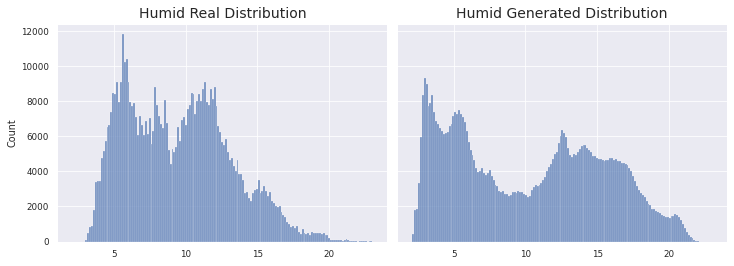

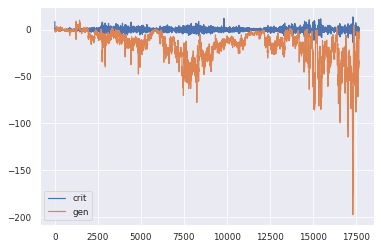

1966/1966 [==============================] - 270s 138ms/step - d_loss: -0.0192 - g_loss: -38.3659
Epoch 10/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0572 - g_loss: -56.8764

KL Divergence: 8.716051892365638 bits
Pinball Loss Temp mean: 1.8826520602636432
Pinball Loss Humid mean: 0.5720170914048774
MSE Temp: 3.7653041205273015
MSE Humid: 1.1440341828097624


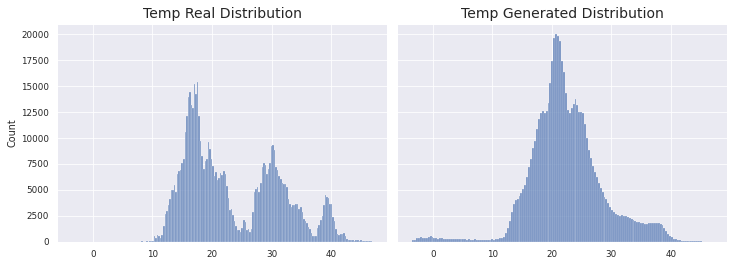

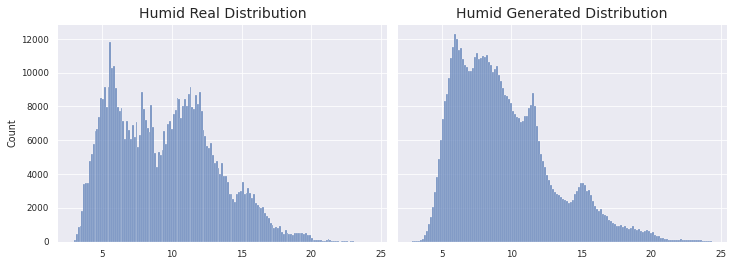

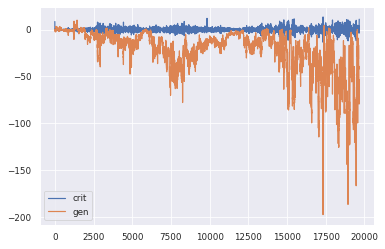

1966/1966 [==============================] - 271s 138ms/step - d_loss: 0.0628 - g_loss: -56.8746
Epoch 11/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0663 - g_loss: -47.6806

KL Divergence: 13.737254388362974 bits
Pinball Loss Temp mean: 1.2397556436473178
Pinball Loss Humid mean: 0.6987066220137008
MSE Temp: 2.479511287294621
MSE Humid: 1.3974132440274105


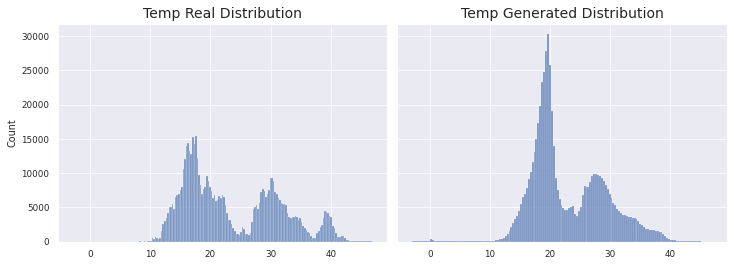

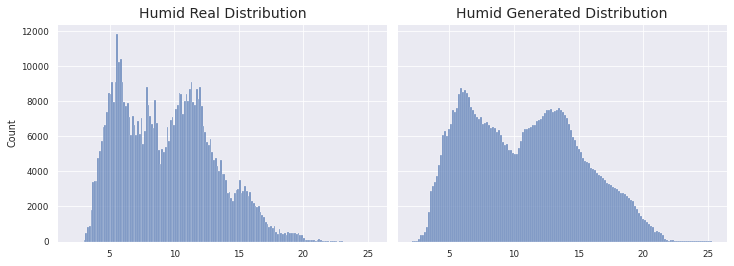

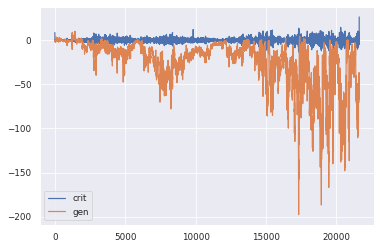

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.0796 - g_loss: -47.6904
Epoch 12/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1222 - g_loss: -40.4065

KL Divergence: 6.2759220460886835 bits
Pinball Loss Temp mean: 2.6516156741736587
Pinball Loss Humid mean: 0.940849350495147
MSE Temp: 5.303231348347247
MSE Humid: 1.8816987009902533


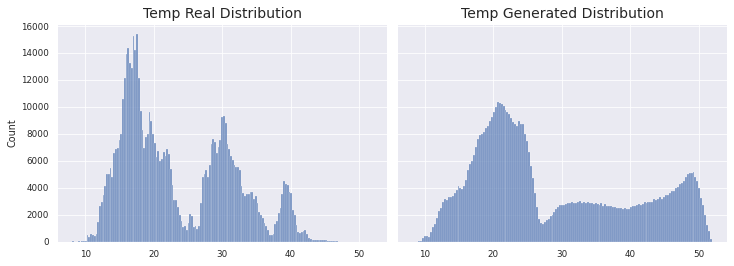

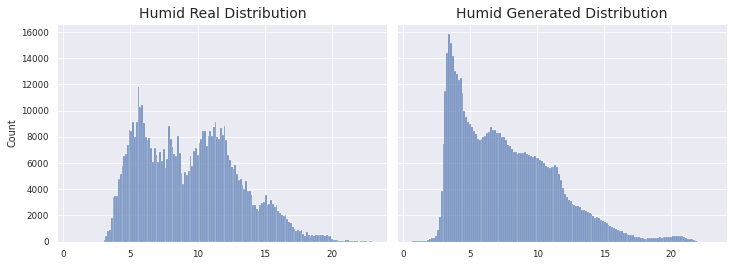

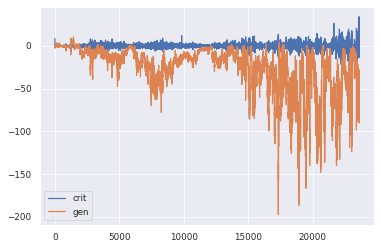

1966/1966 [==============================] - 270s 137ms/step - d_loss: -0.1050 - g_loss: -40.4162
Epoch 13/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0371 - g_loss: -61.3711

KL Divergence: 6.986258814292565 bits
Pinball Loss Temp mean: 1.6981139817955235
Pinball Loss Humid mean: 0.8945384843037575
MSE Temp: 3.3962279635910266
MSE Humid: 1.789076968607502


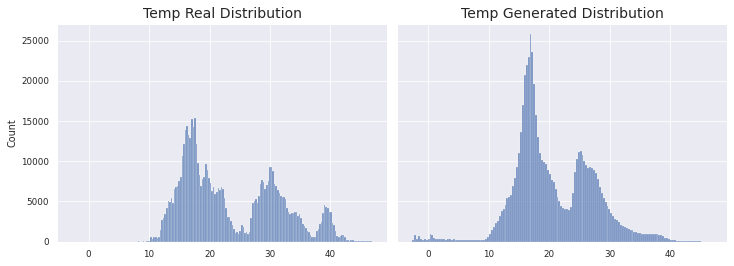

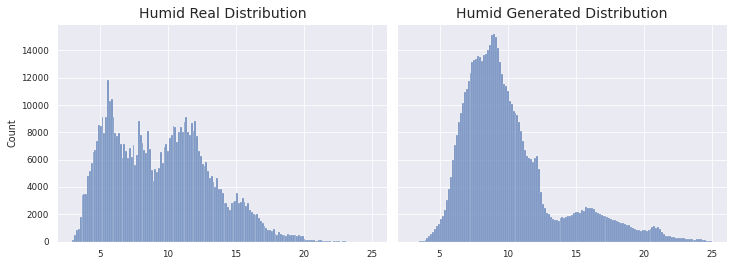

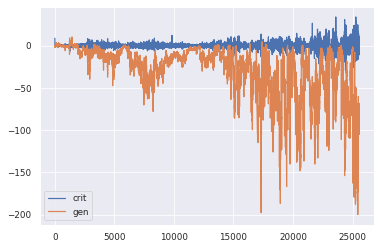

1966/1966 [==============================] - 271s 138ms/step - d_loss: 0.0315 - g_loss: -61.3747
Epoch 14/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0672 - g_loss: -80.4586

KL Divergence: 3.172646481460784 bits
Pinball Loss Temp mean: 1.76414809454088
Pinball Loss Humid mean: 0.4367275922011517
MSE Temp: 3.5282961890817512
MSE Humid: 0.8734551844023032


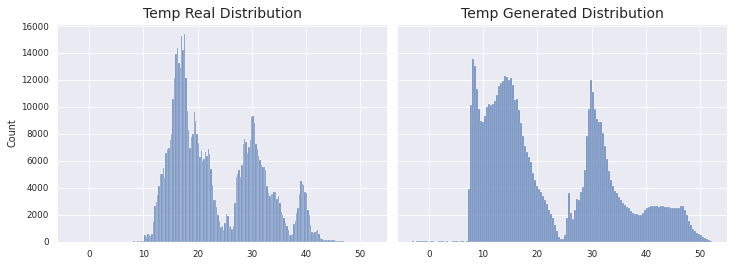

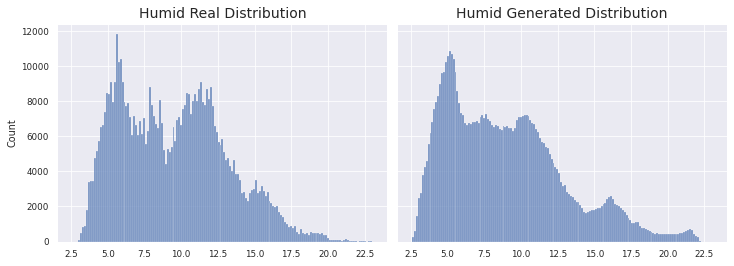

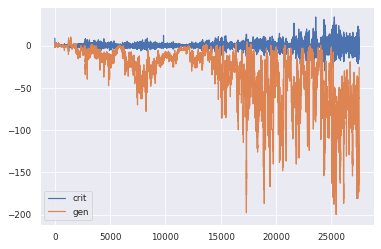

1966/1966 [==============================] - 271s 138ms/step - d_loss: -0.0645 - g_loss: -80.4308
Epoch 15/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2081 - g_loss: -84.2832

KL Divergence: 5.263068892986188 bits
Pinball Loss Temp mean: 2.903498844546354
Pinball Loss Humid mean: 1.507296284540505
MSE Temp: 5.806997689092783
MSE Humid: 3.0145925690809765


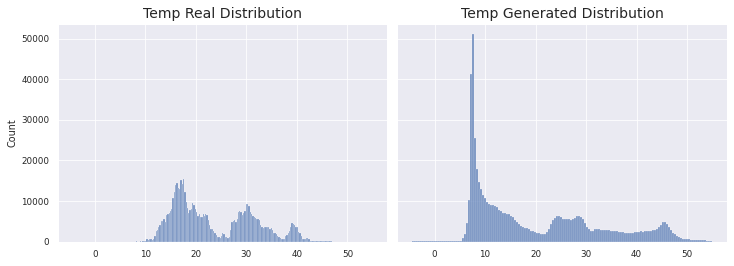

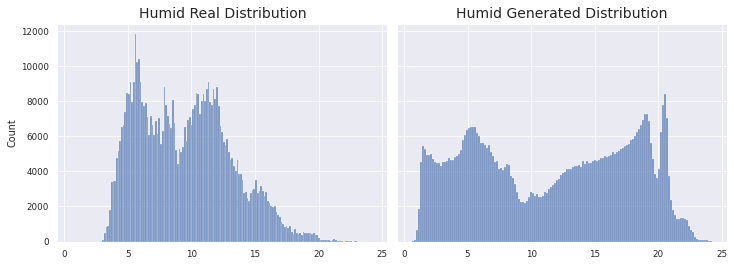

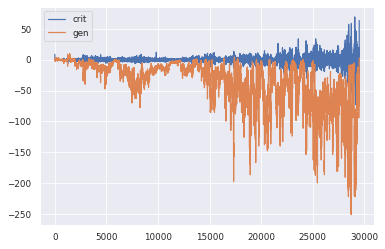

1966/1966 [==============================] - 270s 138ms/step - d_loss: 0.2404 - g_loss: -84.2389
Epoch 16/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1623 - g_loss: -69.9311
Better KL
>16 MODELS HAVE BEEN SAVED


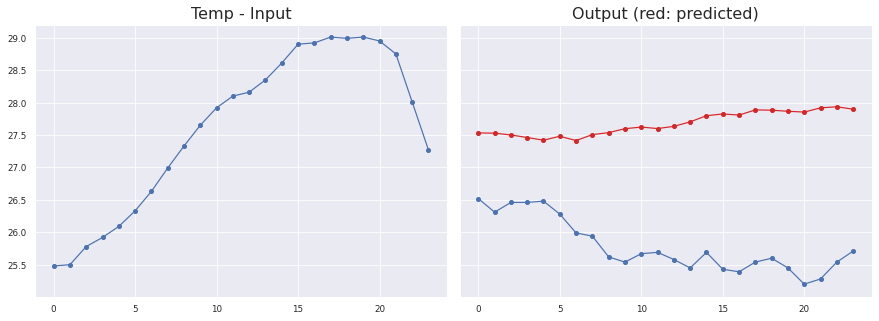

Sensor #13.0
Temp
MAE: 1.8907138924797362 ± 0.5526287492144796
MSE: 3.8801975576742365
RMSE: 1.969821707077632
Max Error: 2.653267315924168


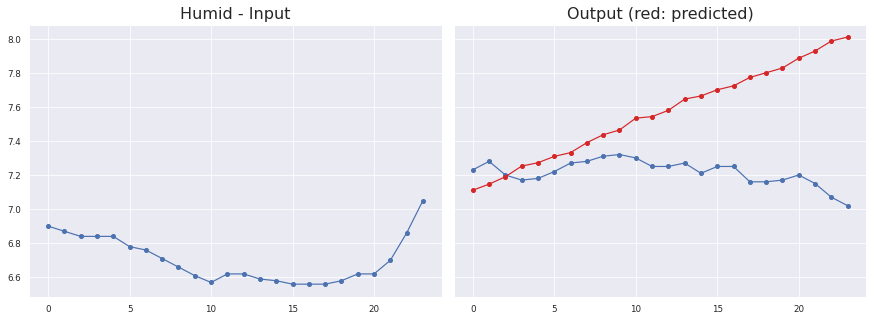

Sensor #13.0
Humid
MAE: 0.36859068242212184 ± 0.31267108278890576
MSE: 0.21793808546820923
RMSE: 0.4668383933099432
Max Error: 0.9887655138969436


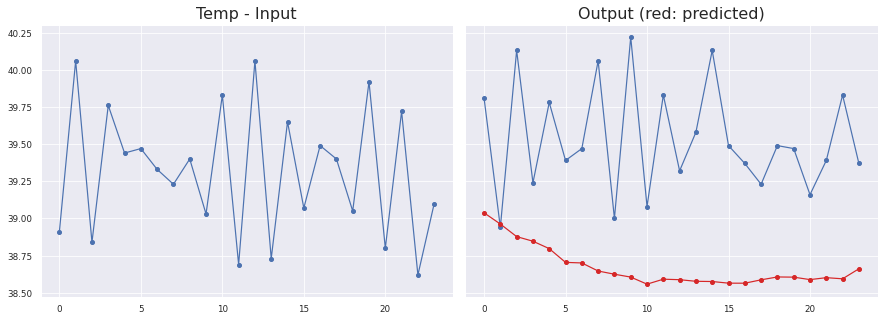

Sensor #33.0
Temp
MAE: 0.8647207322716731 ± 0.3767264729481343
MSE: 0.8864336621047175
RMSE: 0.9415060605777944
Max Error: 1.6142642903327982


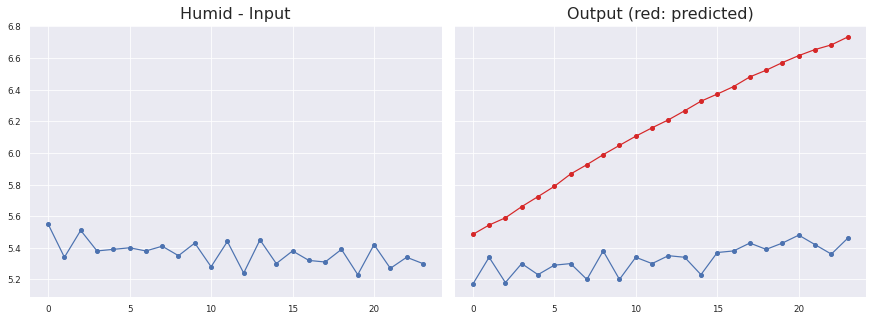

Sensor #33.0
Humid
MAE: 0.8278756888459128 ± 0.32283105519202676
MSE: 0.7895980463784921
RMSE: 0.8885932963839487
Max Error: 1.3232638704776774


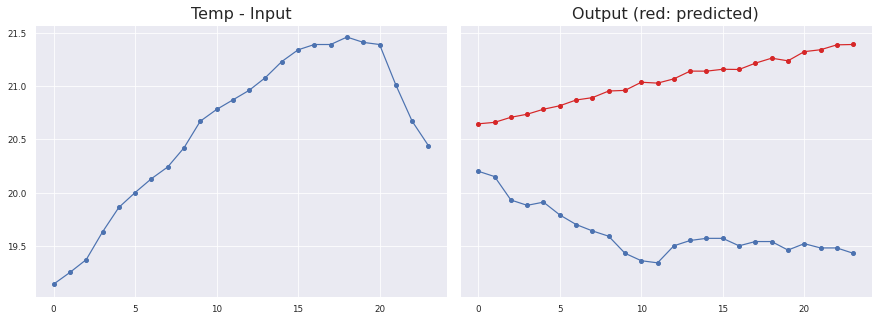

Sensor #16.0
Temp
MAE: 1.4097634705404445 ± 0.4339384577900405
MSE: 2.175735628019437
RMSE: 1.475037500546829
Max Error: 1.960155448913575


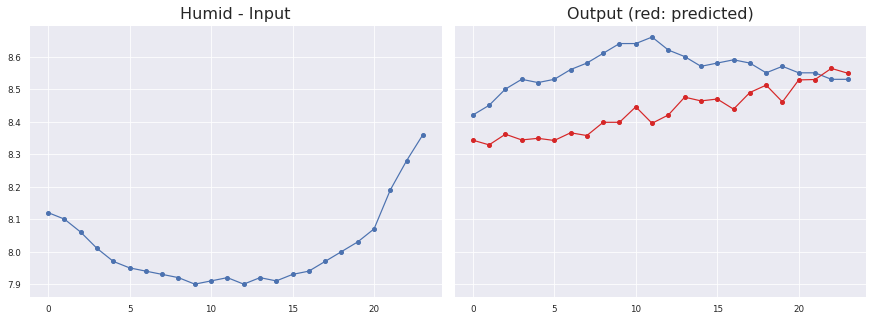

Sensor #16.0
Humid
MAE: 0.13505505172535778 ± 0.08040116599449909
MSE: 0.02354063068801669
RMSE: 0.15342956262733948
Max Error: 0.26518081620335465


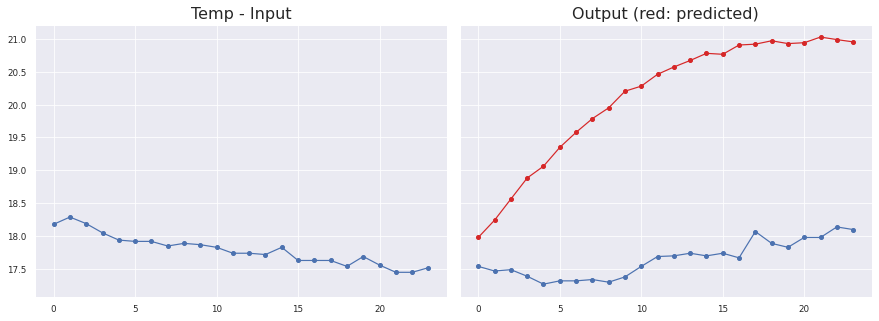

Sensor #17.0
Temp
MAE: 2.465473751525084 ± 0.7726760333327266
MSE: 6.675589071945969
RMSE: 2.5837161361004752
Max Error: 3.235773391723633


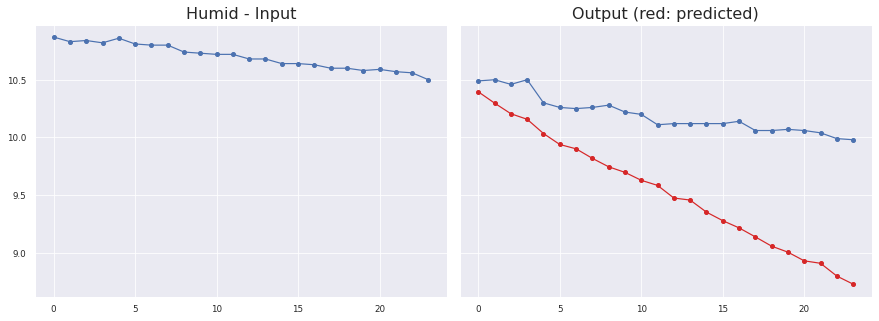

Sensor #17.0
Humid
MAE: 0.664816697823504 ± 0.34191939647994596
MSE: 0.5588901153941587
RMSE: 0.7475895367072486
Max Error: 1.2513203419744983

KL Divergence: 2.0126814690990096 bits
Pinball Loss Temp mean: 0.7363455794844694
Pinball Loss Humid mean: 0.33099839187227725
MSE Temp: 1.4726911589689566
MSE Humid: 0.6619967837445628


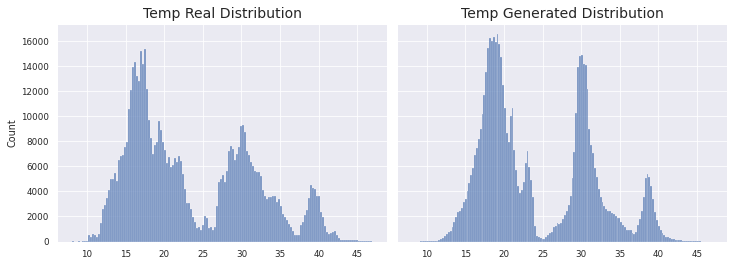

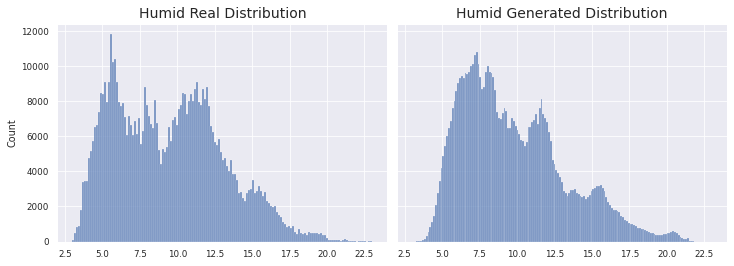

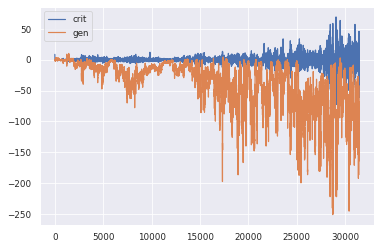

1966/1966 [==============================] - 276s 140ms/step - d_loss: -0.1933 - g_loss: -69.9171
Epoch 17/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3088 - g_loss: -21.2450

KL Divergence: 4.102937674235151 bits
Pinball Loss Temp mean: 2.4857471740099166
Pinball Loss Humid mean: 1.2677660582275019
MSE Temp: 4.971494348019802
MSE Humid: 2.5355321164549873


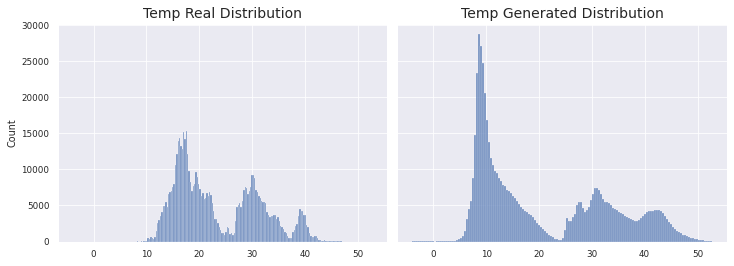

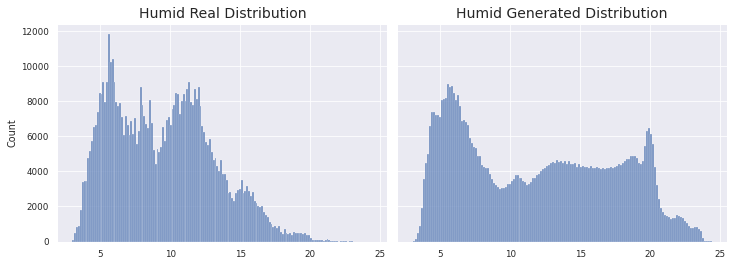

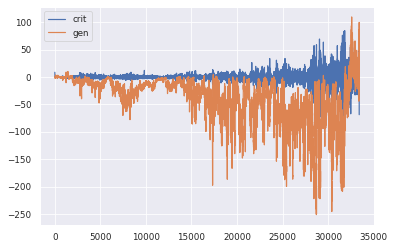

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.2737 - g_loss: -21.2001
Epoch 18/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2127 - g_loss: 30.4868

KL Divergence: 11.402459161884458 bits
Pinball Loss Temp mean: 2.378429704502834
Pinball Loss Humid mean: 1.7640187308841333
MSE Temp: 4.75685940900558
MSE Humid: 3.528037461768235


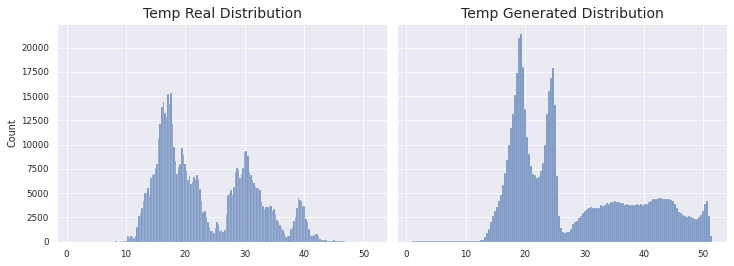

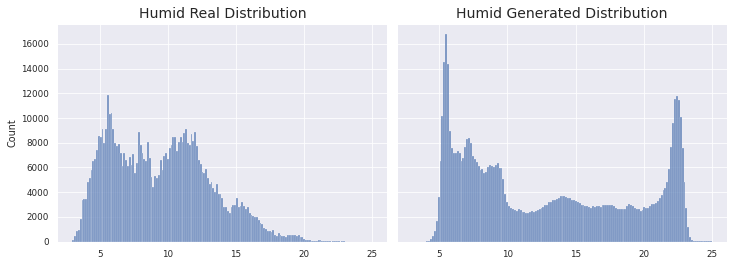

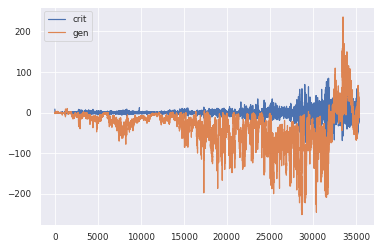

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.2123 - g_loss: 30.4650
Epoch 19/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0013 - g_loss: -20.9610

KL Divergence: 9.474493846044258 bits
Pinball Loss Temp mean: 1.5371620718302936
Pinball Loss Humid mean: 1.366954414356199
MSE Temp: 3.0743241436605837
MSE Humid: 2.7339088287124196


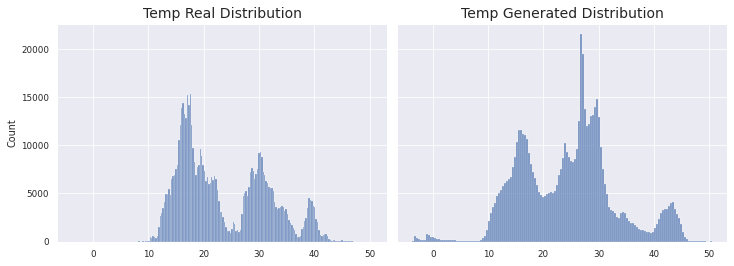

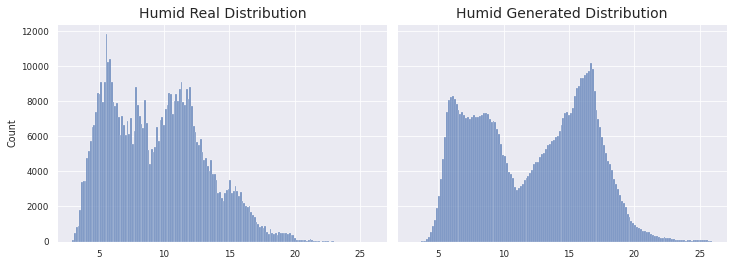

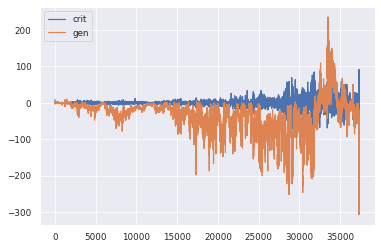

1966/1966 [==============================] - 271s 138ms/step - d_loss: -0.0037 - g_loss: -20.9986
Epoch 20/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1082 - g_loss: -30.5642

KL Divergence: 9.865861875728685 bits
Pinball Loss Temp mean: 4.586360408319593
Pinball Loss Humid mean: 1.8185231963470692
MSE Temp: 9.172720816639199
MSE Humid: 3.6370463926941214


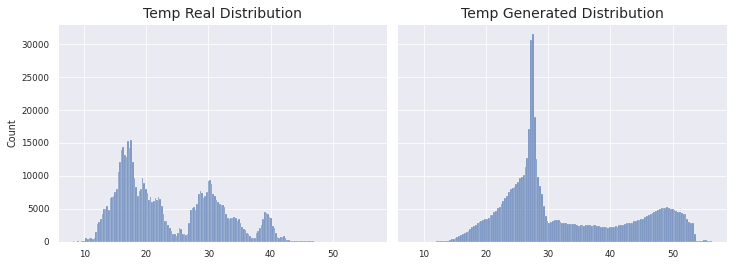

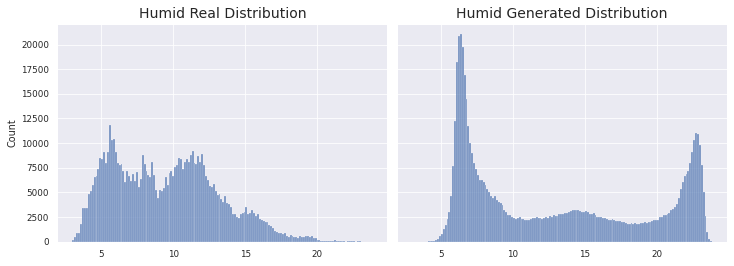

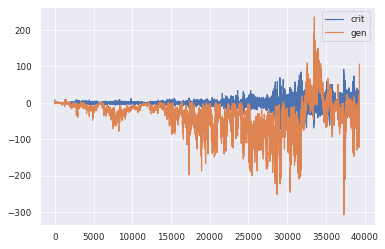

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.0981 - g_loss: -30.4944
Epoch 21/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1632 - g_loss: 0.6491

KL Divergence: 3.9633802362060586 bits
Pinball Loss Temp mean: 1.0539760143281593
Pinball Loss Humid mean: 0.38847532387026246
MSE Temp: 2.107952028656279
MSE Humid: 0.7769506477405305


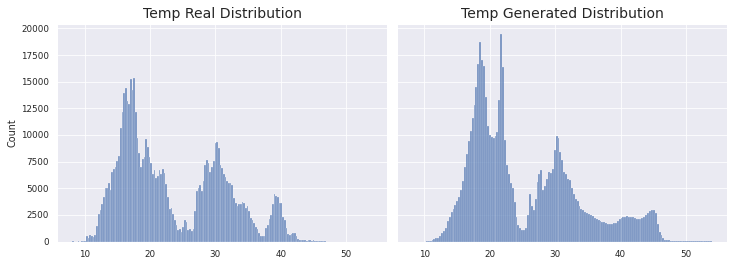

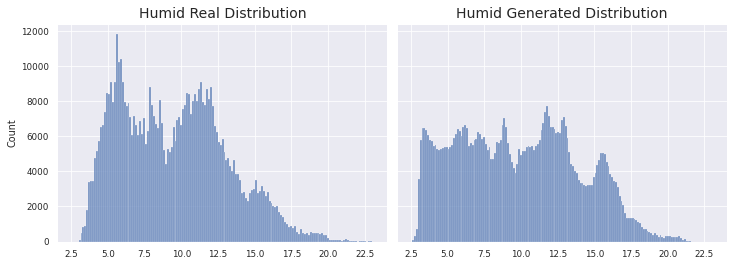

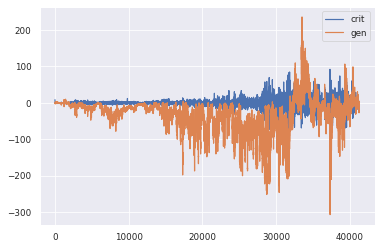

1966/1966 [==============================] - 271s 138ms/step - d_loss: 0.1633 - g_loss: 0.6384
Epoch 22/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2878 - g_loss: -10.5420

KL Divergence: 12.433564763520163 bits
Pinball Loss Temp mean: 1.3379104297093192
Pinball Loss Humid mean: 1.8547849337609936
MSE Temp: 2.6758208594185984
MSE Humid: 3.7095698675219873


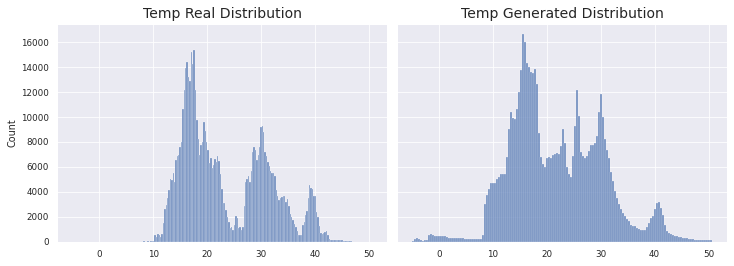

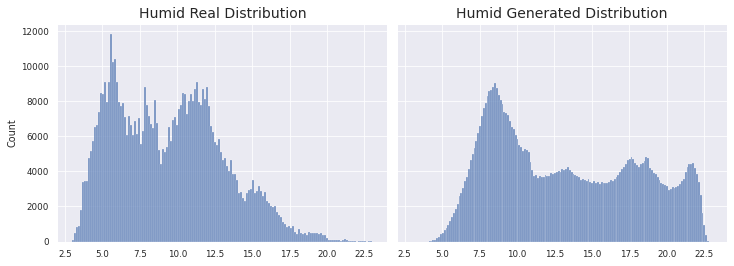

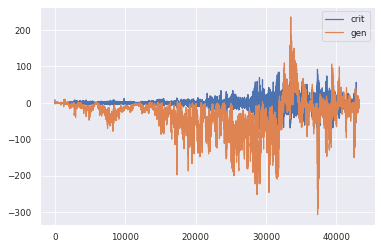

1966/1966 [==============================] - 271s 138ms/step - d_loss: 0.2891 - g_loss: -10.5340
Epoch 23/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0051 - g_loss: -37.4106

KL Divergence: 11.144577032085433 bits
Pinball Loss Temp mean: 1.099769319903627
Pinball Loss Humid mean: 1.346669749185993
MSE Temp: 2.199538639807261
MSE Humid: 2.693339498372032


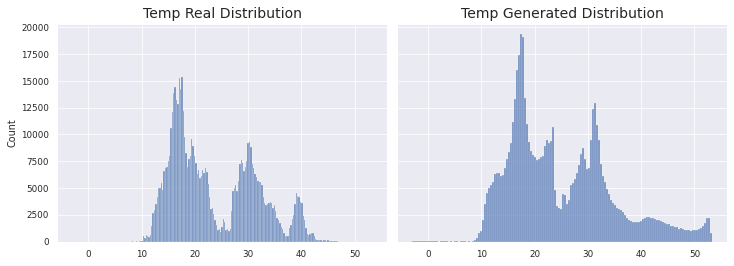

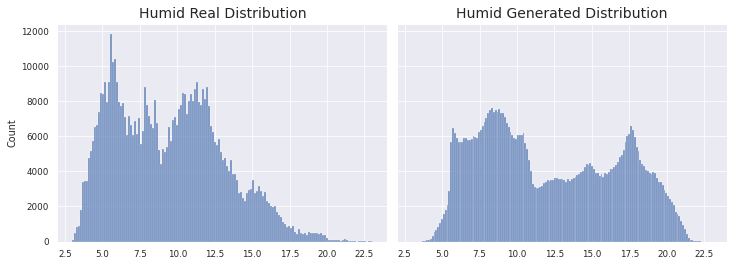

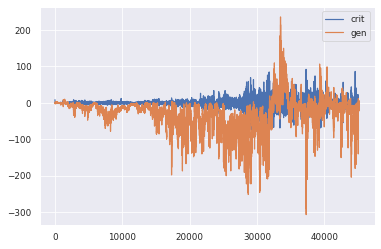

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.0058 - g_loss: -37.3923
Epoch 24/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2272 - g_loss: -56.3784

KL Divergence: 8.44330024581735 bits
Pinball Loss Temp mean: 2.7977218745617423
Pinball Loss Humid mean: 0.9092386249737917
MSE Temp: 5.595443749123479
MSE Humid: 1.818477249947586


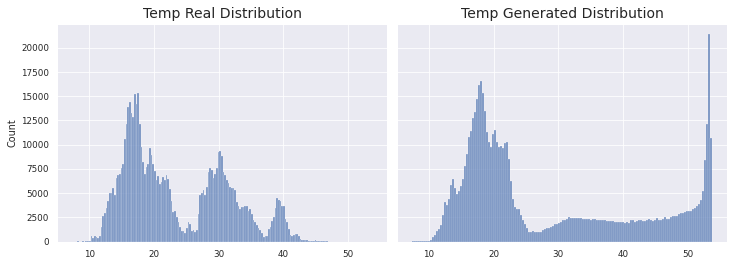

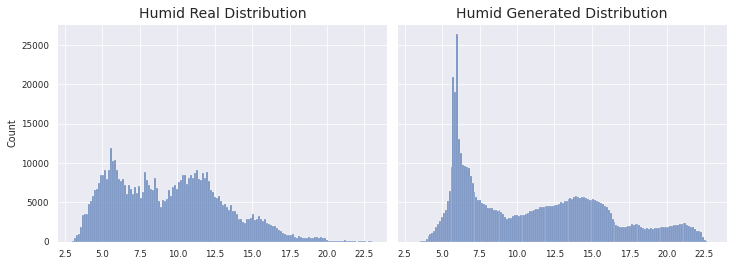

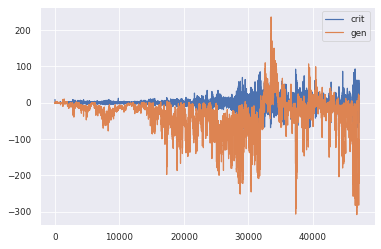

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.2281 - g_loss: -56.3434
Epoch 25/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0706 - g_loss: -41.6551

KL Divergence: 6.703433186881652 bits
Pinball Loss Temp mean: 2.5722530440181197
Pinball Loss Humid mean: 0.7723189478892519
MSE Temp: 5.144506088036263
MSE Humid: 1.5446378957784854


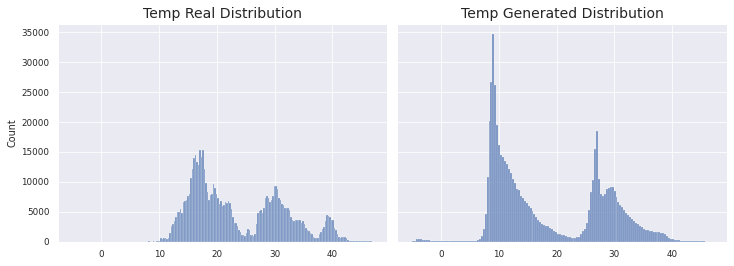

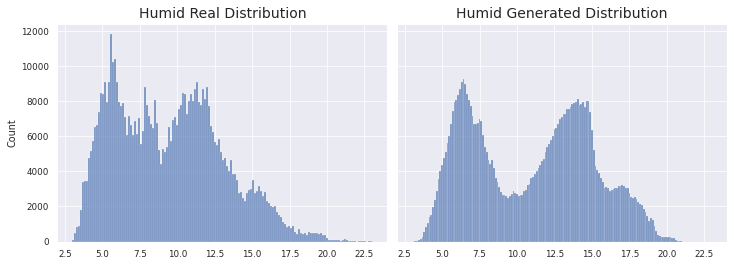

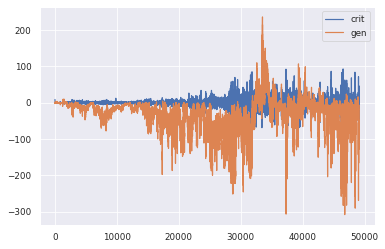

1966/1966 [==============================] - 271s 138ms/step - d_loss: 0.0937 - g_loss: -41.6697
Epoch 26/200
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1021 - g_loss: -68.0960

KL Divergence: 4.987934835283299 bits
Pinball Loss Temp mean: 4.683888003640988
Pinball Loss Humid mean: 0.6806912704931094
MSE Temp: 9.367776007282119
MSE Humid: 1.3613825409862135


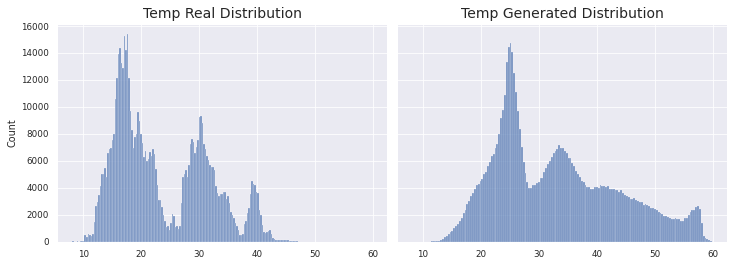

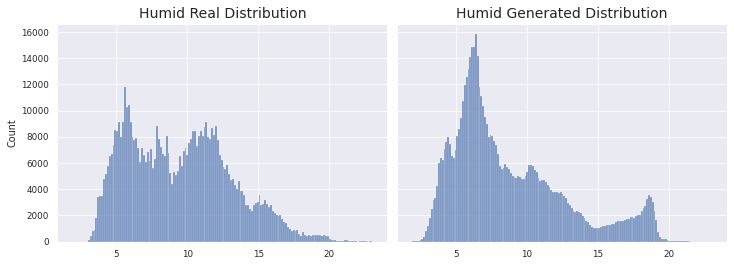

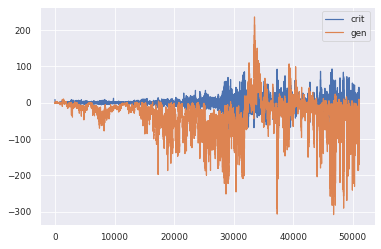

1966/1966 [==============================] - 270s 137ms/step - d_loss: 0.0923 - g_loss: -68.0826
Epoch 27/200
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0928 - g_loss: -37.9844

KL Divergence: 9.23320872012222 bits
Pinball Loss Temp mean: 1.2808777137112701
Pinball Loss Humid mean: 0.565404101319688
MSE Temp: 2.5617554274225567
MSE Humid: 1.1308082026393746


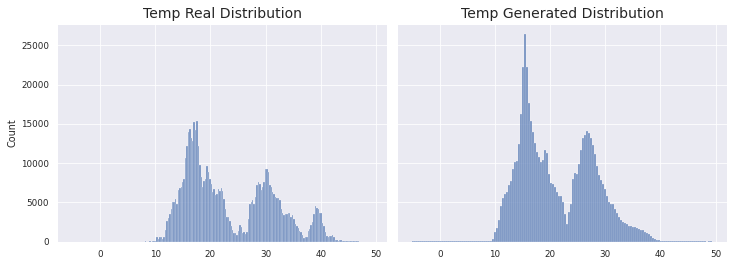

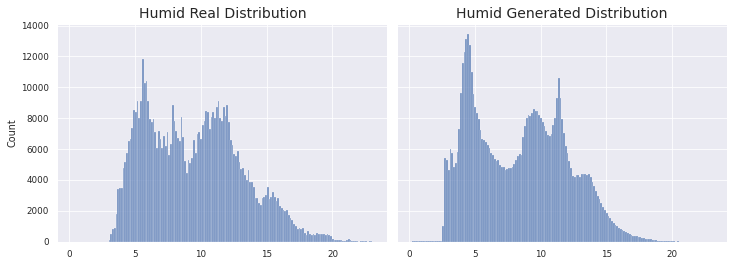

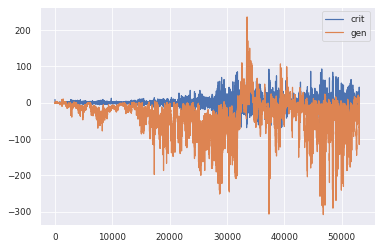

1966/1966 [==============================] - 270s 137ms/step - d_loss: -0.0959 - g_loss: -37.9730
Epoch 28/200
 950/1966 [=============>................] - ETA: 1:44 - d_loss: 0.0037 - g_loss: -21.8987Buffered data was truncated after reaching the output size limit.

In [ ]:
# prueba_12
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=5,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_11
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_10
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_9
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_8
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=5,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=g_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_7
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=d_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_6
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_AdaBelief,
    g_optimizer=d_opt_AdaBelief,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_5
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_4
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_3
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 500
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

Model: "functional_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 25, 2)]      0                                            
__________________________________________________________________________________________________
spectral_normalization_4 (Spect (None, 25, 64)       640         input_12[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_9 (LeakyReLU)       (None, 25, 64)       0           spectral_normalization_4[0][0]   
__________________________________________________________________________________________________
spectral_normalization_5 (Spect (None, 25, 128)      33024       leaky_re_lu_9[0][0]              
_______________________________________________________________________________________

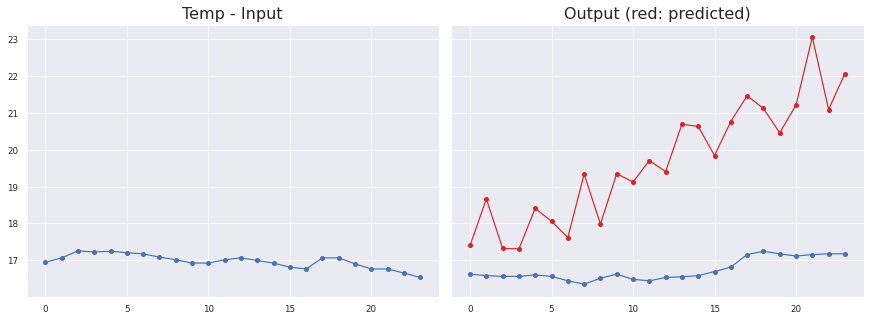

Sensor #34.0
Temp
MAE: 2.921676847661534 ± 1.3697867132498338
MSE: 10.412511241957223
RMSE: 3.2268423019969883
Max Error: 5.881702716946602


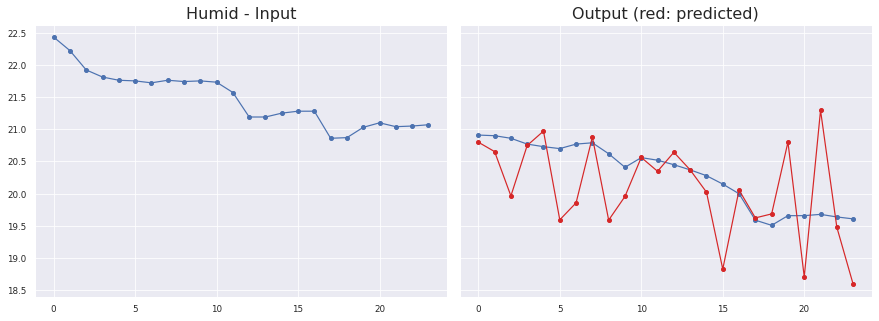

Sensor #34.0
Humid
MAE: 0.5077778241659204 ± 0.6751492012484014
MSE: 0.500761253126151
RMSE: 0.7076448637036455
Max Error: 1.6138886430859571


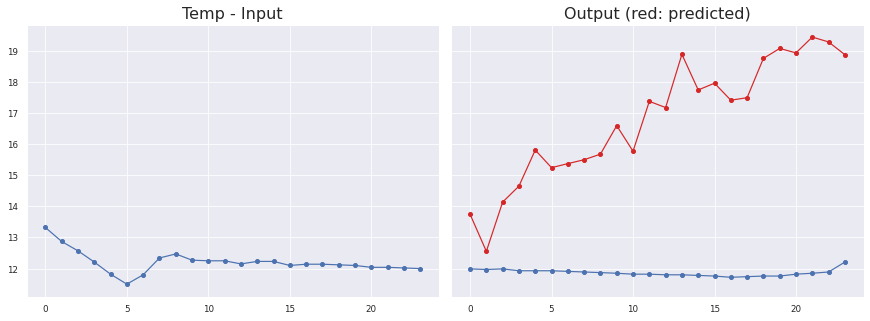

Sensor #1.0
Temp
MAE: 4.939866505116224 ± 1.9504764150563327
MSE: 28.20663933406018
RMSE: 5.310992311617499
Max Error: 7.583980240821839


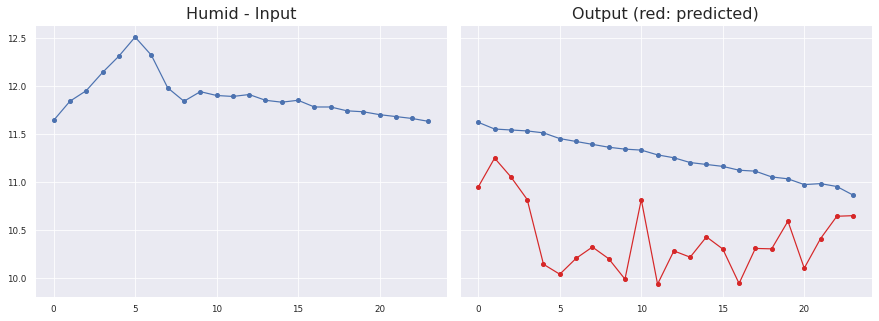

Sensor #1.0
Humid
MAE: 0.8491855211959525 ± 0.35793025361697844
MSE: 0.8492301158631559
RMSE: 0.9215368228471155
Max Error: 1.4156445854902255


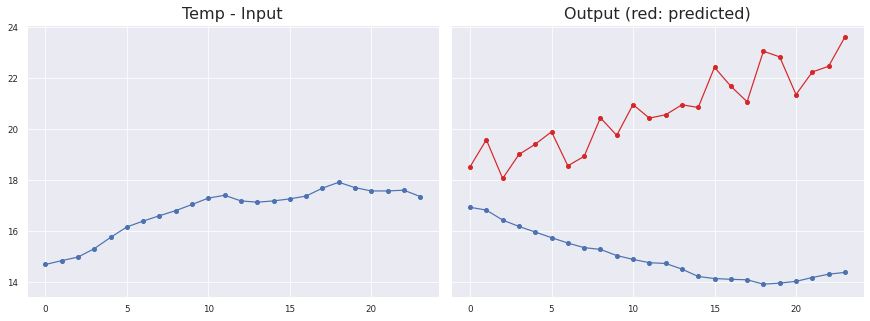

Sensor #8.0
Temp
MAE: 5.706662972196937 ± 2.348082951126714
MSE: 38.07949582361551
RMSE: 6.170858596955169
Max Error: 9.217315286993983


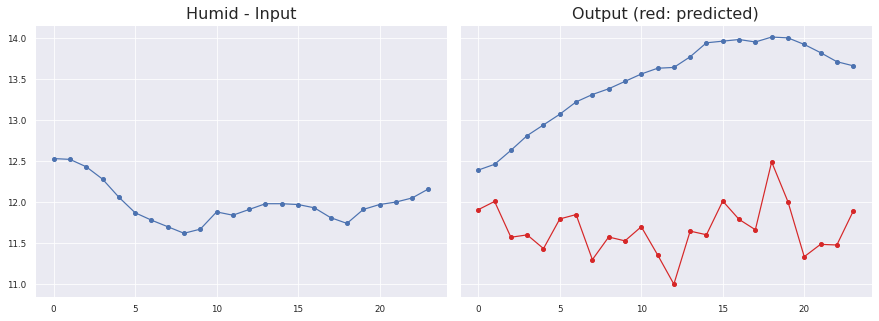

Sensor #8.0
Humid
MAE: 1.8008588135871102 ± 0.577534920071016
MSE: 3.576639050375809
RMSE: 1.8912004257549777
Max Error: 2.6398103487491618


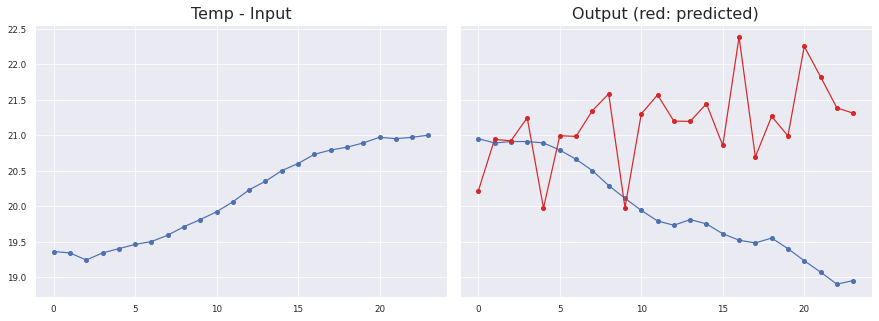

Sensor #5.0
Temp
MAE: 1.3236127109328908 ± 1.0799081797845873
MSE: 2.5463839789117393
RMSE: 1.5957393204755403
Max Error: 3.020611325502397


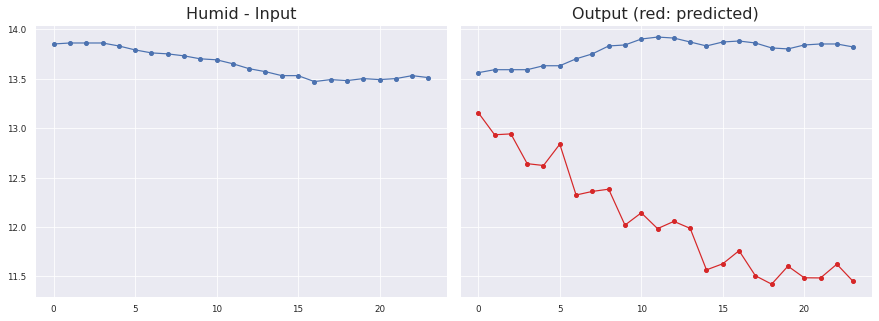

Sensor #5.0
Humid
MAE: 1.7000485759261446 ± 0.634225892855635
MSE: 3.292407643677039
RMSE: 1.8144992818067025
Max Error: 2.3875731293857108

KL Divergence Sum: 10.606227429089024 bits
Pinball Loss Temp mean: 1.1377390412718829
Pinball Loss Humid mean: 0.474081817029164
MSE Temp: 2.275478082543733
MSE Humid: 0.9481636340583364


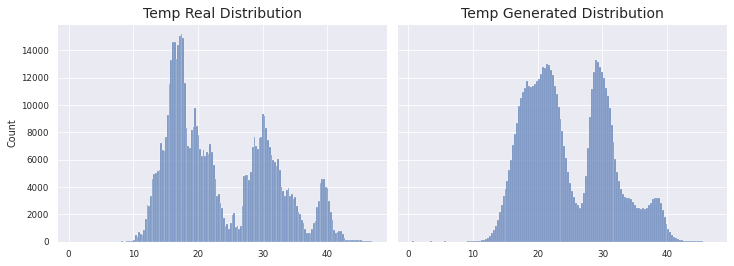

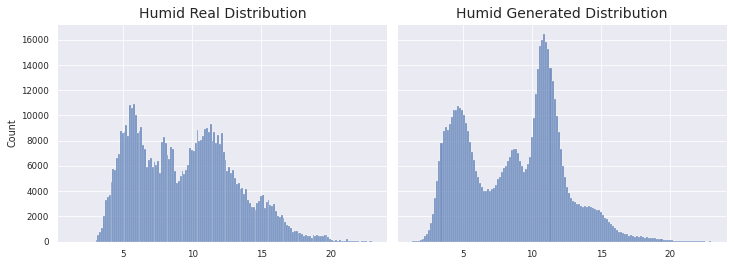

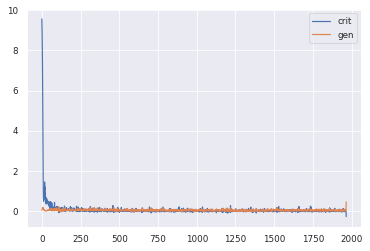

1966/1966 [==============================] - 163s 83ms/step - d_loss: 0.0557 - g_loss: 0.0243
Epoch 2/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -8.6421e-04 - g_loss: 0.0065Better KL
>2 MODELS HAVE BEEN SAVED


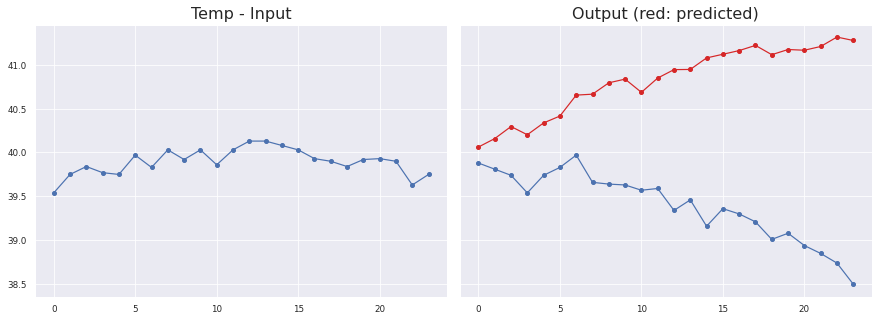

Sensor #19.0
Temp
MAE: 1.4218080703417435 ± 0.7329352252185919
MSE: 2.5587322332551405
RMSE: 1.5996037738312388
Max Error: 2.7761448049545265


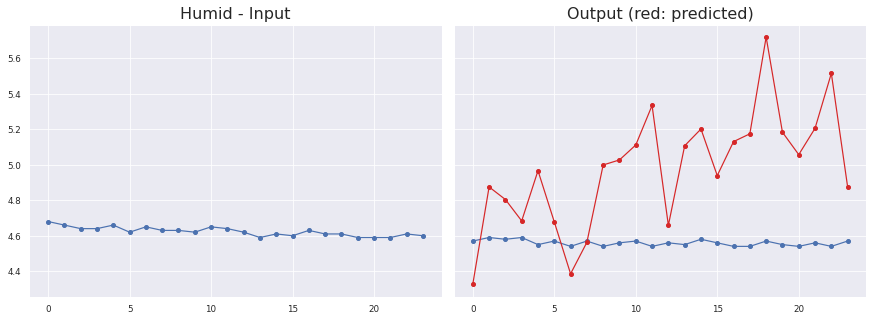

Sensor #19.0
Humid
MAE: 0.4540548790494605 ± 0.32714085485291095
MSE: 0.28371272676457615
RMSE: 0.5326469062752324
Max Error: 1.1493553638458245


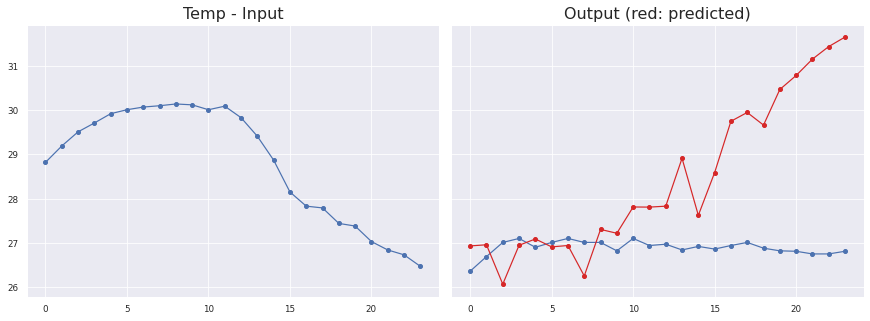

Sensor #7.0
Temp
MAE: 1.7024334205252423 ± 1.7588016911916011
MSE: 5.422555065997854
RMSE: 2.328638028118122
Max Error: 4.84260308623314


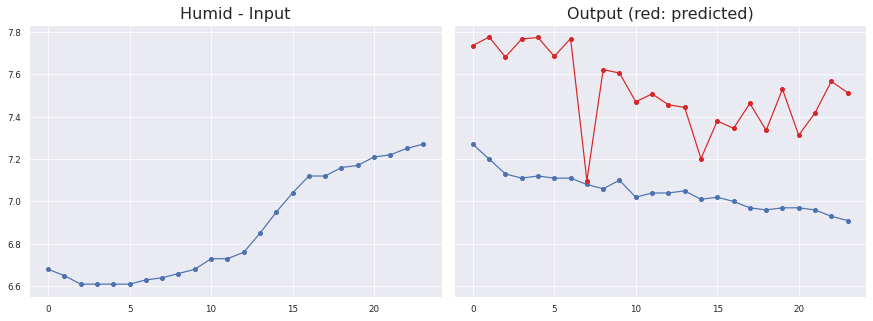

Sensor #7.0
Humid
MAE: 0.47127763509750403 ± 0.1499769261662946
MSE: 0.2445956877253863
RMSE: 0.49456616112041707
Max Error: 0.6581674444675452


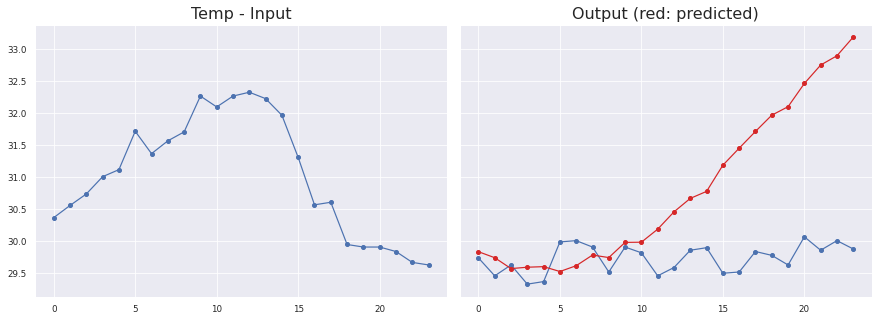

Sensor #21.0
Temp
MAE: 1.1388137039790545 ± 1.1423722064641801
MSE: 2.412701594690034
RMSE: 1.5532873509721354
Max Error: 3.3125475001335083


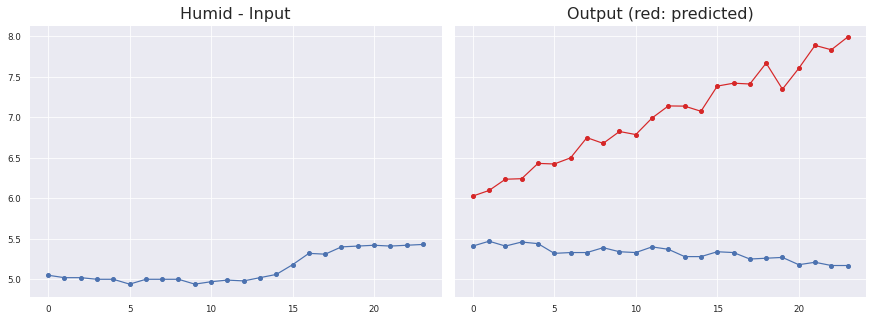

Sensor #21.0
Humid
MAE: 1.6724712354193134 ± 0.6535191329716573
MSE: 3.2242472904650312
RMSE: 1.7956189157126383
Max Error: 2.8201475360989576


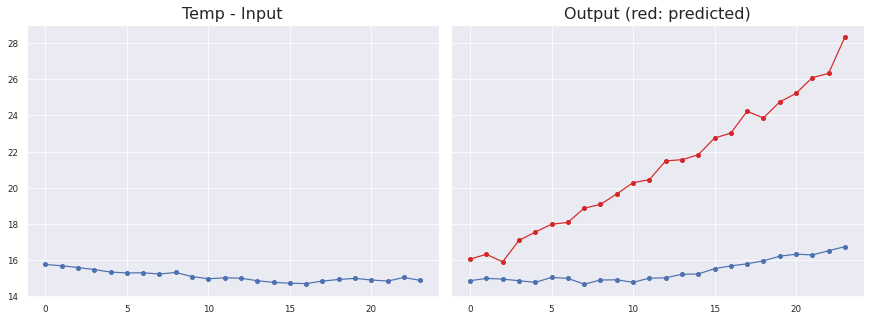

Sensor #34.0
Temp
MAE: 5.744583398178219 ± 2.9524445949474183
MSE: 41.71716750485904
RMSE: 6.458882837214114
Max Error: 11.618229938149451


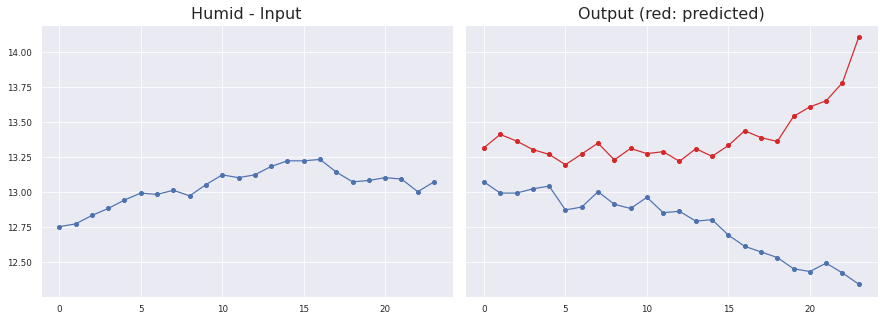

Sensor #34.0
Humid
MAE: 0.62727113488596 ± 0.4027582436214451
MSE: 0.5556832794661515
RMSE: 0.7454416673799175
Max Error: 1.763358665704727

KL Divergence Sum: 6.596612236812909 bits
Pinball Loss Temp mean: 1.9027712195367699
Pinball Loss Humid mean: 0.630864636019647
MSE Temp: 3.8055424390735686
MSE Humid: 1.2617292720393118


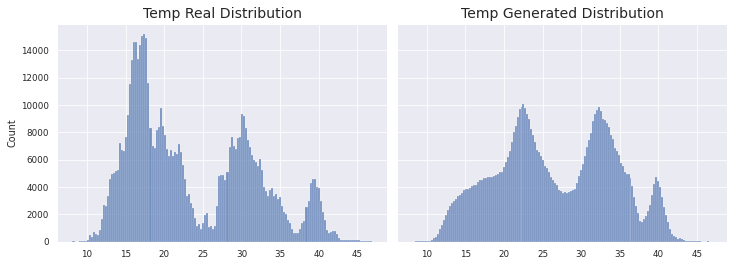

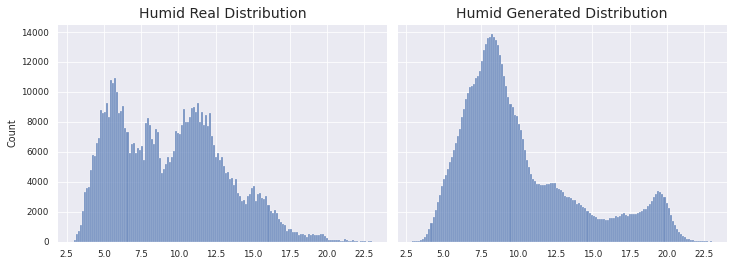

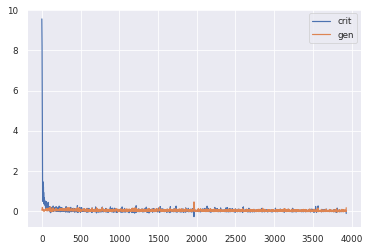

1966/1966 [==============================] - 162s 83ms/step - d_loss: -0.0010 - g_loss: 0.0066
Epoch 3/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0026 - g_loss: -0.0091Better KL
>3 MODELS HAVE BEEN SAVED


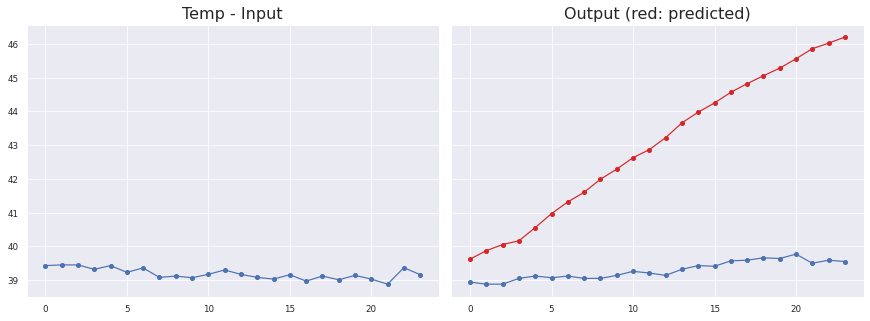

Sensor #19.0
Temp
MAE: 3.7285922475655853 ± 1.863077887801691
MSE: 17.373459364621795
RMSE: 4.1681481936972675
Max Error: 6.654483857154844


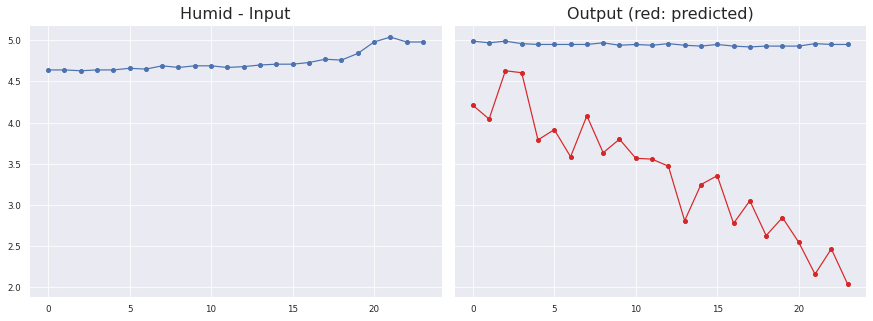

Sensor #19.0
Humid
MAE: 1.584254194572568 ± 0.6979501411726231
MSE: 2.996995752583661
RMSE: 1.7311833388129811
Max Error: 2.915924971699715


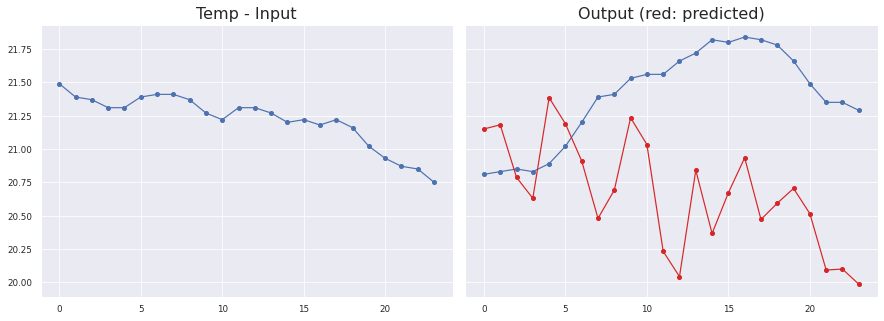

Sensor #5.0
Temp
MAE: 0.831429941256841 ± 0.6214658744736248
MSE: 0.9023386144050995
RMSE: 0.9499150564156248
Max Error: 1.6174923670291932


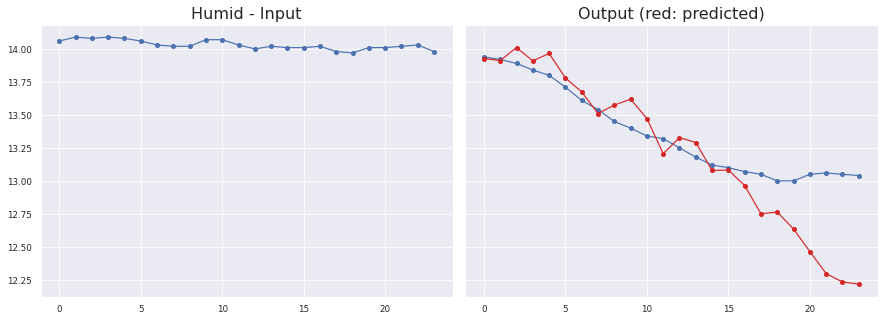

Sensor #5.0
Humid
MAE: 0.22389563836710277 ± 0.31220950192386115
MSE: 0.11376919672174367
RMSE: 0.3372968969939446
Max Error: 0.822873978763818


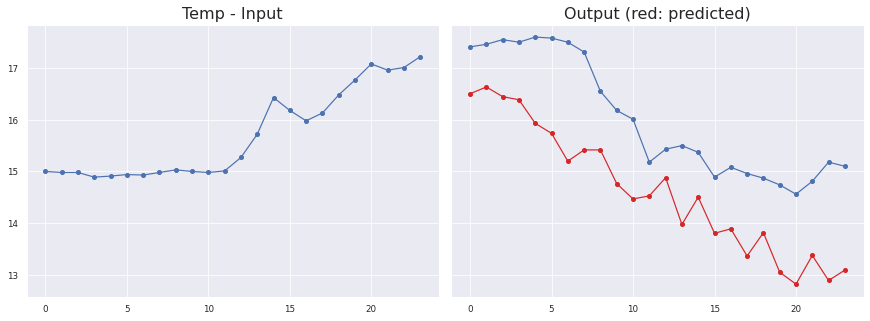

Sensor #10.0
Temp
MAE: 1.3930527586738268 ± 0.4743982391103681
MSE: 2.1656496777197773
RMSE: 1.4716146498726415
Max Error: 2.3014927482604968


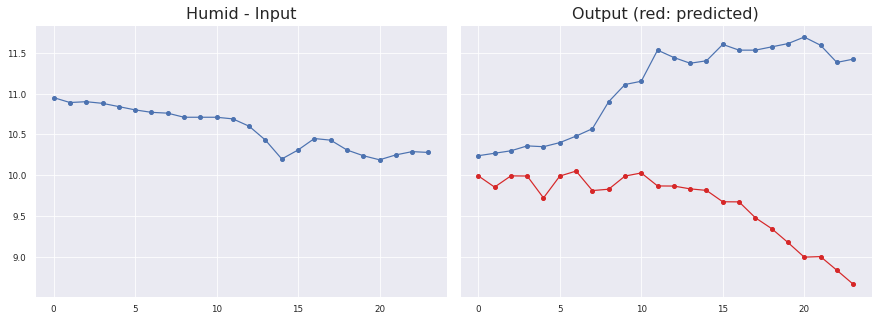

Sensor #10.0
Humid
MAE: 1.4270268938317894 ± 0.8346726879123583
MSE: 2.7330842516660456
RMSE: 1.6532042377353275
Max Error: 2.749494284689426


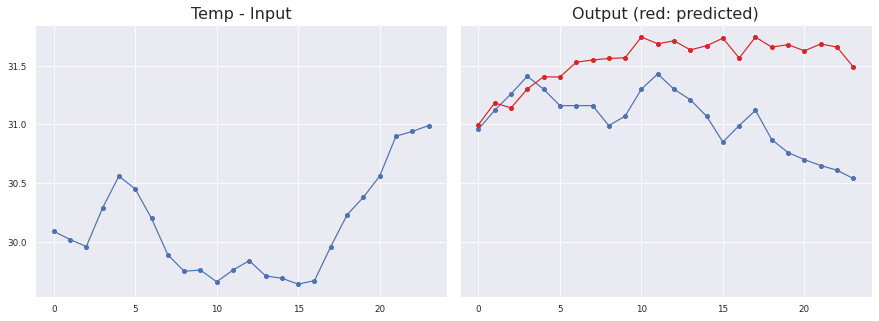

Sensor #15.0
Temp
MAE: 0.5162213802337635 ± 0.3474216869934709
MSE: 0.3679409883940366
RMSE: 0.606581394698219
Max Error: 1.0484246301651012


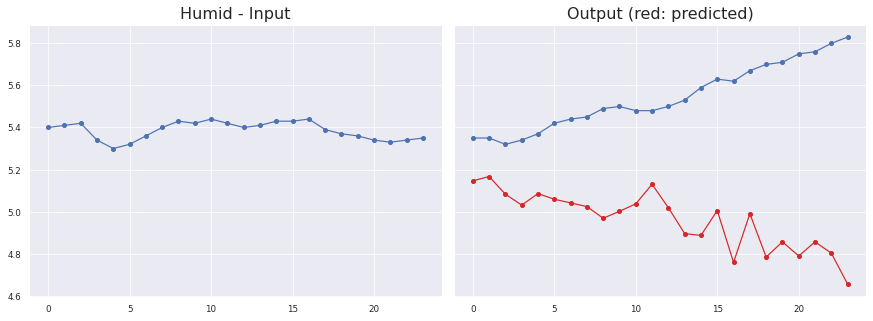

Sensor #15.0
Humid
MAE: 0.5836859431987006 ± 0.2775494821415118
MSE: 0.41772299532477825
RMSE: 0.6463149350933941
Max Error: 1.174858848750591

KL Divergence Sum: 4.13930550406073 bits
Pinball Loss Temp mean: 1.0372004268400712
Pinball Loss Humid mean: 0.6730165091792374
MSE Temp: 2.074400853680097
MSE Humid: 1.346033018358468


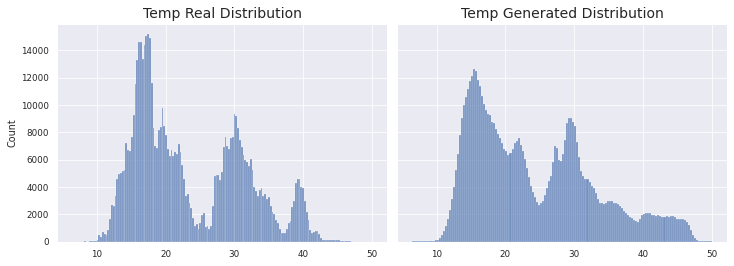

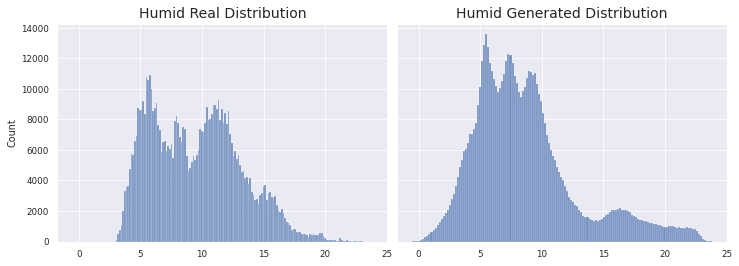

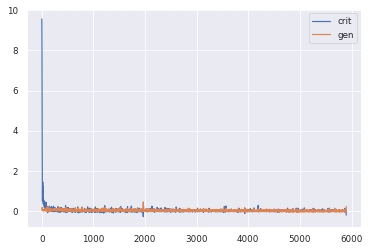

1966/1966 [==============================] - 162s 82ms/step - d_loss: -0.0029 - g_loss: -0.0089
Epoch 4/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0017 - g_loss: -0.0173Better KL
>4 MODELS HAVE BEEN SAVED


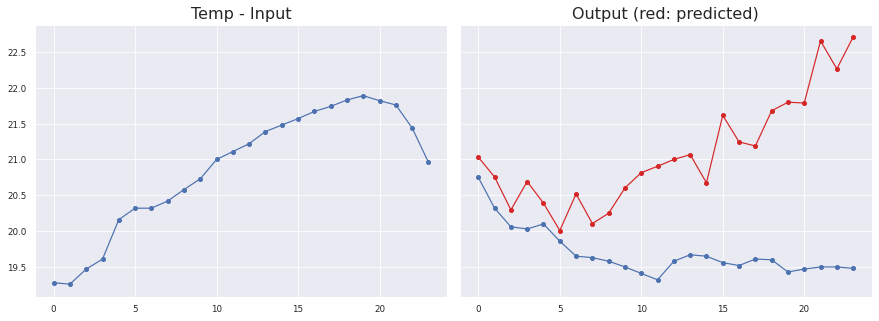

Sensor #2.0
Temp
MAE: 1.3864935792485873 ± 0.9105656392980297
MSE: 2.7514942287677884
RMSE: 1.658762860920086
Max Error: 3.228089628219603


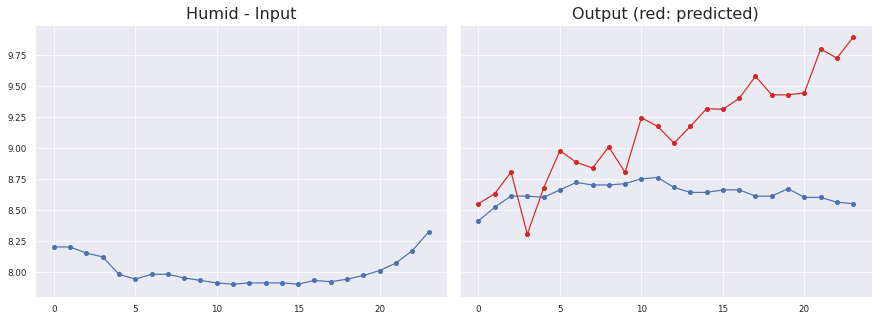

Sensor #2.0
Humid
MAE: 0.5324308680929246 ± 0.4065037529710085
MSE: 0.4221486150820957
RMSE: 0.64972964768594
Max Error: 1.3427453048527234


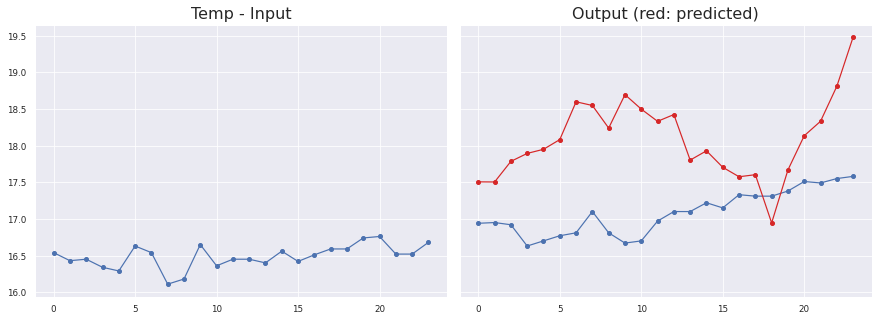

Sensor #31.0
Temp
MAE: 1.0313333349923293 ± 0.5921132977353429
MSE: 1.3524711899591235
RMSE: 1.162957948491313
Max Error: 2.0245025110244725


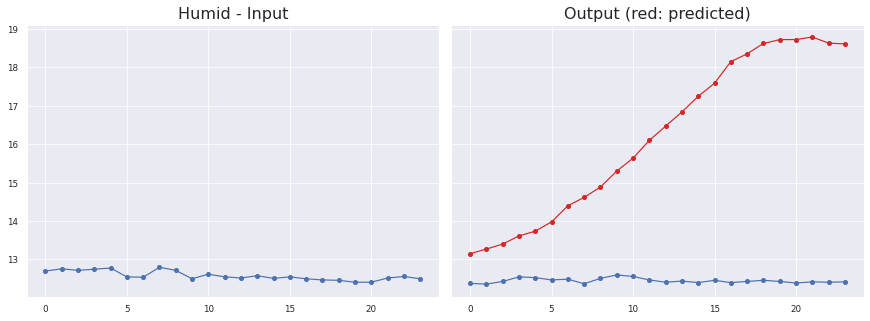

Sensor #31.0
Humid
MAE: 3.760912490074213 ± 2.072539691326298
MSE: 18.439883530119126
RMSE: 4.294168549337476
Max Error: 6.383319142162801


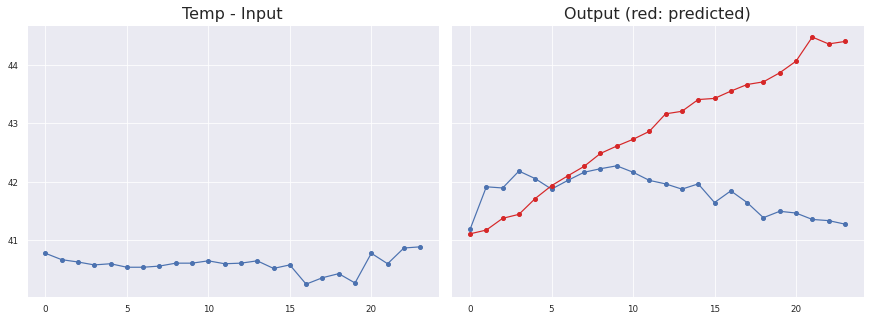

Sensor #19.0
Temp
MAE: 1.2824470618367172 ± 1.2399178367727488
MSE: 2.705087643601484
RMSE: 1.6447150645633073
Max Error: 3.133387548923487


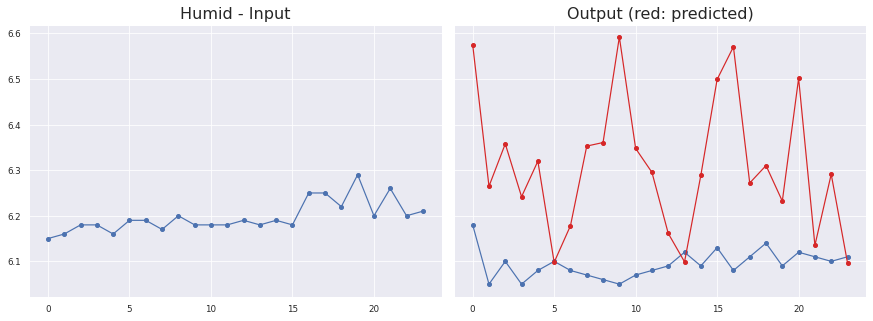

Sensor #19.0
Humid
MAE: 0.2189318261419735 ± 0.1474896585339772
MSE: 0.06836812131361382
RMSE: 0.26147298390773344
Max Error: 0.5420328542590145


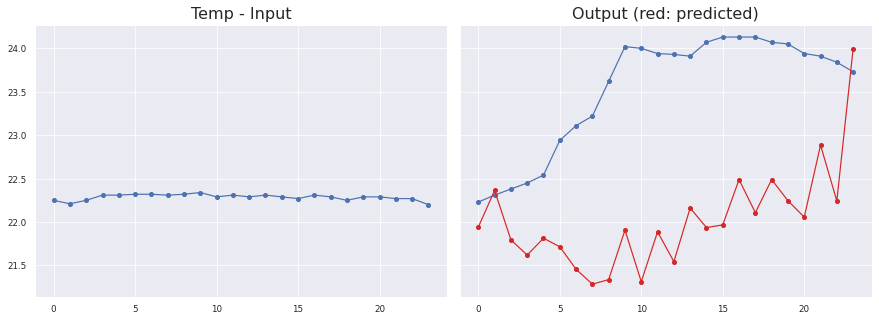

Sensor #9.0
Temp
MAE: 1.528304166148106 ± 0.7727715770751384
MSE: 2.8524455732389775
RMSE: 1.6889184625786342
Max Error: 2.6867965853214244


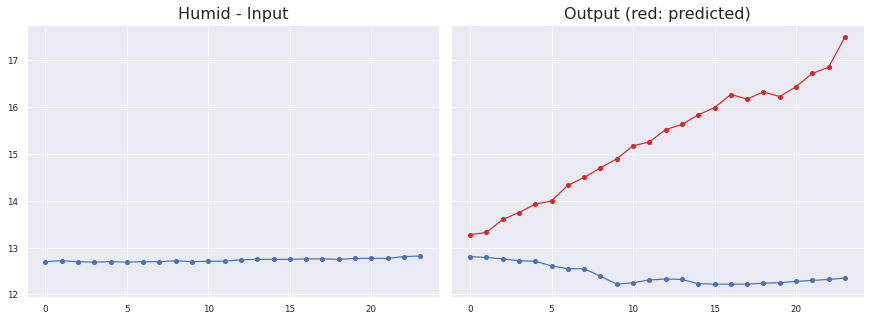

Sensor #9.0
Humid
MAE: 2.846543920525195 ± 1.3697163088127986
MSE: 9.978935058106705
RMSE: 3.1589452445565915
Max Error: 5.150963814854622

KL Divergence Sum: 3.3674132998029607 bits
Pinball Loss Temp mean: 1.031068816262085
Pinball Loss Humid mean: 0.8212640911817551
MSE Temp: 2.06213763252416
MSE Humid: 1.6425281823635223


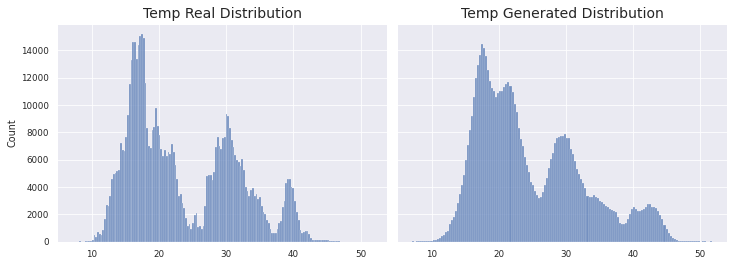

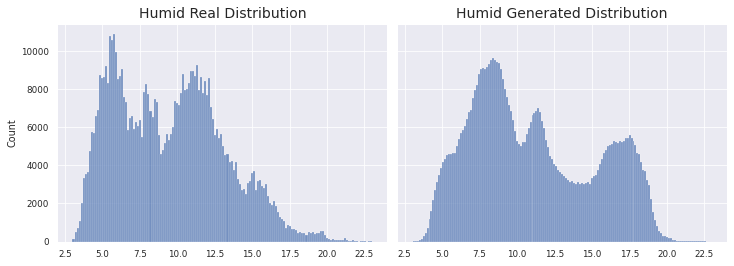

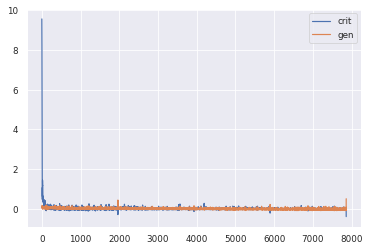

1966/1966 [==============================] - 162s 83ms/step - d_loss: -0.0021 - g_loss: -0.0168
Epoch 5/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 8.0818e-04 - g_loss: -0.0223Better Pinball
Better MSE
>5 MODELS HAVE BEEN SAVED


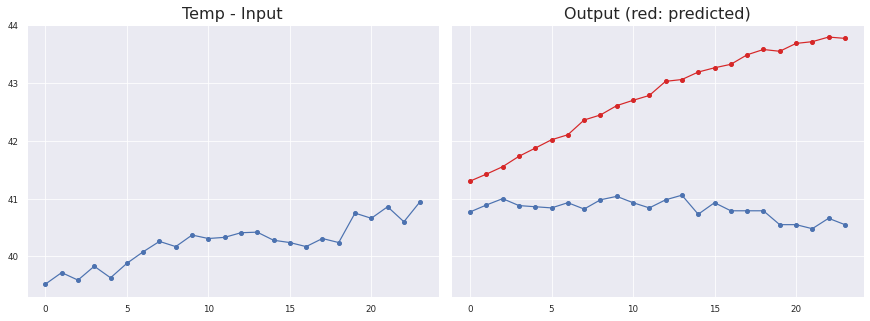

Sensor #19.0
Temp
MAE: 1.948468413750329 ± 0.8909746897262059
MSE: 4.590365057115432
RMSE: 2.1425137239036376
Max Error: 3.237782082557679


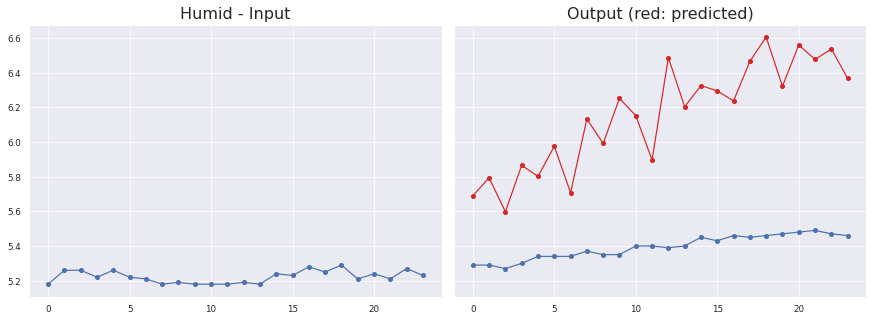

Sensor #19.0
Humid
MAE: 0.761168757937849 ± 0.2425596651795904
MSE: 0.6382130692326827
RMSE: 0.7988823876095171
Max Error: 1.1443829566240318


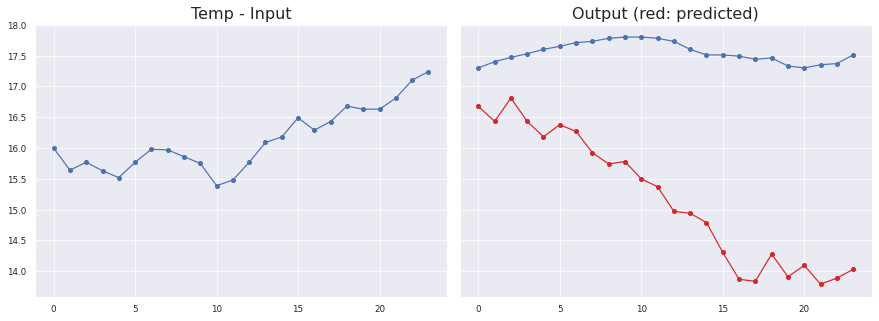

Sensor #31.0
Temp
MAE: 2.3720683779319134 ± 0.9905229595051406
MSE: 6.607844122891361
RMSE: 2.5705727227393043
Max Error: 3.619104254245755


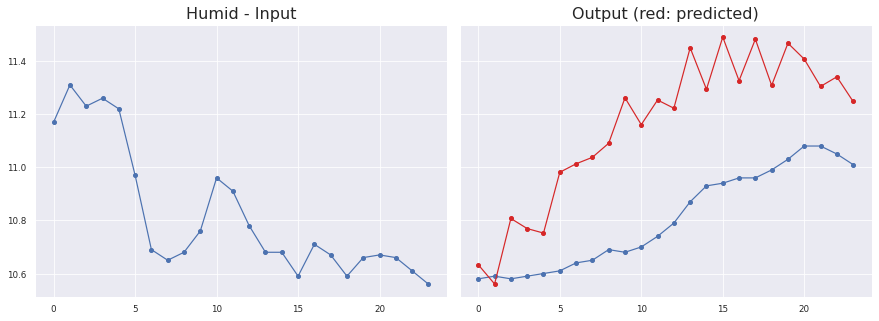

Sensor #31.0
Humid
MAE: 0.3490684917786473 ± 0.15592912691027092
MSE: 0.14446137329183048
RMSE: 0.38008074575257095
Max Error: 0.5815591613948357


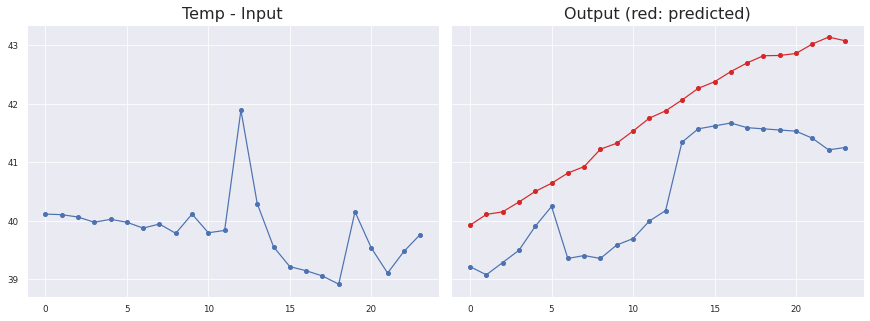

Sensor #33.0
Temp
MAE: 1.2393928961952507 ± 0.47042831774415333
MSE: 1.7573975532748456
RMSE: 1.3256687192790082
Max Error: 1.932062666416165


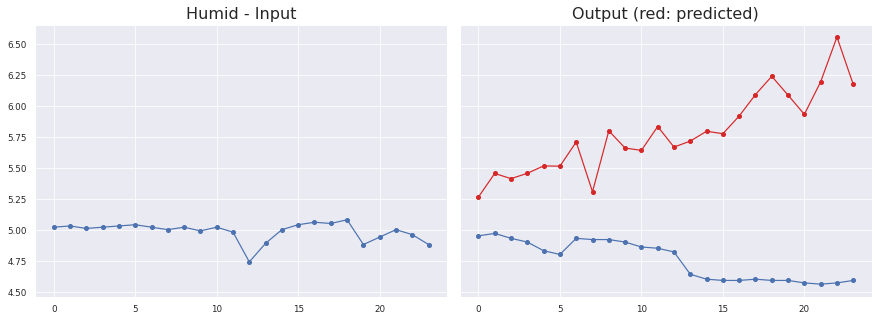

Sensor #33.0
Humid
MAE: 1.0263023049011828 ± 0.45083573029566504
MSE: 1.2565492767567061
RMSE: 1.1209590879049538
Max Error: 1.9858534833788877


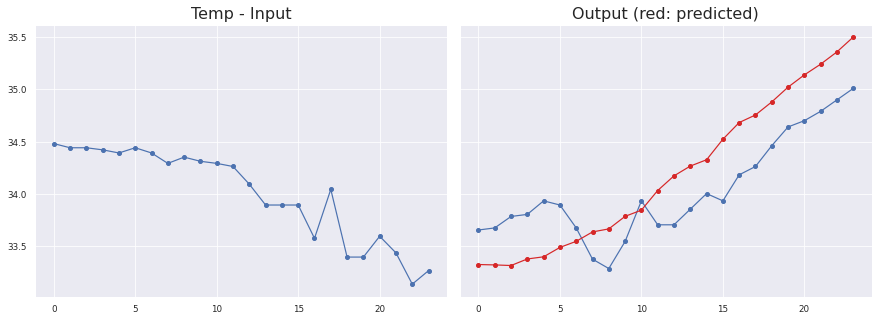

Sensor #11.0
Temp
MAE: 0.39203864380717235 ± 0.37558865945848
MSE: 0.16762532197833327
RMSE: 0.4094207151309436
Max Error: 0.5916962897777438


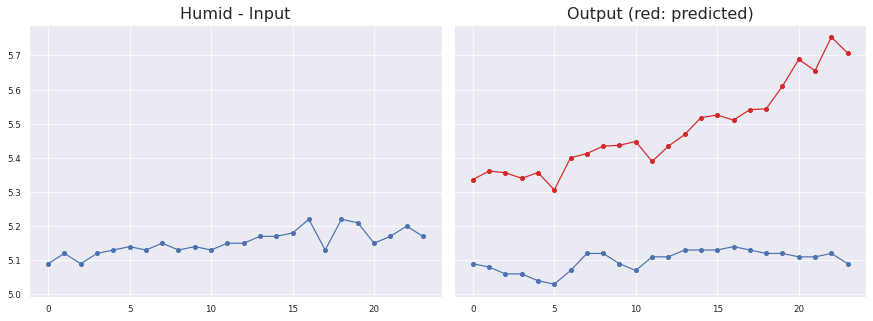

Sensor #11.0
Humid
MAE: 0.3814941964422665 ± 0.11040986925221195
MSE: 0.15772816114742116
RMSE: 0.3971500486559471
Max Error: 0.6340399956703191

KL Divergence Sum: 3.9912943755039785 bits
Pinball Loss Temp mean: 1.1823677727545652
Pinball Loss Humid mean: 0.39062278779202925
MSE Temp: 2.3647355455091197
MSE Humid: 0.7812455755840588


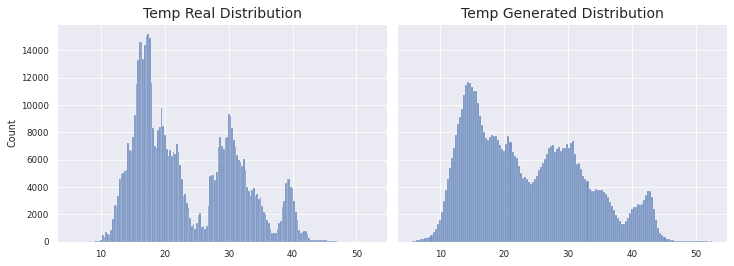

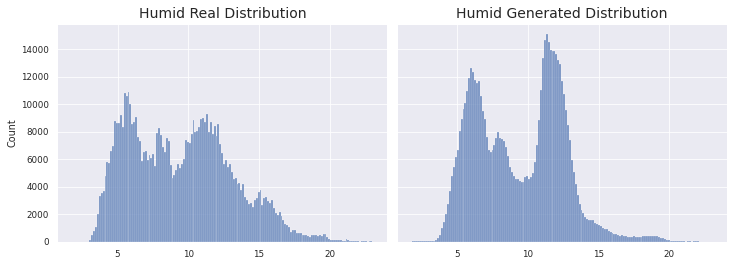

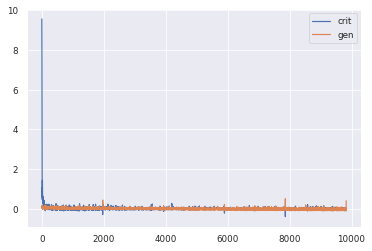

1966/1966 [==============================] - 162s 82ms/step - d_loss: 8.1084e-04 - g_loss: -0.0219
Epoch 6/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 9.1104e-04 - g_loss: -0.0256
KL Divergence Sum: 7.060922882747301 bits
Pinball Loss Temp mean: 1.2826129889724427
Pinball Loss Humid mean: 1.2413234728734825
MSE Temp: 2.5652259779448836
MSE Humid: 2.4826469457469487


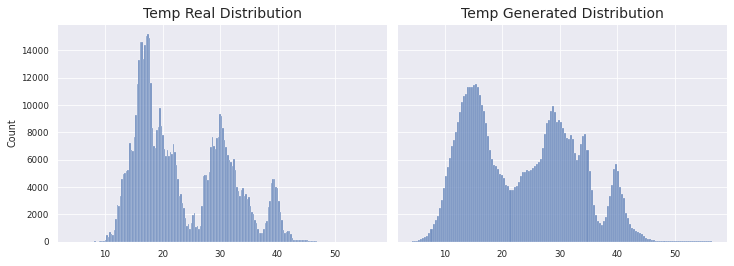

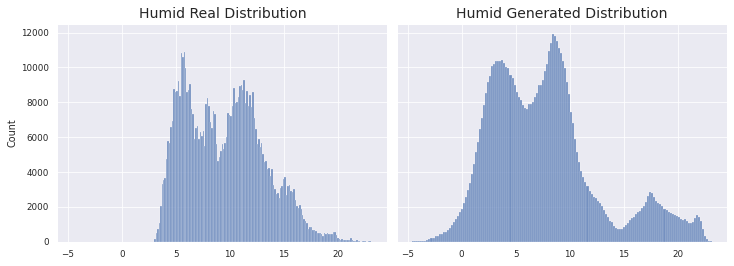

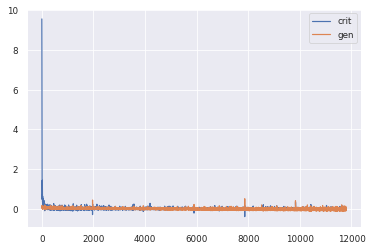

1966/1966 [==============================] - 156s 79ms/step - d_loss: 8.4112e-04 - g_loss: -0.0255
Epoch 7/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0013 - g_loss: -0.0336Better Pinball
Better MSE
>7 MODELS HAVE BEEN SAVED


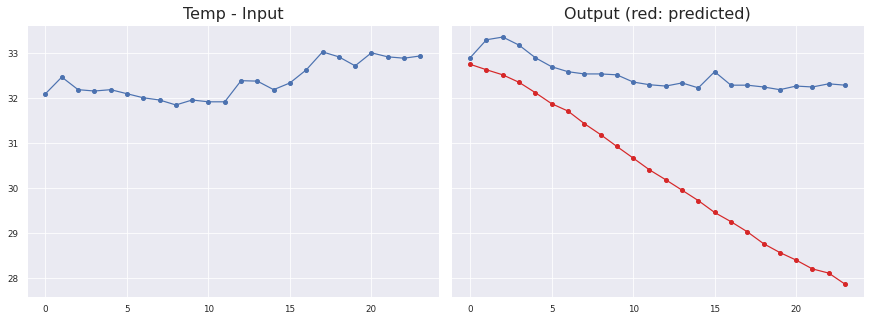

Sensor #32.0
Temp
MAE: 2.1932042224581045 ± 1.2958515120644756
MSE: 6.489375902727848
RMSE: 2.5474253478223554
Max Error: 4.424577920138837


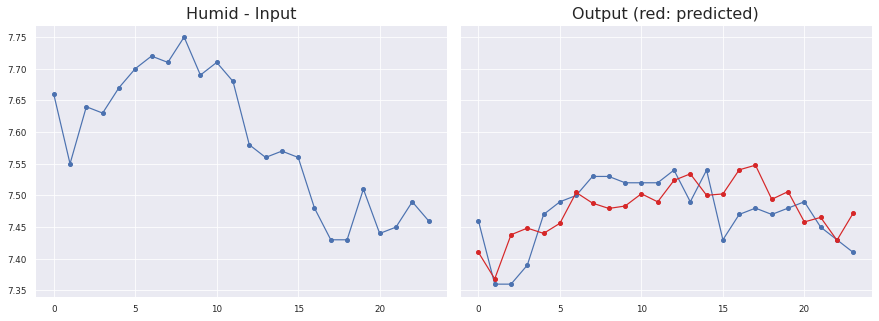

Sensor #32.0
Humid
MAE: 0.037941006769736475 ± 0.04328727539154801
MSE: 0.0019143255082455478
RMSE: 0.04375300570527181
Max Error: 0.07795248597860382


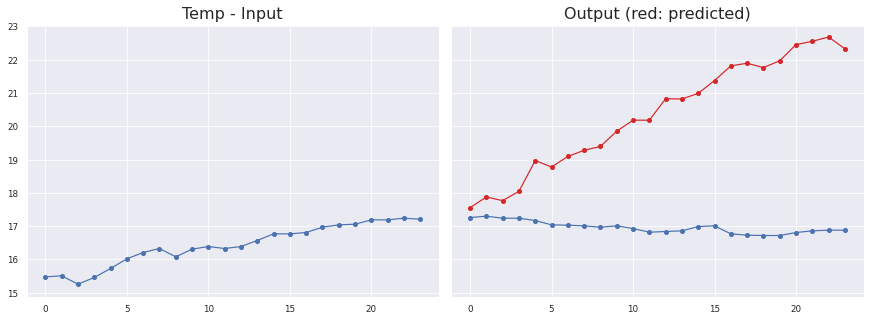

Sensor #6.0
Temp
MAE: 3.389018355607986 ± 1.7832334577213966
MSE: 14.665366979384865
RMSE: 3.829538742379409
Max Error: 5.798483530282976


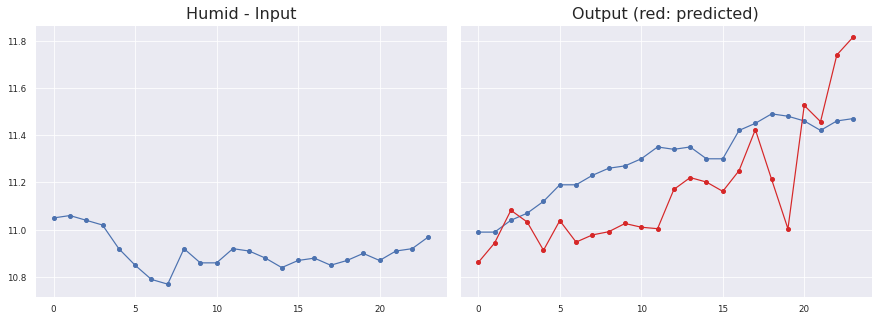

Sensor #6.0
Humid
MAE: 0.18602109982632062 ± 0.18219758674466066
MSE: 0.0480691992064918
RMSE: 0.21924689098477954
Max Error: 0.4760199256986386


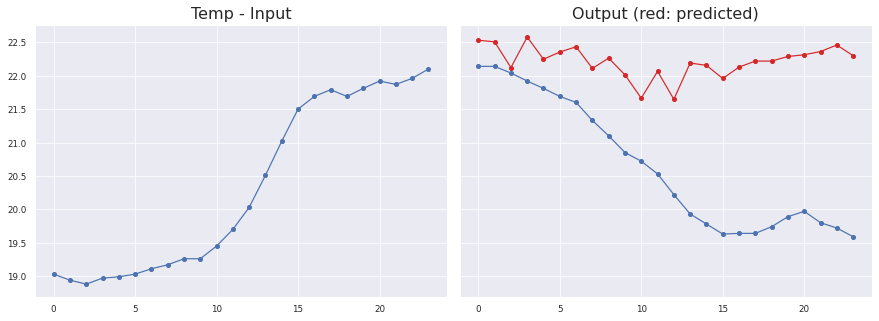

Sensor #18.0
Temp
MAE: 1.5709212438265476 ± 0.8949379241565799
MSE: 3.268707442399236
RMSE: 1.8079567036849185
Max Error: 2.738851923942569


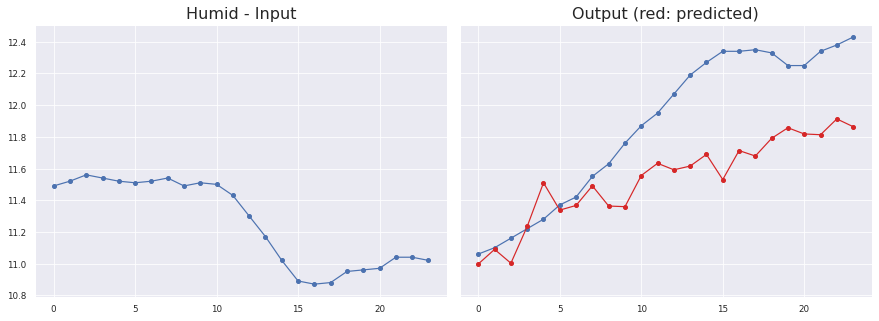

Sensor #18.0
Humid
MAE: 0.35761314375325975 ± 0.26076941345342025
MSE: 0.1817592526684121
RMSE: 0.42633232655806447
Max Error: 0.809681951031088


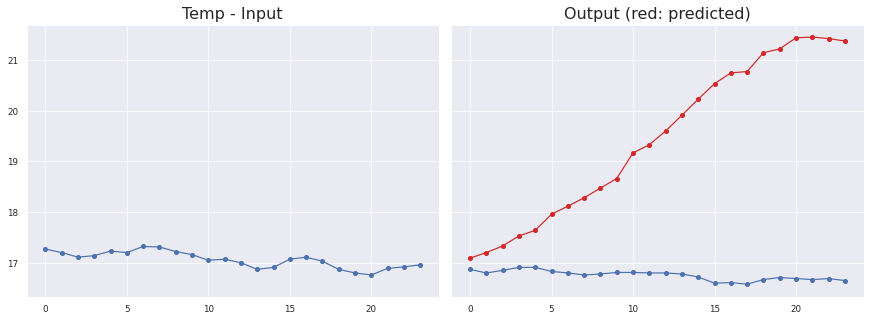

Sensor #6.0
Temp
MAE: 2.6777072616418205 ± 1.601436085984178
MSE: 9.73471371654166
RMSE: 3.1200502746817493
Max Error: 4.763743255138397


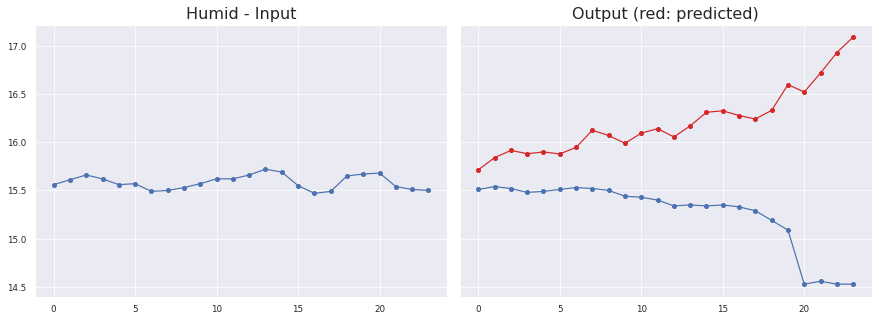

Sensor #6.0
Humid
MAE: 0.946937525998802 ± 0.6674889562905735
MSE: 1.3422321849146108
RMSE: 1.158547446121483
Max Error: 2.55784456342459

KL Divergence Sum: 3.6157145263105 bits
Pinball Loss Temp mean: 0.9947290521768114
Pinball Loss Humid mean: 0.3258607759273149
MSE Temp: 1.9894581043536446
MSE Humid: 0.6517215518546303


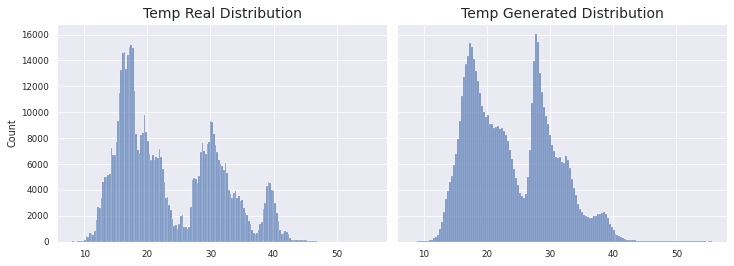

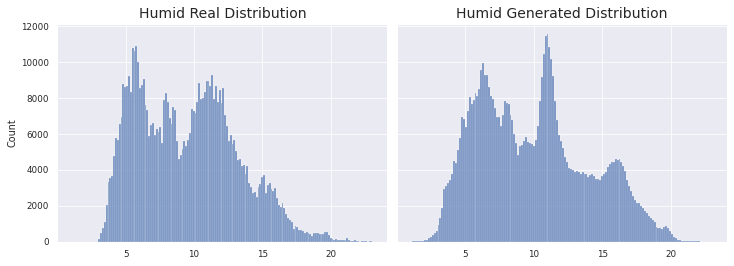

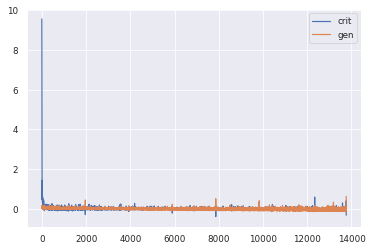

1966/1966 [==============================] - 163s 83ms/step - d_loss: 9.4575e-04 - g_loss: -0.0329
Epoch 8/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 5.4522e-04 - g_loss: -0.0339
KL Divergence Sum: 4.04757508226155 bits
Pinball Loss Temp mean: 2.0010028482014155
Pinball Loss Humid mean: 0.47433031687645
MSE Temp: 4.002005696402861
MSE Humid: 0.9486606337528856


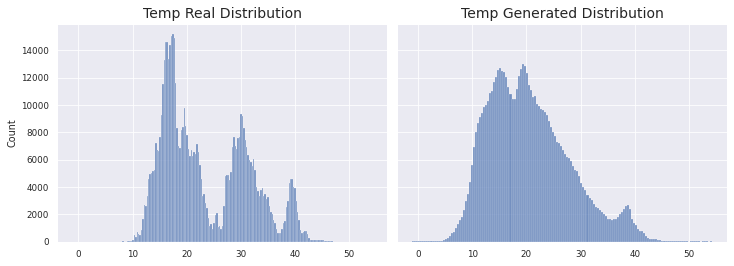

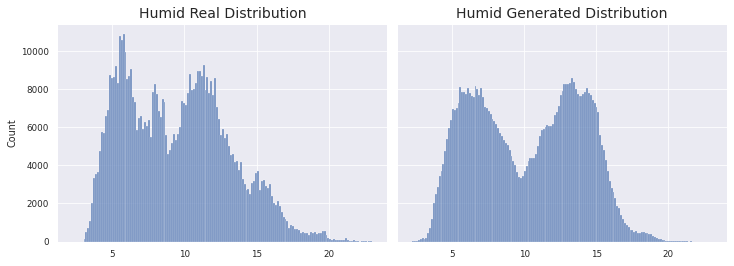

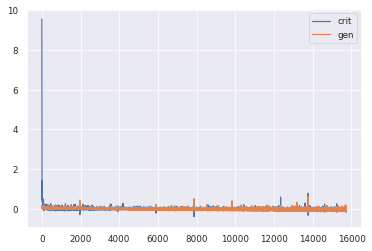

1966/1966 [==============================] - 155s 79ms/step - d_loss: 3.5687e-04 - g_loss: -0.0336
Epoch 9/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 9.0207e-04 - g_loss: -0.0366
KL Divergence Sum: 9.274678996164464 bits
Pinball Loss Temp mean: 2.114955395119393
Pinball Loss Humid mean: 0.3191422026849786
MSE Temp: 4.229910790238844
MSE Humid: 0.6382844053699686


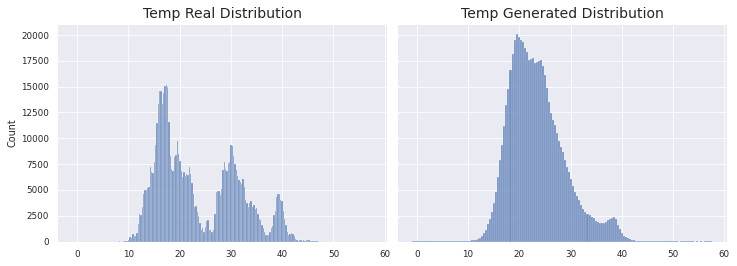

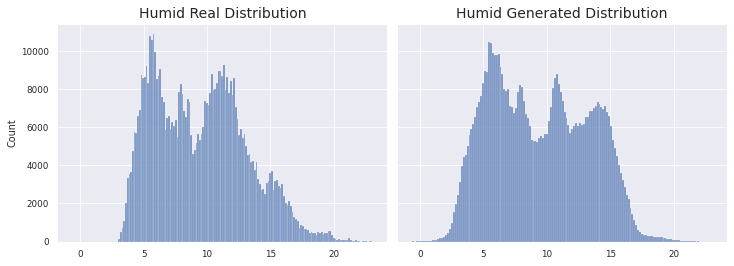

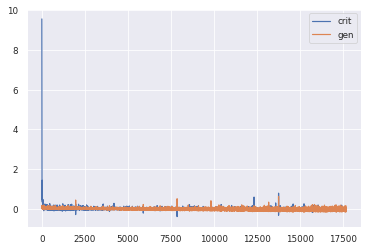

1966/1966 [==============================] - 155s 79ms/step - d_loss: 8.3305e-04 - g_loss: -0.0364
Epoch 10/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0012 - g_loss: -0.0277Better KL
>10 MODELS HAVE BEEN SAVED


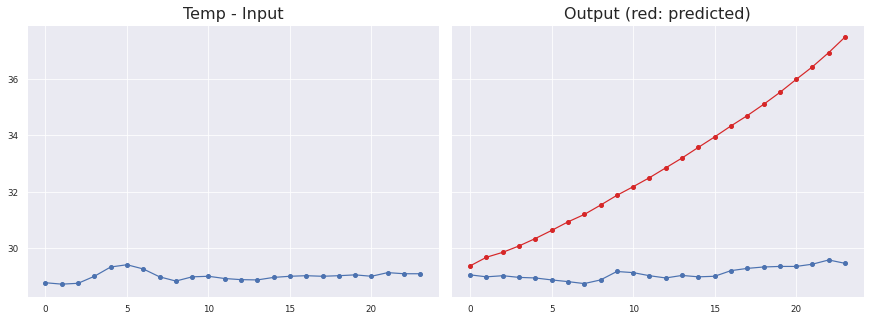

Sensor #12.0
Temp
MAE: 3.8299190260718254 ± 2.2447168031555202
MSE: 19.707033272635694
RMSE: 4.439260442082182
Max Error: 8.04771591663361


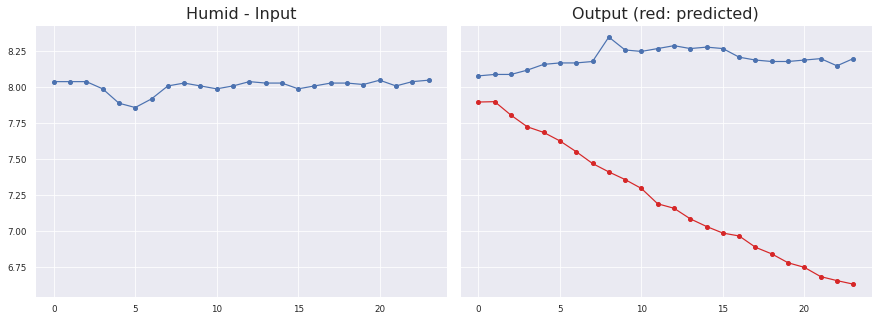

Sensor #12.0
Humid
MAE: 0.9754222355162101 ± 0.4367589748986996
MSE: 1.1422069396940036
RMSE: 1.0687408197004564
Max Error: 1.5683768567442886


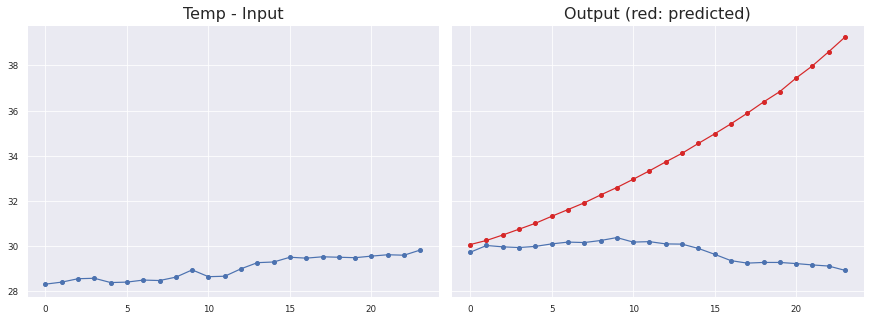

Sensor #7.0
Temp
MAE: 4.135110654681921 ± 3.1192287800171106
MSE: 26.82872830855098
RMSE: 5.179645577503443
Max Error: 10.319713292121882


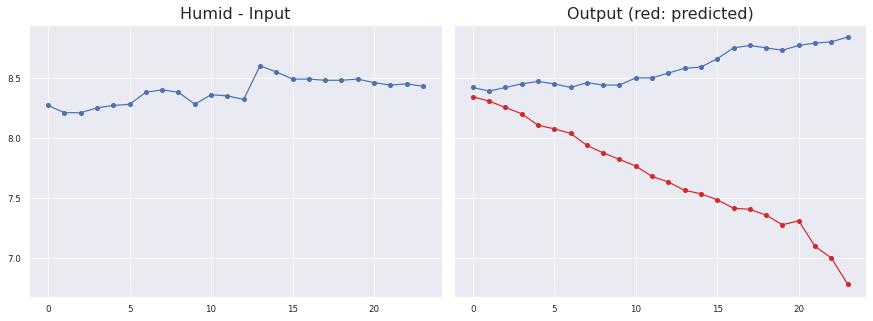

Sensor #7.0
Humid
MAE: 0.9033109311635291 ± 0.5652735664467342
MSE: 1.1355048432829324
RMSE: 1.0656006959846323
Max Error: 2.05846121519804


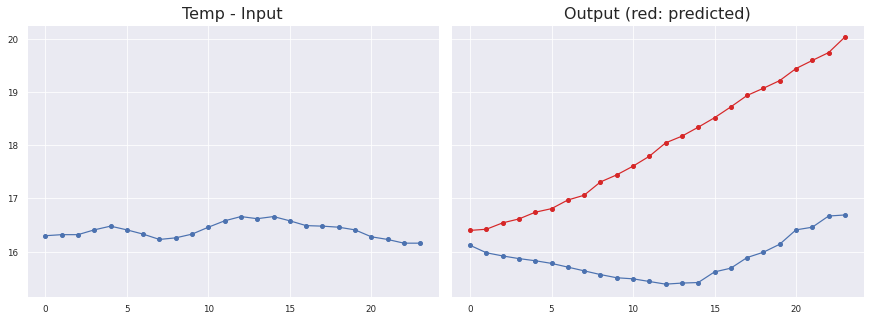

Sensor #30.0
Temp
MAE: 2.1208833578228954 ± 1.0036005179596559
MSE: 5.5053602171390095
RMSE: 2.346350403741736
Max Error: 3.343428707122804


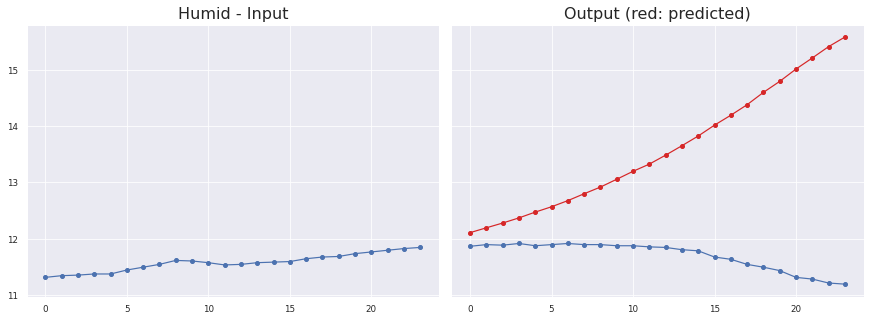

Sensor #30.0
Humid
MAE: 1.879822491653031 ± 1.302479893469587
MSE: 5.230186473017157
RMSE: 2.286960094321096
Max Error: 4.374810176342727


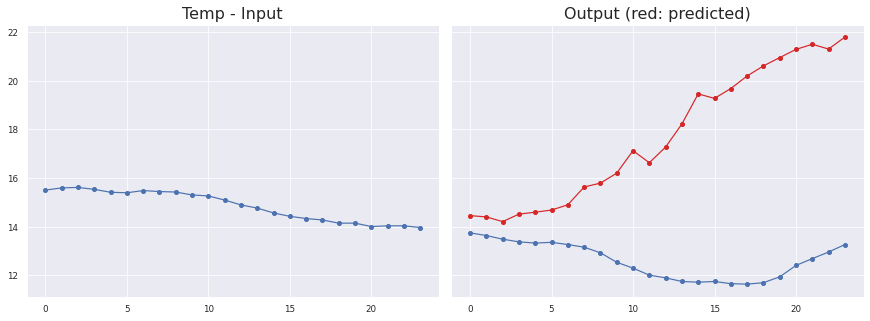

Sensor #8.0
Temp
MAE: 5.0966072345773386 ± 3.1888740133736233
MSE: 36.14432277671566
RMSE: 6.012014868304607
Max Error: 9.021459994316103


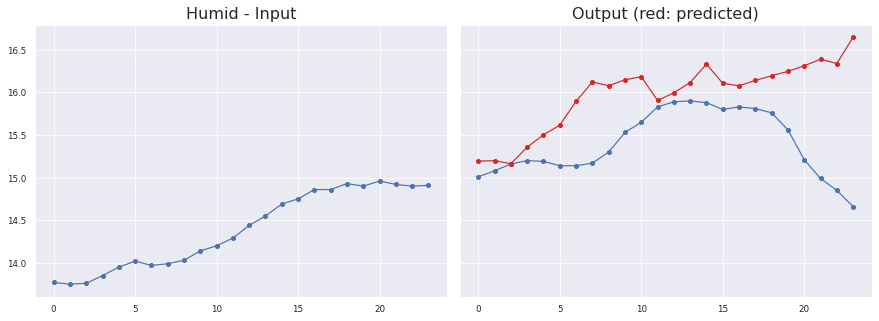

Sensor #8.0
Humid
MAE: 0.5719347119734937 ± 0.49319860167487206
MSE: 0.5703541754542522
RMSE: 0.7552179655266764
Max Error: 1.989514723122122

KL Divergence Sum: 2.829426744075908 bits
Pinball Loss Temp mean: 1.9653905036797603
Pinball Loss Humid mean: 0.5249402791298124
MSE Temp: 3.9307810073595513
MSE Humid: 1.049880558259625


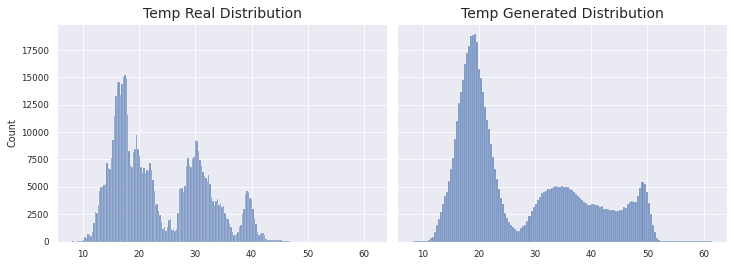

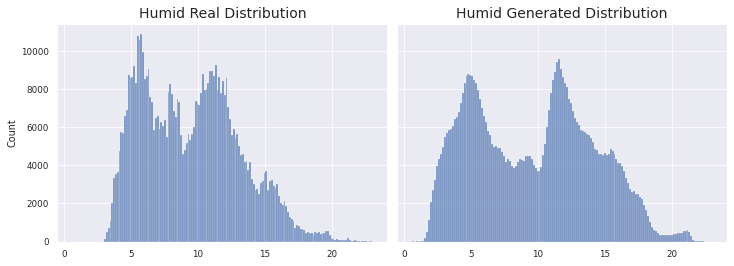

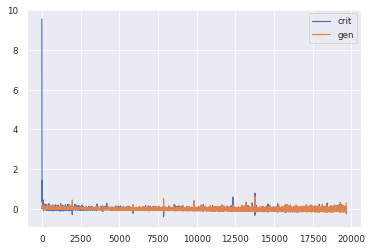

1966/1966 [==============================] - 162s 83ms/step - d_loss: 9.2548e-04 - g_loss: -0.0274
Epoch 11/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0019 - g_loss: -0.0215
KL Divergence Sum: 3.03553818551014 bits
Pinball Loss Temp mean: 1.849049913178575
Pinball Loss Humid mean: 0.3500780505489378
MSE Temp: 3.698099826357081
MSE Humid: 0.7001561010978734


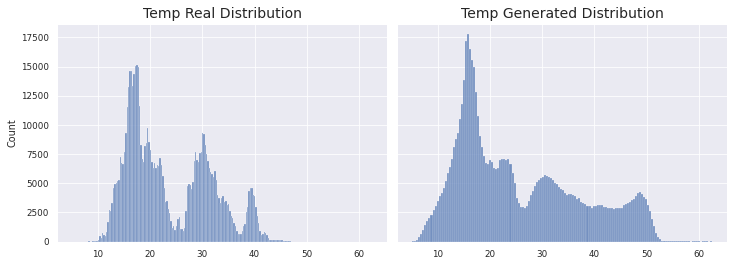

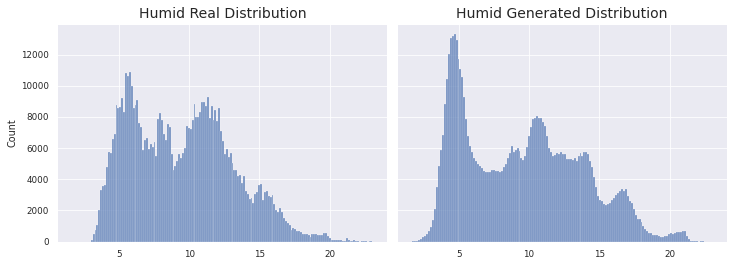

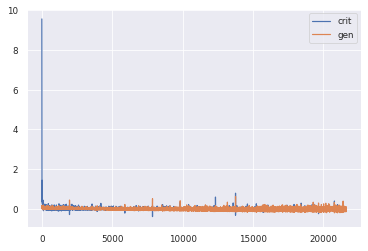

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0018 - g_loss: -0.0214
Epoch 12/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0017 - g_loss: -0.0135
KL Divergence Sum: 6.051002538755077 bits
Pinball Loss Temp mean: 2.9841171857720137
Pinball Loss Humid mean: 0.7293375981471559
MSE Temp: 5.968234371543967
MSE Humid: 1.4586751962943094


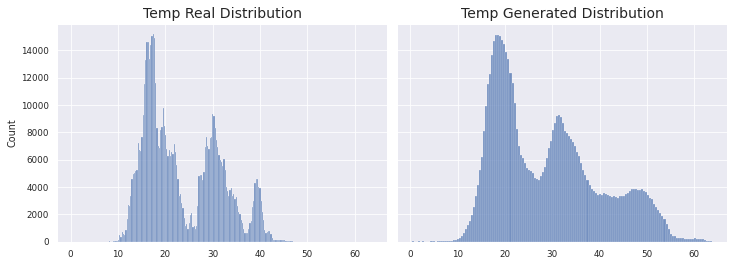

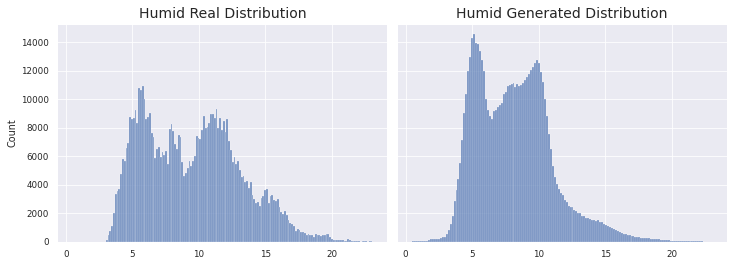

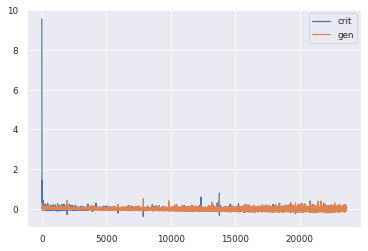

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0017 - g_loss: -0.0133
Epoch 13/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0016 - g_loss: -0.0104
KL Divergence Sum: 6.129762387454093 bits
Pinball Loss Temp mean: 2.8893221293675575
Pinball Loss Humid mean: 0.49836007728448656
MSE Temp: 5.77864425873517
MSE Humid: 0.9967201545689536


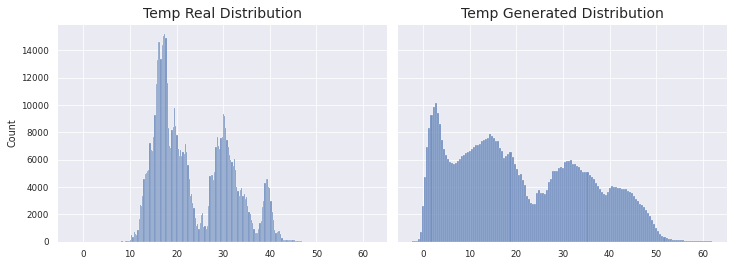

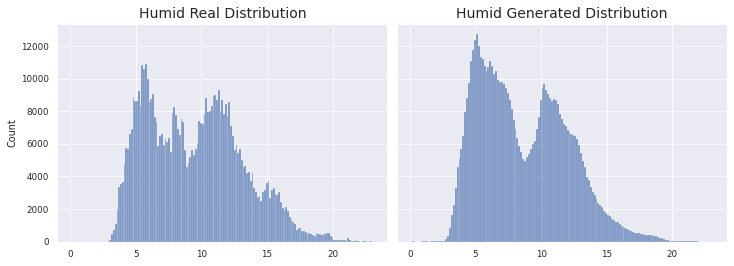

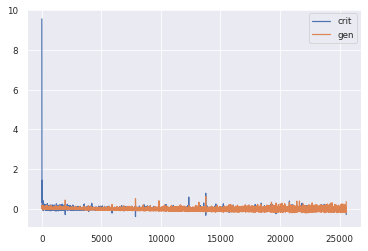

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0013 - g_loss: -0.0100
Epoch 14/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0020 - g_loss: -0.0134
KL Divergence Sum: 9.822485745964892 bits
Pinball Loss Temp mean: 1.7068503424773993
Pinball Loss Humid mean: 0.502185037766514
MSE Temp: 3.4137006849547715
MSE Humid: 1.0043700755330331


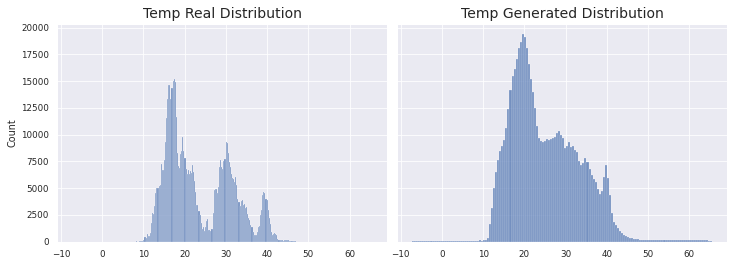

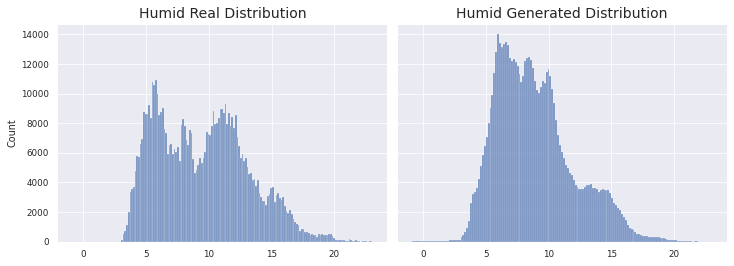

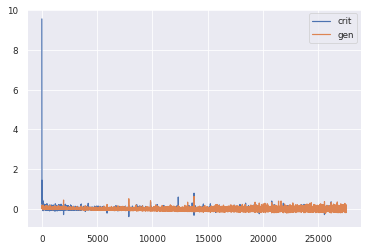

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0018 - g_loss: -0.0133
Epoch 15/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0031 - g_loss: -0.0044
KL Divergence Sum: 5.841659801730109 bits
Pinball Loss Temp mean: 1.72360545331492
Pinball Loss Humid mean: 0.3080712234587848
MSE Temp: 3.4472109066298824
MSE Humid: 0.6161424469175615


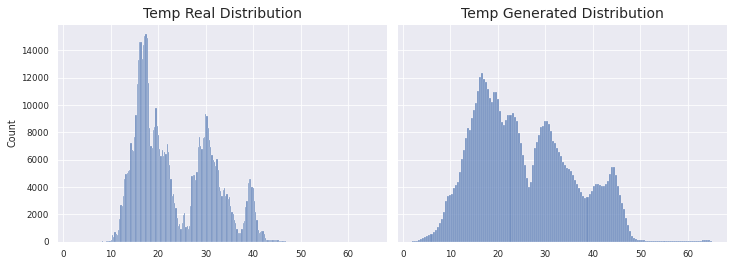

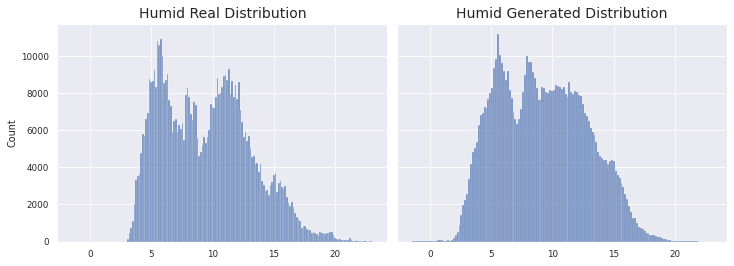

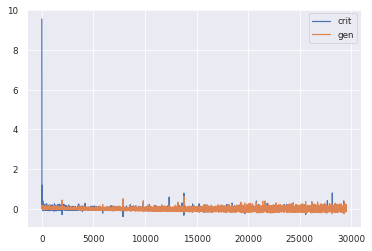

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0031 - g_loss: -0.0044
Epoch 16/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0033 - g_loss: -0.0044
KL Divergence Sum: 3.4069372232423745 bits
Pinball Loss Temp mean: 1.2562994801571747
Pinball Loss Humid mean: 0.31103444272217656
MSE Temp: 2.5125989603142833
MSE Humid: 0.6220688854443439


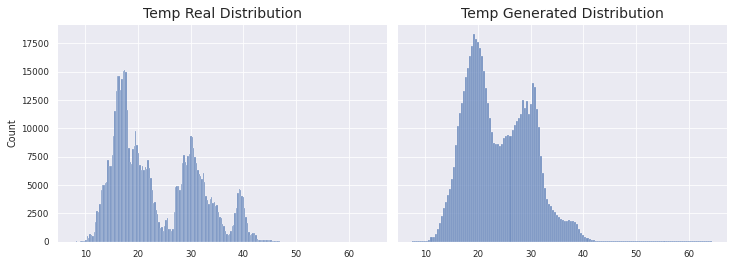

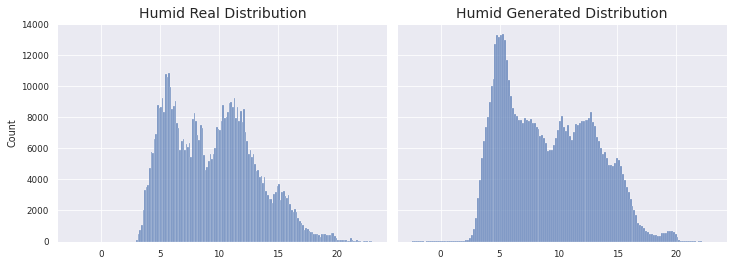

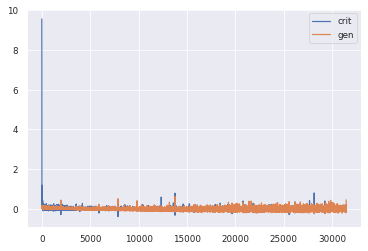

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0032 - g_loss: -0.0039
Epoch 17/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0033 - g_loss: -0.0026
KL Divergence Sum: 4.620633464729475 bits
Pinball Loss Temp mean: 2.7029980576207677
Pinball Loss Humid mean: 0.5847973191896078
MSE Temp: 5.405996115241561
MSE Humid: 1.1695946383791929


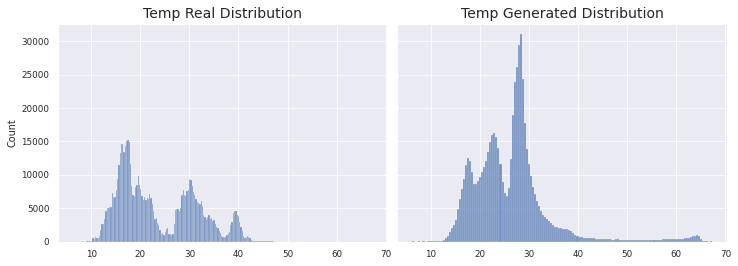

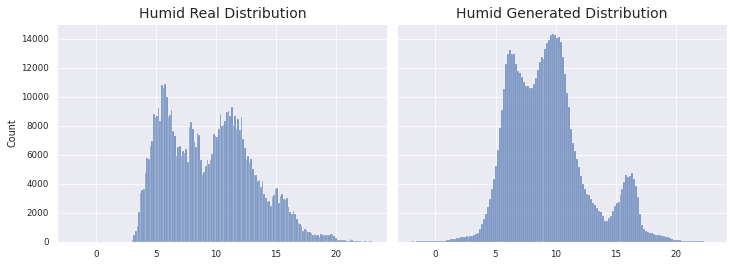

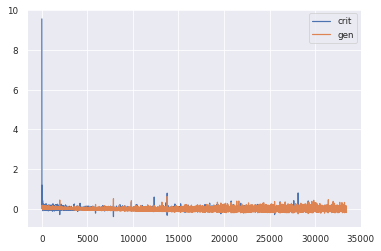

1966/1966 [==============================] - 154s 79ms/step - d_loss: 0.0032 - g_loss: -0.0024
Epoch 18/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0046 - g_loss: -0.0012
KL Divergence Sum: 3.669838103027926 bits
Pinball Loss Temp mean: 1.3412059656007151
Pinball Loss Humid mean: 0.272477679534144
MSE Temp: 2.6824119312013908
MSE Humid: 0.5449553590682812


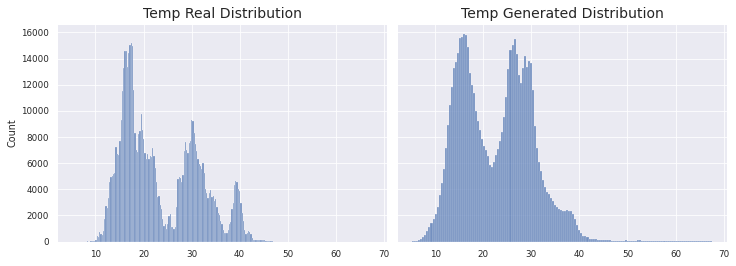

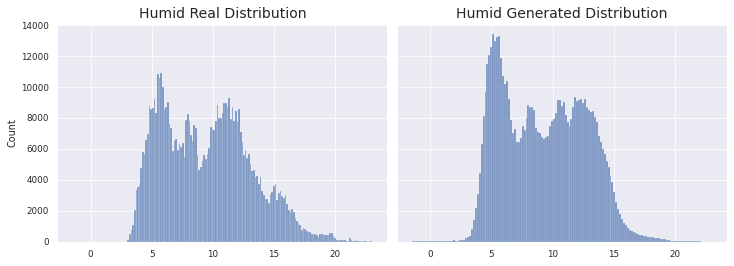

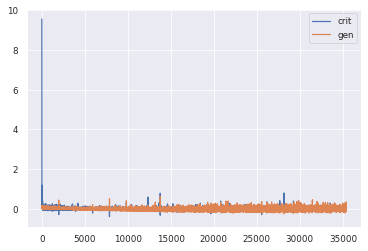

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0045 - g_loss: -8.6792e-04
Epoch 19/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0057 - g_loss: -0.0042
KL Divergence Sum: 6.715839742734903 bits
Pinball Loss Temp mean: 1.9514693737356665
Pinball Loss Humid mean: 0.36682750407015036
MSE Temp: 3.9029387474714525
MSE Humid: 0.7336550081402947


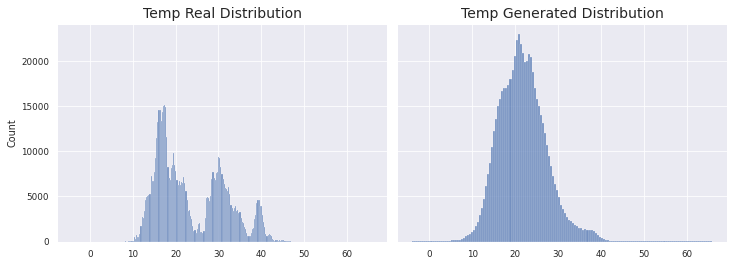

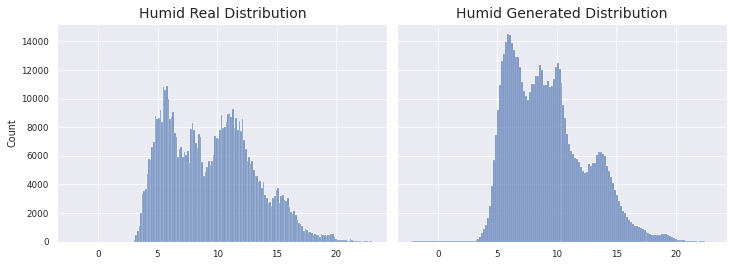

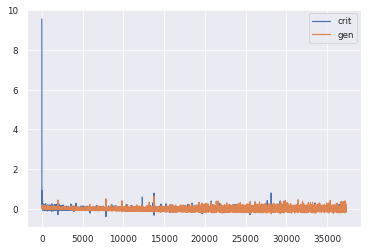

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0056 - g_loss: -0.0039
Epoch 20/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0067 - g_loss: -2.4092e-04
KL Divergence Sum: 6.015136676225957 bits
Pinball Loss Temp mean: 3.0934929199148824
Pinball Loss Humid mean: 0.8193091218331208
MSE Temp: 6.1869858398296635
MSE Humid: 1.6386182436662449


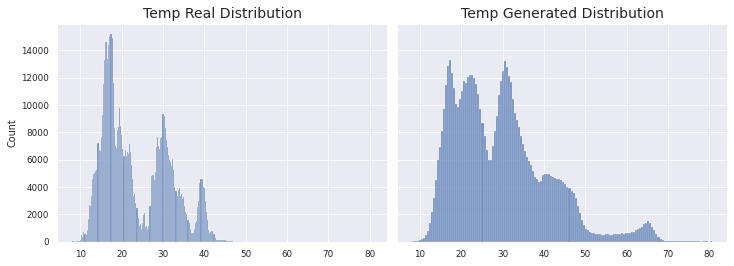

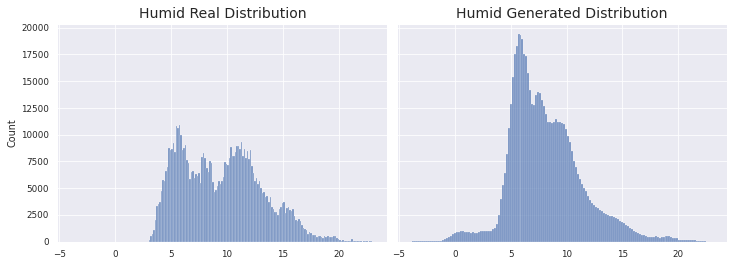

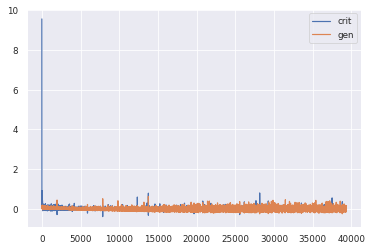

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0066 - g_loss: -2.0878e-04
Epoch 21/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0061 - g_loss: 0.0069
KL Divergence Sum: 8.671785352988698 bits
Pinball Loss Temp mean: 2.065609979542194
Pinball Loss Humid mean: 0.5574008167737053
MSE Temp: 4.131219959084399
MSE Humid: 1.1148016335474118


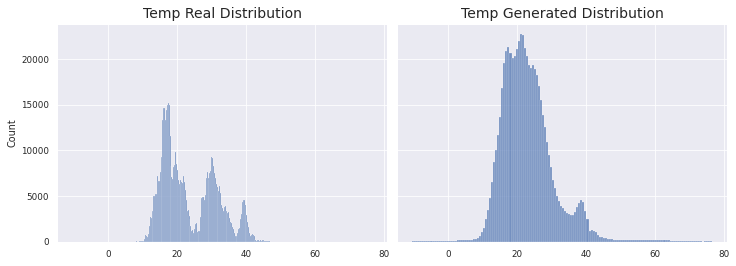

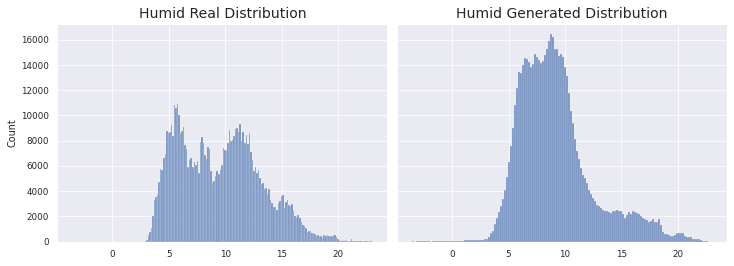

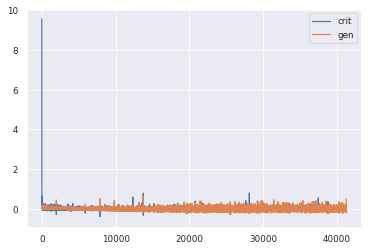

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0060 - g_loss: 0.0074
Epoch 22/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0076 - g_loss: 8.5688e-04
KL Divergence Sum: 4.403836846412614 bits
Pinball Loss Temp mean: 1.395248512119507
Pinball Loss Humid mean: 0.5106044403725163
MSE Temp: 2.7904970242389977
MSE Humid: 1.0212088807450261


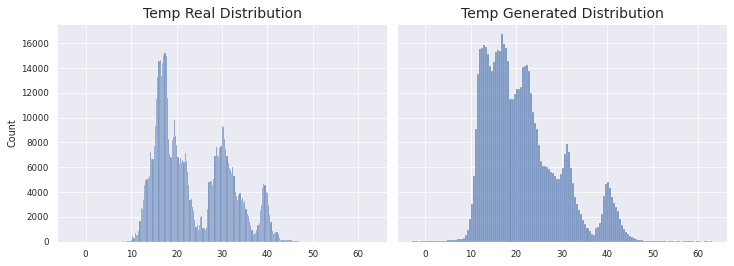

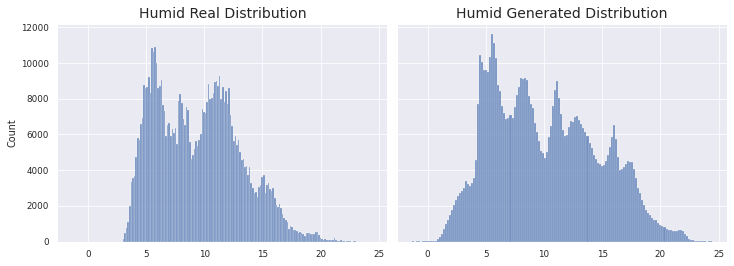

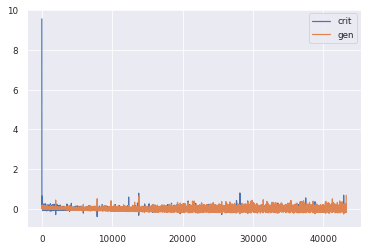

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0074 - g_loss: 0.0015
Epoch 23/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0058 - g_loss: 0.0193
KL Divergence Sum: 6.247307826037782 bits
Pinball Loss Temp mean: 1.633165414571457
Pinball Loss Humid mean: 0.607833300990021
MSE Temp: 3.2663308291429063
MSE Humid: 1.2156666019800426


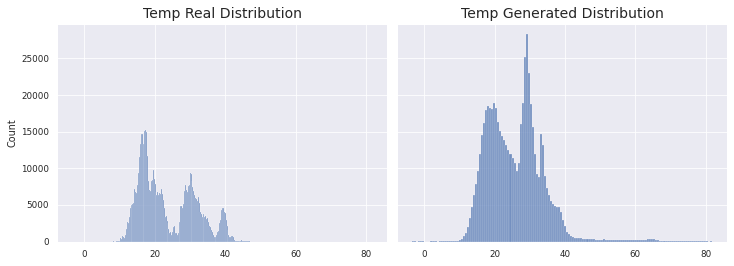

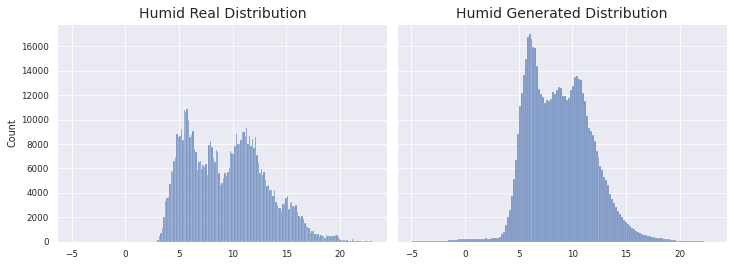

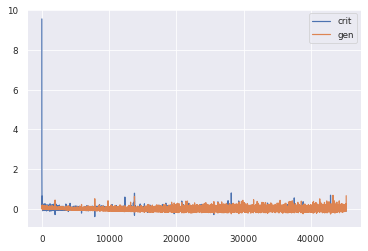

1966/1966 [==============================] - 154s 79ms/step - d_loss: 0.0056 - g_loss: 0.0200
Epoch 24/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0074 - g_loss: 0.0164
KL Divergence Sum: 4.894147820119775 bits
Pinball Loss Temp mean: 1.4121721108188015
Pinball Loss Humid mean: 0.3220122624597163
MSE Temp: 2.824344221637558
MSE Humid: 0.644024524919439


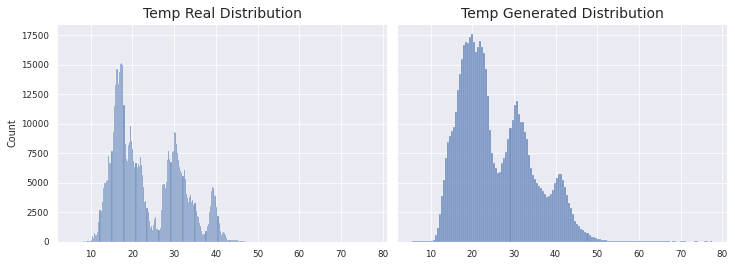

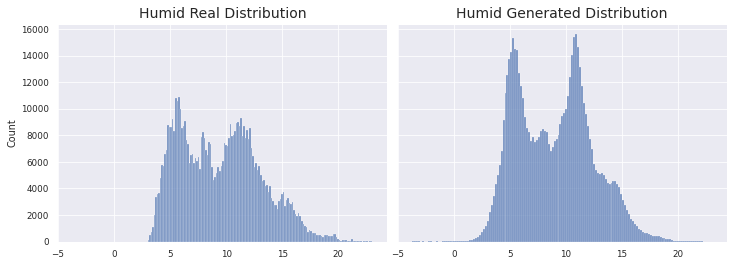

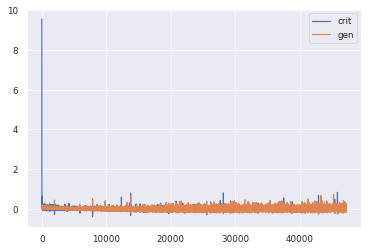

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0073 - g_loss: 0.0166
Epoch 25/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0085 - g_loss: 0.0091Better KL
>25 MODELS HAVE BEEN SAVED


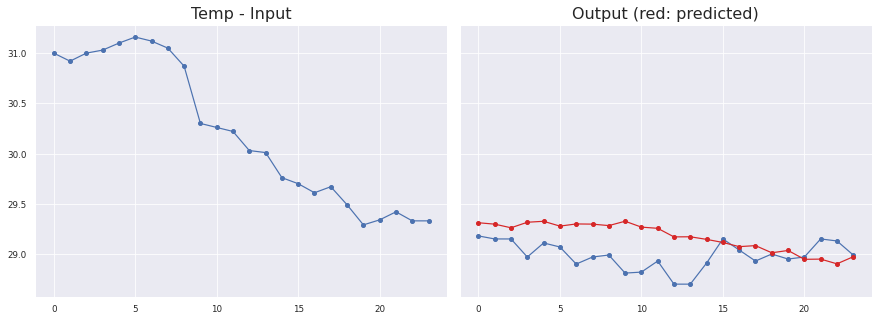

Sensor #25.0
Temp
MAE: 0.22645946323871616 ± 0.2036388727908353
MSE: 0.07551296839967131
RMSE: 0.2747962306867969
Max Error: 0.5163120496273059


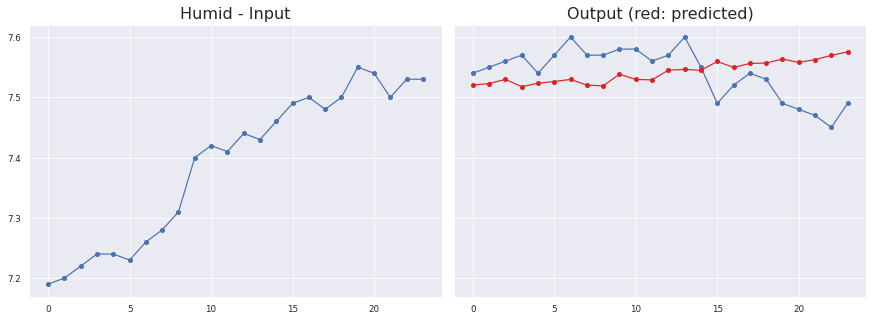

Sensor #25.0
Humid
MAE: 0.04827551162491217 ± 0.05553954751947492
MSE: 0.0030856021574570806
RMSE: 0.055548196707517705
Max Error: 0.1196697989106168


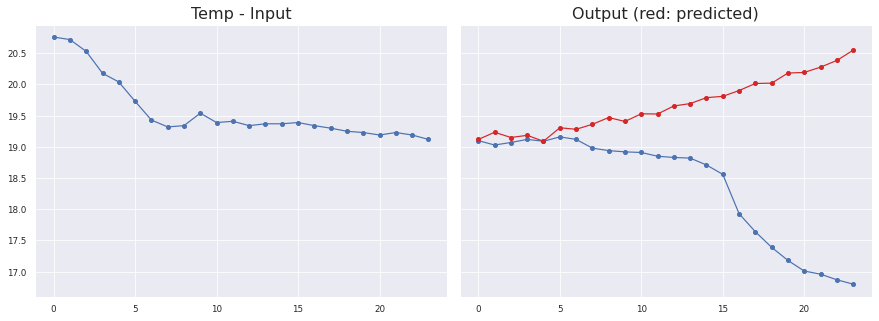

Sensor #16.0
Temp
MAE: 1.2978577534854405 ± 1.2646189159500585
MSE: 3.2835919040334436
RMSE: 1.8120684048990654
Max Error: 3.7489547812938717


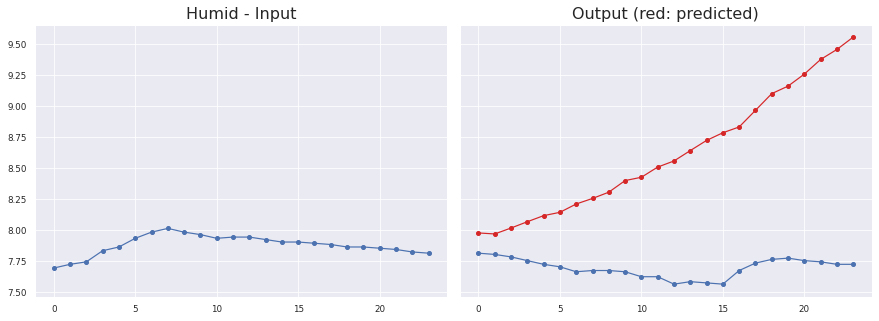

Sensor #16.0
Humid
MAE: 0.922898237717649 ± 0.49783081911546057
MSE: 1.0995766816435124
RMSE: 1.0486070196424933
Max Error: 1.8348554821312435


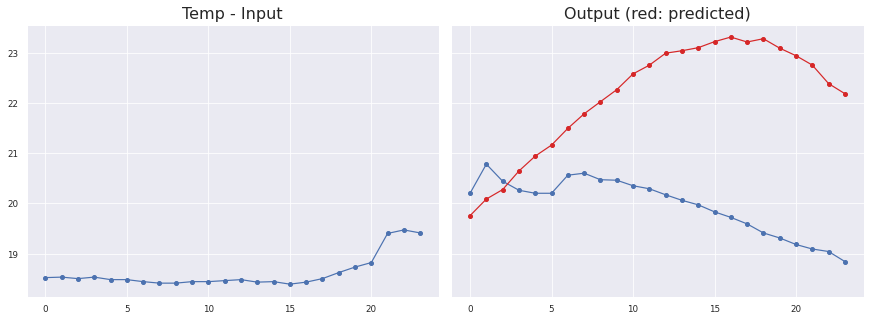

Sensor #31.0
Temp
MAE: 2.285279501080513 ± 1.456692219046368
MSE: 6.858411767413069
RMSE: 2.6188569581810057
Max Error: 3.868476049900057


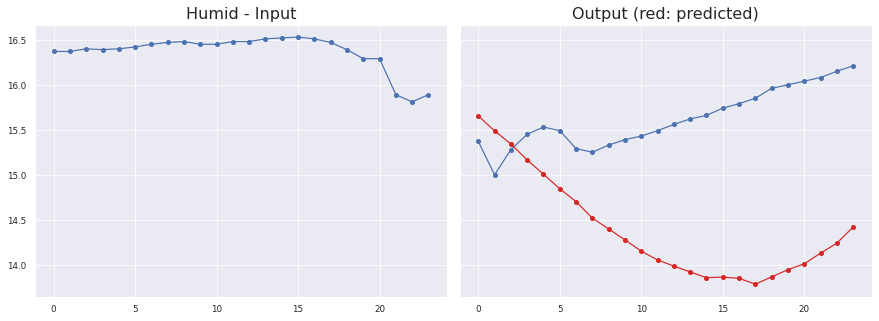

Sensor #31.0
Humid
MAE: 1.2983236314014837 ± 0.7932766390144163
MSE: 2.139450754368589
RMSE: 1.4626861434937397
Max Error: 2.0951696617156266


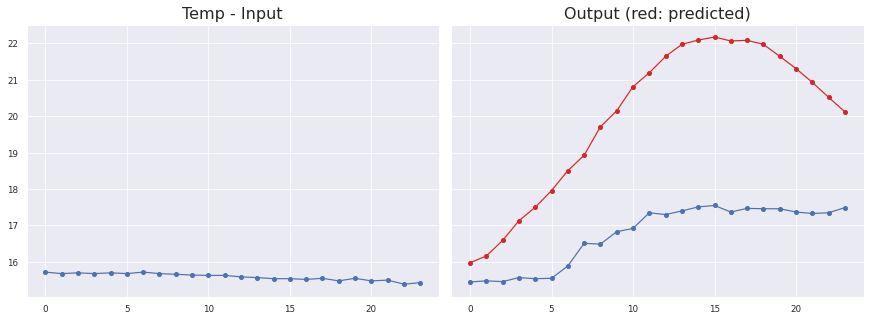

Sensor #31.0
Temp
MAE: 3.210479598889748 ± 1.2836690081183983
MSE: 11.954985377290951
RMSE: 3.457598209348644
Max Error: 4.696632845401762


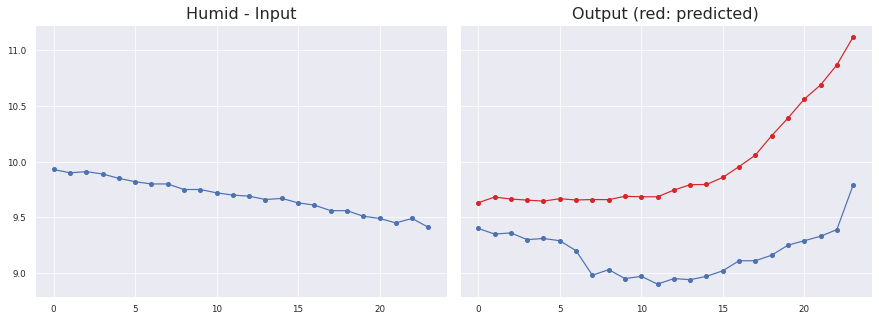

Sensor #31.0
Humid
MAE: 0.7790498631106072 ± 0.35583772177703077
MSE: 0.7335391734521234
RMSE: 0.8564690148815212
Max Error: 1.478811400532722

KL Divergence Sum: 2.0974352989657103 bits
Pinball Loss Temp mean: 1.26245127275517
Pinball Loss Humid mean: 0.2659536623754959
MSE Temp: 2.5249025455103746
MSE Humid: 0.5319073247509939


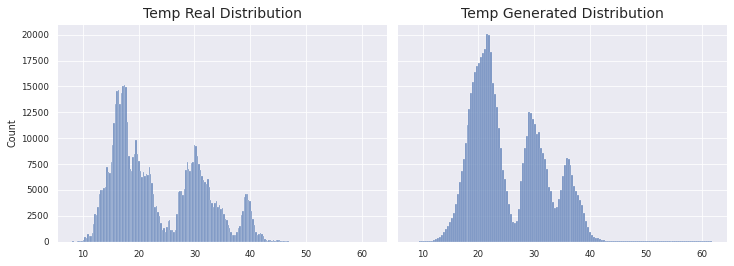

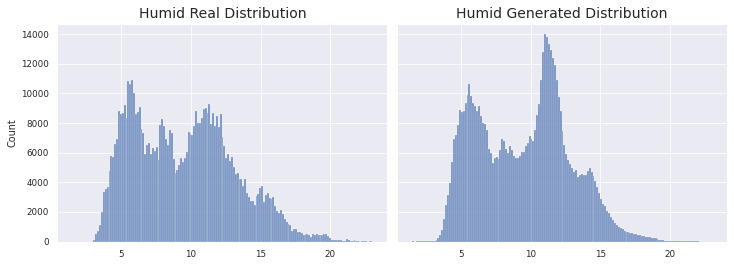

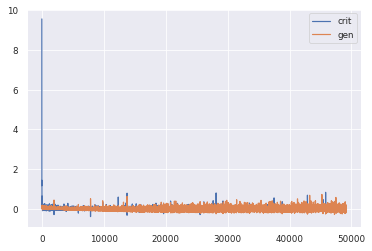

1966/1966 [==============================] - 161s 82ms/step - d_loss: 0.0084 - g_loss: 0.0093
Epoch 26/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0060 - g_loss: 0.0213
KL Divergence Sum: 5.197657428209073 bits
Pinball Loss Temp mean: 1.2573174936884735
Pinball Loss Humid mean: 0.43027456332722325
MSE Temp: 2.51463498737693
MSE Humid: 0.8605491266544518


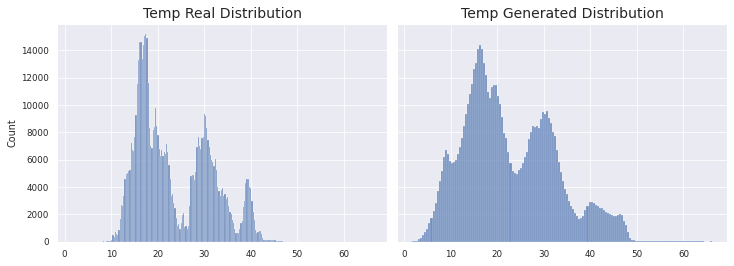

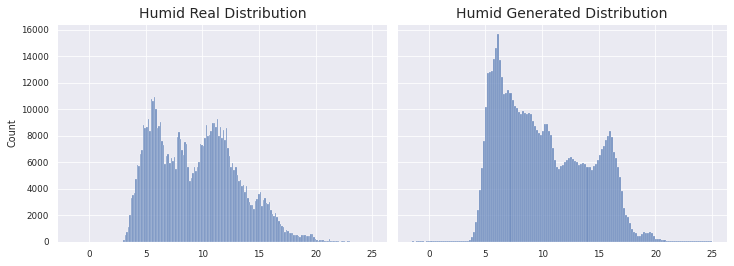

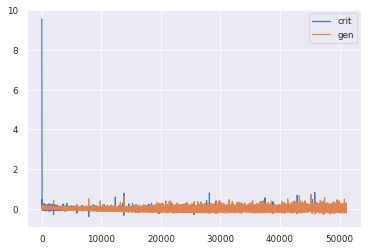

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0059 - g_loss: 0.0215
Epoch 27/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0046 - g_loss: 0.0017
KL Divergence Sum: 4.538140365598406 bits
Pinball Loss Temp mean: 1.2769267524426773
Pinball Loss Humid mean: 0.24465307501316
MSE Temp: 2.553853504885402
MSE Humid: 0.4893061500263262


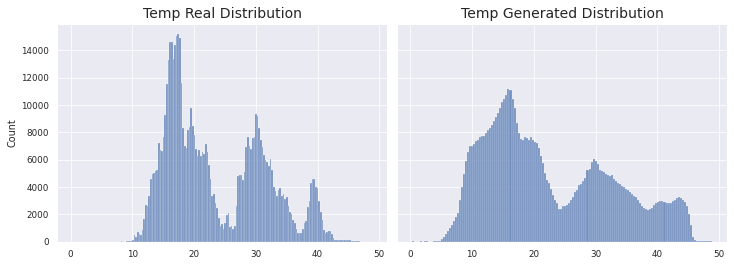

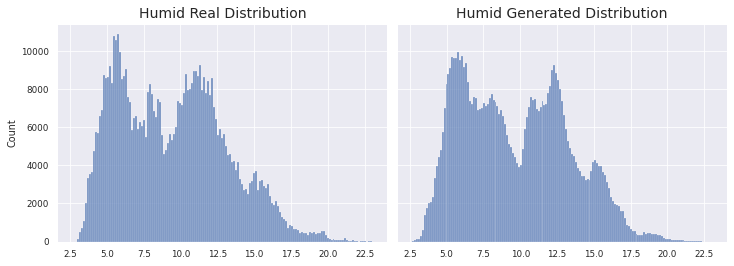

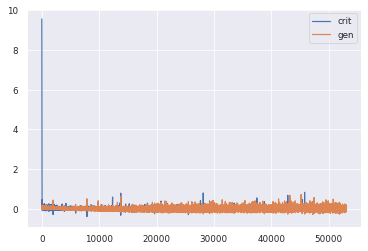

1966/1966 [==============================] - 154s 78ms/step - d_loss: 0.0045 - g_loss: 0.0019
Epoch 28/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0045 - g_loss: -0.0015
KL Divergence Sum: 5.351895083910187 bits
Pinball Loss Temp mean: 1.118994272489327
Pinball Loss Humid mean: 0.3081610643738203
MSE Temp: 2.237988544978657
MSE Humid: 0.616322128747636


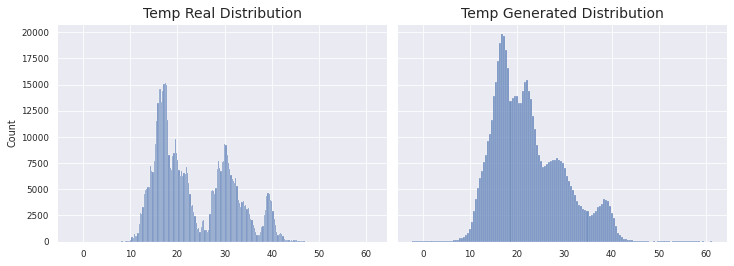

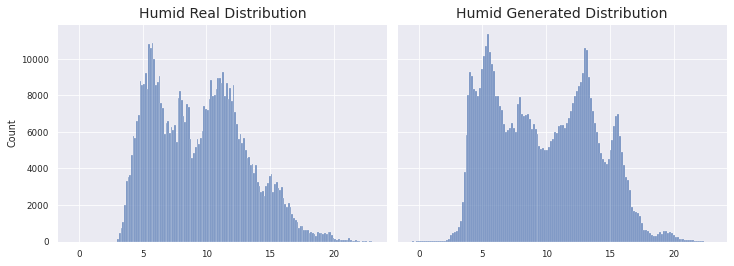

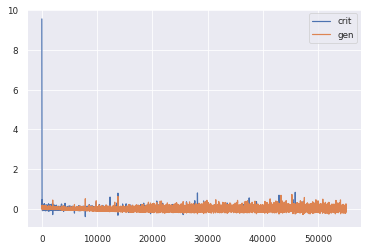

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0044 - g_loss: -0.0013
Epoch 29/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0057 - g_loss: -0.0188
KL Divergence Sum: 2.852444675747323 bits
Pinball Loss Temp mean: 1.2189365581949665
Pinball Loss Humid mean: 0.2897033323584516
MSE Temp: 2.4378731163899166
MSE Humid: 0.5794066647168997


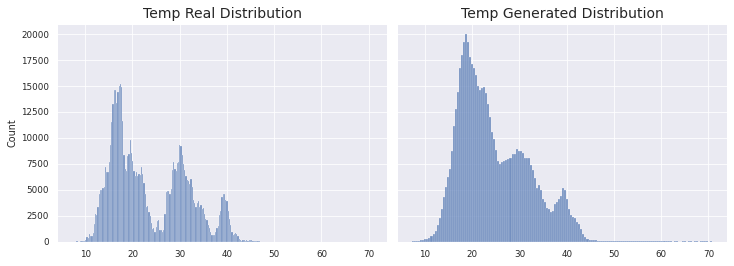

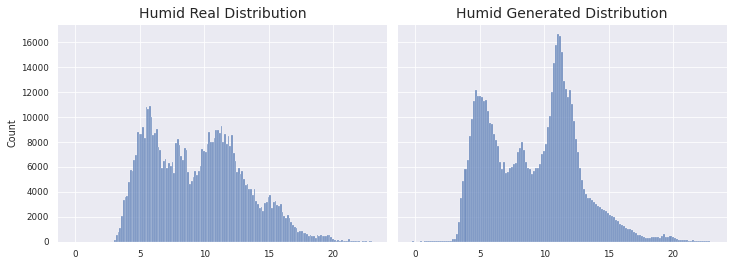

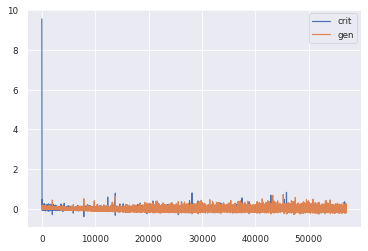

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0057 - g_loss: -0.0186
Epoch 30/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0166 - g_loss: -0.1485
KL Divergence Sum: 3.4466763288661184 bits
Pinball Loss Temp mean: 1.0625467846033678
Pinball Loss Humid mean: 0.6677219953610283
MSE Temp: 2.125093569206696
MSE Humid: 1.3354439907220637


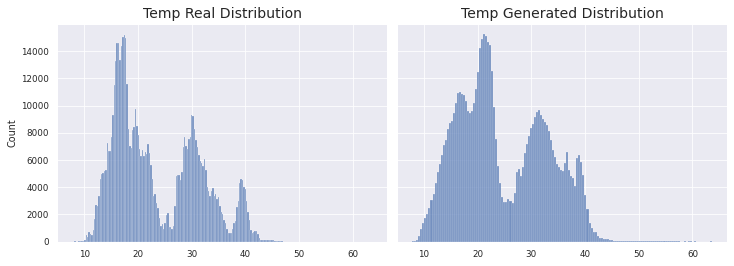

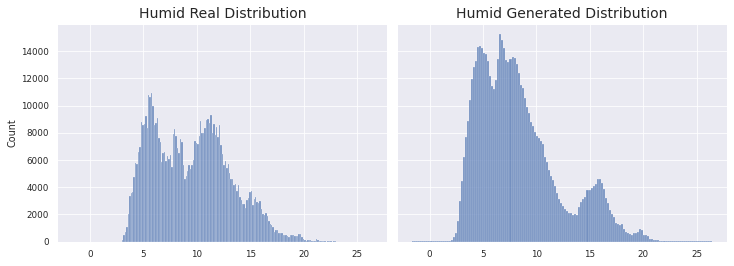

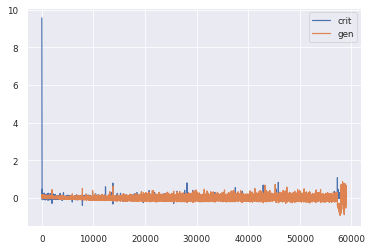

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0166 - g_loss: -0.1476
Epoch 31/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 9.0199e-04 - g_loss: 0.8681Better Pinball
Better MSE
>31 MODELS HAVE BEEN SAVED


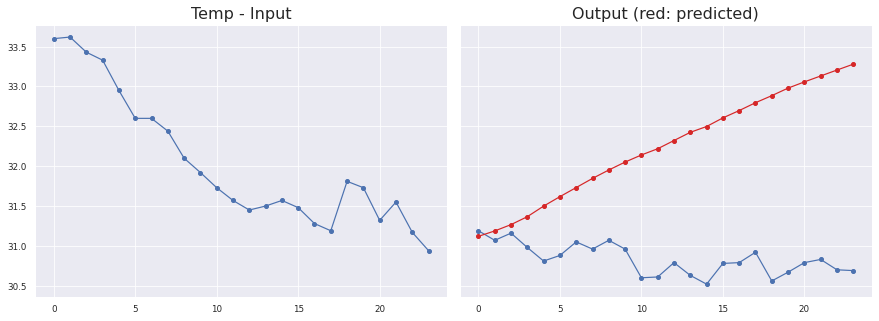

Sensor #15.0
Temp
MAE: 1.417209055398901 ± 0.8090942823570589
MSE: 2.6465950038240433
RMSE: 1.6268358871822453
Max Error: 2.589686167240142


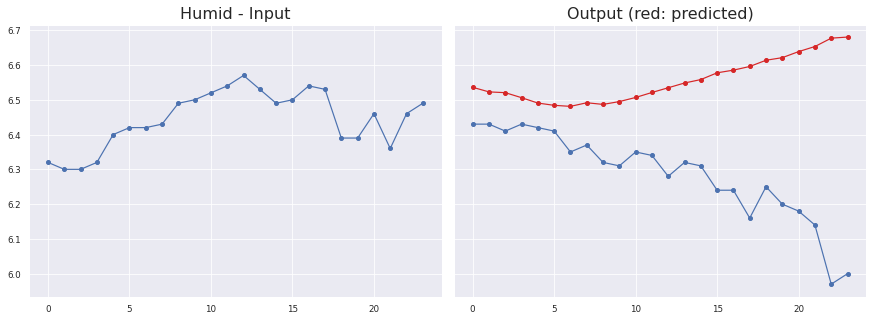

Sensor #15.0
Humid
MAE: 0.26937204675128085 ± 0.1832022698471214
MSE: 0.10612437124811169
RMSE: 0.32576735755460784
Max Error: 0.7071553781628621


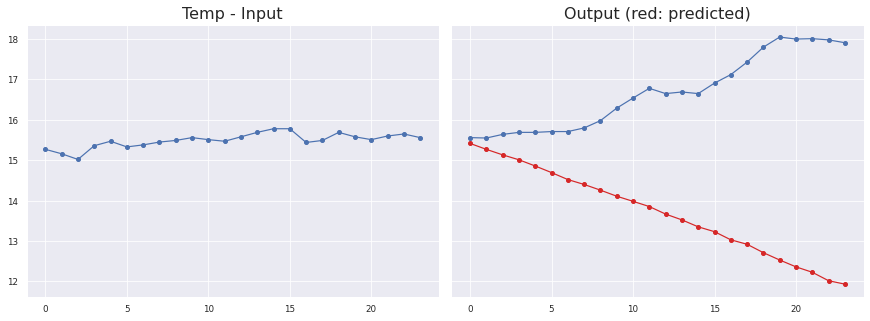

Sensor #27.0
Temp
MAE: 2.9640318728486688 ± 1.949899462755542
MSE: 12.587592858117139
RMSE: 3.547899781295568
Max Error: 5.9780270171165455


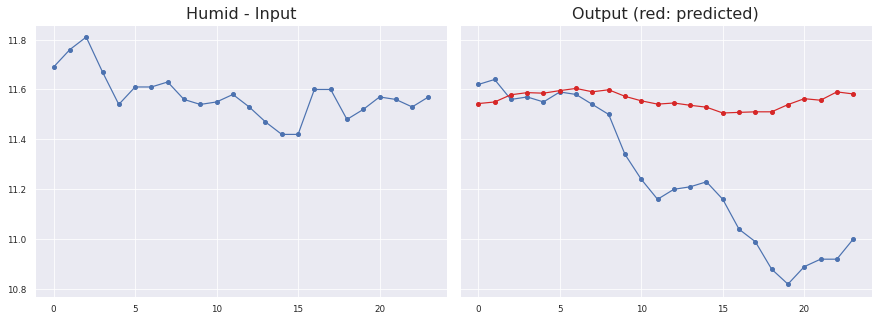

Sensor #27.0
Humid
MAE: 0.31512777099696315 ± 0.2611050454462775
MSE: 0.1589217819092096
RMSE: 0.3986499490896865
Max Error: 0.719348266646266


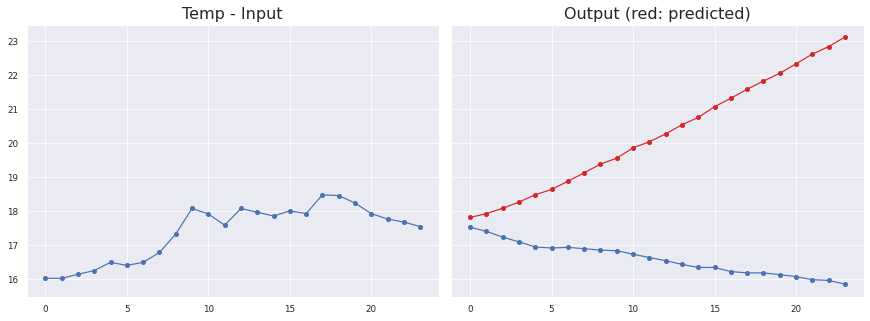

Sensor #27.0
Temp
MAE: 3.663333229074875 ± 2.0977707303770288
MSE: 17.82065238447073
RMSE: 4.22145145470971
Max Error: 7.251327722668652


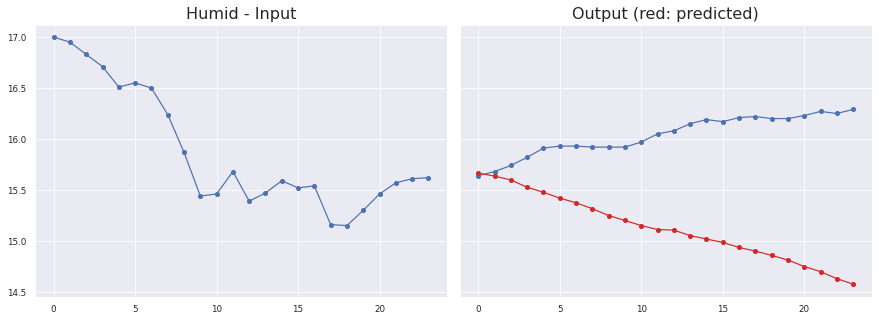

Sensor #27.0
Humid
MAE: 0.9127063734270626 ± 0.5047364162628335
MSE: 1.0841491233074831
RMSE: 1.041224818810752
Max Error: 1.7146233051270237


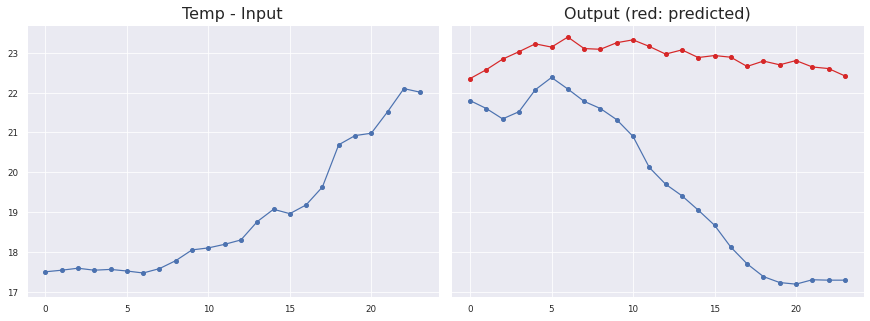

Sensor #17.0
Temp
MAE: 3.1248055593669406 ± 1.7784950021694947
MSE: 12.927454256592412
RMSE: 3.59547691643159
Max Error: 5.614423778653141


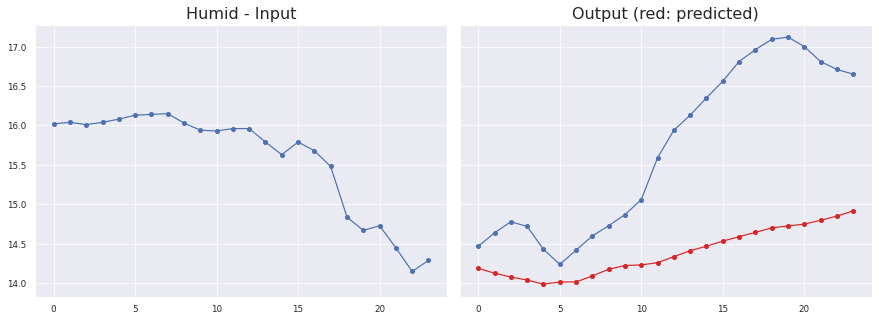

Sensor #17.0
Humid
MAE: 1.3121311127332342 ± 0.7701639088391169
MSE: 2.3148405034809034
RMSE: 1.5214599907591733
Max Error: 2.393144574835894

KL Divergence Sum: 3.2831182012628646 bits
Pinball Loss Temp mean: 0.7864779246167044
Pinball Loss Humid mean: 0.21877761751630515
MSE Temp: 1.572955849233403
MSE Humid: 0.4375552350326076


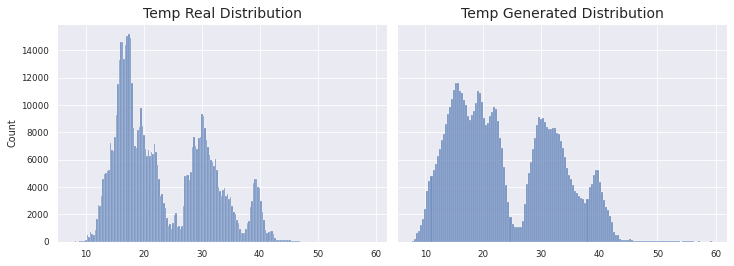

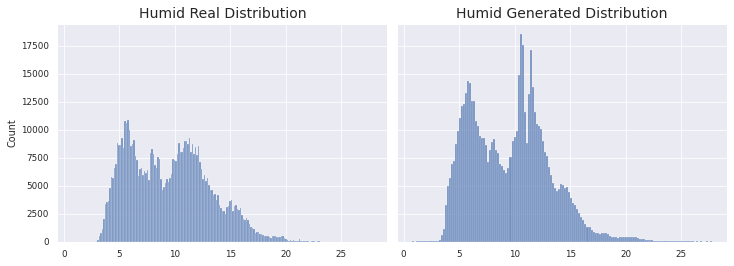

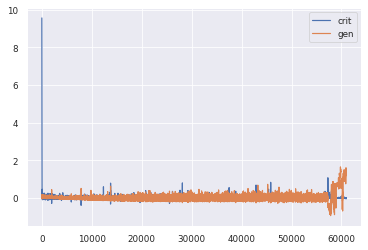

1966/1966 [==============================] - 162s 82ms/step - d_loss: 8.9064e-04 - g_loss: 0.8686
Epoch 32/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 4.7218e-04 - g_loss: 1.9468
KL Divergence Sum: 3.468827571600292 bits
Pinball Loss Temp mean: 1.1287204045889934
Pinball Loss Humid mean: 0.32027376441671496
MSE Temp: 2.2574408091779414
MSE Humid: 0.6405475288334386


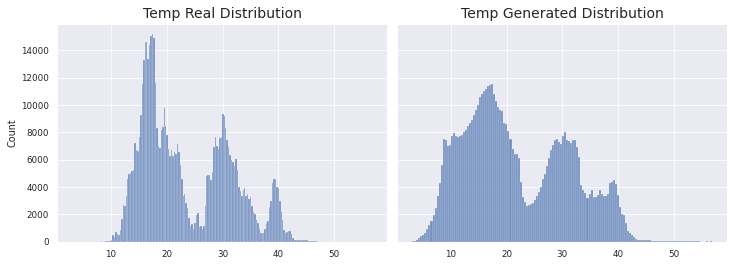

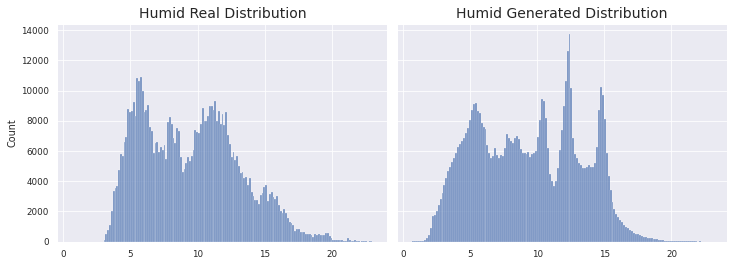

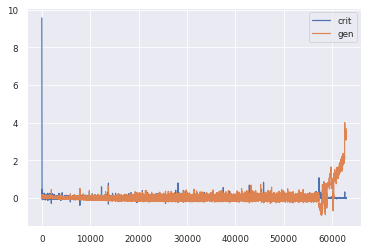

1966/1966 [==============================] - 155s 79ms/step - d_loss: 4.2870e-04 - g_loss: 1.9486
Epoch 33/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.7909e-04 - g_loss: 6.2567
KL Divergence Sum: 7.452136409072119 bits
Pinball Loss Temp mean: 1.4063148368551466
Pinball Loss Humid mean: 0.4368035435267088
MSE Temp: 2.8126296737102865
MSE Humid: 0.8736070870534148


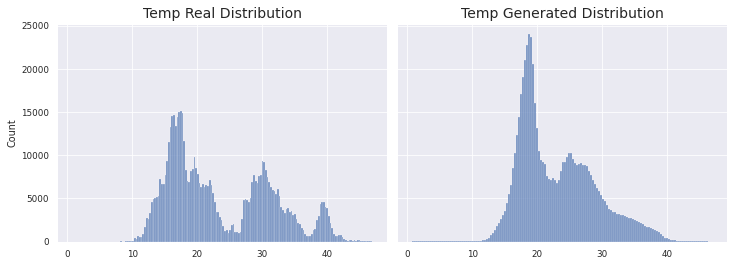

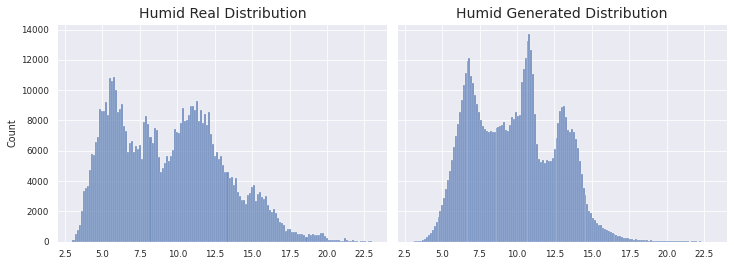

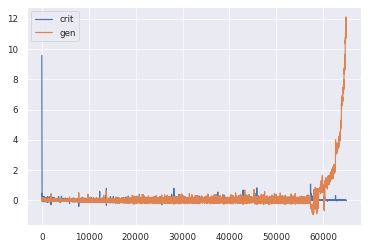

1966/1966 [==============================] - 155s 79ms/step - d_loss: 1.5879e-04 - g_loss: 6.2626
Epoch 34/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.7913e-04 - g_loss: 20.9535
KL Divergence Sum: 4.993572177791438 bits
Pinball Loss Temp mean: 1.065251842866708
Pinball Loss Humid mean: 0.3951004181864388
MSE Temp: 2.1305036857334394
MSE Humid: 0.7902008363728878


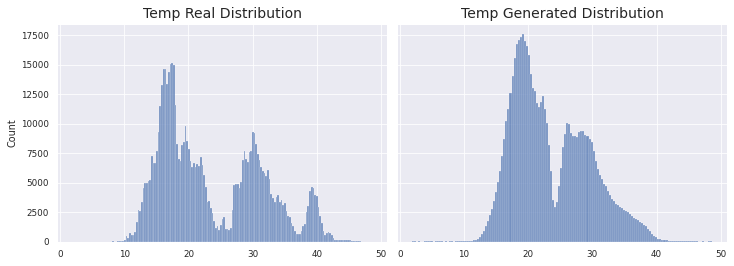

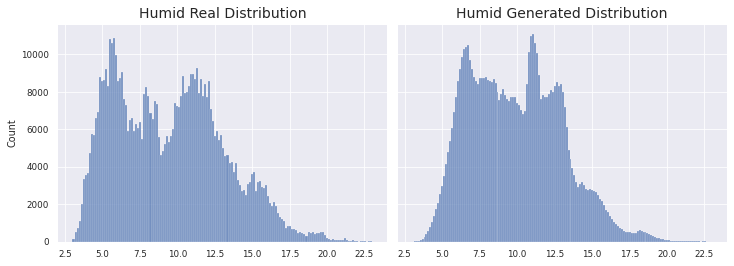

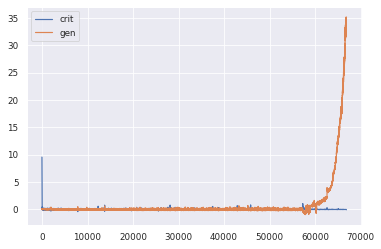

1966/1966 [==============================] - 155s 79ms/step - d_loss: 1.2455e-04 - g_loss: 20.9665
Epoch 35/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 5.2171e-05 - g_loss: 46.2798
KL Divergence Sum: 2.5221647591227234 bits
Pinball Loss Temp mean: 0.9948354584836423
Pinball Loss Humid mean: 0.3468458039895495
MSE Temp: 1.98967091696732
MSE Humid: 0.6936916079790914


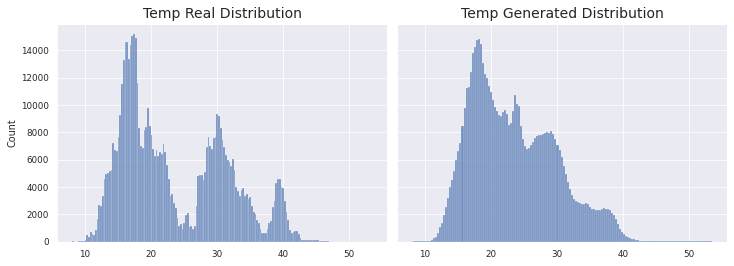

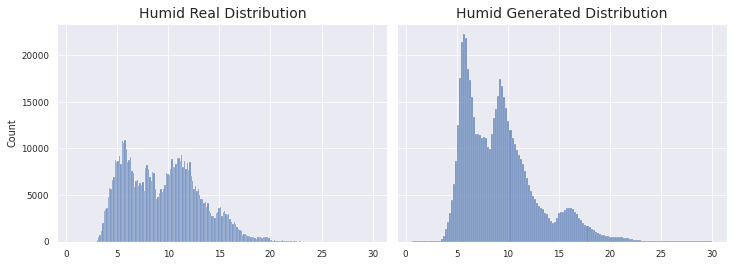

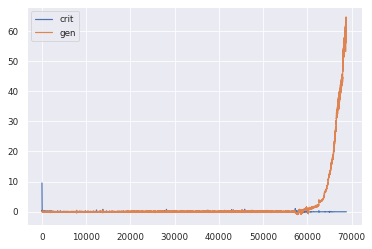

1966/1966 [==============================] - 155s 79ms/step - d_loss: 4.3565e-05 - g_loss: 46.2948
Epoch 36/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -3.2440e-06 - g_loss: 97.5843
KL Divergence Sum: 2.283787084207082 bits
Pinball Loss Temp mean: 1.0546725486325221
Pinball Loss Humid mean: 0.5376683495087068
MSE Temp: 2.109345097265081
MSE Humid: 1.075336699017413


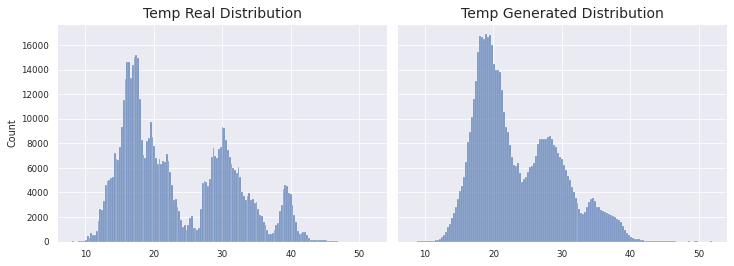

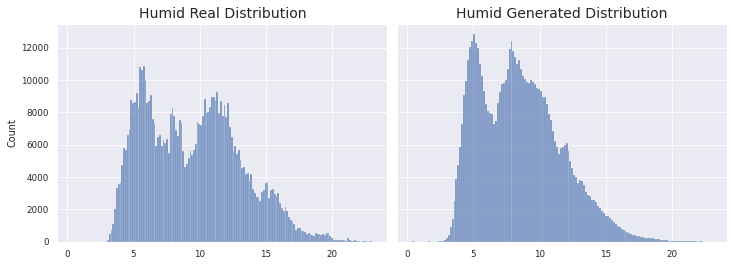

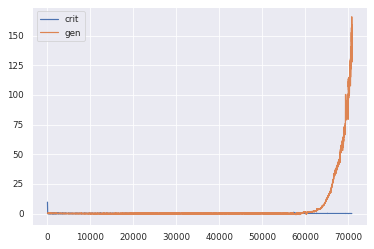

1966/1966 [==============================] - 154s 79ms/step - d_loss: -5.9729e-05 - g_loss: 97.6149
Epoch 37/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -8.5182e-04 - g_loss: 247.9490Better KL
>37 MODELS HAVE BEEN SAVED


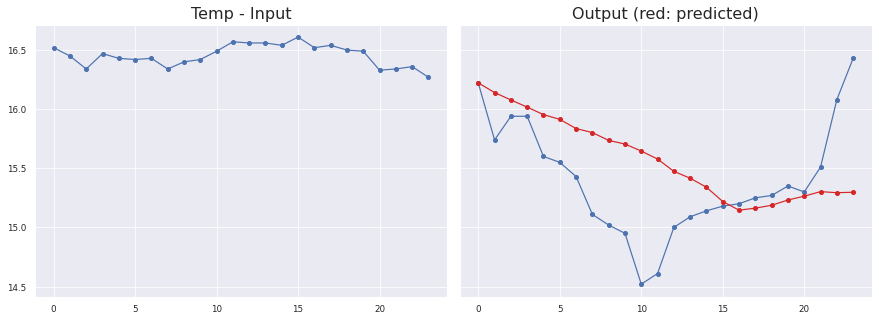

Sensor #34.0
Temp
MAE: 0.3975673564275108 ± 0.4944377547054184
MSE: 0.28013280967640075
RMSE: 0.5292757406838148
Max Error: 1.1325363302230826


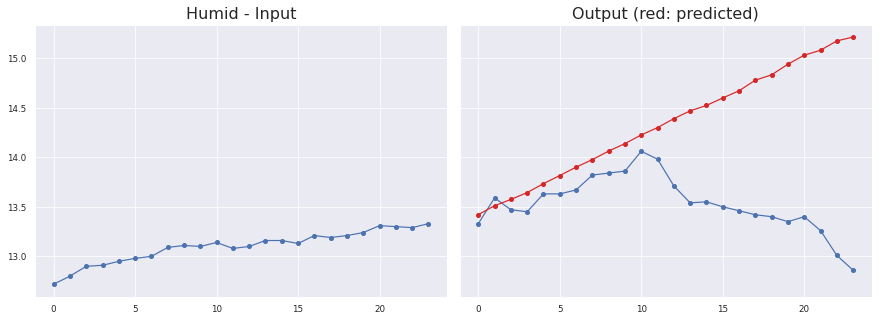

Sensor #34.0
Humid
MAE: 0.8061844605254013 ± 0.7248130272545701
MSE: 1.1646914103816293
RMSE: 1.0792086963982588
Max Error: 2.35159918151796


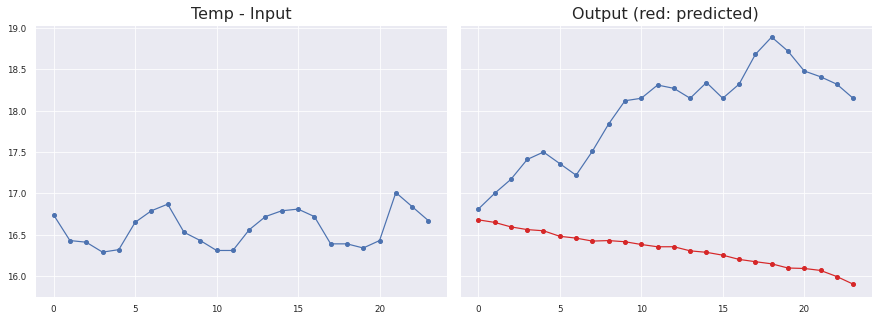

Sensor #10.0
Temp
MAE: 1.642278291583061 ± 0.7474588187640032
MSE: 3.255772672753057
RMSE: 1.8043759787674678
Max Error: 2.7413663625717177


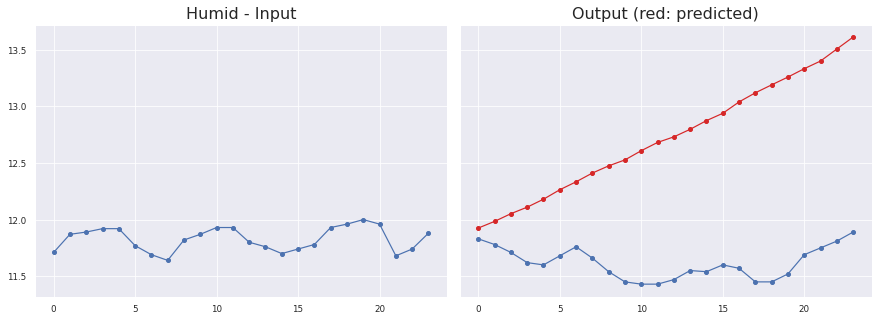

Sensor #10.0
Humid
MAE: 1.107016266956926 ± 0.5214342983591107
MSE: 1.4973787428125063
RMSE: 1.2236742797053906
Max Error: 1.7397055925522018


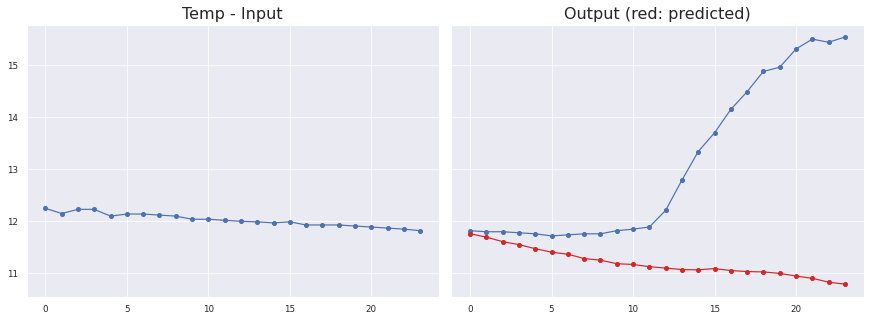

Sensor #1.0
Temp
MAE: 1.874303188920021 ± 1.7090868520664608
MSE: 6.433990311902203
RMSE: 2.5365311572898532
Max Error: 4.74682831764221


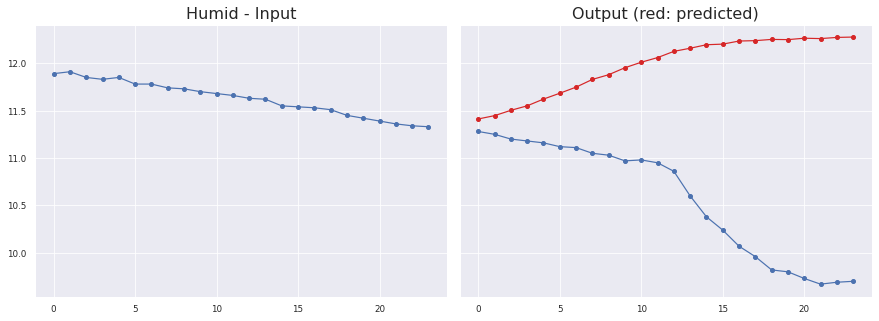

Sensor #1.0
Humid
MAE: 1.4007209224269423 ± 0.8682043850027596
MSE: 2.715797956662604
RMSE: 1.6479678263432826
Max Error: 2.589583340920509


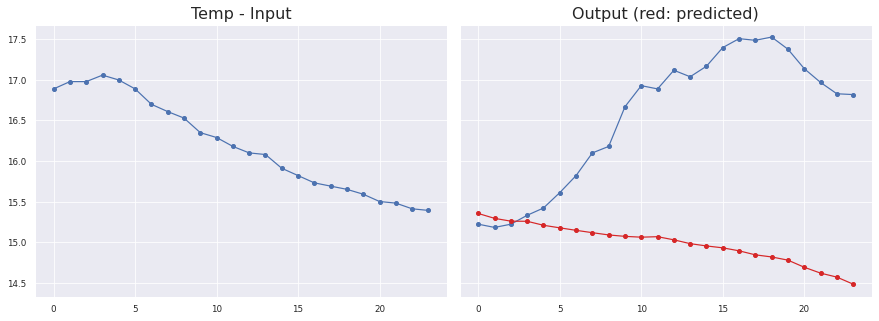

Sensor #1.0
Temp
MAE: 1.578690851132075 ± 1.0010293860562653
MSE: 3.4208696105256013
RMSE: 1.8495593017055716
Max Error: 2.714286580085755


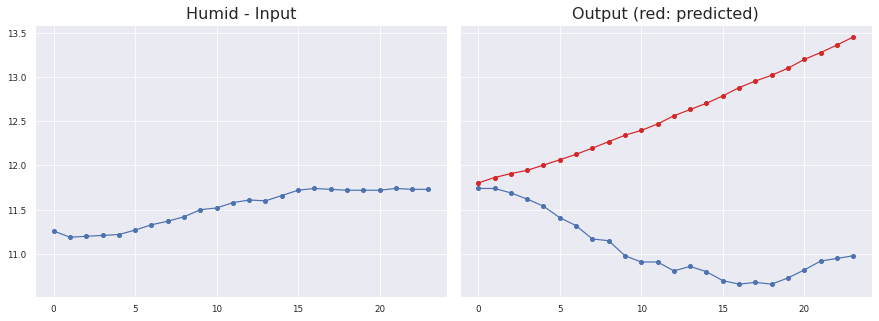

Sensor #1.0
Humid
MAE: 1.4804673354556634 ± 0.8201116017503983
MSE: 2.8643665706767956
RMSE: 1.692443963821785
Max Error: 2.4690747736766934

KL Divergence Sum: 1.7217168489385515 bits
Pinball Loss Temp mean: 0.6564142393958787
Pinball Loss Humid mean: 0.39344872702514466
MSE Temp: 1.3128284787917364
MSE Humid: 0.7868974540502895


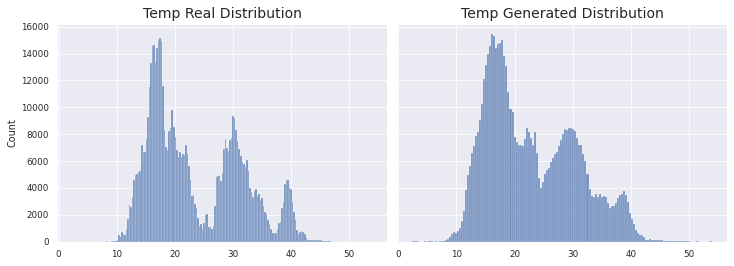

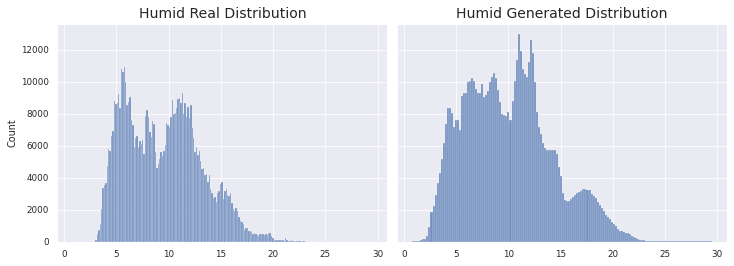

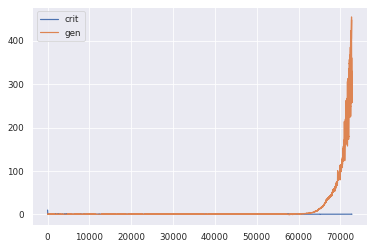

1966/1966 [==============================] - 161s 82ms/step - d_loss: -8.8371e-04 - g_loss: 248.0632
Epoch 38/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -6.6921e-04 - g_loss: 498.9503
KL Divergence Sum: 2.1776355269777454 bits
Pinball Loss Temp mean: 1.998599345020147
Pinball Loss Humid mean: 0.314772147146122
MSE Temp: 3.9971986900403103
MSE Humid: 0.6295442942922364


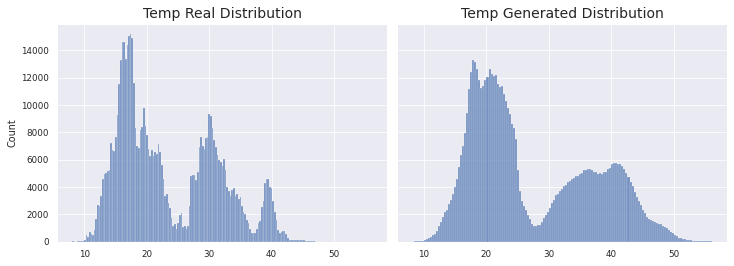

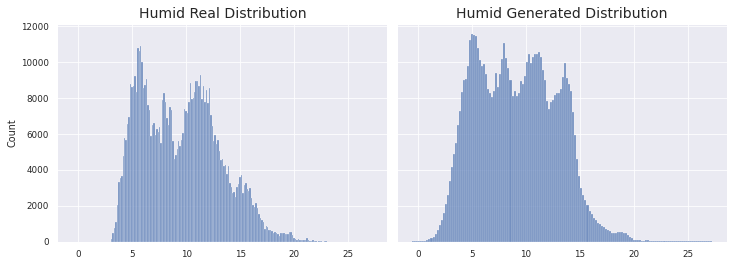

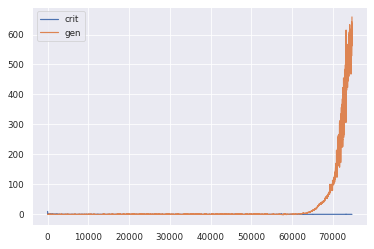

1966/1966 [==============================] - 156s 80ms/step - d_loss: -7.7373e-04 - g_loss: 499.1126
Epoch 39/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0011 - g_loss: 666.2326
KL Divergence Sum: 5.4536047637439475 bits
Pinball Loss Temp mean: 0.7760117471366523
Pinball Loss Humid mean: 0.5428575926910189
MSE Temp: 1.5520234942732847
MSE Humid: 1.0857151853820175


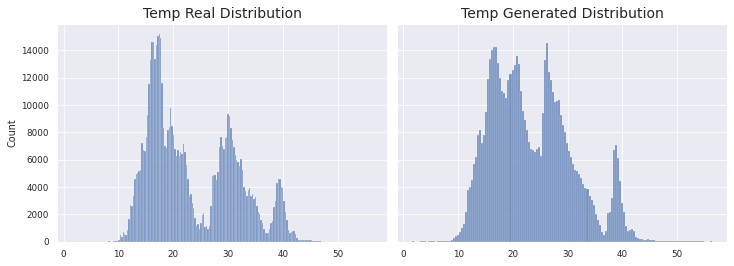

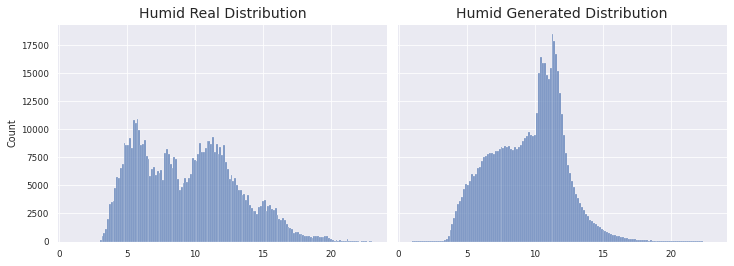

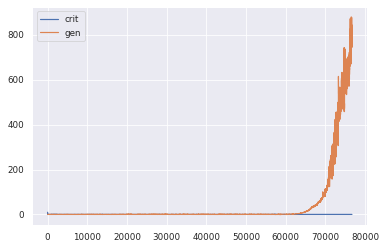

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.0012 - g_loss: 666.3344
Epoch 40/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0024 - g_loss: 822.3041
KL Divergence Sum: 3.117326673512449 bits
Pinball Loss Temp mean: 1.4241284285288056
Pinball Loss Humid mean: 0.4135935177379267
MSE Temp: 2.8482568570575935
MSE Humid: 0.8271870354758454


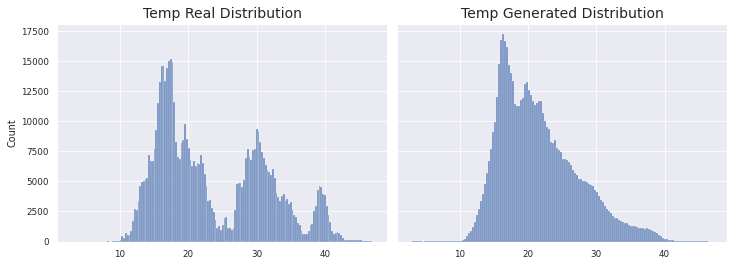

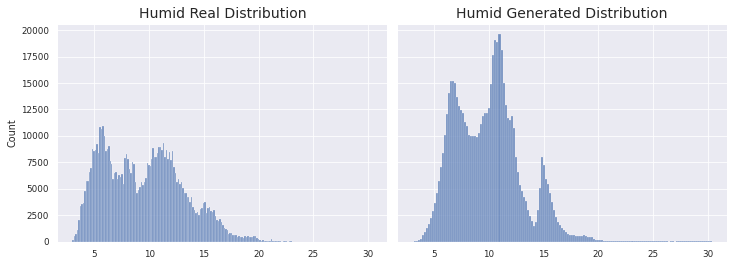

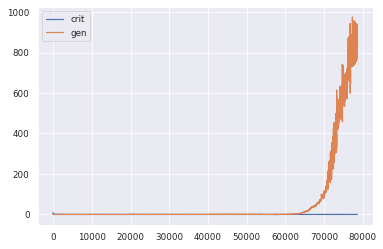

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0024 - g_loss: 822.3532
Epoch 41/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0043 - g_loss: 722.2594
KL Divergence Sum: 3.7082958927285907 bits
Pinball Loss Temp mean: 1.99944040827327
Pinball Loss Humid mean: 0.3848339707128832
MSE Temp: 3.998880816546586
MSE Humid: 0.7696679414257622


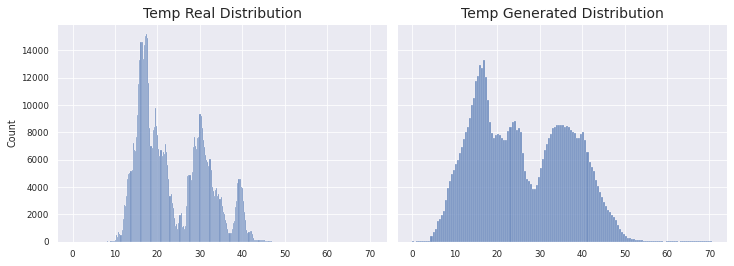

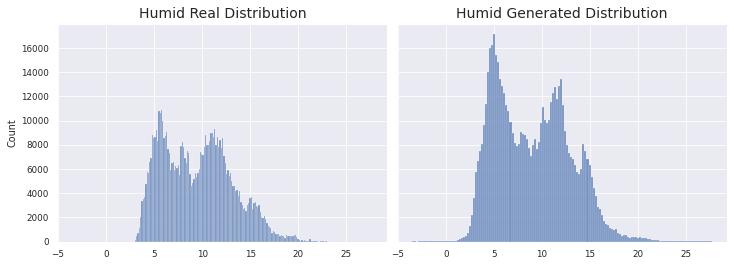

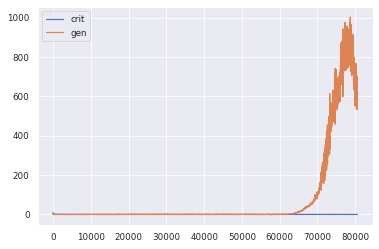

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.0044 - g_loss: 722.1575
Epoch 42/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0025 - g_loss: 600.0900
KL Divergence Sum: 2.3580177553297332 bits
Pinball Loss Temp mean: 0.819664322466066
Pinball Loss Humid mean: 0.3220112071042768
MSE Temp: 1.6393286449321078
MSE Humid: 0.6440224142085571


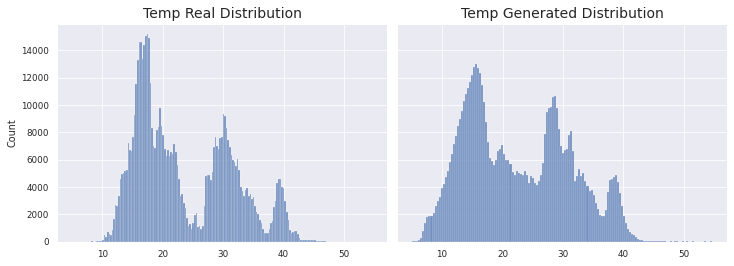

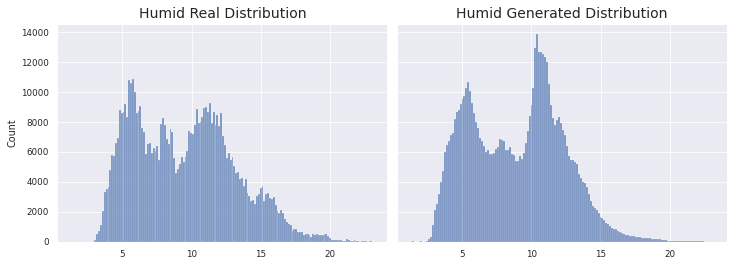

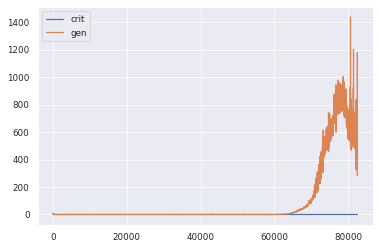

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.0025 - g_loss: 600.1022
Epoch 43/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0123 - g_loss: 609.9360Better KL
>43 MODELS HAVE BEEN SAVED


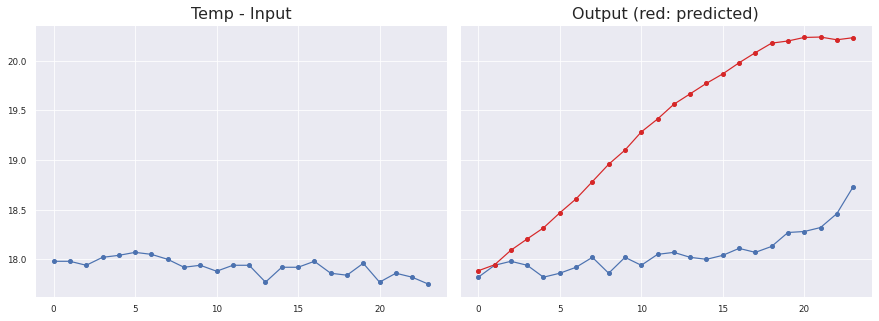

Sensor #18.0
Temp
MAE: 1.2332822023332115 ± 0.6755401588007346
MSE: 1.9773394967443785
RMSE: 1.406179041496629
Max Error: 2.0467598712444293


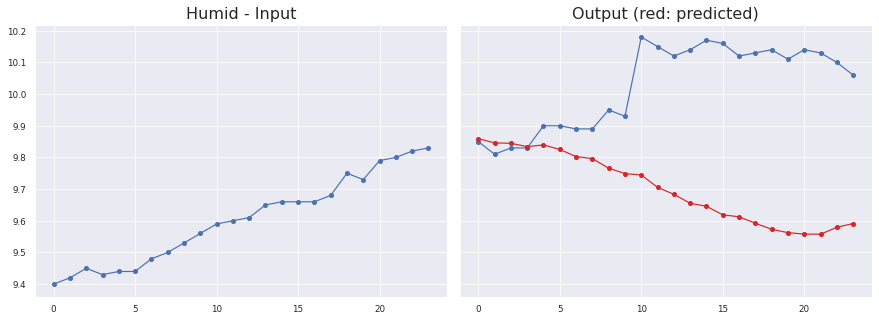

Sensor #18.0
Humid
MAE: 0.32976116205876044 ± 0.23022311027801964
MSE: 0.15825740115646106
RMSE: 0.39781578796782446
Max Error: 0.5819216360151778


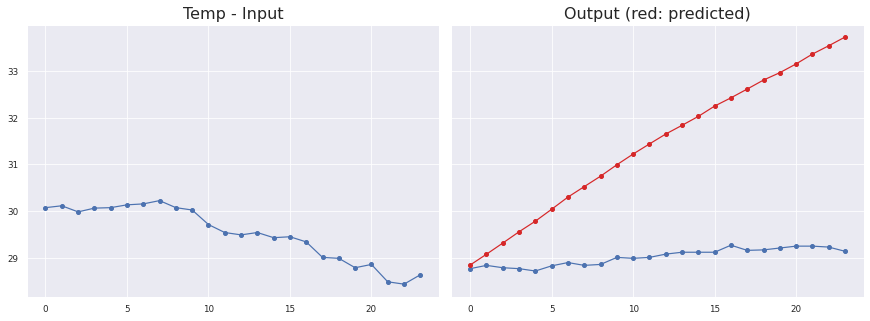

Sensor #23.0
Temp
MAE: 2.3959859402726083 ± 1.2992638173970787
MSE: 7.428835093181246
RMSE: 2.7255889442799783
Max Error: 4.565539362430577


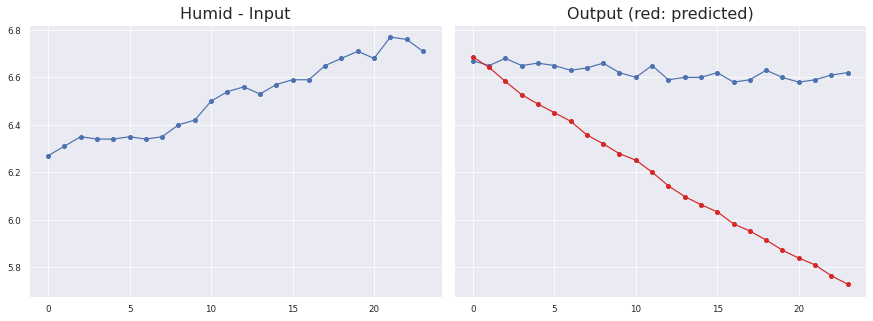

Sensor #23.0
Humid
MAE: 0.44171749501178637 ± 0.264541065378252
MSE: 0.26386049720523325
RMSE: 0.5136735317351219
Max Error: 0.8912881904840466


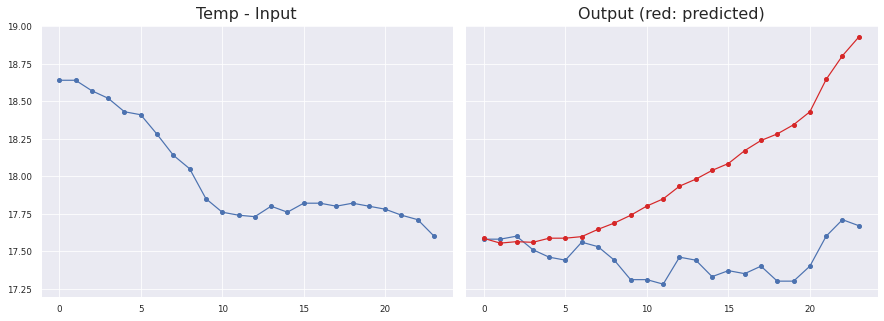

Sensor #31.0
Temp
MAE: 0.5345059670011204 ± 0.4100609761744278
MSE: 0.4482710817518159
RMSE: 0.6695304935190151
Max Error: 1.2582263123989108


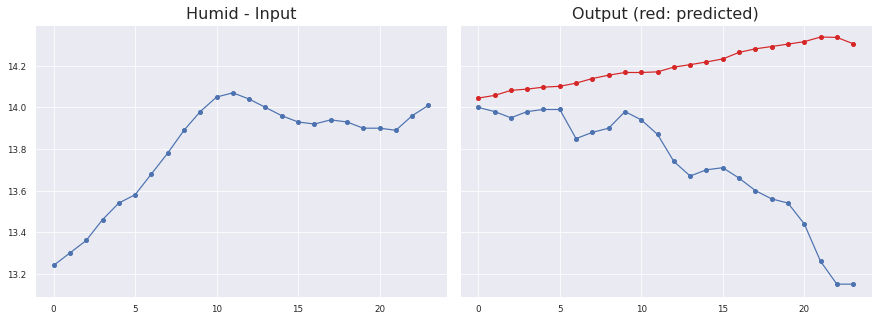

Sensor #31.0
Humid
MAE: 0.4662858452151226 ± 0.3468193167260556
MSE: 0.3377061279023093
RMSE: 0.581124881503373
Max Error: 1.1867165928334007


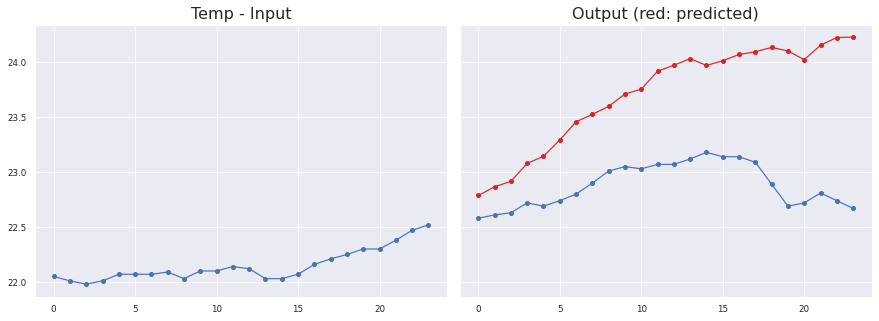

Sensor #3.0
Temp
MAE: 0.8331607083976266 ± 0.38954679733461983
MSE: 0.8459034733312943
RMSE: 0.9197301089620228
Max Error: 1.5596477580070456


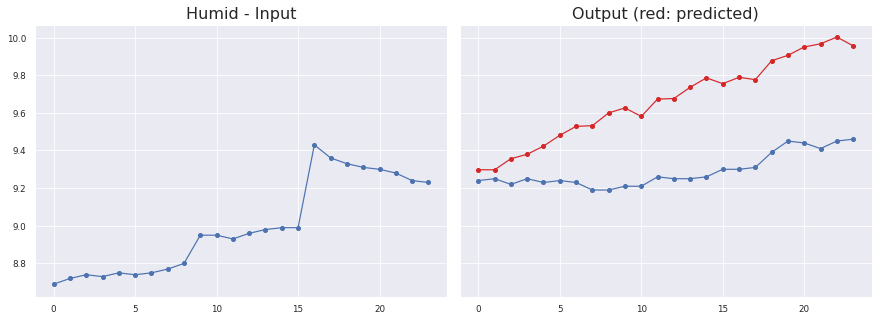

Sensor #3.0
Humid
MAE: 0.3731906408754493 ± 0.15397654282119647
MSE: 0.1629800301761963
RMSE: 0.40370785250747393
Max Error: 0.5564241805672658

KL Divergence Sum: 1.1773002474622687 bits
Pinball Loss Temp mean: 1.1031896540798294
Pinball Loss Humid mean: 0.3888866921933044
MSE Temp: 2.206379308159608
MSE Humid: 0.7777733843866028


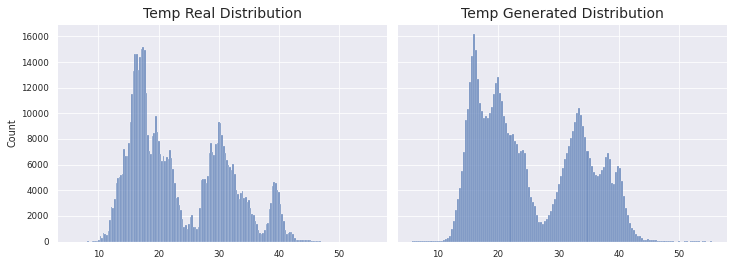

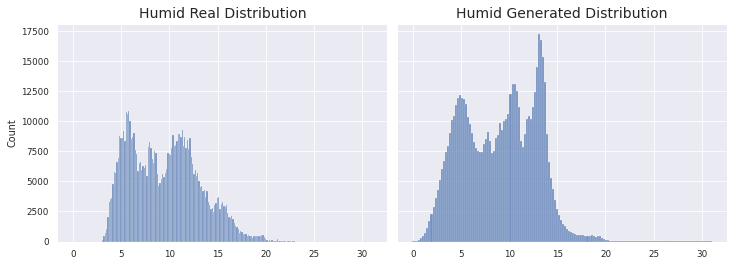

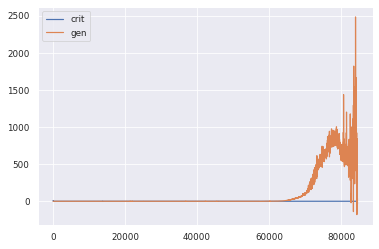

1966/1966 [==============================] - 162s 82ms/step - d_loss: 0.0124 - g_loss: 609.3556
Epoch 44/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0030 - g_loss: 1243.7825
KL Divergence Sum: 3.0988697320622838 bits
Pinball Loss Temp mean: 1.9083006307801225
Pinball Loss Humid mean: 0.6911101947160275
MSE Temp: 3.8166012615602622
MSE Humid: 1.3822203894320386


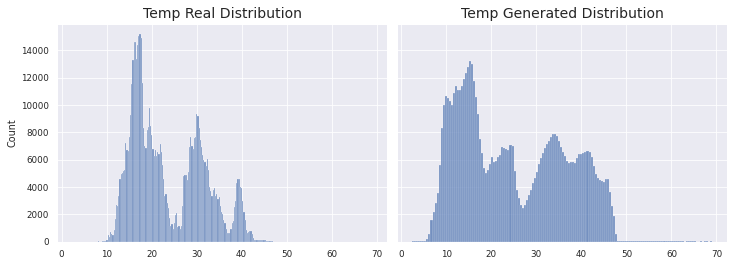

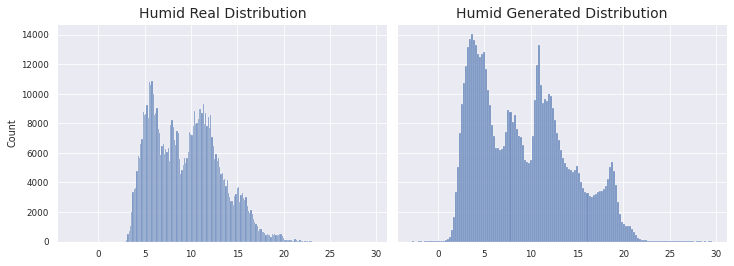

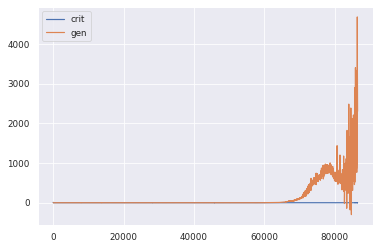

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.0030 - g_loss: 1244.8600
Epoch 45/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0241 - g_loss: 2735.8222
KL Divergence Sum: 3.5067593737484675 bits
Pinball Loss Temp mean: 1.2109617124539607
Pinball Loss Humid mean: 0.4070365720247838
MSE Temp: 2.4219234249079524
MSE Humid: 0.8140731440495707


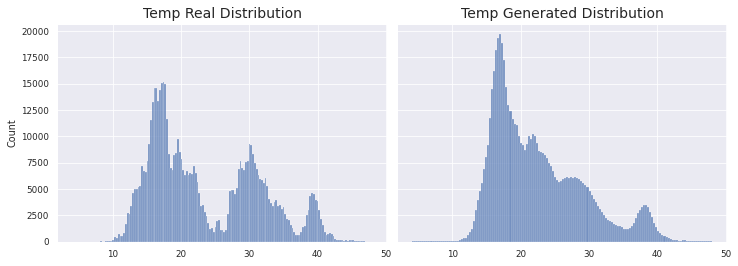

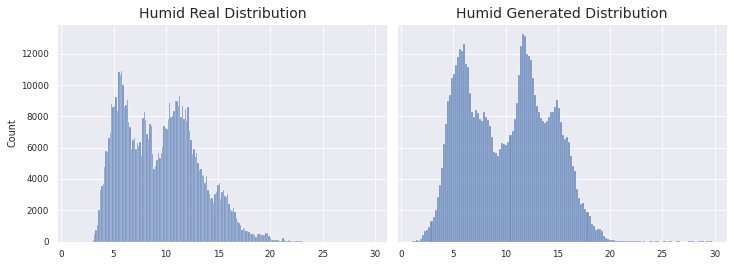

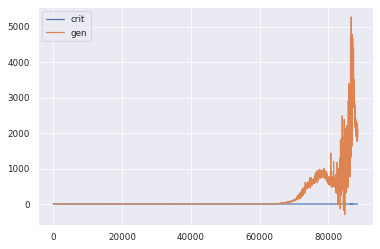

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.0241 - g_loss: 2735.2028
Epoch 46/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0260 - g_loss: 316.1926
KL Divergence Sum: 2.7809070253087653 bits
Pinball Loss Temp mean: 1.1463262408954766
Pinball Loss Humid mean: 0.46873220425075174
MSE Temp: 2.292652481790984
MSE Humid: 0.9374644085014929


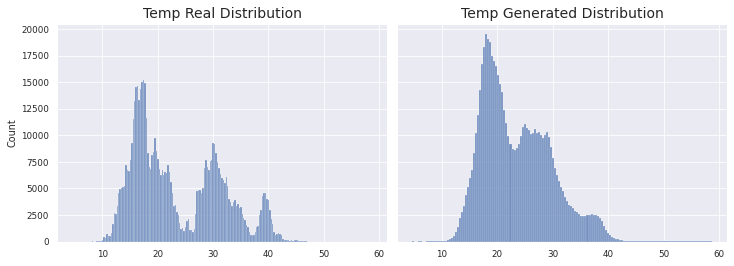

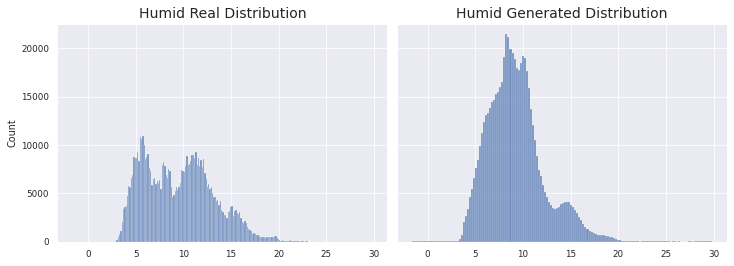

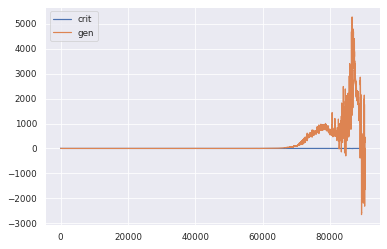

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0259 - g_loss: 316.1109
Epoch 47/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0676 - g_loss: 2539.4941
KL Divergence Sum: 2.426641232447816 bits
Pinball Loss Temp mean: 0.9437366765412
Pinball Loss Humid mean: 0.5096377303083554
MSE Temp: 1.887473353082344
MSE Humid: 1.0192754606167067


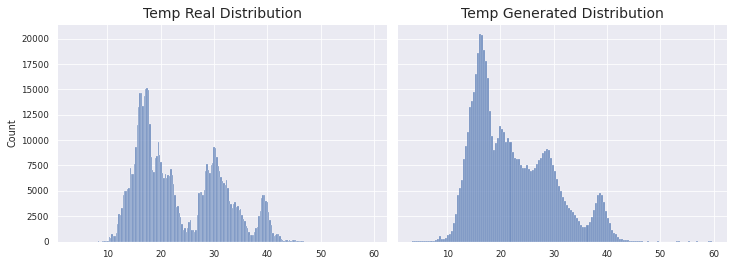

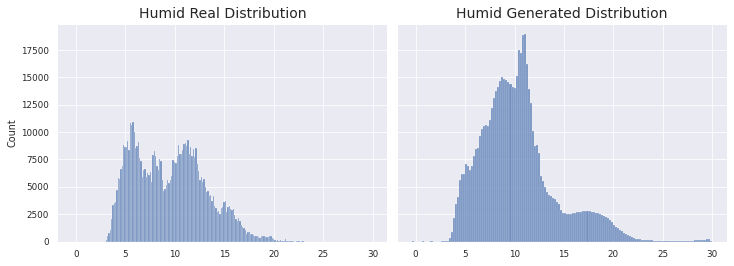

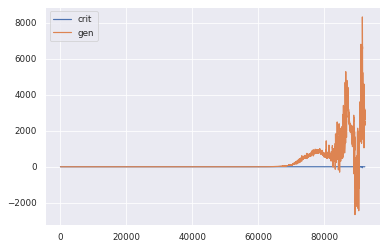

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.0676 - g_loss: 2539.4495
Epoch 48/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0126 - g_loss: 1475.0772
KL Divergence Sum: 1.4277053836442206 bits
Pinball Loss Temp mean: 0.7885224866965683
Pinball Loss Humid mean: 0.44151631106681644
MSE Temp: 1.5770449733931406
MSE Humid: 0.8830326221336354


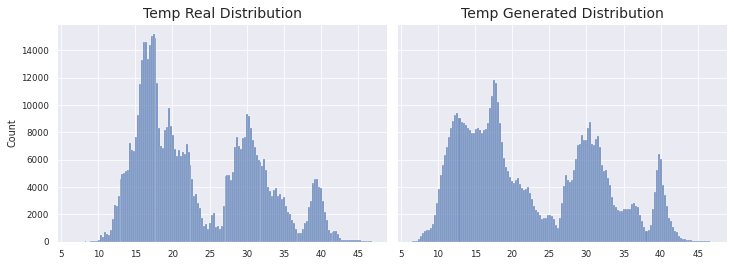

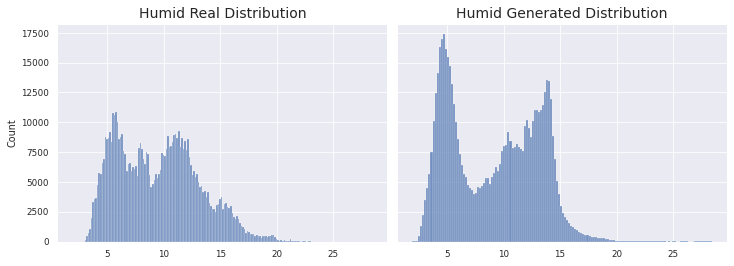

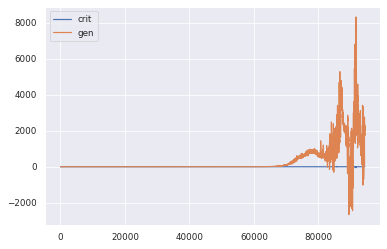

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0126 - g_loss: 1475.7722
Epoch 49/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0057 - g_loss: 1632.1934
KL Divergence Sum: 1.799233840301658 bits
Pinball Loss Temp mean: 1.0608768438198675
Pinball Loss Humid mean: 0.6138366710183619
MSE Temp: 2.1217536876397496
MSE Humid: 1.2276733420367338


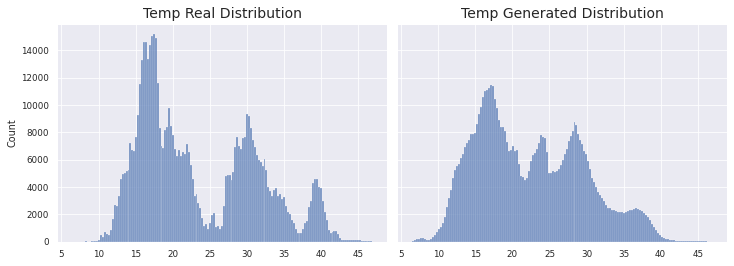

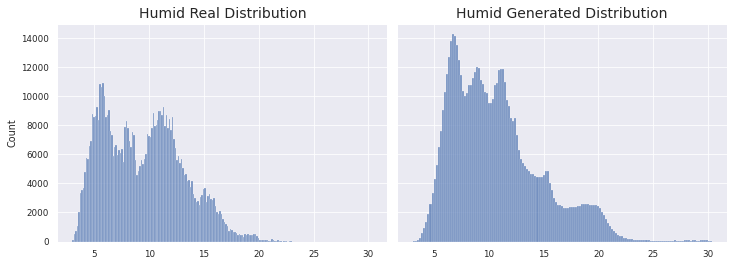

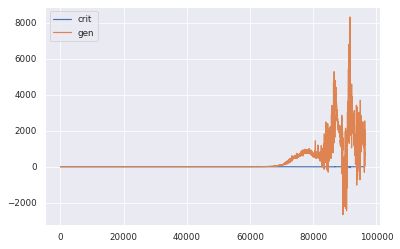

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0057 - g_loss: 1631.7821
Epoch 50/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0035 - g_loss: 1804.3642
KL Divergence Sum: 1.8755571244562625 bits
Pinball Loss Temp mean: 1.0011995837629395
Pinball Loss Humid mean: 0.6835923121680945
MSE Temp: 2.0023991675258768
MSE Humid: 1.367184624336181


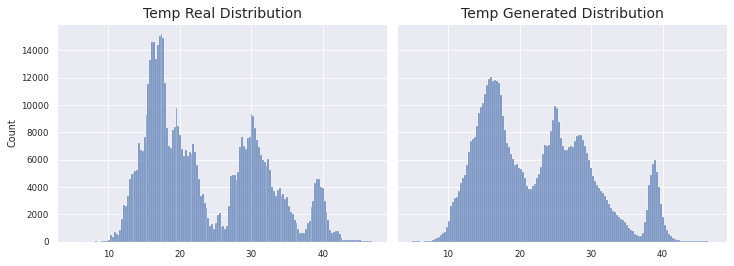

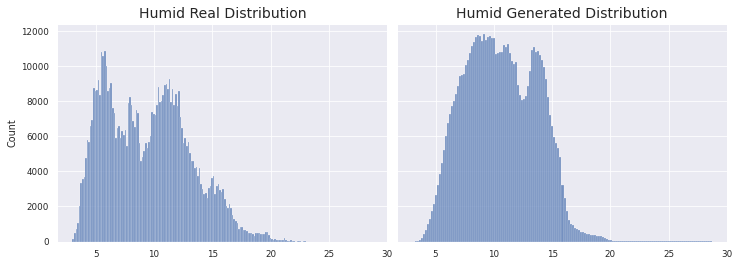

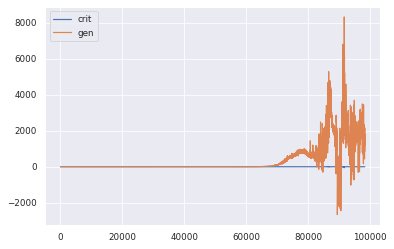

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0034 - g_loss: 1804.1316
Epoch 51/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 7.1998e-04 - g_loss: 2259.1030
KL Divergence Sum: 1.8994289880370925 bits
Pinball Loss Temp mean: 0.9286143215609212
Pinball Loss Humid mean: 0.3474045289487572
MSE Temp: 1.8572286431218423
MSE Humid: 0.6948090578975007


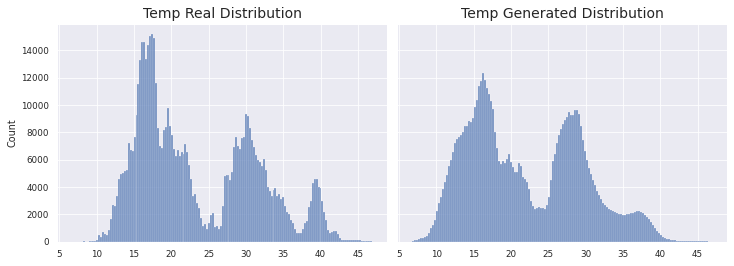

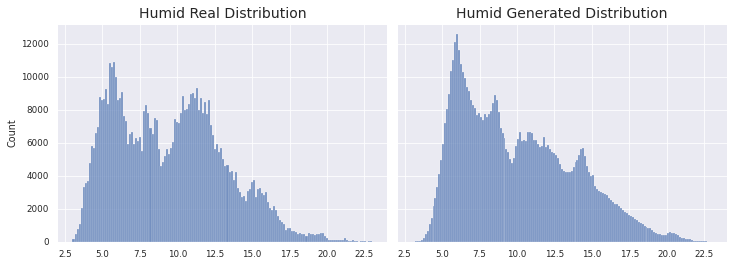

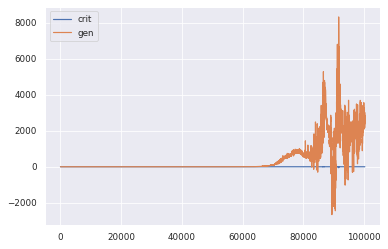

1966/1966 [==============================] - 155s 79ms/step - d_loss: 7.0025e-04 - g_loss: 2259.2753
Epoch 52/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0110 - g_loss: 518.5781
KL Divergence Sum: 3.335014470230658 bits
Pinball Loss Temp mean: 1.0631899552176263
Pinball Loss Humid mean: 0.46643443712714366
MSE Temp: 2.126379910435257
MSE Humid: 0.9328688742542859


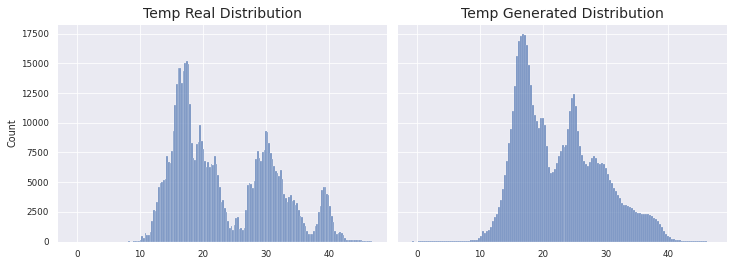

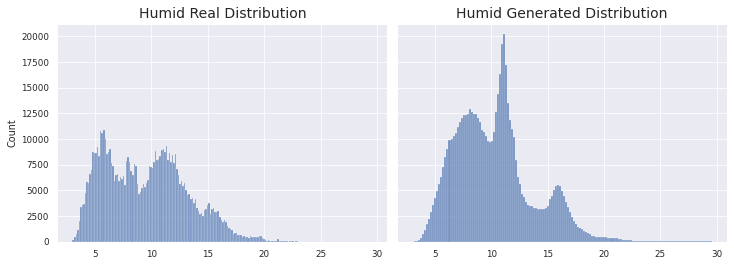

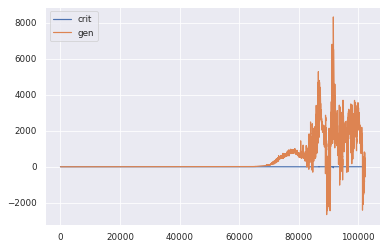

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0110 - g_loss: 517.6920
Epoch 53/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0066 - g_loss: 2235.4462
KL Divergence Sum: 2.0037729092451726 bits
Pinball Loss Temp mean: 3.275954696634898
Pinball Loss Humid mean: 0.6904603760472171
MSE Temp: 6.551909393269789
MSE Humid: 1.380920752094458


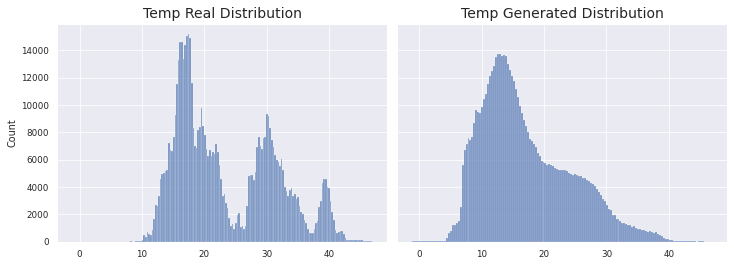

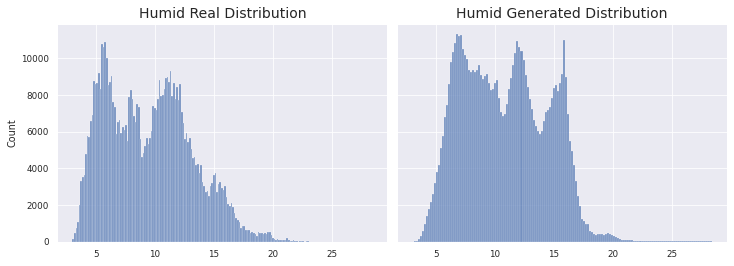

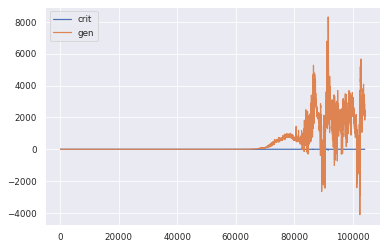

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0066 - g_loss: 2235.3729
Epoch 54/500
1966/1966 [==============================] - ETA: 0s - d_loss: 5.1765e-04 - g_loss: 2340.9536
KL Divergence Sum: 4.70576629980075 bits
Pinball Loss Temp mean: 0.8302559578493064
Pinball Loss Humid mean: 0.6936759722128417
MSE Temp: 1.6605119156986048
MSE Humid: 1.387351944425682


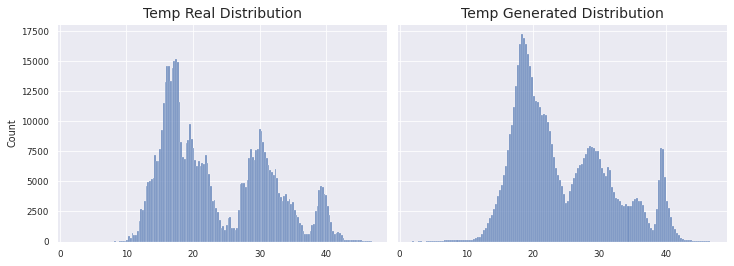

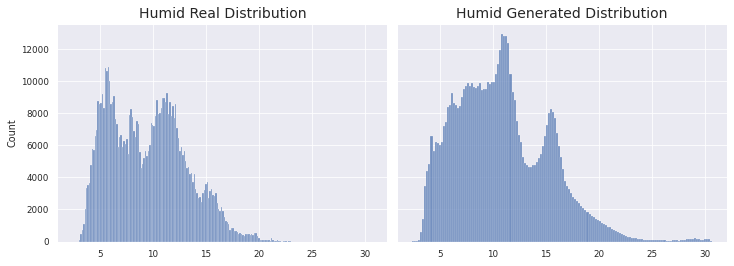

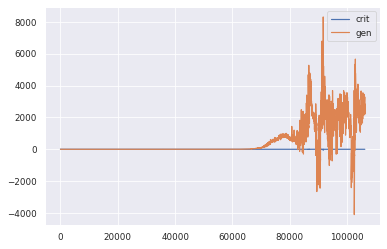

1966/1966 [==============================] - 158s 81ms/step - d_loss: 4.8104e-04 - g_loss: 2341.0903
Epoch 55/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 3.9369e-04 - g_loss: 2683.8439
KL Divergence Sum: 3.482394532472337 bits
Pinball Loss Temp mean: 1.7251656444011179
Pinball Loss Humid mean: 0.40396213181761126
MSE Temp: 3.4503312888022295
MSE Humid: 0.8079242636352318


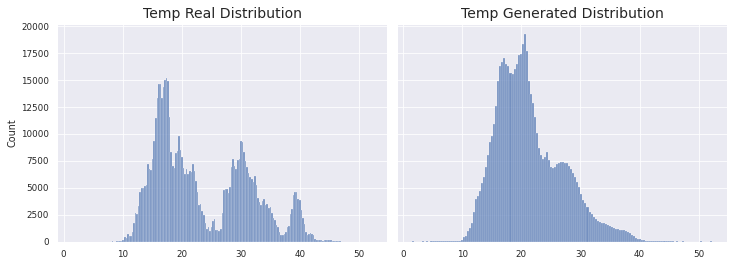

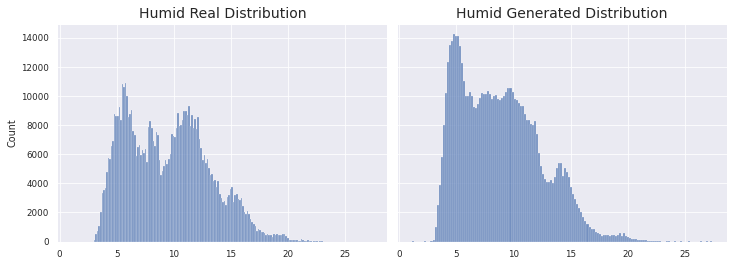

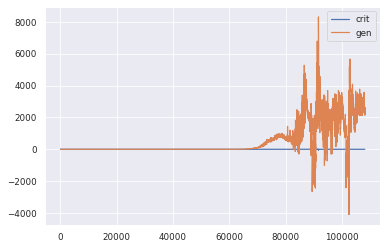

1966/1966 [==============================] - 157s 80ms/step - d_loss: 3.3492e-04 - g_loss: 2683.4649
Epoch 56/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 9.2049e-04 - g_loss: 2259.8672
KL Divergence Sum: 5.505479774920204 bits
Pinball Loss Temp mean: 2.3399784762453684
Pinball Loss Humid mean: 0.47142389043525545
MSE Temp: 4.679956952490794
MSE Humid: 0.9428477808705132


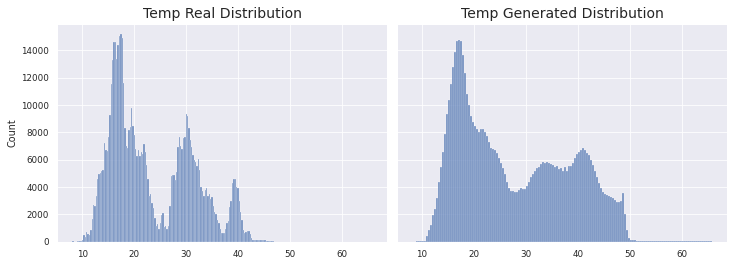

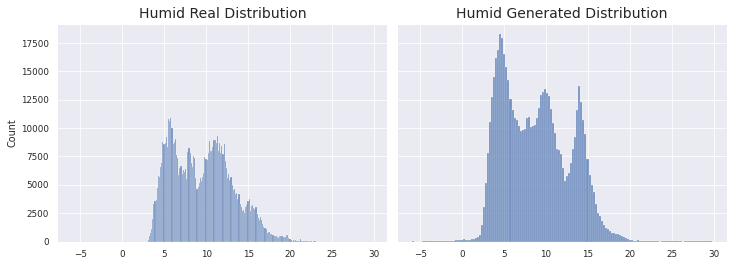

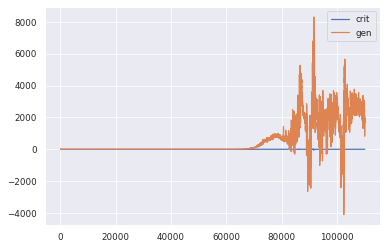

1966/1966 [==============================] - 157s 80ms/step - d_loss: 8.8333e-04 - g_loss: 2259.5215
Epoch 57/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0021 - g_loss: 2437.0031
KL Divergence Sum: 4.267205505491087 bits
Pinball Loss Temp mean: 1.5915155204228486
Pinball Loss Humid mean: 0.3264110422635416
MSE Temp: 3.183031040845727
MSE Humid: 0.6528220845270795


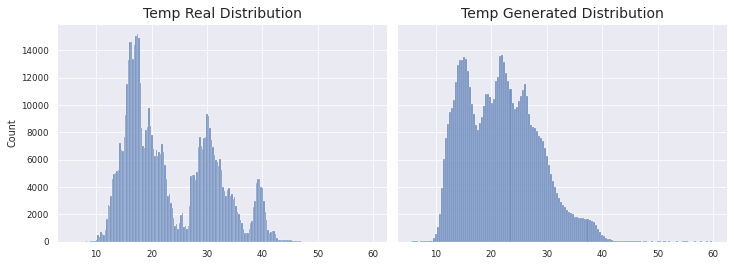

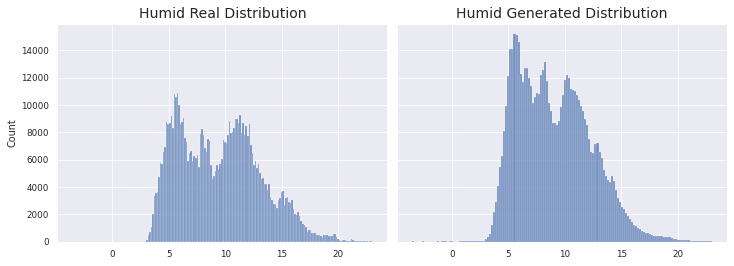

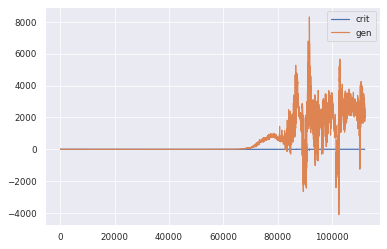

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.0021 - g_loss: 2436.9779
Epoch 58/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0031 - g_loss: 2502.8935
KL Divergence Sum: 2.4272072504331015 bits
Pinball Loss Temp mean: 1.3949206165992722
Pinball Loss Humid mean: 0.6099739479236339
MSE Temp: 2.7898412331985614
MSE Humid: 1.2199478958472518


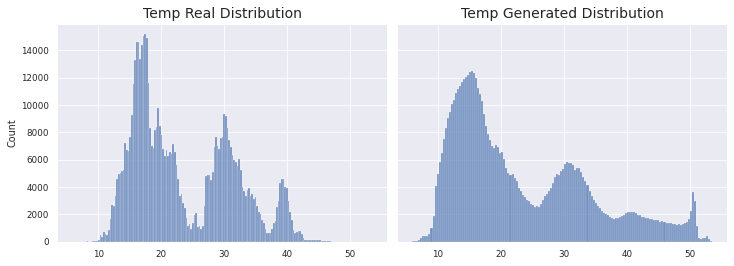

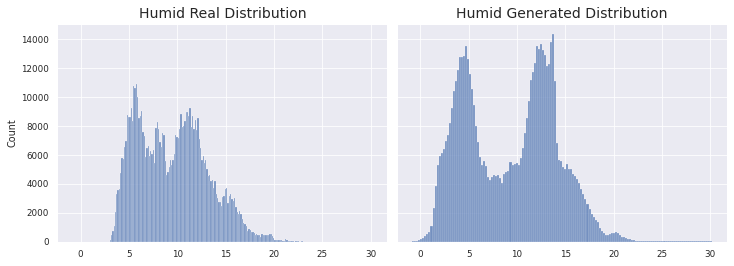

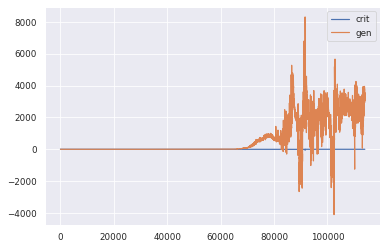

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0031 - g_loss: 2503.9499
Epoch 59/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0089 - g_loss: 6413.4442
KL Divergence Sum: 5.862603690384381 bits
Pinball Loss Temp mean: 1.5856136036107291
Pinball Loss Humid mean: 0.41799558755923083
MSE Temp: 3.171227207221499
MSE Humid: 0.8359911751184645


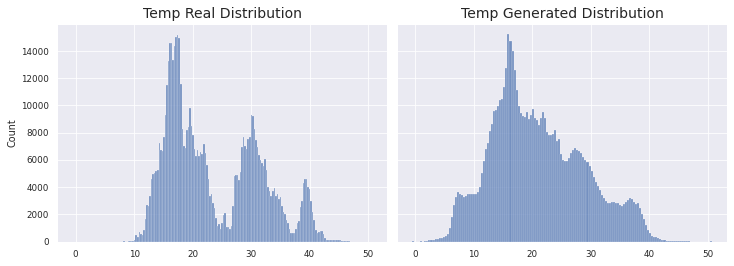

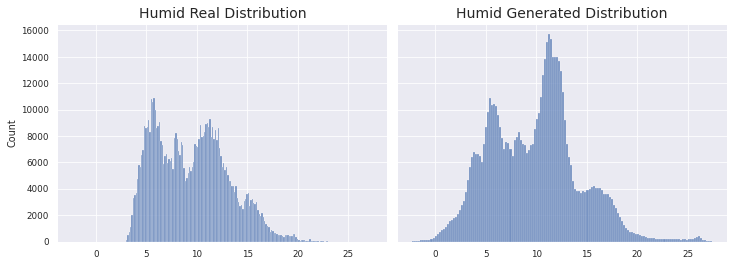

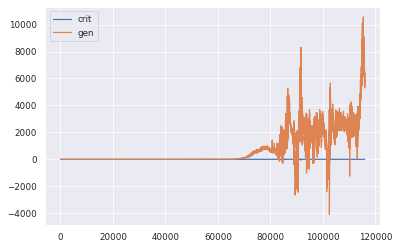

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.0090 - g_loss: 6412.6862
Epoch 60/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0037 - g_loss: 4018.3189
KL Divergence Sum: 5.804122019437635 bits
Pinball Loss Temp mean: 2.7625198813520497
Pinball Loss Humid mean: 0.5084852400517651
MSE Temp: 5.525039762704044
MSE Humid: 1.0169704801035244


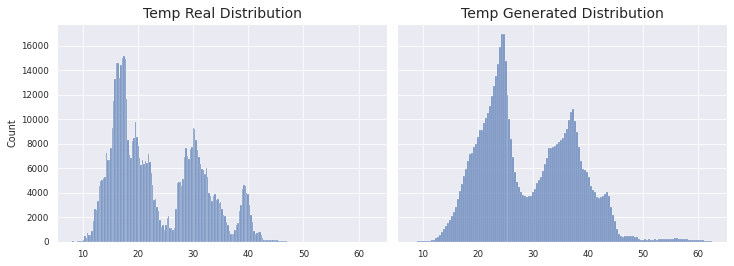

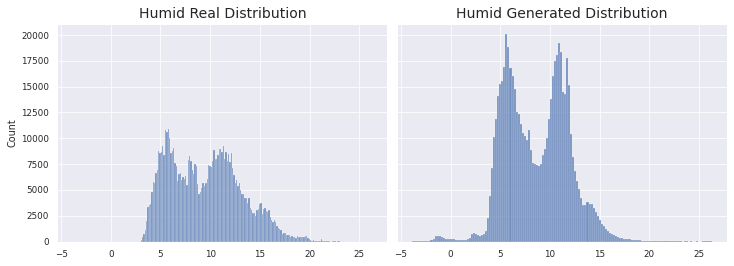

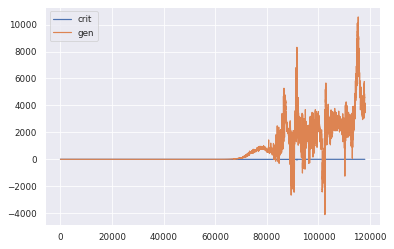

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.0037 - g_loss: 4018.0506
Epoch 61/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0014 - g_loss: 3123.6729
KL Divergence Sum: 7.8007964222851935 bits
Pinball Loss Temp mean: 1.3697095994875657
Pinball Loss Humid mean: 0.40195711529453354
MSE Temp: 2.7394191989751087
MSE Humid: 0.8039142305890793


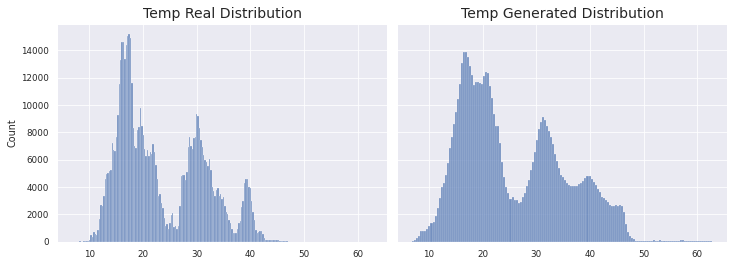

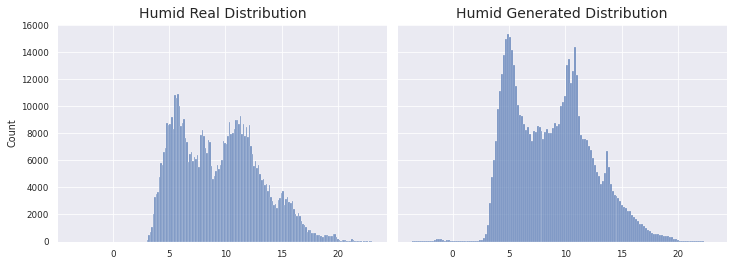

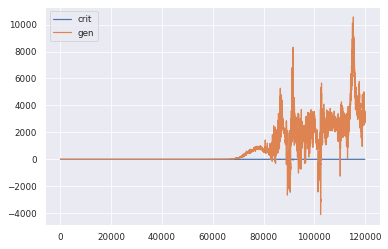

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0014 - g_loss: 3123.6749
Epoch 62/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0022 - g_loss: 3775.3765
KL Divergence Sum: 3.218052646413581 bits
Pinball Loss Temp mean: 0.8181804725205662
Pinball Loss Humid mean: 0.32025163158729403
MSE Temp: 1.6363609450411232
MSE Humid: 0.6405032631745939


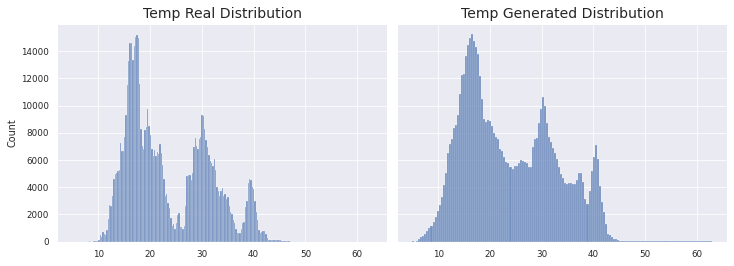

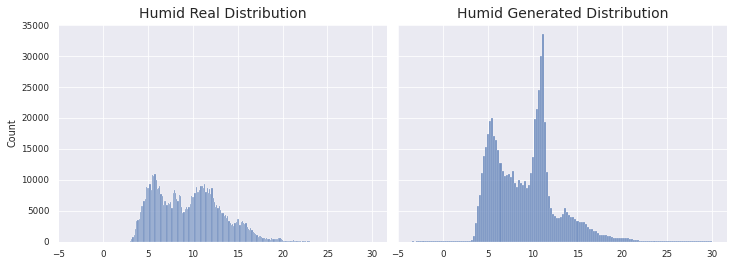

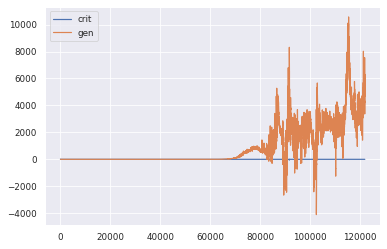

1966/1966 [==============================] - 155s 79ms/step - d_loss: 0.0022 - g_loss: 3777.9452
Epoch 63/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0623 - g_loss: 9768.3765
KL Divergence Sum: 2.4410592362130603 bits
Pinball Loss Temp mean: 1.6233598358143972
Pinball Loss Humid mean: 0.5218265081721315
MSE Temp: 3.246719671628828
MSE Humid: 1.0436530163442876


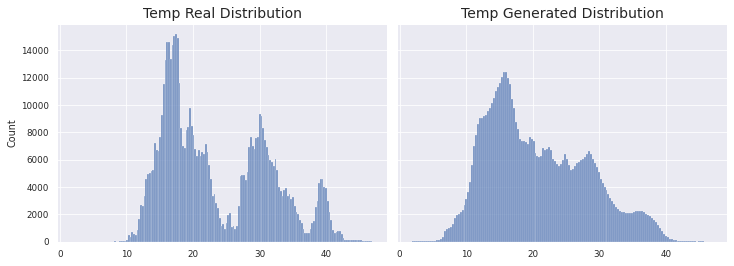

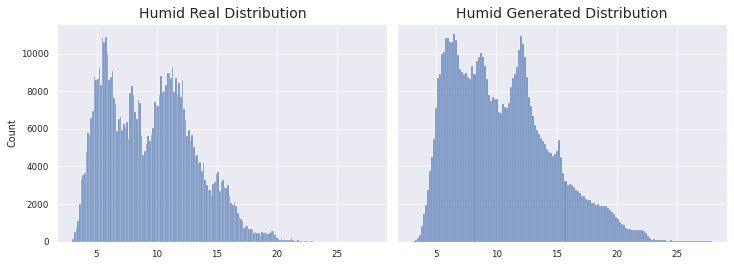

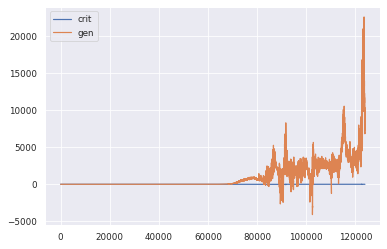

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0623 - g_loss: 9766.9516
Epoch 64/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0367 - g_loss: 10080.5755
KL Divergence Sum: 5.3043361585475095 bits
Pinball Loss Temp mean: 1.2230018916443164
Pinball Loss Humid mean: 0.547645427045703
MSE Temp: 2.4460037832885995
MSE Humid: 1.095290854091417


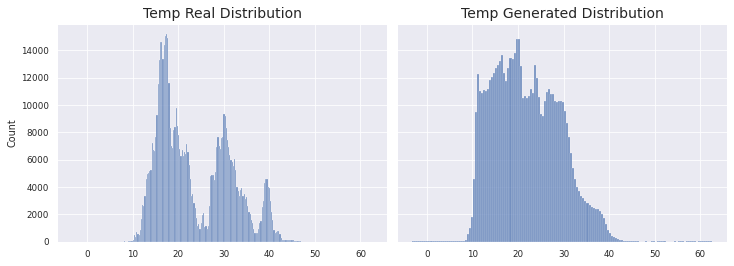

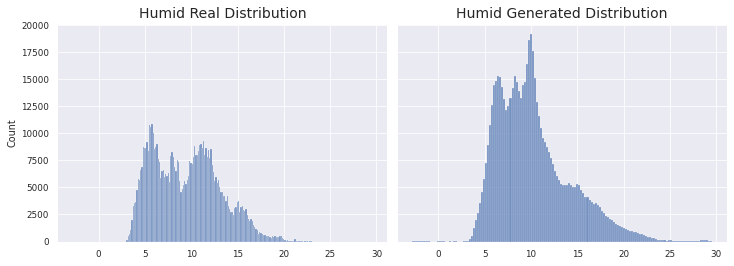

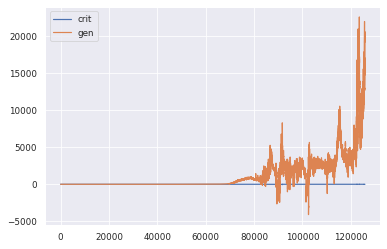

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.0368 - g_loss: 10083.2620
Epoch 65/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3034 - g_loss: 11865.2369
KL Divergence Sum: 13.020637473815436 bits
Pinball Loss Temp mean: 1.9077770339272917
Pinball Loss Humid mean: 0.6638157169057285
MSE Temp: 3.8155540678545914
MSE Humid: 1.3276314338114512


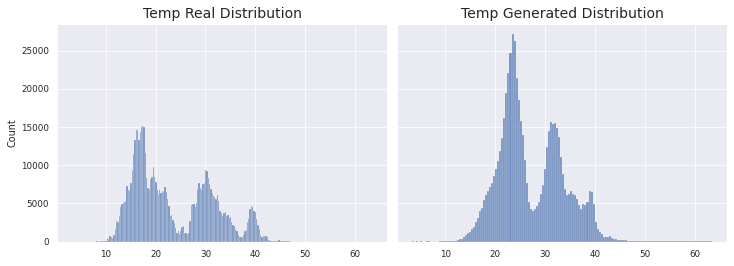

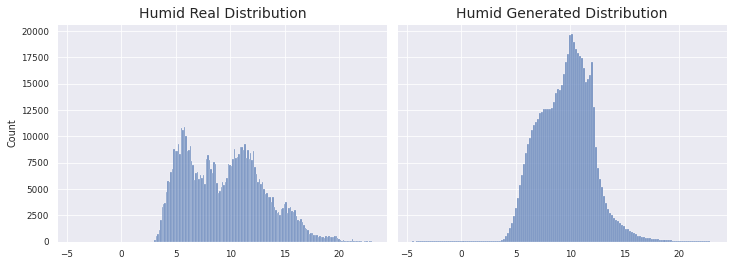

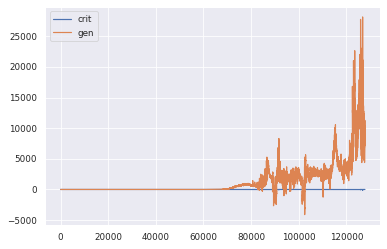

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.3031 - g_loss: 11861.7998
Epoch 66/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3520 - g_loss: 16811.0621
KL Divergence Sum: 3.792132523765868 bits
Pinball Loss Temp mean: 1.9669831721882722
Pinball Loss Humid mean: 0.6329060181032604
MSE Temp: 3.9339663443765076
MSE Humid: 1.2658120362065055


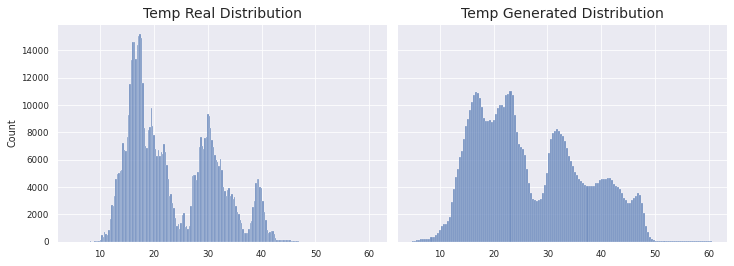

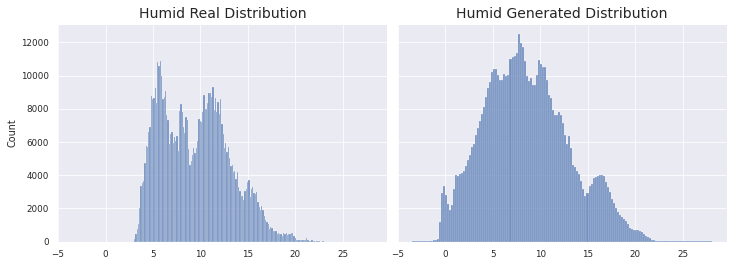

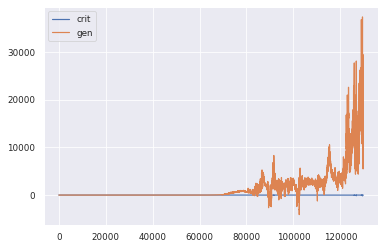

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.3517 - g_loss: 16813.2325
Epoch 67/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0944 - g_loss: 12667.8568
KL Divergence Sum: 2.88478889006186 bits
Pinball Loss Temp mean: 1.527942668079049
Pinball Loss Humid mean: 0.6581694867232083
MSE Temp: 3.055885336158108
MSE Humid: 1.3163389734464117


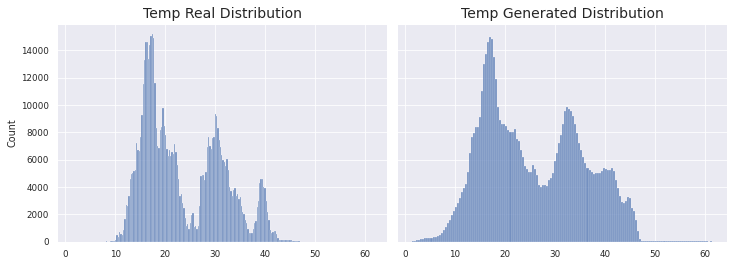

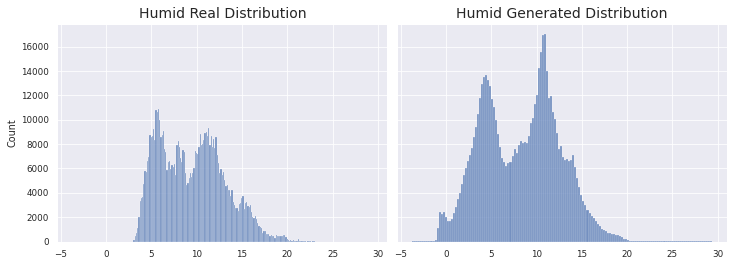

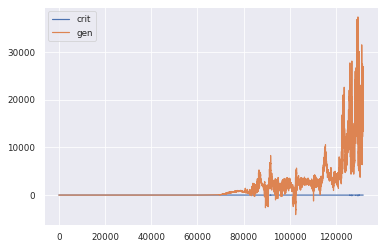

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.0944 - g_loss: 12671.6636
Epoch 68/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0837 - g_loss: 15151.6135
KL Divergence Sum: 5.980671699920475 bits
Pinball Loss Temp mean: 1.0787579460683236
Pinball Loss Humid mean: 0.326194661978547
MSE Temp: 2.157515892136635
MSE Humid: 0.6523893239570965


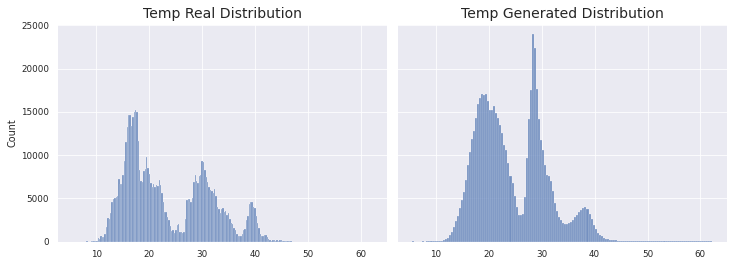

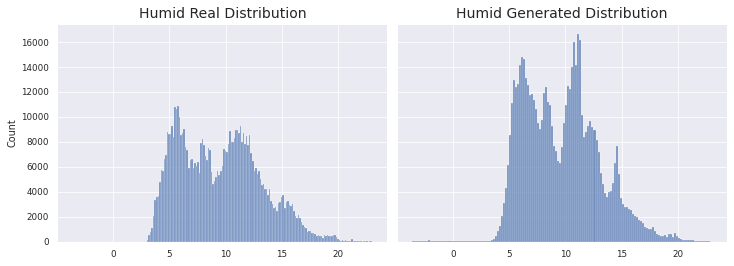

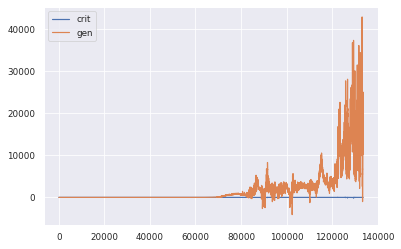

1966/1966 [==============================] - 154s 78ms/step - d_loss: -0.0836 - g_loss: 15150.8952
Epoch 69/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1523 - g_loss: 21096.7654
KL Divergence Sum: 4.979327784929556 bits
Pinball Loss Temp mean: 1.2976253877754786
Pinball Loss Humid mean: 0.5610759255523023
MSE Temp: 2.5952507755509617
MSE Humid: 1.1221518511045934


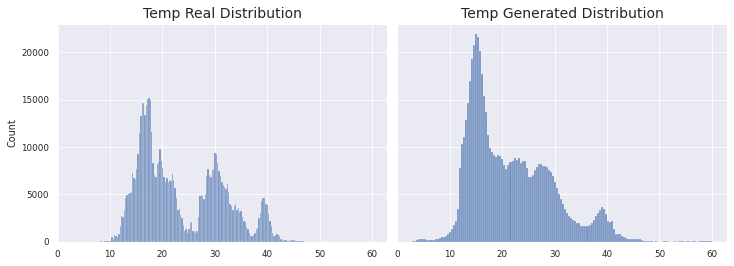

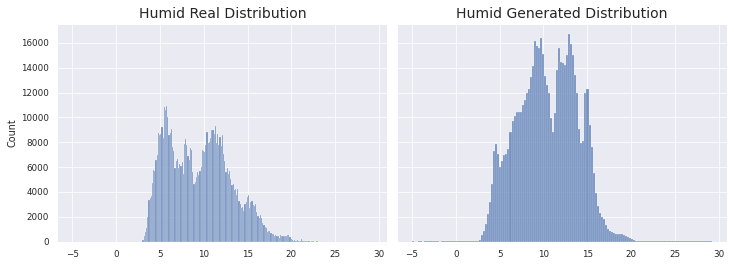

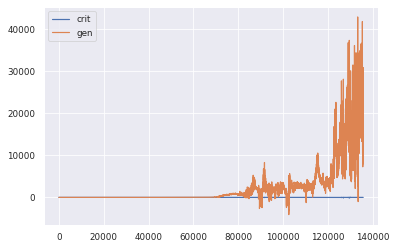

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.1522 - g_loss: 21097.6083
Epoch 70/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2074 - g_loss: 20536.9459
KL Divergence Sum: 5.37751687574378 bits
Pinball Loss Temp mean: 1.8038735587139267
Pinball Loss Humid mean: 0.5805573323283159
MSE Temp: 3.60774711742789
MSE Humid: 1.161114664656655


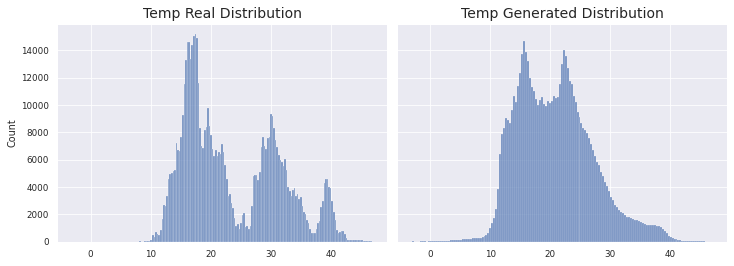

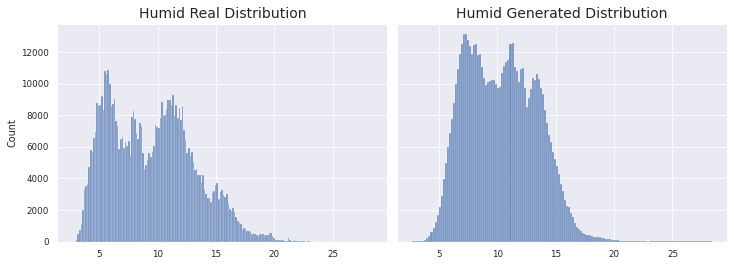

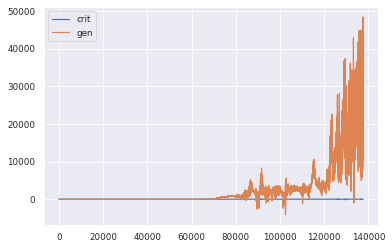

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.2072 - g_loss: 20528.6162
Epoch 71/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4141 - g_loss: 18071.4910
KL Divergence Sum: 11.807816907295129 bits
Pinball Loss Temp mean: 2.8486663214369328
Pinball Loss Humid mean: 0.953101231784219
MSE Temp: 5.6973326428739215
MSE Humid: 1.906202463568436


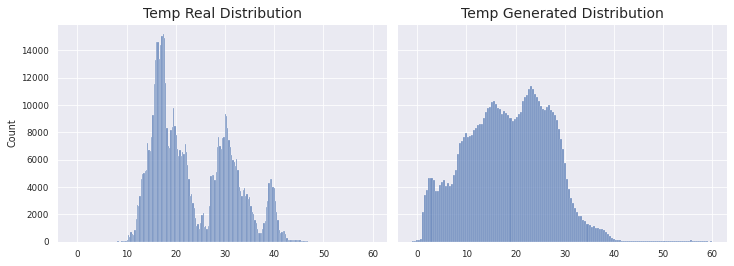

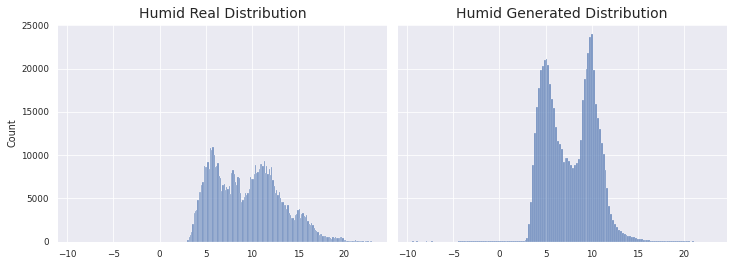

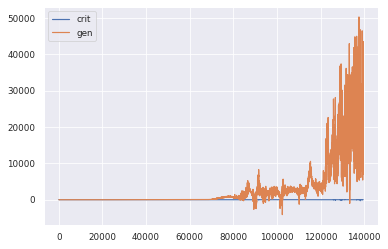

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.4137 - g_loss: 18080.2319
Epoch 72/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3251 - g_loss: 21365.9151
KL Divergence Sum: 6.8863230695713495 bits
Pinball Loss Temp mean: 4.047322179517167
Pinball Loss Humid mean: 1.2876780450170604
MSE Temp: 8.0946443590344
MSE Humid: 2.5753560900341586


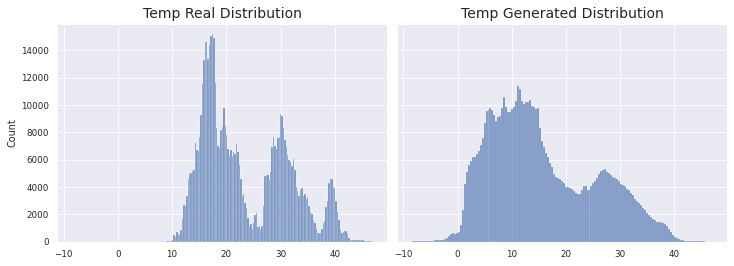

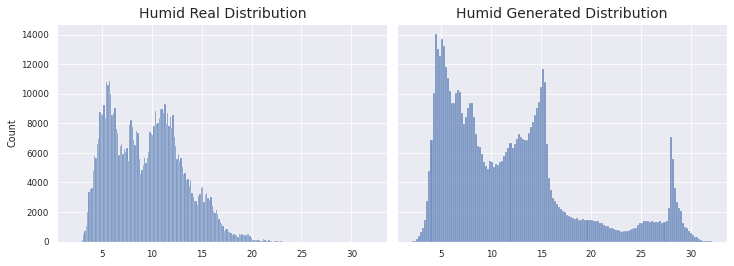

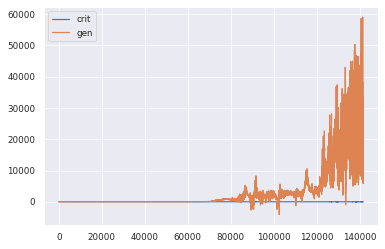

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.3248 - g_loss: 21352.4709
Epoch 73/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2175 - g_loss: 21946.4588
KL Divergence Sum: 7.092411520717866 bits
Pinball Loss Temp mean: 0.957846895472116
Pinball Loss Humid mean: 0.9263518484103169
MSE Temp: 1.915693790944228
MSE Humid: 1.852703696820659


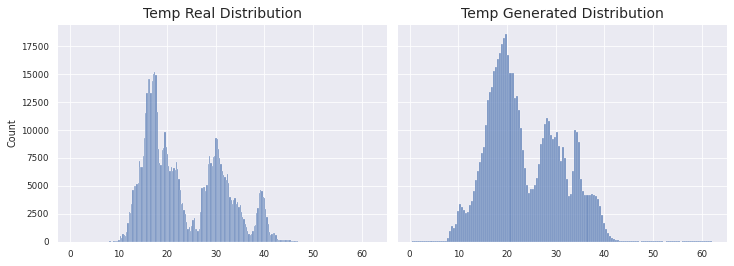

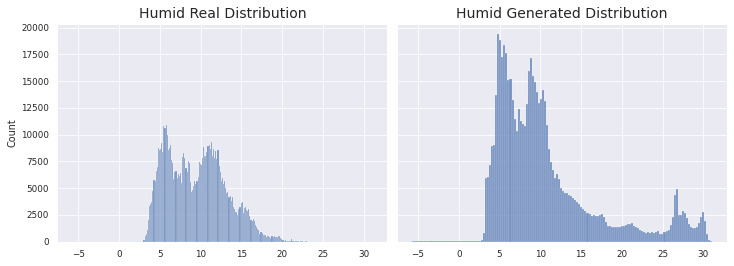

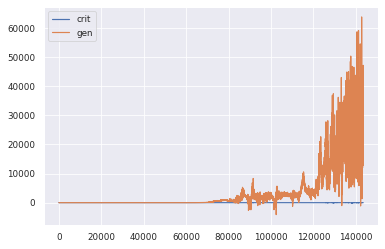

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.2173 - g_loss: 21959.8682
Epoch 74/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3032 - g_loss: 25058.8844
KL Divergence Sum: 9.944998135477157 bits
Pinball Loss Temp mean: 1.7495348389440644
Pinball Loss Humid mean: 1.1016890482587536
MSE Temp: 3.4990696778881687
MSE Humid: 2.2033780965175325


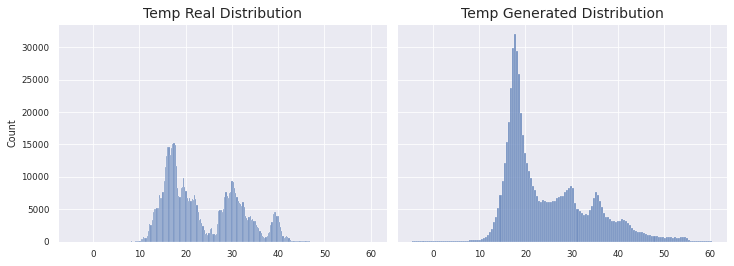

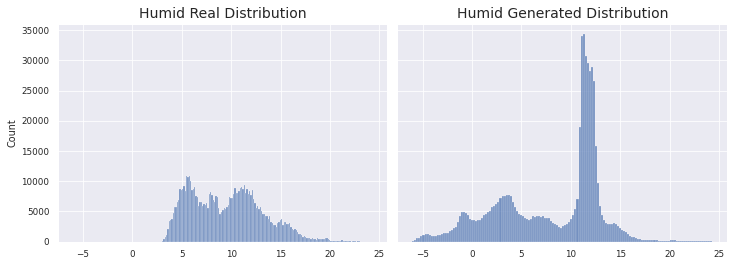

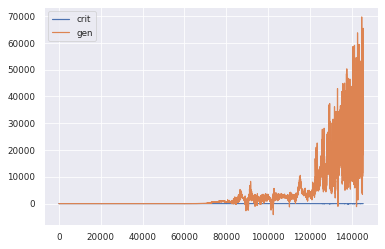

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.3029 - g_loss: 25069.2872
Epoch 75/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.8052 - g_loss: 22062.0374
KL Divergence Sum: 4.0456236771785505 bits
Pinball Loss Temp mean: 3.219307267765905
Pinball Loss Humid mean: 0.9722651709739984
MSE Temp: 6.438614535531676
MSE Humid: 1.9445303419479816


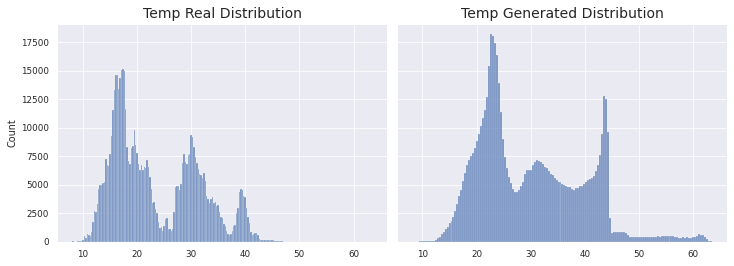

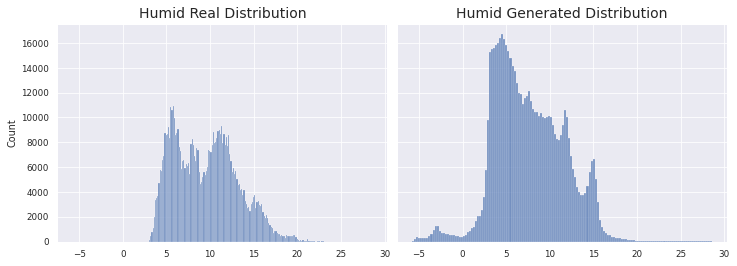

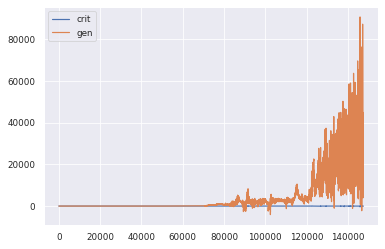

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.8044 - g_loss: 22063.1679
Epoch 76/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4682 - g_loss: 29048.7962
KL Divergence Sum: 9.105626868884073 bits
Pinball Loss Temp mean: 5.79814797704835
Pinball Loss Humid mean: 1.3971048756027145
MSE Temp: 11.596295954096817
MSE Humid: 2.794209751205518


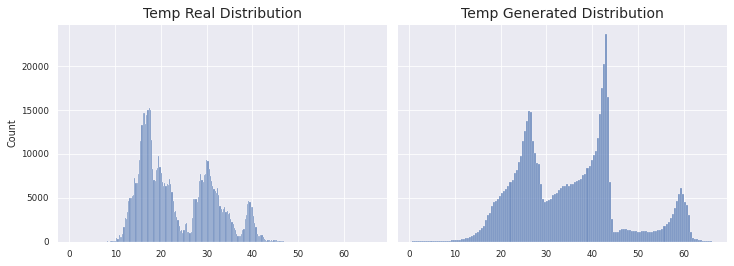

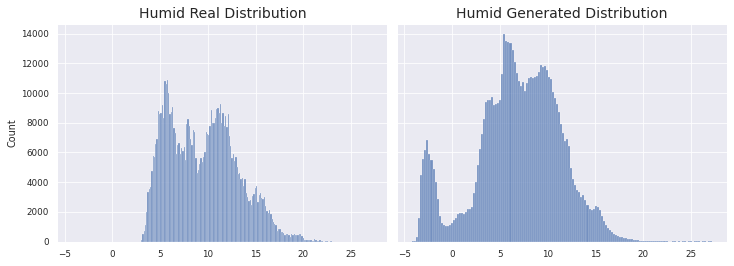

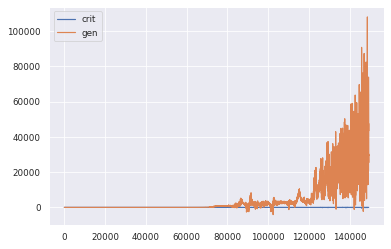

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.4679 - g_loss: 29050.0840
Epoch 77/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3163 - g_loss: 20690.4591
KL Divergence Sum: 4.518281513679785 bits
Pinball Loss Temp mean: 5.257584801071864
Pinball Loss Humid mean: 0.6400650907052331
MSE Temp: 10.515169602143684
MSE Humid: 1.2801301814104595


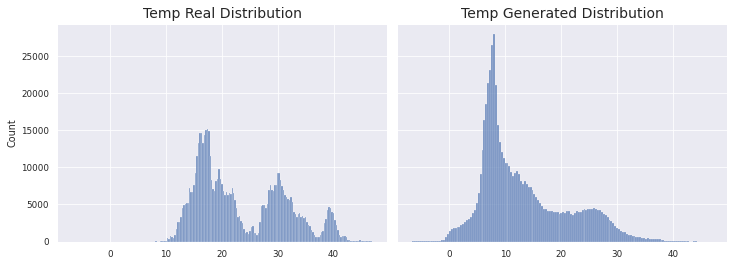

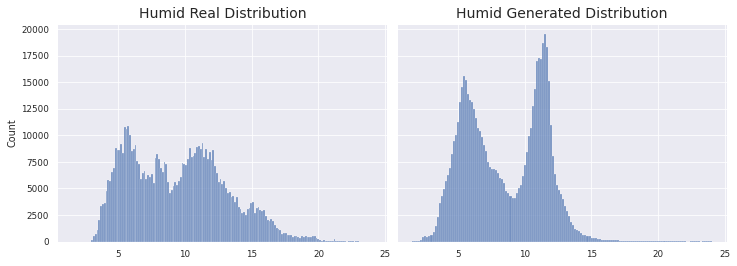

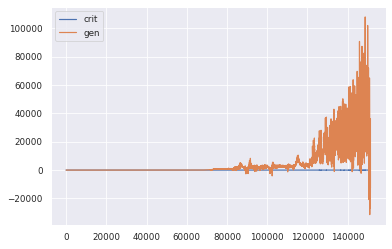

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.3160 - g_loss: 20656.5895
Epoch 78/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0238 - g_loss: -650.7002
KL Divergence Sum: 10.907736120891014 bits
Pinball Loss Temp mean: 1.492069720740758
Pinball Loss Humid mean: 0.9805045787699024
MSE Temp: 2.9841394414815676
MSE Humid: 1.9610091575398063


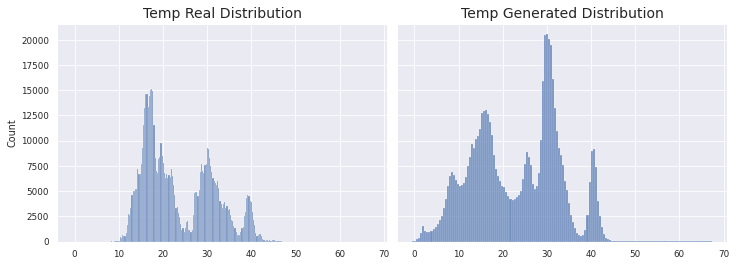

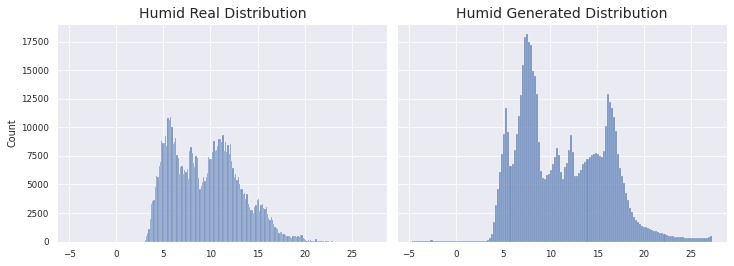

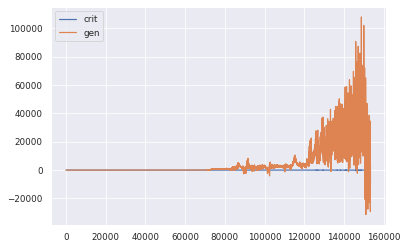

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0237 - g_loss: -646.3012
Epoch 79/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0139 - g_loss: -357.4870
KL Divergence Sum: 6.202044913181511 bits
Pinball Loss Temp mean: 2.27375755091039
Pinball Loss Humid mean: 1.3933674528180375
MSE Temp: 4.547515101820729
MSE Humid: 2.7867349056361155


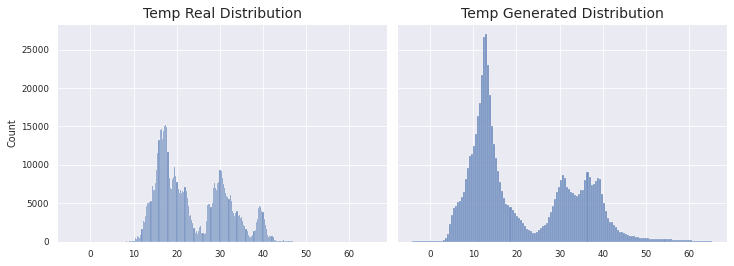

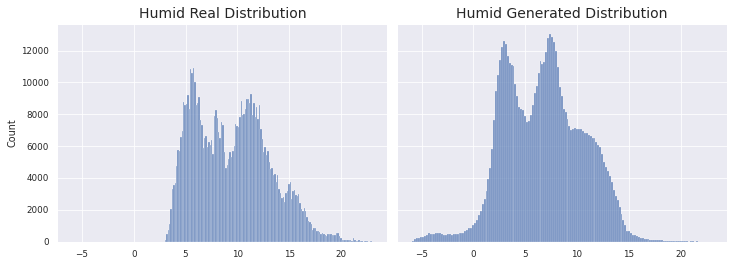

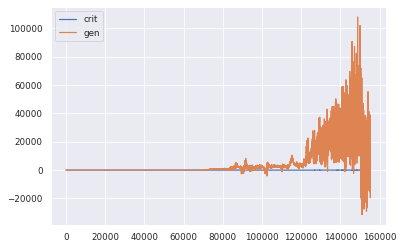

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0138 - g_loss: -354.2393
Epoch 80/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0130 - g_loss: 160.1865
KL Divergence Sum: 4.907952268639759 bits
Pinball Loss Temp mean: 1.431804815288706
Pinball Loss Humid mean: 0.813087361683252
MSE Temp: 2.8636096305774412
MSE Humid: 1.6261747233665147


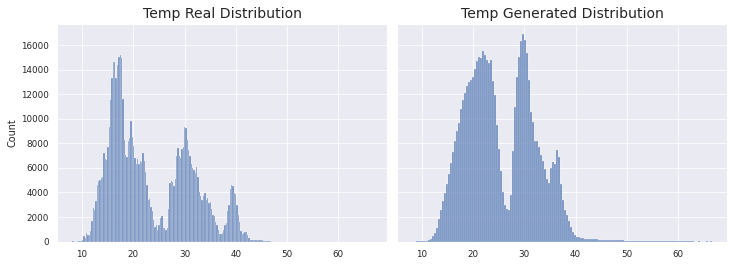

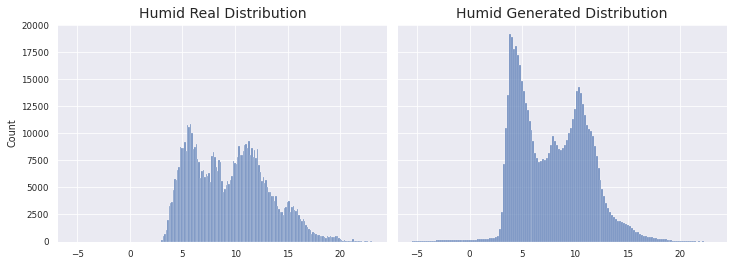

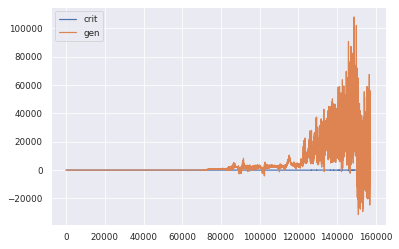

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0130 - g_loss: 169.0136
Epoch 81/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0843 - g_loss: 9553.2878
KL Divergence Sum: 10.342548263560566 bits
Pinball Loss Temp mean: 0.918905659350189
Pinball Loss Humid mean: 0.6028096804385988
MSE Temp: 1.8378113187003617
MSE Humid: 1.2056193608772023


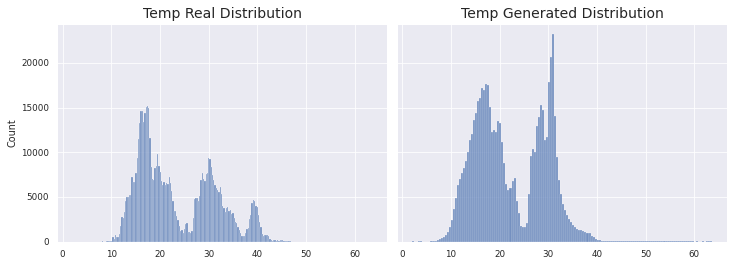

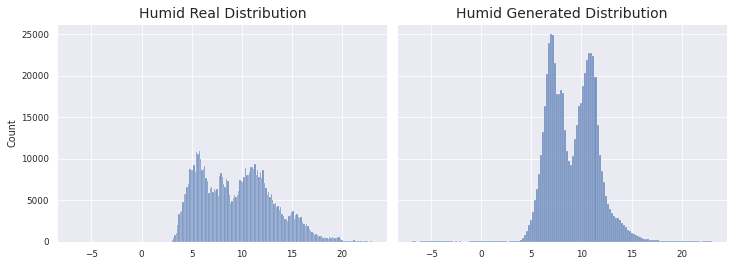

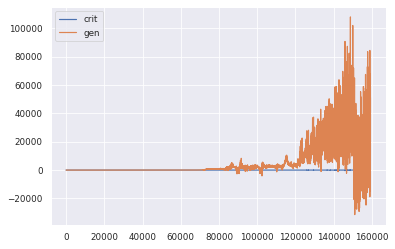

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0850 - g_loss: 9595.5309
Epoch 82/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0086 - g_loss: 7939.0640
KL Divergence Sum: 8.550531190400607 bits
Pinball Loss Temp mean: 1.7276520166279616
Pinball Loss Humid mean: 0.4477291123435684
MSE Temp: 3.455304033255932
MSE Humid: 0.8954582246871321


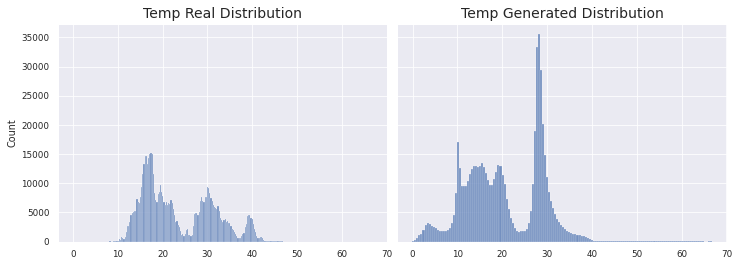

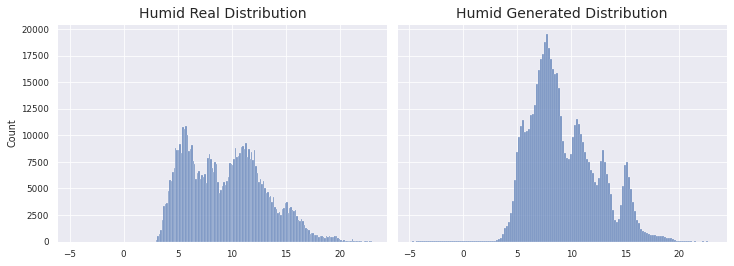

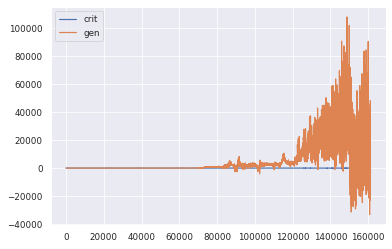

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0086 - g_loss: 7931.7496
Epoch 83/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2359 - g_loss: 12722.9049
KL Divergence Sum: 11.370962460904225 bits
Pinball Loss Temp mean: 2.516788597827654
Pinball Loss Humid mean: 1.7639919671342725
MSE Temp: 5.0335771956552655
MSE Humid: 3.5279839342685646


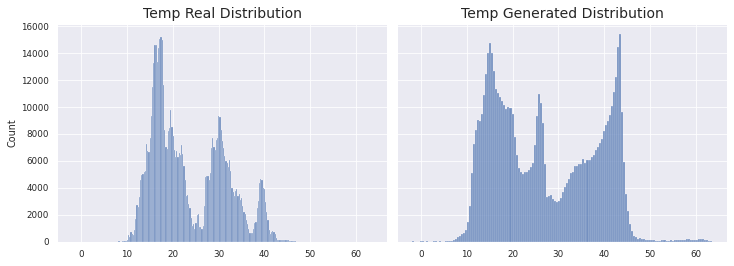

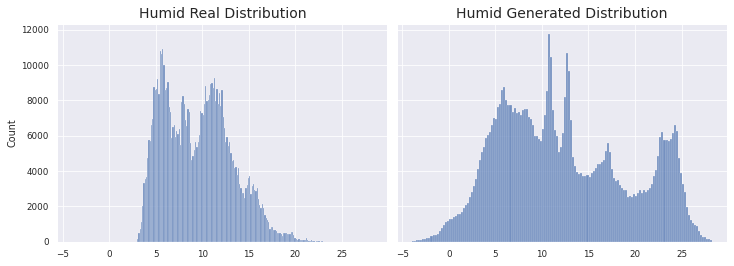

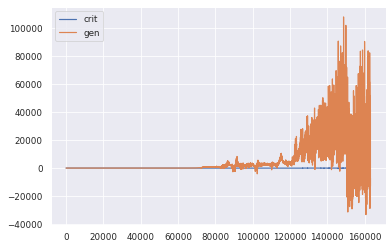

1966/1966 [==============================] - 155s 79ms/step - d_loss: -0.2356 - g_loss: 12702.6539
Epoch 84/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3272 - g_loss: 6775.6144
KL Divergence Sum: 6.471082319296236 bits
Pinball Loss Temp mean: 1.910600300427816
Pinball Loss Humid mean: 0.3986125000880077
MSE Temp: 3.821200600855598
MSE Humid: 0.7972250001760098


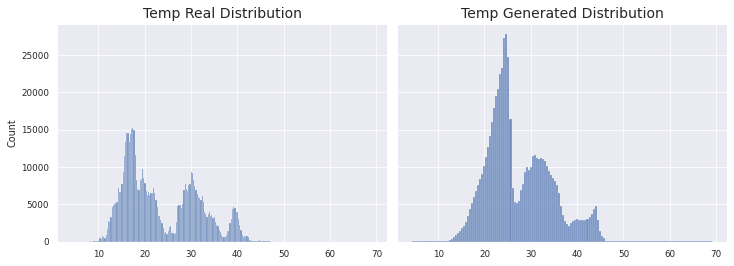

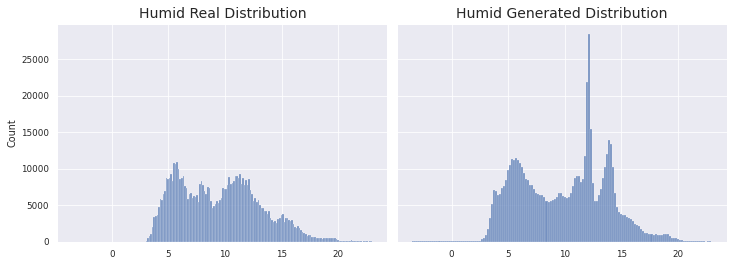

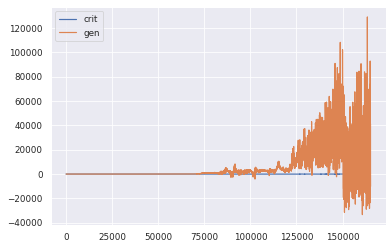

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.3267 - g_loss: 6758.3309
Epoch 85/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3047 - g_loss: 7798.3602
KL Divergence Sum: 10.344783775130129 bits
Pinball Loss Temp mean: 2.5593064340581466
Pinball Loss Humid mean: 0.7730567607115522
MSE Temp: 5.11861286811636
MSE Humid: 1.546113521423113


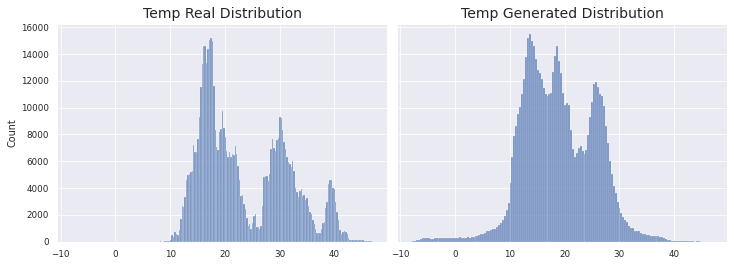

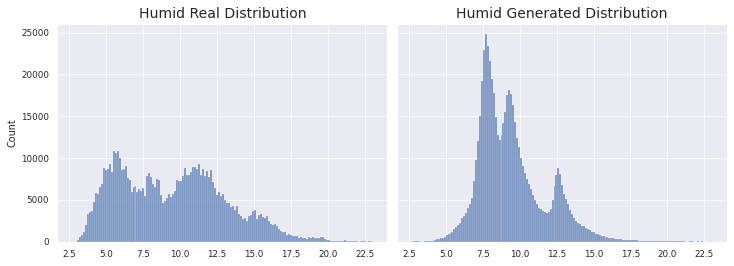

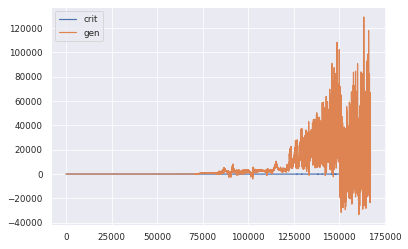

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.3051 - g_loss: 7790.3149
Epoch 86/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5859 - g_loss: 1258.4463
KL Divergence Sum: 11.652965713264015 bits
Pinball Loss Temp mean: 7.7398236770994675
Pinball Loss Humid mean: 1.387075992084298
MSE Temp: 15.47964735419882
MSE Humid: 2.7741519841684994


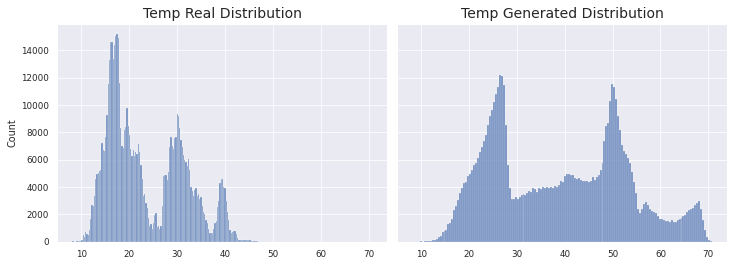

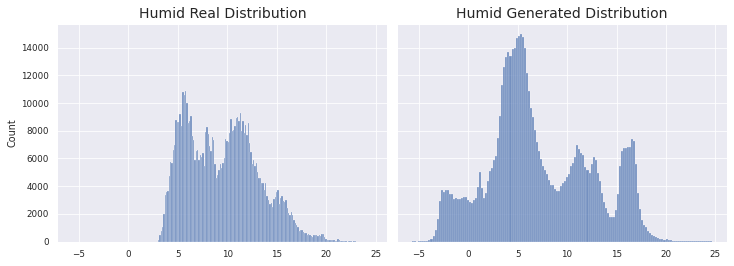

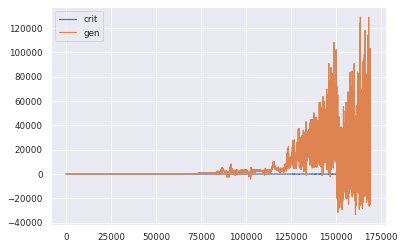

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.5847 - g_loss: 1247.4585
Epoch 87/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.8301 - g_loss: 8175.3354
KL Divergence Sum: 4.376156535629628 bits
Pinball Loss Temp mean: 3.311313107815124
Pinball Loss Humid mean: 0.39599230245682654
MSE Temp: 6.622626215630224
MSE Humid: 0.7919846049136445


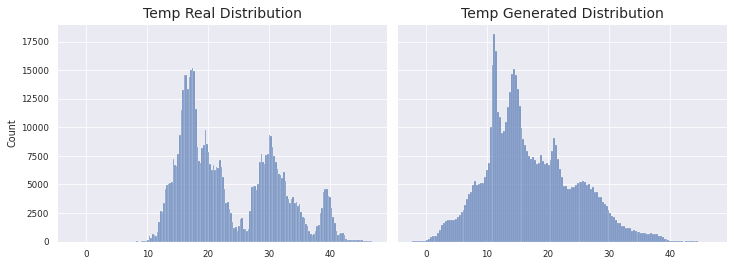

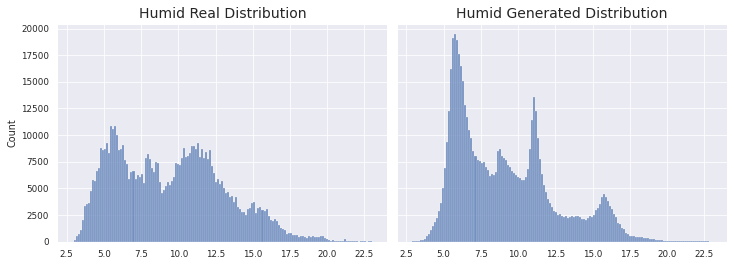

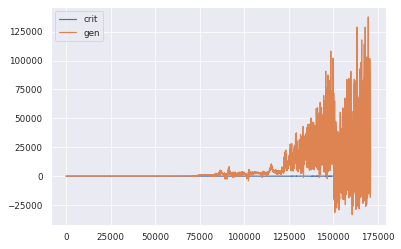

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.8299 - g_loss: 8184.9135
Epoch 88/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4913 - g_loss: 2823.5894
KL Divergence Sum: 15.802925284442514 bits
Pinball Loss Temp mean: 2.00798194240567
Pinball Loss Humid mean: 0.6722880372565786
MSE Temp: 4.015963884811282
MSE Humid: 1.3445760745131856


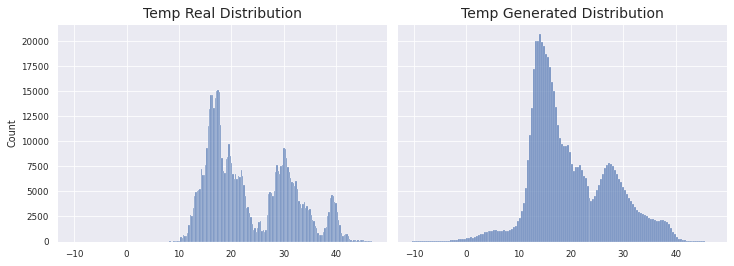

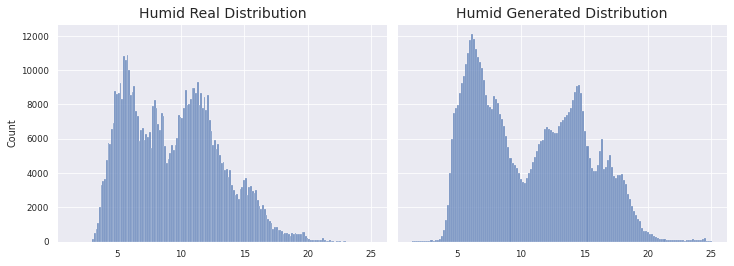

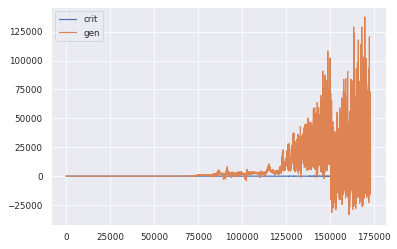

1966/1966 [==============================] - 156s 79ms/step - d_loss: -0.4908 - g_loss: 2817.3355
Epoch 89/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1601 - g_loss: 6976.3523
KL Divergence Sum: 7.055353095469662 bits
Pinball Loss Temp mean: 2.834051840067307
Pinball Loss Humid mean: 1.1642535114077703
MSE Temp: 5.668103680134683
MSE Humid: 2.3285070228155895


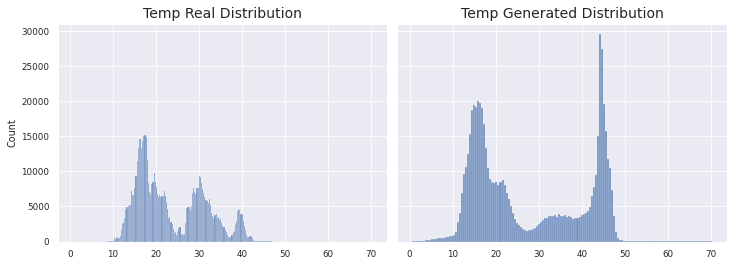

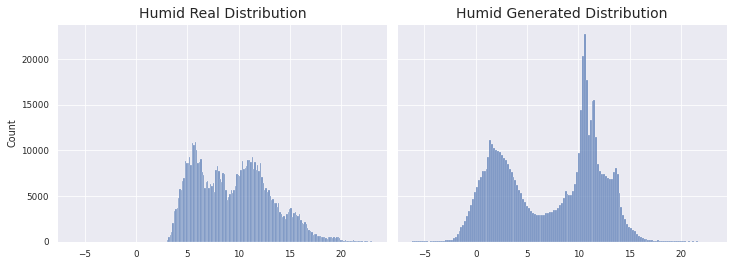

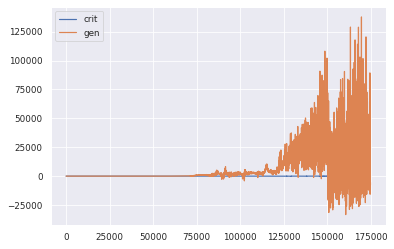

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.1599 - g_loss: 6961.4627
Epoch 90/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0053 - g_loss: 1942.2600
KL Divergence Sum: 17.049606766545256 bits
Pinball Loss Temp mean: 3.991119876608124
Pinball Loss Humid mean: 1.5566073466750896
MSE Temp: 7.982239753216305
MSE Humid: 3.1132146933501663


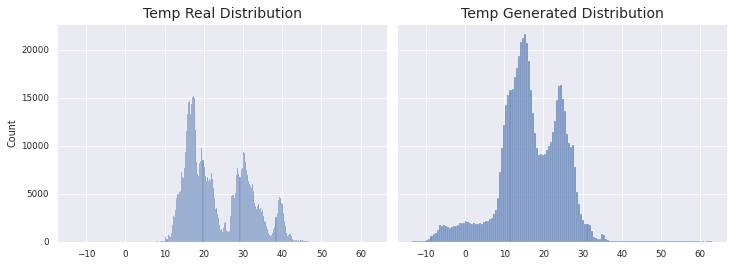

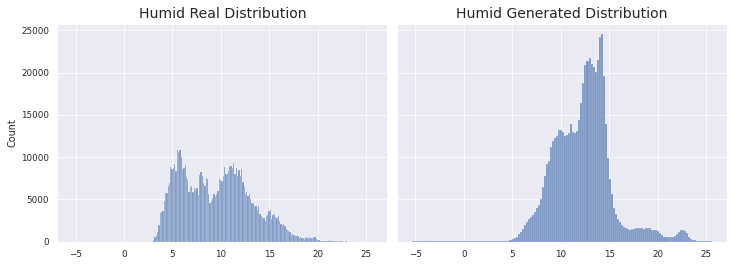

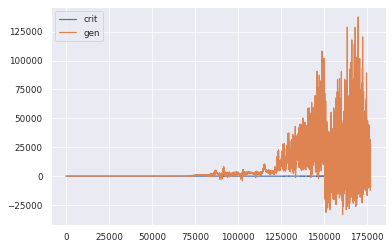

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0053 - g_loss: 1939.7408
Epoch 91/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0788 - g_loss: 2938.7414
KL Divergence Sum: 8.611079036442694 bits
Pinball Loss Temp mean: 2.58603137806839
Pinball Loss Humid mean: 1.3052041435034143
MSE Temp: 5.172062756136813
MSE Humid: 2.6104082870068517


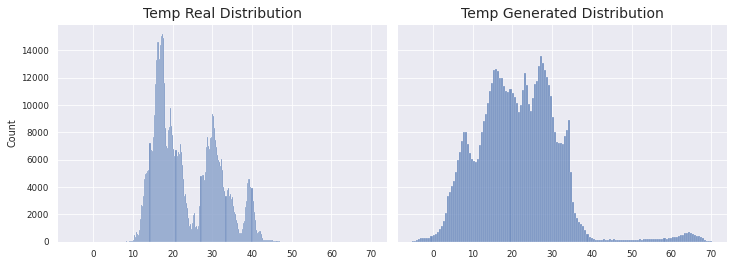

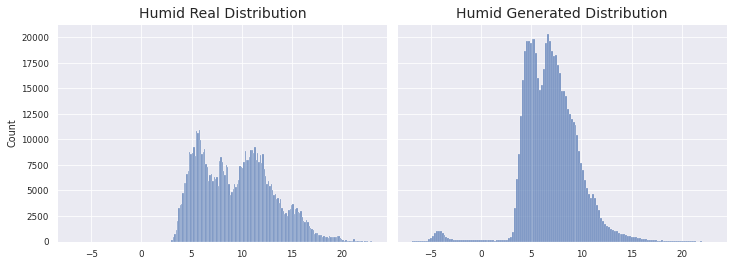

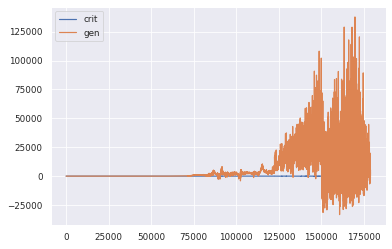

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.0788 - g_loss: 2939.0328
Epoch 92/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0379 - g_loss: 4679.9935
KL Divergence Sum: 1.5097098000611116 bits
Pinball Loss Temp mean: 1.0647390743058343
Pinball Loss Humid mean: 0.3009618073131615
MSE Temp: 2.1294781486116676
MSE Humid: 0.6019236146263143


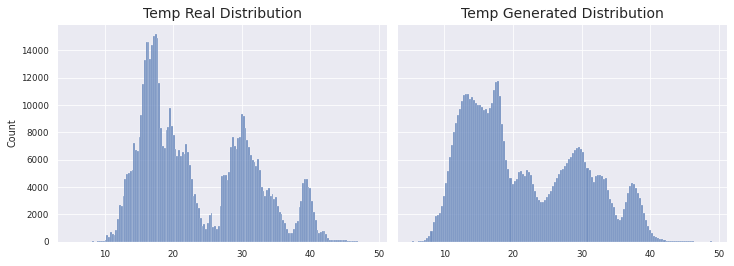

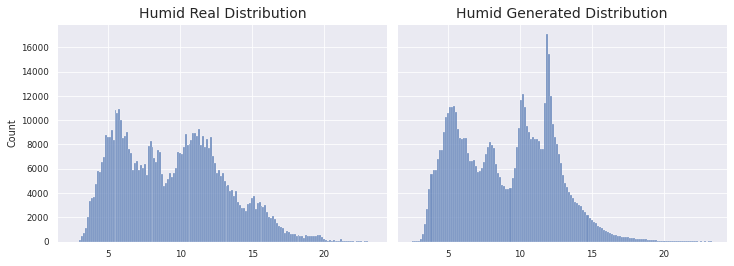

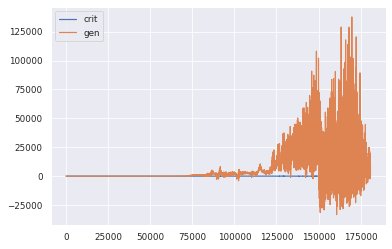

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0379 - g_loss: 4679.2116
Epoch 93/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0832 - g_loss: 2245.2615
KL Divergence Sum: 5.231330741010916 bits
Pinball Loss Temp mean: 1.5783065076340934
Pinball Loss Humid mean: 0.7560142810338806
MSE Temp: 3.156613015268175
MSE Humid: 1.5120285620677665


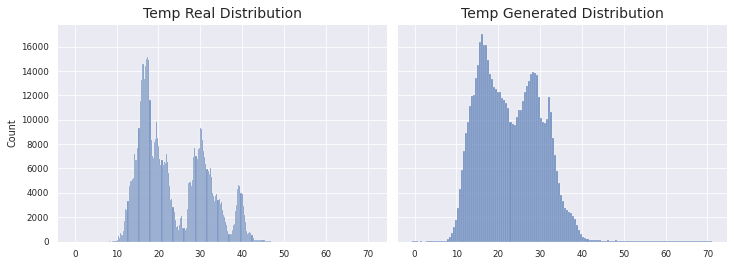

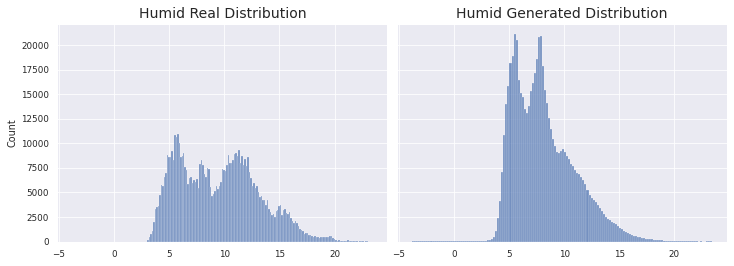

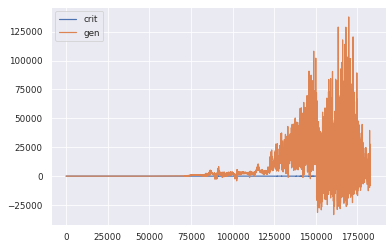

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0831 - g_loss: 2244.6711
Epoch 94/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0079 - g_loss: 3132.0179
KL Divergence Sum: 8.109258614072932 bits
Pinball Loss Temp mean: 4.475251220099291
Pinball Loss Humid mean: 2.1695281818228556
MSE Temp: 8.950502440198578
MSE Humid: 4.339056363645769


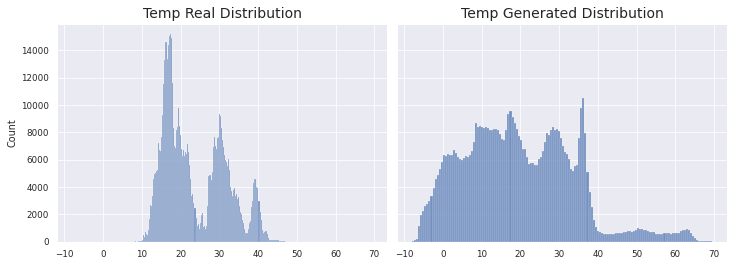

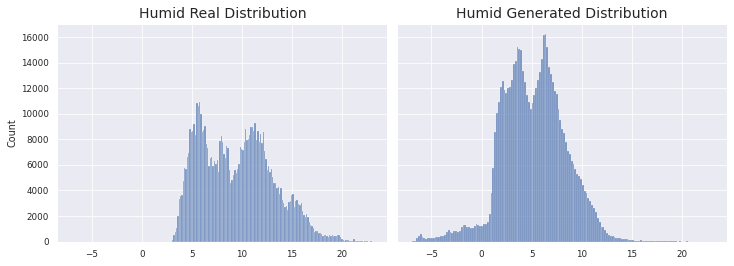

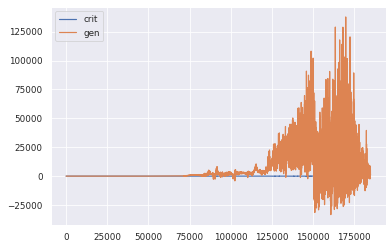

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0079 - g_loss: 3130.9307
Epoch 95/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0735 - g_loss: 11077.4566
KL Divergence Sum: 14.315214634111975 bits
Pinball Loss Temp mean: 1.811886986239676
Pinball Loss Humid mean: 1.2409463493415598
MSE Temp: 3.623773972479396
MSE Humid: 2.481892698683119


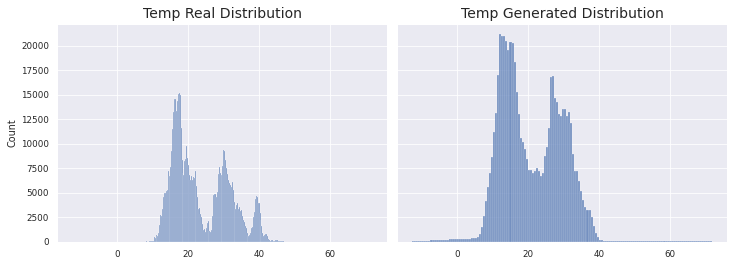

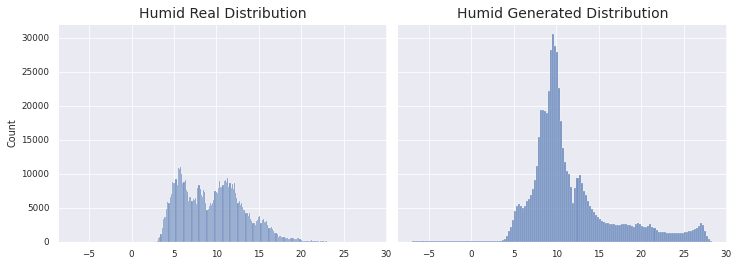

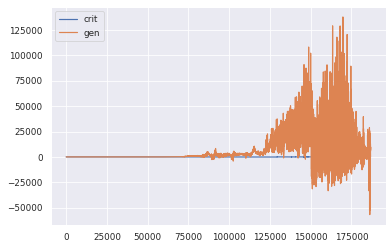

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.0734 - g_loss: 11075.9444
Epoch 96/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0705 - g_loss: 10778.2411
KL Divergence Sum: 6.690943279644408 bits
Pinball Loss Temp mean: 3.1072823676820653
Pinball Loss Humid mean: 0.9085804565843455
MSE Temp: 6.214564735364245
MSE Humid: 1.8171609131687285


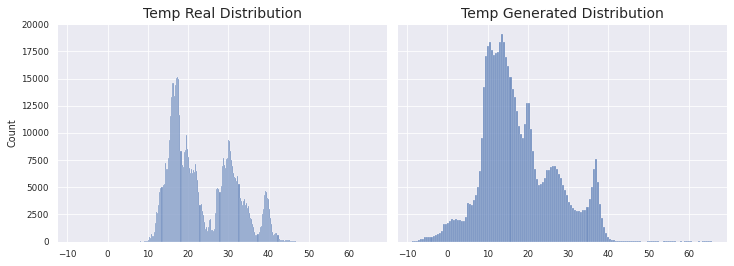

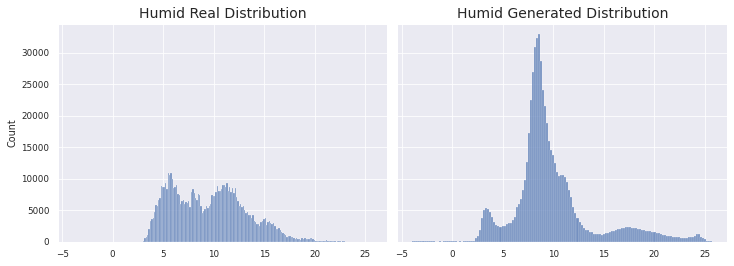

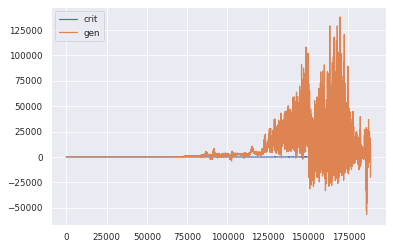

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.0705 - g_loss: 10775.3239
Epoch 97/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0727 - g_loss: 8801.4126
KL Divergence Sum: 5.594238566233786 bits
Pinball Loss Temp mean: 2.5119159709145857
Pinball Loss Humid mean: 0.9401426658513603
MSE Temp: 5.023831941829196
MSE Humid: 1.880285331702698


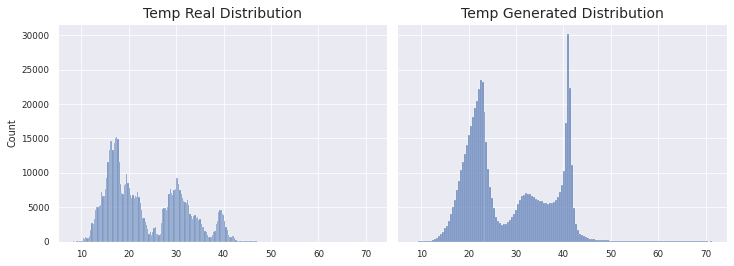

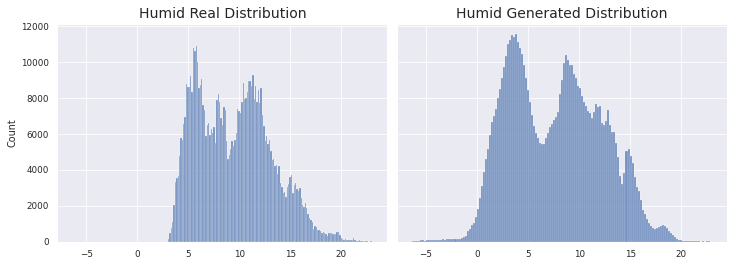

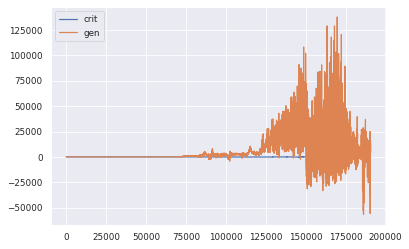

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0726 - g_loss: 8803.0406
Epoch 98/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0499 - g_loss: 22485.7647
KL Divergence Sum: 17.88175725050235 bits
Pinball Loss Temp mean: 2.029165782659794
Pinball Loss Humid mean: 0.43558159918149936
MSE Temp: 4.058331565319584
MSE Humid: 0.8711631983630084


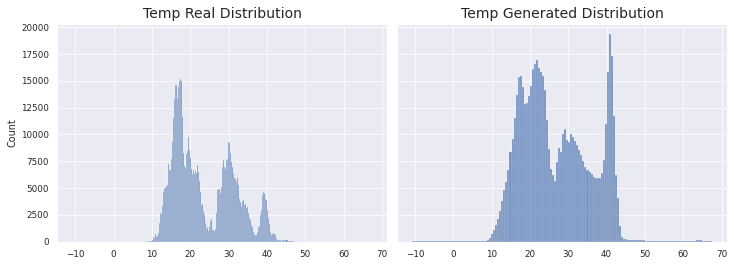

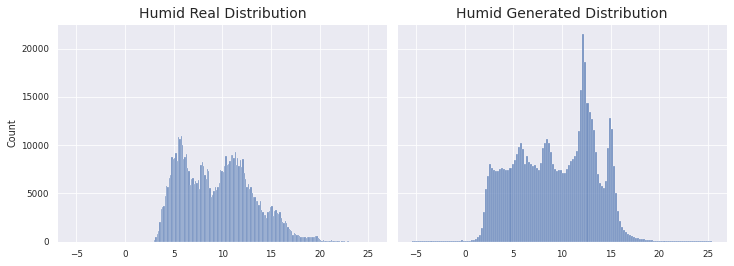

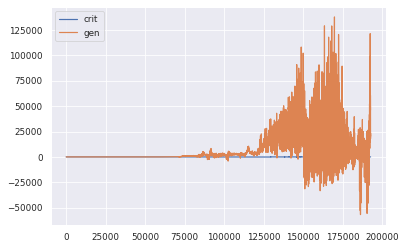

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0498 - g_loss: 22483.9504
Epoch 99/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.6290 - g_loss: 32697.3665
KL Divergence Sum: 9.569284451991287 bits
Pinball Loss Temp mean: 2.7667768431809514
Pinball Loss Humid mean: 0.8411646669117905
MSE Temp: 5.533553686361932
MSE Humid: 1.6823293338235896


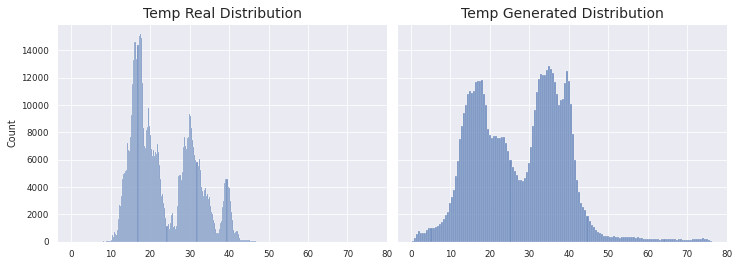

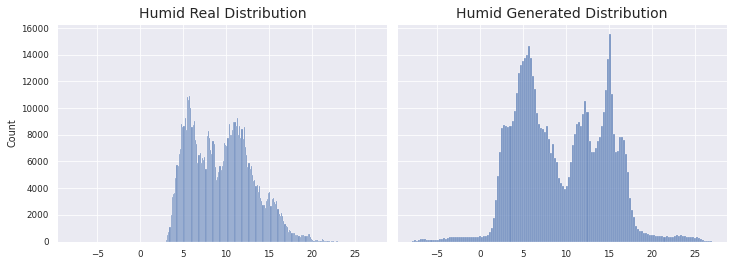

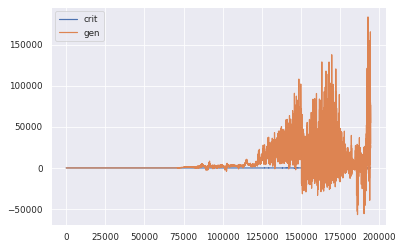

1966/1966 [==============================] - 160s 81ms/step - d_loss: -1.6274 - g_loss: 32692.0128
Epoch 100/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0723 - g_loss: 22373.7574
KL Divergence Sum: 3.921329221439623 bits
Pinball Loss Temp mean: 1.6856693117581067
Pinball Loss Humid mean: 0.9580719629846003
MSE Temp: 3.371338623516218
MSE Humid: 1.9161439259692221


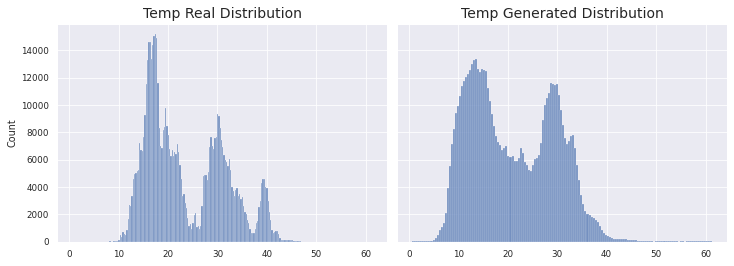

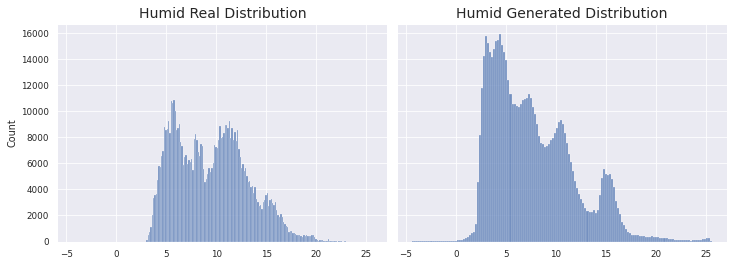

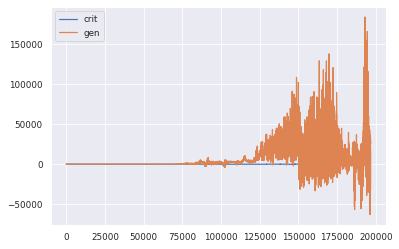

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0723 - g_loss: 22368.0289
Epoch 101/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0506 - g_loss: 18178.6578
KL Divergence Sum: 6.505206406141656 bits
Pinball Loss Temp mean: 1.3514779303631854
Pinball Loss Humid mean: 0.8583019117067113
MSE Temp: 2.7029558607263655
MSE Humid: 1.7166038234134255


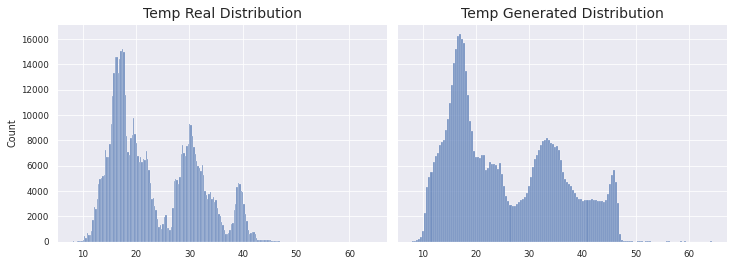

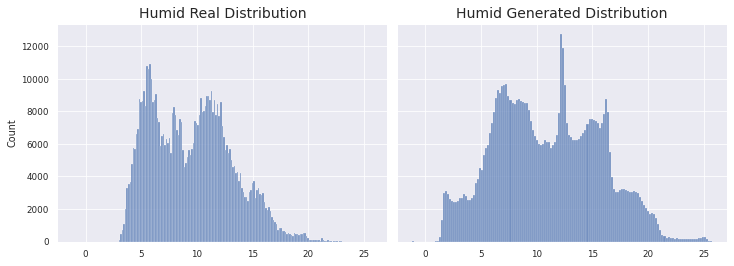

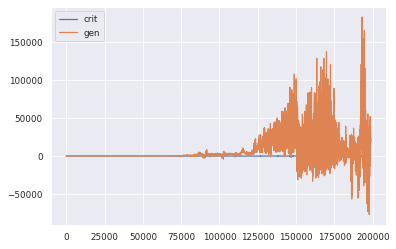

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0505 - g_loss: 18191.6811
Epoch 102/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0357 - g_loss: 16765.0150
KL Divergence Sum: 6.5771347660629 bits
Pinball Loss Temp mean: 2.3242487833403964
Pinball Loss Humid mean: 0.7303330275410069
MSE Temp: 4.648497566680809
MSE Humid: 1.460666055082034


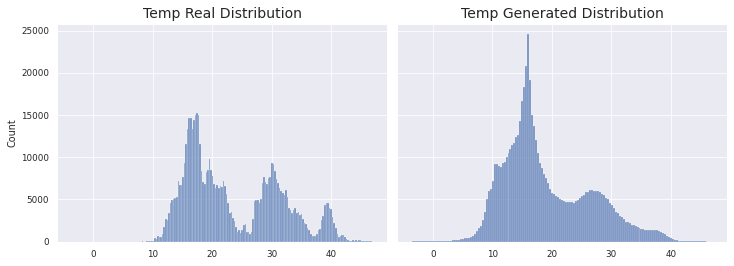

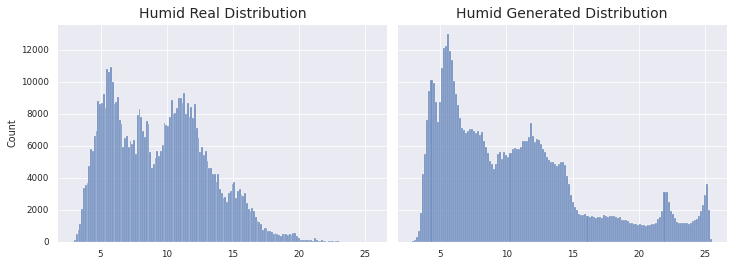

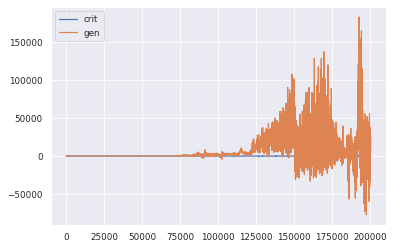

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0356 - g_loss: 16771.3516
Epoch 103/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1129 - g_loss: 17041.7653
KL Divergence Sum: 10.566670918381922 bits
Pinball Loss Temp mean: 5.419180381568976
Pinball Loss Humid mean: 2.305673706614688
MSE Temp: 10.83836076313814
MSE Humid: 4.611347413229342


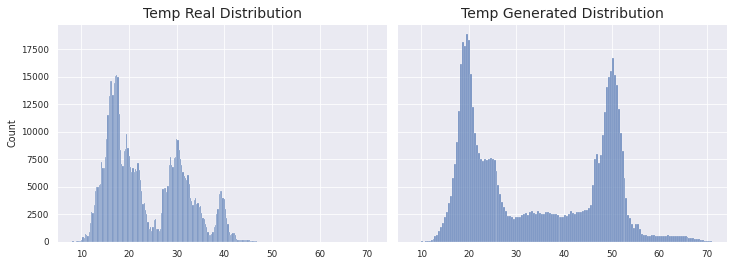

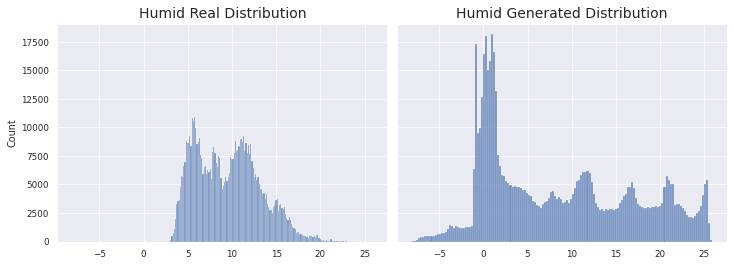

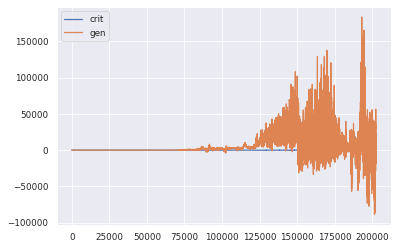

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1128 - g_loss: 17033.3559
Epoch 104/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0030 - g_loss: 20187.1336
KL Divergence Sum: 9.126411065199722 bits
Pinball Loss Temp mean: 0.8909089798406379
Pinball Loss Humid mean: 0.4051062135119852
MSE Temp: 1.7818179596813106
MSE Humid: 0.8102124270239758


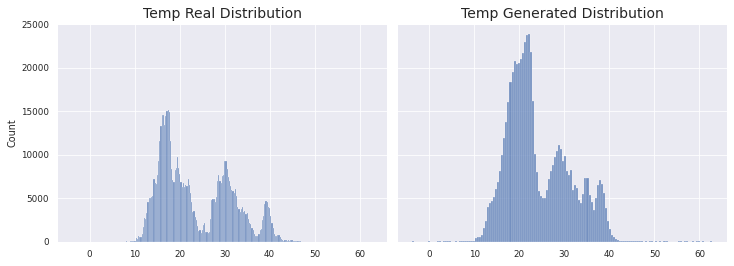

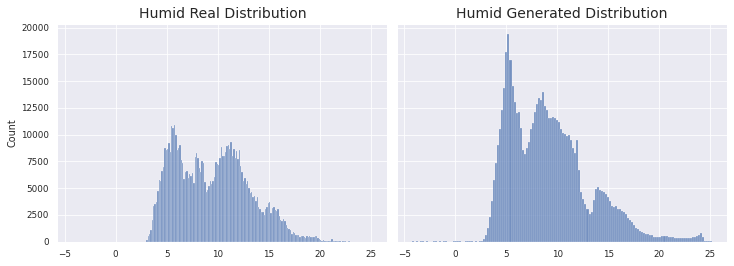

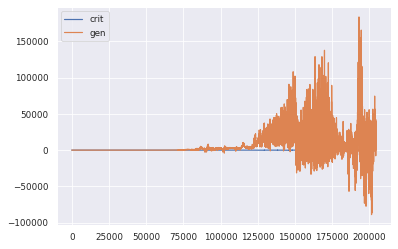

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0029 - g_loss: 20206.8799
Epoch 105/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1007 - g_loss: 32336.4246
KL Divergence Sum: 6.617932220815734 bits
Pinball Loss Temp mean: 1.653583222905662
Pinball Loss Humid mean: 0.7163974781006364
MSE Temp: 3.3071664458113843
MSE Humid: 1.4327949562012323


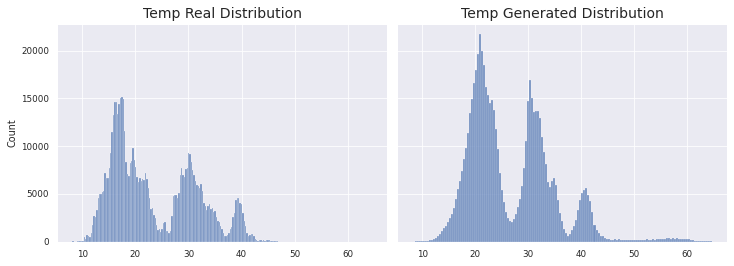

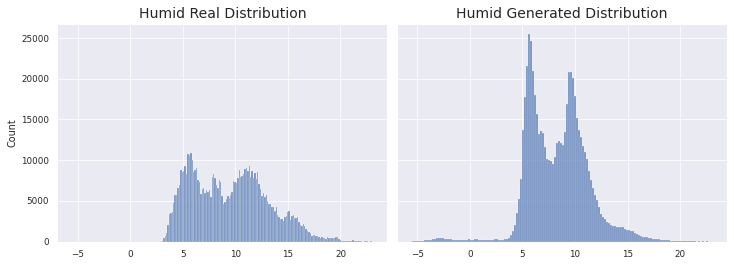

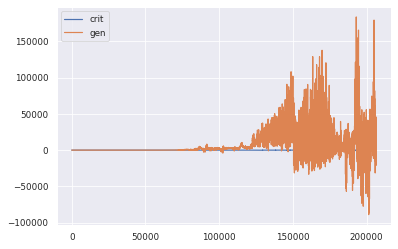

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.1006 - g_loss: 32331.1434
Epoch 106/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0181 - g_loss: 20640.4718
KL Divergence Sum: 7.684260167187991 bits
Pinball Loss Temp mean: 1.252563413573241
Pinball Loss Humid mean: 1.2455798492824421
MSE Temp: 2.5051268271464657
MSE Humid: 2.491159698564864


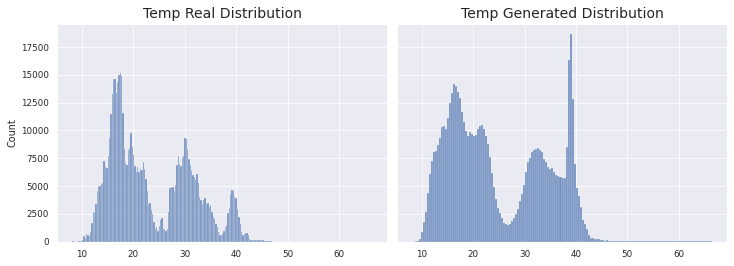

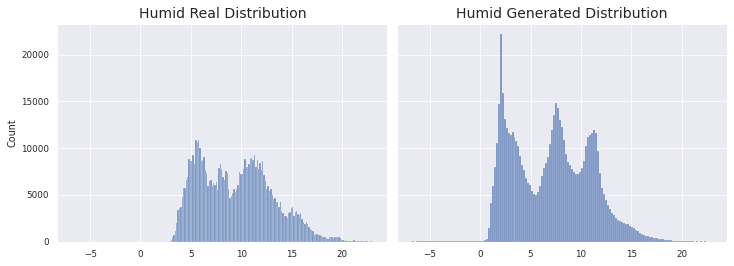

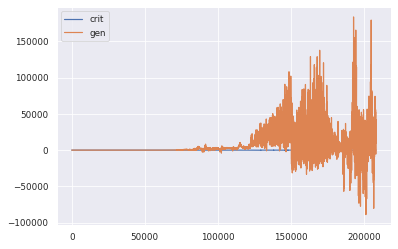

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0180 - g_loss: 20643.1879
Epoch 107/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0646 - g_loss: 16115.1732
KL Divergence Sum: 6.700913578585616 bits
Pinball Loss Temp mean: 0.9894116411216505
Pinball Loss Humid mean: 0.26515751881050587
MSE Temp: 1.9788232822432672
MSE Humid: 0.5303150376210133


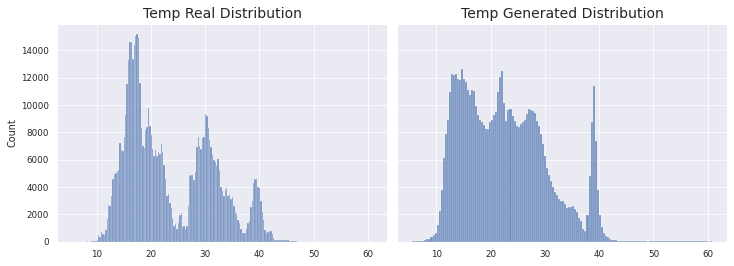

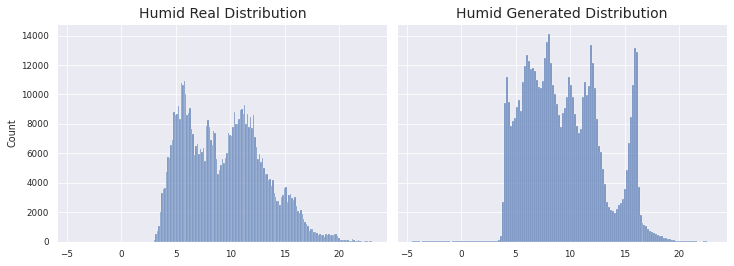

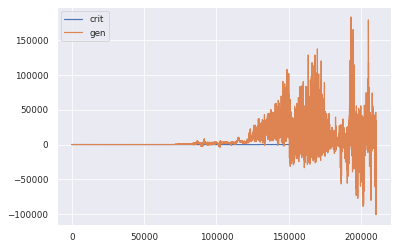

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.0645 - g_loss: 16119.8682
Epoch 108/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1628 - g_loss: 20082.8439
KL Divergence Sum: 7.847115135383944 bits
Pinball Loss Temp mean: 1.0119170029087863
Pinball Loss Humid mean: 0.5397886048703988
MSE Temp: 2.023834005817603
MSE Humid: 1.079577209740789


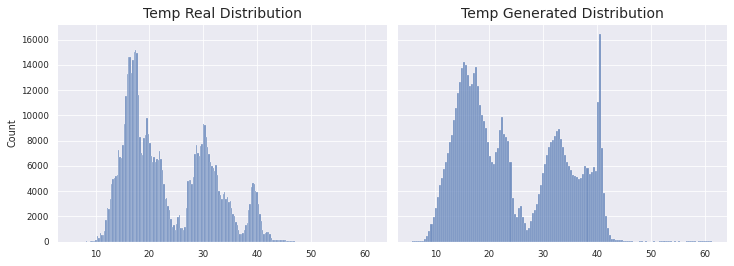

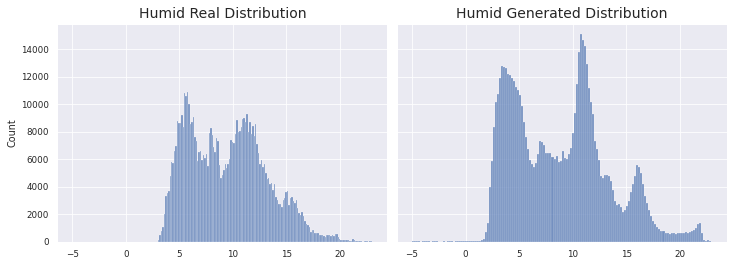

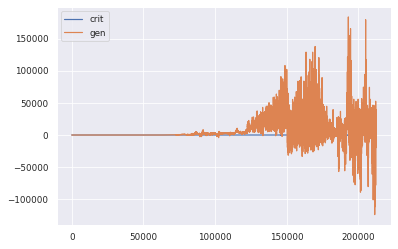

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1626 - g_loss: 20081.7259
Epoch 109/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0990 - g_loss: 13606.5939
KL Divergence Sum: 8.094003741288109 bits
Pinball Loss Temp mean: 1.4555337421156136
Pinball Loss Humid mean: 0.83340091687098
MSE Temp: 2.9110674842311863
MSE Humid: 1.6668018337419659


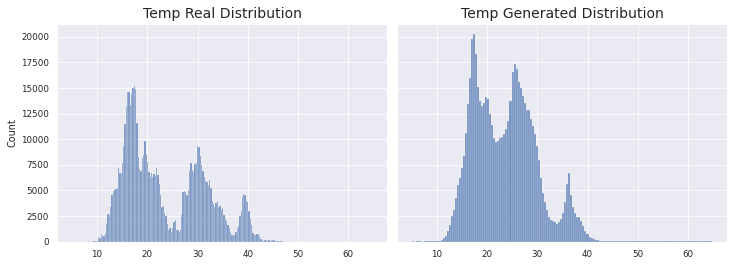

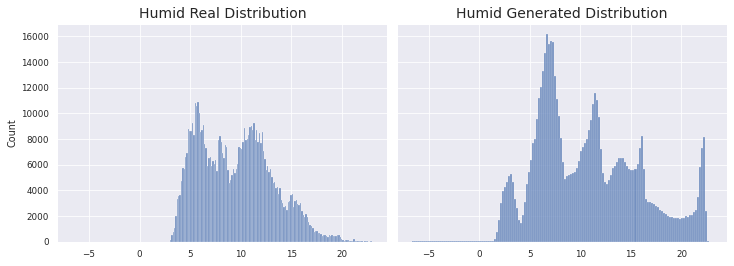

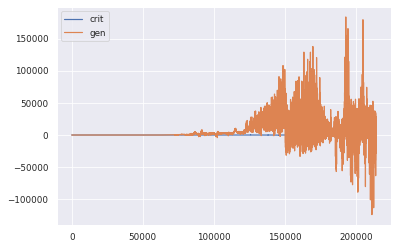

1966/1966 [==============================] - 158s 81ms/step - d_loss: 0.0989 - g_loss: 13619.6681
Epoch 110/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3273 - g_loss: 17739.8754
KL Divergence Sum: 7.946306904430932 bits
Pinball Loss Temp mean: 2.128106463623431
Pinball Loss Humid mean: 0.31175571984063233
MSE Temp: 4.256212927246945
MSE Humid: 0.6235114396812592


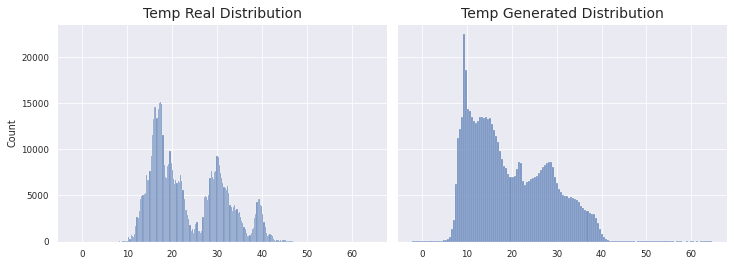

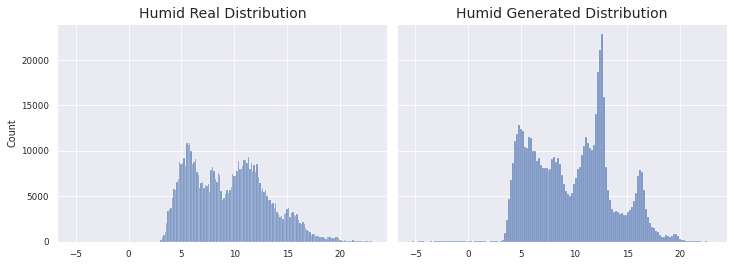

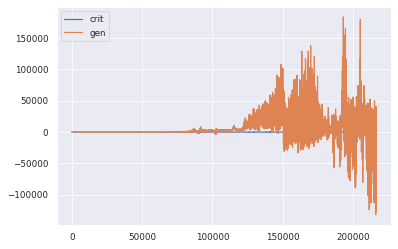

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3270 - g_loss: 17737.6525
Epoch 111/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1061 - g_loss: 14397.1222
KL Divergence Sum: 6.824602995943306 bits
Pinball Loss Temp mean: 4.664670177923478
Pinball Loss Humid mean: 0.927907691197384
MSE Temp: 9.329340355846973
MSE Humid: 1.8558153823948103


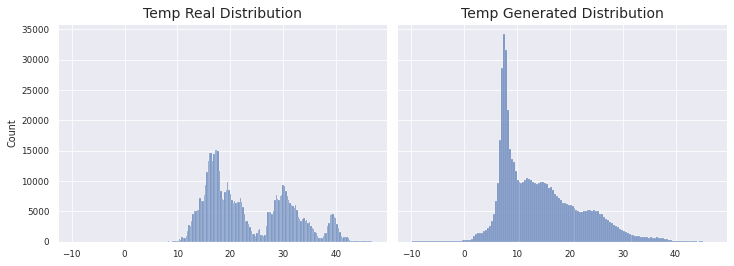

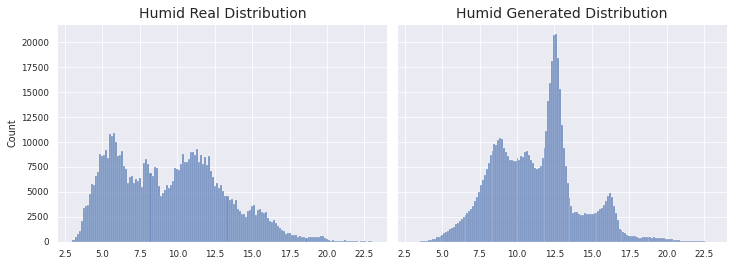

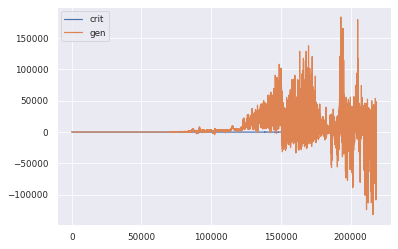

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1060 - g_loss: 14384.3302
Epoch 112/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0940 - g_loss: 16682.0405
KL Divergence Sum: 17.953557534533648 bits
Pinball Loss Temp mean: 1.2693360088972336
Pinball Loss Humid mean: 1.2266034885753991
MSE Temp: 2.5386720177944855
MSE Humid: 2.4532069771507965


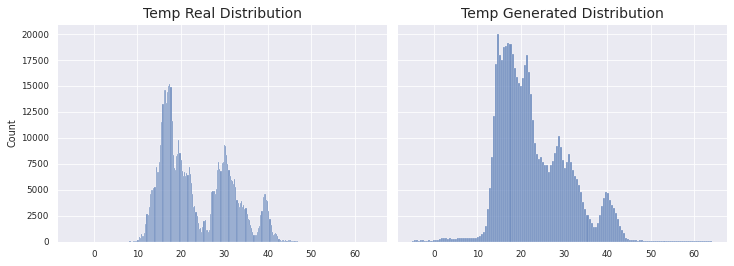

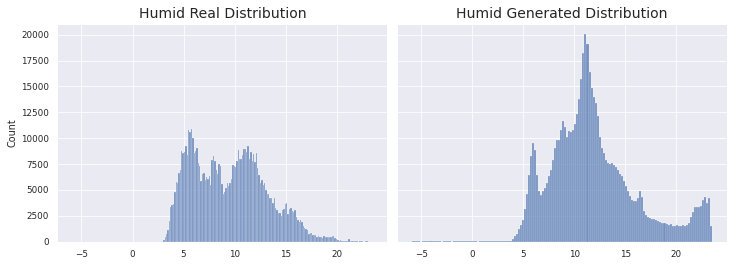

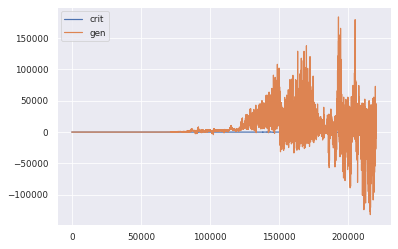

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0939 - g_loss: 16683.0466
Epoch 113/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1552 - g_loss: 14115.2152
KL Divergence Sum: 17.954688680431488 bits
Pinball Loss Temp mean: 4.60998027730691
Pinball Loss Humid mean: 0.6146978904391645
MSE Temp: 9.21996055461387
MSE Humid: 1.2293957808783418


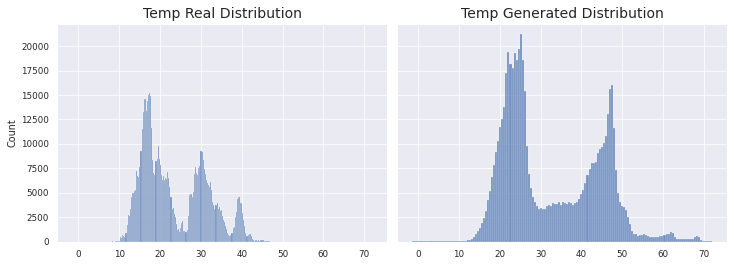

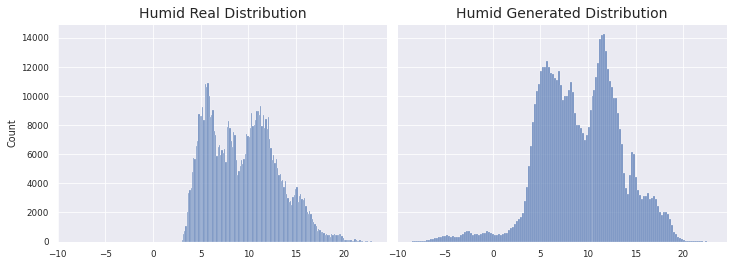

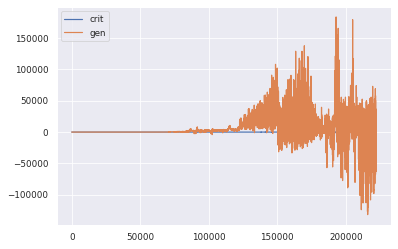

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1550 - g_loss: 14128.9892
Epoch 114/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1460 - g_loss: 19916.9306
KL Divergence Sum: 7.060808691600547 bits
Pinball Loss Temp mean: 5.037404480101456
Pinball Loss Humid mean: 2.065402803077499
MSE Temp: 10.074808960203057
MSE Humid: 4.130805606155029


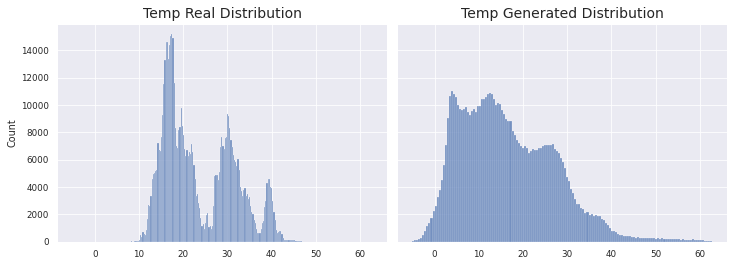

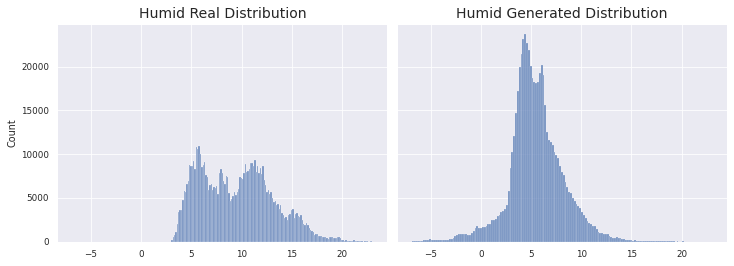

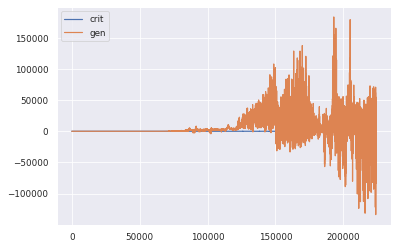

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1458 - g_loss: 19914.7783
Epoch 115/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1146 - g_loss: 16963.2502
KL Divergence Sum: 8.67310606623014 bits
Pinball Loss Temp mean: 1.3773444095456289
Pinball Loss Humid mean: 0.6493813150385057
MSE Temp: 2.7546888190912724
MSE Humid: 1.2987626300770139


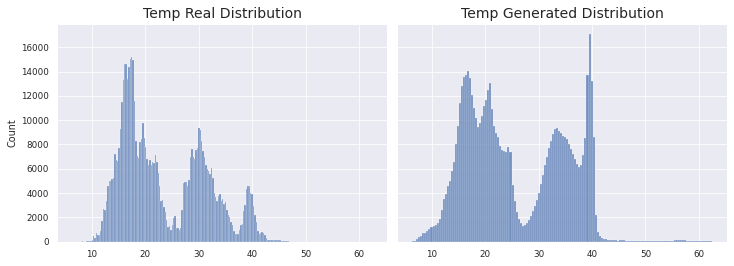

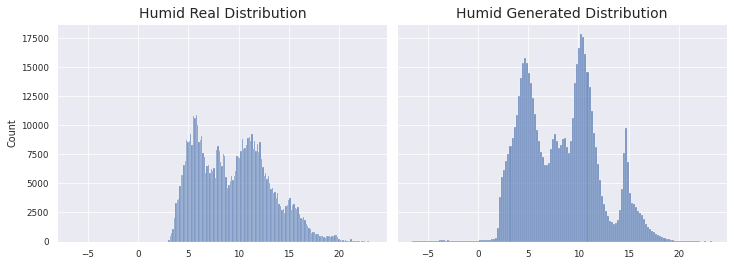

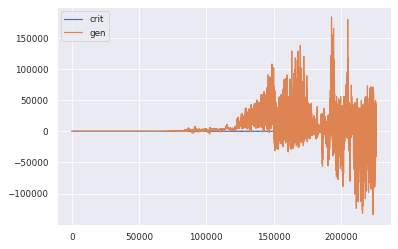

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1164 - g_loss: 16950.2475
Epoch 116/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1480 - g_loss: 17059.9922
KL Divergence Sum: 20.96991168230526 bits
Pinball Loss Temp mean: 3.9875880790784826
Pinball Loss Humid mean: 2.8267967126166975
MSE Temp: 7.975176158157025
MSE Humid: 5.65359342523334


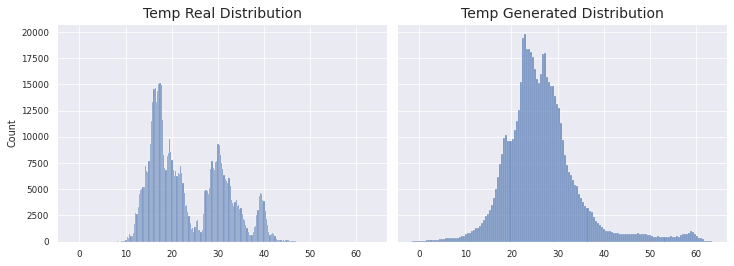

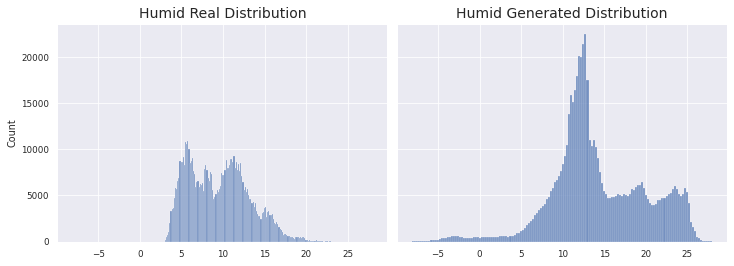

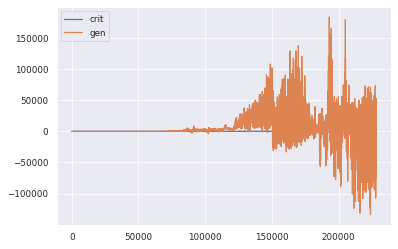

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1479 - g_loss: 17077.8396
Epoch 117/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2026 - g_loss: 22696.9184
KL Divergence Sum: 8.67370621656792 bits
Pinball Loss Temp mean: 2.453860443394909
Pinball Loss Humid mean: 0.9003950677743411
MSE Temp: 4.907720886789783
MSE Humid: 1.8007901355486737


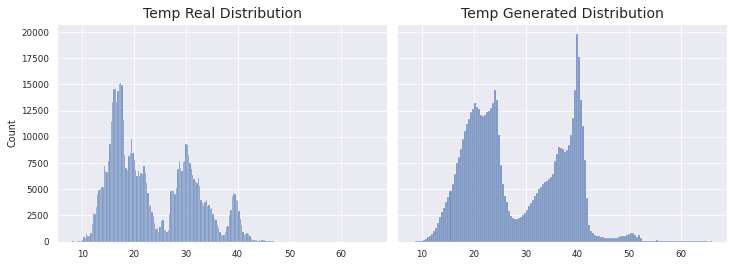

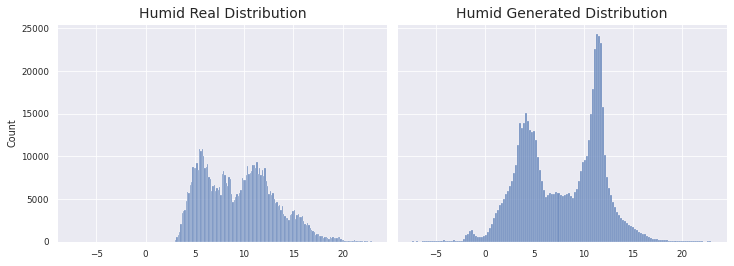

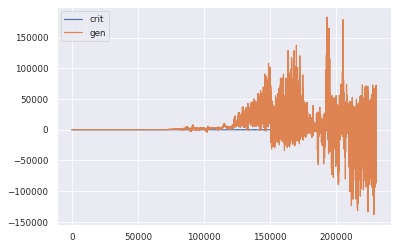

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2025 - g_loss: 22711.5201
Epoch 118/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1739 - g_loss: 25490.1114
KL Divergence Sum: 9.579511770659249 bits
Pinball Loss Temp mean: 0.858466484823324
Pinball Loss Humid mean: 0.3729126372976778
MSE Temp: 1.7169329696466678
MSE Humid: 0.7458252745953441


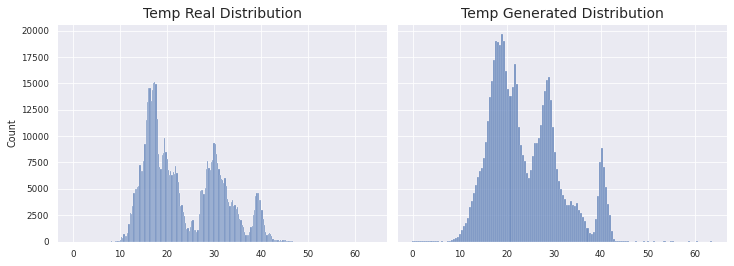

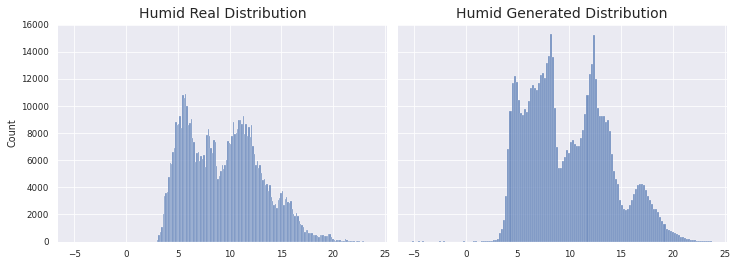

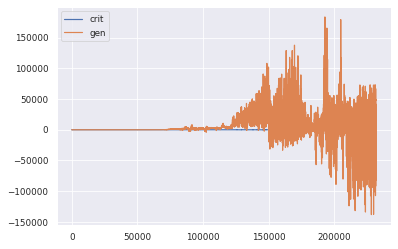

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1737 - g_loss: 25470.9393
Epoch 119/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1479 - g_loss: 2259.5312
KL Divergence Sum: 3.879627112251547 bits
Pinball Loss Temp mean: 1.63236652089777
Pinball Loss Humid mean: 1.3763877354089975
MSE Temp: 3.264733041795529
MSE Humid: 2.75277547081797


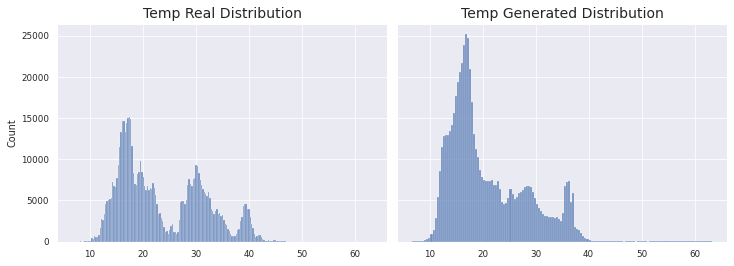

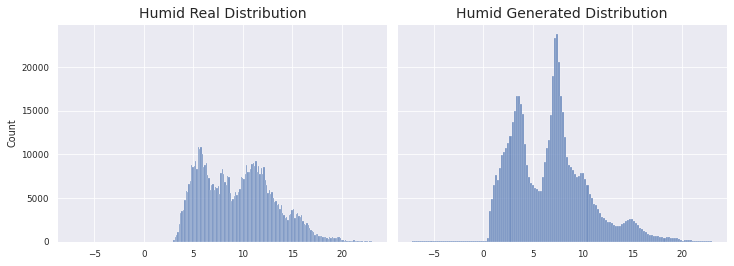

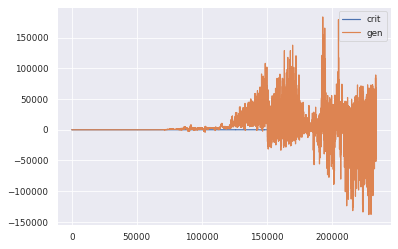

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1478 - g_loss: 2271.5881
Epoch 120/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.2661 - g_loss: 8444.1488
KL Divergence Sum: 16.229907005735306 bits
Pinball Loss Temp mean: 2.494535398334897
Pinball Loss Humid mean: 1.2605239264581054
MSE Temp: 4.9890707966698065
MSE Humid: 2.5210478529162024


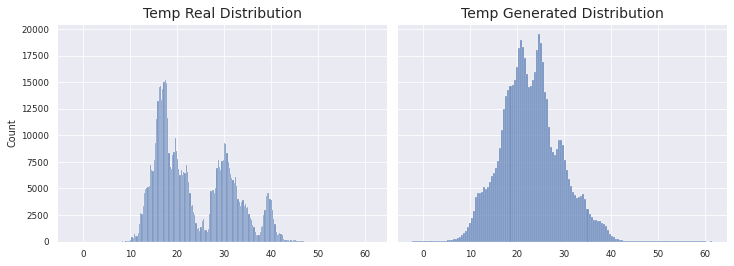

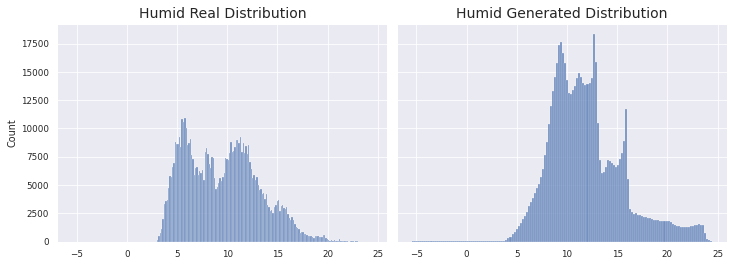

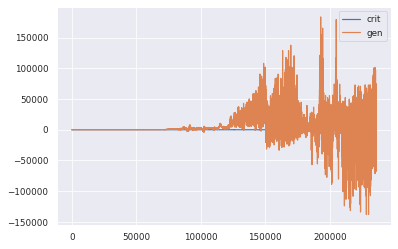

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.2659 - g_loss: 8423.8258
Epoch 121/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1208 - g_loss: 9733.5979
KL Divergence Sum: 7.558050895008401 bits
Pinball Loss Temp mean: 1.22127814193354
Pinball Loss Humid mean: 0.46554240254551393
MSE Temp: 2.442556283867045
MSE Humid: 0.931084805091024


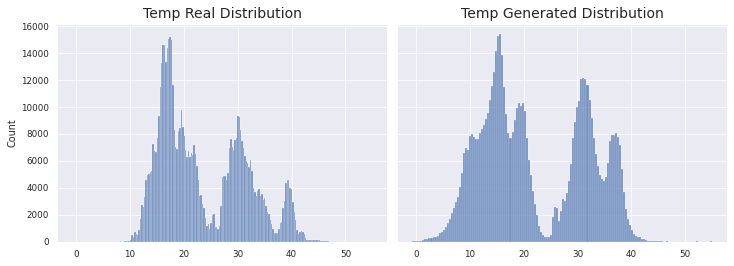

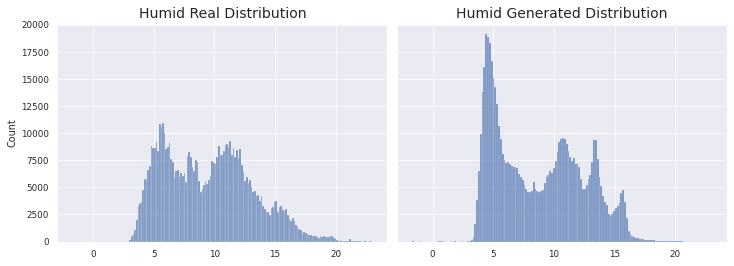

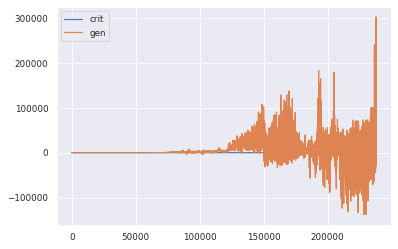

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.1715 - g_loss: 9846.3297
Epoch 122/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1577 - g_loss: 3046.3587
KL Divergence Sum: 8.18858001012908 bits
Pinball Loss Temp mean: 1.2932754091380894
Pinball Loss Humid mean: 0.38593611993836047
MSE Temp: 2.5865508182761974
MSE Humid: 0.7718722398767284


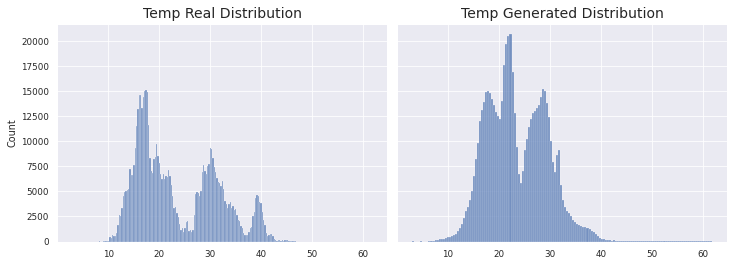

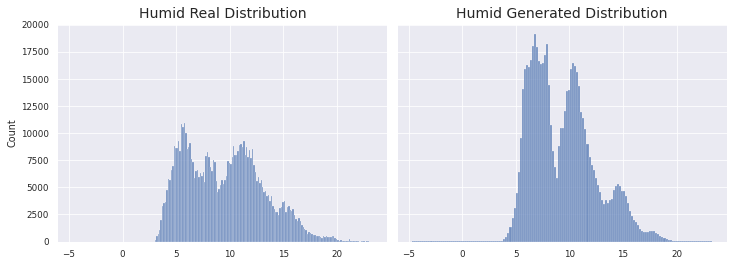

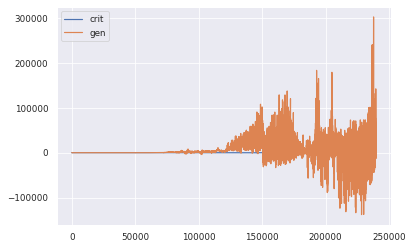

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1576 - g_loss: 3043.8737
Epoch 123/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3344 - g_loss: 2752.8810
KL Divergence Sum: 8.886206143696068 bits
Pinball Loss Temp mean: 1.3596956872560035
Pinball Loss Humid mean: 0.47892799279586085
MSE Temp: 2.719391374511991
MSE Humid: 0.9578559855917083


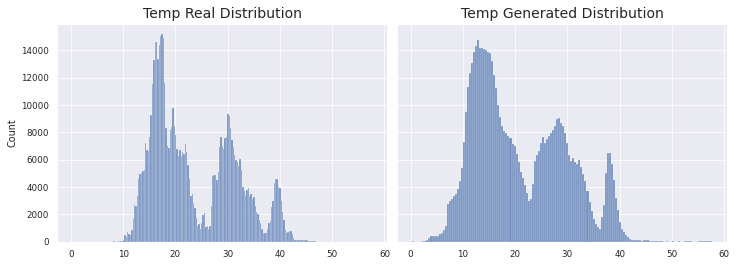

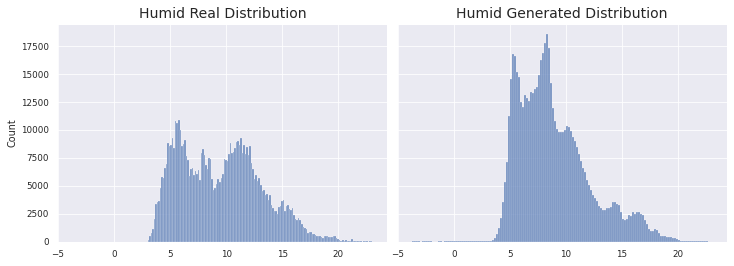

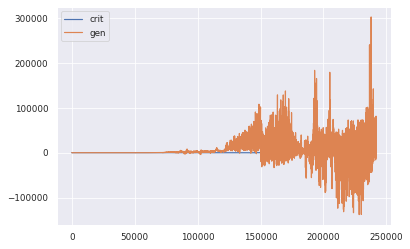

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3342 - g_loss: 2752.8061
Epoch 124/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0851 - g_loss: 1008.7320
KL Divergence Sum: 10.933570877639244 bits
Pinball Loss Temp mean: 1.0597631215148158
Pinball Loss Humid mean: 0.481414835685315
MSE Temp: 2.1195262430296395
MSE Humid: 0.9628296713706338


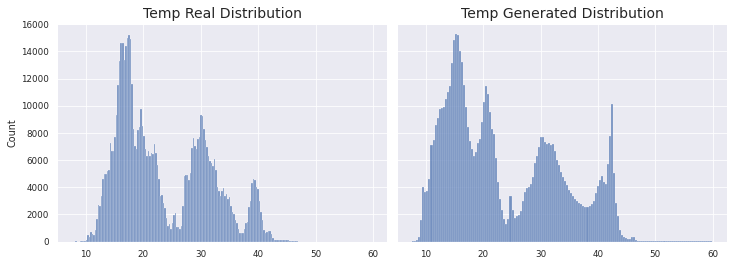

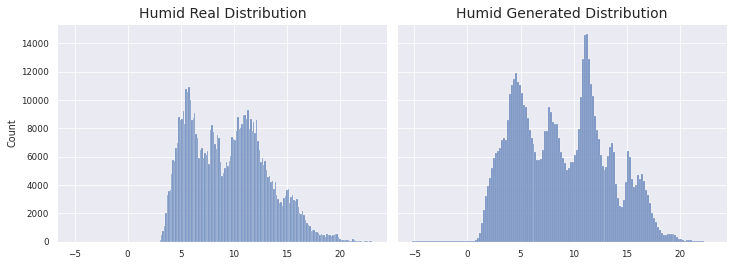

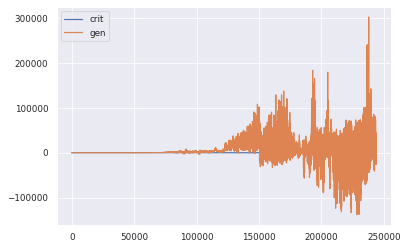

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0851 - g_loss: 994.5576
Epoch 125/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0481 - g_loss: 6808.4599
KL Divergence Sum: 10.36061514115353 bits
Pinball Loss Temp mean: 4.223270604240369
Pinball Loss Humid mean: 1.147849246405107
MSE Temp: 8.446541208480683
MSE Humid: 2.2956984928102413


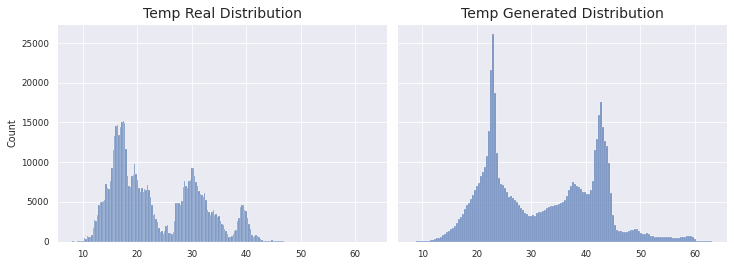

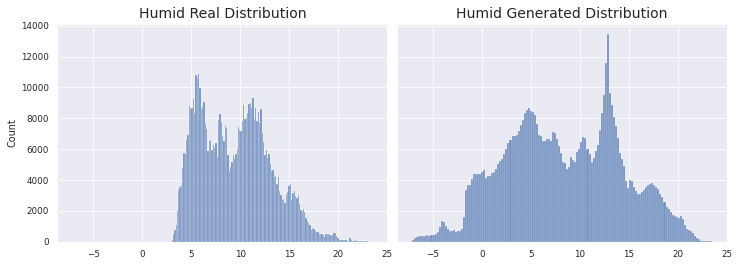

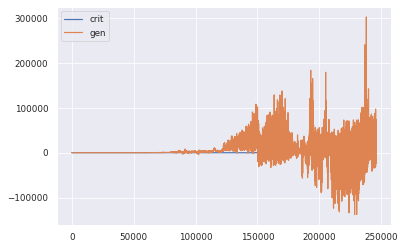

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0478 - g_loss: 6806.7724
Epoch 126/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1071 - g_loss: 5356.4307
KL Divergence Sum: 20.427503156993442 bits
Pinball Loss Temp mean: 4.00862086474163
Pinball Loss Humid mean: 2.5027347200622545
MSE Temp: 8.017241729483274
MSE Humid: 5.00546944012448


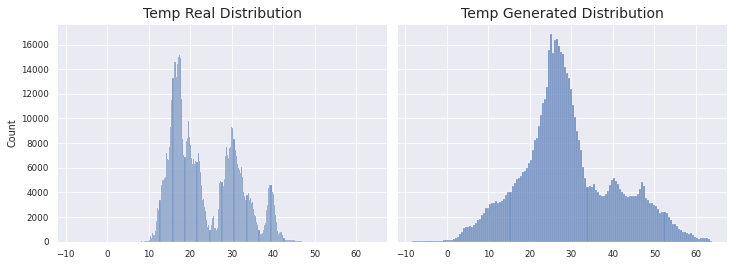

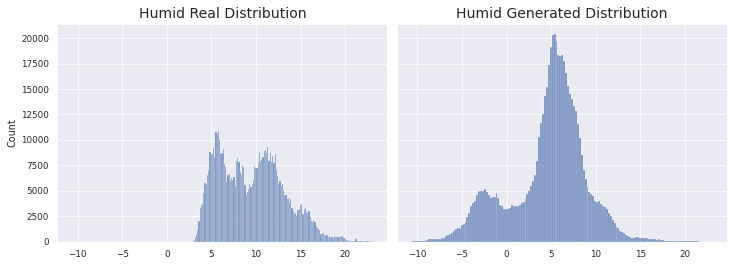

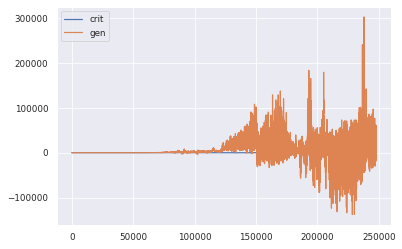

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1071 - g_loss: 5352.7237
Epoch 127/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1539 - g_loss: 8050.7160
KL Divergence Sum: 11.60939995452131 bits
Pinball Loss Temp mean: 1.2710811696194977
Pinball Loss Humid mean: 0.8079822439239065
MSE Temp: 2.54216233923899
MSE Humid: 1.6159644878478163


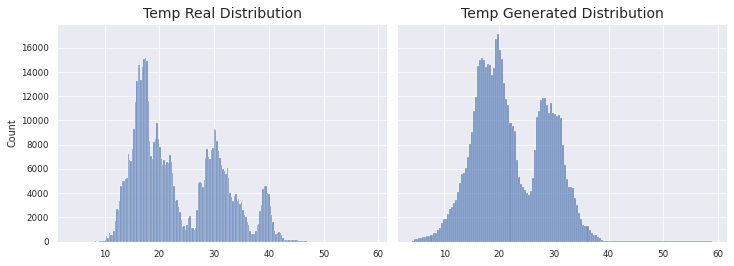

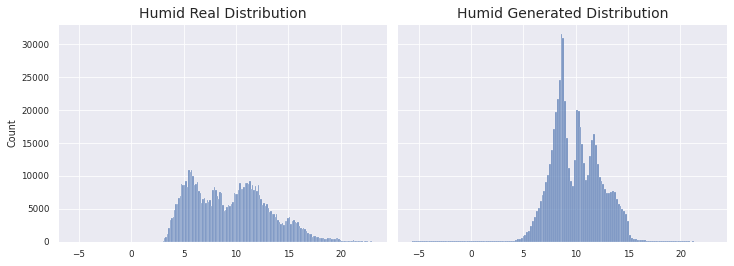

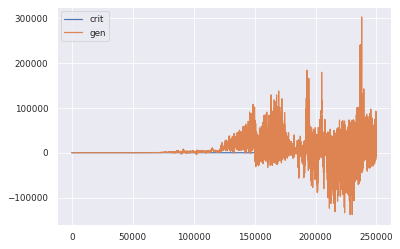

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.1537 - g_loss: 8092.0508
Epoch 128/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0923 - g_loss: 7579.7550
KL Divergence Sum: 13.735796044049211 bits
Pinball Loss Temp mean: 0.8179700759991535
Pinball Loss Humid mean: 0.4089784217419207
MSE Temp: 1.6359401519983028
MSE Humid: 0.8179568434838371


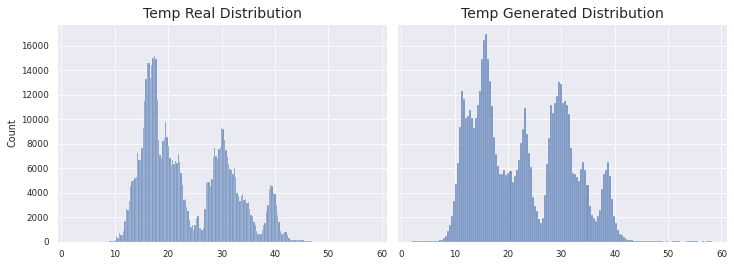

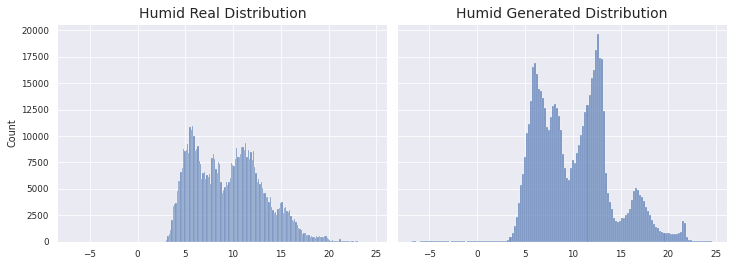

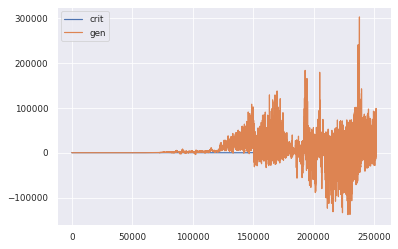

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0922 - g_loss: 7564.8354
Epoch 129/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2182 - g_loss: 9931.2378
KL Divergence Sum: 9.764211097807891 bits
Pinball Loss Temp mean: 1.613934764633975
Pinball Loss Humid mean: 0.9077903955755419
MSE Temp: 3.2278695292679545
MSE Humid: 1.8155807911510888


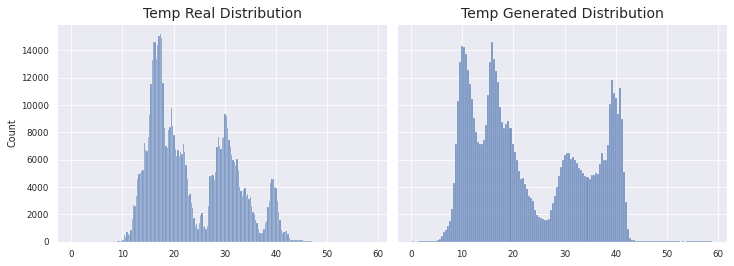

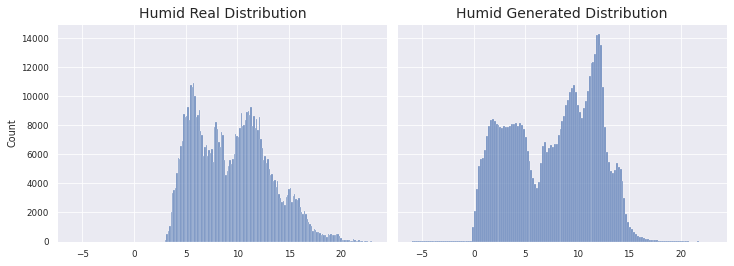

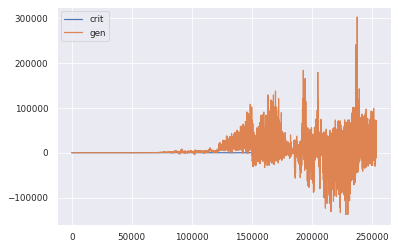

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.2180 - g_loss: 9953.0207
Epoch 130/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0331 - g_loss: 14979.1653
KL Divergence Sum: 6.187151876127759 bits
Pinball Loss Temp mean: 3.676496093906529
Pinball Loss Humid mean: 0.6349049115997341
MSE Temp: 7.352992187813097
MSE Humid: 1.2698098231994648


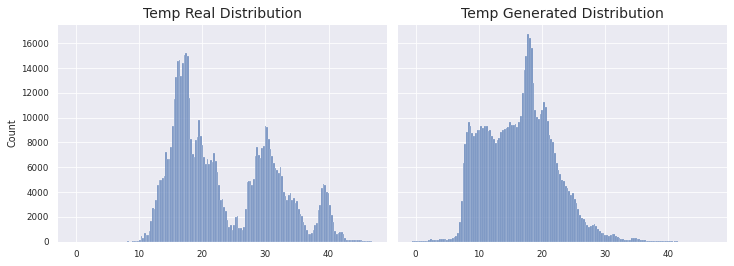

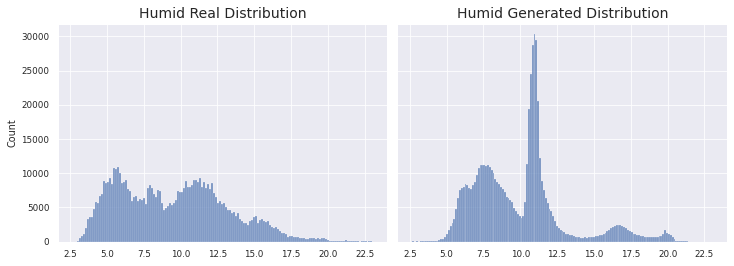

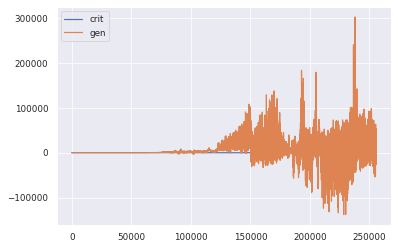

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0331 - g_loss: 14981.9215
Epoch 131/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1263 - g_loss: 5316.9482
KL Divergence Sum: 13.745931465288768 bits
Pinball Loss Temp mean: 2.1696450164417636
Pinball Loss Humid mean: 0.4033347175282935
MSE Temp: 4.339290032883529
MSE Humid: 0.8066694350565757


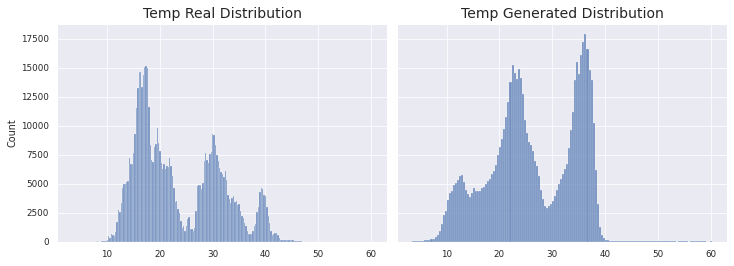

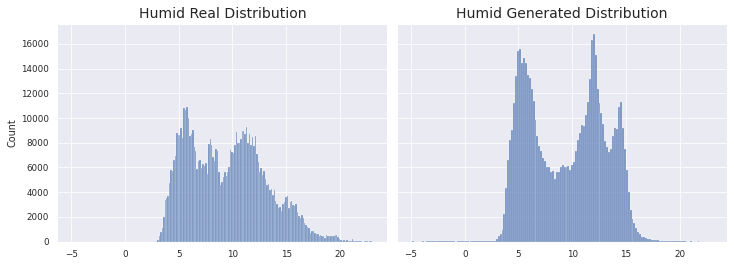

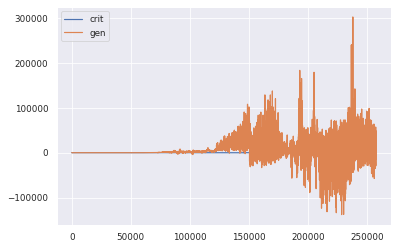

1966/1966 [==============================] - 158s 81ms/step - d_loss: 0.1261 - g_loss: 5338.5903
Epoch 132/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0498 - g_loss: 11975.8406
KL Divergence Sum: 5.851200906401313 bits
Pinball Loss Temp mean: 1.5150465518868645
Pinball Loss Humid mean: 0.6250603690350213
MSE Temp: 3.0300931037737446
MSE Humid: 1.2501207380700436


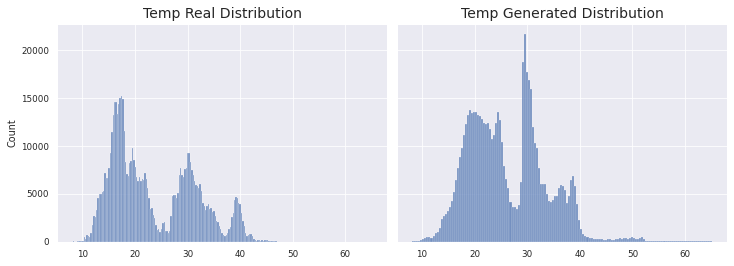

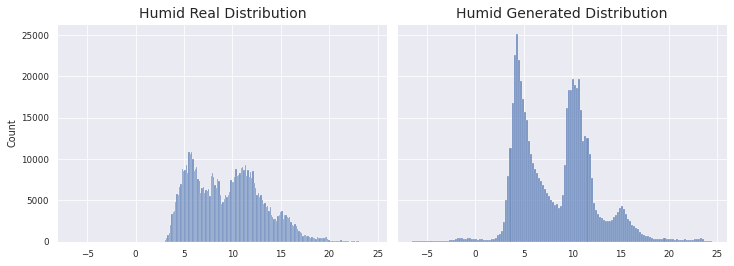

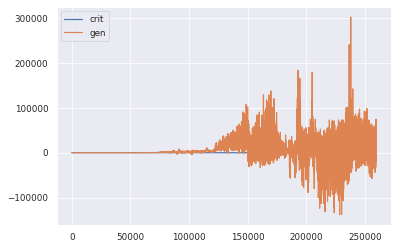

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0498 - g_loss: 11979.1613
Epoch 133/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.1528 - g_loss: 6349.5533
KL Divergence Sum: 14.024684610192072 bits
Pinball Loss Temp mean: 4.765611458668134
Pinball Loss Humid mean: 0.8527530339116731
MSE Temp: 9.531222917336335
MSE Humid: 1.705506067823351


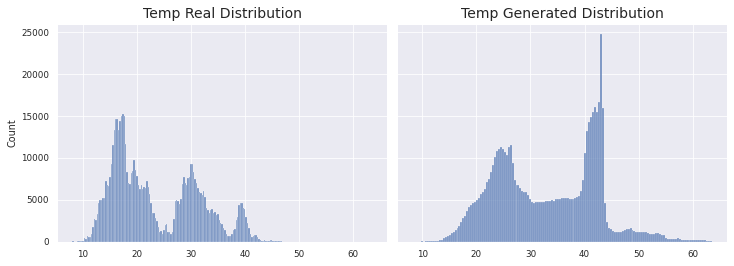

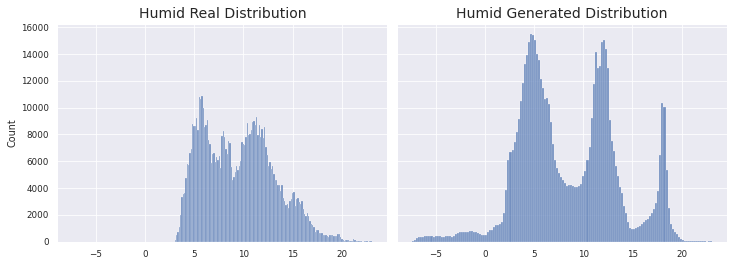

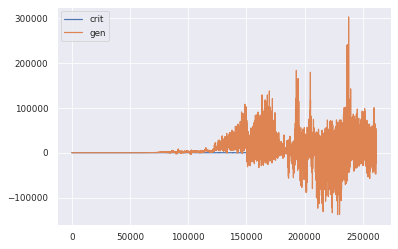

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.1528 - g_loss: 6354.4038
Epoch 134/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1222 - g_loss: 8413.4103
KL Divergence Sum: 5.2379421823463534 bits
Pinball Loss Temp mean: 1.334592557987261
Pinball Loss Humid mean: 0.5132843278802068
MSE Temp: 2.669185115974507
MSE Humid: 1.0265686557604263


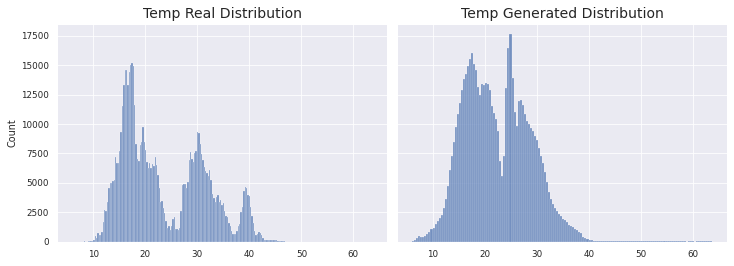

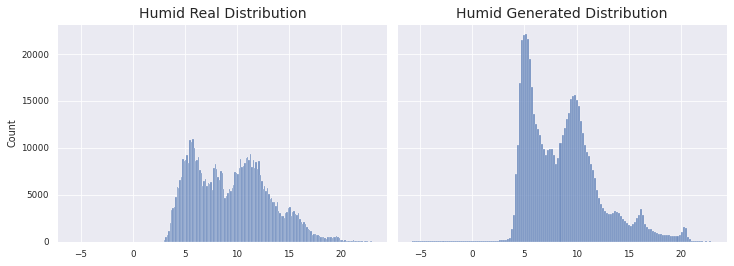

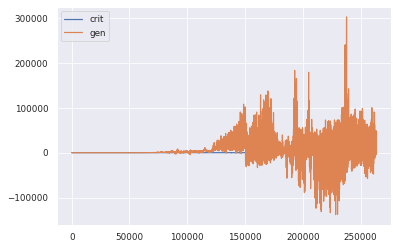

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.1220 - g_loss: 8439.3976
Epoch 135/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0413 - g_loss: 4522.6943
KL Divergence Sum: 15.260031580184606 bits
Pinball Loss Temp mean: 1.1665269422131976
Pinball Loss Humid mean: 0.7661350588683054
MSE Temp: 2.3330538844263446
MSE Humid: 1.5322701177366502


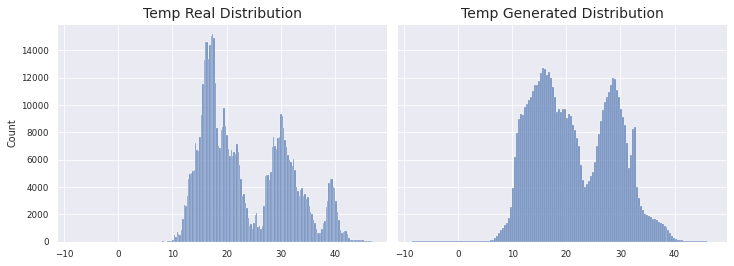

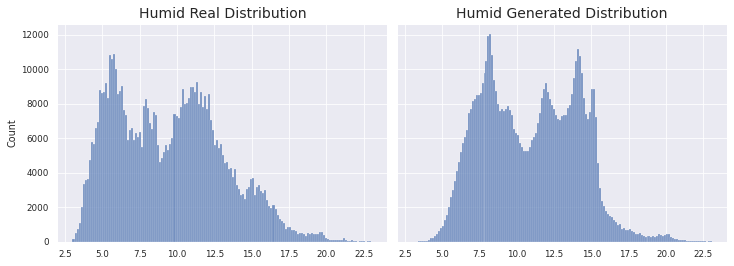

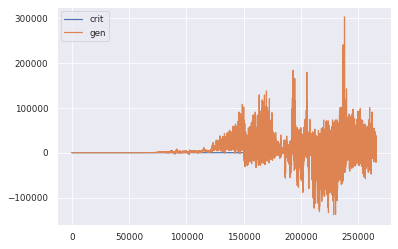

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.0413 - g_loss: 4526.7682
Epoch 136/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0314 - g_loss: 8822.1716
KL Divergence Sum: 10.251959229104811 bits
Pinball Loss Temp mean: 2.31818658413981
Pinball Loss Humid mean: 0.466452319030071
MSE Temp: 4.636373168279645
MSE Humid: 0.9329046380601459


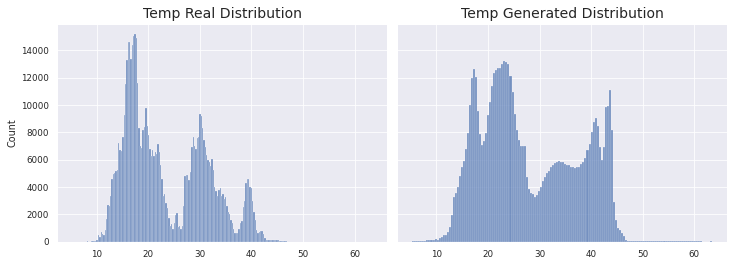

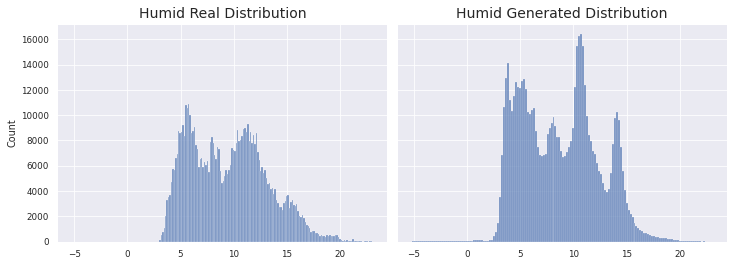

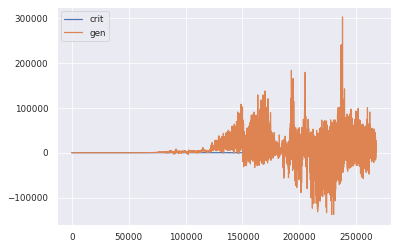

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0317 - g_loss: 8821.6385
Epoch 137/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2120 - g_loss: 13597.7180
KL Divergence Sum: 12.319086784235223 bits
Pinball Loss Temp mean: 2.4520313550235358
Pinball Loss Humid mean: 0.6717295763462424
MSE Temp: 4.904062710047135
MSE Humid: 1.3434591526924722


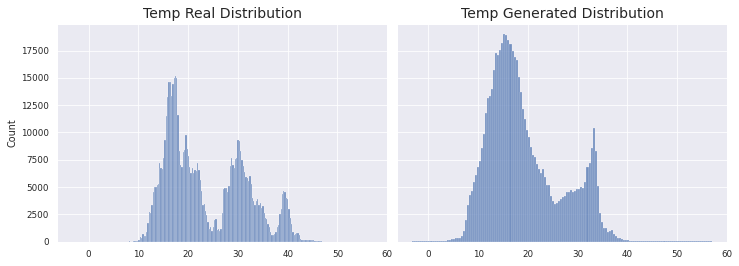

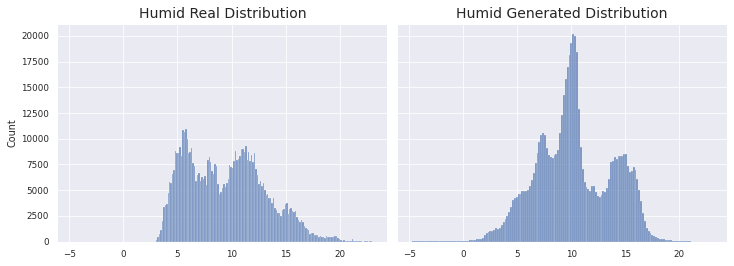

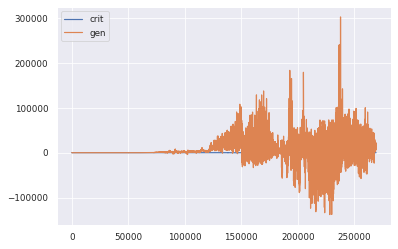

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.2119 - g_loss: 13594.7910
Epoch 138/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.0223 - g_loss: 17667.9780
KL Divergence Sum: 18.708343800578387 bits
Pinball Loss Temp mean: 1.2281105982229659
Pinball Loss Humid mean: 0.5406997383517027
MSE Temp: 2.456221196445924
MSE Humid: 1.0813994767033976


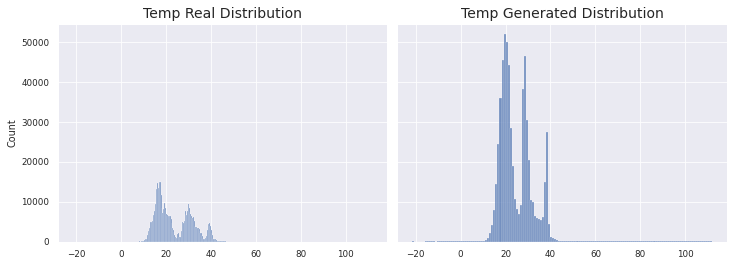

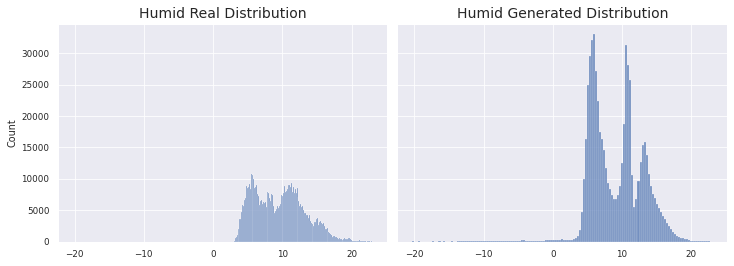

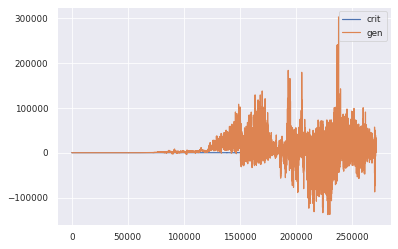

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0224 - g_loss: 17662.6107
Epoch 139/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0656 - g_loss: 24763.3377
KL Divergence Sum: 10.829880170498198 bits
Pinball Loss Temp mean: 1.7512767190221268
Pinball Loss Humid mean: 0.711162668430845
MSE Temp: 3.502553438044221
MSE Humid: 1.4223253368617084


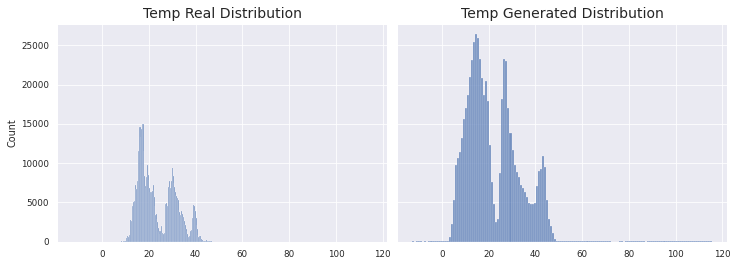

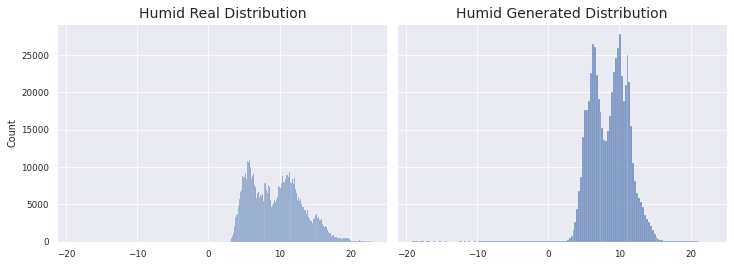

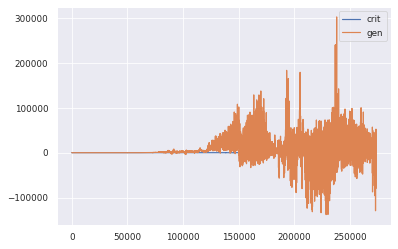

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.0656 - g_loss: 24756.7166
Epoch 140/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.7243 - g_loss: 29688.4180
KL Divergence Sum: 12.689613808852949 bits
Pinball Loss Temp mean: 6.46669357420635
Pinball Loss Humid mean: 3.1269136447780843
MSE Temp: 12.93338714841287
MSE Humid: 6.25382728955616


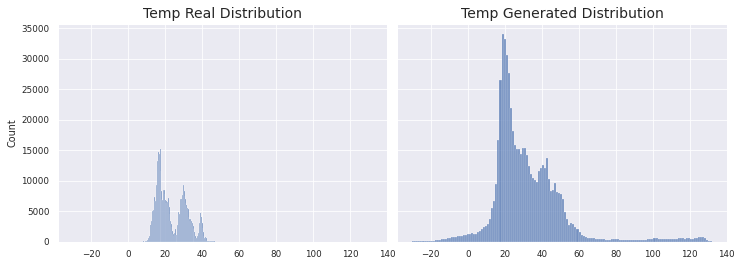

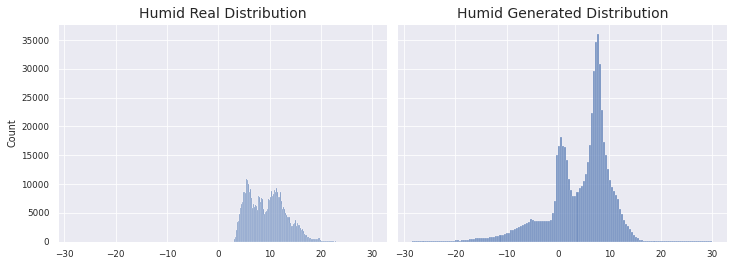

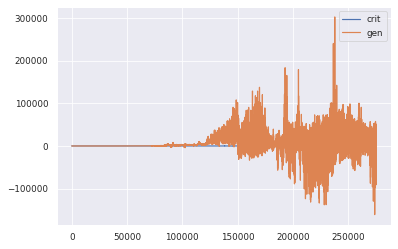

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.7235 - g_loss: 29693.2236
Epoch 141/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0816 - g_loss: 29680.2901
KL Divergence Sum: 4.321619171541021 bits
Pinball Loss Temp mean: 1.9657429206846238
Pinball Loss Humid mean: 0.6439622361962541
MSE Temp: 3.9314858413692875
MSE Humid: 1.287924472392492


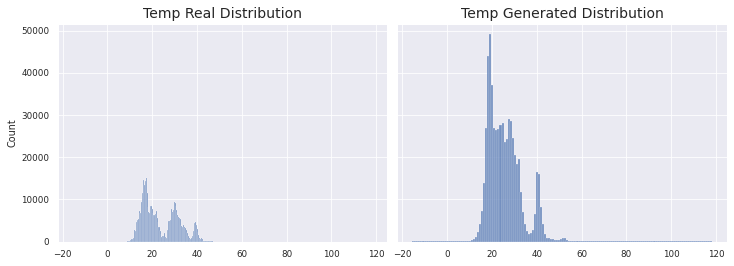

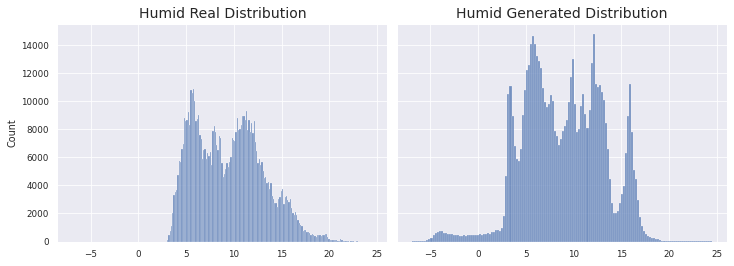

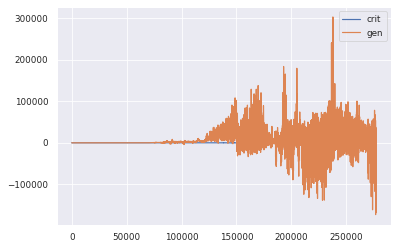

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0815 - g_loss: 29682.7383
Epoch 142/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1660 - g_loss: 25984.8399
KL Divergence Sum: 3.2774345350560687 bits
Pinball Loss Temp mean: 2.5985560632029565
Pinball Loss Humid mean: 1.9743003030334183
MSE Temp: 5.1971121264059335
MSE Humid: 3.948600606066755


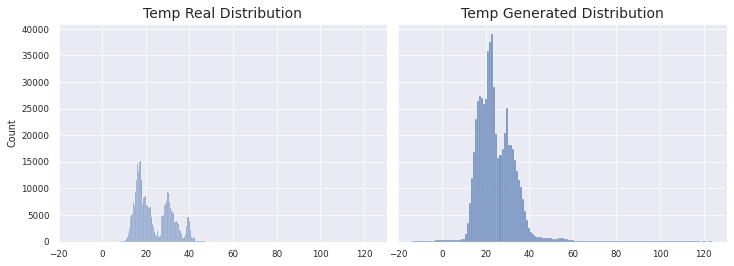

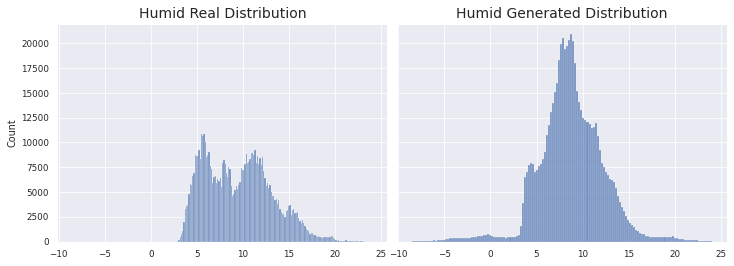

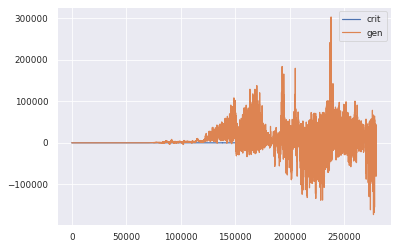

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.1658 - g_loss: 25992.1785
Epoch 143/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0285 - g_loss: 33923.1189
KL Divergence Sum: 8.550400284535879 bits
Pinball Loss Temp mean: 1.5829594210601576
Pinball Loss Humid mean: 1.1930666621463342
MSE Temp: 3.165918842120314
MSE Humid: 2.386133324292674


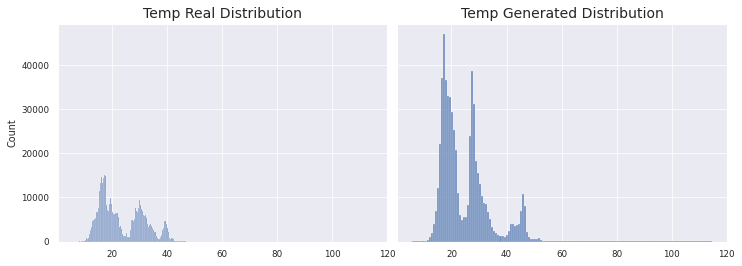

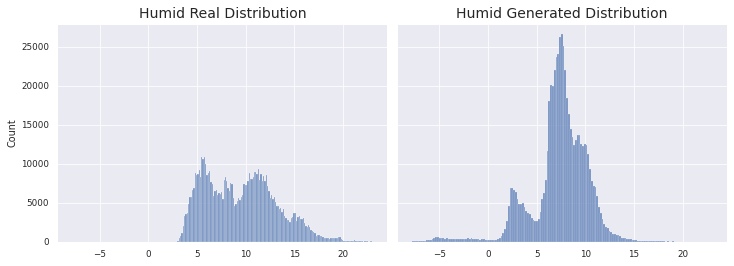

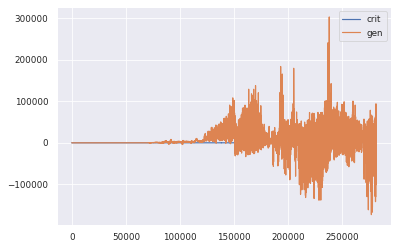

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0284 - g_loss: 33936.1648
Epoch 144/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3259 - g_loss: 36619.4167
KL Divergence Sum: 3.4516490061548497 bits
Pinball Loss Temp mean: 3.871490828446884
Pinball Loss Humid mean: 1.3513047234414137
MSE Temp: 7.742981656893697
MSE Humid: 2.7026094468828155


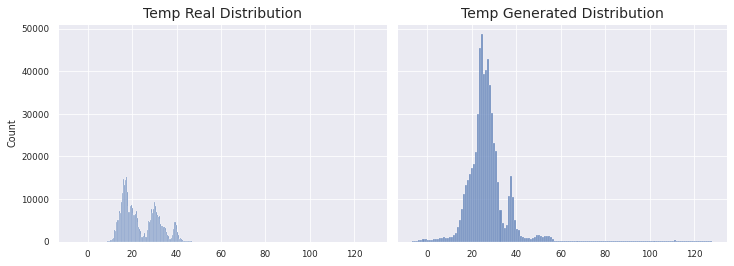

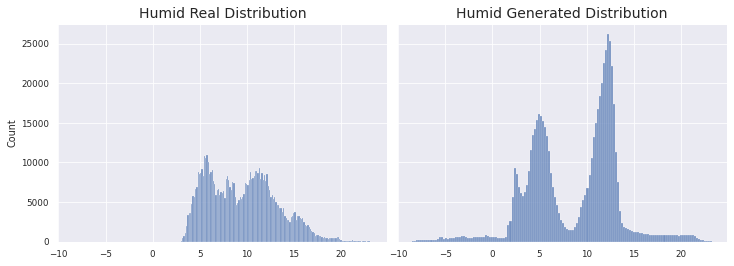

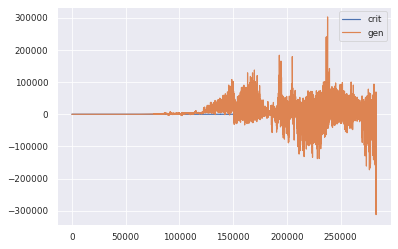

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.3254 - g_loss: 36616.8722
Epoch 145/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3660 - g_loss: 26932.9253
KL Divergence Sum: 22.509702393110654 bits
Pinball Loss Temp mean: 3.952817635089538
Pinball Loss Humid mean: 1.6028833557043192
MSE Temp: 7.905635270178991
MSE Humid: 3.205766711408631


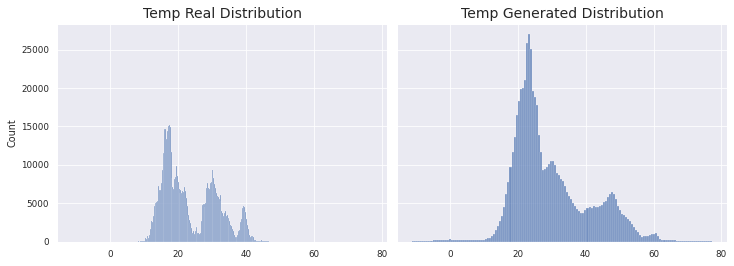

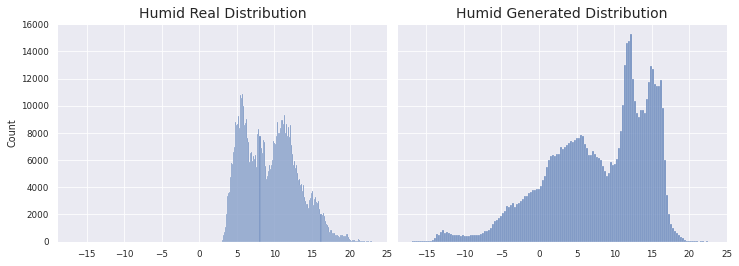

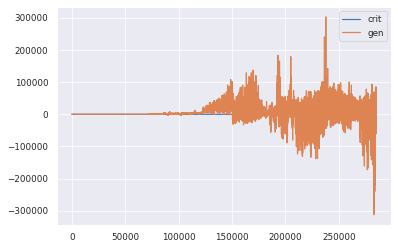

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.3658 - g_loss: 26930.5926
Epoch 146/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0041 - g_loss: 36547.9353
KL Divergence Sum: 6.665593798010371 bits
Pinball Loss Temp mean: 1.9790108950058733
Pinball Loss Humid mean: 0.6624520299808054
MSE Temp: 3.9580217900117494
MSE Humid: 1.3249040599615942


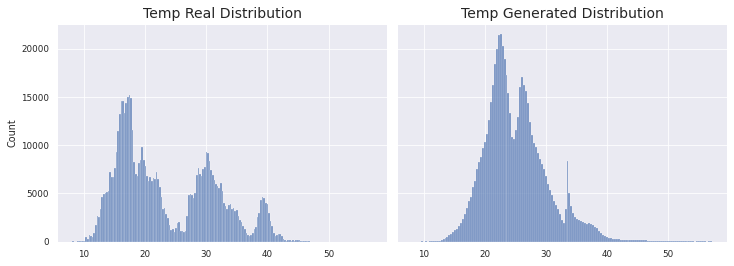

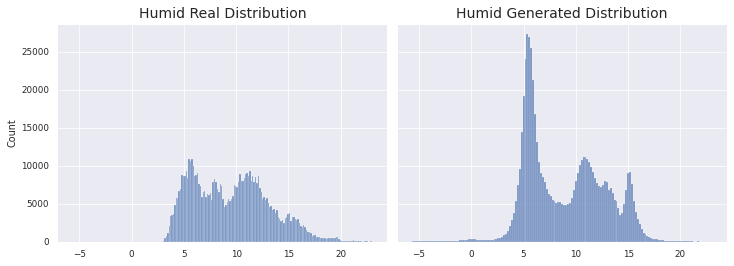

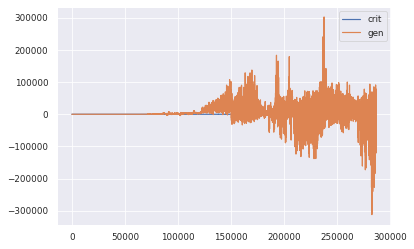

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.0041 - g_loss: 36567.4114
Epoch 147/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6292 - g_loss: 36169.2566
KL Divergence Sum: 13.71928378625547 bits
Pinball Loss Temp mean: 3.1900603384231783
Pinball Loss Humid mean: 2.010685160923217
MSE Temp: 6.380120676846435
MSE Humid: 4.021370321846461


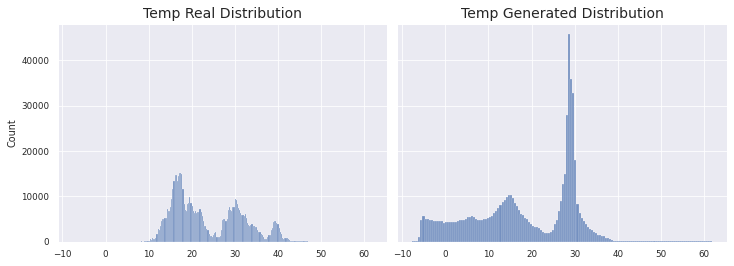

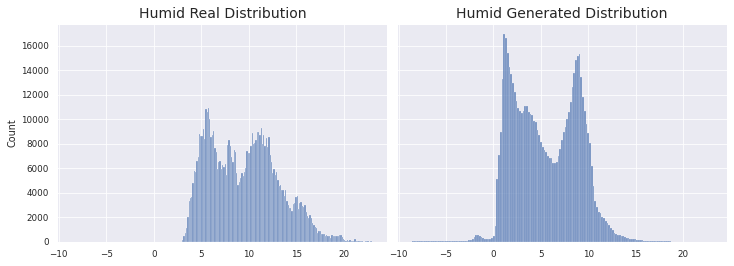

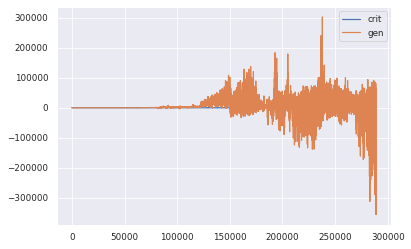

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.6286 - g_loss: 36182.3320
Epoch 148/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3385 - g_loss: 39164.8720
KL Divergence Sum: 16.37654528350991 bits
Pinball Loss Temp mean: 4.333254627013551
Pinball Loss Humid mean: 1.8373344025866807
MSE Temp: 8.666509254027199
MSE Humid: 3.674668805173341


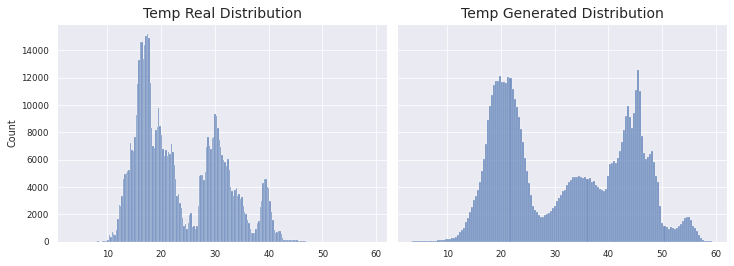

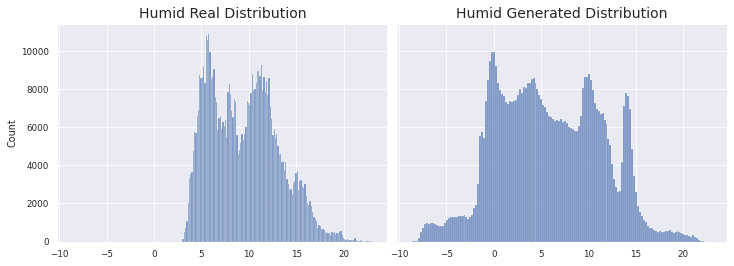

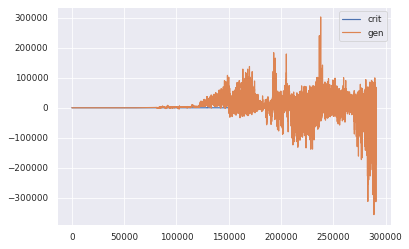

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3382 - g_loss: 39169.8146
Epoch 149/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1737 - g_loss: 38611.7872
KL Divergence Sum: 9.875354959882486 bits
Pinball Loss Temp mean: 1.3510375701941488
Pinball Loss Humid mean: 0.7427603565188223
MSE Temp: 2.7020751403883017
MSE Humid: 1.4855207130376311


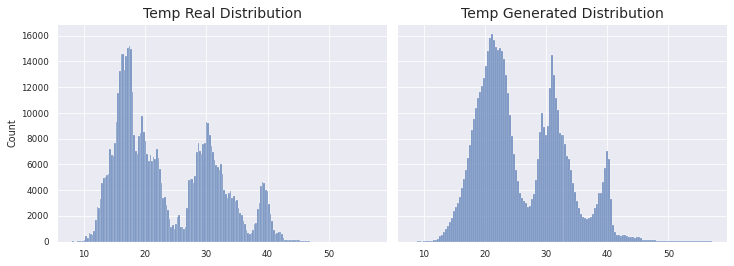

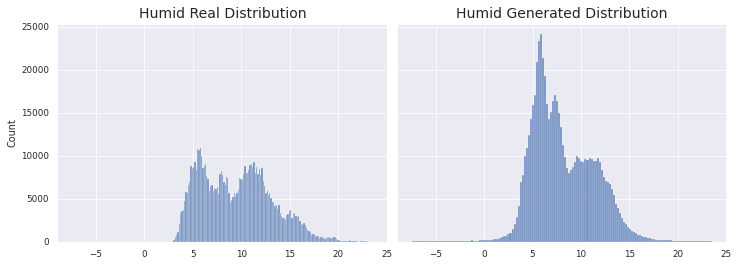

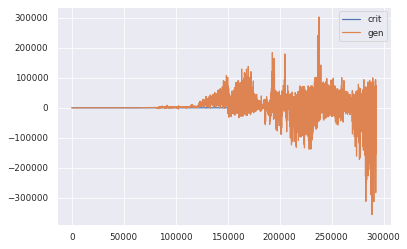

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.1736 - g_loss: 38620.8645
Epoch 150/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2056 - g_loss: 39018.1147
KL Divergence Sum: 7.061813860974829 bits
Pinball Loss Temp mean: 2.53515397403793
Pinball Loss Humid mean: 1.6901178965962949
MSE Temp: 5.070307948075889
MSE Humid: 3.380235793192607


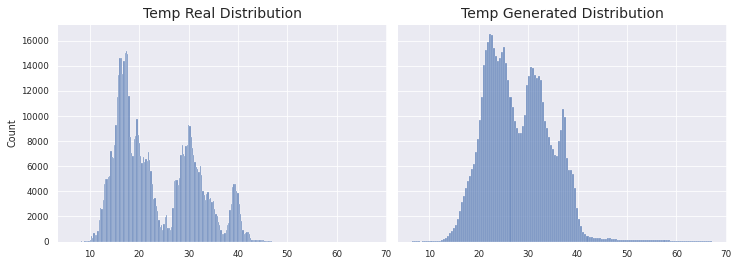

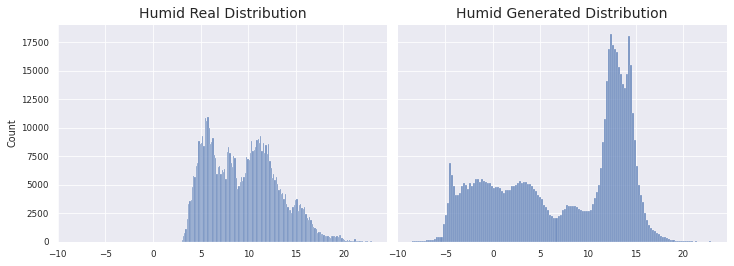

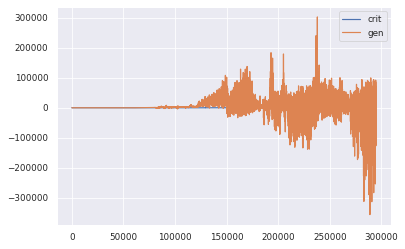

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.2047 - g_loss: 39009.6440
Epoch 151/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.0995 - g_loss: 48780.7908
KL Divergence Sum: 17.213225169556225 bits
Pinball Loss Temp mean: 1.9495793566242547
Pinball Loss Humid mean: 0.6652739596315305
MSE Temp: 3.899158713248506
MSE Humid: 1.3305479192630536


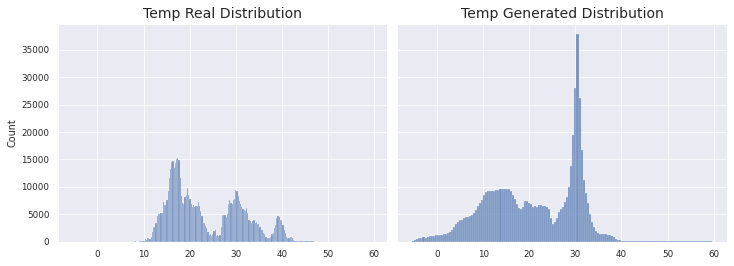

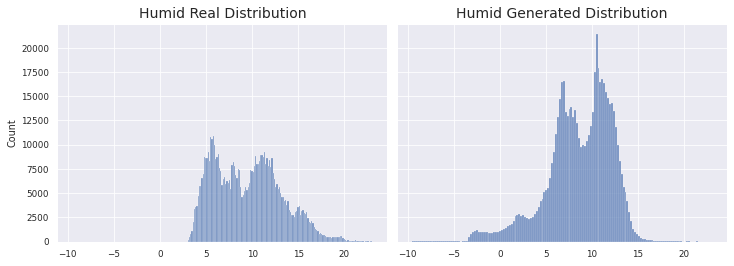

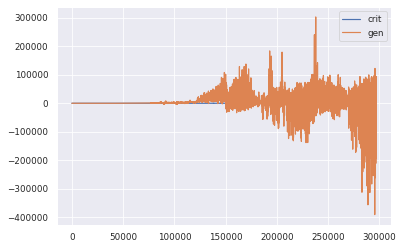

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0994 - g_loss: 48772.7759
Epoch 152/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1009 - g_loss: 45326.1026
KL Divergence Sum: 20.5339531556333 bits
Pinball Loss Temp mean: 1.3076100156398591
Pinball Loss Humid mean: 0.5284361891189608
MSE Temp: 2.615220031279715
MSE Humid: 1.0568723782379206


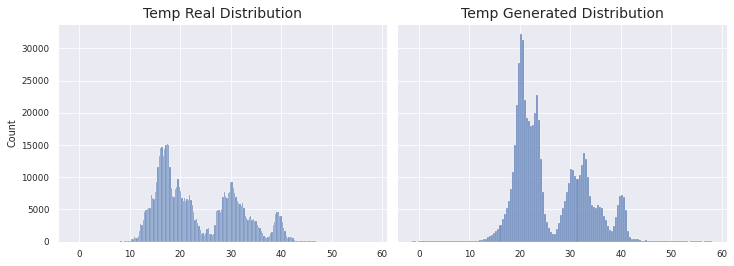

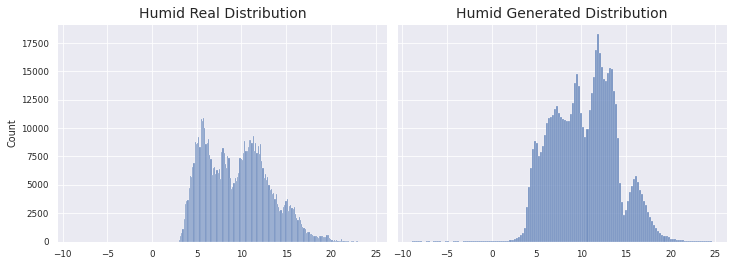

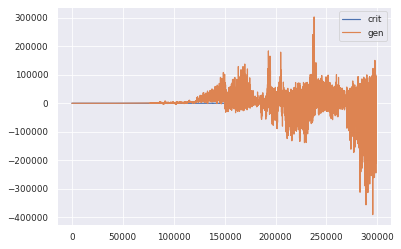

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1009 - g_loss: 45326.6012
Epoch 153/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2783 - g_loss: 39142.2070
KL Divergence Sum: 21.225747450184652 bits
Pinball Loss Temp mean: 1.592703714947703
Pinball Loss Humid mean: 1.294132995164071
MSE Temp: 3.1854074298954043
MSE Humid: 2.5882659903281677


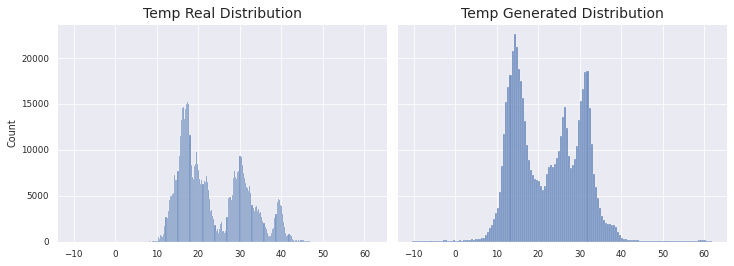

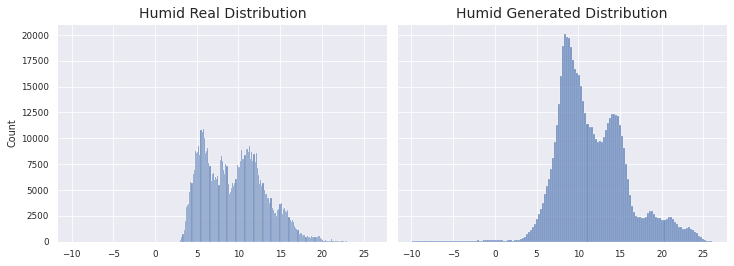

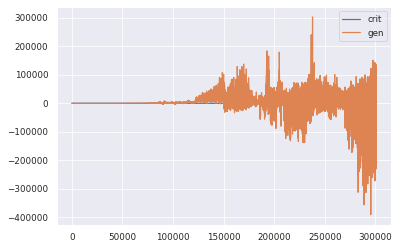

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.2778 - g_loss: 39171.7597
Epoch 154/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0223 - g_loss: 52037.8873
KL Divergence Sum: 12.205046949311038 bits
Pinball Loss Temp mean: 4.326502196277448
Pinball Loss Humid mean: 1.7116180041767126
MSE Temp: 8.653004392554918
MSE Humid: 3.4232360083534252


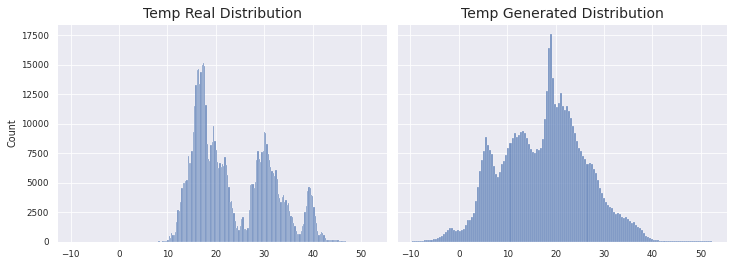

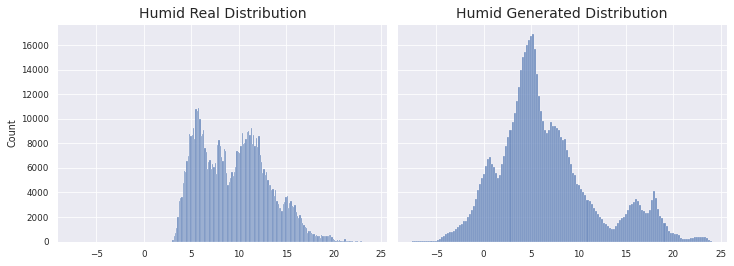

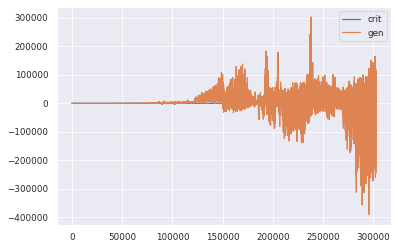

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0221 - g_loss: 52035.2646
Epoch 155/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3303 - g_loss: 58692.6396
KL Divergence Sum: 25.159312978455194 bits
Pinball Loss Temp mean: 1.7578198819609985
Pinball Loss Humid mean: 1.1677743200773665
MSE Temp: 3.5156397639220462
MSE Humid: 2.3355486401547134


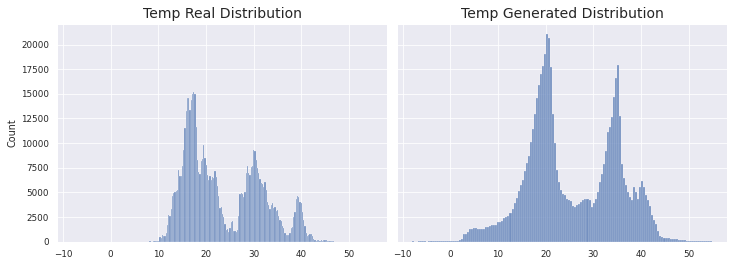

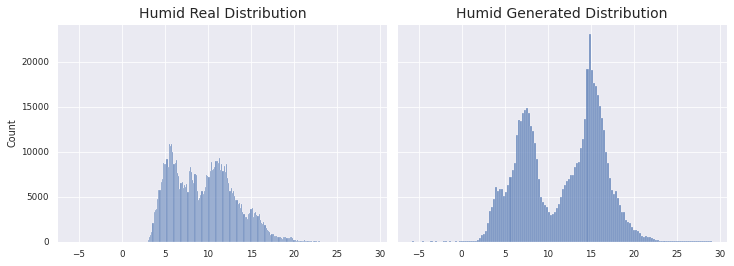

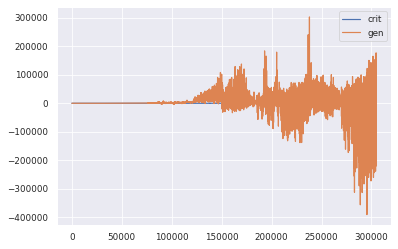

1966/1966 [==============================] - 156s 80ms/step - d_loss: 0.3297 - g_loss: 58679.7824
Epoch 156/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1084 - g_loss: 32769.4497
KL Divergence Sum: 11.425283770207807 bits
Pinball Loss Temp mean: 2.1385287077632142
Pinball Loss Humid mean: 1.3793214107085807
MSE Temp: 4.277057415526429
MSE Humid: 2.7586428214171197


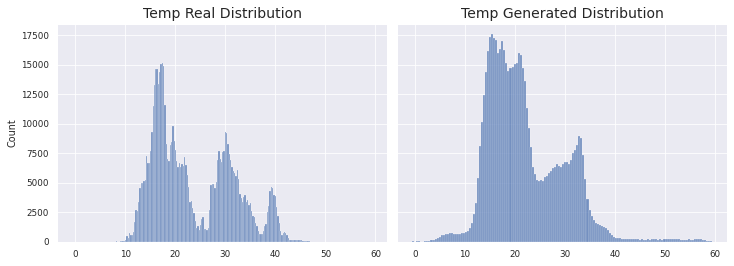

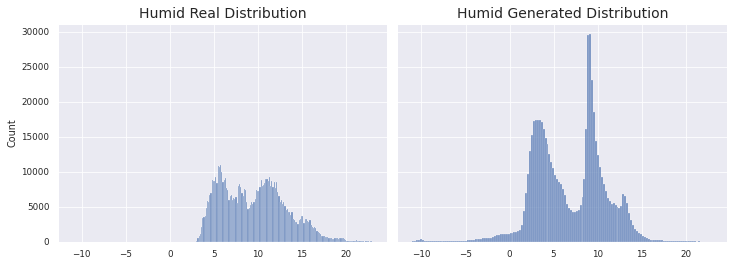

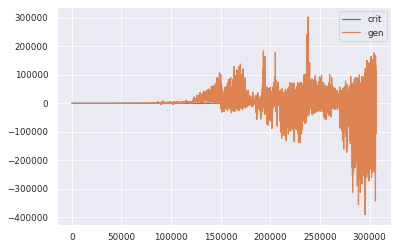

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0672 - g_loss: 32788.3771
Epoch 157/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0890 - g_loss: 22240.2700
KL Divergence Sum: 20.74572657078786 bits
Pinball Loss Temp mean: 5.086405204640624
Pinball Loss Humid mean: 2.507069848523771
MSE Temp: 10.17281040928129
MSE Humid: 5.0141396970475425


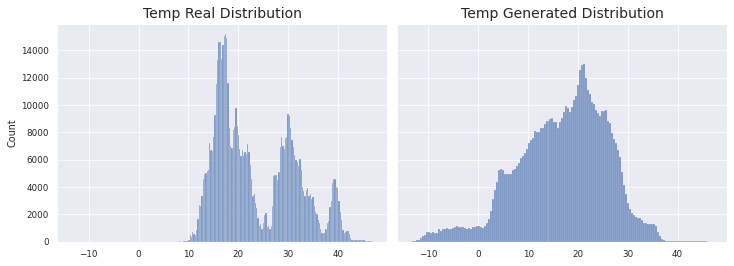

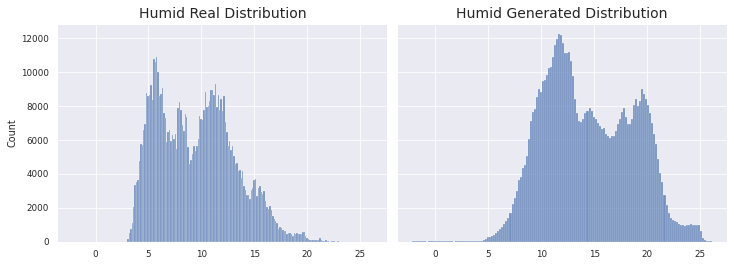

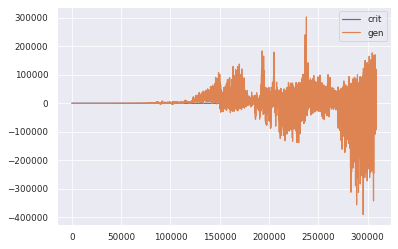

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.0893 - g_loss: 22203.3469
Epoch 158/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3715 - g_loss: 19342.3653
KL Divergence Sum: 21.75581693676789 bits
Pinball Loss Temp mean: 2.3879818737951672
Pinball Loss Humid mean: 1.7464733920508582
MSE Temp: 4.7759637475903824
MSE Humid: 3.4929467841016972


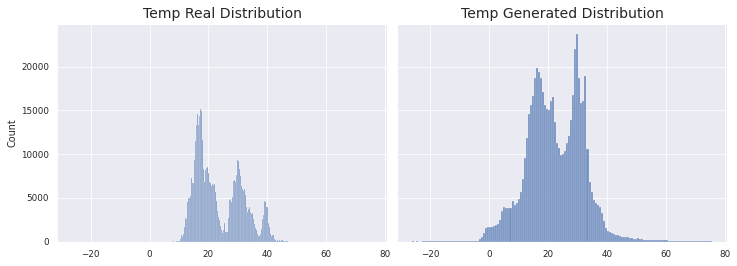

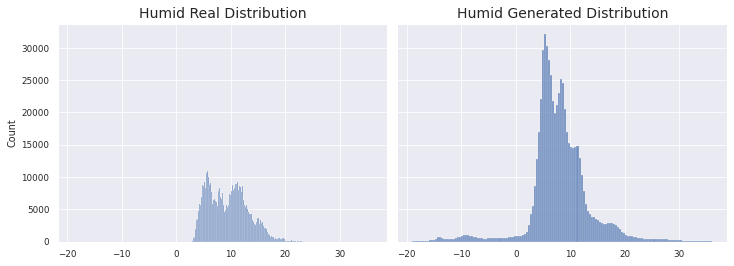

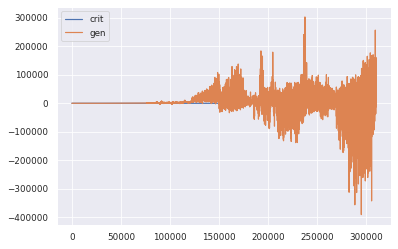

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.3712 - g_loss: 19372.4172
Epoch 159/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.1283 - g_loss: 11699.0047
KL Divergence Sum: 20.114008261246656 bits
Pinball Loss Temp mean: 3.197351415716348
Pinball Loss Humid mean: 1.403382939862995
MSE Temp: 6.394702831432716
MSE Humid: 2.8067658797260115


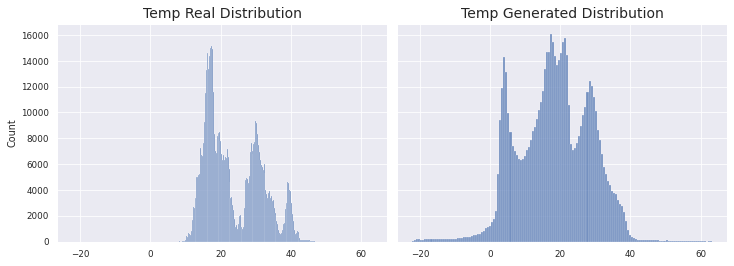

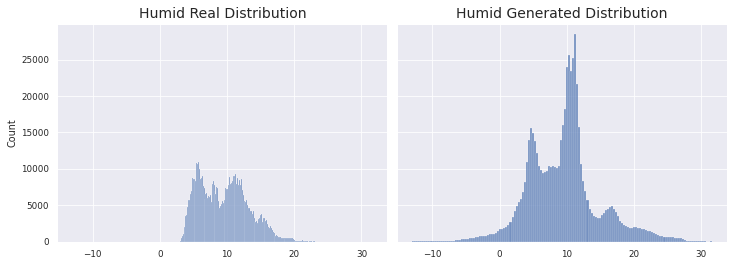

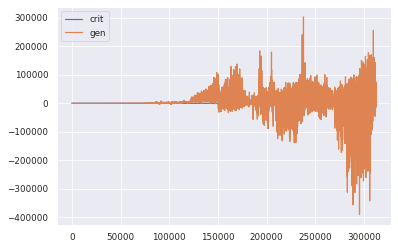

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.1282 - g_loss: 11705.3386
Epoch 160/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5586 - g_loss: 21459.4780
KL Divergence Sum: 15.303613659155532 bits
Pinball Loss Temp mean: 3.082923130218252
Pinball Loss Humid mean: 3.239374212807037
MSE Temp: 6.165846260436704
MSE Humid: 6.478748425614081


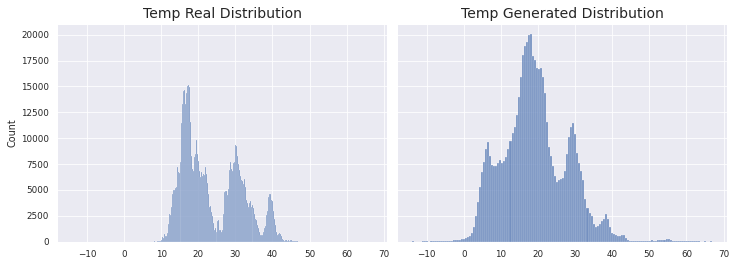

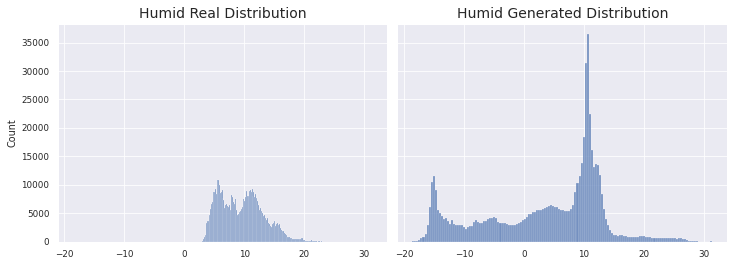

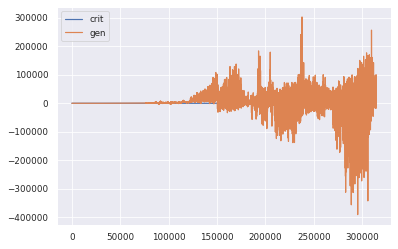

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.5582 - g_loss: 21459.0251
Epoch 161/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.2131 - g_loss: 24618.1677
KL Divergence Sum: 17.12140847889161 bits
Pinball Loss Temp mean: 5.1678379421936675
Pinball Loss Humid mean: 1.7385940696259148
MSE Temp: 10.335675884387035
MSE Humid: 3.4771881392518647


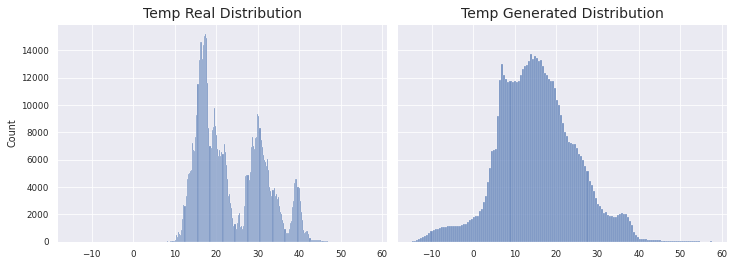

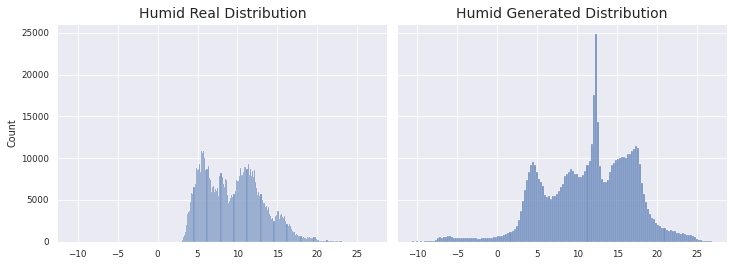

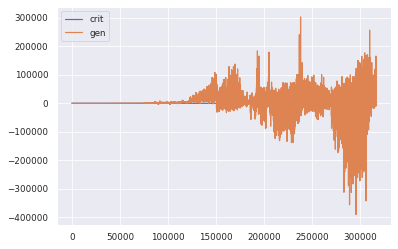

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.2134 - g_loss: 24649.6488
Epoch 162/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.3349 - g_loss: 41541.6246
KL Divergence Sum: 7.602368072888578 bits
Pinball Loss Temp mean: 5.419078702050707
Pinball Loss Humid mean: 2.2272250982837267
MSE Temp: 10.838157404101324
MSE Humid: 4.454450196567457


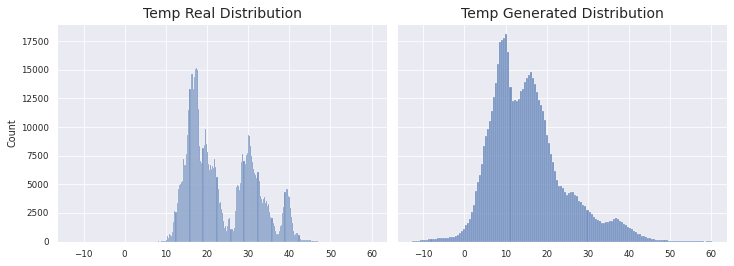

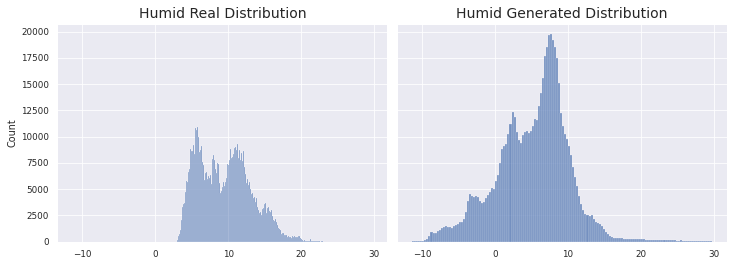

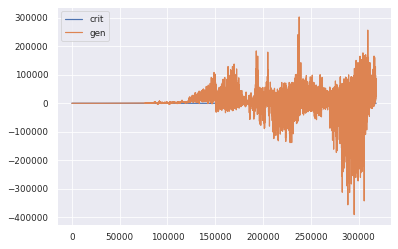

1966/1966 [==============================] - 159s 81ms/step - d_loss: -1.3344 - g_loss: 41564.9506
Epoch 163/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.4042 - g_loss: 47874.0701
KL Divergence Sum: 18.760716161914427 bits
Pinball Loss Temp mean: 3.740604419474875
Pinball Loss Humid mean: 0.8703163540876048
MSE Temp: 7.481208838949834
MSE Humid: 1.7406327081752402


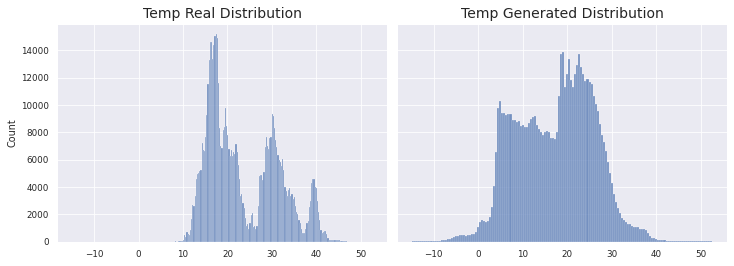

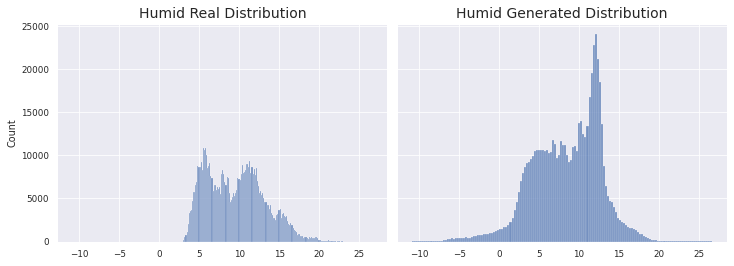

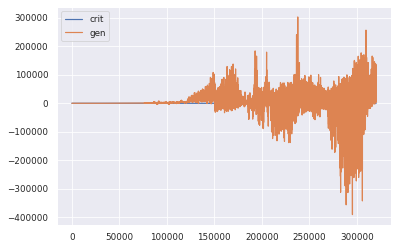

1966/1966 [==============================] - 159s 81ms/step - d_loss: -1.4029 - g_loss: 47849.6688
Epoch 164/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.3573 - g_loss: 35732.5213
KL Divergence Sum: 16.94561752671989 bits
Pinball Loss Temp mean: 4.8170811201795
Pinball Loss Humid mean: 2.1259156876866387
MSE Temp: 9.634162240359098
MSE Humid: 4.25183137537333


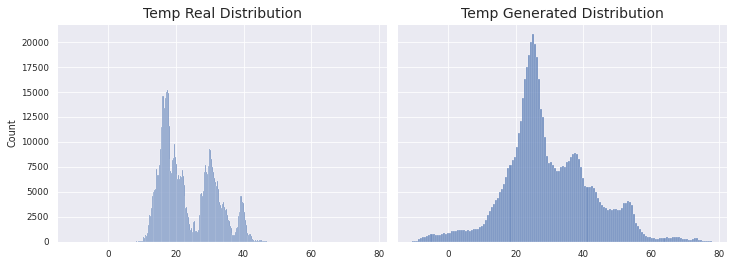

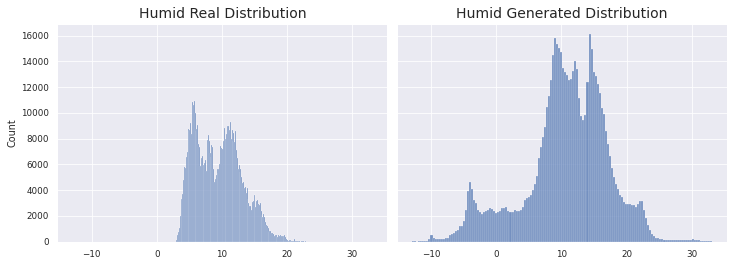

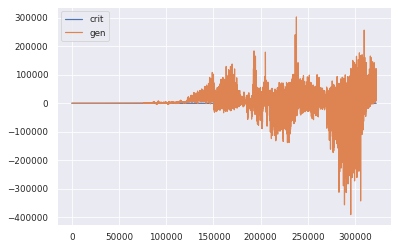

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.3574 - g_loss: 35716.8885
Epoch 165/500
1966/1966 [==============================] - ETA: 0s - d_loss: -1.9016 - g_loss: 35148.9100
KL Divergence Sum: 21.49042657147597 bits
Pinball Loss Temp mean: 4.5144329603885565
Pinball Loss Humid mean: 1.2051474555163382
MSE Temp: 9.028865920777227
MSE Humid: 2.4102949110326484


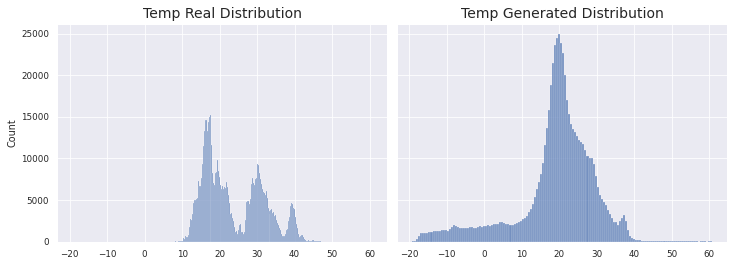

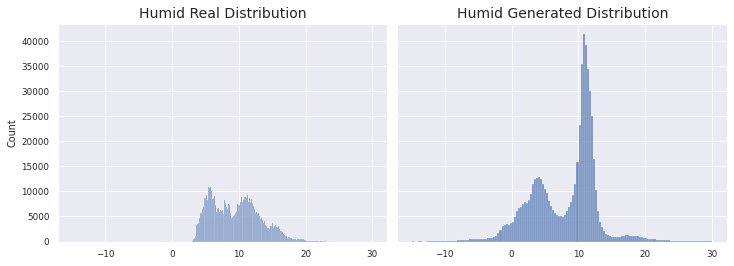

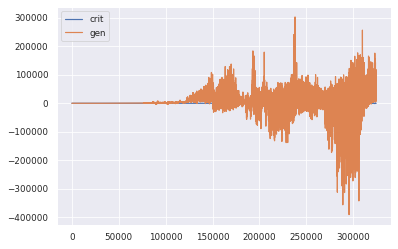

1966/1966 [==============================] - 157s 80ms/step - d_loss: -1.9006 - g_loss: 35151.7090
Epoch 166/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.4199 - g_loss: 36934.9598
KL Divergence Sum: 12.256468944345096 bits
Pinball Loss Temp mean: 3.5543304288196453
Pinball Loss Humid mean: 2.629875768902007
MSE Temp: 7.108660857639387
MSE Humid: 5.259751537804025


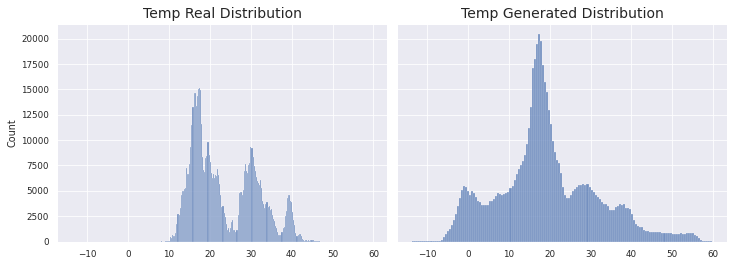

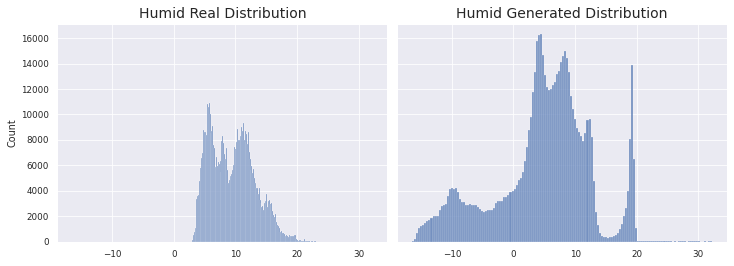

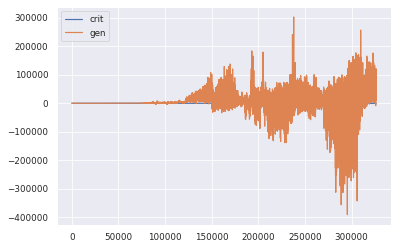

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.4195 - g_loss: 36937.1720
Epoch 167/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2092 - g_loss: 38935.1953
KL Divergence Sum: 23.340586017466862 bits
Pinball Loss Temp mean: 1.704715537407105
Pinball Loss Humid mean: 0.9225824135397694
MSE Temp: 3.4094310748142314
MSE Humid: 1.8451648270795356


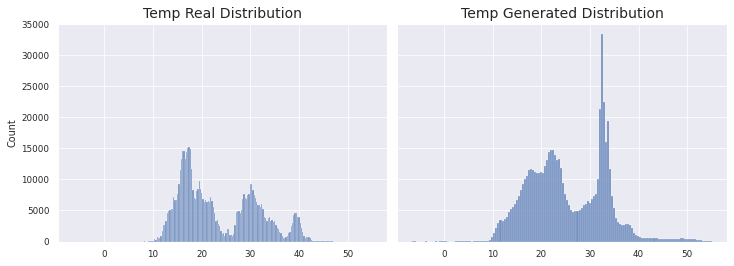

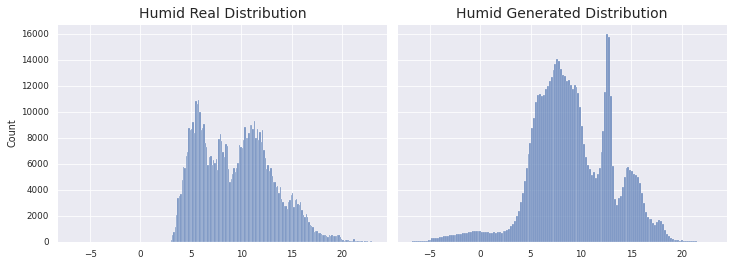

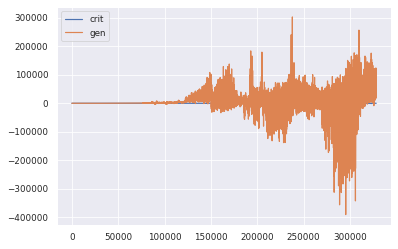

1966/1966 [==============================] - 158s 81ms/step - d_loss: -0.2091 - g_loss: 38919.2435
Epoch 168/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.3955 - g_loss: 36347.3876
KL Divergence Sum: 7.891363869129752 bits
Pinball Loss Temp mean: 3.4042284056387535
Pinball Loss Humid mean: 2.175323517442672
MSE Temp: 6.808456811277488
MSE Humid: 4.350647034885392


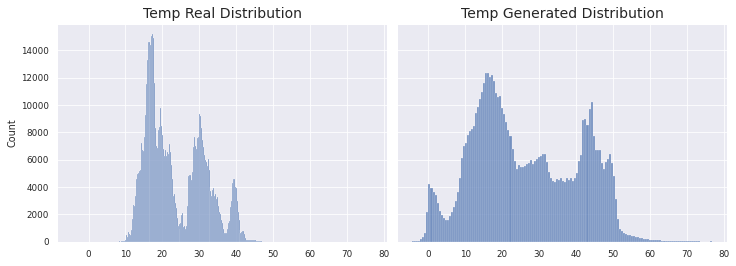

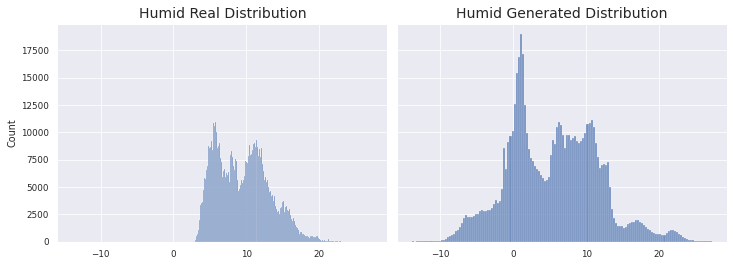

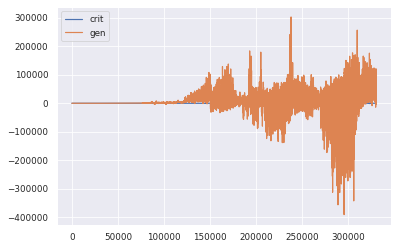

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.3953 - g_loss: 36367.8477
Epoch 169/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -2.8180 - g_loss: 39584.2390
KL Divergence Sum: 25.263819571752247 bits
Pinball Loss Temp mean: 1.7386290139684804
Pinball Loss Humid mean: 0.8337438999539136
MSE Temp: 3.477258027936964
MSE Humid: 1.6674877999078244


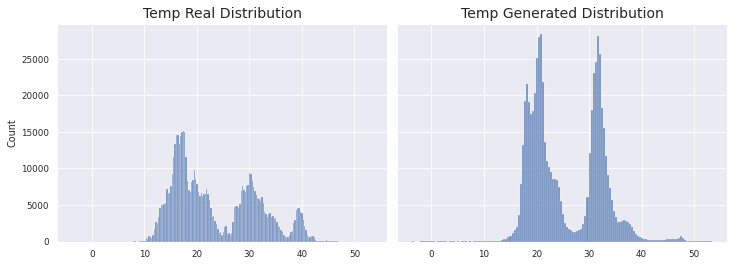

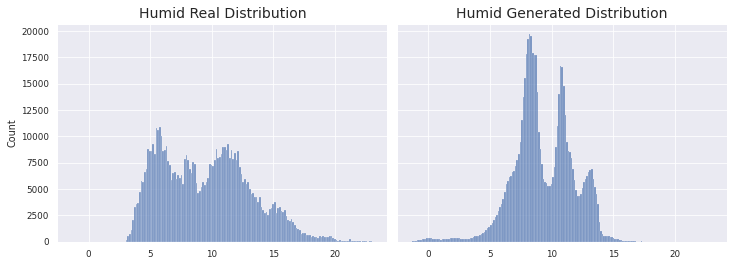

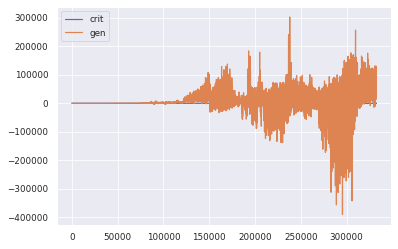

1966/1966 [==============================] - 157s 80ms/step - d_loss: -2.8152 - g_loss: 39593.5088
Epoch 170/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -2.2279 - g_loss: 29785.6496
KL Divergence Sum: 10.316452360925314 bits
Pinball Loss Temp mean: 10.795652372260088
Pinball Loss Humid mean: 3.4043089714108303
MSE Temp: 21.5913047445201
MSE Humid: 6.808617942821629


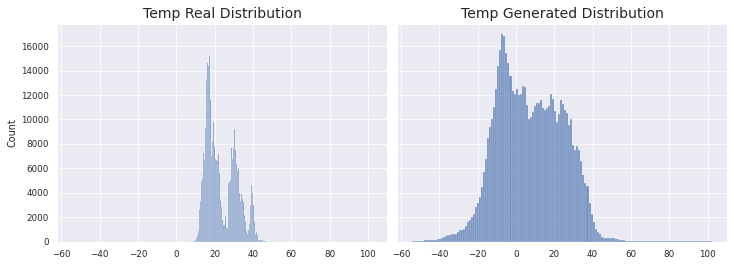

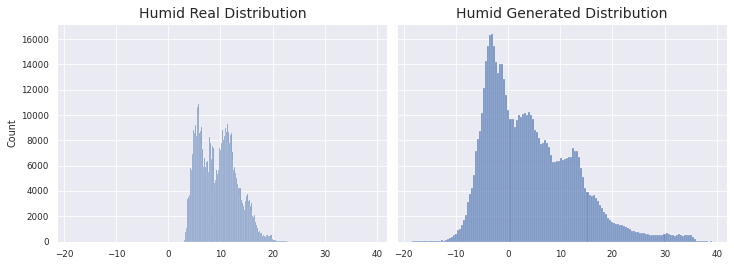

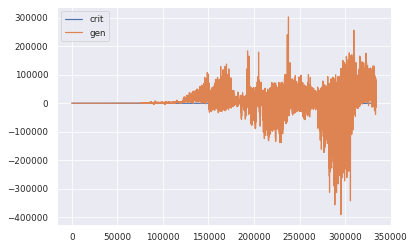

1966/1966 [==============================] - 159s 81ms/step - d_loss: -2.2248 - g_loss: 29766.9834
Epoch 171/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1436 - g_loss: 28485.6577
KL Divergence Sum: 23.296016079468 bits
Pinball Loss Temp mean: 4.602435372326847
Pinball Loss Humid mean: 1.621024290642281
MSE Temp: 9.204870744653622
MSE Humid: 3.242048581284568


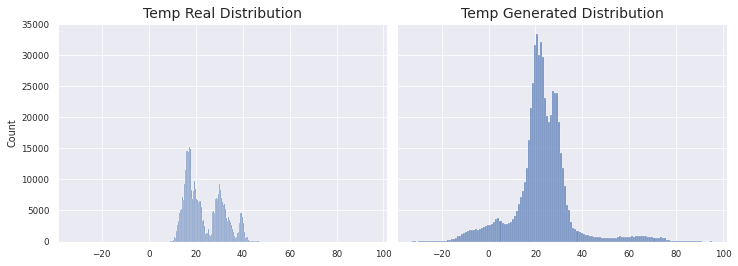

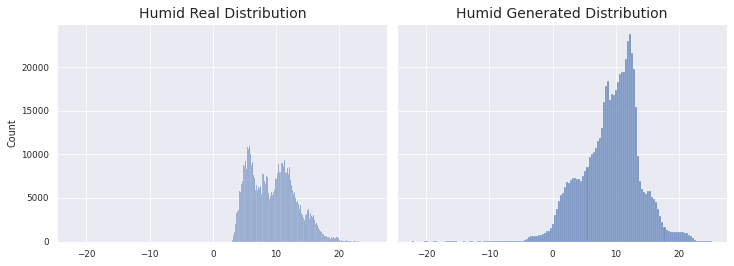

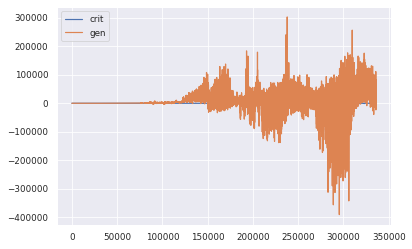

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.1438 - g_loss: 28507.9374
Epoch 172/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.8960 - g_loss: 35599.3402
KL Divergence Sum: 5.728434177904697 bits
Pinball Loss Temp mean: 6.107068106589648
Pinball Loss Humid mean: 3.0704088377080754
MSE Temp: 12.214136213179275
MSE Humid: 6.140817675416173


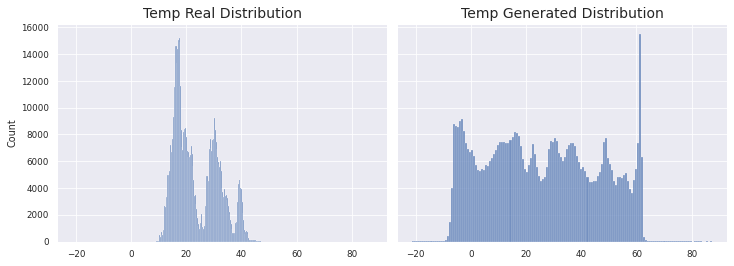

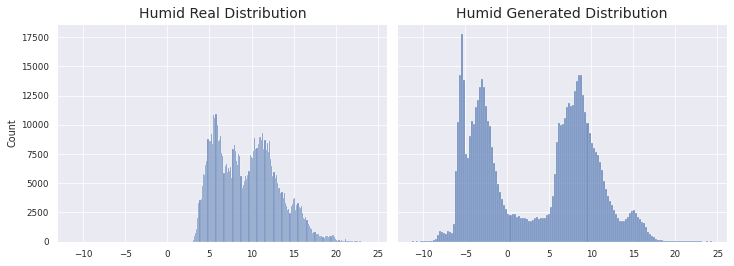

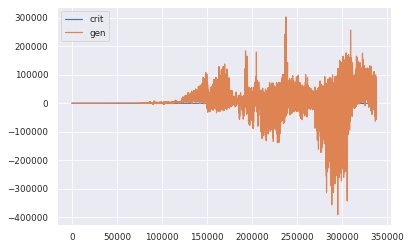

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.8952 - g_loss: 35613.9227
Epoch 173/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0791 - g_loss: 29844.1879
KL Divergence Sum: 11.884981349432612 bits
Pinball Loss Temp mean: 3.253168688064457
Pinball Loss Humid mean: 3.001046540362256
MSE Temp: 6.506337376128993
MSE Humid: 6.002093080724458


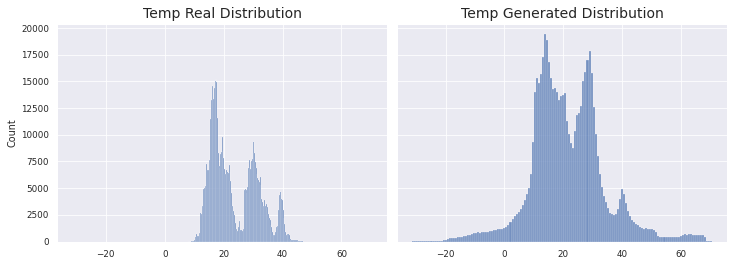

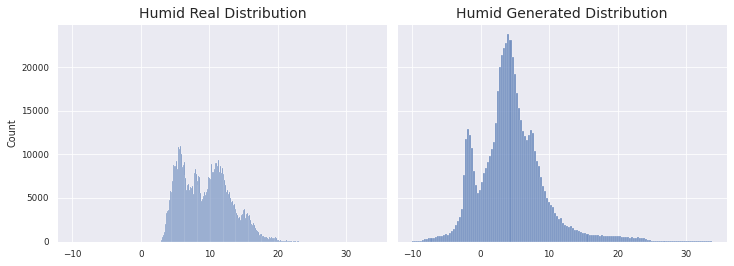

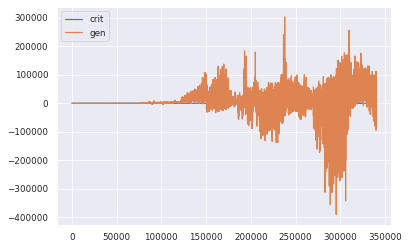

1966/1966 [==============================] - 156s 80ms/step - d_loss: -0.0791 - g_loss: 29841.9236
Epoch 174/500
1966/1966 [==============================] - ETA: 0s - d_loss: -0.8731 - g_loss: 50245.3806
KL Divergence Sum: 16.1171248499162 bits
Pinball Loss Temp mean: 2.715991292167984
Pinball Loss Humid mean: 0.5806980806833888
MSE Temp: 5.431982584335973
MSE Humid: 1.1613961613667672


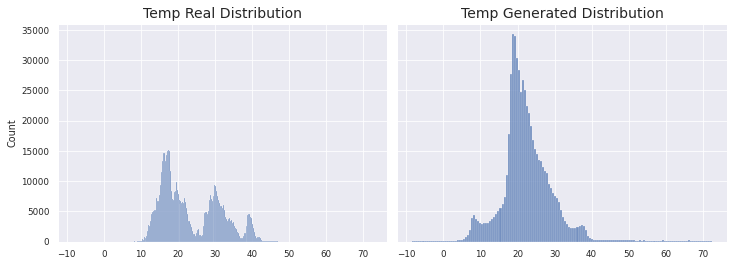

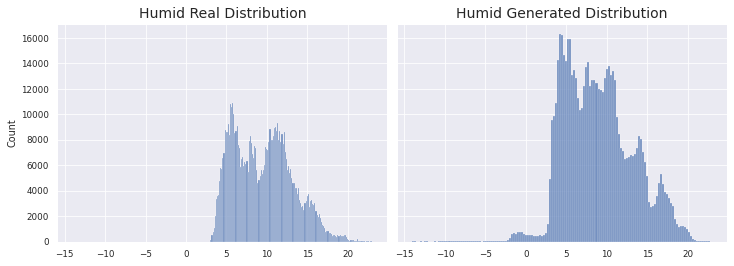

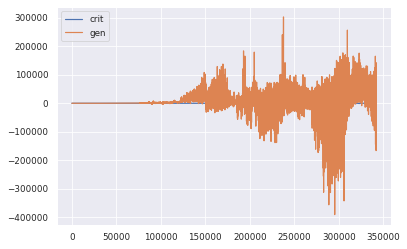

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.8741 - g_loss: 50236.0483
Epoch 175/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.1734 - g_loss: 46725.8901
KL Divergence Sum: 19.15280841512367 bits
Pinball Loss Temp mean: 1.6612356507236032
Pinball Loss Humid mean: 0.7000809432638937
MSE Temp: 3.3224713014471923
MSE Humid: 1.4001618865277996


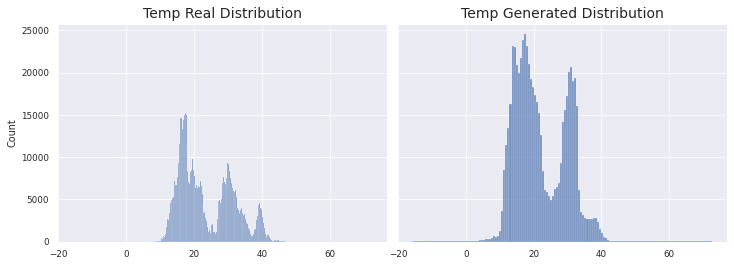

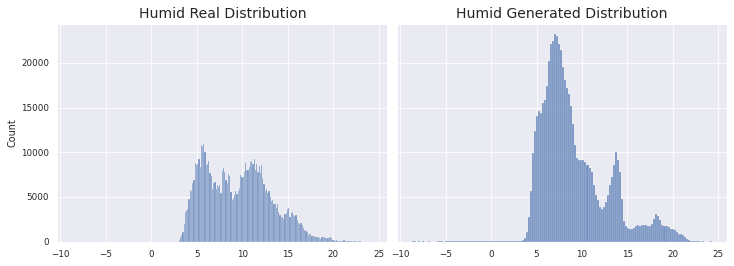

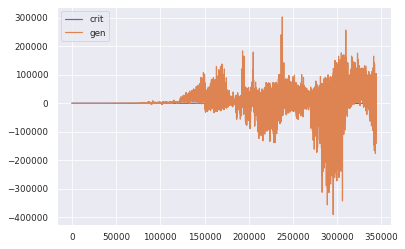

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.1733 - g_loss: 46707.7112
Epoch 176/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.5189 - g_loss: 55101.2127
KL Divergence Sum: 23.18105998909885 bits
Pinball Loss Temp mean: 8.238447017572428
Pinball Loss Humid mean: 3.7418311185736712
MSE Temp: 16.47689403514502
MSE Humid: 7.483662237147404


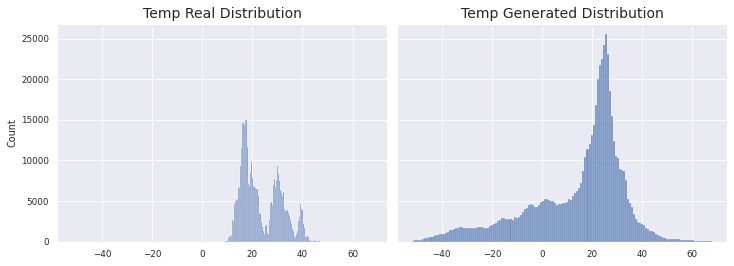

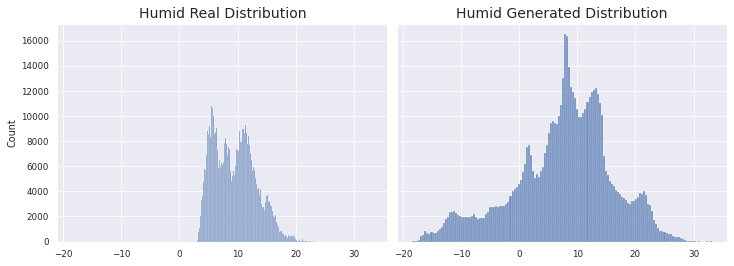

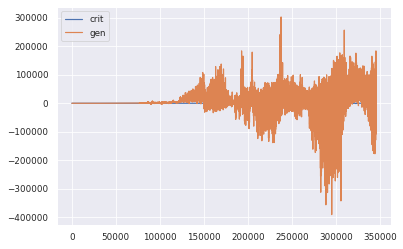

1966/1966 [==============================] - 159s 81ms/step - d_loss: -0.5184 - g_loss: 55130.8221
Epoch 177/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0557 - g_loss: 63356.8846
KL Divergence Sum: 19.521815212212168 bits
Pinball Loss Temp mean: 2.375025845905114
Pinball Loss Humid mean: 2.75047623354233
MSE Temp: 4.7500516918102536
MSE Humid: 5.500952467084709


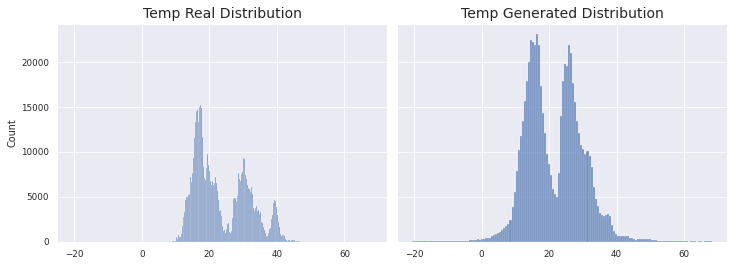

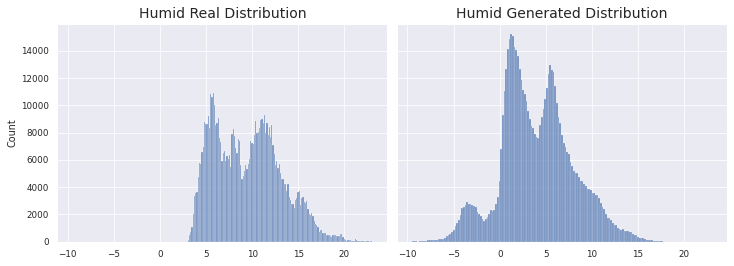

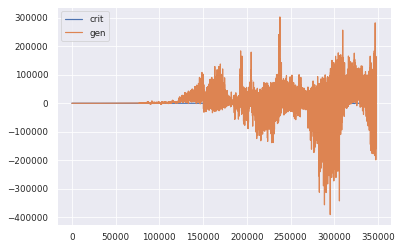

1966/1966 [==============================] - 157s 80ms/step - d_loss: -0.0485 - g_loss: 63359.4301
Epoch 178/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2530 - g_loss: 58728.3775
KL Divergence Sum: 17.99958931752516 bits
Pinball Loss Temp mean: 4.106083277164196
Pinball Loss Humid mean: 0.8641810009678931
MSE Temp: 8.212166554328315
MSE Humid: 1.7283620019358048


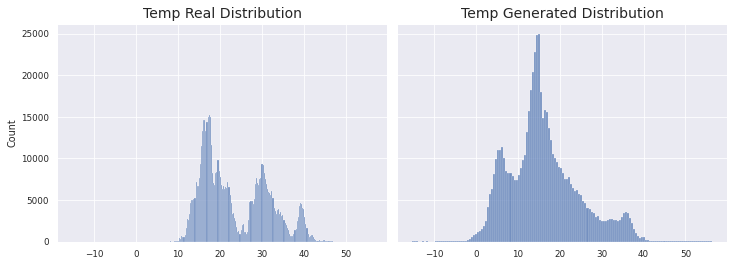

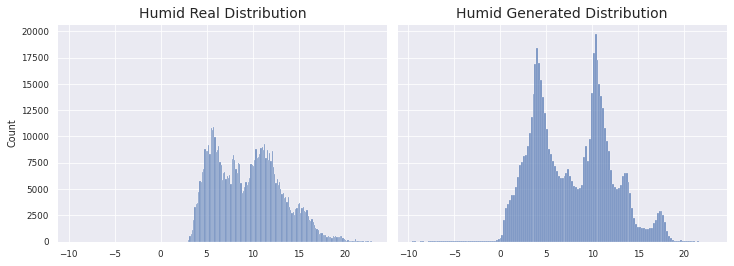

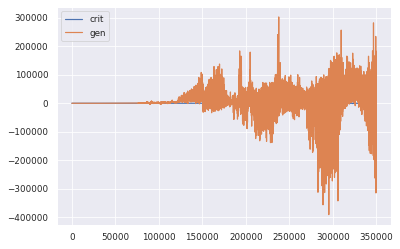

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2510 - g_loss: 58762.2778
Epoch 179/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3018 - g_loss: 45953.9612
KL Divergence Sum: 19.93193587389328 bits
Pinball Loss Temp mean: 0.9502551333612477
Pinball Loss Humid mean: 0.5523341671322803
MSE Temp: 1.9005102667224942
MSE Humid: 1.1046683342645411


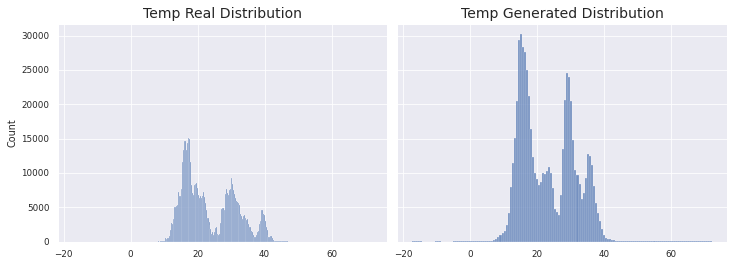

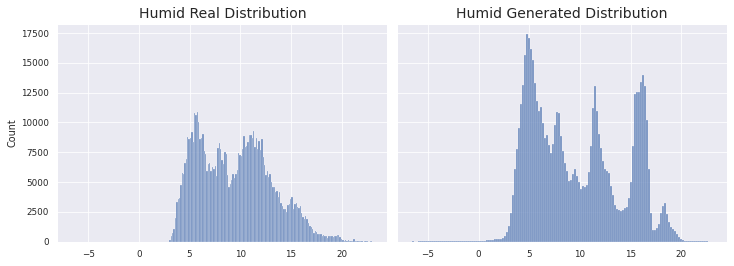

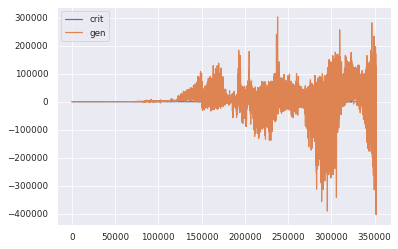

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3014 - g_loss: 45968.2906
Epoch 180/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2370 - g_loss: 35446.2698
KL Divergence Sum: 26.09991134113205 bits
Pinball Loss Temp mean: 3.3221261153079786
Pinball Loss Humid mean: 0.576590729272622
MSE Temp: 6.6442522306158995
MSE Humid: 1.1531814585452347


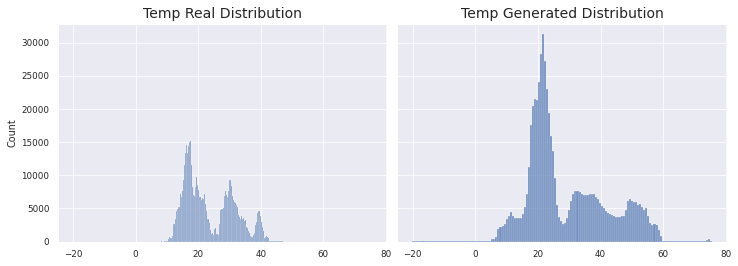

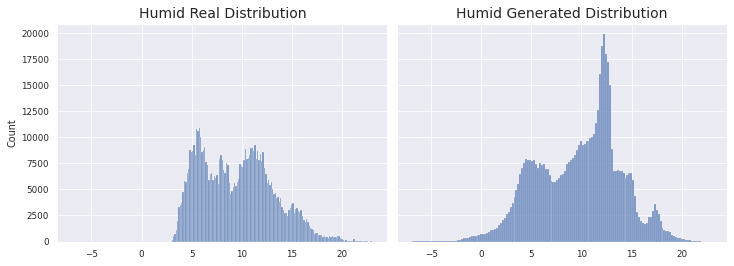

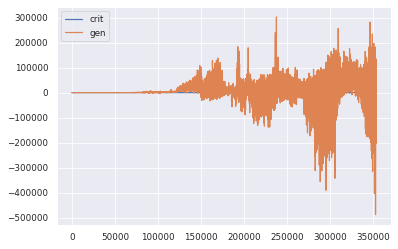

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2368 - g_loss: 35423.6269
Epoch 181/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3879 - g_loss: 49619.3835
KL Divergence Sum: 17.241229546977795 bits
Pinball Loss Temp mean: 3.2988186709944274
Pinball Loss Humid mean: 0.9174020584391174
MSE Temp: 6.597637341988857
MSE Humid: 1.8348041168782079


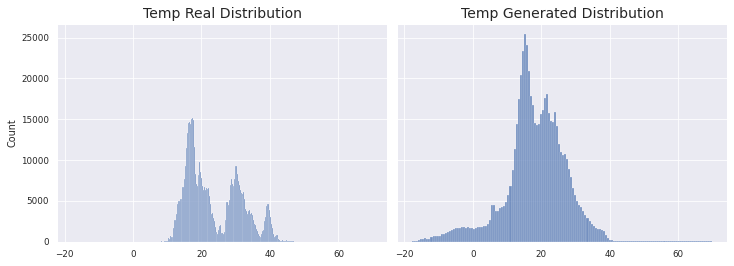

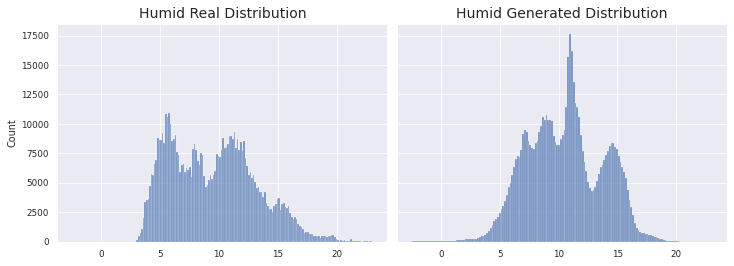

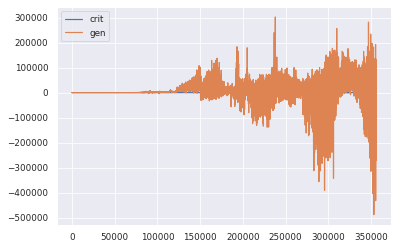

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3876 - g_loss: 49628.1767
Epoch 182/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2475 - g_loss: 41669.0318
KL Divergence Sum: 17.283580176416105 bits
Pinball Loss Temp mean: 1.9946357790448404
Pinball Loss Humid mean: 0.5923138029623581
MSE Temp: 3.989271558089706
MSE Humid: 1.1846276059246952


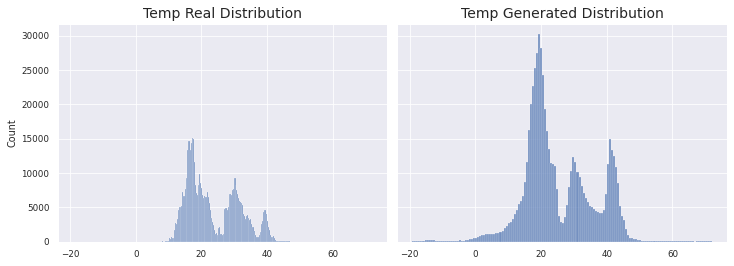

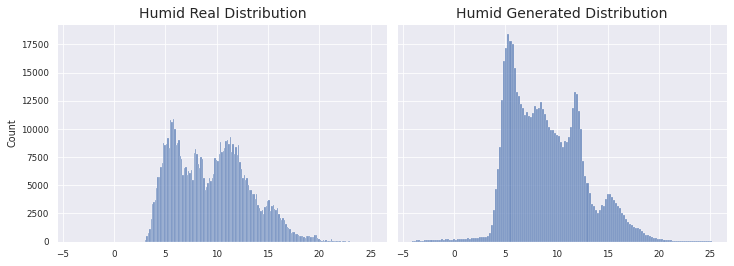

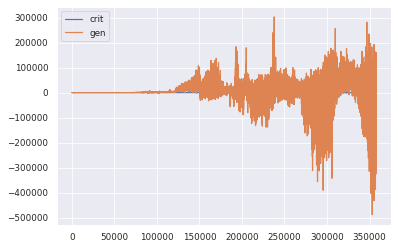

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2472 - g_loss: 41674.6620
Epoch 183/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2672 - g_loss: 40420.7724
KL Divergence Sum: 26.422267851690226 bits
Pinball Loss Temp mean: 3.1728148296628254
Pinball Loss Humid mean: 0.8164605942273123
MSE Temp: 6.345629659325696
MSE Humid: 1.6329211884546029


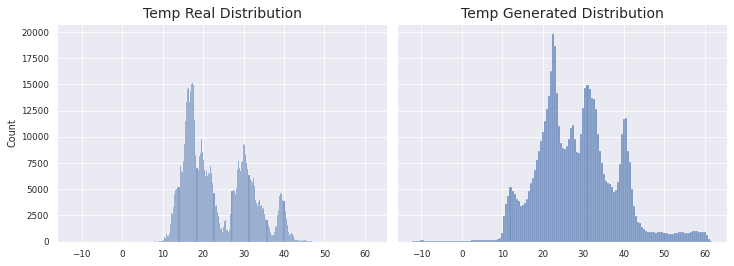

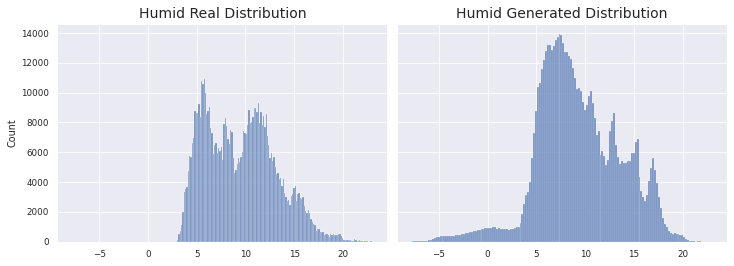

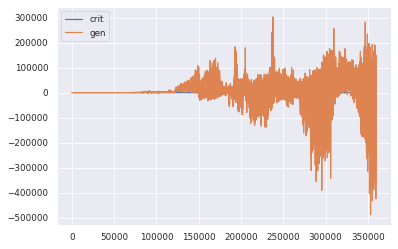

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2670 - g_loss: 40398.4036
Epoch 184/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2025 - g_loss: 75115.7546
KL Divergence Sum: 16.31414923422503 bits
Pinball Loss Temp mean: 2.504249943189742
Pinball Loss Humid mean: 1.367110863028633
MSE Temp: 5.008499886379457
MSE Humid: 2.7342217260572426


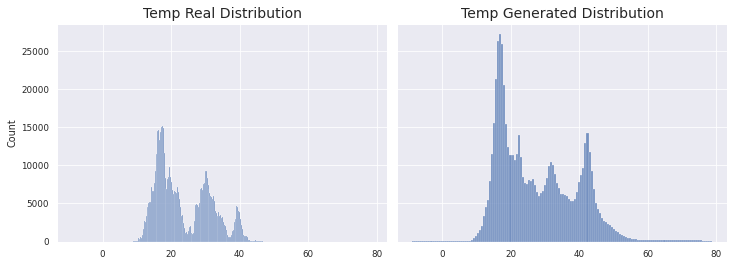

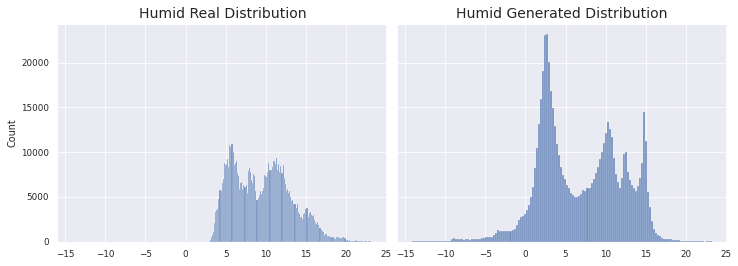

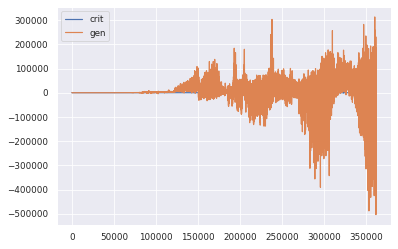

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2022 - g_loss: 75116.7197
Epoch 185/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3906 - g_loss: 75873.5545
KL Divergence Sum: 26.909355712215625 bits
Pinball Loss Temp mean: 1.8419058330617368
Pinball Loss Humid mean: 0.7010118988013911
MSE Temp: 3.6838116661234372
MSE Humid: 1.4020237976027767


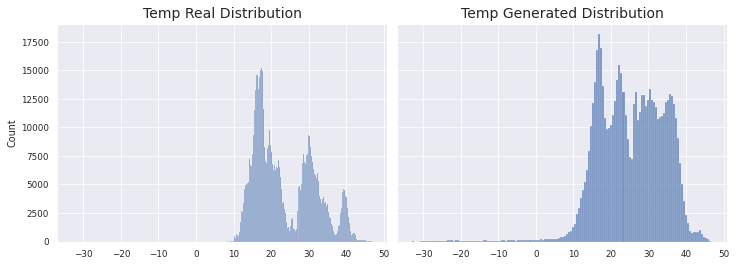

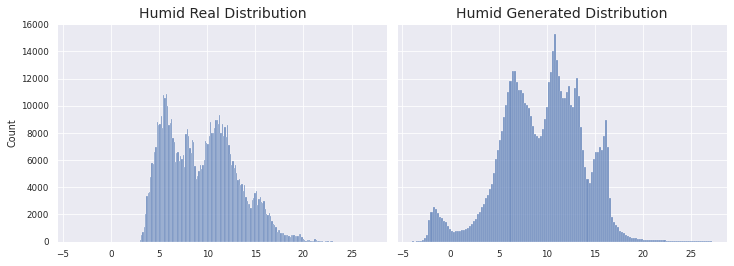

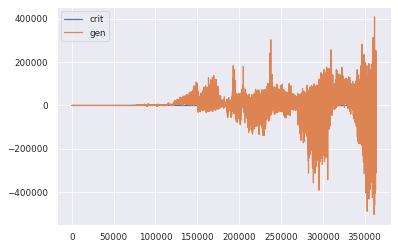

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3899 - g_loss: 75945.7412
Epoch 186/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2181 - g_loss: 77805.1597
KL Divergence Sum: 15.446026078085817 bits
Pinball Loss Temp mean: 3.808643690972798
Pinball Loss Humid mean: 1.430649460696196
MSE Temp: 7.617287381945591
MSE Humid: 2.861298921392367


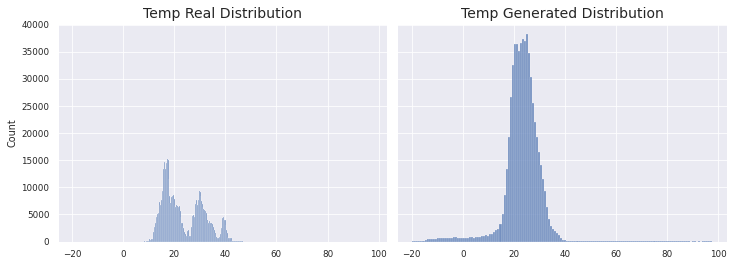

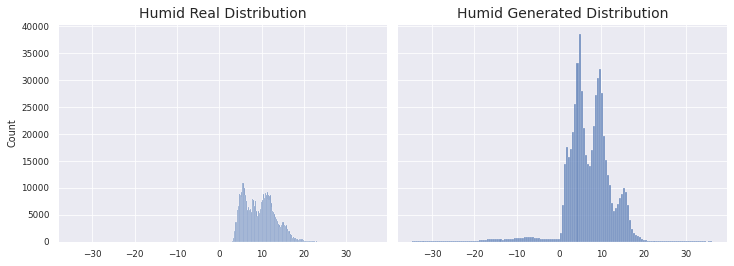

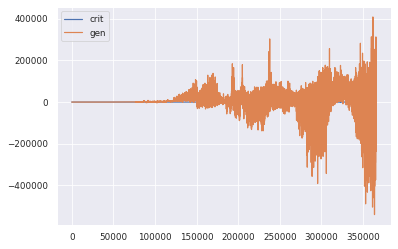

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2178 - g_loss: 77801.0251
Epoch 187/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0898 - g_loss: 62575.7710
KL Divergence Sum: 20.83886097915781 bits
Pinball Loss Temp mean: 1.4530631411580004
Pinball Loss Humid mean: 0.8038845202984716
MSE Temp: 2.9061262823159875
MSE Humid: 1.6077690405969414


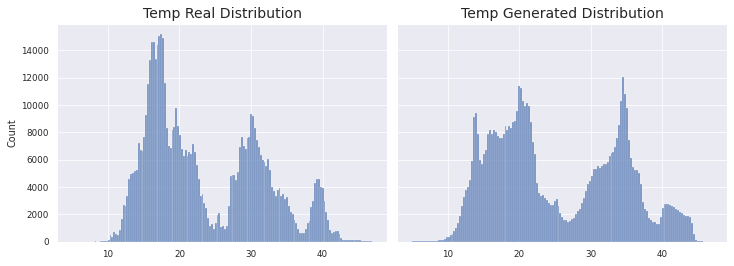

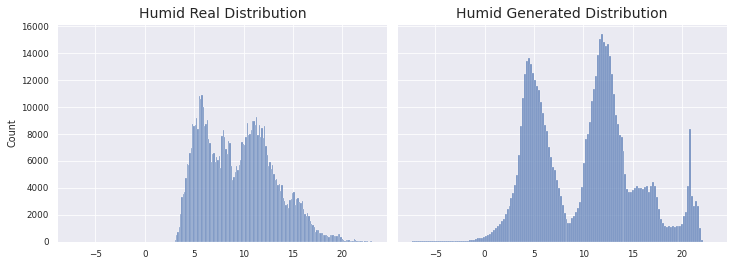

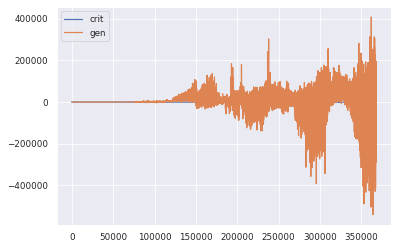

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.0897 - g_loss: 62585.1675
Epoch 188/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.2976 - g_loss: 49490.8405
KL Divergence Sum: 7.83058589012261 bits
Pinball Loss Temp mean: 4.1244891512362525
Pinball Loss Humid mean: 0.5699474462392373
MSE Temp: 8.248978302472636
MSE Humid: 1.1398948924784904


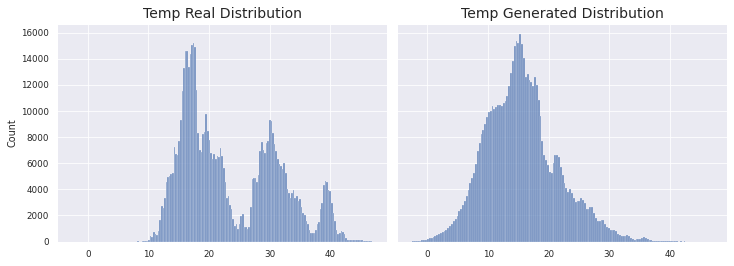

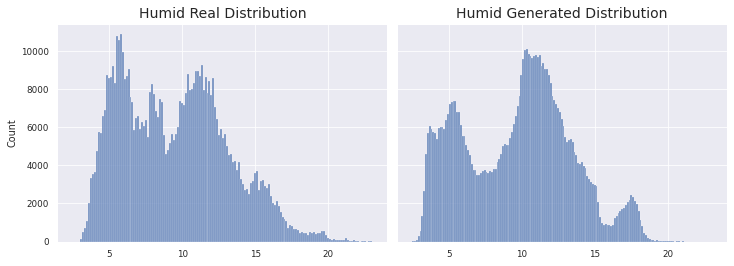

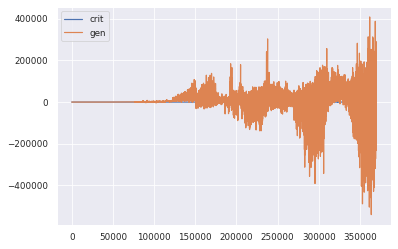

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.3003 - g_loss: 49496.7579
Epoch 189/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3477 - g_loss: 61080.0288
KL Divergence Sum: 12.739968179083638 bits
Pinball Loss Temp mean: 2.9876858168723017
Pinball Loss Humid mean: 0.9101584992010313
MSE Temp: 5.975371633744464
MSE Humid: 1.8203169984020582


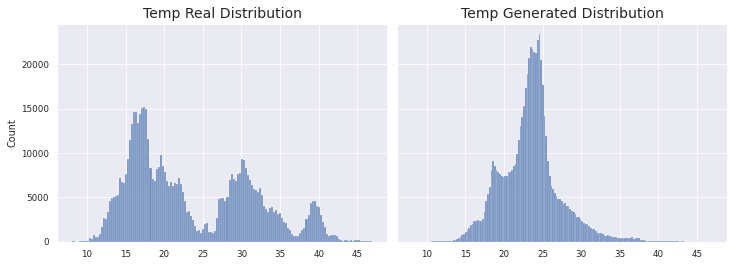

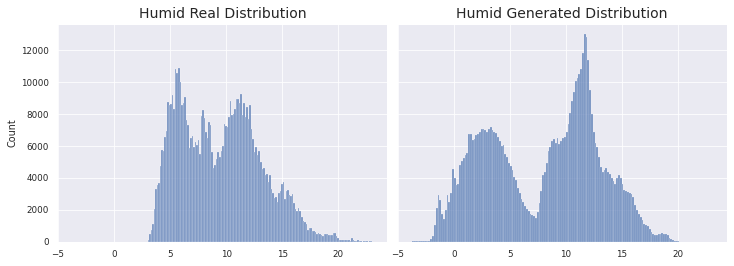

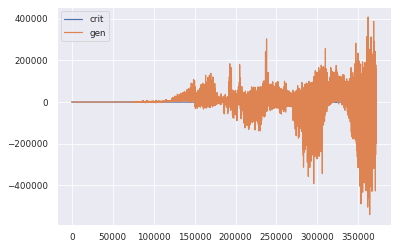

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.3475 - g_loss: 61019.6326
Epoch 190/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.3793 - g_loss: 61973.6915
KL Divergence Sum: 3.1977900049457033 bits
Pinball Loss Temp mean: 0.8330034020169373
Pinball Loss Humid mean: 0.6163289511335065
MSE Temp: 1.6660068040339107
MSE Humid: 1.2326579022670068


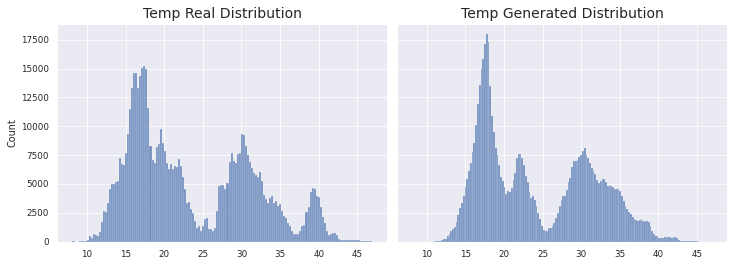

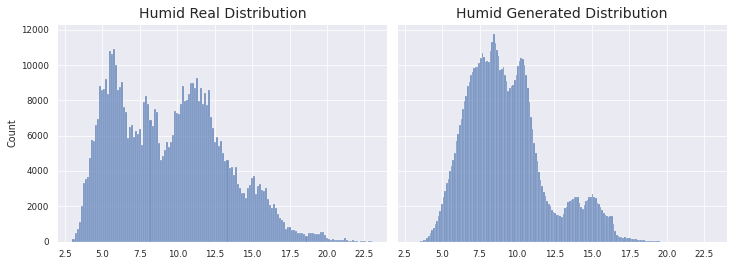

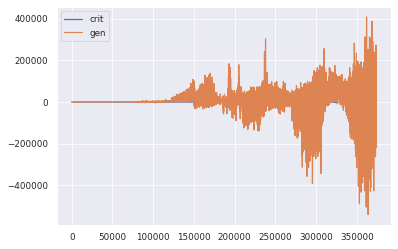

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.3791 - g_loss: 61972.0720
Epoch 191/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0094 - g_loss: 51235.6081
KL Divergence Sum: 12.329474816129972 bits
Pinball Loss Temp mean: 1.91495943519119
Pinball Loss Humid mean: 1.0830200446511633
MSE Temp: 3.829918870382417
MSE Humid: 2.1660400893023106


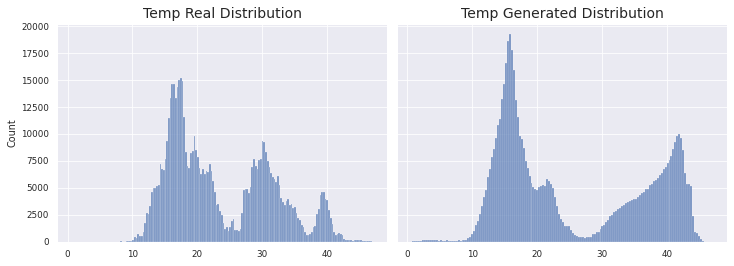

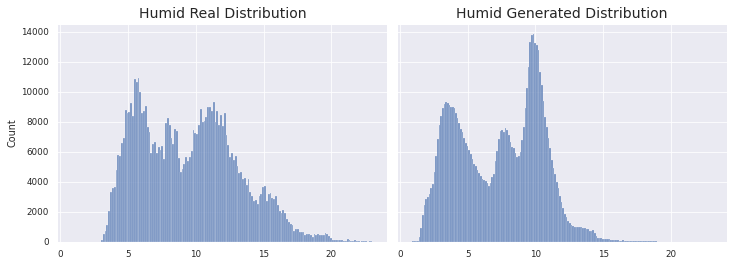

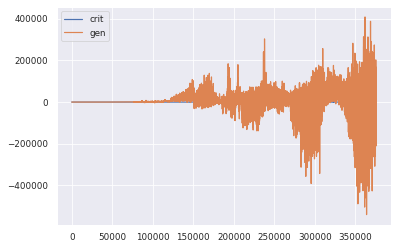

1966/1966 [==============================] - 158s 80ms/step - d_loss: -0.0096 - g_loss: 51289.6419
Epoch 192/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.3263 - g_loss: 30314.4426
KL Divergence Sum: 25.676093193072642 bits
Pinball Loss Temp mean: 2.2600304713989017
Pinball Loss Humid mean: 0.9829538599854504
MSE Temp: 4.5200609427978105
MSE Humid: 1.9659077199709016


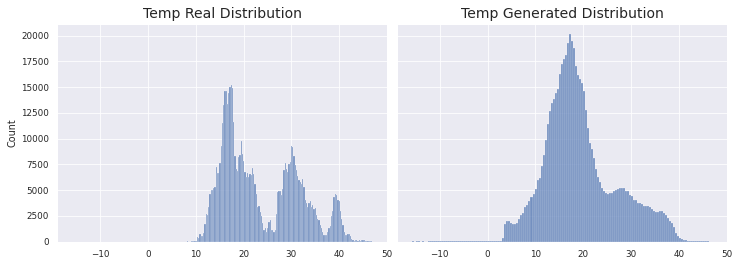

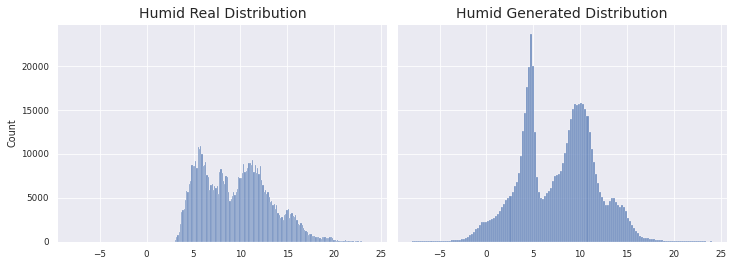

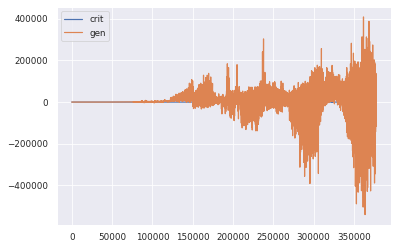

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.3260 - g_loss: 30316.3380
Epoch 193/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.2190 - g_loss: 31412.4802
KL Divergence Sum: 5.04607875395084 bits
Pinball Loss Temp mean: 2.171914933584408
Pinball Loss Humid mean: 1.517539925951782
MSE Temp: 4.34382986716886
MSE Humid: 3.035079851903554


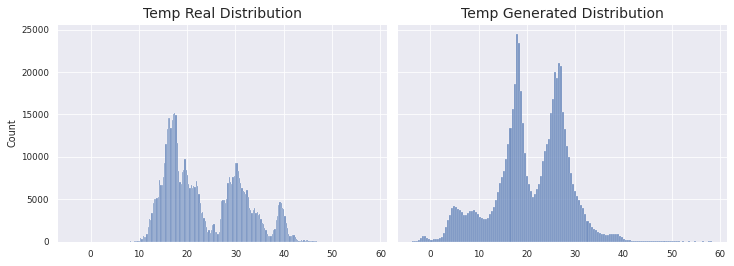

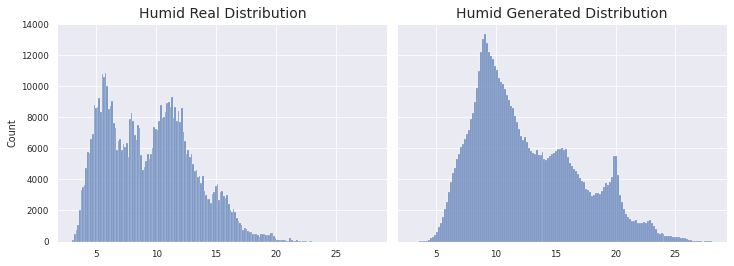

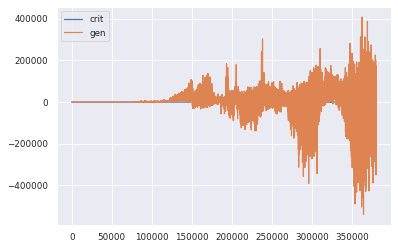

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2190 - g_loss: 31366.0758
Epoch 194/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0369 - g_loss: 55059.4073
KL Divergence Sum: 8.50731551249941 bits
Pinball Loss Temp mean: 4.599578121619753
Pinball Loss Humid mean: 1.4959011441055938
MSE Temp: 9.199156243239395
MSE Humid: 2.991802288211175


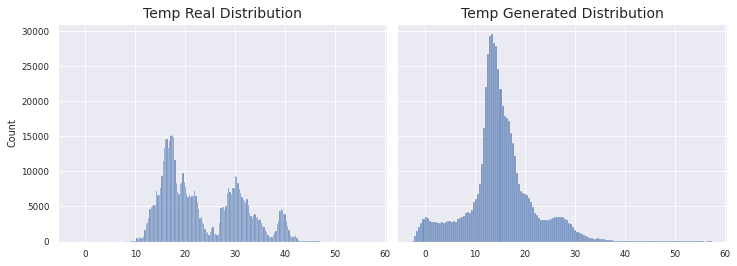

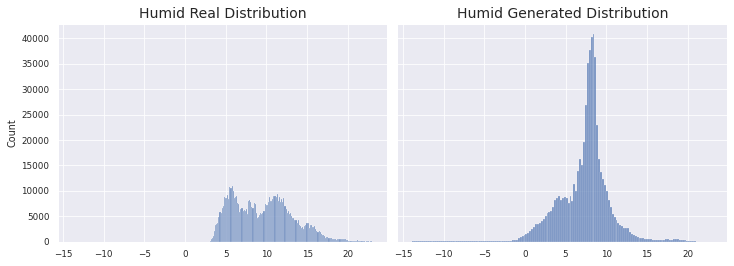

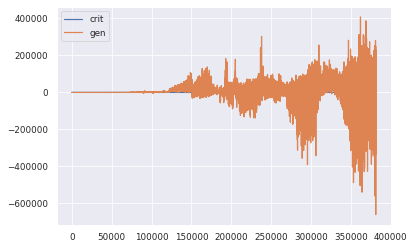

1966/1966 [==============================] - 160s 81ms/step - d_loss: 0.0359 - g_loss: 55053.4434
Epoch 195/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.0229 - g_loss: 85152.7215
KL Divergence Sum: 10.707293315921904 bits
Pinball Loss Temp mean: 4.00605822288151
Pinball Loss Humid mean: 1.9669421319602347
MSE Temp: 8.012116445763024
MSE Humid: 3.9338842639204707


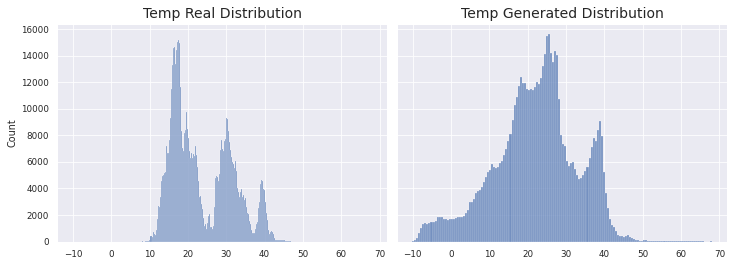

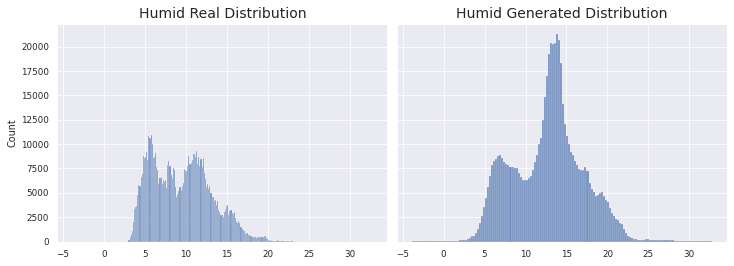

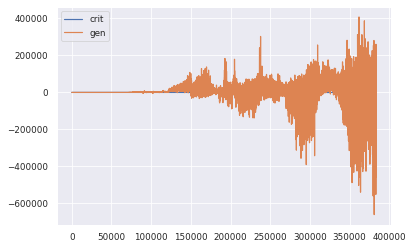

1966/1966 [==============================] - 158s 81ms/step - d_loss: -0.0228 - g_loss: 85101.0869
Epoch 196/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4377 - g_loss: 76768.0725
KL Divergence Sum: 13.279464989361914 bits
Pinball Loss Temp mean: 1.5114475693472653
Pinball Loss Humid mean: 0.664995652242949
MSE Temp: 3.022895138694534
MSE Humid: 1.3299913044859009


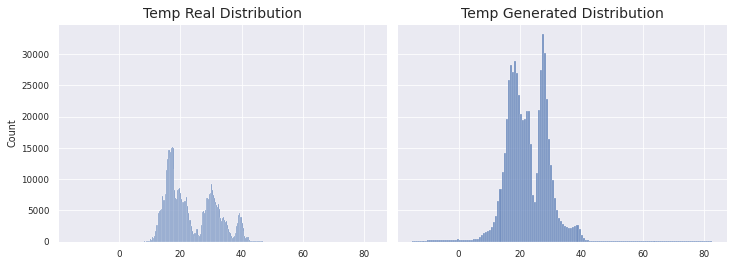

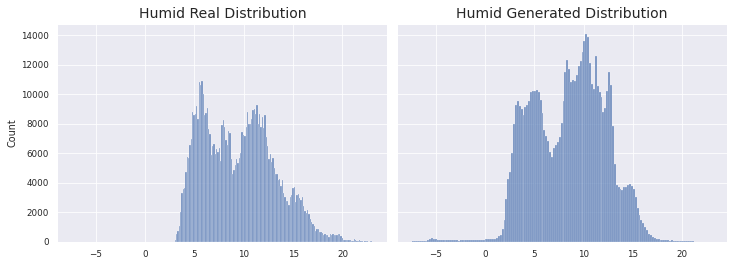

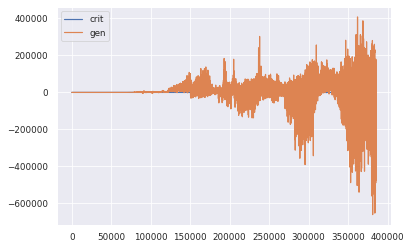

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.4372 - g_loss: 76793.4761
Epoch 197/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2493 - g_loss: 99991.7536
KL Divergence Sum: 16.148408235738028 bits
Pinball Loss Temp mean: 3.081317701650854
Pinball Loss Humid mean: 1.1766106815461055
MSE Temp: 6.162635403301744
MSE Humid: 2.3532213630921697


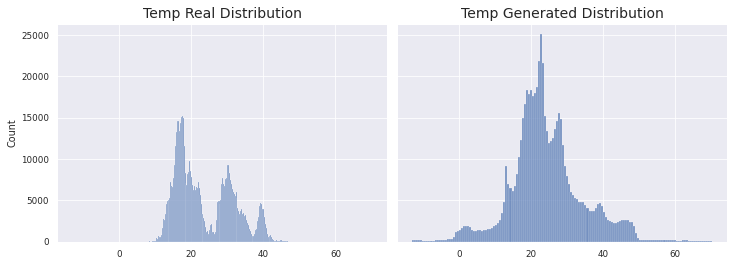

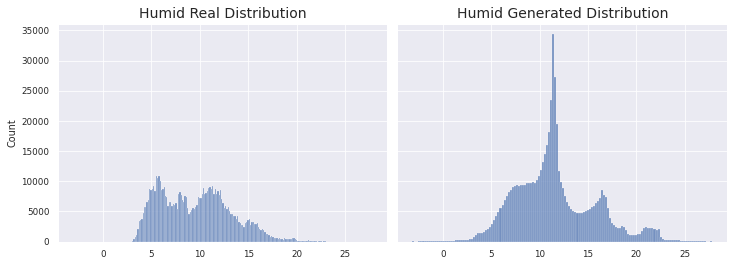

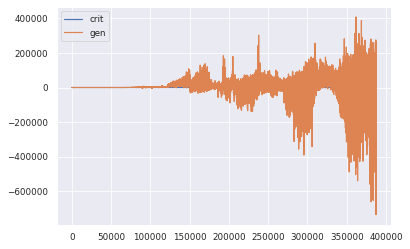

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.2497 - g_loss: 99992.8326
Epoch 198/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -3.5984 - g_loss: 155234.1616
KL Divergence Sum: 25.544331050639087 bits
Pinball Loss Temp mean: 4.649765117985361
Pinball Loss Humid mean: 1.015055238440573
MSE Temp: 9.299530235970789
MSE Humid: 2.030110476881151


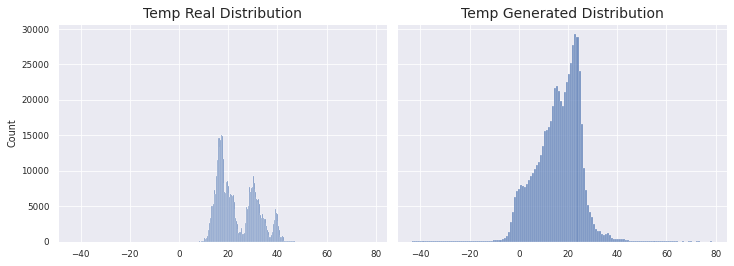

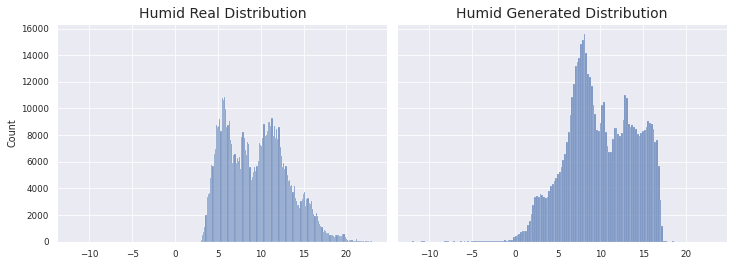

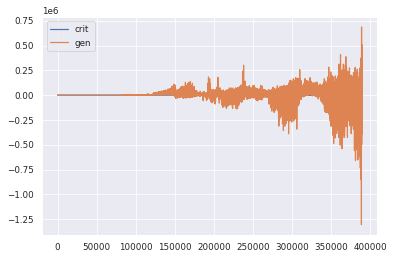

1966/1966 [==============================] - 158s 81ms/step - d_loss: -3.5948 - g_loss: 155161.7640
Epoch 199/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1469 - g_loss: 118771.8554
KL Divergence Sum: 28.013896407102656 bits
Pinball Loss Temp mean: 3.870113883682096
Pinball Loss Humid mean: 0.8572453125945264
MSE Temp: 7.7402277673641535
MSE Humid: 1.714490625189056


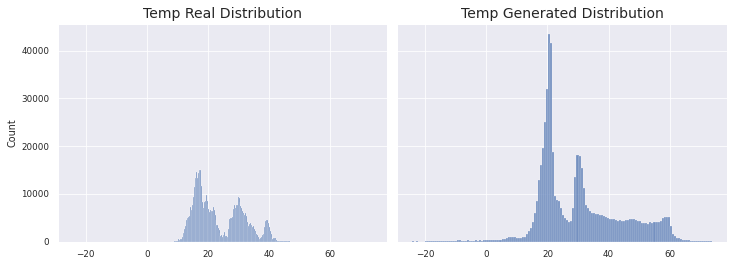

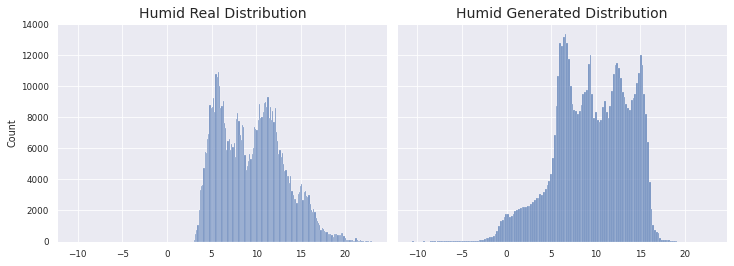

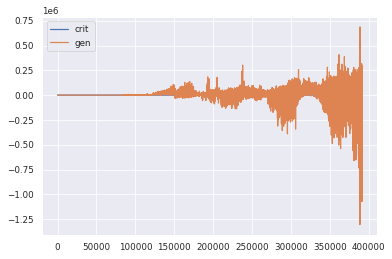

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.1466 - g_loss: 118792.6033
Epoch 200/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 2.0009 - g_loss: 100392.1333
KL Divergence Sum: 5.2567648664301645 bits
Pinball Loss Temp mean: 2.351708546454065
Pinball Loss Humid mean: 0.6105951134694403
MSE Temp: 4.703417092908096
MSE Humid: 1.221190226938883


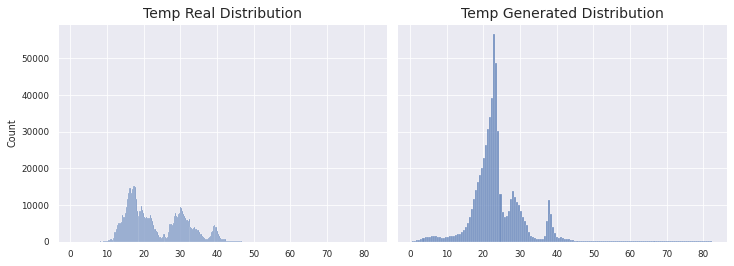

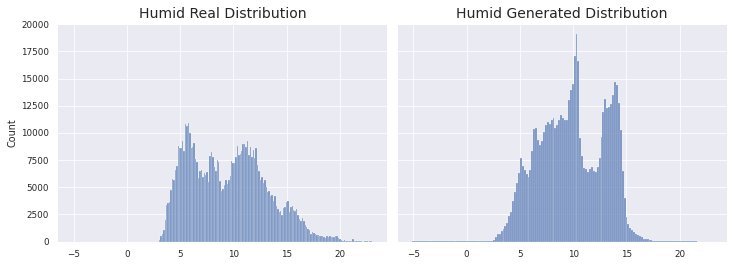

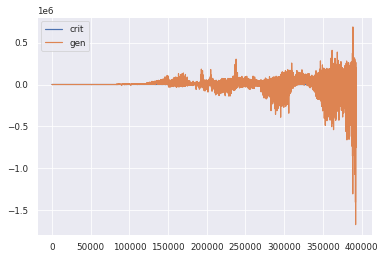

1966/1966 [==============================] - 157s 80ms/step - d_loss: 1.9987 - g_loss: 100373.6551
Epoch 201/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4722 - g_loss: 138190.3235
KL Divergence Sum: 22.499288329030605 bits
Pinball Loss Temp mean: 6.410860604368262
Pinball Loss Humid mean: 4.156546996838624
MSE Temp: 12.821721208736381
MSE Humid: 8.313093993677196


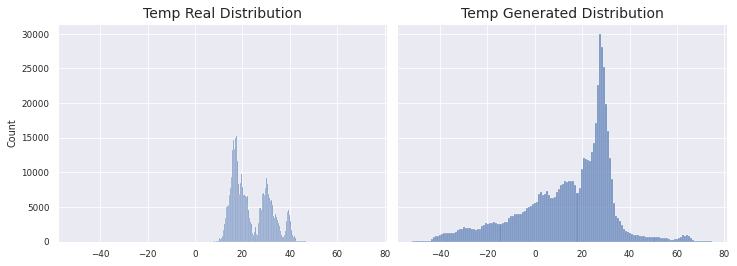

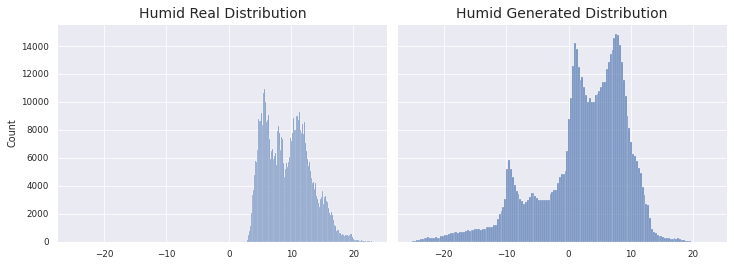

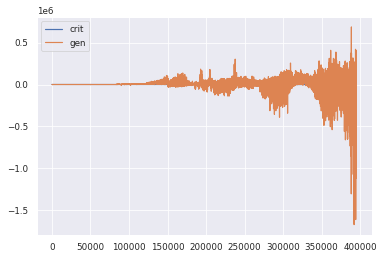

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.4717 - g_loss: 138186.9140
Epoch 202/500
1966/1966 [==============================] - ETA: 0s - d_loss: -4.0291 - g_loss: 142965.3630
KL Divergence Sum: 23.3340801074657 bits
Pinball Loss Temp mean: 14.311792062105104
Pinball Loss Humid mean: 4.153048410858655
MSE Temp: 28.62358412421018
MSE Humid: 8.306096821717194


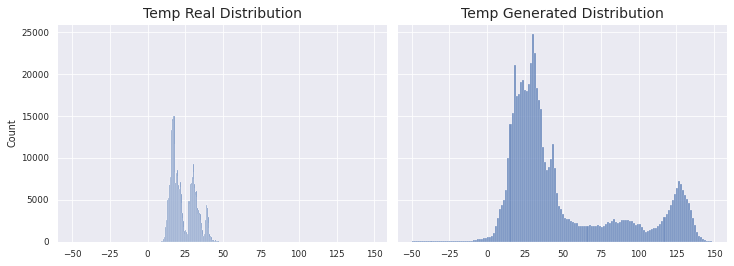

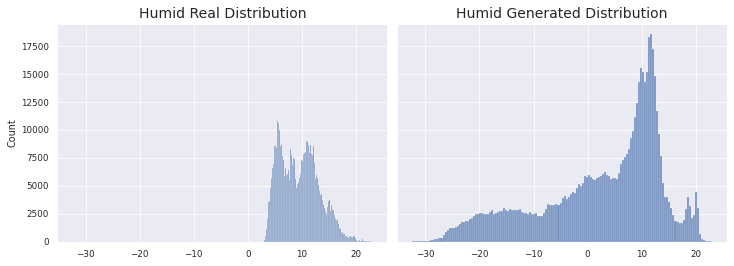

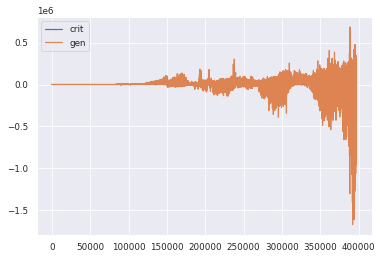

1966/1966 [==============================] - 158s 80ms/step - d_loss: -4.0272 - g_loss: 142973.5564
Epoch 203/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7226 - g_loss: 139392.4402
KL Divergence Sum: 17.475988074715584 bits
Pinball Loss Temp mean: 3.7231036042988412
Pinball Loss Humid mean: 0.8142596288552607
MSE Temp: 7.446207208597688
MSE Humid: 1.628519257710538


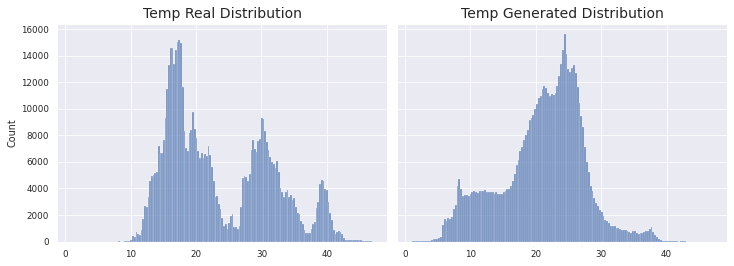

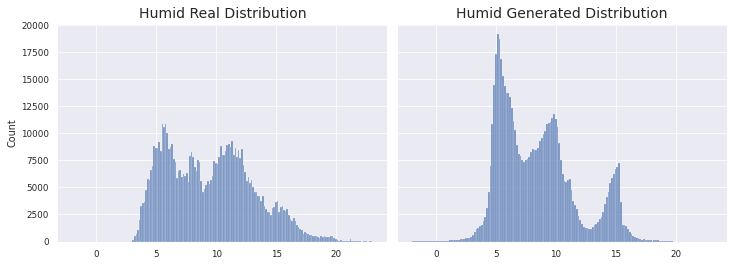

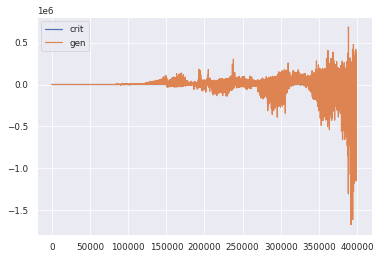

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.7219 - g_loss: 139217.1734
Epoch 204/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7510 - g_loss: 155369.5093
KL Divergence Sum: 13.633342047872848 bits
Pinball Loss Temp mean: 4.329888609046339
Pinball Loss Humid mean: 1.8777397942442664
MSE Temp: 8.659777218092678
MSE Humid: 3.755479588488521


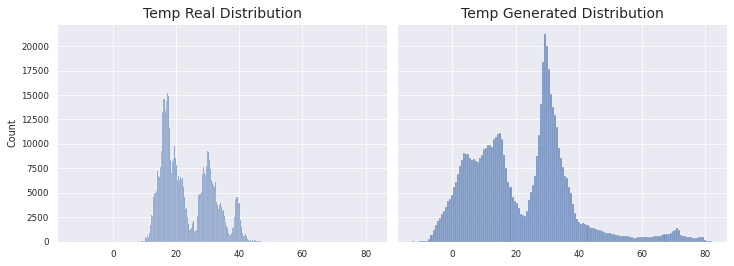

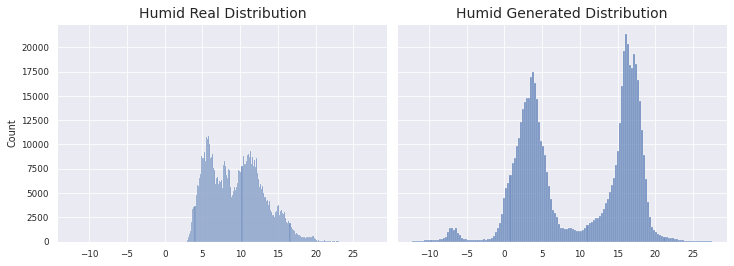

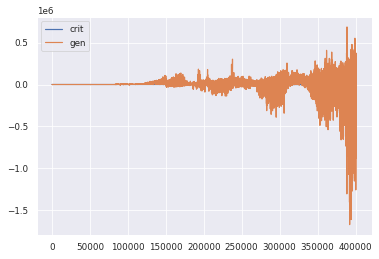

1966/1966 [==============================] - 158s 81ms/step - d_loss: 0.7496 - g_loss: 155312.4531
Epoch 205/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.5308 - g_loss: 180393.7556
KL Divergence Sum: 12.542985139541237 bits
Pinball Loss Temp mean: 8.165174048446271
Pinball Loss Humid mean: 2.168904121920458
MSE Temp: 16.33034809689248
MSE Humid: 4.337808243840984


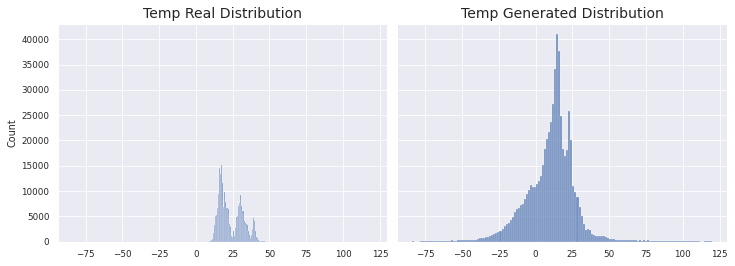

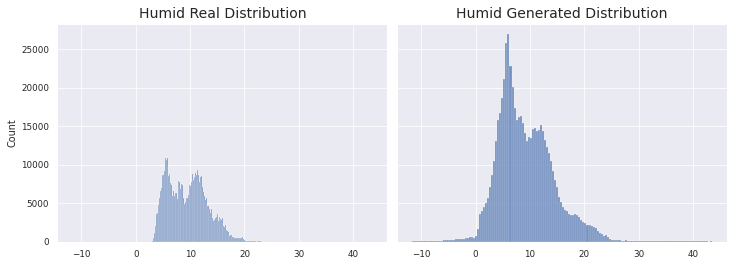

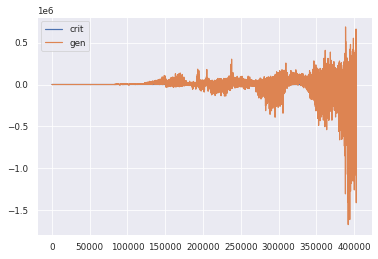

1966/1966 [==============================] - 157s 80ms/step - d_loss: 1.5292 - g_loss: 180432.5723
Epoch 206/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 2.2220 - g_loss: 162446.7566
KL Divergence Sum: 15.54212909913515 bits
Pinball Loss Temp mean: 1.459784962807535
Pinball Loss Humid mean: 0.49767410775308984
MSE Temp: 2.9195699256150767
MSE Humid: 0.9953482155061835


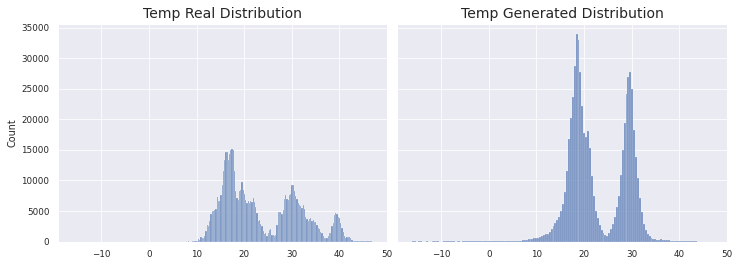

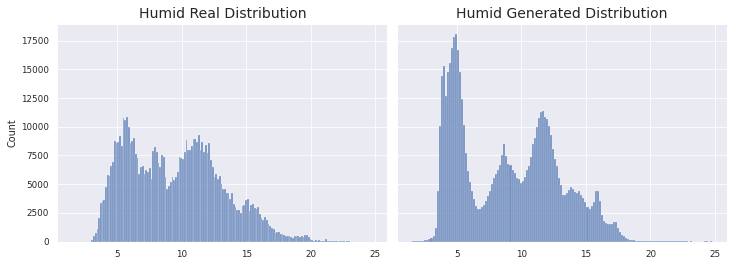

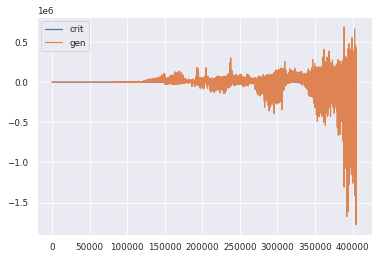

1966/1966 [==============================] - 156s 80ms/step - d_loss: 2.2201 - g_loss: 162383.8568
Epoch 207/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.0981 - g_loss: 178306.7893
KL Divergence Sum: 28.108641590362478 bits
Pinball Loss Temp mean: 3.8614771482062595
Pinball Loss Humid mean: 0.8486548895546038
MSE Temp: 7.722954296412491
MSE Humid: 1.6973097791092115


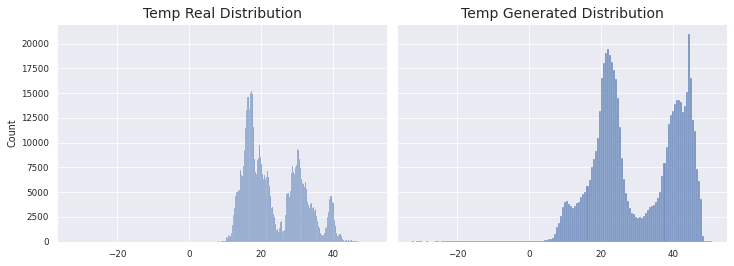

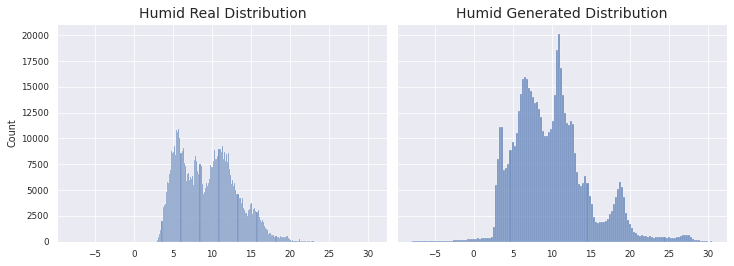

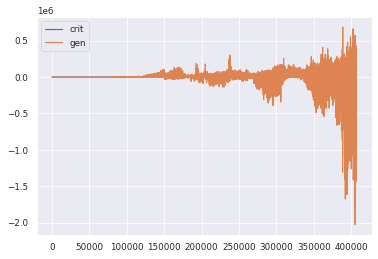

1966/1966 [==============================] - 158s 81ms/step - d_loss: -1.1041 - g_loss: 178218.9989
Epoch 208/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.1740 - g_loss: 119877.2946
KL Divergence Sum: 9.93239518966976 bits
Pinball Loss Temp mean: 2.9080133116932894
Pinball Loss Humid mean: 3.7781247193934093
MSE Temp: 5.816026623386551
MSE Humid: 7.5562494387869155


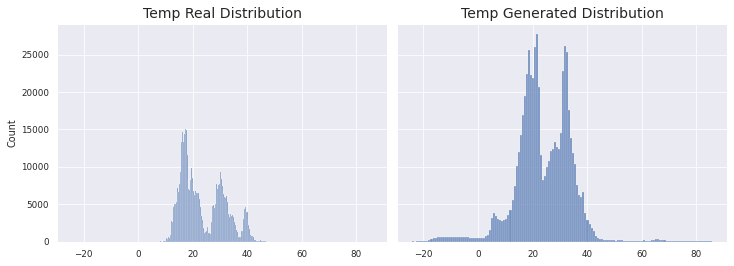

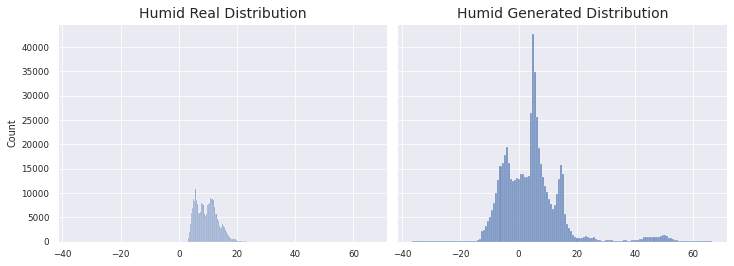

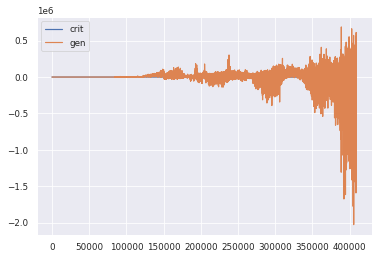

1966/1966 [==============================] - 158s 80ms/step - d_loss: 1.1723 - g_loss: 119962.8837
Epoch 209/500
1966/1966 [==============================] - ETA: 0s - d_loss: 1.2700 - g_loss: 163271.4288
KL Divergence Sum: 7.038524493726129 bits
Pinball Loss Temp mean: 2.535252373591078
Pinball Loss Humid mean: 0.7303028573103343
MSE Temp: 5.070504747182275
MSE Humid: 1.460605714620653


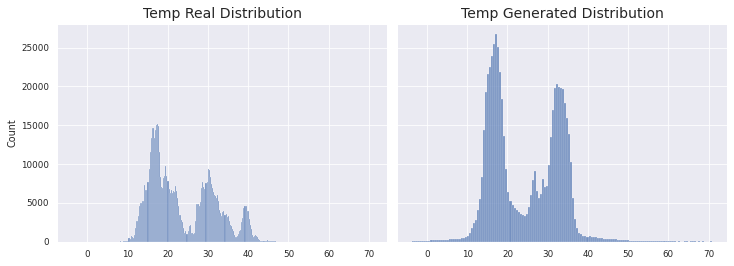

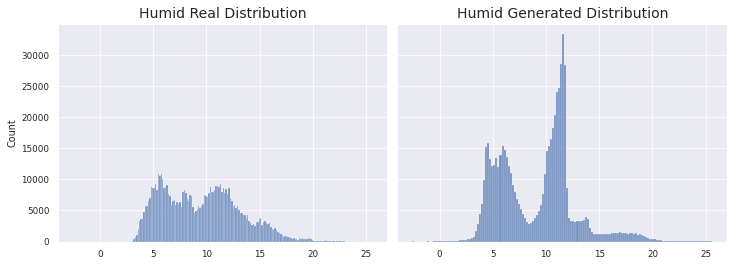

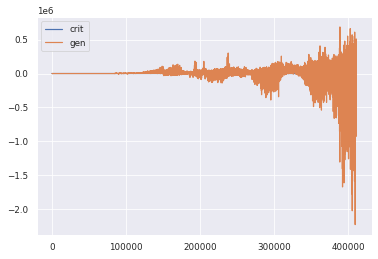

1966/1966 [==============================] - 158s 80ms/step - d_loss: 1.2715 - g_loss: 163001.8924
Epoch 210/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.9928 - g_loss: 205993.3836
KL Divergence Sum: 9.345413189254863 bits
Pinball Loss Temp mean: 6.858611116557613
Pinball Loss Humid mean: 2.5582787190299983
MSE Temp: 13.717222233115367
MSE Humid: 5.116557438059931


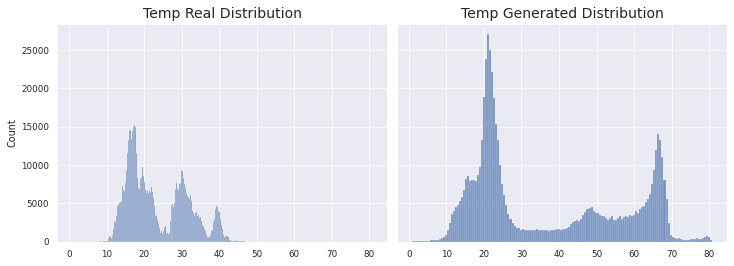

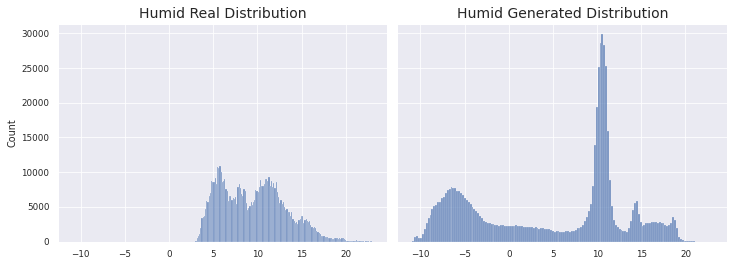

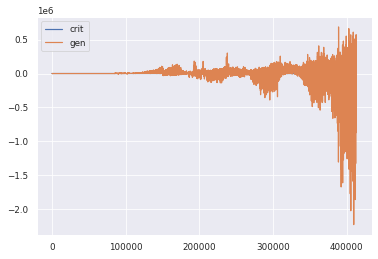

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.9917 - g_loss: 206058.8322
Epoch 211/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.1813 - g_loss: 107512.7014
KL Divergence Sum: 17.47437047784758 bits
Pinball Loss Temp mean: 2.705680977739214
Pinball Loss Humid mean: 1.250043035768512
MSE Temp: 5.4113619554783545
MSE Humid: 2.5000860715370217


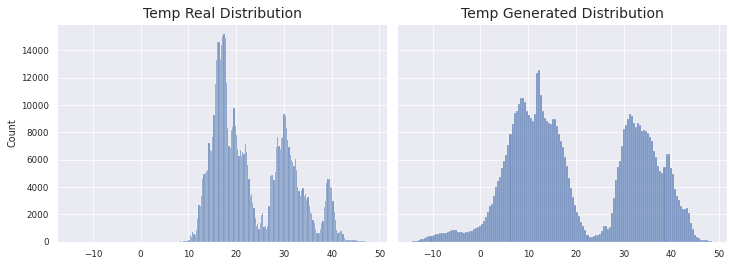

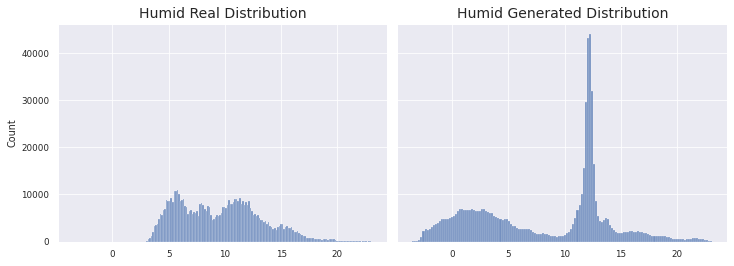

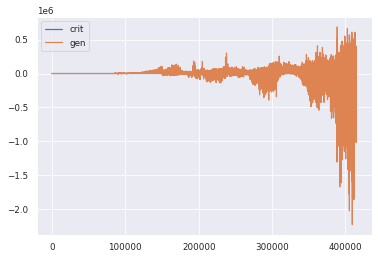

1966/1966 [==============================] - 158s 80ms/step - d_loss: 1.1812 - g_loss: 107389.6366
Epoch 212/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.7241 - g_loss: 106250.1787
KL Divergence Sum: 23.295342365920646 bits
Pinball Loss Temp mean: 1.663123743702089
Pinball Loss Humid mean: 0.7695968747401516
MSE Temp: 3.326247487404164
MSE Humid: 1.5391937494803298


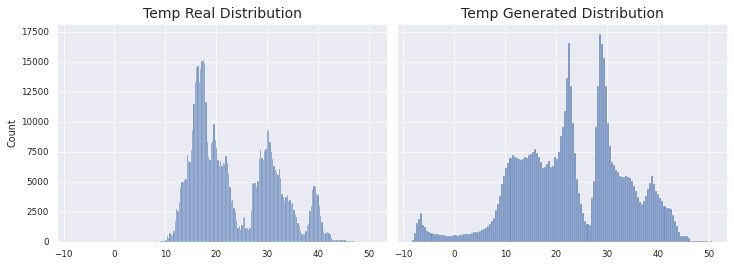

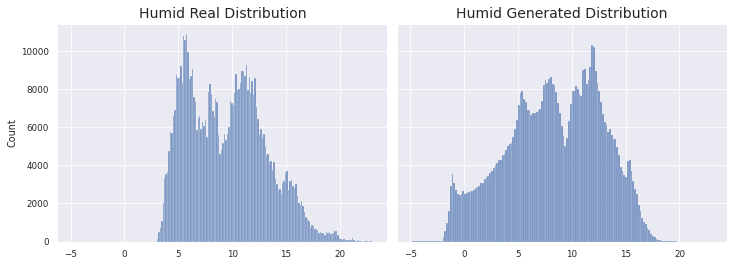

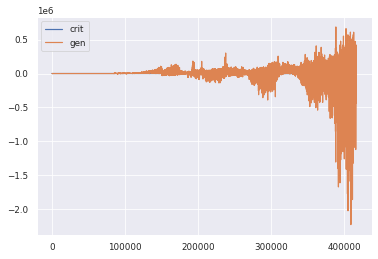

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.7234 - g_loss: 106167.9659
Epoch 213/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6156 - g_loss: 167236.8717
KL Divergence Sum: 18.061522530553543 bits
Pinball Loss Temp mean: 7.0418538229425325
Pinball Loss Humid mean: 2.774170523599852
MSE Temp: 14.083707645885195
MSE Humid: 5.548341047199659


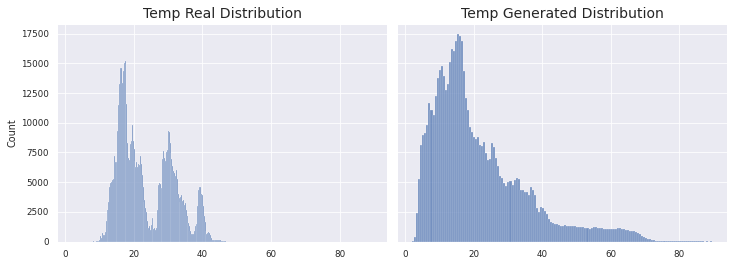

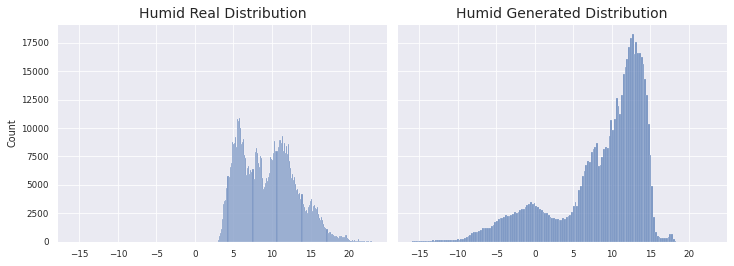

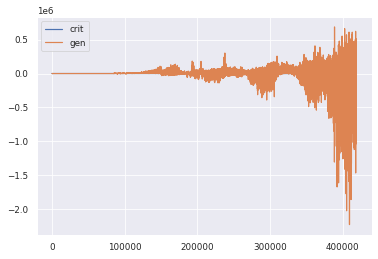

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.6150 - g_loss: 167318.5570
Epoch 214/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1103 - g_loss: 220687.5861
KL Divergence Sum: 16.387374208119365 bits
Pinball Loss Temp mean: 4.692992964678291
Pinball Loss Humid mean: 2.6928255165820367
MSE Temp: 9.385985929356501
MSE Humid: 5.3856510331640175


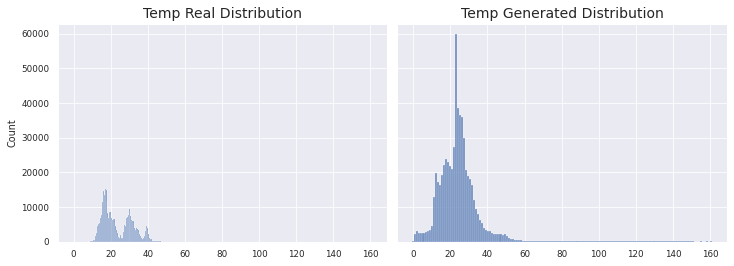

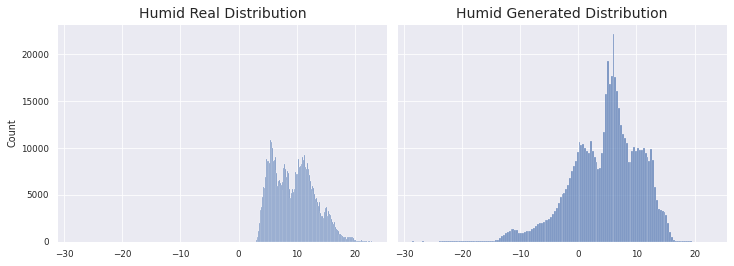

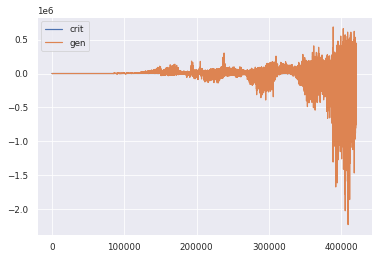

1966/1966 [==============================] - 156s 79ms/step - d_loss: 0.1095 - g_loss: 220546.3517
Epoch 215/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.0346 - g_loss: 100814.5117
KL Divergence Sum: 22.288216028696777 bits
Pinball Loss Temp mean: 3.944449909799603
Pinball Loss Humid mean: 1.4577150850879579
MSE Temp: 7.888899819599375
MSE Humid: 2.915430170175948


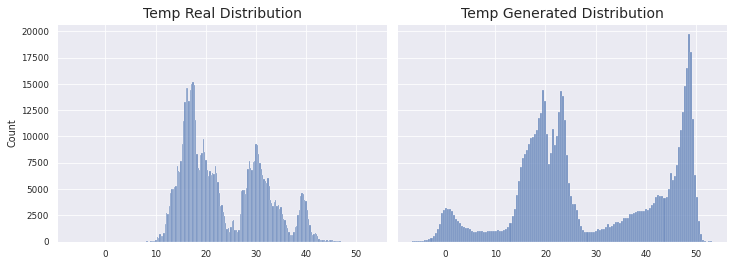

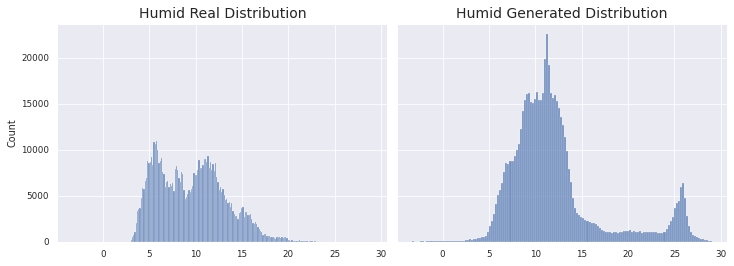

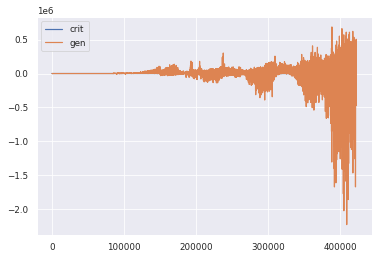

1966/1966 [==============================] - 158s 80ms/step - d_loss: 1.0336 - g_loss: 100702.8622
Epoch 216/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.4371 - g_loss: 122435.7650
KL Divergence Sum: 18.553953214176794 bits
Pinball Loss Temp mean: 9.202418180031767
Pinball Loss Humid mean: 2.160873869105432
MSE Temp: 18.40483636006384
MSE Humid: 4.321747738210896


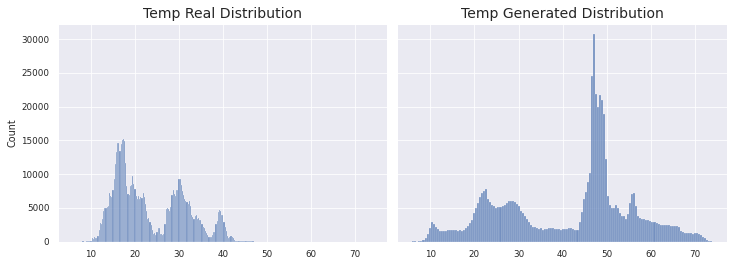

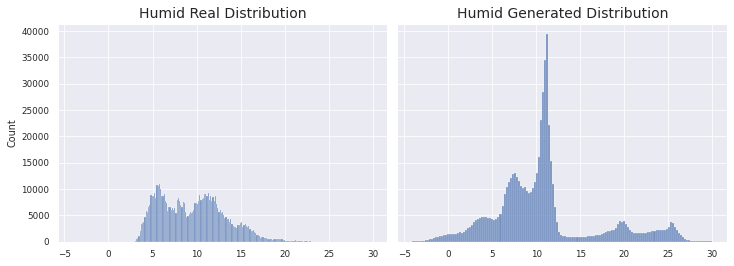

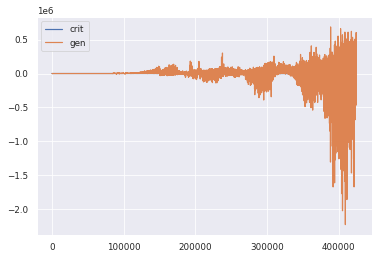

1966/1966 [==============================] - 157s 80ms/step - d_loss: 0.4366 - g_loss: 122448.0440
Epoch 217/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 1.4797 - g_loss: 112559.4482
KL Divergence Sum: 26.211790502341042 bits
Pinball Loss Temp mean: 3.4671929034697575
Pinball Loss Humid mean: 1.8560494359921136
MSE Temp: 6.934385806939543
MSE Humid: 3.7120988719842076


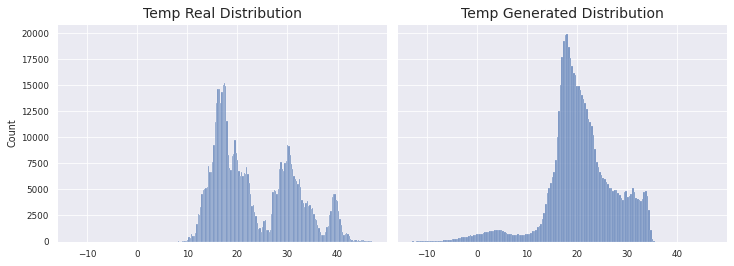

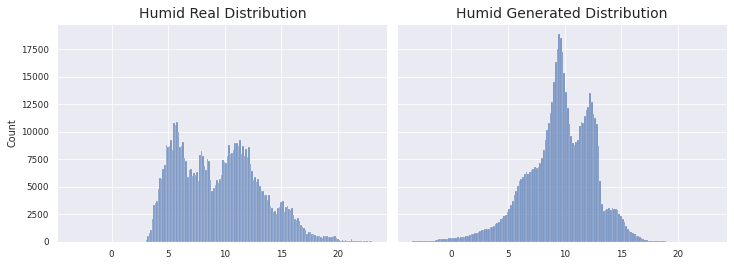

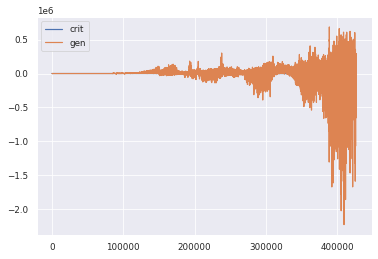

1966/1966 [==============================] - 160s 81ms/step - d_loss: 1.4780 - g_loss: 112610.5000
Epoch 218/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2912 - g_loss: 110065.8129
KL Divergence Sum: 12.857044652942227 bits
Pinball Loss Temp mean: 5.24441551644033
Pinball Loss Humid mean: 1.2425571145944798
MSE Temp: 10.488831032880745
MSE Humid: 2.485114229188934


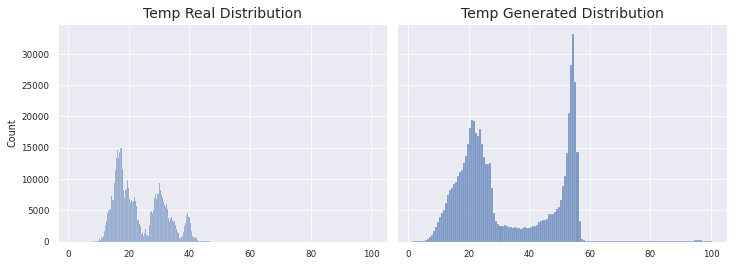

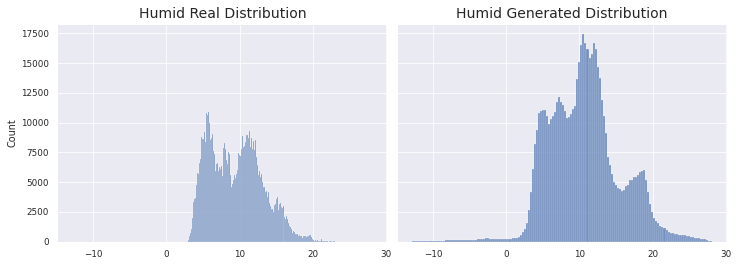

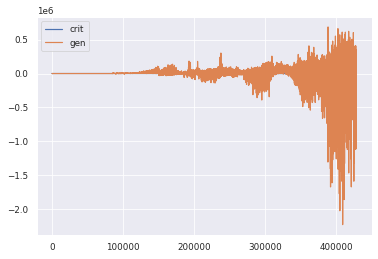

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2911 - g_loss: 110093.6678
Epoch 219/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -0.8458 - g_loss: 121207.7276
KL Divergence Sum: 19.051633184388685 bits
Pinball Loss Temp mean: 2.774055098226171
Pinball Loss Humid mean: 3.5632416005068963
MSE Temp: 5.548110196452351
MSE Humid: 7.12648320101372


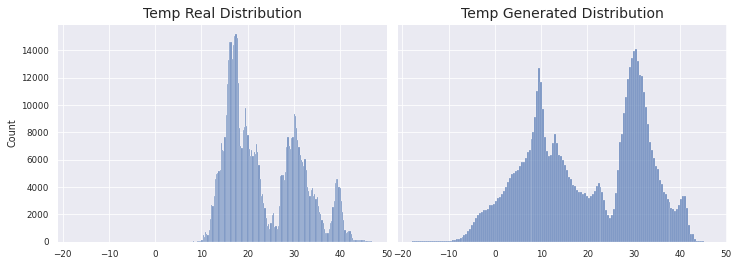

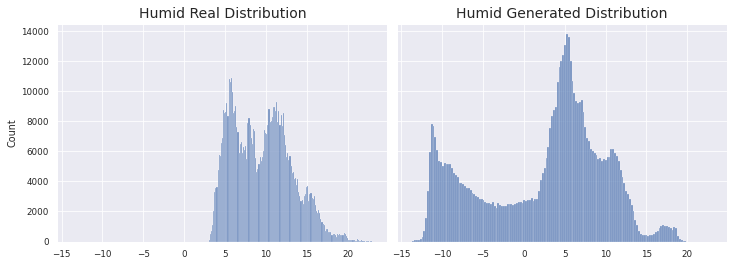

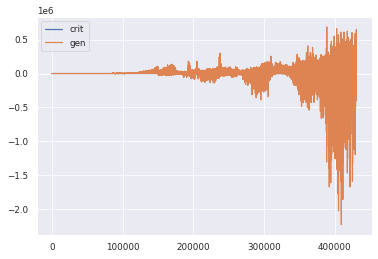

1966/1966 [==============================] - 161s 82ms/step - d_loss: -0.8450 - g_loss: 121363.3388
Epoch 220/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.6372 - g_loss: 128833.3599
KL Divergence Sum: 27.94435171767642 bits
Pinball Loss Temp mean: 3.479104961378797
Pinball Loss Humid mean: 0.7094524855051196
MSE Temp: 6.958209922757635
MSE Humid: 1.4189049710102417


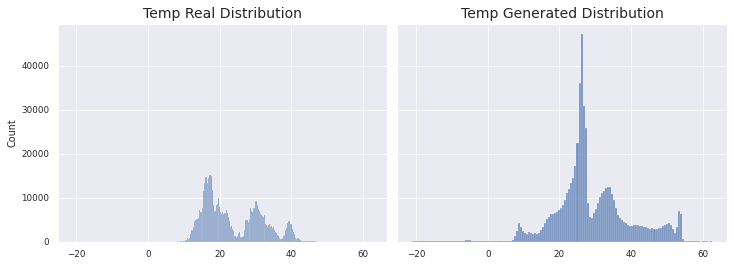

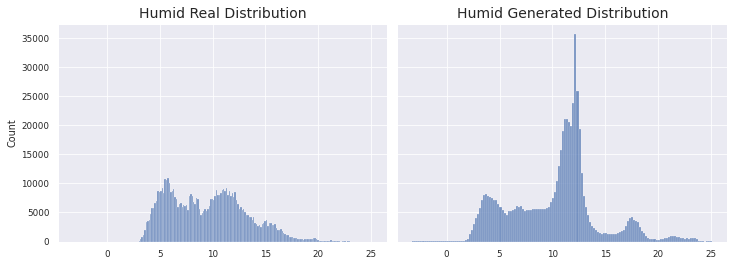

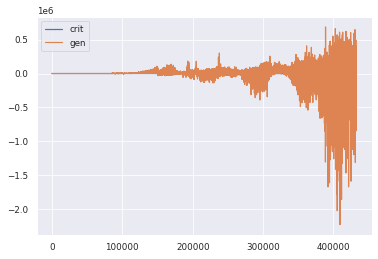

1966/1966 [==============================] - 158s 80ms/step - d_loss: 0.6365 - g_loss: 128927.9258
Epoch 221/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5608 - g_loss: 105789.7244
KL Divergence Sum: 6.02047423139807 bits
Pinball Loss Temp mean: 1.391422623342691
Pinball Loss Humid mean: 0.5339647206029097
MSE Temp: 2.7828452466853526
MSE Humid: 1.0679294412058378


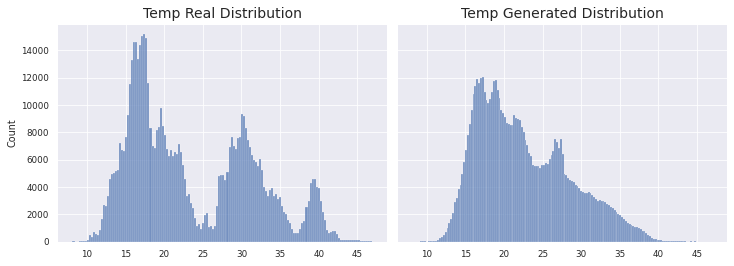

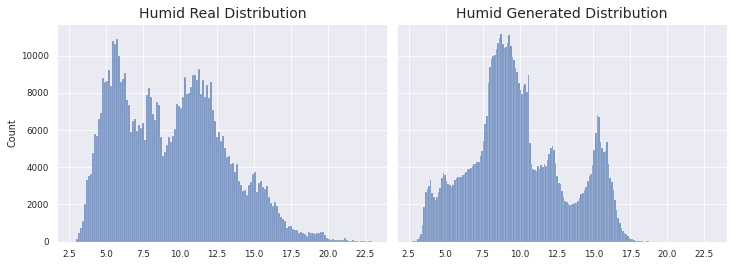

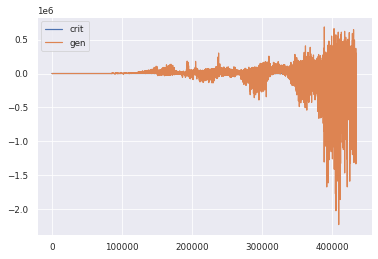

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.5601 - g_loss: 105763.2428
Epoch 222/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.1472 - g_loss: 112753.6960
KL Divergence Sum: 21.660734401658647 bits
Pinball Loss Temp mean: 5.500472534115618
Pinball Loss Humid mean: 4.551435029519446
MSE Temp: 11.000945068231204
MSE Humid: 9.102870059038896


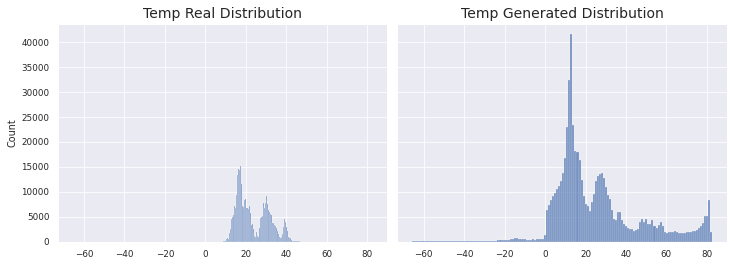

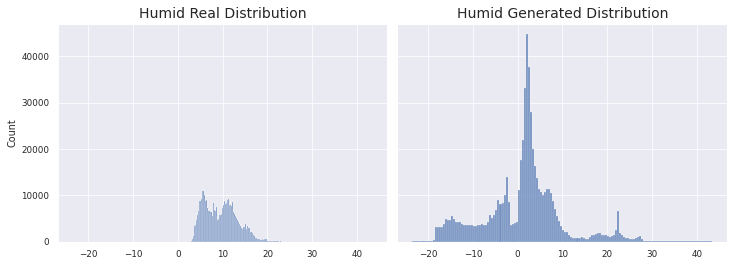

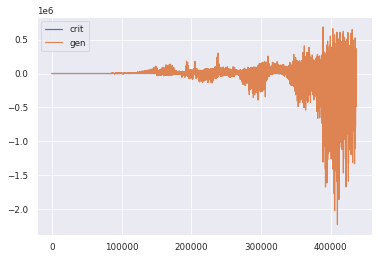

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.1471 - g_loss: 112708.3397
Epoch 223/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5463 - g_loss: 77675.9067
KL Divergence Sum: 23.120090824476947 bits
Pinball Loss Temp mean: 1.7319742246956706
Pinball Loss Humid mean: 0.5734203217029527
MSE Temp: 3.463948449391327
MSE Humid: 1.1468406434059109


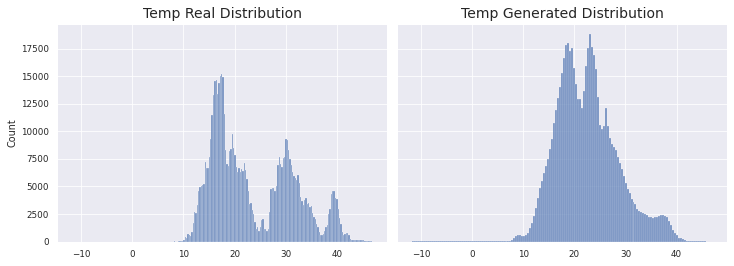

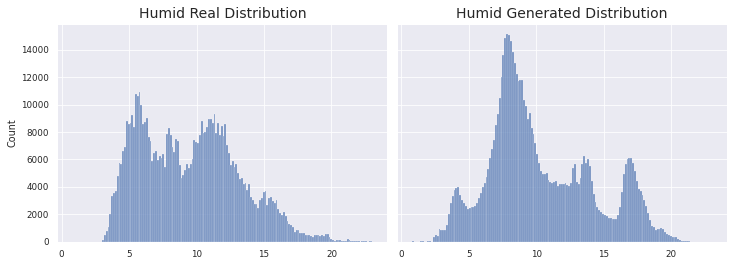

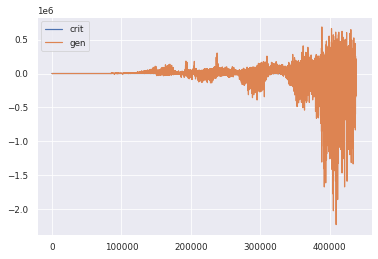

1966/1966 [==============================] - 160s 81ms/step - d_loss: 0.5457 - g_loss: 77652.2575
Epoch 224/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.2743 - g_loss: 89359.0933
KL Divergence Sum: 20.65163011926021 bits
Pinball Loss Temp mean: 6.105183536166358
Pinball Loss Humid mean: 1.840452822994862
MSE Temp: 12.210367072332609
MSE Humid: 3.680905645989632


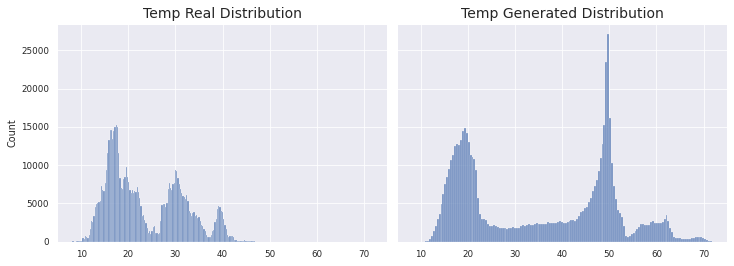

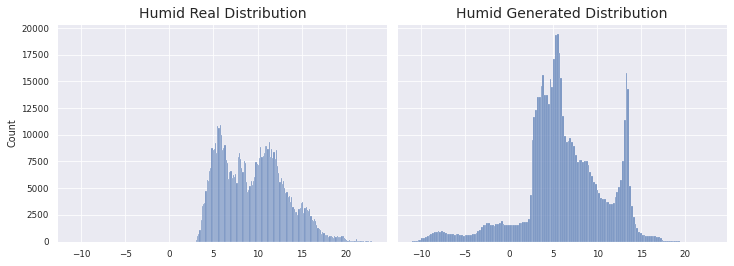

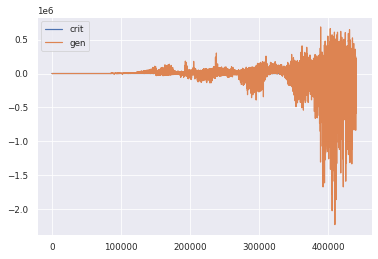

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.2740 - g_loss: 89357.2334
Epoch 225/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.5408 - g_loss: 97430.3563
KL Divergence Sum: 6.701027294736084 bits
Pinball Loss Temp mean: 1.6470974414828383
Pinball Loss Humid mean: 0.5267196223469716
MSE Temp: 3.294194882965698
MSE Humid: 1.053439244693941


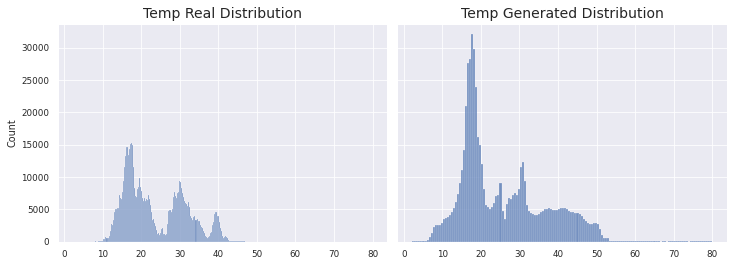

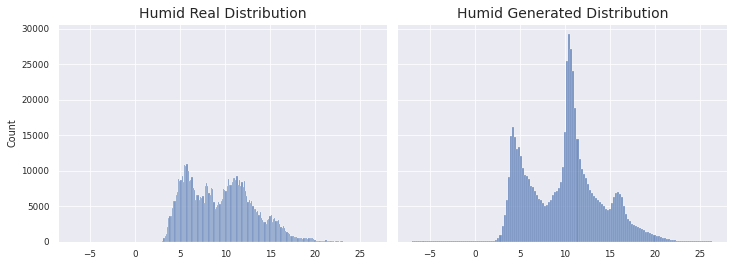

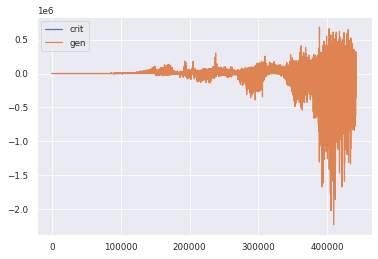

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.5402 - g_loss: 97448.2294
Epoch 226/500
1966/1966 [==============================] - ETA: 0s - d_loss: 0.6355 - g_loss: 111024.1094
KL Divergence Sum: 13.21519286033505 bits
Pinball Loss Temp mean: 8.40553221923507
Pinball Loss Humid mean: 5.615367789889405
MSE Temp: 16.811064438470154
MSE Humid: 11.230735579778605


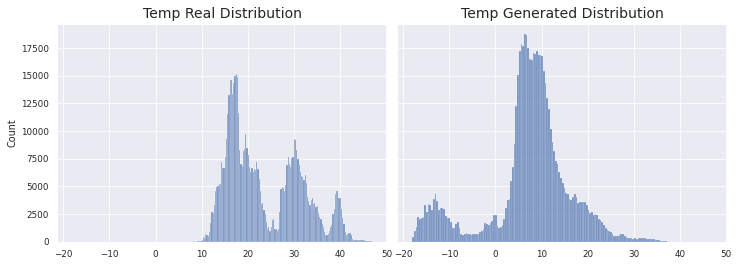

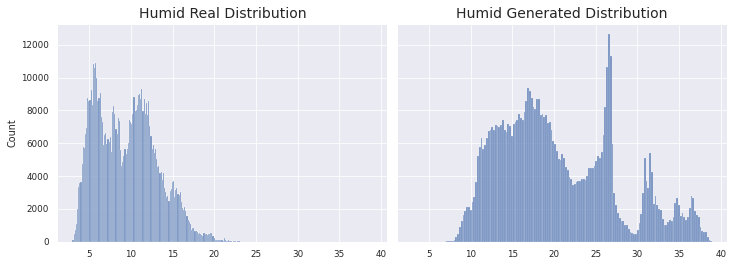

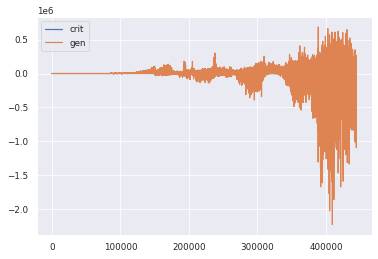

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.6351 - g_loss: 111035.7522
Epoch 227/500
1965/1966 [============================>.] - ETA: 0s - d_loss: 0.0696 - g_loss: 114886.2726
KL Divergence Sum: 5.948051686859866 bits
Pinball Loss Temp mean: 3.450975527921293
Pinball Loss Humid mean: 3.129287676682277
MSE Temp: 6.901951055842596
MSE Humid: 6.25857535336451


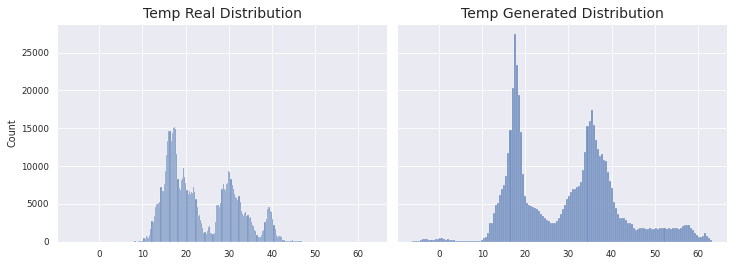

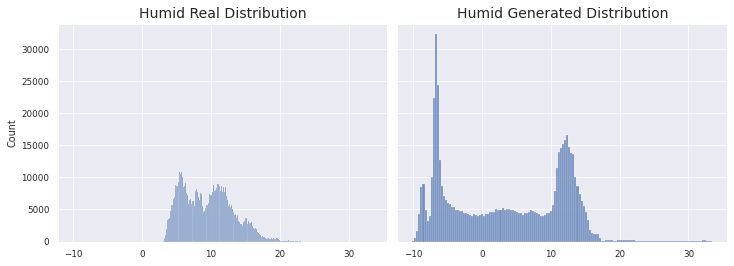

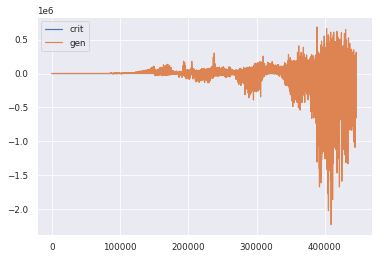

1966/1966 [==============================] - 159s 81ms/step - d_loss: 0.0691 - g_loss: 114874.5590
Epoch 228/500
1965/1966 [============================>.] - ETA: 0s - d_loss: -1.2542 - g_loss: 130735.6876
KL Divergence Sum: 21.820251324584106 bits
Pinball Loss Temp mean: 5.620255945752257
Pinball Loss Humid mean: 3.187379318960732
MSE Temp: 11.240511891504308
MSE Humid: 6.374758637921587


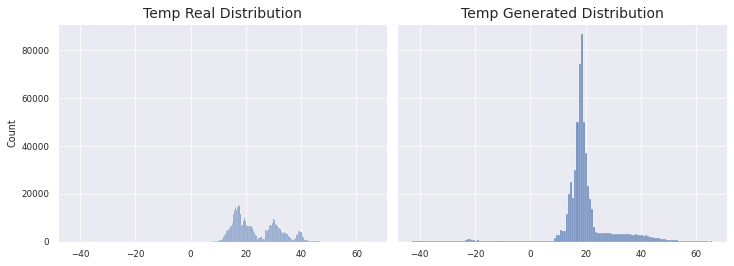

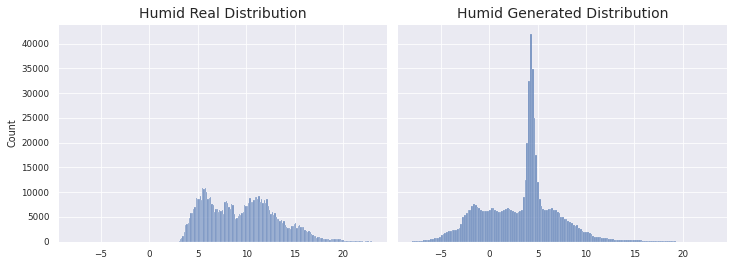

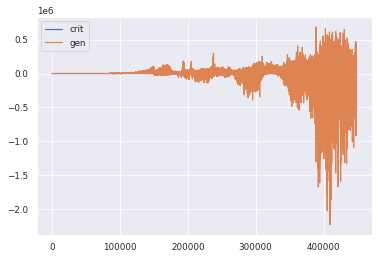

1966/1966 [==============================] - 159s 81ms/step - d_loss: -1.2666 - g_loss: 130680.2572
Epoch 229/500
 493/1966 [======>.......................] - ETA: 48s - d_loss: -5.1852 - g_loss: 164153.9413

KeyboardInterrupt: ignored

In [ ]:
# prueba_2
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 500
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_1_v2
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 200
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=5,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# prueba_1
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2), n_classes=35)
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
print('Created the Generator Model')
# Epochs to train
epochs = 500
# Callbacks
cbk = GANMonitor(num_test=X_val_len, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=5,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
X_to_fit = np.concatenate((X_sc,y_sc),axis=1)
history = wgan.fit(x=X_to_fit, y=label_sc, batch_size=64, epochs=epochs, callbacks=[cbk])

### History of trainings

In [ ]:
# octubre_22_WGAN-GP_Adam
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2))
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim, in_shape=(24, 2))
print('Created the Generator Model')
# Epochs to train
epochs = 500
# Callbacks
cbk = GANMonitor(num_test=5000, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
history = wgan.fit(X_train_WGAN, batch_size=64, epochs=epochs, callbacks=[cbk])

In [ ]:
# octubre_20
# size of the latent space
latent_dim = 8
# create the critic
d_model = define_critic(in_shape=(25, 2))
print('Createdy_next_step the Discriminator Model')
# create the generator
g_model = define_generator(latent_dim, in_shape=(24, 2))
print('Created the Generator Model')
# Epochs to train
epochs = 500
# Callbacks
cbk = GANMonitor(num_test=5000, latent_dim=latent_dim)
# Get the wgan model
wgan = WGAN(
    discriminator=d_model,
    generator=g_model,
    latent_dim=latent_dim,
    discriminator_extra_steps=1,
)
# Compile the wgan model
wgan.compile(
    d_optimizer=d_opt_Adam,
    g_optimizer=g_opt_Adam,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)
# Start training
history = wgan.fit(X_train_WGAN, batch_size=32, epochs=epochs, callbacks=[cbk])

## Scenario Generation

In [ ]:
n_model = 45
latent_dim = 8

selected_generator = define_generator(latent_dim=latent_dim, in_shape=(24, 2), n_classes=35)
selected_critic = define_critic(in_shape=(25, 2), n_classes=35)

model_gen_name = '/content/drive/My Drive/TFM/Experiments/' + '/gen_model_' + str(n_model) + '_KL_Pinball_MSE'

selected_generator.load_weights(model_gen_name)

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Time-Series_Input (InputLayer)  [(None, 24, 2)]     0           []                               
                                                                                                  
 Categorical_Input (InputLayer)  [(None, 1)]         0           []                               
                                                                                                  
 lstm_2 (LSTM)                  (None, 24, 160)      104320      ['Time-Series_Input[0][0]']      
                                                                                                  
 embedding_2 (Embedding)        (None, 1, 8)         280         ['Categorical_Input[0][0]']      
                                                                                            

### +/- measures

In [ ]:
KLs = np.array([])
Pinballs_temp = np.array([])
Pinballs_hum = np.array([])
MSEs_temp = np.array([])
MSEs_humid = np.array([])

for n_tests in range(15):
  n_prediction = 24
  n_samples = X_test_len

  # Get predictions
  X_aux_2 = np.copy(X_test)
  for p in range(n_prediction):
    noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=2.5)
    y_gen_ = selected_generator.predict([X_aux_2, label_test, noise_input]) #Step 1: Predict [val_len,2]
    y_gen = y_gen_[:,np.newaxis,:] #[val_len,1,2]
    if p == 0: #Step 2: Save prediction
      y_gen_final = y_gen.copy() 
    else:
      y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
    X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
    X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 

  # invert scale
  y_real_inv = np.empty(y_test_real_long.shape)
  y_gen_inv = np.empty(y_gen_final.shape)
  X_cond_inv = np.empty(X_test.shape)
  for s in range(n_samples):
    for r in range(n_prediction):
      y_real_inv[s,r,0] = (y_test_real_long[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_real_inv[s,r,1] = (y_test_real_long[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
      y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
    for t in range(n_prediction):
      X_cond_inv[s,t,0] = (X_test[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
      X_cond_inv[s,t,1] = (X_test[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
    
  temp_real = y_real_inv[:,:,0]
  flat_temp_real = temp_real.flatten()
  temp_gen = y_gen_inv[:,:,0]
  flat_temp_gen = temp_gen.flatten()
  humid_real = y_real_inv[:,:,1]
  flat_humid_real = humid_real.flatten()
  humid_gen = y_gen_inv[:,:,1]
  flat_humid_gen = humid_gen.flatten()

  ### METRICS ###

  # KL divergence with 2D histogram
  H_compute_bins_temp = np.histogram(flat_temp_real, bins='auto')
  H_compute_bins_humid = np.histogram(flat_humid_real, bins='auto')
  n_bins_temp = H_compute_bins_humid[0].shape[0]
  n_bins_humid = H_compute_bins_humid[0].shape[0]
  # If we add more than 2 variables we will need to use np.histogramdd
  H_real, xedges_real, yedges_real = np.histogram2d(flat_temp_real, flat_humid_real, bins=[n_bins_temp,n_bins_humid])
  H_real = (np.where(H_real==0, 1e-6, H_real).flatten())/len(flat_temp_real)
  H_gen, xedges_gen, yedges_gen = np.histogram2d(flat_temp_gen, flat_humid_gen, bins=[n_bins_temp,n_bins_humid])
  H_gen = (np.where(H_gen==0, 1e-6, H_gen).flatten())/len(flat_temp_gen)
  assert isclose(sum(H_real),1.,rel_tol=1e-5)
  assert isclose(sum(H_gen), 1.,rel_tol=1e-5)
  KL_diverg = kl_divergence(H_gen,H_real)

  # Pinball Loss Function
  pinball_temp = list()
  pinball_humid = list()
  tau = [0.1, 0.3, 0.5, 0.7, 0.9]
  for t in tau:
    pinball_temp.append(pinball_func(flat_temp_real, flat_temp_gen, tau=t))
    pinball_humid.append(pinball_func(flat_humid_real, flat_humid_gen, tau=t))

  pinball_mean_temp = sum(pinball_temp)/(len(pinball_temp))
  pinball_mean_humid = sum(pinball_humid)/(len(pinball_humid))
  Pinball_mean = (pinball_mean_temp + pinball_mean_humid)/2

  #MSE
  MSE_temp = mean_absolute_error(flat_temp_real, flat_temp_gen)
  MSE_humid = mean_absolute_error(flat_humid_real, flat_humid_gen)

  #append values
  KLs = np.append(KLs, KL_diverg)
  Pinballs_temp = np.append(Pinballs_temp, pinball_mean_temp)
  Pinballs_hum = np.append(Pinballs_hum, pinball_mean_humid)
  MSEs_temp = np.append(MSEs_temp, MSE_temp)
  MSEs_humid = np.append(MSEs_humid, MSE_humid)

  print(n_tests)

RMSEs_temp = np.sqrt(MSEs_temp)
RMSEs_humid = np.sqrt(MSEs_humid)

mu_KLs = np.mean(KLs)
std_KLs = np.std(KLs)
mu_P_t = np.mean(Pinballs_temp)
std_P_t = np.std(Pinballs_temp)
mu_P_h = np.mean(Pinballs_hum)
std_P_h = np.std(Pinballs_hum)
mu_M_t = np.mean(MSEs_temp)
std_M_t = np.std(MSEs_temp)
mu_R_t = np.mean(RMSEs_temp)
std_R_t = np.std(RMSEs_temp)
mu_M_h = np.mean(MSEs_humid)
std_M_h = np.std(MSEs_humid)
mu_R_h = np.mean(RMSEs_humid)
std_R_h = np.std(RMSEs_humid)

print(f'KL: {mu_KLs} ± {std_KLs} bits')
print(f'Pinball Temp: {mu_P_t} ± {std_P_t}')
print(f'Pinball Humid: {mu_P_h} ± {std_P_h}')
print(f'MSE Temp: {mu_M_t} ± {std_M_t} ºC²')
print(f'RMSE Temp: {mu_R_t} ± {std_R_t} ºC')
print(f'MSE Humid: {mu_M_h} ± {std_M_h} %²')
print(f'RMSE Humid: {mu_R_h} ± {std_R_h} %')

In [ ]:
KLs

### Validation data vs. Real data with the selected model

In [ ]:
flat_temp_real = np.load('45_temp_real.npy').flatten()
flat_temp_gen = np.load('45_temp_gen.npy').flatten()
flat_humid_real = np.load('45_humid_real.npy').flatten()
flat_humid_gen = np.load('45_humid_gen.npy').flatten()

temp_real_df = pd.DataFrame(flat_temp_real, columns=['Temperature'])
temp_real_df['Source'] = 'Real'
temp_gen_df = pd.DataFrame(flat_temp_gen, columns=['Temperature'])
temp_gen_df['Source'] = 'Generated'
temp_df = pd.concat([temp_real_df, temp_gen_df])

plt.figure(figsize=(12,5.5))
sns.histplot(data=temp_df, x='Temperature', bins='auto', hue='Source').set(title='Temp Real / Generated Distributions - 24 time-steps predictions')

humid_real_df = pd.DataFrame(flat_humid_real, columns=['Humidity'])
humid_real_df['Source'] = 'Real'
humid_gen_df = pd.DataFrame(flat_humid_gen, columns=['Humidity'])
humid_gen_df['Source'] = 'Generated'
humid_df = pd.concat([humid_real_df, humid_gen_df])

plt.figure(figsize=(12,5.5))
sns.histplot(data=humid_df, x='Humidity', bins='auto', hue='Source').set(title='Humid Real / Generated Distributions - 24 time-steps predictions')

In [ ]:
temp_real_df = pd.DataFrame(flat_temp_real, columns=['Temperature'])
temp_real_df['Source'] = 'Real'
temp_gen_df = pd.DataFrame(flat_temp_gen, columns=['Temperature'])
temp_gen_df['Source'] = 'Generated'
temp_df = pd.concat([temp_real_df, temp_gen_df])

humid_real_df = pd.DataFrame(flat_humid_real, columns=['Humidity'])
humid_gen_df = pd.DataFrame(flat_humid_gen, columns=['Humidity'])
humid_df = pd.concat([humid_real_df, humid_gen_df])

temp_df['Humidity'] = humid_df

In [ ]:
plt.figure(figsize=(10,10))
g = sns.JointGrid(data=temp_df, x='Humidity', y='Temperature', height=7, hue='Source')
g.plot_joint(sns.scatterplot, s=0.3)
g.plot_marginals(sns.boxplot)

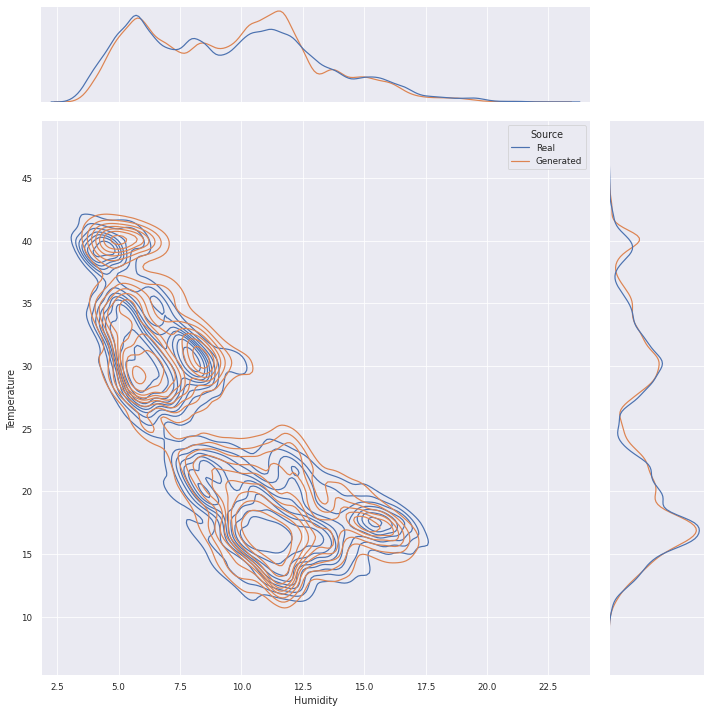

In [ ]:
sns.jointplot(data=temp_df, x='Humidity', y='Temperature',  hue='Source', kind='kde', height=10, thresh=0.12, fill=False)

### Random Exploration of Latent Space

In [ ]:
n_samples = 20
n_scenarios = 6
n_prediction = 24

# Get real values
max_ix = 9999999
security_margin = len(list_ix) - (n_steps_in) 
while (max_ix > security_margin):
  ix_plot = np.random.choice(X_val_range, n_samples, replace=False)
  max_ix = np.amax(ix_plot)

X_cond = np.copy(X_sc[ix_plot])
X_label = np.copy(label_sc[ix_plot])
y_real = np.empty([n_samples, n_prediction, 2])
for k, index in enumerate(ix_plot):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real[k,:,:] = y_real_
print(f'y_real shape {y_real.shape}')

# Get predictions
# Final shape: [n_samples, n_scenarios, lenght, 2]
for scen in range(n_scenarios):
  X_aux_2 = np.copy(X_cond)
  for p in range(n_prediction):
    noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=2.8)
    y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict [n_samples,2]
    y_gen = y_gen_[:,np.newaxis,:] #[n_samples,1,2]
    if p == 0: #Step 2: Save prediction
      y_gen_final = np.copy(y_gen)
    else:
      y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
    X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
    X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
  y_gen_final_aux = y_gen_final[:, np.newaxis, :, :]
  if scen == 0:
    y_gen_final_final = np.copy(y_gen_final_aux)
  else:
    y_gen_final_final = np.concatenate((y_gen_final_final, y_gen_final_aux), axis=1)

print(f'y generated shape: {y_gen_final_final.shape}') #shape: [20, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real.shape)
y_gen_inv = np.empty(y_gen_final_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(n_prediction):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].legend(['Ground Truth','Scenario 1', 'Scenario 2', 'Scenario 3', 'Scenario 4', 'Scenario 5', 'Scenario 6'], fontsize='10')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=12)
    plt.show()
    plt.close()


Output hidden; open in https://colab.research.google.com to view.

### Anomaly

In [ ]:
n_plots = 100
n_samples = 1
n_scenarios = 6
n_prediction = 24
#Anomaly
sigma_temp = (b-a)*1.2/(diff_temp)
sigma_humid = (b-a)*0.45/(diff_humid)
sigma_factor = 0.3

for _ in range(n_plots):
  # Get real values
  max_ix = 9999999
  security_margin = len(list_ix) - (n_steps_in) 
  while (max_ix > security_margin):
    ix_plot = np.random.choice(test_ix, n_samples, replace=False)
    max_ix = np.amax(ix_plot)

  X_cond = np.copy(X_sc[ix_plot])
  X_label = np.copy(label_sc[ix_plot])
  y_real = np.empty([n_samples, n_prediction, 2])
  for k, index in enumerate(ix_plot):
    index_plus = index + n_prediction
    y_real_ = y_sc[index:index_plus, :, :]
    y_real_ = y_real_.reshape(1, n_prediction, 2)
    y_real[k,:,:] = y_real_
  print(f'y_real shape {y_real.shape}')

  # Get predictions
  # Final shape: [n_samples, n_scenarios, lenght, 2]
  for scen in range(n_scenarios):
    X_aux_2 = np.copy(X_cond)
    for p in range(n_prediction):
      # Anomaly
      if p == 9:
        while True:
          noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=10)
          temp_before = y_gen_final[:,-1,0]
          humid_before = y_gen_final[:,-1,1]
          y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict [n_samples,2] 
          #diff_anomaly_temp = np.absolute(y_gen_[:,0] - temp_before)
          #diff_anomaly_humid = np.absolute(y_gen_[:,1] - humid_before)
          diff_anomaly_temp = y_gen_[:,0] - temp_before
          mean_diff_anomaly_temp = np.mean(diff_anomaly_temp)
          diff_anomaly_humid = y_gen_[:,1] - humid_before
          mean_diff_anomaly_humid = np.mean(diff_anomaly_humid)
          # print(np.mean(diff_anomaly_temp), np.mean(diff_anomaly_humid))
          if ((mean_diff_anomaly_temp > sigma_temp*sigma_factor) and (mean_diff_anomaly_humid < -(sigma_humid*sigma_factor)) or ((mean_diff_anomaly_temp < -(sigma_temp*sigma_factor)) and (mean_diff_anomaly_humid > sigma_humid*sigma_factor))):
            y_gen = y_gen_[:,np.newaxis,:] #[n_samples,1,2]     
            break
      else:
        noise_input = tf.random.normal(shape=(n_samples, latent_dim), mean=0.0, stddev=2.8)
        y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict [n_samples,2]
        y_gen = y_gen_[:,np.newaxis,:] #[n_samples,1,2]
      if p == 0: #Step 2: Save prediction
        y_gen_final = np.copy(y_gen)
      else:
        y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
      X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    y_gen_final_aux = y_gen_final[:, np.newaxis, :, :]
    if scen == 0:
      y_gen_final_final = np.copy(y_gen_final_aux)
    else:
      y_gen_final_final = np.concatenate((y_gen_final_final, y_gen_final_aux), axis=1)

  print(f'y generated shape: {y_gen_final_final.shape}') #shape: [20, 10, 24, 2]

  # invert scale
  y_real_inv = np.empty(y_real.shape)
  y_gen_inv = np.empty(y_gen_final_final.shape)
  X_cond_inv = np.empty(X_cond.shape)
  #real
  for s in range(n_samples):
    for r in range(n_prediction):
      y_real_inv[s,r,0] = (y_real[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_real_inv[s,r,1] = (y_real[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
    for t in range(n_prediction):
      X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
      X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
  #generated
  for s in range(n_samples): #20
    for q in range(n_scenarios): #10
      for r in range(n_prediction): #24
        y_gen_inv[s,q,r,0] = (y_gen_final_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
        y_gen_inv[s,q,r,1] = (y_gen_final_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

  # plot images
  for i in range(n_samples):
    print(f'Sensor #{X_label[i]}')
    for j in range(2):
      fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
      axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
      name = dict_variables[j] + ' - Input'
      axs[0].set_title(name, fontsize=16)
      axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
      for img in range(n_scenarios):
        axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
      axs[1].legend(['Ground Truth','Scenario 1', 'Scenario 2', 'Scenario 3', 'Scenario 4', 'Scenario 5', 'Scenario 6'], fontsize='10')
      axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=12)
      plt.show()
      plt.close()


Output hidden; open in https://colab.research.google.com to view.

### MH-GAN


In [ ]:
# calibrate the discriminator with Isotonic Regression
from sklearn.isotonic import IsotonicRegression

calibrator = IsotonicRegression(0,1)

# take 20% of training set to calibrate
n_samples = round(len(list_ix)*0.2)
ix_plot = np.random.choice(list_ix[:-24], n_samples, replace=False)
X_cond = np.copy(X_sc[ix_plot])
X_label = np.copy(label_sc[ix_plot])
y_test = np.copy(y_sc[ix_plot])

noise_calibrate = tf.random.normal(shape=(n_samples, latent_dim))
test_gen_ = selected_generator.predict([X_cond,X_label,noise_calibrate]) # [n_samples, 2]
test_gen = test_gen_[:,np.newaxis,:] #[n_samples,1,2]
input_cal_gen = np.concatenate((X_cond,test_gen), axis=1)  #shape:[n_samples,25,2]
print(input_cal_gen.shape)
# real test input to discriminator
input_cal_real = np.concatenate((X_cond,y_test), axis=1) #shape:[n_samples,25,2]
print(input_cal_real.shape)
# concatenate gen and real
input_cal = np.concatenate((input_cal_real,input_cal_gen), axis=0)
input_label = np.concatenate((X_label,X_label), axis=0)
# predict
predict_cal = selected_critic.predict([input_cal, input_label]).reshape((n_samples*2,))
print(predict_cal.shape)
y_cal = np.array([0]*n_samples + [1]*n_samples)
# fit calibrator
calibrator.fit(predict_cal, y_cal)

(25153, 25, 2)
(25153, 25, 2)
(50306,)


IsotonicRegression(increasing=True, out_of_bounds='nan', y_max=1, y_min=0)

In [ ]:
def calibrated_score(X, label, calibrator):
  s = selected_critic.predict([X, label]).reshape((X.shape[0],)) # [X.shape[0],]
  return calibrator.transform(s) # [X.shape, 1]

In [ ]:
n_prediction = 24
n_samples = 50
n_scenarios = 6
n_steps_MH_GAN = 20

# get random samples (index)
ix = random.sample(list_ix[:-24], k=n_samples)

# final numpy arrays
y_real_final = np.empty([n_samples,n_prediction,2]) #shape:[10,12,2]

# real values
for k, index in enumerate(ix):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real_final[k,:,:] = y_real_
print(f'y_real shape {y_real_final.shape}')

X_cond = np.copy(X_sc[ix])
X_label = np.copy(label_sc[ix])

# get predictions
y_gen_final = np.empty([n_samples, n_scenarios, n_prediction, 2])
for n in range(n_samples):
  X_aux_2 = X_cond[n].reshape(1,24,2)
  X_label_in = X_label[n].reshape(1,)
  for scen in range(n_scenarios):
    for p in range(n_prediction): 
      # initial real sample
      ix_init = random.sample(list_ix[:-24], k=1)
      X_ = X_sc[ix_init] #[1,24,2]
      y = y_sc[ix_init] #[1, 1,2]
      X = np.concatenate((X_,y), axis=1)
      X_label_init = label_sc[ix_init]
      y_score = calibrated_score(X, X_label_init, calibrator) #[1,1]
      for iter in range(n_steps_MH_GAN): #number of tries of new vector inputs
        # generate sample
        noise_point = tf.random.normal(shape=(1, latent_dim), stddev=2.3) #shape:[1,Latent_dim]
        if iter == 0:
          selected_noise_point = noise_point
        y_gen_MH_GAN_ = selected_generator.predict([X_aux_2, X_label_in, noise_point]) #Step 1: Predict [1,2]
        y_gen_MH_GAN = y_gen_MH_GAN_[:,np.newaxis,:] #[1,1,2]
        In_MH_GAN = np.concatenate((X_aux_2,y_gen_MH_GAN), axis=1)  #shape:[1,25,2]
        Scores_MH_GAN = calibrated_score(In_MH_GAN, X_label_in, calibrator)  #shape:[1,]
        u = np.random.uniform(0,1)
        if u >= np.fmin(1, ( (1/y_score - 1)/(1/Scores_MH_GAN - 1))):
          print('JUMP!')
          y_score = Scores_MH_GAN
          selected_noise_point = noise_point

      y_gen_ = selected_generator.predict([X_aux_2, X_label_in, selected_noise_point]) #Step 1: Predict [1,2]
      y_gen = y_gen_[:,np.newaxis,:] #[1,1,2]
      y_gen_final[n,scen,p,:] = y_gen_ #Step 2: Save prediction
      X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    X_aux_2 = X_cond[n].reshape(1,24,2)
  print(f'Working... {(100/n_samples)*(n+1)}%')

print(y_gen_final.shape) #shape: [6, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real_final.shape)
y_gen_inv = np.empty(y_gen_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(24):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=16)
    plt.show()
    plt.close()

In [ ]:
n_prediction = 24
n_samples = 50
n_scenarios = 6
n_steps_MH_GAN = 20

# get random samples (index)
ix = random.sample(list_ix[:-24], k=n_samples)

# final numpy arrays
y_real_final = np.empty([n_samples,n_prediction,2]) #shape:[10,12,2]

# real values
for k, index in enumerate(ix):
  index_plus = index + n_prediction
  y_real_ = y_sc[index:index_plus, :, :]
  y_real_ = y_real_.reshape(1, n_prediction, 2)
  y_real_final[k,:,:] = y_real_
print(f'y_real shape {y_real_final.shape}')

X_cond = np.copy(X_sc[ix])
X_label = np.copy(label_sc[ix])

# get predictions
y_gen_final = np.empty([n_samples, n_scenarios, n_prediction, 2])
for n in range(n_samples):
  X_aux_2 = X_cond[n].reshape(1,24,2)
  X_label_in = X_label[n].reshape(1,)
  for scen in range(n_scenarios):
    for p in range(n_prediction): 
      # initial real sample
      ix_init = random.sample(list_ix[:-24], k=1)
      X_ = X_sc[ix_init] #[1,24,2]
      y = y_sc[ix_init] #[1, 1,2]
      X = np.concatenate((X_,y), axis=1)
      X_label_init = label_sc[ix_init]
      y_score = calibrated_score(X, X_label_init, calibrator) #[1,1]
      if p == 10:
        n_steps_MH_GAN = 1
      else:
        n_steps_MH_GAN = 20
      for iter in range(n_steps_MH_GAN): #number of tries of new vector inputs
        # generate sample
        if p == 10:
          noise_point = tf.random.normal(shape=(1, latent_dim), stddev=10) #shape:[1,Latent_dim]
        else:
          noise_point = tf.random.normal(shape=(1, latent_dim), stddev=2.3) #shape:[1,Latent_dim]

        if iter == 0:
          selected_noise_point = noise_point
        y_gen_MH_GAN_ = selected_generator.predict([X_aux_2, X_label_in, noise_point]) #Step 1: Predict [1,2]
        y_gen_MH_GAN = y_gen_MH_GAN_[:,np.newaxis,:] #[1,1,2]
        In_MH_GAN = np.concatenate((X_aux_2,y_gen_MH_GAN), axis=1)  #shape:[1,25,2]
        Scores_MH_GAN = calibrated_score(In_MH_GAN, X_label_in, calibrator)  #shape:[1,]
        u = np.random.uniform(0,1)
        if u >= np.fmin(1, ( (1/y_score - 1)/(1/Scores_MH_GAN - 1))):
          print('JUMP!')
          y_score = Scores_MH_GAN
          selected_noise_point = noise_point

      y_gen_ = selected_generator.predict([X_aux_2, X_label_in, selected_noise_point]) #Step 1: Predict [1,2]
      y_gen = y_gen_[:,np.newaxis,:] #[1,1,2]
      y_gen_final[n,scen,p,:] = y_gen_ #Step 2: Save prediction
      X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
      X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    X_aux_2 = X_cond[n].reshape(1,24,2)
  print(f'Working... {(100/n_samples)*(n+1)}%')

print(y_gen_final.shape) #shape: [6, 10, 24, 2]

# invert scale
y_real_inv = np.empty(y_real_final.shape)
y_gen_inv = np.empty(y_gen_final.shape)
X_cond_inv = np.empty(X_cond.shape)
#real
for s in range(n_samples):
  for r in range(n_prediction):
    y_real_inv[s,r,0] = (y_real_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_real_inv[s,r,1] = (y_real_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)
  for t in range(24):
    X_cond_inv[s,t,0] = (X_cond[s,t,0] - a)*(diff_temp/(b-a)) +(min_temp)
    X_cond_inv[s,t,1] = (X_cond[s,t,1] - a)*(diff_humid/(b-a))+(min_humid)
#generated
for s in range(n_samples): #20
  for q in range(n_scenarios): #10
    for r in range(n_prediction): #24
      y_gen_inv[s,q,r,0] = (y_gen_final[s,q,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,q,r,1] = (y_gen_final[s,q,r,1] - a)*(diff_humid/(b-a))+(min_humid)

# plot images
for i in range(n_samples):
  print(f'Sensor #{X_label[i]}')
  for j in range(2):
    fig,axs = plt.subplots(1,2,sharey=True,sharex=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond_inv[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real_inv[i,:,j], marker='.', ms=8)
    for img in range(n_scenarios):
      axs[1].plot(y_gen_inv[i,img,:,j], linestyle='--')
    axs[1].set_title(dict_variables[j] + ' - Output (Ground Truth: blue)', fontsize=16)
    plt.show()
    plt.close()

### Heatmap sensors and predictions

In [ ]:
n = 150

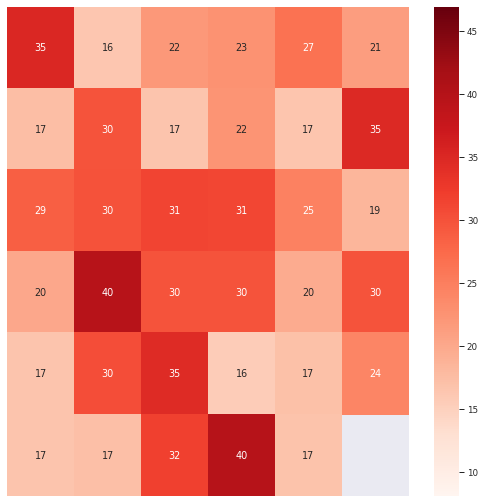

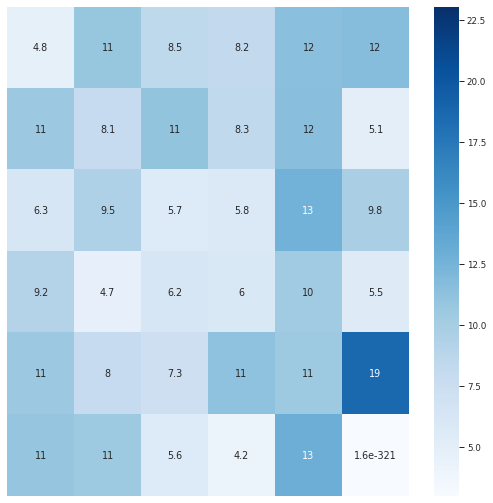

In [ ]:
Temps = np.empty([6,6])
Humids = np.empty([6,6])

for i, sensor_map in enumerate(merged_groups.values()):
  x = i % 6
  y = i // 6
  Temps[y,x] = sensor_map.iloc[n]['TEMP']
  Humids[y,x] = sensor_map.iloc[n]['HUM']

Temps[5,5] = np.NaN
Temps[5,5] = np.NaN

plt.figure(figsize=(9,9))
sns.heatmap(Temps, vmin=8.14, vmax=46.94, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False)
plt.figure(figsize=(9,9))
sns.heatmap(Humids, vmin=3.0, vmax=23.03, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False)

In [ ]:
n_pred = 30

for i, sensor_map in enumerate(merged_groups.values()):
  data = np.array(sensor_map.drop(columns=['ADDR']))
  input_X = data[n-24:n,:].reshape(1,24,2)
  input_label = np.array(i).reshape(1,)
  output_y = data[n:n+n_pred,:].reshape(1,n_pred,2)
  # Scale
  input_X_sc = np.empty(input_X.shape)
  for j in range(24):
    input_X_sc[0,j,0] = ((b-a)*(input_X[0,j,0] - min_temp) /(diff_temp) ) + a
    input_X_sc[0,j,1] = ((b-a)*(input_X[0,j,1] - min_humid)/(diff_humid)) + a
  #insert values
  if i == 0:
    X_cond = input_X.copy()
    X_cond_sc = input_X_sc.copy()
    X_label = input_label.copy()
    y_real = output_y.copy()
  else:
    X_cond = np.concatenate((X_cond,input_X), axis=0)
    X_cond_sc = np.concatenate((X_cond_sc,input_X_sc), axis=0)
    X_label = np.concatenate((X_label,input_label), axis=0)
    y_real = np.concatenate((y_real,output_y),axis=0)
print(X_cond.shape)
print(X_cond_sc.shape)
print(X_label.shape)
print(y_real.shape)

(35, 24, 2)
(35, 24, 2)
(35,)
(35, 30, 2)


In [ ]:
# Get predictions
X_aux_2 = np.copy(X_cond_sc)
for p in range(n_pred):
  '''
  if p >= 9 and p < 15:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=15.3)
  else:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)
  '''
  noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)

  y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict 
  y_gen = y_gen_[:,np.newaxis,:] 
  if p == 0: #Step 2: Save prediction
    y_gen_final = y_gen.copy() 
  else:
    y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
  X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
  X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
  
print(y_gen_final.shape)

# Invert Scale
y_gen_inv = np.empty(y_gen_final.shape)
for s in range(35):
  for r in range(n_pred):
    y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)

print(y_gen_inv.shape)

(35, 30, 2)
(35, 30, 2)


In [ ]:
# Which are the MAX and MIN of each column??
flat_temp_real = y_real[:,:,0].flatten()
flat_temp_gen = y_gen_inv[:,:,0].flatten()
flat_humid_real = y_real[:,:,1].flatten()
flat_humid_gen = y_gen_inv[:,:,1].flatten()

Max_temp = max(np.amax(flat_temp_real), np.amax(flat_temp_gen))
min_temp = min(np.amin(flat_temp_real), np.amin(flat_temp_gen))
Max_humid = max(np.amax(flat_humid_real), np.amax(flat_humid_gen))
min_humid = min(np.amin(flat_humid_real), np.amin(flat_humid_gen))

print(f'Max Temp: {Max_temp}')
print(f'min Temp: {min_humid}')
print(' ')

print(f'Max Humid: {Max_humid}')
print(f'min Humid: {min_humid}')
print(' ')

Max Temp: 40.89
min Temp: 4.15
 
Max Humid: 19.76
min Humid: 4.15
 


In [ ]:
for n in range(n_pred):  
  step_plot = n

  Temps_real = np.empty([6,6])
  Temps_gen = np.empty([6,6])
  Humids_real = np.empty([6,6])
  Humids_gen = np.empty([6,6])
  for i in range(35):
    x = i % 6
    y = i // 6
    Temps_real[y,x] = y_real[i,step_plot,0]
    Temps_gen[y,x] = y_gen_inv[i,step_plot,0]
    Humids_real[y,x] = y_real[i,step_plot,1]
    Humids_gen[y,x] = y_gen_inv[i,step_plot,1]

  Temps_real[5,5] = np.NaN
  Temps_gen[5,5] = np.NaN
  Humids_real[5,5] = np.NaN
  Humids_gen[5,5] = np.NaN

  # plot images
  fig,axs = plt.subplots(1,2,figsize=(18,7))
  axs[0].set_title(f'Heatmap Sensors - Temperature Real - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Temps_real, vmin=min_temp, vmax=Max_temp, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[0])
  axs[1].set_title(f'Heatmap Sensors - Temperature Fake - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Temps_gen, vmin=min_temp, vmax=Max_temp, cmap='Reds' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[1])
  plt.show()

  fig,axs = plt.subplots(1,2,figsize=(18,7))
  axs[0].set_title(f'Heatmap Sensors - Humidity Real - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Humids_real, vmin=min_humid, vmax=Max_humid, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[0])
  axs[1].set_title(f'Heatmap Sensors - Humidity Fake - Prediction Step #{step_plot+1}', fontsize=14)
  sns.heatmap(Humids_gen, vmin=min_humid, vmax=Max_humid, cmap='Blues' ,annot=True, linewidths=0, xticklabels=False, yticklabels=False, ax=axs[1])
  plt.show()

In [ ]:
# plot images and metrics
for i in range(35):
  for j in range(dim_n_vars):
    fig,axs = plt.subplots(1,dim_n_vars,sharey=True,figsize=(15,5),gridspec_kw={'wspace': 0.03})
    axs[0].plot(X_cond[i,:,j], marker='.', ms=8)
    name = dict_variables[j] + ' - Input'
    axs[0].set_title(name, fontsize=16)
    axs[1].plot(y_real[i,:,j], marker='.', ms=8)
    axs[1].plot(y_gen_inv[i,:,j], 'tab:red', marker='.', ms=8)
    axs[1].set_title('Output (red: predicted)', fontsize=16)
    plt.show()
    plt.close()
    print(dict_variables[j])
    # mean absolute error ± standard deviation
    error_np = np.subtract(y_real[i,:,j], y_gen_inv[i,:,j])
    mae = mean_absolute_error(y_real[i,:,j], y_gen_inv[i,:,j])
    std = np.std(error_np)
    print(f'MAE: {mae} ± {std}') 
    # mean squared error
    mse = mean_squared_error(y_real[i,:,j], y_gen_inv[i,:,j])
    print(f'MSE: {mse}') 
    # root mean square error
    rmse = np.sqrt(mse)
    print(f'RMSE: {rmse}') 
    # max error
    max_err = max_error(y_real[i,:,j], y_gen_inv[i,:,j])
    print(f'Max Error: {max_err}') 

### Heatmap review


In [ ]:
for i, sensor_map in enumerate(merged_groups.values()):
  sensor_map.drop(columns=['ADDR'], inplace=True)

In [ ]:
n_init = 666
n_pred = 24

for i, sensor_data in enumerate(merged_groups.values()):
  data = np.array(sensor_data)
  input_X = data[n_init-n_pred:n_init,:].reshape(1,n_pred,2)
  input_label = np.array(i).reshape(1,)
  output_y = data[n_init:n_init+n_pred,:].reshape(1,n_pred,2)
  # Scale
  input_X_sc = np.empty(input_X.shape)
  for j in range(24):
    input_X_sc[0,j,0] = ((b-a)*(input_X[0,j,0] - min_temp) /(diff_temp) ) + a
    input_X_sc[0,j,1] = ((b-a)*(input_X[0,j,1] - min_humid)/(diff_humid)) + a
  #insert values
  if i == 0:
    X_cond = input_X.copy()
    X_cond_sc = input_X_sc.copy()
    X_label = input_label.copy()
    y_real = output_y.copy()
  else:
    X_cond = np.concatenate((X_cond,input_X), axis=0)
    X_cond_sc = np.concatenate((X_cond_sc,input_X_sc), axis=0)
    X_label = np.concatenate((X_label,input_label), axis=0)
    y_real = np.concatenate((y_real,output_y),axis=0)
print(X_cond.shape)
print(X_cond_sc.shape)
print(X_label.shape)
print(y_real.shape)

(35, 24, 2)
(35, 24, 2)
(35,)
(35, 24, 2)


In [ ]:
# Get predictions
X_aux_2 = np.copy(X_cond_sc)
for p in range(n_pred):
  '''
  if p >= 9 and p < 15:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=15.3)
  else:
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)
  '''
  noise_input = tf.random.normal(shape=(35, latent_dim), stddev=3)

  y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict 
  y_gen = y_gen_[:,np.newaxis,:] 
  if p == 0: #Step 2: Save prediction
    y_gen_final = y_gen.copy() 
  else:
    y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
  X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
  X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
  
print(y_gen_final.shape)

# Invert Scale
y_gen_inv = np.empty(y_gen_final.shape)
for s in range(35):
  for r in range(n_pred):
    y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
    y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)

print(y_gen_inv.shape)

(35, 24, 2)
(35, 24, 2)


In [ ]:
# Which are the MAX and MIN of each column??
flat_temp_real = y_real[:,:,0].flatten()
flat_temp_gen = y_gen_inv[:,:,0].flatten()
flat_humid_real = y_real[:,:,1].flatten()
flat_humid_gen = y_gen_inv[:,:,1].flatten()

Max_temp_real = np.amax(flat_temp_real)
min_temp_real = np.amin(flat_temp_real)
Max_temp_gen = np.amax(flat_temp_gen)
min_temp_gen = np.amin(flat_temp_gen)
Max_humid_real = np.amax(flat_humid_real)
min_humid_real = np.amin(flat_humid_real)  
Max_humid_gen = np.amax(flat_humid_gen)
min_humid_gen = np.amin(flat_humid_gen)

print(f'Max Temp real: {Max_temp_real}')
print(f'min Temp real: {min_temp_real}')
print(' ')
print(f'Max Temp gen: {Max_temp_gen}')
print(f'min Temp gen: {min_temp_gen}')
print(' ')
print(f'Max Humid real: {Max_humid_real}')
print(f'min Humid real: {min_humid_real}')
print(' ')
print(f'Max Humid gen: {Max_humid_gen}')
print(f'min Humid gen: {min_humid_gen}')
print(' ')

Max Temp real: 39.85
min Temp real: 13.42
 
Max Temp gen: 41.2455425286293
min Temp gen: 14.121932699680329
 
Max Humid real: 12.81
min Humid real: 3.75
 
Max Humid gen: 12.685895612034948
min Humid gen: 3.9488399371504785
 


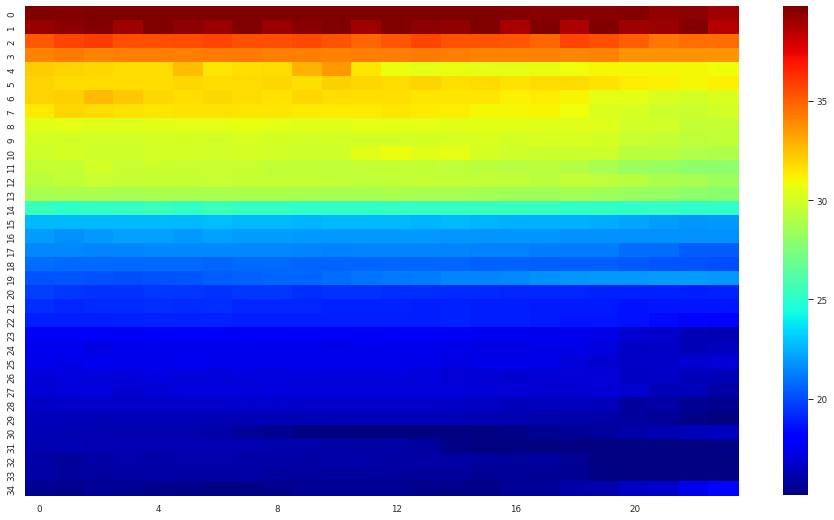

In [ ]:
plot_step = 1

plot_temp_real_ = y_real[:,:,0]
indices = list(range(0,24,plot_step))
plot_temp_real = np.take(plot_temp_real_, indices, axis=1)

sort_indices = np.argsort(plot_temp_real[:,0])[::-1]
plot_temp_real = plot_temp_real[sort_indices]

#labels = list(range(0,25,plot_step))
plt.figure(figsize=(16,9))
sns.heatmap(plot_temp_real, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4)
#plt.xticks(range(len(labels)),labels)
plt.show()

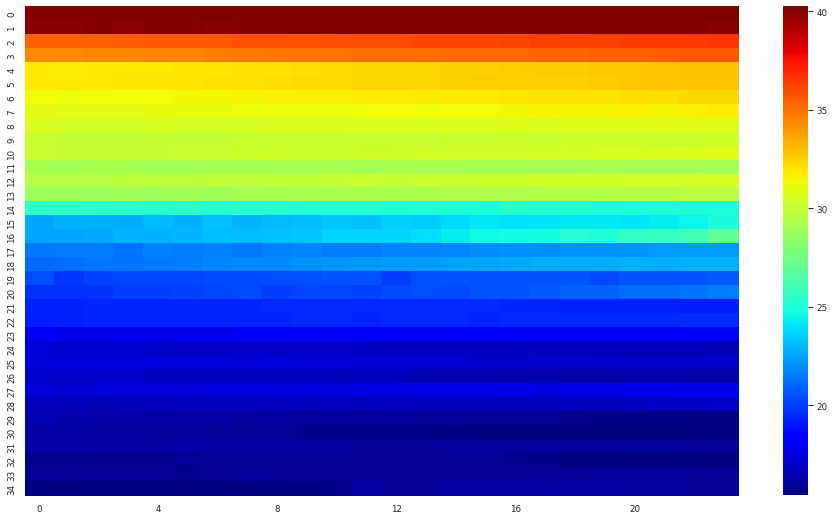

In [ ]:
plot_step = 1

plot_temp_gen_ = y_gen_inv[:,:,0]
indices = list(range(0,24,plot_step))
plot_temp_gen = np.take(plot_temp_gen_, indices, axis=1)
#labels = list(range(0,25,plot_step))
#paletos = sns.diverging_palette(220, 20, as_cmap=True)

plot_temp_gen = plot_temp_gen[sort_indices]

plt.figure(figsize=(16,9))
sns.heatmap(plot_temp_gen, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4)
#plt.xticks(range(len(labels)),labels)
plt.show()

#### Loop

In [ ]:
import random

1362
 
Max Temp real: 41.46
min Temp real: 15.27
 
Max Temp gen: 40.31572129964828
min Temp gen: 15.991782083511353
 
Max Humid real: 19.52
min Humid real: 4.37
 
Max Humid gen: 18.616791295409204
min Humid gen: 4.399804023504258
 


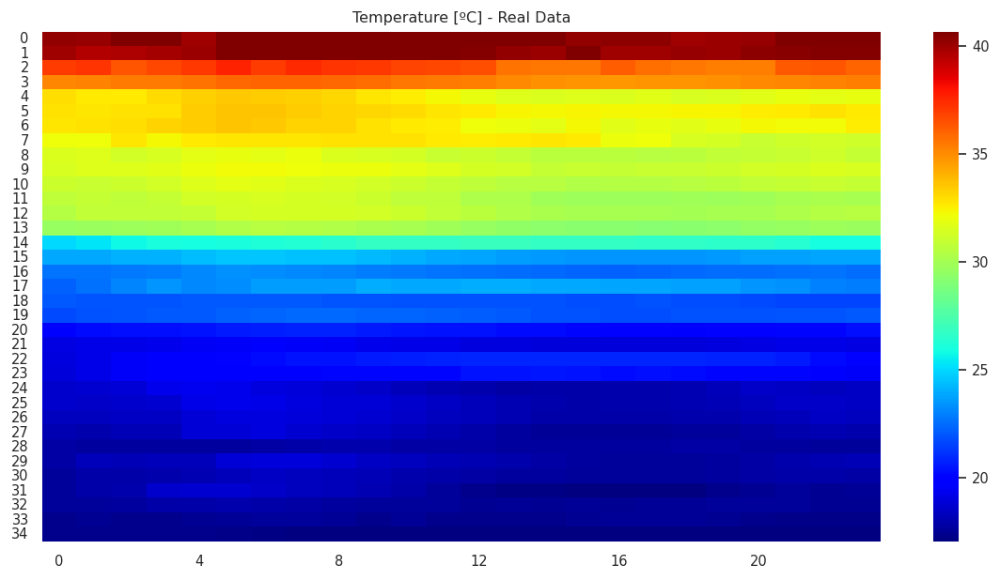

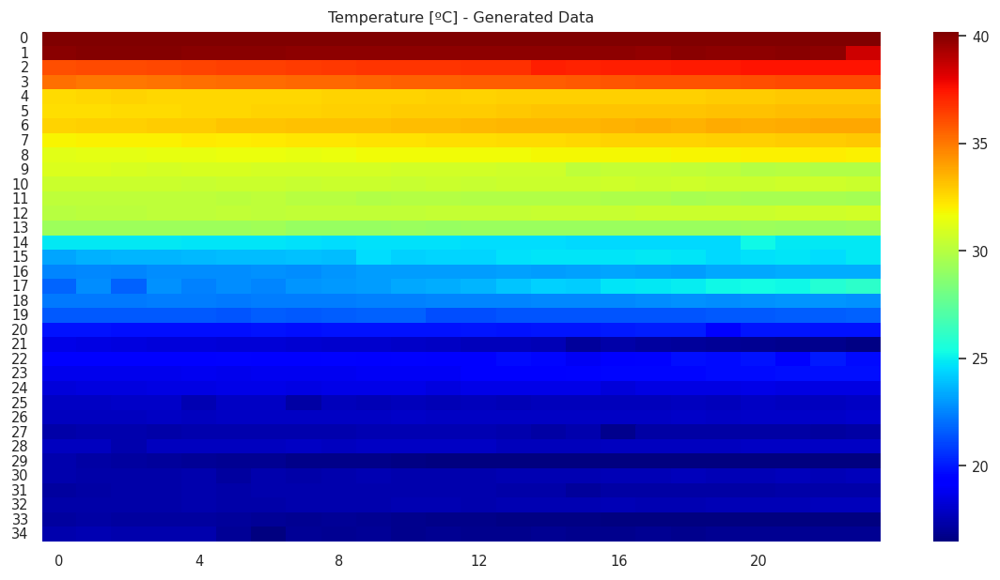

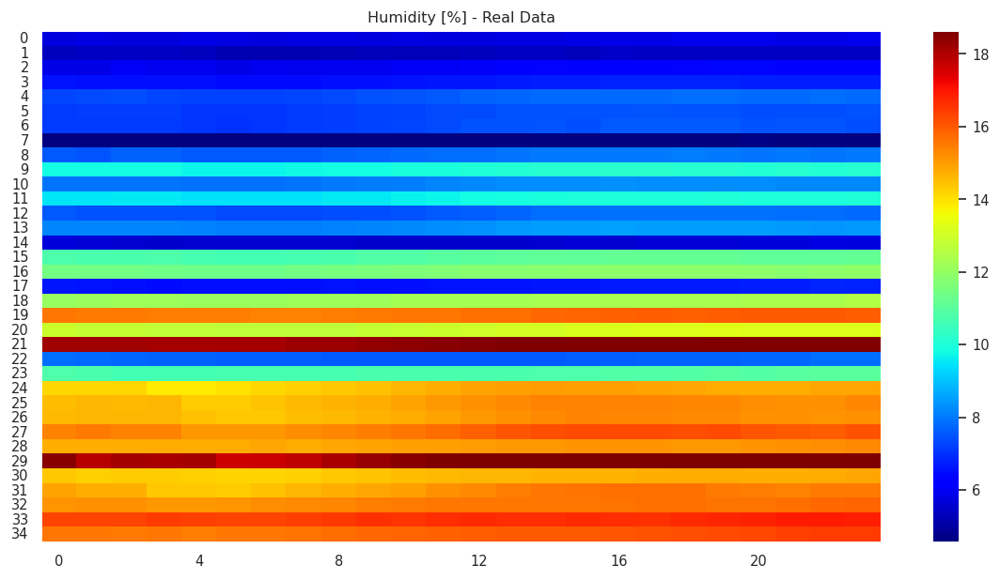

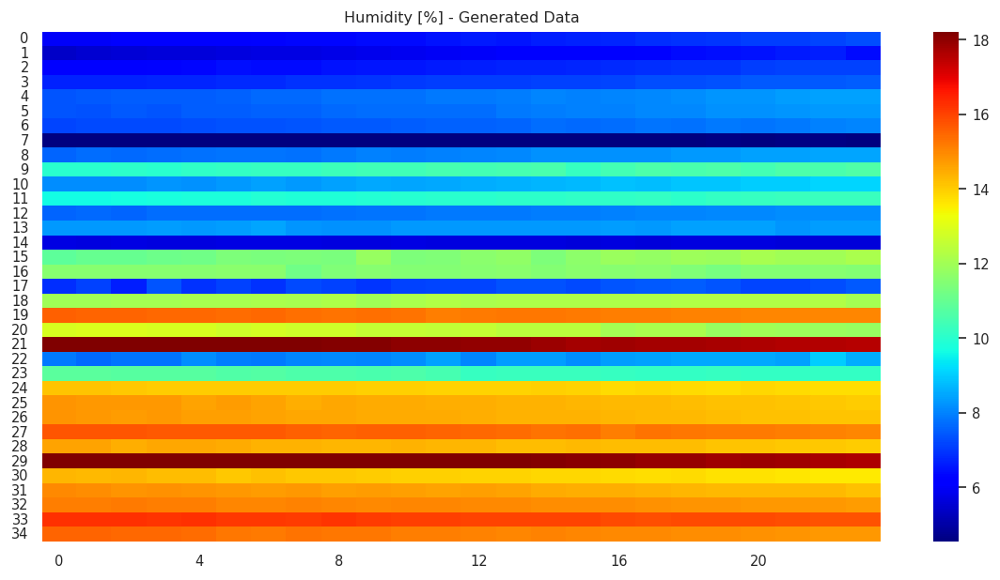

In [ ]:
min_temp_real = 20
min_temp_gen = 0

while (abs(min_temp_real-min_temp_gen))>5:
  n_init = random.randint(25,1700)
  n_pred = 24

  for i, sensor_data in enumerate(merged_groups.values()):
    data = np.array(sensor_data)
    input_X = data[n_init-n_pred:n_init,:].reshape(1,n_pred,2)
    input_label = np.array(i).reshape(1,)
    output_y = data[n_init:n_init+n_pred,:].reshape(1,n_pred,2)
    # Scale
    input_X_sc = np.empty(input_X.shape)
    for j in range(24):
      input_X_sc[0,j,0] = ((b-a)*(input_X[0,j,0] - min_temp) /(diff_temp) ) + a
      input_X_sc[0,j,1] = ((b-a)*(input_X[0,j,1] - min_humid)/(diff_humid)) + a
    #insert values
    if i == 0:
      X_cond = input_X.copy()
      X_cond_sc = input_X_sc.copy()
      X_label = input_label.copy()
      y_real = output_y.copy()
    else:
      X_cond = np.concatenate((X_cond,input_X), axis=0)
      X_cond_sc = np.concatenate((X_cond_sc,input_X_sc), axis=0)
      X_label = np.concatenate((X_label,input_label), axis=0)
      y_real = np.concatenate((y_real,output_y),axis=0)


  # Get predictions
  X_aux_2 = np.copy(X_cond_sc)
  for p in range(n_pred):
    '''
    if p >= 9 and p < 15:
      noise_input = tf.random.normal(shape=(35, latent_dim), stddev=15.3)
    else:
      noise_input = tf.random.normal(shape=(35, latent_dim), stddev=2.3)
    '''
    noise_input = tf.random.normal(shape=(35, latent_dim), stddev=3)

    y_gen_ = selected_generator.predict([X_aux_2, X_label, noise_input]) #Step 1: Predict 
    y_gen = y_gen_[:,np.newaxis,:] 
    if p == 0: #Step 2: Save prediction
      y_gen_final = y_gen.copy() 
    else:
      y_gen_final = np.concatenate((y_gen_final, y_gen), axis=1)
    X_aux = X_aux_2[:,1:,:] #Step 3: Put prediction in Condition Time-series
    X_aux_2 = np.concatenate((X_aux,y_gen), axis=1) 
    

  # Invert Scale
  y_gen_inv = np.empty(y_gen_final.shape)
  for s in range(35):
    for r in range(n_pred):
      y_gen_inv[s,r,0] = (y_gen_final[s,r,0] - a)*(diff_temp/(b-a)) +(min_temp)
      y_gen_inv[s,r,1] = (y_gen_final[s,r,1] - a)*(diff_humid/(b-a))+(min_humid)

  # Which are the MAX and MIN of each column??
  flat_temp_real = y_real[:,:,0].flatten()
  flat_temp_gen = y_gen_inv[:,:,0].flatten()
  flat_humid_real = y_real[:,:,1].flatten()
  flat_humid_gen = y_gen_inv[:,:,1].flatten()

  Max_temp_real = np.amax(flat_temp_real)
  min_temp_real = np.amin(flat_temp_real)
  Max_temp_gen = np.amax(flat_temp_gen)
  min_temp_gen = np.amin(flat_temp_gen)
  Max_humid_real = np.amax(flat_humid_real)
  min_humid_real = np.amin(flat_humid_real)  
  Max_humid_gen = np.amax(flat_humid_gen)
  min_humid_gen = np.amin(flat_humid_gen)

print(n_init)
print(' ')
print(f'Max Temp real: {Max_temp_real}')
print(f'min Temp real: {min_temp_real}')
print(' ')
print(f'Max Temp gen: {Max_temp_gen}')
print(f'min Temp gen: {min_temp_gen}')
print(' ')
print(f'Max Humid real: {Max_humid_real}')
print(f'min Humid real: {min_humid_real}')
print(' ')
print(f'Max Humid gen: {Max_humid_gen}')
print(f'min Humid gen: {min_humid_gen}')
print(' ')


plot_step = 1
indices = list(range(0,24,plot_step))

# Plot Real Data Temperature
plot_temp_real_ = y_real[:,:,0]
plot_temp_real = np.take(plot_temp_real_, indices, axis=1)
sort_indices = np.argsort(plot_temp_real[:,0])[::-1]
plot_temp_real = plot_temp_real[sort_indices]
plt.figure(figsize=(12,6), dpi=120)
sns.heatmap(plot_temp_real, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4).set(title='Temperature [ºC] - Real Data')
plt.show()

# Plot Generated Data Temperature
plot_temp_gen_ = y_gen_inv[:,:,0]
plot_temp_gen = np.take(plot_temp_gen_, indices, axis=1)
plot_temp_gen = plot_temp_gen[sort_indices]
plt.figure(figsize=(12,6), dpi=120)
sns.heatmap(plot_temp_gen, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4).set(title='Temperature [ºC] - Generated Data')
plt.show()

# Plot Real Data Humidity
plot_humid_real_ = y_real[:,:,1]
plot_humid_real = np.take(plot_humid_real_, indices, axis=1)
plot_humid_real = plot_humid_real[sort_indices]
plt.figure(figsize=(12,6), dpi=120)
sns.heatmap(plot_humid_real, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4).set(title='Humidity [%] - Real Data')
plt.show()

# Plot Generated Data Humidity
plot_humid_gen_ = y_gen_inv[:,:,1]
plot_humid_gen = np.take(plot_humid_gen_, indices, axis=1)
plot_humid_gen = plot_humid_gen[sort_indices]
plt.figure(figsize=(12,6), dpi=120)
sns.heatmap(plot_humid_gen, cmap='jet', robust=True, annot=False, linewidths=0, xticklabels=4).set(title='Humidity [%] - Generated Data')
plt.show()


### Keep Alive


In [ ]:
while True:pass